# Shaft model with regularization PDF (536 samples)

The model consists of the sum of a linear function and a non-linear function with PDF shaping and regularization.

This model uses the CFD Shaft data with 536 samples. Error function plot per output. 

## Web application 6 inputs and 5 outputs

Run interactively on the web at:

### Inputs

(1, 'i_pul_coal_inj_kg_thm')

(2, 'i_nat_gas_inj_kg_thm')

(3, 'i_nat_gas_t_k')

(4, 'i_o2_vol_perce')

(9, 'i_ore_moisture_weight_perce')

(11, 'i_ore_weight_kg')

### Outputs

(19, 'o_shaft_co_utiliz')

(20, 'o_shaft_h2_utiliz')

(21, 'o_shaft_top_gas_temp_c')

(22, 'o_shaft_press_drop_pa')

(23, 'o_shaft_coke_rate_kg_thm')




In [1]:

################################################
##
## regression with ML for system control
##
################################################

import torch
import numpy as np
import pandas as pd
import sklearn
import torch.nn as nn
import torch.nn.functional as F
import matplotlib.pyplot as plt
import math
import seaborn as sns

from torch.utils.data import TensorDataset, DataLoader
from sklearn.model_selection import train_test_split
from mlxtend.plotting import heatmap

## coefficient of determination (R**2)
from sklearn.metrics import r2_score


In [2]:

#######################################################
## learning_rate_mse        = 0.0005
## probably needs adjustable learning rate scheduler


N_EPOCHS = 4000                            ## 4000
batch_size = 16                             ## 5    ## 32
learning_rate =  0.1                        ## 0.01   ## 1e-5 


## 0.0001  experimentally seemed okay 
learning_rate_pdfcontrol  =  0.0001      ## 0.0001     ## 0.00001       ## 0.000001


#######################################################
# define mean and standard deviation of target Gaussian distribution (impulse function)

mean_impulse = 0.
std_impulse  = 0.01

#######################################################


## experimentally 0.5 - 0.7 was interesting      ## 0.9
h = 0.9       ## 0.7    ## 0.05     ## 0.03                    ## 0.05 >


## experimentally 20 seemed okay 
N_error_range =  20          ## 20  ## 10   ## error between pred and real range (-20, 20)

switch_threshold = 0.4    ## 0.90

#######################################################

np.set_printoptions(suppress=True)
torch.set_printoptions(sci_mode=False)

#######################################################
## regularization function

use_regularization = 0.0

########################################################



In [3]:

CFD_raw_data = pd.read_csv('536.CFD.9.2022.csv')


In [4]:

headers_list = CFD_raw_data.columns.values.tolist()
print(headers_list)
print(len(headers_list))


for i, name in enumerate(headers_list):
    print((i, name))


['index', 'i_pul_coal_inj_kg_thm', 'i_nat_gas_inj_kg_thm', 'i_nat_gas_t_k', 'i_o2_vol_perce', 'i_bf_windrate_nm3_hr', 'i_hb_moist_g_nm3', 'i_hot_blast_press_pa', 'i_hot_blast_temp_k', 'i_ore_moisture_weight_perce', 'i_coke_weight_kg', 'i_ore_weight_kg', 'o_production_rate_thmperday', 'o_tuyere_exit_velo_m_s', 'o_tuyere_t_k', 'o_raceway_flame_temp_k', 'o_raceway_coal_burn_perce', 'o_raceway_volume_m', 'o_raceway_depth_m', 'o_shaft_co_utiliz', 'o_shaft_h2_utiliz', 'o_shaft_top_gas_temp_c', 'o_shaft_press_drop_pa', 'o_shaft_coke_rate_kg_thm', 'o_shaft_cohesive_zone_tip_height_m', 'o_shaft_co_v_perc', 'o_shaft_co2_v_perc', 'o_shaft_h2_v_perce', 'o_shaft_n2_v_perc']
29
(0, 'index')
(1, 'i_pul_coal_inj_kg_thm')
(2, 'i_nat_gas_inj_kg_thm')
(3, 'i_nat_gas_t_k')
(4, 'i_o2_vol_perce')
(5, 'i_bf_windrate_nm3_hr')
(6, 'i_hb_moist_g_nm3')
(7, 'i_hot_blast_press_pa')
(8, 'i_hot_blast_temp_k')
(9, 'i_ore_moisture_weight_perce')
(10, 'i_coke_weight_kg')
(11, 'i_ore_weight_kg')
(12, 'o_production_rate_

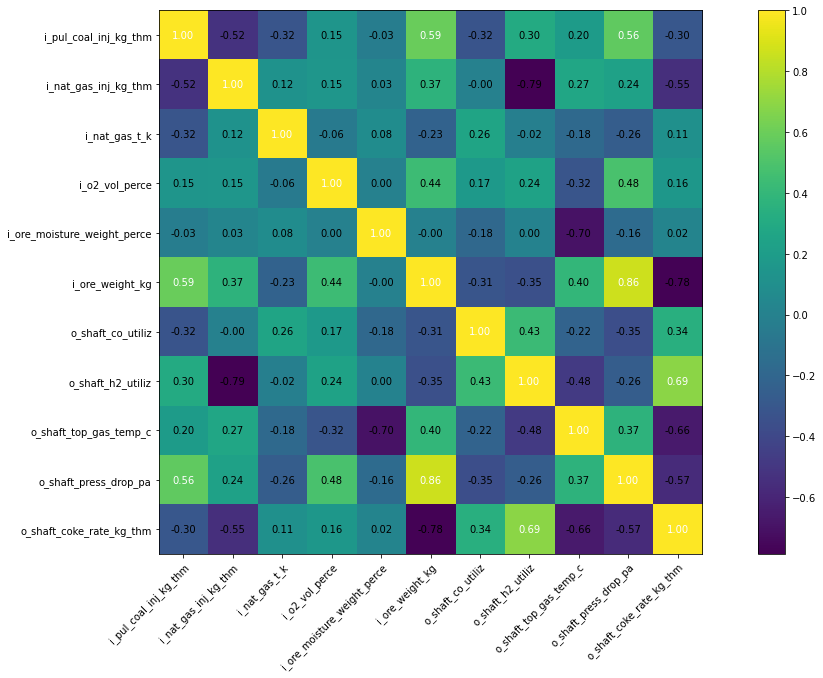

In [5]:

my_allInputs_shaft_names = ['i_pul_coal_inj_kg_thm','i_nat_gas_inj_kg_thm','i_nat_gas_t_k','i_o2_vol_perce',
                            'i_ore_moisture_weight_perce', 'i_ore_weight_kg', 'o_shaft_co_utiliz', 
                            'o_shaft_h2_utiliz', 'o_shaft_top_gas_temp_c', 'o_shaft_press_drop_pa', 
                            'o_shaft_coke_rate_kg_thm']



cm = np.corrcoef(CFD_raw_data[my_allInputs_shaft_names].values.T)
hm = heatmap(cm, row_names=my_allInputs_shaft_names, column_names=my_allInputs_shaft_names, figsize=(20, 10))
plt.show()


In [6]:

CFDdata_np = CFD_raw_data.to_numpy()
print(CFDdata_np)
print(CFDdata_np.shape)


[[  1.           0.          37.9        ...   0.1941631    0.0438327
    0.5448123 ]
 [  2.           0.          37.9        ...   0.2186134    0.04034286
    0.5149459 ]
 [  3.           0.          37.9        ...   0.2353341    0.03772617
    0.4849808 ]
 ...
 [534.         100.         150.         ...   0.2011746    0.12807
    0.42847   ]
 [535.         150.         100.         ...   0.2154974    0.09924317
    0.4382672 ]
 [536.         200.          50.         ...   0.2279472    0.07034001
    0.4493517 ]]
(536, 29)


In [7]:

#######################################################

input_indeces  = [1, 2, 3, 4, 9, 11]
output_indeces = [19, 20, 21, 22, 23]                            

#######################################################

X = CFDdata_np[:, input_indeces]

y = CFDdata_np[:, output_indeces]

print(X.shape)
print(y.shape)

#######################################################

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.20, random_state=42)

#######################################################

print(X_train.shape)
print(X_test.shape)
print(y_train.shape)
print(y_test.shape)


(536, 6)
(536, 5)
(428, 6)
(108, 6)
(428, 5)
(108, 5)


In [8]:

## fix data type
X_train  = X_train.astype(np.float32)
X_test   = X_test.astype(np.float32)
y_train  = y_train.astype(np.float32)
y_test   = y_test.astype(np.float32)

X_train_tr  = torch.from_numpy(X_train)
X_test_tr   = torch.from_numpy(X_test)
y_train_tr  = torch.from_numpy(y_train)
y_test_tr   = torch.from_numpy(y_test)


## Scale inputs (x)

In [9]:

###################################################################
## for scaling

epsilon = 0.0001

x_means      =  X_train_tr.mean(0, keepdim=True)
x_deviations =  X_train_tr.std(0, keepdim=True) + epsilon

X_train_tr_scaled = (X_train_tr - x_means) / x_deviations
X_test_tr_scaled  = (X_test_tr  - x_means) / x_deviations


## Scale outputs (y)

In [10]:

###################################################################
## standardize the y outputs

y_means      = y_train_tr.mean(0, keepdim=True)
y_deviations = y_train_tr.std(0,  keepdim=True) + epsilon

y_train_tr_scaled = (y_train_tr - y_means) / y_deviations
y_test_tr_scaled  = (y_test_tr - y_means) / y_deviations

####################################################################



## Fit and DataLoader


In [11]:

def func_plot_performance(list_metric, the_string):
    
    list_samples = [i for i in range(len(list_metric))]
    
    plt.figure(figsize=(13,4))
    
    plt.scatter(list_samples, list_metric)
    
    ## plt.xlim(-1, 1)
    plt.ylim(0.7, 1.03)
    
    plt.title('metric during training ' + the_string)
    plt.xlabel('iteration/epoch')
    plt.ylabel('R**2')
    ## plt.legend()
    
    file_name = 'images/300dpiShaft' + the_string + '.png'
    plt.savefig(file_name, dpi=300)

    plt.show()


In [12]:

#######################################################


def fit_y_scaled(num_epochs, model, loss_fn, opt):
    list_metric = []
    for epoch in range(num_epochs):
        for xb, yb in train_dl:
            pred_descaled, pred_scaled = model(xb)
            loss = loss_fn(pred_scaled, yb)
            loss.backward()
            opt.step()
            opt.zero_grad()
            print(epoch, " loss= ", loss)
        
        ## if epoch % 200 == 0:
        ## print(epoch, " loss= ", loss)
            
            
        pred_descaled, pred_scaled = model(X_train_tr)
        r2_avg = torch.mean(torch.tensor(r2_score( pred_scaled.detach().numpy(),  y_train_tr_scaled.numpy()  )))
        list_metric.append(r2_avg.detach().numpy())
            
    func_plot_performance(list_metric, "No PDF shaping")
            
    pred_descaled, pred_scaled = model(X_train_tr)
    print('Training loss:', loss_fn(  pred_scaled,                   y_train_tr_scaled          ))
    print('Training R**2:', r2_score( pred_scaled.detach().numpy(),  y_train_tr_scaled.numpy()  ))
    
#######################################################


In [13]:

#######################################################


def fit_y_scaled_PDF(num_epochs, model, loss_fn, loss_fn_PDF, opt):
    list_metric = []
    for epoch in range(num_epochs):
        
        for xb, yb in train_dl:
            pred_descaled, pred_scaled = model(xb)
            
            if epoch < int(num_epochs * switch_threshold):
                loss = loss_fn(pred_scaled, yb)
            else:
                opt = torch.optim.Adam(   model.parameters(), lr=learning_rate_pdfcontrol   )
                loss = loss_fn_PDF(pred_scaled, yb)
            
            loss.backward()
            opt.step()
            opt.zero_grad()
            print(epoch, " loss= ", loss)
            
        ## if epoch % 200 == 0:
        ## print(epoch, " loss= ", loss)
        
            
        pred_descaled, pred_scaled = model(X_train_tr)
        r2_avg = torch.mean(torch.tensor(r2_score( pred_scaled.detach().numpy(),  y_train_tr_scaled.numpy()  )))
        list_metric.append(r2_avg.detach().numpy())
            
    func_plot_performance(list_metric, "With PDF shaping")
            
         
    pred_descaled, pred_scaled = model(X_train_tr)
    print('Training loss:', loss_fn(  pred_scaled,                   y_train_tr_scaled          ))
    print('Training R**2:', r2_score( pred_scaled.detach().numpy(),  y_train_tr_scaled.numpy()  ))
    
#######################################################


In [14]:

#######################################################
## define dataset

train_ds = TensorDataset(X_train_tr, y_train_tr_scaled)

#######################################################
## define dataloader

train_dl = DataLoader(train_ds, batch_size, shuffle=True)


#######################################################


## Define NN architectures

In [15]:

#######################################################
## Linear Regression

class LinRegNet_SIO(nn.Module):
    ## initialize the layers
    def __init__(self, x_means, x_deviations, y_means, y_deviations):
        super().__init__()
        
        self.x_means      = x_means
        self.x_deviations = x_deviations
        self.y_means      = y_means
        self.y_deviations = y_deviations
        
        self.linear1 = nn.Linear(6, 5) 
        
        ## nn.init.xavier_uniform_(self.linear1.weight)
        ## nn.init.zeros_(self.linear1.bias)

    ## perform inference
    def forward(self, x):
        x = (x - self.x_means) / self.x_deviations
        
        y_scaled = self.linear1(x)
        y_descaled = y_scaled * self.y_deviations + self.y_means
        
        return y_descaled, y_scaled

    
#############################################################
## Multi-Layer Perceptron

class MLP_Net_SIO(nn.Module):
    ## initialize the layers
    def __init__(self, x_means, x_deviations, y_means, y_deviations):
        super().__init__()
        
        self.x_means      = x_means
        self.x_deviations = x_deviations
        self.y_means      = y_means
        self.y_deviations = y_deviations
        
        self.linear1 = nn.Linear(6, 10)
        self.act1    = nn.Sigmoid()                       ## Tanh() 
        self.linear2 = nn.Linear(10, 5)
        self.dropout = nn.Dropout(0.25)
        
        ## nn.init.xavier_uniform_(self.linear1.weight)
        ## nn.init.zeros_(self.linear1.bias)
        
        ## nn.init.xavier_uniform_(self.linear2.weight)
        ## nn.init.zeros_(self.linear2.bias)
    
    ## perform inference
    def forward(self, x):
        x = (x - self.x_means) / self.x_deviations
        x = self.linear1(x)
        x = self.act1(x)
        x = self.dropout(x)
        
        y_scaled = self.linear2(x)
        y_descaled = y_scaled * self.y_deviations + self.y_means
        
        return y_descaled, y_scaled
    

#############################################################
## Deep Learning model with 2 hidden layers


class DL_Net_SIO(nn.Module):
    
    ## initialize the layers
    def __init__(self, x_means, x_deviations, y_means, y_deviations):
        super().__init__()
        
        self.x_means      = x_means
        self.x_deviations = x_deviations
        self.y_means      = y_means
        self.y_deviations = y_deviations
        
        self.linear1 = nn.Linear(6, 10)
        self.act1    = nn.Sigmoid()                       ## Tanh() 
        self.linear2 = nn.Linear(10, 6)
        self.act2    = nn.Sigmoid() 
        self.linear3 = nn.Linear(6, 5)
        self.dropout = nn.Dropout(0.25)
        
        ## nn.init.xavier_uniform_(self.linear1.weight)
        ## nn.init.zeros_(self.linear1.bias)
        
        ## nn.init.xavier_uniform_(self.linear2.weight)
        ## nn.init.zeros_(self.linear2.bias)
        
        ## nn.init.xavier_uniform_(self.linear3.weight)
        ## nn.init.zeros_(self.linear3.bias)
    
    ## perform inference
    def forward(self, x):
        
        x = (x - self.x_means) / self.x_deviations
        x = self.linear1(x)
        x = self.act1(x)
        x = self.dropout(x)
        x = self.linear2(x)
        x = self.act2(x)
        x = self.dropout(x)
        
        y_scaled = self.linear3(x)
        y_descaled = y_scaled * self.y_deviations + self.y_means
        
        return y_descaled, y_scaled

      
#############################################################


In [16]:

#############################################################
##   F1      plus       F2
## Linear     +      Nonlinear

class F1plusF2_SIO(nn.Module):
    ## initialize the layers
    def __init__(self, x_means, x_deviations, y_means, y_deviations):
        super().__init__()
        
        self.x_means      = x_means
        self.x_deviations = x_deviations
        self.y_means      = y_means
        self.y_deviations = y_deviations
        
        ## F1
        self.f1_linear1 = nn.Linear(6, 5)       
        
        ## F2
        self.f2_linear1 = nn.Linear(6, 10)
        self.f2_act1    = nn.Sigmoid()                    ## Tanh()                       
        self.f2_linear2 = nn.Linear(10, 5)       
        self.f2_dropout = nn.Dropout(0.25)
        
        
    ## perform inference
    def forward(self, x):
        x = (x - self.x_means) / self.x_deviations
        
        ## F1
        f1 = self.f1_linear1(x)
        
        ## F2
        f2 = self.f2_linear1(x)
        f2 = self.f2_act1(f2)
        f2 = self.f2_dropout(f2)
        f2 = self.f2_linear2(f2)
        
        
        y_scaled   = f1 + f2
        y_descaled = y_scaled * self.y_deviations + self.y_means
        
        return y_descaled, y_scaled
    

#############################################################



## Impulse Function for PDF shaping

Uses a gaussian basically



In [17]:

def ImpulseGaussian(x, mu, sigma): 
   
    left  = 1 / (    torch.sqrt(   2 * torch.tensor(math.pi)   ) * torch.sqrt(torch.tensor(sigma) )    )
    
    right = torch.exp(   -(x - mu)**2 / (2 * sigma)    )
    
    vector_vals = left * right
    
    return vector_vals         ## .unsqueeze(0)


The variable left ends up being 1 scalar value. The variable right ends up being a vector of size 4000. The variable x is the range of errors from -N to N such as:

[-20, 19, ..., 0, ..., 19, 20]. 

N is selected. it is assumed that error diffs above 20 are rare. 

The value mu is a scalar 0. A broadcast substraction is taken between the vector of size 4000 and the scalar 0. This results in a new vector of size 4000 which defines the impulse function. For example:

torch.Size([4000])


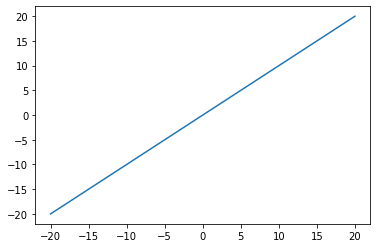

torch.Size([4000])


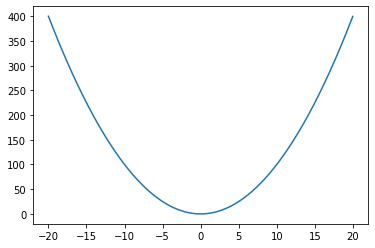

torch.Size([4000])


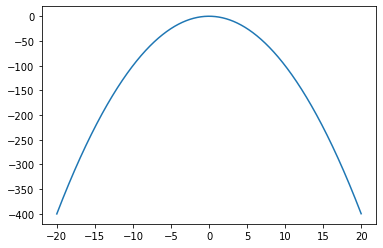

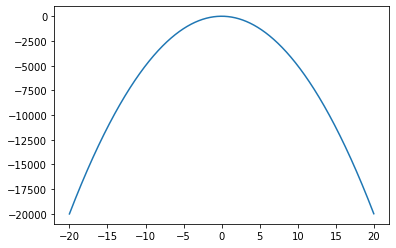

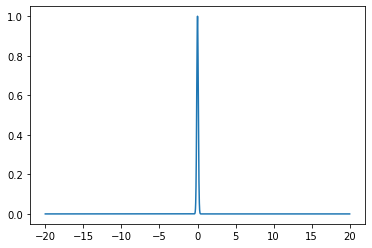

tensor(3.9894)


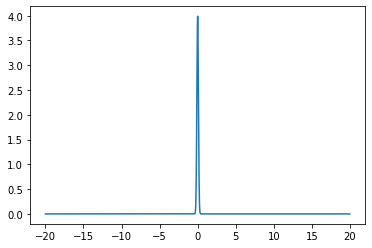

torch.Size([4000])


In [18]:

example_temp_x = torch.arange(-20, 20, 0.01)  

example_diff_range = example_temp_x - 0.0
print(example_diff_range.size())
plt.plot(example_temp_x, example_diff_range )
plt.show()

example_diff_range = (example_temp_x - 0.0)**2
print(example_diff_range.size())
plt.plot(example_temp_x, example_diff_range )
plt.show()

example_diff_range = -(example_temp_x - 0.0)**2
print(example_diff_range.size())
plt.plot(example_temp_x, example_diff_range )
plt.show()

example_diff_range = -(example_temp_x - 0.0)**2 / (2 * 0.01) 
plt.plot(example_temp_x, example_diff_range )
plt.show()

example_diff_range = torch.exp( -(example_temp_x - 0.0)**2 / (2 * 0.01) )
plt.plot(example_temp_x, example_diff_range )
plt.show()

example_temp_left  = 1 / (    torch.sqrt(   2 * torch.tensor(math.pi)   ) * torch.sqrt(torch.tensor(0.01) )    )
print(example_temp_left )

example_diff_range  = example_temp_left * example_diff_range 
plt.plot(example_temp_x, example_diff_range )
plt.show()

print(example_diff_range.size())


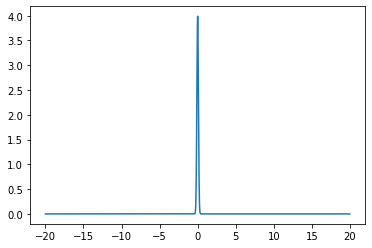

In [19]:

example_temp_y = ImpulseGaussian(example_temp_x, 0, 0.01)

plt.plot(example_temp_x, example_temp_y )


## Kernel Density Estimation for PDF approximation

In [20]:

def kernel_density(x_range, the_errors, h): 
    
    x_range = x_range.unsqueeze(0)
   
    the_errors = the_errors.unsqueeze(2)
    
    
    left  = 1 / (    torch.sqrt(   2 * torch.tensor(math.pi)   )  )
    
    right = torch.exp(   -((x_range - the_errors)/h)**2 / (2)    )
    
    vector_vals = left * right
    
    ## density         = torch.mean( vector_vals, 0) / h
             
    return vector_vals




The kernel function does something very similar to the impulse function. The kernel help to create the other pdf for the errors in the range [-N, N]. 
The difference is that now we have batches and multiple outputs. If we had a batch of 1, with one output, then 

y_pred - y_real = error

would give one scalar error value such as 2.3 or something. The 0 scalar value is what we would want if we had 100% accuracy. But we can assume an error scalar value such as 2.3. 

the_errors variable below has a dimentions of [16x5] because we have batches of 16 and 5 outputs. Exactly like with the impulse func, we need the error range.  The variable x_range is the range of errors from -N to N such as:

[-20, 19, ..., 0, ..., 19, 20]. 

N is selected. It is assumed that error differences above 20 are rare. 

Since we have batches of 16 and 5 outputs, we take the broadcast diff between each of the values in the_errors and the x_range. A broadcast substraction is taken between the vector x_range of size 4000 and the values in the [16, 5] matrix. This results in a new matrix of size [16, 5, 4000].

The logic is the same as the impulse func, instead of zero like in the impulse func, for the kernel_density we have the loss errors

y_pred - y_real = error

so assume the value for batch 3 and output 4, we have value 2.3. This was the error (y_pred - y_real ). Now like with the impulse func, we need the pdf of that error so we compare it to the vector range x of 4000 and a broadcast substraction is taken between the vector x_range of size 4000 and the value [3, 4] = 2.3

For efficiency, this is generalized with tensor matrix multiplications and broadcasting. 

Now we repeat the plotting as we did for the impulse function but for the error value [3, 4] = 2.3

torch.Size([4000])


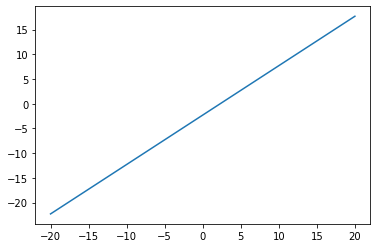

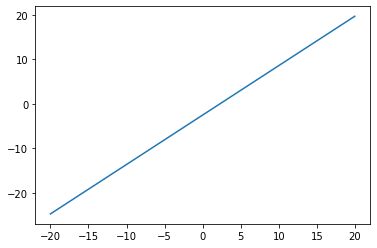

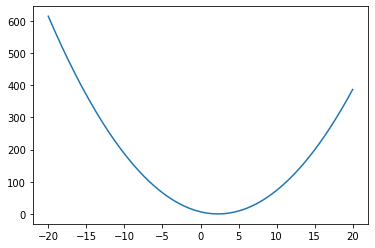

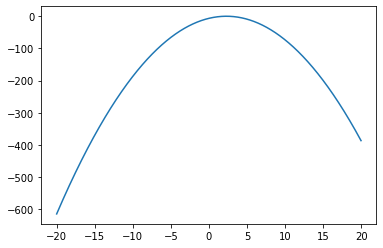

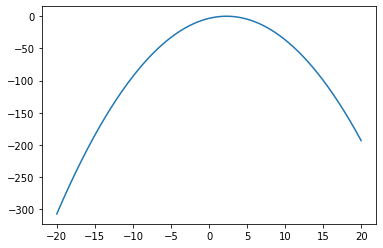

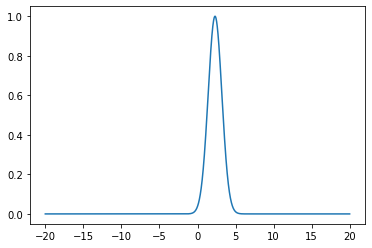

tensor(0.3989)


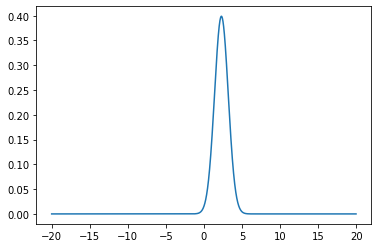

In [21]:

example_temp_x = torch.arange(-20, 20, 0.01)  

example_diff_range = example_temp_x - 2.3
print(example_diff_range.size())
plt.plot(example_temp_x, example_diff_range )
plt.show()

example_diff_range = (example_temp_x - 2.3)/h
plt.plot(example_temp_x, example_diff_range )
plt.show()

example_diff_range = (   (example_temp_x - 2.3)/h    )**2
plt.plot(example_temp_x, example_diff_range )
plt.show()

example_diff_range = -(   (example_temp_x - 2.3)/h    )**2
plt.plot(example_temp_x, example_diff_range )
plt.show()

example_diff_range = -(   (example_temp_x - 2.3)/h    )**2 / (2)
plt.plot(example_temp_x, example_diff_range )
plt.show()

example_diff_range =   torch.exp(  -(   (example_temp_x - 2.3)/h    )**2 / (2)   )
plt.plot(example_temp_x, example_diff_range )
plt.show()

example_temp_left = 1 / (    torch.sqrt(   2 * torch.tensor(math.pi)   )  )
print(example_temp_left )
example_diff_range =   torch.exp(  -(   (example_temp_x - 2.3)/h    )**2 / (2)   )
example_diff_range  = example_temp_left * example_diff_range 
plt.plot(example_temp_x, example_diff_range )
plt.show()


In [22]:

a = torch.tensor([[1,  9,  8, 7],
        [2,  1.0131, -0.6549, -1.4279],
        [3, -1.3350, -0.7694,  0.5600],
        [ 3, -0.9580,  0.3623,  0.2343]])
print(   torch.mean(a, 0)   )



tensor([2.2500, 1.9300, 1.7345, 1.5916])


## Custom loss function for PDF shaping

The tenmsor x should be [-N, N] of size 4000 given my choice of step and N. The errors tensor becomes of size [16, 5] as it is [batches, outputs]. Impulse function returns a vector of size 4000 as previously described. Kernel desity returns a tensor of size [16, 5, 4000]. 

diff should be [16, 5, 4000]

In [23]:
x =torch.randint(3, 5, (3,))
y = torch.randint(10, (2, 4, 3))
print(x.size())
print(x)
print(y)
print(y.size())
res = y - x
print(res)
## print(   torch.mean(a, 0)   )

torch.Size([3])
tensor([4, 4, 4])
tensor([[[5, 8, 0],
         [9, 7, 5],
         [0, 6, 8],
         [1, 8, 2]],

        [[1, 0, 3],
         [2, 2, 7],
         [1, 8, 1],
         [9, 3, 2]]])
torch.Size([2, 4, 3])
tensor([[[ 1,  4, -4],
         [ 5,  3,  1],
         [-4,  2,  4],
         [-3,  4, -2]],

        [[-3, -4, -1],
         [-2, -2,  3],
         [-3,  4, -3],
         [ 5, -1, -2]]])


In [24]:

def my_loss(output, target):
    
    x = torch.arange(-N_error_range, N_error_range, 0.01)                   ## the error is in this range 
    
    error = output.float() - target.float() 
    
    basisFunc   =  kernel_density(x, error, h)
    
    impulseFunc = ImpulseGaussian(x, mean_impulse, std_impulse**2)  
    
    ## print(basisFunc.size())
    ## print(impulseFunc.size())
    
    diff = ( basisFunc.float() -  impulseFunc.float()  )        ## * h         ## h is ?? 
    ## print(  diff.size()   )
    
    ## there are 5 ish values and 3995 zeros, so get rid of zeros
    ## and then take the mean
    
    diffs_vector  = torch.reshape(diff, (-1,))
    diffs_vector = diffs_vector[diffs_vector > 0]
    
    diff = diffs_vector
    
    ## print(diff)
    ## print(   diff.size()  )
    
    loss = torch.mean(   (   diff  )**2    )    ## / h
    
    reg_sigma_func = (loss ** 2) * use_regularization
    
    loss = loss * ( 1.0 + reg_sigma_func )
    
    return loss



## Results for g(x) = F1(x) + F2(x) with No PDF shaping

F1 = Linear

F2 = Nonlinear


In [25]:

def print_individual_Rsquare(pred_descaled, y_test_tr):
    vector_pred_descaled = pred_descaled.detach().numpy()
    vector_y_test_tr     = y_test_tr.numpy()

    for i in range(len(output_indeces)):
        ## print(vector_pred_descaled.shape)
        print("*****")
        print("*****")
        print('Testing R**2 - Output: ' + str(i), r2_score( vector_pred_descaled[:, i], vector_y_test_tr[:, i] ) )
        


0  loss=  tensor(2.0844, grad_fn=<MseLossBackward0>)
0  loss=  tensor(1.9817, grad_fn=<MseLossBackward0>)
0  loss=  tensor(1.3614, grad_fn=<MseLossBackward0>)
0  loss=  tensor(0.7331, grad_fn=<MseLossBackward0>)
0  loss=  tensor(0.8790, grad_fn=<MseLossBackward0>)
0  loss=  tensor(0.6756, grad_fn=<MseLossBackward0>)
0  loss=  tensor(0.6356, grad_fn=<MseLossBackward0>)
0  loss=  tensor(0.5239, grad_fn=<MseLossBackward0>)
0  loss=  tensor(0.7155, grad_fn=<MseLossBackward0>)
0  loss=  tensor(0.6825, grad_fn=<MseLossBackward0>)
0  loss=  tensor(0.3802, grad_fn=<MseLossBackward0>)
0  loss=  tensor(0.3085, grad_fn=<MseLossBackward0>)
0  loss=  tensor(0.3209, grad_fn=<MseLossBackward0>)
0  loss=  tensor(0.5902, grad_fn=<MseLossBackward0>)
0  loss=  tensor(0.4505, grad_fn=<MseLossBackward0>)
0  loss=  tensor(0.4192, grad_fn=<MseLossBackward0>)
0  loss=  tensor(0.4158, grad_fn=<MseLossBackward0>)
0  loss=  tensor(0.4746, grad_fn=<MseLossBackward0>)
0  loss=  tensor(0.3761, grad_fn=<MseLossBackw

11  loss=  tensor(0.0854, grad_fn=<MseLossBackward0>)
11  loss=  tensor(0.1783, grad_fn=<MseLossBackward0>)
11  loss=  tensor(0.1424, grad_fn=<MseLossBackward0>)
11  loss=  tensor(0.1038, grad_fn=<MseLossBackward0>)
11  loss=  tensor(0.1126, grad_fn=<MseLossBackward0>)
11  loss=  tensor(0.1822, grad_fn=<MseLossBackward0>)
11  loss=  tensor(0.1199, grad_fn=<MseLossBackward0>)
11  loss=  tensor(0.0671, grad_fn=<MseLossBackward0>)
11  loss=  tensor(0.2305, grad_fn=<MseLossBackward0>)
11  loss=  tensor(0.3672, grad_fn=<MseLossBackward0>)
11  loss=  tensor(0.2852, grad_fn=<MseLossBackward0>)
11  loss=  tensor(0.1179, grad_fn=<MseLossBackward0>)
11  loss=  tensor(0.1833, grad_fn=<MseLossBackward0>)
12  loss=  tensor(0.1535, grad_fn=<MseLossBackward0>)
12  loss=  tensor(0.1533, grad_fn=<MseLossBackward0>)
12  loss=  tensor(0.1443, grad_fn=<MseLossBackward0>)
12  loss=  tensor(0.1213, grad_fn=<MseLossBackward0>)
12  loss=  tensor(0.2141, grad_fn=<MseLossBackward0>)
12  loss=  tensor(0.3486, gr

24  loss=  tensor(0.1697, grad_fn=<MseLossBackward0>)
24  loss=  tensor(0.1619, grad_fn=<MseLossBackward0>)
24  loss=  tensor(0.1717, grad_fn=<MseLossBackward0>)
24  loss=  tensor(0.2134, grad_fn=<MseLossBackward0>)
24  loss=  tensor(0.1326, grad_fn=<MseLossBackward0>)
24  loss=  tensor(0.1959, grad_fn=<MseLossBackward0>)
24  loss=  tensor(0.2905, grad_fn=<MseLossBackward0>)
24  loss=  tensor(0.1441, grad_fn=<MseLossBackward0>)
24  loss=  tensor(0.0927, grad_fn=<MseLossBackward0>)
24  loss=  tensor(0.1364, grad_fn=<MseLossBackward0>)
24  loss=  tensor(0.3244, grad_fn=<MseLossBackward0>)
24  loss=  tensor(0.0743, grad_fn=<MseLossBackward0>)
24  loss=  tensor(0.1300, grad_fn=<MseLossBackward0>)
24  loss=  tensor(0.1204, grad_fn=<MseLossBackward0>)
24  loss=  tensor(0.2255, grad_fn=<MseLossBackward0>)
24  loss=  tensor(0.1336, grad_fn=<MseLossBackward0>)
24  loss=  tensor(0.1425, grad_fn=<MseLossBackward0>)
24  loss=  tensor(0.1043, grad_fn=<MseLossBackward0>)
24  loss=  tensor(0.2294, gr

37  loss=  tensor(0.2230, grad_fn=<MseLossBackward0>)
37  loss=  tensor(0.1607, grad_fn=<MseLossBackward0>)
37  loss=  tensor(0.1976, grad_fn=<MseLossBackward0>)
37  loss=  tensor(0.1092, grad_fn=<MseLossBackward0>)
37  loss=  tensor(0.1749, grad_fn=<MseLossBackward0>)
37  loss=  tensor(0.1619, grad_fn=<MseLossBackward0>)
37  loss=  tensor(0.1745, grad_fn=<MseLossBackward0>)
37  loss=  tensor(0.0884, grad_fn=<MseLossBackward0>)
37  loss=  tensor(0.1331, grad_fn=<MseLossBackward0>)
37  loss=  tensor(0.1234, grad_fn=<MseLossBackward0>)
37  loss=  tensor(0.0804, grad_fn=<MseLossBackward0>)
37  loss=  tensor(0.3043, grad_fn=<MseLossBackward0>)
37  loss=  tensor(0.0676, grad_fn=<MseLossBackward0>)
37  loss=  tensor(0.1582, grad_fn=<MseLossBackward0>)
37  loss=  tensor(0.2952, grad_fn=<MseLossBackward0>)
37  loss=  tensor(0.2701, grad_fn=<MseLossBackward0>)
37  loss=  tensor(0.0731, grad_fn=<MseLossBackward0>)
37  loss=  tensor(0.1492, grad_fn=<MseLossBackward0>)
37  loss=  tensor(0.1174, gr

50  loss=  tensor(0.1022, grad_fn=<MseLossBackward0>)
50  loss=  tensor(0.2822, grad_fn=<MseLossBackward0>)
50  loss=  tensor(0.0712, grad_fn=<MseLossBackward0>)
50  loss=  tensor(0.3902, grad_fn=<MseLossBackward0>)
50  loss=  tensor(0.2232, grad_fn=<MseLossBackward0>)
50  loss=  tensor(0.2546, grad_fn=<MseLossBackward0>)
50  loss=  tensor(0.2411, grad_fn=<MseLossBackward0>)
50  loss=  tensor(0.2563, grad_fn=<MseLossBackward0>)
50  loss=  tensor(0.1820, grad_fn=<MseLossBackward0>)
50  loss=  tensor(0.2370, grad_fn=<MseLossBackward0>)
50  loss=  tensor(0.2001, grad_fn=<MseLossBackward0>)
50  loss=  tensor(0.1514, grad_fn=<MseLossBackward0>)
50  loss=  tensor(0.1570, grad_fn=<MseLossBackward0>)
50  loss=  tensor(0.2040, grad_fn=<MseLossBackward0>)
50  loss=  tensor(0.1426, grad_fn=<MseLossBackward0>)
50  loss=  tensor(0.2021, grad_fn=<MseLossBackward0>)
51  loss=  tensor(0.1520, grad_fn=<MseLossBackward0>)
51  loss=  tensor(0.2148, grad_fn=<MseLossBackward0>)
51  loss=  tensor(0.1079, gr

63  loss=  tensor(0.1682, grad_fn=<MseLossBackward0>)
63  loss=  tensor(0.3314, grad_fn=<MseLossBackward0>)
63  loss=  tensor(0.1570, grad_fn=<MseLossBackward0>)
63  loss=  tensor(0.1895, grad_fn=<MseLossBackward0>)
63  loss=  tensor(0.1745, grad_fn=<MseLossBackward0>)
63  loss=  tensor(0.1515, grad_fn=<MseLossBackward0>)
63  loss=  tensor(0.1282, grad_fn=<MseLossBackward0>)
64  loss=  tensor(0.1574, grad_fn=<MseLossBackward0>)
64  loss=  tensor(0.1733, grad_fn=<MseLossBackward0>)
64  loss=  tensor(0.1356, grad_fn=<MseLossBackward0>)
64  loss=  tensor(0.1928, grad_fn=<MseLossBackward0>)
64  loss=  tensor(0.2124, grad_fn=<MseLossBackward0>)
64  loss=  tensor(0.1030, grad_fn=<MseLossBackward0>)
64  loss=  tensor(0.1624, grad_fn=<MseLossBackward0>)
64  loss=  tensor(0.1366, grad_fn=<MseLossBackward0>)
64  loss=  tensor(0.1501, grad_fn=<MseLossBackward0>)
64  loss=  tensor(0.1213, grad_fn=<MseLossBackward0>)
64  loss=  tensor(0.1689, grad_fn=<MseLossBackward0>)
64  loss=  tensor(0.1670, gr

76  loss=  tensor(0.2506, grad_fn=<MseLossBackward0>)
76  loss=  tensor(0.0959, grad_fn=<MseLossBackward0>)
76  loss=  tensor(0.2016, grad_fn=<MseLossBackward0>)
76  loss=  tensor(0.1303, grad_fn=<MseLossBackward0>)
77  loss=  tensor(0.1981, grad_fn=<MseLossBackward0>)
77  loss=  tensor(0.2626, grad_fn=<MseLossBackward0>)
77  loss=  tensor(0.2112, grad_fn=<MseLossBackward0>)
77  loss=  tensor(0.1002, grad_fn=<MseLossBackward0>)
77  loss=  tensor(0.1785, grad_fn=<MseLossBackward0>)
77  loss=  tensor(0.1314, grad_fn=<MseLossBackward0>)
77  loss=  tensor(0.2163, grad_fn=<MseLossBackward0>)
77  loss=  tensor(0.2265, grad_fn=<MseLossBackward0>)
77  loss=  tensor(0.0831, grad_fn=<MseLossBackward0>)
77  loss=  tensor(0.1508, grad_fn=<MseLossBackward0>)
77  loss=  tensor(0.1878, grad_fn=<MseLossBackward0>)
77  loss=  tensor(0.1824, grad_fn=<MseLossBackward0>)
77  loss=  tensor(0.2519, grad_fn=<MseLossBackward0>)
77  loss=  tensor(0.1575, grad_fn=<MseLossBackward0>)
77  loss=  tensor(0.1720, gr

90  loss=  tensor(0.0763, grad_fn=<MseLossBackward0>)
90  loss=  tensor(0.1991, grad_fn=<MseLossBackward0>)
90  loss=  tensor(0.1738, grad_fn=<MseLossBackward0>)
90  loss=  tensor(0.2784, grad_fn=<MseLossBackward0>)
90  loss=  tensor(0.0710, grad_fn=<MseLossBackward0>)
90  loss=  tensor(0.1156, grad_fn=<MseLossBackward0>)
90  loss=  tensor(0.1480, grad_fn=<MseLossBackward0>)
90  loss=  tensor(0.1424, grad_fn=<MseLossBackward0>)
90  loss=  tensor(0.1524, grad_fn=<MseLossBackward0>)
90  loss=  tensor(0.1496, grad_fn=<MseLossBackward0>)
90  loss=  tensor(0.2528, grad_fn=<MseLossBackward0>)
90  loss=  tensor(0.1839, grad_fn=<MseLossBackward0>)
90  loss=  tensor(0.1170, grad_fn=<MseLossBackward0>)
90  loss=  tensor(0.2391, grad_fn=<MseLossBackward0>)
90  loss=  tensor(0.1850, grad_fn=<MseLossBackward0>)
90  loss=  tensor(0.1490, grad_fn=<MseLossBackward0>)
90  loss=  tensor(0.3025, grad_fn=<MseLossBackward0>)
90  loss=  tensor(0.1175, grad_fn=<MseLossBackward0>)
90  loss=  tensor(0.2215, gr

102  loss=  tensor(0.1500, grad_fn=<MseLossBackward0>)
102  loss=  tensor(0.2227, grad_fn=<MseLossBackward0>)
103  loss=  tensor(0.1348, grad_fn=<MseLossBackward0>)
103  loss=  tensor(0.0994, grad_fn=<MseLossBackward0>)
103  loss=  tensor(0.2287, grad_fn=<MseLossBackward0>)
103  loss=  tensor(0.1356, grad_fn=<MseLossBackward0>)
103  loss=  tensor(0.0465, grad_fn=<MseLossBackward0>)
103  loss=  tensor(0.1122, grad_fn=<MseLossBackward0>)
103  loss=  tensor(0.1484, grad_fn=<MseLossBackward0>)
103  loss=  tensor(0.1081, grad_fn=<MseLossBackward0>)
103  loss=  tensor(0.1637, grad_fn=<MseLossBackward0>)
103  loss=  tensor(0.2143, grad_fn=<MseLossBackward0>)
103  loss=  tensor(0.2300, grad_fn=<MseLossBackward0>)
103  loss=  tensor(0.0947, grad_fn=<MseLossBackward0>)
103  loss=  tensor(0.2565, grad_fn=<MseLossBackward0>)
103  loss=  tensor(0.1931, grad_fn=<MseLossBackward0>)
103  loss=  tensor(0.1898, grad_fn=<MseLossBackward0>)
103  loss=  tensor(0.1174, grad_fn=<MseLossBackward0>)
103  loss=

115  loss=  tensor(0.1959, grad_fn=<MseLossBackward0>)
115  loss=  tensor(0.1295, grad_fn=<MseLossBackward0>)
115  loss=  tensor(0.2365, grad_fn=<MseLossBackward0>)
115  loss=  tensor(0.0680, grad_fn=<MseLossBackward0>)
115  loss=  tensor(0.1468, grad_fn=<MseLossBackward0>)
115  loss=  tensor(0.2205, grad_fn=<MseLossBackward0>)
115  loss=  tensor(0.2758, grad_fn=<MseLossBackward0>)
115  loss=  tensor(0.1767, grad_fn=<MseLossBackward0>)
115  loss=  tensor(0.1021, grad_fn=<MseLossBackward0>)
115  loss=  tensor(0.1397, grad_fn=<MseLossBackward0>)
115  loss=  tensor(0.0780, grad_fn=<MseLossBackward0>)
115  loss=  tensor(0.1831, grad_fn=<MseLossBackward0>)
115  loss=  tensor(0.2110, grad_fn=<MseLossBackward0>)
115  loss=  tensor(0.1564, grad_fn=<MseLossBackward0>)
115  loss=  tensor(0.2151, grad_fn=<MseLossBackward0>)
116  loss=  tensor(0.2517, grad_fn=<MseLossBackward0>)
116  loss=  tensor(0.2344, grad_fn=<MseLossBackward0>)
116  loss=  tensor(0.1892, grad_fn=<MseLossBackward0>)
116  loss=

128  loss=  tensor(0.1364, grad_fn=<MseLossBackward0>)
128  loss=  tensor(0.1916, grad_fn=<MseLossBackward0>)
128  loss=  tensor(0.1978, grad_fn=<MseLossBackward0>)
128  loss=  tensor(0.1237, grad_fn=<MseLossBackward0>)
128  loss=  tensor(0.1394, grad_fn=<MseLossBackward0>)
128  loss=  tensor(0.2296, grad_fn=<MseLossBackward0>)
128  loss=  tensor(0.2102, grad_fn=<MseLossBackward0>)
128  loss=  tensor(0.1950, grad_fn=<MseLossBackward0>)
128  loss=  tensor(0.1032, grad_fn=<MseLossBackward0>)
128  loss=  tensor(0.0949, grad_fn=<MseLossBackward0>)
128  loss=  tensor(0.1962, grad_fn=<MseLossBackward0>)
128  loss=  tensor(0.1658, grad_fn=<MseLossBackward0>)
128  loss=  tensor(0.1169, grad_fn=<MseLossBackward0>)
128  loss=  tensor(0.1462, grad_fn=<MseLossBackward0>)
128  loss=  tensor(0.1688, grad_fn=<MseLossBackward0>)
128  loss=  tensor(0.1588, grad_fn=<MseLossBackward0>)
128  loss=  tensor(0.2584, grad_fn=<MseLossBackward0>)
128  loss=  tensor(0.1816, grad_fn=<MseLossBackward0>)
128  loss=

140  loss=  tensor(0.1471, grad_fn=<MseLossBackward0>)
140  loss=  tensor(0.1222, grad_fn=<MseLossBackward0>)
140  loss=  tensor(0.1937, grad_fn=<MseLossBackward0>)
140  loss=  tensor(0.1979, grad_fn=<MseLossBackward0>)
140  loss=  tensor(0.1230, grad_fn=<MseLossBackward0>)
140  loss=  tensor(0.1080, grad_fn=<MseLossBackward0>)
140  loss=  tensor(0.1324, grad_fn=<MseLossBackward0>)
141  loss=  tensor(0.1065, grad_fn=<MseLossBackward0>)
141  loss=  tensor(0.1879, grad_fn=<MseLossBackward0>)
141  loss=  tensor(0.1561, grad_fn=<MseLossBackward0>)
141  loss=  tensor(0.1216, grad_fn=<MseLossBackward0>)
141  loss=  tensor(0.1412, grad_fn=<MseLossBackward0>)
141  loss=  tensor(0.2679, grad_fn=<MseLossBackward0>)
141  loss=  tensor(0.1950, grad_fn=<MseLossBackward0>)
141  loss=  tensor(0.1730, grad_fn=<MseLossBackward0>)
141  loss=  tensor(0.1665, grad_fn=<MseLossBackward0>)
141  loss=  tensor(0.1292, grad_fn=<MseLossBackward0>)
141  loss=  tensor(0.1892, grad_fn=<MseLossBackward0>)
141  loss=

153  loss=  tensor(0.1101, grad_fn=<MseLossBackward0>)
153  loss=  tensor(0.1762, grad_fn=<MseLossBackward0>)
153  loss=  tensor(0.1485, grad_fn=<MseLossBackward0>)
153  loss=  tensor(0.1508, grad_fn=<MseLossBackward0>)
153  loss=  tensor(0.2237, grad_fn=<MseLossBackward0>)
153  loss=  tensor(0.2260, grad_fn=<MseLossBackward0>)
153  loss=  tensor(0.3554, grad_fn=<MseLossBackward0>)
153  loss=  tensor(0.2651, grad_fn=<MseLossBackward0>)
153  loss=  tensor(0.2161, grad_fn=<MseLossBackward0>)
153  loss=  tensor(0.1778, grad_fn=<MseLossBackward0>)
153  loss=  tensor(0.1649, grad_fn=<MseLossBackward0>)
153  loss=  tensor(0.1098, grad_fn=<MseLossBackward0>)
153  loss=  tensor(0.2144, grad_fn=<MseLossBackward0>)
153  loss=  tensor(0.1353, grad_fn=<MseLossBackward0>)
153  loss=  tensor(0.1962, grad_fn=<MseLossBackward0>)
153  loss=  tensor(0.0950, grad_fn=<MseLossBackward0>)
153  loss=  tensor(0.1886, grad_fn=<MseLossBackward0>)
153  loss=  tensor(0.0952, grad_fn=<MseLossBackward0>)
153  loss=

165  loss=  tensor(0.1863, grad_fn=<MseLossBackward0>)
166  loss=  tensor(0.1095, grad_fn=<MseLossBackward0>)
166  loss=  tensor(0.0998, grad_fn=<MseLossBackward0>)
166  loss=  tensor(0.0943, grad_fn=<MseLossBackward0>)
166  loss=  tensor(0.1300, grad_fn=<MseLossBackward0>)
166  loss=  tensor(0.1469, grad_fn=<MseLossBackward0>)
166  loss=  tensor(0.2384, grad_fn=<MseLossBackward0>)
166  loss=  tensor(0.1484, grad_fn=<MseLossBackward0>)
166  loss=  tensor(0.1769, grad_fn=<MseLossBackward0>)
166  loss=  tensor(0.2934, grad_fn=<MseLossBackward0>)
166  loss=  tensor(0.1535, grad_fn=<MseLossBackward0>)
166  loss=  tensor(0.1456, grad_fn=<MseLossBackward0>)
166  loss=  tensor(0.0958, grad_fn=<MseLossBackward0>)
166  loss=  tensor(0.2763, grad_fn=<MseLossBackward0>)
166  loss=  tensor(0.1615, grad_fn=<MseLossBackward0>)
166  loss=  tensor(0.2882, grad_fn=<MseLossBackward0>)
166  loss=  tensor(0.2651, grad_fn=<MseLossBackward0>)
166  loss=  tensor(0.0870, grad_fn=<MseLossBackward0>)
166  loss=

179  loss=  tensor(0.1725, grad_fn=<MseLossBackward0>)
179  loss=  tensor(0.1081, grad_fn=<MseLossBackward0>)
179  loss=  tensor(0.1517, grad_fn=<MseLossBackward0>)
179  loss=  tensor(0.1281, grad_fn=<MseLossBackward0>)
179  loss=  tensor(0.1802, grad_fn=<MseLossBackward0>)
179  loss=  tensor(0.2033, grad_fn=<MseLossBackward0>)
179  loss=  tensor(0.1100, grad_fn=<MseLossBackward0>)
179  loss=  tensor(0.1894, grad_fn=<MseLossBackward0>)
179  loss=  tensor(0.1856, grad_fn=<MseLossBackward0>)
179  loss=  tensor(0.1531, grad_fn=<MseLossBackward0>)
179  loss=  tensor(0.2517, grad_fn=<MseLossBackward0>)
179  loss=  tensor(0.1015, grad_fn=<MseLossBackward0>)
179  loss=  tensor(0.2070, grad_fn=<MseLossBackward0>)
179  loss=  tensor(0.1449, grad_fn=<MseLossBackward0>)
179  loss=  tensor(0.1707, grad_fn=<MseLossBackward0>)
179  loss=  tensor(0.1480, grad_fn=<MseLossBackward0>)
179  loss=  tensor(0.0822, grad_fn=<MseLossBackward0>)
179  loss=  tensor(0.2413, grad_fn=<MseLossBackward0>)
179  loss=

191  loss=  tensor(0.3247, grad_fn=<MseLossBackward0>)
191  loss=  tensor(0.2905, grad_fn=<MseLossBackward0>)
192  loss=  tensor(0.2067, grad_fn=<MseLossBackward0>)
192  loss=  tensor(0.2243, grad_fn=<MseLossBackward0>)
192  loss=  tensor(0.1460, grad_fn=<MseLossBackward0>)
192  loss=  tensor(0.2184, grad_fn=<MseLossBackward0>)
192  loss=  tensor(0.1298, grad_fn=<MseLossBackward0>)
192  loss=  tensor(0.1803, grad_fn=<MseLossBackward0>)
192  loss=  tensor(0.1516, grad_fn=<MseLossBackward0>)
192  loss=  tensor(0.1448, grad_fn=<MseLossBackward0>)
192  loss=  tensor(0.1413, grad_fn=<MseLossBackward0>)
192  loss=  tensor(0.1601, grad_fn=<MseLossBackward0>)
192  loss=  tensor(0.1009, grad_fn=<MseLossBackward0>)
192  loss=  tensor(0.1525, grad_fn=<MseLossBackward0>)
192  loss=  tensor(0.1369, grad_fn=<MseLossBackward0>)
192  loss=  tensor(0.3208, grad_fn=<MseLossBackward0>)
192  loss=  tensor(0.2279, grad_fn=<MseLossBackward0>)
192  loss=  tensor(0.1210, grad_fn=<MseLossBackward0>)
192  loss=

204  loss=  tensor(0.2952, grad_fn=<MseLossBackward0>)
204  loss=  tensor(0.1783, grad_fn=<MseLossBackward0>)
204  loss=  tensor(0.1580, grad_fn=<MseLossBackward0>)
204  loss=  tensor(0.1684, grad_fn=<MseLossBackward0>)
204  loss=  tensor(0.1866, grad_fn=<MseLossBackward0>)
204  loss=  tensor(0.1265, grad_fn=<MseLossBackward0>)
204  loss=  tensor(0.1653, grad_fn=<MseLossBackward0>)
204  loss=  tensor(0.1849, grad_fn=<MseLossBackward0>)
204  loss=  tensor(0.1381, grad_fn=<MseLossBackward0>)
204  loss=  tensor(0.1527, grad_fn=<MseLossBackward0>)
204  loss=  tensor(0.2600, grad_fn=<MseLossBackward0>)
205  loss=  tensor(0.1889, grad_fn=<MseLossBackward0>)
205  loss=  tensor(0.3201, grad_fn=<MseLossBackward0>)
205  loss=  tensor(0.1598, grad_fn=<MseLossBackward0>)
205  loss=  tensor(0.1452, grad_fn=<MseLossBackward0>)
205  loss=  tensor(0.1084, grad_fn=<MseLossBackward0>)
205  loss=  tensor(0.2388, grad_fn=<MseLossBackward0>)
205  loss=  tensor(0.2166, grad_fn=<MseLossBackward0>)
205  loss=

217  loss=  tensor(0.0862, grad_fn=<MseLossBackward0>)
217  loss=  tensor(0.2602, grad_fn=<MseLossBackward0>)
217  loss=  tensor(0.2140, grad_fn=<MseLossBackward0>)
217  loss=  tensor(0.3073, grad_fn=<MseLossBackward0>)
217  loss=  tensor(0.0937, grad_fn=<MseLossBackward0>)
217  loss=  tensor(0.1796, grad_fn=<MseLossBackward0>)
217  loss=  tensor(0.1037, grad_fn=<MseLossBackward0>)
217  loss=  tensor(0.1682, grad_fn=<MseLossBackward0>)
217  loss=  tensor(0.1140, grad_fn=<MseLossBackward0>)
217  loss=  tensor(0.1493, grad_fn=<MseLossBackward0>)
217  loss=  tensor(0.1809, grad_fn=<MseLossBackward0>)
217  loss=  tensor(0.1293, grad_fn=<MseLossBackward0>)
217  loss=  tensor(0.1790, grad_fn=<MseLossBackward0>)
217  loss=  tensor(0.1378, grad_fn=<MseLossBackward0>)
217  loss=  tensor(0.1108, grad_fn=<MseLossBackward0>)
217  loss=  tensor(0.2459, grad_fn=<MseLossBackward0>)
217  loss=  tensor(0.1701, grad_fn=<MseLossBackward0>)
217  loss=  tensor(0.1596, grad_fn=<MseLossBackward0>)
217  loss=

230  loss=  tensor(0.2094, grad_fn=<MseLossBackward0>)
230  loss=  tensor(0.1154, grad_fn=<MseLossBackward0>)
230  loss=  tensor(0.1672, grad_fn=<MseLossBackward0>)
230  loss=  tensor(0.1130, grad_fn=<MseLossBackward0>)
230  loss=  tensor(0.4183, grad_fn=<MseLossBackward0>)
230  loss=  tensor(0.0774, grad_fn=<MseLossBackward0>)
230  loss=  tensor(0.1069, grad_fn=<MseLossBackward0>)
230  loss=  tensor(0.1682, grad_fn=<MseLossBackward0>)
230  loss=  tensor(0.2514, grad_fn=<MseLossBackward0>)
230  loss=  tensor(0.2034, grad_fn=<MseLossBackward0>)
230  loss=  tensor(0.1340, grad_fn=<MseLossBackward0>)
230  loss=  tensor(0.2610, grad_fn=<MseLossBackward0>)
230  loss=  tensor(0.2143, grad_fn=<MseLossBackward0>)
230  loss=  tensor(0.1521, grad_fn=<MseLossBackward0>)
230  loss=  tensor(0.1801, grad_fn=<MseLossBackward0>)
231  loss=  tensor(0.1223, grad_fn=<MseLossBackward0>)
231  loss=  tensor(0.4380, grad_fn=<MseLossBackward0>)
231  loss=  tensor(0.0744, grad_fn=<MseLossBackward0>)
231  loss=

243  loss=  tensor(0.1962, grad_fn=<MseLossBackward0>)
243  loss=  tensor(0.1710, grad_fn=<MseLossBackward0>)
243  loss=  tensor(0.2160, grad_fn=<MseLossBackward0>)
243  loss=  tensor(0.0833, grad_fn=<MseLossBackward0>)
243  loss=  tensor(0.3254, grad_fn=<MseLossBackward0>)
243  loss=  tensor(0.2974, grad_fn=<MseLossBackward0>)
243  loss=  tensor(0.1366, grad_fn=<MseLossBackward0>)
243  loss=  tensor(0.2448, grad_fn=<MseLossBackward0>)
243  loss=  tensor(0.1017, grad_fn=<MseLossBackward0>)
243  loss=  tensor(0.2795, grad_fn=<MseLossBackward0>)
243  loss=  tensor(0.1135, grad_fn=<MseLossBackward0>)
243  loss=  tensor(0.1068, grad_fn=<MseLossBackward0>)
244  loss=  tensor(0.1450, grad_fn=<MseLossBackward0>)
244  loss=  tensor(0.1840, grad_fn=<MseLossBackward0>)
244  loss=  tensor(0.0896, grad_fn=<MseLossBackward0>)
244  loss=  tensor(0.1507, grad_fn=<MseLossBackward0>)
244  loss=  tensor(0.1298, grad_fn=<MseLossBackward0>)
244  loss=  tensor(0.1781, grad_fn=<MseLossBackward0>)
244  loss=

256  loss=  tensor(0.2428, grad_fn=<MseLossBackward0>)
256  loss=  tensor(0.1171, grad_fn=<MseLossBackward0>)
256  loss=  tensor(0.1587, grad_fn=<MseLossBackward0>)
256  loss=  tensor(0.1612, grad_fn=<MseLossBackward0>)
256  loss=  tensor(0.2475, grad_fn=<MseLossBackward0>)
256  loss=  tensor(0.1138, grad_fn=<MseLossBackward0>)
257  loss=  tensor(0.2249, grad_fn=<MseLossBackward0>)
257  loss=  tensor(0.2028, grad_fn=<MseLossBackward0>)
257  loss=  tensor(0.1397, grad_fn=<MseLossBackward0>)
257  loss=  tensor(0.1227, grad_fn=<MseLossBackward0>)
257  loss=  tensor(0.1090, grad_fn=<MseLossBackward0>)
257  loss=  tensor(0.1992, grad_fn=<MseLossBackward0>)
257  loss=  tensor(0.1004, grad_fn=<MseLossBackward0>)
257  loss=  tensor(0.1559, grad_fn=<MseLossBackward0>)
257  loss=  tensor(0.2539, grad_fn=<MseLossBackward0>)
257  loss=  tensor(0.1196, grad_fn=<MseLossBackward0>)
257  loss=  tensor(0.2746, grad_fn=<MseLossBackward0>)
257  loss=  tensor(0.1269, grad_fn=<MseLossBackward0>)
257  loss=

269  loss=  tensor(0.1166, grad_fn=<MseLossBackward0>)
269  loss=  tensor(0.1565, grad_fn=<MseLossBackward0>)
269  loss=  tensor(0.1692, grad_fn=<MseLossBackward0>)
269  loss=  tensor(0.1508, grad_fn=<MseLossBackward0>)
270  loss=  tensor(0.1807, grad_fn=<MseLossBackward0>)
270  loss=  tensor(0.1486, grad_fn=<MseLossBackward0>)
270  loss=  tensor(0.2339, grad_fn=<MseLossBackward0>)
270  loss=  tensor(0.2381, grad_fn=<MseLossBackward0>)
270  loss=  tensor(0.2519, grad_fn=<MseLossBackward0>)
270  loss=  tensor(0.1062, grad_fn=<MseLossBackward0>)
270  loss=  tensor(0.1650, grad_fn=<MseLossBackward0>)
270  loss=  tensor(0.1087, grad_fn=<MseLossBackward0>)
270  loss=  tensor(0.1479, grad_fn=<MseLossBackward0>)
270  loss=  tensor(0.1195, grad_fn=<MseLossBackward0>)
270  loss=  tensor(0.3424, grad_fn=<MseLossBackward0>)
270  loss=  tensor(0.1639, grad_fn=<MseLossBackward0>)
270  loss=  tensor(0.1529, grad_fn=<MseLossBackward0>)
270  loss=  tensor(0.2113, grad_fn=<MseLossBackward0>)
270  loss=

283  loss=  tensor(0.1325, grad_fn=<MseLossBackward0>)
283  loss=  tensor(0.1142, grad_fn=<MseLossBackward0>)
283  loss=  tensor(0.1203, grad_fn=<MseLossBackward0>)
283  loss=  tensor(0.2284, grad_fn=<MseLossBackward0>)
283  loss=  tensor(0.2706, grad_fn=<MseLossBackward0>)
283  loss=  tensor(0.0659, grad_fn=<MseLossBackward0>)
283  loss=  tensor(0.2021, grad_fn=<MseLossBackward0>)
283  loss=  tensor(0.1022, grad_fn=<MseLossBackward0>)
283  loss=  tensor(0.2616, grad_fn=<MseLossBackward0>)
283  loss=  tensor(0.1297, grad_fn=<MseLossBackward0>)
283  loss=  tensor(0.0943, grad_fn=<MseLossBackward0>)
283  loss=  tensor(0.1799, grad_fn=<MseLossBackward0>)
283  loss=  tensor(0.2615, grad_fn=<MseLossBackward0>)
283  loss=  tensor(0.1715, grad_fn=<MseLossBackward0>)
283  loss=  tensor(0.1535, grad_fn=<MseLossBackward0>)
283  loss=  tensor(0.2328, grad_fn=<MseLossBackward0>)
283  loss=  tensor(0.1074, grad_fn=<MseLossBackward0>)
283  loss=  tensor(0.1399, grad_fn=<MseLossBackward0>)
283  loss=

295  loss=  tensor(0.2356, grad_fn=<MseLossBackward0>)
295  loss=  tensor(0.1131, grad_fn=<MseLossBackward0>)
296  loss=  tensor(0.0956, grad_fn=<MseLossBackward0>)
296  loss=  tensor(0.1108, grad_fn=<MseLossBackward0>)
296  loss=  tensor(0.0851, grad_fn=<MseLossBackward0>)
296  loss=  tensor(0.1529, grad_fn=<MseLossBackward0>)
296  loss=  tensor(0.1389, grad_fn=<MseLossBackward0>)
296  loss=  tensor(0.1406, grad_fn=<MseLossBackward0>)
296  loss=  tensor(0.1598, grad_fn=<MseLossBackward0>)
296  loss=  tensor(0.2791, grad_fn=<MseLossBackward0>)
296  loss=  tensor(0.1366, grad_fn=<MseLossBackward0>)
296  loss=  tensor(0.2326, grad_fn=<MseLossBackward0>)
296  loss=  tensor(0.1526, grad_fn=<MseLossBackward0>)
296  loss=  tensor(0.1599, grad_fn=<MseLossBackward0>)
296  loss=  tensor(0.2967, grad_fn=<MseLossBackward0>)
296  loss=  tensor(0.1912, grad_fn=<MseLossBackward0>)
296  loss=  tensor(0.1329, grad_fn=<MseLossBackward0>)
296  loss=  tensor(0.3685, grad_fn=<MseLossBackward0>)
296  loss=

308  loss=  tensor(0.2329, grad_fn=<MseLossBackward0>)
308  loss=  tensor(0.1954, grad_fn=<MseLossBackward0>)
308  loss=  tensor(0.1807, grad_fn=<MseLossBackward0>)
308  loss=  tensor(0.1215, grad_fn=<MseLossBackward0>)
308  loss=  tensor(0.3140, grad_fn=<MseLossBackward0>)
308  loss=  tensor(0.1510, grad_fn=<MseLossBackward0>)
308  loss=  tensor(0.1871, grad_fn=<MseLossBackward0>)
308  loss=  tensor(0.2078, grad_fn=<MseLossBackward0>)
308  loss=  tensor(0.1798, grad_fn=<MseLossBackward0>)
308  loss=  tensor(0.1031, grad_fn=<MseLossBackward0>)
308  loss=  tensor(0.1647, grad_fn=<MseLossBackward0>)
308  loss=  tensor(0.0786, grad_fn=<MseLossBackward0>)
308  loss=  tensor(0.1092, grad_fn=<MseLossBackward0>)
308  loss=  tensor(0.2325, grad_fn=<MseLossBackward0>)
308  loss=  tensor(0.1393, grad_fn=<MseLossBackward0>)
308  loss=  tensor(0.0870, grad_fn=<MseLossBackward0>)
309  loss=  tensor(0.1091, grad_fn=<MseLossBackward0>)
309  loss=  tensor(0.1282, grad_fn=<MseLossBackward0>)
309  loss=

321  loss=  tensor(0.1570, grad_fn=<MseLossBackward0>)
321  loss=  tensor(0.3068, grad_fn=<MseLossBackward0>)
321  loss=  tensor(0.1995, grad_fn=<MseLossBackward0>)
321  loss=  tensor(0.1227, grad_fn=<MseLossBackward0>)
321  loss=  tensor(0.1831, grad_fn=<MseLossBackward0>)
321  loss=  tensor(0.2419, grad_fn=<MseLossBackward0>)
321  loss=  tensor(0.1755, grad_fn=<MseLossBackward0>)
321  loss=  tensor(0.3526, grad_fn=<MseLossBackward0>)
321  loss=  tensor(0.2282, grad_fn=<MseLossBackward0>)
321  loss=  tensor(0.1040, grad_fn=<MseLossBackward0>)
321  loss=  tensor(0.2466, grad_fn=<MseLossBackward0>)
321  loss=  tensor(0.1157, grad_fn=<MseLossBackward0>)
321  loss=  tensor(0.2107, grad_fn=<MseLossBackward0>)
321  loss=  tensor(0.2015, grad_fn=<MseLossBackward0>)
321  loss=  tensor(0.1718, grad_fn=<MseLossBackward0>)
321  loss=  tensor(0.1380, grad_fn=<MseLossBackward0>)
321  loss=  tensor(0.1564, grad_fn=<MseLossBackward0>)
321  loss=  tensor(0.1238, grad_fn=<MseLossBackward0>)
321  loss=

333  loss=  tensor(0.1141, grad_fn=<MseLossBackward0>)
333  loss=  tensor(0.1307, grad_fn=<MseLossBackward0>)
333  loss=  tensor(0.2166, grad_fn=<MseLossBackward0>)
333  loss=  tensor(0.2205, grad_fn=<MseLossBackward0>)
333  loss=  tensor(0.1570, grad_fn=<MseLossBackward0>)
333  loss=  tensor(0.1742, grad_fn=<MseLossBackward0>)
333  loss=  tensor(0.1501, grad_fn=<MseLossBackward0>)
333  loss=  tensor(0.0747, grad_fn=<MseLossBackward0>)
333  loss=  tensor(0.1580, grad_fn=<MseLossBackward0>)
333  loss=  tensor(0.1287, grad_fn=<MseLossBackward0>)
333  loss=  tensor(0.1562, grad_fn=<MseLossBackward0>)
333  loss=  tensor(0.1184, grad_fn=<MseLossBackward0>)
334  loss=  tensor(0.2934, grad_fn=<MseLossBackward0>)
334  loss=  tensor(0.1545, grad_fn=<MseLossBackward0>)
334  loss=  tensor(0.2169, grad_fn=<MseLossBackward0>)
334  loss=  tensor(0.1347, grad_fn=<MseLossBackward0>)
334  loss=  tensor(0.1258, grad_fn=<MseLossBackward0>)
334  loss=  tensor(0.1852, grad_fn=<MseLossBackward0>)
334  loss=

346  loss=  tensor(0.1436, grad_fn=<MseLossBackward0>)
346  loss=  tensor(0.1144, grad_fn=<MseLossBackward0>)
346  loss=  tensor(0.1435, grad_fn=<MseLossBackward0>)
346  loss=  tensor(0.1862, grad_fn=<MseLossBackward0>)
346  loss=  tensor(0.1614, grad_fn=<MseLossBackward0>)
346  loss=  tensor(0.0878, grad_fn=<MseLossBackward0>)
346  loss=  tensor(0.1455, grad_fn=<MseLossBackward0>)
346  loss=  tensor(0.1088, grad_fn=<MseLossBackward0>)
346  loss=  tensor(0.2682, grad_fn=<MseLossBackward0>)
346  loss=  tensor(0.1292, grad_fn=<MseLossBackward0>)
346  loss=  tensor(0.2332, grad_fn=<MseLossBackward0>)
346  loss=  tensor(0.1555, grad_fn=<MseLossBackward0>)
346  loss=  tensor(0.1570, grad_fn=<MseLossBackward0>)
346  loss=  tensor(0.0840, grad_fn=<MseLossBackward0>)
346  loss=  tensor(0.1661, grad_fn=<MseLossBackward0>)
346  loss=  tensor(0.2240, grad_fn=<MseLossBackward0>)
347  loss=  tensor(0.0761, grad_fn=<MseLossBackward0>)
347  loss=  tensor(0.1701, grad_fn=<MseLossBackward0>)
347  loss=

359  loss=  tensor(0.1363, grad_fn=<MseLossBackward0>)
359  loss=  tensor(0.2758, grad_fn=<MseLossBackward0>)
359  loss=  tensor(0.1471, grad_fn=<MseLossBackward0>)
359  loss=  tensor(0.0901, grad_fn=<MseLossBackward0>)
359  loss=  tensor(0.0989, grad_fn=<MseLossBackward0>)
359  loss=  tensor(0.0853, grad_fn=<MseLossBackward0>)
359  loss=  tensor(0.1507, grad_fn=<MseLossBackward0>)
359  loss=  tensor(0.1374, grad_fn=<MseLossBackward0>)
359  loss=  tensor(0.0883, grad_fn=<MseLossBackward0>)
359  loss=  tensor(0.1335, grad_fn=<MseLossBackward0>)
359  loss=  tensor(0.1606, grad_fn=<MseLossBackward0>)
359  loss=  tensor(0.2292, grad_fn=<MseLossBackward0>)
359  loss=  tensor(0.1041, grad_fn=<MseLossBackward0>)
360  loss=  tensor(0.2412, grad_fn=<MseLossBackward0>)
360  loss=  tensor(0.1430, grad_fn=<MseLossBackward0>)
360  loss=  tensor(0.1654, grad_fn=<MseLossBackward0>)
360  loss=  tensor(0.2177, grad_fn=<MseLossBackward0>)
360  loss=  tensor(0.0967, grad_fn=<MseLossBackward0>)
360  loss=

372  loss=  tensor(0.1431, grad_fn=<MseLossBackward0>)
372  loss=  tensor(0.1694, grad_fn=<MseLossBackward0>)
372  loss=  tensor(0.1166, grad_fn=<MseLossBackward0>)
372  loss=  tensor(0.1999, grad_fn=<MseLossBackward0>)
372  loss=  tensor(0.2391, grad_fn=<MseLossBackward0>)
372  loss=  tensor(0.2669, grad_fn=<MseLossBackward0>)
372  loss=  tensor(0.1372, grad_fn=<MseLossBackward0>)
372  loss=  tensor(0.1070, grad_fn=<MseLossBackward0>)
372  loss=  tensor(0.2762, grad_fn=<MseLossBackward0>)
372  loss=  tensor(0.1505, grad_fn=<MseLossBackward0>)
372  loss=  tensor(0.1765, grad_fn=<MseLossBackward0>)
372  loss=  tensor(0.1624, grad_fn=<MseLossBackward0>)
372  loss=  tensor(0.2904, grad_fn=<MseLossBackward0>)
372  loss=  tensor(0.2022, grad_fn=<MseLossBackward0>)
372  loss=  tensor(0.1764, grad_fn=<MseLossBackward0>)
372  loss=  tensor(0.1676, grad_fn=<MseLossBackward0>)
372  loss=  tensor(0.2098, grad_fn=<MseLossBackward0>)
373  loss=  tensor(0.1926, grad_fn=<MseLossBackward0>)
373  loss=

385  loss=  tensor(0.3617, grad_fn=<MseLossBackward0>)
385  loss=  tensor(0.2207, grad_fn=<MseLossBackward0>)
385  loss=  tensor(0.2358, grad_fn=<MseLossBackward0>)
385  loss=  tensor(0.1764, grad_fn=<MseLossBackward0>)
385  loss=  tensor(0.1755, grad_fn=<MseLossBackward0>)
385  loss=  tensor(0.1587, grad_fn=<MseLossBackward0>)
385  loss=  tensor(0.2593, grad_fn=<MseLossBackward0>)
385  loss=  tensor(0.2623, grad_fn=<MseLossBackward0>)
385  loss=  tensor(0.1014, grad_fn=<MseLossBackward0>)
385  loss=  tensor(0.1482, grad_fn=<MseLossBackward0>)
385  loss=  tensor(0.2030, grad_fn=<MseLossBackward0>)
385  loss=  tensor(0.1585, grad_fn=<MseLossBackward0>)
385  loss=  tensor(0.1718, grad_fn=<MseLossBackward0>)
385  loss=  tensor(0.1843, grad_fn=<MseLossBackward0>)
385  loss=  tensor(0.3545, grad_fn=<MseLossBackward0>)
385  loss=  tensor(0.2167, grad_fn=<MseLossBackward0>)
386  loss=  tensor(0.1489, grad_fn=<MseLossBackward0>)
386  loss=  tensor(0.1150, grad_fn=<MseLossBackward0>)
386  loss=

398  loss=  tensor(0.1276, grad_fn=<MseLossBackward0>)
398  loss=  tensor(0.1362, grad_fn=<MseLossBackward0>)
398  loss=  tensor(0.1831, grad_fn=<MseLossBackward0>)
398  loss=  tensor(0.0998, grad_fn=<MseLossBackward0>)
398  loss=  tensor(0.1383, grad_fn=<MseLossBackward0>)
398  loss=  tensor(0.3276, grad_fn=<MseLossBackward0>)
398  loss=  tensor(0.1497, grad_fn=<MseLossBackward0>)
398  loss=  tensor(0.2026, grad_fn=<MseLossBackward0>)
398  loss=  tensor(0.1275, grad_fn=<MseLossBackward0>)
398  loss=  tensor(0.1220, grad_fn=<MseLossBackward0>)
399  loss=  tensor(0.0993, grad_fn=<MseLossBackward0>)
399  loss=  tensor(0.2587, grad_fn=<MseLossBackward0>)
399  loss=  tensor(0.1846, grad_fn=<MseLossBackward0>)
399  loss=  tensor(0.1522, grad_fn=<MseLossBackward0>)
399  loss=  tensor(0.1437, grad_fn=<MseLossBackward0>)
399  loss=  tensor(0.1435, grad_fn=<MseLossBackward0>)
399  loss=  tensor(0.1700, grad_fn=<MseLossBackward0>)
399  loss=  tensor(0.2689, grad_fn=<MseLossBackward0>)
399  loss=

411  loss=  tensor(0.1222, grad_fn=<MseLossBackward0>)
411  loss=  tensor(0.2031, grad_fn=<MseLossBackward0>)
411  loss=  tensor(0.1980, grad_fn=<MseLossBackward0>)
411  loss=  tensor(0.0812, grad_fn=<MseLossBackward0>)
411  loss=  tensor(0.2021, grad_fn=<MseLossBackward0>)
411  loss=  tensor(0.2997, grad_fn=<MseLossBackward0>)
411  loss=  tensor(0.1169, grad_fn=<MseLossBackward0>)
411  loss=  tensor(0.1868, grad_fn=<MseLossBackward0>)
411  loss=  tensor(0.1440, grad_fn=<MseLossBackward0>)
411  loss=  tensor(0.1308, grad_fn=<MseLossBackward0>)
411  loss=  tensor(0.1652, grad_fn=<MseLossBackward0>)
411  loss=  tensor(0.3638, grad_fn=<MseLossBackward0>)
411  loss=  tensor(0.1101, grad_fn=<MseLossBackward0>)
411  loss=  tensor(0.0675, grad_fn=<MseLossBackward0>)
411  loss=  tensor(0.2328, grad_fn=<MseLossBackward0>)
411  loss=  tensor(0.1307, grad_fn=<MseLossBackward0>)
411  loss=  tensor(0.0989, grad_fn=<MseLossBackward0>)
411  loss=  tensor(0.1717, grad_fn=<MseLossBackward0>)
411  loss=

424  loss=  tensor(0.1475, grad_fn=<MseLossBackward0>)
424  loss=  tensor(0.1850, grad_fn=<MseLossBackward0>)
424  loss=  tensor(0.2060, grad_fn=<MseLossBackward0>)
424  loss=  tensor(0.0716, grad_fn=<MseLossBackward0>)
424  loss=  tensor(0.1053, grad_fn=<MseLossBackward0>)
424  loss=  tensor(0.2793, grad_fn=<MseLossBackward0>)
424  loss=  tensor(0.1598, grad_fn=<MseLossBackward0>)
424  loss=  tensor(0.1974, grad_fn=<MseLossBackward0>)
424  loss=  tensor(0.1494, grad_fn=<MseLossBackward0>)
424  loss=  tensor(0.1931, grad_fn=<MseLossBackward0>)
425  loss=  tensor(0.1510, grad_fn=<MseLossBackward0>)
425  loss=  tensor(0.3082, grad_fn=<MseLossBackward0>)
425  loss=  tensor(0.1485, grad_fn=<MseLossBackward0>)
425  loss=  tensor(0.3722, grad_fn=<MseLossBackward0>)
425  loss=  tensor(0.2011, grad_fn=<MseLossBackward0>)
425  loss=  tensor(0.2416, grad_fn=<MseLossBackward0>)
425  loss=  tensor(0.1517, grad_fn=<MseLossBackward0>)
425  loss=  tensor(0.2489, grad_fn=<MseLossBackward0>)
425  loss=

438  loss=  tensor(0.1955, grad_fn=<MseLossBackward0>)
438  loss=  tensor(0.1688, grad_fn=<MseLossBackward0>)
438  loss=  tensor(0.1958, grad_fn=<MseLossBackward0>)
438  loss=  tensor(0.1331, grad_fn=<MseLossBackward0>)
438  loss=  tensor(0.1826, grad_fn=<MseLossBackward0>)
438  loss=  tensor(0.2126, grad_fn=<MseLossBackward0>)
438  loss=  tensor(0.1658, grad_fn=<MseLossBackward0>)
438  loss=  tensor(0.1339, grad_fn=<MseLossBackward0>)
438  loss=  tensor(0.1233, grad_fn=<MseLossBackward0>)
438  loss=  tensor(0.2135, grad_fn=<MseLossBackward0>)
438  loss=  tensor(0.2186, grad_fn=<MseLossBackward0>)
438  loss=  tensor(0.0943, grad_fn=<MseLossBackward0>)
438  loss=  tensor(0.2274, grad_fn=<MseLossBackward0>)
438  loss=  tensor(0.2182, grad_fn=<MseLossBackward0>)
438  loss=  tensor(0.1623, grad_fn=<MseLossBackward0>)
438  loss=  tensor(0.1811, grad_fn=<MseLossBackward0>)
438  loss=  tensor(0.1444, grad_fn=<MseLossBackward0>)
438  loss=  tensor(0.1425, grad_fn=<MseLossBackward0>)
438  loss=

451  loss=  tensor(0.1310, grad_fn=<MseLossBackward0>)
451  loss=  tensor(0.2661, grad_fn=<MseLossBackward0>)
451  loss=  tensor(0.1218, grad_fn=<MseLossBackward0>)
451  loss=  tensor(0.2112, grad_fn=<MseLossBackward0>)
451  loss=  tensor(0.1476, grad_fn=<MseLossBackward0>)
451  loss=  tensor(0.2198, grad_fn=<MseLossBackward0>)
451  loss=  tensor(0.1099, grad_fn=<MseLossBackward0>)
451  loss=  tensor(0.1820, grad_fn=<MseLossBackward0>)
451  loss=  tensor(0.1550, grad_fn=<MseLossBackward0>)
451  loss=  tensor(0.1119, grad_fn=<MseLossBackward0>)
451  loss=  tensor(0.1497, grad_fn=<MseLossBackward0>)
451  loss=  tensor(0.1288, grad_fn=<MseLossBackward0>)
451  loss=  tensor(0.1653, grad_fn=<MseLossBackward0>)
451  loss=  tensor(0.1792, grad_fn=<MseLossBackward0>)
451  loss=  tensor(0.1555, grad_fn=<MseLossBackward0>)
451  loss=  tensor(0.2411, grad_fn=<MseLossBackward0>)
451  loss=  tensor(0.2914, grad_fn=<MseLossBackward0>)
451  loss=  tensor(0.1919, grad_fn=<MseLossBackward0>)
452  loss=

464  loss=  tensor(0.2213, grad_fn=<MseLossBackward0>)
464  loss=  tensor(0.2179, grad_fn=<MseLossBackward0>)
464  loss=  tensor(0.1940, grad_fn=<MseLossBackward0>)
464  loss=  tensor(0.4067, grad_fn=<MseLossBackward0>)
464  loss=  tensor(0.1087, grad_fn=<MseLossBackward0>)
464  loss=  tensor(0.1755, grad_fn=<MseLossBackward0>)
464  loss=  tensor(0.3060, grad_fn=<MseLossBackward0>)
464  loss=  tensor(0.1628, grad_fn=<MseLossBackward0>)
465  loss=  tensor(0.1128, grad_fn=<MseLossBackward0>)
465  loss=  tensor(0.1732, grad_fn=<MseLossBackward0>)
465  loss=  tensor(0.1448, grad_fn=<MseLossBackward0>)
465  loss=  tensor(0.2892, grad_fn=<MseLossBackward0>)
465  loss=  tensor(0.2287, grad_fn=<MseLossBackward0>)
465  loss=  tensor(0.1800, grad_fn=<MseLossBackward0>)
465  loss=  tensor(0.1987, grad_fn=<MseLossBackward0>)
465  loss=  tensor(0.1702, grad_fn=<MseLossBackward0>)
465  loss=  tensor(0.1045, grad_fn=<MseLossBackward0>)
465  loss=  tensor(0.0873, grad_fn=<MseLossBackward0>)
465  loss=

478  loss=  tensor(0.1504, grad_fn=<MseLossBackward0>)
478  loss=  tensor(0.1605, grad_fn=<MseLossBackward0>)
478  loss=  tensor(0.2495, grad_fn=<MseLossBackward0>)
478  loss=  tensor(0.2392, grad_fn=<MseLossBackward0>)
478  loss=  tensor(0.1876, grad_fn=<MseLossBackward0>)
478  loss=  tensor(0.1218, grad_fn=<MseLossBackward0>)
478  loss=  tensor(0.1918, grad_fn=<MseLossBackward0>)
478  loss=  tensor(0.1690, grad_fn=<MseLossBackward0>)
478  loss=  tensor(0.1226, grad_fn=<MseLossBackward0>)
478  loss=  tensor(0.2155, grad_fn=<MseLossBackward0>)
478  loss=  tensor(0.1772, grad_fn=<MseLossBackward0>)
478  loss=  tensor(0.1081, grad_fn=<MseLossBackward0>)
478  loss=  tensor(0.1223, grad_fn=<MseLossBackward0>)
478  loss=  tensor(0.1074, grad_fn=<MseLossBackward0>)
478  loss=  tensor(0.1812, grad_fn=<MseLossBackward0>)
478  loss=  tensor(0.3005, grad_fn=<MseLossBackward0>)
478  loss=  tensor(0.2712, grad_fn=<MseLossBackward0>)
478  loss=  tensor(0.0960, grad_fn=<MseLossBackward0>)
478  loss=

491  loss=  tensor(0.1163, grad_fn=<MseLossBackward0>)
491  loss=  tensor(0.2089, grad_fn=<MseLossBackward0>)
491  loss=  tensor(0.1665, grad_fn=<MseLossBackward0>)
491  loss=  tensor(0.1606, grad_fn=<MseLossBackward0>)
491  loss=  tensor(0.2085, grad_fn=<MseLossBackward0>)
491  loss=  tensor(0.1212, grad_fn=<MseLossBackward0>)
491  loss=  tensor(0.3176, grad_fn=<MseLossBackward0>)
491  loss=  tensor(0.1126, grad_fn=<MseLossBackward0>)
491  loss=  tensor(0.0776, grad_fn=<MseLossBackward0>)
491  loss=  tensor(0.1570, grad_fn=<MseLossBackward0>)
491  loss=  tensor(0.2159, grad_fn=<MseLossBackward0>)
491  loss=  tensor(0.3253, grad_fn=<MseLossBackward0>)
492  loss=  tensor(0.1422, grad_fn=<MseLossBackward0>)
492  loss=  tensor(0.1541, grad_fn=<MseLossBackward0>)
492  loss=  tensor(0.1356, grad_fn=<MseLossBackward0>)
492  loss=  tensor(0.1758, grad_fn=<MseLossBackward0>)
492  loss=  tensor(0.2515, grad_fn=<MseLossBackward0>)
492  loss=  tensor(0.1434, grad_fn=<MseLossBackward0>)
492  loss=

505  loss=  tensor(0.1706, grad_fn=<MseLossBackward0>)
505  loss=  tensor(0.1588, grad_fn=<MseLossBackward0>)
505  loss=  tensor(0.2334, grad_fn=<MseLossBackward0>)
505  loss=  tensor(0.1538, grad_fn=<MseLossBackward0>)
505  loss=  tensor(0.2241, grad_fn=<MseLossBackward0>)
505  loss=  tensor(0.1186, grad_fn=<MseLossBackward0>)
505  loss=  tensor(0.1675, grad_fn=<MseLossBackward0>)
505  loss=  tensor(0.2415, grad_fn=<MseLossBackward0>)
505  loss=  tensor(0.2052, grad_fn=<MseLossBackward0>)
505  loss=  tensor(0.2989, grad_fn=<MseLossBackward0>)
505  loss=  tensor(0.1440, grad_fn=<MseLossBackward0>)
505  loss=  tensor(0.1215, grad_fn=<MseLossBackward0>)
505  loss=  tensor(0.2141, grad_fn=<MseLossBackward0>)
505  loss=  tensor(0.1569, grad_fn=<MseLossBackward0>)
505  loss=  tensor(0.1449, grad_fn=<MseLossBackward0>)
505  loss=  tensor(0.1517, grad_fn=<MseLossBackward0>)
505  loss=  tensor(0.2663, grad_fn=<MseLossBackward0>)
505  loss=  tensor(0.1622, grad_fn=<MseLossBackward0>)
505  loss=

518  loss=  tensor(0.1878, grad_fn=<MseLossBackward0>)
518  loss=  tensor(0.2376, grad_fn=<MseLossBackward0>)
518  loss=  tensor(0.2392, grad_fn=<MseLossBackward0>)
518  loss=  tensor(0.1210, grad_fn=<MseLossBackward0>)
518  loss=  tensor(0.3403, grad_fn=<MseLossBackward0>)
518  loss=  tensor(0.1005, grad_fn=<MseLossBackward0>)
518  loss=  tensor(0.0591, grad_fn=<MseLossBackward0>)
518  loss=  tensor(0.0940, grad_fn=<MseLossBackward0>)
518  loss=  tensor(0.1325, grad_fn=<MseLossBackward0>)
518  loss=  tensor(0.2290, grad_fn=<MseLossBackward0>)
518  loss=  tensor(0.1237, grad_fn=<MseLossBackward0>)
518  loss=  tensor(0.1934, grad_fn=<MseLossBackward0>)
518  loss=  tensor(0.2031, grad_fn=<MseLossBackward0>)
518  loss=  tensor(0.1609, grad_fn=<MseLossBackward0>)
518  loss=  tensor(0.2420, grad_fn=<MseLossBackward0>)
518  loss=  tensor(0.0991, grad_fn=<MseLossBackward0>)
518  loss=  tensor(0.2854, grad_fn=<MseLossBackward0>)
519  loss=  tensor(0.1881, grad_fn=<MseLossBackward0>)
519  loss=

531  loss=  tensor(0.1249, grad_fn=<MseLossBackward0>)
531  loss=  tensor(0.2370, grad_fn=<MseLossBackward0>)
531  loss=  tensor(0.2008, grad_fn=<MseLossBackward0>)
531  loss=  tensor(0.1383, grad_fn=<MseLossBackward0>)
532  loss=  tensor(0.1388, grad_fn=<MseLossBackward0>)
532  loss=  tensor(0.1398, grad_fn=<MseLossBackward0>)
532  loss=  tensor(0.1720, grad_fn=<MseLossBackward0>)
532  loss=  tensor(0.2028, grad_fn=<MseLossBackward0>)
532  loss=  tensor(0.2826, grad_fn=<MseLossBackward0>)
532  loss=  tensor(0.1337, grad_fn=<MseLossBackward0>)
532  loss=  tensor(0.1732, grad_fn=<MseLossBackward0>)
532  loss=  tensor(0.3602, grad_fn=<MseLossBackward0>)
532  loss=  tensor(0.1549, grad_fn=<MseLossBackward0>)
532  loss=  tensor(0.1616, grad_fn=<MseLossBackward0>)
532  loss=  tensor(0.1503, grad_fn=<MseLossBackward0>)
532  loss=  tensor(0.1537, grad_fn=<MseLossBackward0>)
532  loss=  tensor(0.1935, grad_fn=<MseLossBackward0>)
532  loss=  tensor(0.1602, grad_fn=<MseLossBackward0>)
532  loss=

545  loss=  tensor(0.1331, grad_fn=<MseLossBackward0>)
545  loss=  tensor(0.2407, grad_fn=<MseLossBackward0>)
545  loss=  tensor(0.1400, grad_fn=<MseLossBackward0>)
545  loss=  tensor(0.1621, grad_fn=<MseLossBackward0>)
545  loss=  tensor(0.3272, grad_fn=<MseLossBackward0>)
545  loss=  tensor(0.1630, grad_fn=<MseLossBackward0>)
545  loss=  tensor(0.1574, grad_fn=<MseLossBackward0>)
545  loss=  tensor(0.1359, grad_fn=<MseLossBackward0>)
545  loss=  tensor(0.0860, grad_fn=<MseLossBackward0>)
545  loss=  tensor(0.1675, grad_fn=<MseLossBackward0>)
545  loss=  tensor(0.1696, grad_fn=<MseLossBackward0>)
545  loss=  tensor(0.3333, grad_fn=<MseLossBackward0>)
545  loss=  tensor(0.1916, grad_fn=<MseLossBackward0>)
545  loss=  tensor(0.1874, grad_fn=<MseLossBackward0>)
545  loss=  tensor(0.1605, grad_fn=<MseLossBackward0>)
545  loss=  tensor(0.2153, grad_fn=<MseLossBackward0>)
545  loss=  tensor(0.1155, grad_fn=<MseLossBackward0>)
545  loss=  tensor(0.1815, grad_fn=<MseLossBackward0>)
545  loss=

558  loss=  tensor(0.3291, grad_fn=<MseLossBackward0>)
558  loss=  tensor(0.3361, grad_fn=<MseLossBackward0>)
558  loss=  tensor(0.1324, grad_fn=<MseLossBackward0>)
558  loss=  tensor(0.1542, grad_fn=<MseLossBackward0>)
558  loss=  tensor(0.2181, grad_fn=<MseLossBackward0>)
558  loss=  tensor(0.0732, grad_fn=<MseLossBackward0>)
558  loss=  tensor(0.1037, grad_fn=<MseLossBackward0>)
559  loss=  tensor(0.1451, grad_fn=<MseLossBackward0>)
559  loss=  tensor(0.1211, grad_fn=<MseLossBackward0>)
559  loss=  tensor(0.1872, grad_fn=<MseLossBackward0>)
559  loss=  tensor(0.1421, grad_fn=<MseLossBackward0>)
559  loss=  tensor(0.1474, grad_fn=<MseLossBackward0>)
559  loss=  tensor(0.1525, grad_fn=<MseLossBackward0>)
559  loss=  tensor(0.1690, grad_fn=<MseLossBackward0>)
559  loss=  tensor(0.1531, grad_fn=<MseLossBackward0>)
559  loss=  tensor(0.2521, grad_fn=<MseLossBackward0>)
559  loss=  tensor(0.2027, grad_fn=<MseLossBackward0>)
559  loss=  tensor(0.1321, grad_fn=<MseLossBackward0>)
559  loss=

572  loss=  tensor(0.1246, grad_fn=<MseLossBackward0>)
572  loss=  tensor(0.1749, grad_fn=<MseLossBackward0>)
572  loss=  tensor(0.1105, grad_fn=<MseLossBackward0>)
572  loss=  tensor(0.2258, grad_fn=<MseLossBackward0>)
572  loss=  tensor(0.1589, grad_fn=<MseLossBackward0>)
572  loss=  tensor(0.2252, grad_fn=<MseLossBackward0>)
572  loss=  tensor(0.1282, grad_fn=<MseLossBackward0>)
572  loss=  tensor(0.1885, grad_fn=<MseLossBackward0>)
572  loss=  tensor(0.1009, grad_fn=<MseLossBackward0>)
572  loss=  tensor(0.1565, grad_fn=<MseLossBackward0>)
572  loss=  tensor(0.1971, grad_fn=<MseLossBackward0>)
572  loss=  tensor(0.1893, grad_fn=<MseLossBackward0>)
572  loss=  tensor(0.1414, grad_fn=<MseLossBackward0>)
572  loss=  tensor(0.1416, grad_fn=<MseLossBackward0>)
572  loss=  tensor(0.2138, grad_fn=<MseLossBackward0>)
572  loss=  tensor(0.1615, grad_fn=<MseLossBackward0>)
572  loss=  tensor(0.2634, grad_fn=<MseLossBackward0>)
572  loss=  tensor(0.1635, grad_fn=<MseLossBackward0>)
572  loss=

585  loss=  tensor(0.2102, grad_fn=<MseLossBackward0>)
585  loss=  tensor(0.1579, grad_fn=<MseLossBackward0>)
585  loss=  tensor(0.2315, grad_fn=<MseLossBackward0>)
585  loss=  tensor(0.0634, grad_fn=<MseLossBackward0>)
585  loss=  tensor(0.1516, grad_fn=<MseLossBackward0>)
585  loss=  tensor(0.1707, grad_fn=<MseLossBackward0>)
585  loss=  tensor(0.1364, grad_fn=<MseLossBackward0>)
585  loss=  tensor(0.1956, grad_fn=<MseLossBackward0>)
585  loss=  tensor(0.2140, grad_fn=<MseLossBackward0>)
585  loss=  tensor(0.3067, grad_fn=<MseLossBackward0>)
585  loss=  tensor(0.1472, grad_fn=<MseLossBackward0>)
585  loss=  tensor(0.1415, grad_fn=<MseLossBackward0>)
585  loss=  tensor(0.1495, grad_fn=<MseLossBackward0>)
586  loss=  tensor(0.1947, grad_fn=<MseLossBackward0>)
586  loss=  tensor(0.1878, grad_fn=<MseLossBackward0>)
586  loss=  tensor(0.1308, grad_fn=<MseLossBackward0>)
586  loss=  tensor(0.2150, grad_fn=<MseLossBackward0>)
586  loss=  tensor(0.1971, grad_fn=<MseLossBackward0>)
586  loss=

598  loss=  tensor(0.0966, grad_fn=<MseLossBackward0>)
598  loss=  tensor(0.1042, grad_fn=<MseLossBackward0>)
599  loss=  tensor(0.2476, grad_fn=<MseLossBackward0>)
599  loss=  tensor(0.1308, grad_fn=<MseLossBackward0>)
599  loss=  tensor(0.1713, grad_fn=<MseLossBackward0>)
599  loss=  tensor(0.1143, grad_fn=<MseLossBackward0>)
599  loss=  tensor(0.1959, grad_fn=<MseLossBackward0>)
599  loss=  tensor(0.0739, grad_fn=<MseLossBackward0>)
599  loss=  tensor(0.1285, grad_fn=<MseLossBackward0>)
599  loss=  tensor(0.1201, grad_fn=<MseLossBackward0>)
599  loss=  tensor(0.1996, grad_fn=<MseLossBackward0>)
599  loss=  tensor(0.1986, grad_fn=<MseLossBackward0>)
599  loss=  tensor(0.1457, grad_fn=<MseLossBackward0>)
599  loss=  tensor(0.2130, grad_fn=<MseLossBackward0>)
599  loss=  tensor(0.2029, grad_fn=<MseLossBackward0>)
599  loss=  tensor(0.1732, grad_fn=<MseLossBackward0>)
599  loss=  tensor(0.1602, grad_fn=<MseLossBackward0>)
599  loss=  tensor(0.2636, grad_fn=<MseLossBackward0>)
599  loss=

612  loss=  tensor(0.1586, grad_fn=<MseLossBackward0>)
612  loss=  tensor(0.2351, grad_fn=<MseLossBackward0>)
612  loss=  tensor(0.1577, grad_fn=<MseLossBackward0>)
612  loss=  tensor(0.2532, grad_fn=<MseLossBackward0>)
612  loss=  tensor(0.1166, grad_fn=<MseLossBackward0>)
612  loss=  tensor(0.1011, grad_fn=<MseLossBackward0>)
612  loss=  tensor(0.1513, grad_fn=<MseLossBackward0>)
612  loss=  tensor(0.0627, grad_fn=<MseLossBackward0>)
612  loss=  tensor(0.1041, grad_fn=<MseLossBackward0>)
612  loss=  tensor(0.2082, grad_fn=<MseLossBackward0>)
612  loss=  tensor(0.3489, grad_fn=<MseLossBackward0>)
612  loss=  tensor(0.1446, grad_fn=<MseLossBackward0>)
612  loss=  tensor(0.2365, grad_fn=<MseLossBackward0>)
612  loss=  tensor(0.1353, grad_fn=<MseLossBackward0>)
612  loss=  tensor(0.1596, grad_fn=<MseLossBackward0>)
612  loss=  tensor(0.2432, grad_fn=<MseLossBackward0>)
612  loss=  tensor(0.1396, grad_fn=<MseLossBackward0>)
612  loss=  tensor(0.1793, grad_fn=<MseLossBackward0>)
612  loss=

625  loss=  tensor(0.1106, grad_fn=<MseLossBackward0>)
625  loss=  tensor(0.1815, grad_fn=<MseLossBackward0>)
625  loss=  tensor(0.2598, grad_fn=<MseLossBackward0>)
625  loss=  tensor(0.0995, grad_fn=<MseLossBackward0>)
625  loss=  tensor(0.2706, grad_fn=<MseLossBackward0>)
625  loss=  tensor(0.2684, grad_fn=<MseLossBackward0>)
625  loss=  tensor(0.0957, grad_fn=<MseLossBackward0>)
625  loss=  tensor(0.2005, grad_fn=<MseLossBackward0>)
625  loss=  tensor(0.1543, grad_fn=<MseLossBackward0>)
625  loss=  tensor(0.0480, grad_fn=<MseLossBackward0>)
625  loss=  tensor(0.1505, grad_fn=<MseLossBackward0>)
625  loss=  tensor(0.1444, grad_fn=<MseLossBackward0>)
626  loss=  tensor(0.1072, grad_fn=<MseLossBackward0>)
626  loss=  tensor(0.3217, grad_fn=<MseLossBackward0>)
626  loss=  tensor(0.1744, grad_fn=<MseLossBackward0>)
626  loss=  tensor(0.2002, grad_fn=<MseLossBackward0>)
626  loss=  tensor(0.2907, grad_fn=<MseLossBackward0>)
626  loss=  tensor(0.2259, grad_fn=<MseLossBackward0>)
626  loss=

639  loss=  tensor(0.2274, grad_fn=<MseLossBackward0>)
639  loss=  tensor(0.2823, grad_fn=<MseLossBackward0>)
639  loss=  tensor(0.1896, grad_fn=<MseLossBackward0>)
639  loss=  tensor(0.1298, grad_fn=<MseLossBackward0>)
639  loss=  tensor(0.1695, grad_fn=<MseLossBackward0>)
639  loss=  tensor(0.1348, grad_fn=<MseLossBackward0>)
639  loss=  tensor(0.2299, grad_fn=<MseLossBackward0>)
639  loss=  tensor(0.2686, grad_fn=<MseLossBackward0>)
639  loss=  tensor(0.2618, grad_fn=<MseLossBackward0>)
639  loss=  tensor(0.2794, grad_fn=<MseLossBackward0>)
639  loss=  tensor(0.4196, grad_fn=<MseLossBackward0>)
639  loss=  tensor(0.1649, grad_fn=<MseLossBackward0>)
639  loss=  tensor(0.0775, grad_fn=<MseLossBackward0>)
639  loss=  tensor(0.0705, grad_fn=<MseLossBackward0>)
639  loss=  tensor(0.1285, grad_fn=<MseLossBackward0>)
639  loss=  tensor(0.1330, grad_fn=<MseLossBackward0>)
639  loss=  tensor(0.1425, grad_fn=<MseLossBackward0>)
639  loss=  tensor(0.2171, grad_fn=<MseLossBackward0>)
639  loss=

652  loss=  tensor(0.1085, grad_fn=<MseLossBackward0>)
652  loss=  tensor(0.1451, grad_fn=<MseLossBackward0>)
652  loss=  tensor(0.1517, grad_fn=<MseLossBackward0>)
652  loss=  tensor(0.2047, grad_fn=<MseLossBackward0>)
652  loss=  tensor(0.1874, grad_fn=<MseLossBackward0>)
652  loss=  tensor(0.1565, grad_fn=<MseLossBackward0>)
652  loss=  tensor(0.3348, grad_fn=<MseLossBackward0>)
652  loss=  tensor(0.1824, grad_fn=<MseLossBackward0>)
652  loss=  tensor(0.2804, grad_fn=<MseLossBackward0>)
652  loss=  tensor(0.1759, grad_fn=<MseLossBackward0>)
652  loss=  tensor(0.0819, grad_fn=<MseLossBackward0>)
652  loss=  tensor(0.2057, grad_fn=<MseLossBackward0>)
652  loss=  tensor(0.1927, grad_fn=<MseLossBackward0>)
652  loss=  tensor(0.1178, grad_fn=<MseLossBackward0>)
652  loss=  tensor(0.1297, grad_fn=<MseLossBackward0>)
652  loss=  tensor(0.1848, grad_fn=<MseLossBackward0>)
653  loss=  tensor(0.1246, grad_fn=<MseLossBackward0>)
653  loss=  tensor(0.2465, grad_fn=<MseLossBackward0>)
653  loss=

664  loss=  tensor(0.2797, grad_fn=<MseLossBackward0>)
664  loss=  tensor(0.1542, grad_fn=<MseLossBackward0>)
664  loss=  tensor(0.1409, grad_fn=<MseLossBackward0>)
664  loss=  tensor(0.1729, grad_fn=<MseLossBackward0>)
664  loss=  tensor(0.4126, grad_fn=<MseLossBackward0>)
664  loss=  tensor(0.1365, grad_fn=<MseLossBackward0>)
664  loss=  tensor(0.1816, grad_fn=<MseLossBackward0>)
665  loss=  tensor(0.1653, grad_fn=<MseLossBackward0>)
665  loss=  tensor(0.2195, grad_fn=<MseLossBackward0>)
665  loss=  tensor(0.1008, grad_fn=<MseLossBackward0>)
665  loss=  tensor(0.1848, grad_fn=<MseLossBackward0>)
665  loss=  tensor(0.1854, grad_fn=<MseLossBackward0>)
665  loss=  tensor(0.1949, grad_fn=<MseLossBackward0>)
665  loss=  tensor(0.1919, grad_fn=<MseLossBackward0>)
665  loss=  tensor(0.1823, grad_fn=<MseLossBackward0>)
665  loss=  tensor(0.1059, grad_fn=<MseLossBackward0>)
665  loss=  tensor(0.1378, grad_fn=<MseLossBackward0>)
665  loss=  tensor(0.2436, grad_fn=<MseLossBackward0>)
665  loss=

677  loss=  tensor(0.1275, grad_fn=<MseLossBackward0>)
677  loss=  tensor(0.2401, grad_fn=<MseLossBackward0>)
677  loss=  tensor(0.1998, grad_fn=<MseLossBackward0>)
677  loss=  tensor(0.1979, grad_fn=<MseLossBackward0>)
677  loss=  tensor(0.1364, grad_fn=<MseLossBackward0>)
677  loss=  tensor(0.1303, grad_fn=<MseLossBackward0>)
677  loss=  tensor(0.1170, grad_fn=<MseLossBackward0>)
677  loss=  tensor(0.1177, grad_fn=<MseLossBackward0>)
677  loss=  tensor(0.1145, grad_fn=<MseLossBackward0>)
677  loss=  tensor(0.1234, grad_fn=<MseLossBackward0>)
677  loss=  tensor(0.1414, grad_fn=<MseLossBackward0>)
677  loss=  tensor(0.2664, grad_fn=<MseLossBackward0>)
677  loss=  tensor(0.3163, grad_fn=<MseLossBackward0>)
677  loss=  tensor(0.1467, grad_fn=<MseLossBackward0>)
677  loss=  tensor(0.1669, grad_fn=<MseLossBackward0>)
677  loss=  tensor(0.2996, grad_fn=<MseLossBackward0>)
677  loss=  tensor(0.2864, grad_fn=<MseLossBackward0>)
677  loss=  tensor(0.0834, grad_fn=<MseLossBackward0>)
677  loss=

690  loss=  tensor(0.1687, grad_fn=<MseLossBackward0>)
690  loss=  tensor(0.2389, grad_fn=<MseLossBackward0>)
690  loss=  tensor(0.1609, grad_fn=<MseLossBackward0>)
690  loss=  tensor(0.2695, grad_fn=<MseLossBackward0>)
690  loss=  tensor(0.0999, grad_fn=<MseLossBackward0>)
690  loss=  tensor(0.1435, grad_fn=<MseLossBackward0>)
690  loss=  tensor(0.1526, grad_fn=<MseLossBackward0>)
690  loss=  tensor(0.2117, grad_fn=<MseLossBackward0>)
690  loss=  tensor(0.2319, grad_fn=<MseLossBackward0>)
690  loss=  tensor(0.2083, grad_fn=<MseLossBackward0>)
690  loss=  tensor(0.1263, grad_fn=<MseLossBackward0>)
690  loss=  tensor(0.1641, grad_fn=<MseLossBackward0>)
690  loss=  tensor(0.1219, grad_fn=<MseLossBackward0>)
690  loss=  tensor(0.2064, grad_fn=<MseLossBackward0>)
690  loss=  tensor(0.1206, grad_fn=<MseLossBackward0>)
690  loss=  tensor(0.1909, grad_fn=<MseLossBackward0>)
690  loss=  tensor(0.1115, grad_fn=<MseLossBackward0>)
690  loss=  tensor(0.1751, grad_fn=<MseLossBackward0>)
690  loss=

703  loss=  tensor(0.1787, grad_fn=<MseLossBackward0>)
703  loss=  tensor(0.1611, grad_fn=<MseLossBackward0>)
703  loss=  tensor(0.2184, grad_fn=<MseLossBackward0>)
703  loss=  tensor(0.0759, grad_fn=<MseLossBackward0>)
703  loss=  tensor(0.1531, grad_fn=<MseLossBackward0>)
703  loss=  tensor(0.4076, grad_fn=<MseLossBackward0>)
703  loss=  tensor(0.1124, grad_fn=<MseLossBackward0>)
703  loss=  tensor(0.1613, grad_fn=<MseLossBackward0>)
703  loss=  tensor(0.1650, grad_fn=<MseLossBackward0>)
703  loss=  tensor(0.2100, grad_fn=<MseLossBackward0>)
703  loss=  tensor(0.0966, grad_fn=<MseLossBackward0>)
703  loss=  tensor(0.1313, grad_fn=<MseLossBackward0>)
704  loss=  tensor(0.2121, grad_fn=<MseLossBackward0>)
704  loss=  tensor(0.1039, grad_fn=<MseLossBackward0>)
704  loss=  tensor(0.1084, grad_fn=<MseLossBackward0>)
704  loss=  tensor(0.1329, grad_fn=<MseLossBackward0>)
704  loss=  tensor(0.2288, grad_fn=<MseLossBackward0>)
704  loss=  tensor(0.2284, grad_fn=<MseLossBackward0>)
704  loss=

716  loss=  tensor(0.2570, grad_fn=<MseLossBackward0>)
716  loss=  tensor(0.1649, grad_fn=<MseLossBackward0>)
716  loss=  tensor(0.1713, grad_fn=<MseLossBackward0>)
716  loss=  tensor(0.1301, grad_fn=<MseLossBackward0>)
716  loss=  tensor(0.2291, grad_fn=<MseLossBackward0>)
716  loss=  tensor(0.1023, grad_fn=<MseLossBackward0>)
716  loss=  tensor(0.2373, grad_fn=<MseLossBackward0>)
716  loss=  tensor(0.2858, grad_fn=<MseLossBackward0>)
716  loss=  tensor(0.1904, grad_fn=<MseLossBackward0>)
716  loss=  tensor(0.2126, grad_fn=<MseLossBackward0>)
716  loss=  tensor(0.1657, grad_fn=<MseLossBackward0>)
716  loss=  tensor(0.1587, grad_fn=<MseLossBackward0>)
716  loss=  tensor(0.1586, grad_fn=<MseLossBackward0>)
716  loss=  tensor(0.1654, grad_fn=<MseLossBackward0>)
716  loss=  tensor(0.2431, grad_fn=<MseLossBackward0>)
716  loss=  tensor(0.1352, grad_fn=<MseLossBackward0>)
716  loss=  tensor(0.1483, grad_fn=<MseLossBackward0>)
716  loss=  tensor(0.3493, grad_fn=<MseLossBackward0>)
716  loss=

728  loss=  tensor(0.1449, grad_fn=<MseLossBackward0>)
728  loss=  tensor(0.1451, grad_fn=<MseLossBackward0>)
728  loss=  tensor(0.2259, grad_fn=<MseLossBackward0>)
728  loss=  tensor(0.0668, grad_fn=<MseLossBackward0>)
728  loss=  tensor(0.0989, grad_fn=<MseLossBackward0>)
728  loss=  tensor(0.1969, grad_fn=<MseLossBackward0>)
728  loss=  tensor(0.1290, grad_fn=<MseLossBackward0>)
728  loss=  tensor(0.1114, grad_fn=<MseLossBackward0>)
729  loss=  tensor(0.1065, grad_fn=<MseLossBackward0>)
729  loss=  tensor(0.0622, grad_fn=<MseLossBackward0>)
729  loss=  tensor(0.1006, grad_fn=<MseLossBackward0>)
729  loss=  tensor(0.2241, grad_fn=<MseLossBackward0>)
729  loss=  tensor(0.1843, grad_fn=<MseLossBackward0>)
729  loss=  tensor(0.3219, grad_fn=<MseLossBackward0>)
729  loss=  tensor(0.2236, grad_fn=<MseLossBackward0>)
729  loss=  tensor(0.2082, grad_fn=<MseLossBackward0>)
729  loss=  tensor(0.2704, grad_fn=<MseLossBackward0>)
729  loss=  tensor(0.1916, grad_fn=<MseLossBackward0>)
729  loss=

741  loss=  tensor(0.2810, grad_fn=<MseLossBackward0>)
741  loss=  tensor(0.2437, grad_fn=<MseLossBackward0>)
741  loss=  tensor(0.2062, grad_fn=<MseLossBackward0>)
741  loss=  tensor(0.2657, grad_fn=<MseLossBackward0>)
741  loss=  tensor(0.1336, grad_fn=<MseLossBackward0>)
741  loss=  tensor(0.2519, grad_fn=<MseLossBackward0>)
741  loss=  tensor(0.1587, grad_fn=<MseLossBackward0>)
741  loss=  tensor(0.2457, grad_fn=<MseLossBackward0>)
741  loss=  tensor(0.1610, grad_fn=<MseLossBackward0>)
741  loss=  tensor(0.1864, grad_fn=<MseLossBackward0>)
741  loss=  tensor(0.1952, grad_fn=<MseLossBackward0>)
741  loss=  tensor(0.2810, grad_fn=<MseLossBackward0>)
741  loss=  tensor(0.0737, grad_fn=<MseLossBackward0>)
741  loss=  tensor(0.2356, grad_fn=<MseLossBackward0>)
741  loss=  tensor(0.2492, grad_fn=<MseLossBackward0>)
741  loss=  tensor(0.1975, grad_fn=<MseLossBackward0>)
741  loss=  tensor(0.2549, grad_fn=<MseLossBackward0>)
741  loss=  tensor(0.1594, grad_fn=<MseLossBackward0>)
741  loss=

753  loss=  tensor(0.1129, grad_fn=<MseLossBackward0>)
753  loss=  tensor(0.3417, grad_fn=<MseLossBackward0>)
753  loss=  tensor(0.1470, grad_fn=<MseLossBackward0>)
753  loss=  tensor(0.1442, grad_fn=<MseLossBackward0>)
753  loss=  tensor(0.2832, grad_fn=<MseLossBackward0>)
753  loss=  tensor(0.3240, grad_fn=<MseLossBackward0>)
753  loss=  tensor(0.0864, grad_fn=<MseLossBackward0>)
753  loss=  tensor(0.1144, grad_fn=<MseLossBackward0>)
754  loss=  tensor(0.2104, grad_fn=<MseLossBackward0>)
754  loss=  tensor(0.1545, grad_fn=<MseLossBackward0>)
754  loss=  tensor(0.1417, grad_fn=<MseLossBackward0>)
754  loss=  tensor(0.1239, grad_fn=<MseLossBackward0>)
754  loss=  tensor(0.2550, grad_fn=<MseLossBackward0>)
754  loss=  tensor(0.1682, grad_fn=<MseLossBackward0>)
754  loss=  tensor(0.2282, grad_fn=<MseLossBackward0>)
754  loss=  tensor(0.2511, grad_fn=<MseLossBackward0>)
754  loss=  tensor(0.1583, grad_fn=<MseLossBackward0>)
754  loss=  tensor(0.2082, grad_fn=<MseLossBackward0>)
754  loss=

767  loss=  tensor(0.1677, grad_fn=<MseLossBackward0>)
767  loss=  tensor(0.2912, grad_fn=<MseLossBackward0>)
767  loss=  tensor(0.2125, grad_fn=<MseLossBackward0>)
767  loss=  tensor(0.1394, grad_fn=<MseLossBackward0>)
767  loss=  tensor(0.0899, grad_fn=<MseLossBackward0>)
767  loss=  tensor(0.3404, grad_fn=<MseLossBackward0>)
767  loss=  tensor(0.1983, grad_fn=<MseLossBackward0>)
767  loss=  tensor(0.3407, grad_fn=<MseLossBackward0>)
767  loss=  tensor(0.2051, grad_fn=<MseLossBackward0>)
767  loss=  tensor(0.1469, grad_fn=<MseLossBackward0>)
767  loss=  tensor(0.2567, grad_fn=<MseLossBackward0>)
767  loss=  tensor(0.1661, grad_fn=<MseLossBackward0>)
767  loss=  tensor(0.1122, grad_fn=<MseLossBackward0>)
767  loss=  tensor(0.0986, grad_fn=<MseLossBackward0>)
767  loss=  tensor(0.1631, grad_fn=<MseLossBackward0>)
767  loss=  tensor(0.1804, grad_fn=<MseLossBackward0>)
767  loss=  tensor(0.1748, grad_fn=<MseLossBackward0>)
767  loss=  tensor(0.2024, grad_fn=<MseLossBackward0>)
767  loss=

779  loss=  tensor(0.2129, grad_fn=<MseLossBackward0>)
779  loss=  tensor(0.1320, grad_fn=<MseLossBackward0>)
779  loss=  tensor(0.0786, grad_fn=<MseLossBackward0>)
779  loss=  tensor(0.1614, grad_fn=<MseLossBackward0>)
779  loss=  tensor(0.1355, grad_fn=<MseLossBackward0>)
779  loss=  tensor(0.2511, grad_fn=<MseLossBackward0>)
780  loss=  tensor(0.1327, grad_fn=<MseLossBackward0>)
780  loss=  tensor(0.1278, grad_fn=<MseLossBackward0>)
780  loss=  tensor(0.1329, grad_fn=<MseLossBackward0>)
780  loss=  tensor(0.0923, grad_fn=<MseLossBackward0>)
780  loss=  tensor(0.1000, grad_fn=<MseLossBackward0>)
780  loss=  tensor(0.1742, grad_fn=<MseLossBackward0>)
780  loss=  tensor(0.1676, grad_fn=<MseLossBackward0>)
780  loss=  tensor(0.2376, grad_fn=<MseLossBackward0>)
780  loss=  tensor(0.2484, grad_fn=<MseLossBackward0>)
780  loss=  tensor(0.1442, grad_fn=<MseLossBackward0>)
780  loss=  tensor(0.2510, grad_fn=<MseLossBackward0>)
780  loss=  tensor(0.1693, grad_fn=<MseLossBackward0>)
780  loss=

792  loss=  tensor(0.1816, grad_fn=<MseLossBackward0>)
792  loss=  tensor(0.1202, grad_fn=<MseLossBackward0>)
792  loss=  tensor(0.2835, grad_fn=<MseLossBackward0>)
792  loss=  tensor(0.1934, grad_fn=<MseLossBackward0>)
792  loss=  tensor(0.0768, grad_fn=<MseLossBackward0>)
792  loss=  tensor(0.1130, grad_fn=<MseLossBackward0>)
792  loss=  tensor(0.1603, grad_fn=<MseLossBackward0>)
792  loss=  tensor(0.2206, grad_fn=<MseLossBackward0>)
792  loss=  tensor(0.2607, grad_fn=<MseLossBackward0>)
792  loss=  tensor(0.1658, grad_fn=<MseLossBackward0>)
792  loss=  tensor(0.1742, grad_fn=<MseLossBackward0>)
792  loss=  tensor(0.1865, grad_fn=<MseLossBackward0>)
792  loss=  tensor(0.1340, grad_fn=<MseLossBackward0>)
792  loss=  tensor(0.2236, grad_fn=<MseLossBackward0>)
792  loss=  tensor(0.2411, grad_fn=<MseLossBackward0>)
792  loss=  tensor(0.1943, grad_fn=<MseLossBackward0>)
792  loss=  tensor(0.1705, grad_fn=<MseLossBackward0>)
793  loss=  tensor(0.1136, grad_fn=<MseLossBackward0>)
793  loss=

804  loss=  tensor(0.3092, grad_fn=<MseLossBackward0>)
804  loss=  tensor(0.2110, grad_fn=<MseLossBackward0>)
804  loss=  tensor(0.1320, grad_fn=<MseLossBackward0>)
804  loss=  tensor(0.0606, grad_fn=<MseLossBackward0>)
804  loss=  tensor(0.1488, grad_fn=<MseLossBackward0>)
804  loss=  tensor(0.1817, grad_fn=<MseLossBackward0>)
805  loss=  tensor(0.2178, grad_fn=<MseLossBackward0>)
805  loss=  tensor(0.1533, grad_fn=<MseLossBackward0>)
805  loss=  tensor(0.2709, grad_fn=<MseLossBackward0>)
805  loss=  tensor(0.2650, grad_fn=<MseLossBackward0>)
805  loss=  tensor(0.1560, grad_fn=<MseLossBackward0>)
805  loss=  tensor(0.1099, grad_fn=<MseLossBackward0>)
805  loss=  tensor(0.1936, grad_fn=<MseLossBackward0>)
805  loss=  tensor(0.1849, grad_fn=<MseLossBackward0>)
805  loss=  tensor(0.2190, grad_fn=<MseLossBackward0>)
805  loss=  tensor(0.1619, grad_fn=<MseLossBackward0>)
805  loss=  tensor(0.1196, grad_fn=<MseLossBackward0>)
805  loss=  tensor(0.1406, grad_fn=<MseLossBackward0>)
805  loss=

817  loss=  tensor(0.3656, grad_fn=<MseLossBackward0>)
817  loss=  tensor(0.1637, grad_fn=<MseLossBackward0>)
817  loss=  tensor(0.2092, grad_fn=<MseLossBackward0>)
817  loss=  tensor(0.1928, grad_fn=<MseLossBackward0>)
817  loss=  tensor(0.0714, grad_fn=<MseLossBackward0>)
817  loss=  tensor(0.1065, grad_fn=<MseLossBackward0>)
817  loss=  tensor(0.1174, grad_fn=<MseLossBackward0>)
817  loss=  tensor(0.1069, grad_fn=<MseLossBackward0>)
817  loss=  tensor(0.1398, grad_fn=<MseLossBackward0>)
817  loss=  tensor(0.1414, grad_fn=<MseLossBackward0>)
817  loss=  tensor(0.0886, grad_fn=<MseLossBackward0>)
817  loss=  tensor(0.2304, grad_fn=<MseLossBackward0>)
817  loss=  tensor(0.1224, grad_fn=<MseLossBackward0>)
817  loss=  tensor(0.2750, grad_fn=<MseLossBackward0>)
817  loss=  tensor(0.2386, grad_fn=<MseLossBackward0>)
817  loss=  tensor(0.2119, grad_fn=<MseLossBackward0>)
817  loss=  tensor(0.4044, grad_fn=<MseLossBackward0>)
818  loss=  tensor(0.1407, grad_fn=<MseLossBackward0>)
818  loss=

830  loss=  tensor(0.2780, grad_fn=<MseLossBackward0>)
830  loss=  tensor(0.2935, grad_fn=<MseLossBackward0>)
830  loss=  tensor(0.0825, grad_fn=<MseLossBackward0>)
830  loss=  tensor(0.2754, grad_fn=<MseLossBackward0>)
830  loss=  tensor(0.0879, grad_fn=<MseLossBackward0>)
830  loss=  tensor(0.2178, grad_fn=<MseLossBackward0>)
830  loss=  tensor(0.1319, grad_fn=<MseLossBackward0>)
830  loss=  tensor(0.1590, grad_fn=<MseLossBackward0>)
831  loss=  tensor(0.1509, grad_fn=<MseLossBackward0>)
831  loss=  tensor(0.1270, grad_fn=<MseLossBackward0>)
831  loss=  tensor(0.3408, grad_fn=<MseLossBackward0>)
831  loss=  tensor(0.2449, grad_fn=<MseLossBackward0>)
831  loss=  tensor(0.1782, grad_fn=<MseLossBackward0>)
831  loss=  tensor(0.1440, grad_fn=<MseLossBackward0>)
831  loss=  tensor(0.1255, grad_fn=<MseLossBackward0>)
831  loss=  tensor(0.2398, grad_fn=<MseLossBackward0>)
831  loss=  tensor(0.1317, grad_fn=<MseLossBackward0>)
831  loss=  tensor(0.2195, grad_fn=<MseLossBackward0>)
831  loss=

844  loss=  tensor(0.2399, grad_fn=<MseLossBackward0>)
844  loss=  tensor(0.2501, grad_fn=<MseLossBackward0>)
844  loss=  tensor(0.2214, grad_fn=<MseLossBackward0>)
844  loss=  tensor(0.1389, grad_fn=<MseLossBackward0>)
844  loss=  tensor(0.2378, grad_fn=<MseLossBackward0>)
844  loss=  tensor(0.1649, grad_fn=<MseLossBackward0>)
844  loss=  tensor(0.1799, grad_fn=<MseLossBackward0>)
844  loss=  tensor(0.2051, grad_fn=<MseLossBackward0>)
844  loss=  tensor(0.1817, grad_fn=<MseLossBackward0>)
844  loss=  tensor(0.1975, grad_fn=<MseLossBackward0>)
844  loss=  tensor(0.1301, grad_fn=<MseLossBackward0>)
844  loss=  tensor(0.1836, grad_fn=<MseLossBackward0>)
844  loss=  tensor(0.2496, grad_fn=<MseLossBackward0>)
844  loss=  tensor(0.1445, grad_fn=<MseLossBackward0>)
844  loss=  tensor(0.1106, grad_fn=<MseLossBackward0>)
844  loss=  tensor(0.1298, grad_fn=<MseLossBackward0>)
844  loss=  tensor(0.2413, grad_fn=<MseLossBackward0>)
844  loss=  tensor(0.0881, grad_fn=<MseLossBackward0>)
844  loss=

857  loss=  tensor(0.2179, grad_fn=<MseLossBackward0>)
857  loss=  tensor(0.2107, grad_fn=<MseLossBackward0>)
857  loss=  tensor(0.1371, grad_fn=<MseLossBackward0>)
857  loss=  tensor(0.1024, grad_fn=<MseLossBackward0>)
857  loss=  tensor(0.1103, grad_fn=<MseLossBackward0>)
857  loss=  tensor(0.1002, grad_fn=<MseLossBackward0>)
857  loss=  tensor(0.1148, grad_fn=<MseLossBackward0>)
857  loss=  tensor(0.0991, grad_fn=<MseLossBackward0>)
857  loss=  tensor(0.1232, grad_fn=<MseLossBackward0>)
857  loss=  tensor(0.1162, grad_fn=<MseLossBackward0>)
857  loss=  tensor(0.3148, grad_fn=<MseLossBackward0>)
858  loss=  tensor(0.1321, grad_fn=<MseLossBackward0>)
858  loss=  tensor(0.1451, grad_fn=<MseLossBackward0>)
858  loss=  tensor(0.1551, grad_fn=<MseLossBackward0>)
858  loss=  tensor(0.1260, grad_fn=<MseLossBackward0>)
858  loss=  tensor(0.3059, grad_fn=<MseLossBackward0>)
858  loss=  tensor(0.0826, grad_fn=<MseLossBackward0>)
858  loss=  tensor(0.0681, grad_fn=<MseLossBackward0>)
858  loss=

870  loss=  tensor(0.1213, grad_fn=<MseLossBackward0>)
870  loss=  tensor(0.1277, grad_fn=<MseLossBackward0>)
871  loss=  tensor(0.2034, grad_fn=<MseLossBackward0>)
871  loss=  tensor(0.2020, grad_fn=<MseLossBackward0>)
871  loss=  tensor(0.1196, grad_fn=<MseLossBackward0>)
871  loss=  tensor(0.1123, grad_fn=<MseLossBackward0>)
871  loss=  tensor(0.2094, grad_fn=<MseLossBackward0>)
871  loss=  tensor(0.2325, grad_fn=<MseLossBackward0>)
871  loss=  tensor(0.2312, grad_fn=<MseLossBackward0>)
871  loss=  tensor(0.1150, grad_fn=<MseLossBackward0>)
871  loss=  tensor(0.2795, grad_fn=<MseLossBackward0>)
871  loss=  tensor(0.1611, grad_fn=<MseLossBackward0>)
871  loss=  tensor(0.1390, grad_fn=<MseLossBackward0>)
871  loss=  tensor(0.2405, grad_fn=<MseLossBackward0>)
871  loss=  tensor(0.1985, grad_fn=<MseLossBackward0>)
871  loss=  tensor(0.2021, grad_fn=<MseLossBackward0>)
871  loss=  tensor(0.2692, grad_fn=<MseLossBackward0>)
871  loss=  tensor(0.1697, grad_fn=<MseLossBackward0>)
871  loss=

884  loss=  tensor(0.2057, grad_fn=<MseLossBackward0>)
884  loss=  tensor(0.1869, grad_fn=<MseLossBackward0>)
884  loss=  tensor(0.1589, grad_fn=<MseLossBackward0>)
884  loss=  tensor(0.1771, grad_fn=<MseLossBackward0>)
884  loss=  tensor(0.2018, grad_fn=<MseLossBackward0>)
884  loss=  tensor(0.2624, grad_fn=<MseLossBackward0>)
884  loss=  tensor(0.1732, grad_fn=<MseLossBackward0>)
884  loss=  tensor(0.1282, grad_fn=<MseLossBackward0>)
884  loss=  tensor(0.3651, grad_fn=<MseLossBackward0>)
884  loss=  tensor(0.0859, grad_fn=<MseLossBackward0>)
884  loss=  tensor(0.1042, grad_fn=<MseLossBackward0>)
884  loss=  tensor(0.0807, grad_fn=<MseLossBackward0>)
884  loss=  tensor(0.1149, grad_fn=<MseLossBackward0>)
884  loss=  tensor(0.1630, grad_fn=<MseLossBackward0>)
884  loss=  tensor(0.1292, grad_fn=<MseLossBackward0>)
884  loss=  tensor(0.2439, grad_fn=<MseLossBackward0>)
884  loss=  tensor(0.1825, grad_fn=<MseLossBackward0>)
884  loss=  tensor(0.3274, grad_fn=<MseLossBackward0>)
884  loss=

897  loss=  tensor(0.1699, grad_fn=<MseLossBackward0>)
897  loss=  tensor(0.1515, grad_fn=<MseLossBackward0>)
897  loss=  tensor(0.2239, grad_fn=<MseLossBackward0>)
897  loss=  tensor(0.1329, grad_fn=<MseLossBackward0>)
897  loss=  tensor(0.1177, grad_fn=<MseLossBackward0>)
897  loss=  tensor(0.1465, grad_fn=<MseLossBackward0>)
897  loss=  tensor(0.2377, grad_fn=<MseLossBackward0>)
897  loss=  tensor(0.3120, grad_fn=<MseLossBackward0>)
898  loss=  tensor(0.0933, grad_fn=<MseLossBackward0>)
898  loss=  tensor(0.1497, grad_fn=<MseLossBackward0>)
898  loss=  tensor(0.1537, grad_fn=<MseLossBackward0>)
898  loss=  tensor(0.1588, grad_fn=<MseLossBackward0>)
898  loss=  tensor(0.0919, grad_fn=<MseLossBackward0>)
898  loss=  tensor(0.1808, grad_fn=<MseLossBackward0>)
898  loss=  tensor(0.1155, grad_fn=<MseLossBackward0>)
898  loss=  tensor(0.1661, grad_fn=<MseLossBackward0>)
898  loss=  tensor(0.1993, grad_fn=<MseLossBackward0>)
898  loss=  tensor(0.1049, grad_fn=<MseLossBackward0>)
898  loss=

911  loss=  tensor(0.3233, grad_fn=<MseLossBackward0>)
911  loss=  tensor(0.1258, grad_fn=<MseLossBackward0>)
911  loss=  tensor(0.1567, grad_fn=<MseLossBackward0>)
911  loss=  tensor(0.2602, grad_fn=<MseLossBackward0>)
911  loss=  tensor(0.1111, grad_fn=<MseLossBackward0>)
911  loss=  tensor(0.0999, grad_fn=<MseLossBackward0>)
911  loss=  tensor(0.2053, grad_fn=<MseLossBackward0>)
911  loss=  tensor(0.1103, grad_fn=<MseLossBackward0>)
911  loss=  tensor(0.2072, grad_fn=<MseLossBackward0>)
911  loss=  tensor(0.2186, grad_fn=<MseLossBackward0>)
911  loss=  tensor(0.1364, grad_fn=<MseLossBackward0>)
911  loss=  tensor(0.1395, grad_fn=<MseLossBackward0>)
911  loss=  tensor(0.1738, grad_fn=<MseLossBackward0>)
911  loss=  tensor(0.1271, grad_fn=<MseLossBackward0>)
911  loss=  tensor(0.1675, grad_fn=<MseLossBackward0>)
911  loss=  tensor(0.2501, grad_fn=<MseLossBackward0>)
911  loss=  tensor(0.2197, grad_fn=<MseLossBackward0>)
911  loss=  tensor(0.2170, grad_fn=<MseLossBackward0>)
911  loss=

924  loss=  tensor(0.1063, grad_fn=<MseLossBackward0>)
924  loss=  tensor(0.1221, grad_fn=<MseLossBackward0>)
924  loss=  tensor(0.1480, grad_fn=<MseLossBackward0>)
924  loss=  tensor(0.1662, grad_fn=<MseLossBackward0>)
924  loss=  tensor(0.1631, grad_fn=<MseLossBackward0>)
924  loss=  tensor(0.2632, grad_fn=<MseLossBackward0>)
924  loss=  tensor(0.2847, grad_fn=<MseLossBackward0>)
924  loss=  tensor(0.1194, grad_fn=<MseLossBackward0>)
924  loss=  tensor(0.1672, grad_fn=<MseLossBackward0>)
924  loss=  tensor(0.1225, grad_fn=<MseLossBackward0>)
924  loss=  tensor(0.1605, grad_fn=<MseLossBackward0>)
925  loss=  tensor(0.2459, grad_fn=<MseLossBackward0>)
925  loss=  tensor(0.1291, grad_fn=<MseLossBackward0>)
925  loss=  tensor(0.1215, grad_fn=<MseLossBackward0>)
925  loss=  tensor(0.2046, grad_fn=<MseLossBackward0>)
925  loss=  tensor(0.1069, grad_fn=<MseLossBackward0>)
925  loss=  tensor(0.0794, grad_fn=<MseLossBackward0>)
925  loss=  tensor(0.1993, grad_fn=<MseLossBackward0>)
925  loss=

938  loss=  tensor(0.1226, grad_fn=<MseLossBackward0>)
938  loss=  tensor(0.2521, grad_fn=<MseLossBackward0>)
938  loss=  tensor(0.2117, grad_fn=<MseLossBackward0>)
938  loss=  tensor(0.1508, grad_fn=<MseLossBackward0>)
938  loss=  tensor(0.1820, grad_fn=<MseLossBackward0>)
938  loss=  tensor(0.3030, grad_fn=<MseLossBackward0>)
938  loss=  tensor(0.1614, grad_fn=<MseLossBackward0>)
938  loss=  tensor(0.1896, grad_fn=<MseLossBackward0>)
938  loss=  tensor(0.2951, grad_fn=<MseLossBackward0>)
938  loss=  tensor(0.1428, grad_fn=<MseLossBackward0>)
938  loss=  tensor(0.1201, grad_fn=<MseLossBackward0>)
938  loss=  tensor(0.2665, grad_fn=<MseLossBackward0>)
938  loss=  tensor(0.1729, grad_fn=<MseLossBackward0>)
938  loss=  tensor(0.2526, grad_fn=<MseLossBackward0>)
938  loss=  tensor(0.2291, grad_fn=<MseLossBackward0>)
938  loss=  tensor(0.0712, grad_fn=<MseLossBackward0>)
938  loss=  tensor(0.1324, grad_fn=<MseLossBackward0>)
938  loss=  tensor(0.1142, grad_fn=<MseLossBackward0>)
938  loss=

951  loss=  tensor(0.1191, grad_fn=<MseLossBackward0>)
951  loss=  tensor(0.0904, grad_fn=<MseLossBackward0>)
951  loss=  tensor(0.4083, grad_fn=<MseLossBackward0>)
951  loss=  tensor(0.2347, grad_fn=<MseLossBackward0>)
951  loss=  tensor(0.1882, grad_fn=<MseLossBackward0>)
951  loss=  tensor(0.1806, grad_fn=<MseLossBackward0>)
951  loss=  tensor(0.1547, grad_fn=<MseLossBackward0>)
951  loss=  tensor(0.1716, grad_fn=<MseLossBackward0>)
951  loss=  tensor(0.1680, grad_fn=<MseLossBackward0>)
951  loss=  tensor(0.1789, grad_fn=<MseLossBackward0>)
951  loss=  tensor(0.1895, grad_fn=<MseLossBackward0>)
951  loss=  tensor(0.3100, grad_fn=<MseLossBackward0>)
951  loss=  tensor(0.0847, grad_fn=<MseLossBackward0>)
951  loss=  tensor(0.2127, grad_fn=<MseLossBackward0>)
951  loss=  tensor(0.1173, grad_fn=<MseLossBackward0>)
951  loss=  tensor(0.2988, grad_fn=<MseLossBackward0>)
952  loss=  tensor(0.1607, grad_fn=<MseLossBackward0>)
952  loss=  tensor(0.1907, grad_fn=<MseLossBackward0>)
952  loss=

964  loss=  tensor(0.0809, grad_fn=<MseLossBackward0>)
964  loss=  tensor(0.2851, grad_fn=<MseLossBackward0>)
964  loss=  tensor(0.2635, grad_fn=<MseLossBackward0>)
964  loss=  tensor(0.0548, grad_fn=<MseLossBackward0>)
965  loss=  tensor(0.1276, grad_fn=<MseLossBackward0>)
965  loss=  tensor(0.1384, grad_fn=<MseLossBackward0>)
965  loss=  tensor(0.2661, grad_fn=<MseLossBackward0>)
965  loss=  tensor(0.1680, grad_fn=<MseLossBackward0>)
965  loss=  tensor(0.1534, grad_fn=<MseLossBackward0>)
965  loss=  tensor(0.1151, grad_fn=<MseLossBackward0>)
965  loss=  tensor(0.1900, grad_fn=<MseLossBackward0>)
965  loss=  tensor(0.1567, grad_fn=<MseLossBackward0>)
965  loss=  tensor(0.2119, grad_fn=<MseLossBackward0>)
965  loss=  tensor(0.1094, grad_fn=<MseLossBackward0>)
965  loss=  tensor(0.0948, grad_fn=<MseLossBackward0>)
965  loss=  tensor(0.1536, grad_fn=<MseLossBackward0>)
965  loss=  tensor(0.1851, grad_fn=<MseLossBackward0>)
965  loss=  tensor(0.1701, grad_fn=<MseLossBackward0>)
965  loss=

978  loss=  tensor(0.1236, grad_fn=<MseLossBackward0>)
978  loss=  tensor(0.1197, grad_fn=<MseLossBackward0>)
978  loss=  tensor(0.2560, grad_fn=<MseLossBackward0>)
978  loss=  tensor(0.1511, grad_fn=<MseLossBackward0>)
978  loss=  tensor(0.1526, grad_fn=<MseLossBackward0>)
978  loss=  tensor(0.1452, grad_fn=<MseLossBackward0>)
978  loss=  tensor(0.1216, grad_fn=<MseLossBackward0>)
978  loss=  tensor(0.2025, grad_fn=<MseLossBackward0>)
978  loss=  tensor(0.2331, grad_fn=<MseLossBackward0>)
978  loss=  tensor(0.1271, grad_fn=<MseLossBackward0>)
978  loss=  tensor(0.1072, grad_fn=<MseLossBackward0>)
978  loss=  tensor(0.1257, grad_fn=<MseLossBackward0>)
978  loss=  tensor(0.3666, grad_fn=<MseLossBackward0>)
978  loss=  tensor(0.2360, grad_fn=<MseLossBackward0>)
978  loss=  tensor(0.1409, grad_fn=<MseLossBackward0>)
978  loss=  tensor(0.1272, grad_fn=<MseLossBackward0>)
978  loss=  tensor(0.1149, grad_fn=<MseLossBackward0>)
978  loss=  tensor(0.1638, grad_fn=<MseLossBackward0>)
978  loss=

991  loss=  tensor(0.1125, grad_fn=<MseLossBackward0>)
991  loss=  tensor(0.2050, grad_fn=<MseLossBackward0>)
991  loss=  tensor(0.2239, grad_fn=<MseLossBackward0>)
991  loss=  tensor(0.1785, grad_fn=<MseLossBackward0>)
991  loss=  tensor(0.1952, grad_fn=<MseLossBackward0>)
991  loss=  tensor(0.1250, grad_fn=<MseLossBackward0>)
991  loss=  tensor(0.1277, grad_fn=<MseLossBackward0>)
991  loss=  tensor(0.1817, grad_fn=<MseLossBackward0>)
991  loss=  tensor(0.1555, grad_fn=<MseLossBackward0>)
991  loss=  tensor(0.3610, grad_fn=<MseLossBackward0>)
992  loss=  tensor(0.2440, grad_fn=<MseLossBackward0>)
992  loss=  tensor(0.2017, grad_fn=<MseLossBackward0>)
992  loss=  tensor(0.1570, grad_fn=<MseLossBackward0>)
992  loss=  tensor(0.1212, grad_fn=<MseLossBackward0>)
992  loss=  tensor(0.2324, grad_fn=<MseLossBackward0>)
992  loss=  tensor(0.1905, grad_fn=<MseLossBackward0>)
992  loss=  tensor(0.2037, grad_fn=<MseLossBackward0>)
992  loss=  tensor(0.0893, grad_fn=<MseLossBackward0>)
992  loss=

1005  loss=  tensor(0.1910, grad_fn=<MseLossBackward0>)
1005  loss=  tensor(0.1166, grad_fn=<MseLossBackward0>)
1005  loss=  tensor(0.2441, grad_fn=<MseLossBackward0>)
1005  loss=  tensor(0.1780, grad_fn=<MseLossBackward0>)
1005  loss=  tensor(0.1426, grad_fn=<MseLossBackward0>)
1005  loss=  tensor(0.3065, grad_fn=<MseLossBackward0>)
1005  loss=  tensor(0.2102, grad_fn=<MseLossBackward0>)
1005  loss=  tensor(0.2283, grad_fn=<MseLossBackward0>)
1005  loss=  tensor(0.1658, grad_fn=<MseLossBackward0>)
1005  loss=  tensor(0.1340, grad_fn=<MseLossBackward0>)
1005  loss=  tensor(0.2445, grad_fn=<MseLossBackward0>)
1005  loss=  tensor(0.1192, grad_fn=<MseLossBackward0>)
1005  loss=  tensor(0.3492, grad_fn=<MseLossBackward0>)
1005  loss=  tensor(0.1256, grad_fn=<MseLossBackward0>)
1005  loss=  tensor(0.2831, grad_fn=<MseLossBackward0>)
1005  loss=  tensor(0.0884, grad_fn=<MseLossBackward0>)
1005  loss=  tensor(0.1363, grad_fn=<MseLossBackward0>)
1005  loss=  tensor(0.1613, grad_fn=<MseLossBack

1018  loss=  tensor(0.1668, grad_fn=<MseLossBackward0>)
1018  loss=  tensor(0.1622, grad_fn=<MseLossBackward0>)
1018  loss=  tensor(0.1607, grad_fn=<MseLossBackward0>)
1018  loss=  tensor(0.3907, grad_fn=<MseLossBackward0>)
1018  loss=  tensor(0.0957, grad_fn=<MseLossBackward0>)
1018  loss=  tensor(0.1876, grad_fn=<MseLossBackward0>)
1018  loss=  tensor(0.2189, grad_fn=<MseLossBackward0>)
1018  loss=  tensor(0.2675, grad_fn=<MseLossBackward0>)
1018  loss=  tensor(0.1050, grad_fn=<MseLossBackward0>)
1018  loss=  tensor(0.2061, grad_fn=<MseLossBackward0>)
1018  loss=  tensor(0.1049, grad_fn=<MseLossBackward0>)
1018  loss=  tensor(0.0948, grad_fn=<MseLossBackward0>)
1018  loss=  tensor(0.0811, grad_fn=<MseLossBackward0>)
1018  loss=  tensor(0.1491, grad_fn=<MseLossBackward0>)
1018  loss=  tensor(0.1684, grad_fn=<MseLossBackward0>)
1018  loss=  tensor(0.1719, grad_fn=<MseLossBackward0>)
1019  loss=  tensor(0.2738, grad_fn=<MseLossBackward0>)
1019  loss=  tensor(0.1944, grad_fn=<MseLossBack

1031  loss=  tensor(0.1612, grad_fn=<MseLossBackward0>)
1031  loss=  tensor(0.1487, grad_fn=<MseLossBackward0>)
1031  loss=  tensor(0.1162, grad_fn=<MseLossBackward0>)
1031  loss=  tensor(0.1125, grad_fn=<MseLossBackward0>)
1032  loss=  tensor(0.1189, grad_fn=<MseLossBackward0>)
1032  loss=  tensor(0.2336, grad_fn=<MseLossBackward0>)
1032  loss=  tensor(0.2832, grad_fn=<MseLossBackward0>)
1032  loss=  tensor(0.1688, grad_fn=<MseLossBackward0>)
1032  loss=  tensor(0.1517, grad_fn=<MseLossBackward0>)
1032  loss=  tensor(0.2373, grad_fn=<MseLossBackward0>)
1032  loss=  tensor(0.1321, grad_fn=<MseLossBackward0>)
1032  loss=  tensor(0.2297, grad_fn=<MseLossBackward0>)
1032  loss=  tensor(0.1139, grad_fn=<MseLossBackward0>)
1032  loss=  tensor(0.1916, grad_fn=<MseLossBackward0>)
1032  loss=  tensor(0.1857, grad_fn=<MseLossBackward0>)
1032  loss=  tensor(0.1469, grad_fn=<MseLossBackward0>)
1032  loss=  tensor(0.1091, grad_fn=<MseLossBackward0>)
1032  loss=  tensor(0.1704, grad_fn=<MseLossBack

1045  loss=  tensor(0.1125, grad_fn=<MseLossBackward0>)
1045  loss=  tensor(0.1345, grad_fn=<MseLossBackward0>)
1045  loss=  tensor(0.1388, grad_fn=<MseLossBackward0>)
1045  loss=  tensor(0.1582, grad_fn=<MseLossBackward0>)
1045  loss=  tensor(0.0734, grad_fn=<MseLossBackward0>)
1045  loss=  tensor(0.2408, grad_fn=<MseLossBackward0>)
1045  loss=  tensor(0.1671, grad_fn=<MseLossBackward0>)
1045  loss=  tensor(0.2280, grad_fn=<MseLossBackward0>)
1045  loss=  tensor(0.1122, grad_fn=<MseLossBackward0>)
1045  loss=  tensor(0.1383, grad_fn=<MseLossBackward0>)
1045  loss=  tensor(0.2475, grad_fn=<MseLossBackward0>)
1045  loss=  tensor(0.1710, grad_fn=<MseLossBackward0>)
1045  loss=  tensor(0.1669, grad_fn=<MseLossBackward0>)
1045  loss=  tensor(0.1036, grad_fn=<MseLossBackward0>)
1045  loss=  tensor(0.2709, grad_fn=<MseLossBackward0>)
1045  loss=  tensor(0.1670, grad_fn=<MseLossBackward0>)
1045  loss=  tensor(0.0928, grad_fn=<MseLossBackward0>)
1045  loss=  tensor(0.0777, grad_fn=<MseLossBack

1058  loss=  tensor(0.1145, grad_fn=<MseLossBackward0>)
1058  loss=  tensor(0.1944, grad_fn=<MseLossBackward0>)
1058  loss=  tensor(0.1166, grad_fn=<MseLossBackward0>)
1058  loss=  tensor(0.2153, grad_fn=<MseLossBackward0>)
1058  loss=  tensor(0.1805, grad_fn=<MseLossBackward0>)
1058  loss=  tensor(0.1640, grad_fn=<MseLossBackward0>)
1058  loss=  tensor(0.2653, grad_fn=<MseLossBackward0>)
1058  loss=  tensor(0.2008, grad_fn=<MseLossBackward0>)
1058  loss=  tensor(0.2547, grad_fn=<MseLossBackward0>)
1059  loss=  tensor(0.1060, grad_fn=<MseLossBackward0>)
1059  loss=  tensor(0.1652, grad_fn=<MseLossBackward0>)
1059  loss=  tensor(0.1358, grad_fn=<MseLossBackward0>)
1059  loss=  tensor(0.1365, grad_fn=<MseLossBackward0>)
1059  loss=  tensor(0.1170, grad_fn=<MseLossBackward0>)
1059  loss=  tensor(0.1131, grad_fn=<MseLossBackward0>)
1059  loss=  tensor(0.1978, grad_fn=<MseLossBackward0>)
1059  loss=  tensor(0.2334, grad_fn=<MseLossBackward0>)
1059  loss=  tensor(0.1358, grad_fn=<MseLossBack

1072  loss=  tensor(0.1898, grad_fn=<MseLossBackward0>)
1072  loss=  tensor(0.3489, grad_fn=<MseLossBackward0>)
1072  loss=  tensor(0.1537, grad_fn=<MseLossBackward0>)
1072  loss=  tensor(0.1012, grad_fn=<MseLossBackward0>)
1072  loss=  tensor(0.2071, grad_fn=<MseLossBackward0>)
1072  loss=  tensor(0.0829, grad_fn=<MseLossBackward0>)
1072  loss=  tensor(0.1514, grad_fn=<MseLossBackward0>)
1072  loss=  tensor(0.1448, grad_fn=<MseLossBackward0>)
1072  loss=  tensor(0.2532, grad_fn=<MseLossBackward0>)
1072  loss=  tensor(0.2721, grad_fn=<MseLossBackward0>)
1072  loss=  tensor(0.1027, grad_fn=<MseLossBackward0>)
1072  loss=  tensor(0.2687, grad_fn=<MseLossBackward0>)
1072  loss=  tensor(0.1143, grad_fn=<MseLossBackward0>)
1072  loss=  tensor(0.0910, grad_fn=<MseLossBackward0>)
1072  loss=  tensor(0.1397, grad_fn=<MseLossBackward0>)
1072  loss=  tensor(0.1004, grad_fn=<MseLossBackward0>)
1072  loss=  tensor(0.2326, grad_fn=<MseLossBackward0>)
1072  loss=  tensor(0.0824, grad_fn=<MseLossBack

1085  loss=  tensor(0.1526, grad_fn=<MseLossBackward0>)
1085  loss=  tensor(0.1625, grad_fn=<MseLossBackward0>)
1085  loss=  tensor(0.1293, grad_fn=<MseLossBackward0>)
1085  loss=  tensor(0.2519, grad_fn=<MseLossBackward0>)
1085  loss=  tensor(0.1870, grad_fn=<MseLossBackward0>)
1085  loss=  tensor(0.1194, grad_fn=<MseLossBackward0>)
1085  loss=  tensor(0.1027, grad_fn=<MseLossBackward0>)
1085  loss=  tensor(0.2247, grad_fn=<MseLossBackward0>)
1085  loss=  tensor(0.0795, grad_fn=<MseLossBackward0>)
1085  loss=  tensor(0.2760, grad_fn=<MseLossBackward0>)
1085  loss=  tensor(0.1743, grad_fn=<MseLossBackward0>)
1085  loss=  tensor(0.1177, grad_fn=<MseLossBackward0>)
1085  loss=  tensor(0.2067, grad_fn=<MseLossBackward0>)
1085  loss=  tensor(0.2996, grad_fn=<MseLossBackward0>)
1086  loss=  tensor(0.1508, grad_fn=<MseLossBackward0>)
1086  loss=  tensor(0.2425, grad_fn=<MseLossBackward0>)
1086  loss=  tensor(0.0717, grad_fn=<MseLossBackward0>)
1086  loss=  tensor(0.1113, grad_fn=<MseLossBack

1098  loss=  tensor(0.1061, grad_fn=<MseLossBackward0>)
1098  loss=  tensor(0.1851, grad_fn=<MseLossBackward0>)
1099  loss=  tensor(0.0903, grad_fn=<MseLossBackward0>)
1099  loss=  tensor(0.0958, grad_fn=<MseLossBackward0>)
1099  loss=  tensor(0.0926, grad_fn=<MseLossBackward0>)
1099  loss=  tensor(0.3389, grad_fn=<MseLossBackward0>)
1099  loss=  tensor(0.1427, grad_fn=<MseLossBackward0>)
1099  loss=  tensor(0.1756, grad_fn=<MseLossBackward0>)
1099  loss=  tensor(0.2124, grad_fn=<MseLossBackward0>)
1099  loss=  tensor(0.1769, grad_fn=<MseLossBackward0>)
1099  loss=  tensor(0.0835, grad_fn=<MseLossBackward0>)
1099  loss=  tensor(0.0964, grad_fn=<MseLossBackward0>)
1099  loss=  tensor(0.0848, grad_fn=<MseLossBackward0>)
1099  loss=  tensor(0.1752, grad_fn=<MseLossBackward0>)
1099  loss=  tensor(0.1276, grad_fn=<MseLossBackward0>)
1099  loss=  tensor(0.1078, grad_fn=<MseLossBackward0>)
1099  loss=  tensor(0.1669, grad_fn=<MseLossBackward0>)
1099  loss=  tensor(0.2389, grad_fn=<MseLossBack

1112  loss=  tensor(0.1746, grad_fn=<MseLossBackward0>)
1112  loss=  tensor(0.1989, grad_fn=<MseLossBackward0>)
1112  loss=  tensor(0.3134, grad_fn=<MseLossBackward0>)
1112  loss=  tensor(0.1191, grad_fn=<MseLossBackward0>)
1112  loss=  tensor(0.0700, grad_fn=<MseLossBackward0>)
1112  loss=  tensor(0.3078, grad_fn=<MseLossBackward0>)
1112  loss=  tensor(0.2101, grad_fn=<MseLossBackward0>)
1112  loss=  tensor(0.1495, grad_fn=<MseLossBackward0>)
1112  loss=  tensor(0.1474, grad_fn=<MseLossBackward0>)
1112  loss=  tensor(0.2600, grad_fn=<MseLossBackward0>)
1112  loss=  tensor(0.2154, grad_fn=<MseLossBackward0>)
1112  loss=  tensor(0.1822, grad_fn=<MseLossBackward0>)
1112  loss=  tensor(0.2217, grad_fn=<MseLossBackward0>)
1112  loss=  tensor(0.2121, grad_fn=<MseLossBackward0>)
1112  loss=  tensor(0.0900, grad_fn=<MseLossBackward0>)
1112  loss=  tensor(0.2853, grad_fn=<MseLossBackward0>)
1112  loss=  tensor(0.1144, grad_fn=<MseLossBackward0>)
1112  loss=  tensor(0.0892, grad_fn=<MseLossBack

1125  loss=  tensor(0.1471, grad_fn=<MseLossBackward0>)
1125  loss=  tensor(0.1849, grad_fn=<MseLossBackward0>)
1125  loss=  tensor(0.0765, grad_fn=<MseLossBackward0>)
1125  loss=  tensor(0.1662, grad_fn=<MseLossBackward0>)
1125  loss=  tensor(0.2655, grad_fn=<MseLossBackward0>)
1125  loss=  tensor(0.1071, grad_fn=<MseLossBackward0>)
1125  loss=  tensor(0.2429, grad_fn=<MseLossBackward0>)
1125  loss=  tensor(0.1731, grad_fn=<MseLossBackward0>)
1125  loss=  tensor(0.2337, grad_fn=<MseLossBackward0>)
1125  loss=  tensor(0.1423, grad_fn=<MseLossBackward0>)
1125  loss=  tensor(0.2526, grad_fn=<MseLossBackward0>)
1126  loss=  tensor(0.1113, grad_fn=<MseLossBackward0>)
1126  loss=  tensor(0.2082, grad_fn=<MseLossBackward0>)
1126  loss=  tensor(0.1966, grad_fn=<MseLossBackward0>)
1126  loss=  tensor(0.3026, grad_fn=<MseLossBackward0>)
1126  loss=  tensor(0.3133, grad_fn=<MseLossBackward0>)
1126  loss=  tensor(0.1705, grad_fn=<MseLossBackward0>)
1126  loss=  tensor(0.1562, grad_fn=<MseLossBack

1139  loss=  tensor(0.1205, grad_fn=<MseLossBackward0>)
1139  loss=  tensor(0.2225, grad_fn=<MseLossBackward0>)
1139  loss=  tensor(0.1192, grad_fn=<MseLossBackward0>)
1139  loss=  tensor(0.1273, grad_fn=<MseLossBackward0>)
1139  loss=  tensor(0.1732, grad_fn=<MseLossBackward0>)
1139  loss=  tensor(0.1579, grad_fn=<MseLossBackward0>)
1139  loss=  tensor(0.1099, grad_fn=<MseLossBackward0>)
1139  loss=  tensor(0.2519, grad_fn=<MseLossBackward0>)
1139  loss=  tensor(0.2160, grad_fn=<MseLossBackward0>)
1139  loss=  tensor(0.1216, grad_fn=<MseLossBackward0>)
1139  loss=  tensor(0.1600, grad_fn=<MseLossBackward0>)
1139  loss=  tensor(0.1943, grad_fn=<MseLossBackward0>)
1139  loss=  tensor(0.1188, grad_fn=<MseLossBackward0>)
1139  loss=  tensor(0.1915, grad_fn=<MseLossBackward0>)
1139  loss=  tensor(0.1062, grad_fn=<MseLossBackward0>)
1139  loss=  tensor(0.1477, grad_fn=<MseLossBackward0>)
1139  loss=  tensor(0.1485, grad_fn=<MseLossBackward0>)
1139  loss=  tensor(0.2835, grad_fn=<MseLossBack

1152  loss=  tensor(0.1952, grad_fn=<MseLossBackward0>)
1152  loss=  tensor(0.1974, grad_fn=<MseLossBackward0>)
1152  loss=  tensor(0.1947, grad_fn=<MseLossBackward0>)
1152  loss=  tensor(0.1120, grad_fn=<MseLossBackward0>)
1152  loss=  tensor(0.1606, grad_fn=<MseLossBackward0>)
1152  loss=  tensor(0.1894, grad_fn=<MseLossBackward0>)
1152  loss=  tensor(0.1802, grad_fn=<MseLossBackward0>)
1152  loss=  tensor(0.1001, grad_fn=<MseLossBackward0>)
1152  loss=  tensor(0.1585, grad_fn=<MseLossBackward0>)
1152  loss=  tensor(0.0794, grad_fn=<MseLossBackward0>)
1152  loss=  tensor(0.1642, grad_fn=<MseLossBackward0>)
1152  loss=  tensor(0.0936, grad_fn=<MseLossBackward0>)
1152  loss=  tensor(0.1009, grad_fn=<MseLossBackward0>)
1152  loss=  tensor(0.1212, grad_fn=<MseLossBackward0>)
1152  loss=  tensor(0.1711, grad_fn=<MseLossBackward0>)
1152  loss=  tensor(0.1835, grad_fn=<MseLossBackward0>)
1153  loss=  tensor(0.1925, grad_fn=<MseLossBackward0>)
1153  loss=  tensor(0.1028, grad_fn=<MseLossBack

1165  loss=  tensor(0.1985, grad_fn=<MseLossBackward0>)
1165  loss=  tensor(0.2168, grad_fn=<MseLossBackward0>)
1165  loss=  tensor(0.1320, grad_fn=<MseLossBackward0>)
1165  loss=  tensor(0.1089, grad_fn=<MseLossBackward0>)
1166  loss=  tensor(0.1928, grad_fn=<MseLossBackward0>)
1166  loss=  tensor(0.2272, grad_fn=<MseLossBackward0>)
1166  loss=  tensor(0.1374, grad_fn=<MseLossBackward0>)
1166  loss=  tensor(0.1847, grad_fn=<MseLossBackward0>)
1166  loss=  tensor(0.3645, grad_fn=<MseLossBackward0>)
1166  loss=  tensor(0.1299, grad_fn=<MseLossBackward0>)
1166  loss=  tensor(0.1586, grad_fn=<MseLossBackward0>)
1166  loss=  tensor(0.1485, grad_fn=<MseLossBackward0>)
1166  loss=  tensor(0.1377, grad_fn=<MseLossBackward0>)
1166  loss=  tensor(0.2613, grad_fn=<MseLossBackward0>)
1166  loss=  tensor(0.1645, grad_fn=<MseLossBackward0>)
1166  loss=  tensor(0.1209, grad_fn=<MseLossBackward0>)
1166  loss=  tensor(0.1532, grad_fn=<MseLossBackward0>)
1166  loss=  tensor(0.1130, grad_fn=<MseLossBack

1179  loss=  tensor(0.1939, grad_fn=<MseLossBackward0>)
1179  loss=  tensor(0.1470, grad_fn=<MseLossBackward0>)
1179  loss=  tensor(0.2215, grad_fn=<MseLossBackward0>)
1179  loss=  tensor(0.1476, grad_fn=<MseLossBackward0>)
1179  loss=  tensor(0.0962, grad_fn=<MseLossBackward0>)
1179  loss=  tensor(0.1225, grad_fn=<MseLossBackward0>)
1179  loss=  tensor(0.0940, grad_fn=<MseLossBackward0>)
1179  loss=  tensor(0.1316, grad_fn=<MseLossBackward0>)
1179  loss=  tensor(0.1800, grad_fn=<MseLossBackward0>)
1179  loss=  tensor(0.2447, grad_fn=<MseLossBackward0>)
1179  loss=  tensor(0.1042, grad_fn=<MseLossBackward0>)
1179  loss=  tensor(0.1611, grad_fn=<MseLossBackward0>)
1179  loss=  tensor(0.2524, grad_fn=<MseLossBackward0>)
1179  loss=  tensor(0.2217, grad_fn=<MseLossBackward0>)
1179  loss=  tensor(0.3046, grad_fn=<MseLossBackward0>)
1179  loss=  tensor(0.1352, grad_fn=<MseLossBackward0>)
1179  loss=  tensor(0.1528, grad_fn=<MseLossBackward0>)
1179  loss=  tensor(0.2307, grad_fn=<MseLossBack

1192  loss=  tensor(0.1915, grad_fn=<MseLossBackward0>)
1192  loss=  tensor(0.0771, grad_fn=<MseLossBackward0>)
1192  loss=  tensor(0.1252, grad_fn=<MseLossBackward0>)
1192  loss=  tensor(0.2914, grad_fn=<MseLossBackward0>)
1192  loss=  tensor(0.1320, grad_fn=<MseLossBackward0>)
1192  loss=  tensor(0.1459, grad_fn=<MseLossBackward0>)
1192  loss=  tensor(0.0983, grad_fn=<MseLossBackward0>)
1192  loss=  tensor(0.1580, grad_fn=<MseLossBackward0>)
1192  loss=  tensor(0.1295, grad_fn=<MseLossBackward0>)
1193  loss=  tensor(0.0852, grad_fn=<MseLossBackward0>)
1193  loss=  tensor(0.1855, grad_fn=<MseLossBackward0>)
1193  loss=  tensor(0.1423, grad_fn=<MseLossBackward0>)
1193  loss=  tensor(0.1046, grad_fn=<MseLossBackward0>)
1193  loss=  tensor(0.1549, grad_fn=<MseLossBackward0>)
1193  loss=  tensor(0.2428, grad_fn=<MseLossBackward0>)
1193  loss=  tensor(0.1935, grad_fn=<MseLossBackward0>)
1193  loss=  tensor(0.1395, grad_fn=<MseLossBackward0>)
1193  loss=  tensor(0.1475, grad_fn=<MseLossBack

1206  loss=  tensor(0.2418, grad_fn=<MseLossBackward0>)
1206  loss=  tensor(0.1458, grad_fn=<MseLossBackward0>)
1206  loss=  tensor(0.0993, grad_fn=<MseLossBackward0>)
1206  loss=  tensor(0.1510, grad_fn=<MseLossBackward0>)
1206  loss=  tensor(0.1784, grad_fn=<MseLossBackward0>)
1206  loss=  tensor(0.1050, grad_fn=<MseLossBackward0>)
1206  loss=  tensor(0.1789, grad_fn=<MseLossBackward0>)
1206  loss=  tensor(0.1024, grad_fn=<MseLossBackward0>)
1206  loss=  tensor(0.2166, grad_fn=<MseLossBackward0>)
1206  loss=  tensor(0.1545, grad_fn=<MseLossBackward0>)
1206  loss=  tensor(0.1281, grad_fn=<MseLossBackward0>)
1206  loss=  tensor(0.1810, grad_fn=<MseLossBackward0>)
1206  loss=  tensor(0.1126, grad_fn=<MseLossBackward0>)
1206  loss=  tensor(0.1192, grad_fn=<MseLossBackward0>)
1206  loss=  tensor(0.1152, grad_fn=<MseLossBackward0>)
1206  loss=  tensor(0.0950, grad_fn=<MseLossBackward0>)
1206  loss=  tensor(0.2326, grad_fn=<MseLossBackward0>)
1206  loss=  tensor(0.3042, grad_fn=<MseLossBack

1219  loss=  tensor(0.2206, grad_fn=<MseLossBackward0>)
1219  loss=  tensor(0.2995, grad_fn=<MseLossBackward0>)
1219  loss=  tensor(0.1247, grad_fn=<MseLossBackward0>)
1219  loss=  tensor(0.1023, grad_fn=<MseLossBackward0>)
1219  loss=  tensor(0.0959, grad_fn=<MseLossBackward0>)
1219  loss=  tensor(0.2379, grad_fn=<MseLossBackward0>)
1219  loss=  tensor(0.1408, grad_fn=<MseLossBackward0>)
1219  loss=  tensor(0.1992, grad_fn=<MseLossBackward0>)
1219  loss=  tensor(0.1172, grad_fn=<MseLossBackward0>)
1219  loss=  tensor(0.1787, grad_fn=<MseLossBackward0>)
1219  loss=  tensor(0.1508, grad_fn=<MseLossBackward0>)
1219  loss=  tensor(0.2365, grad_fn=<MseLossBackward0>)
1219  loss=  tensor(0.1217, grad_fn=<MseLossBackward0>)
1220  loss=  tensor(0.1820, grad_fn=<MseLossBackward0>)
1220  loss=  tensor(0.1589, grad_fn=<MseLossBackward0>)
1220  loss=  tensor(0.3060, grad_fn=<MseLossBackward0>)
1220  loss=  tensor(0.1126, grad_fn=<MseLossBackward0>)
1220  loss=  tensor(0.1384, grad_fn=<MseLossBack

1232  loss=  tensor(0.1963, grad_fn=<MseLossBackward0>)
1232  loss=  tensor(0.1774, grad_fn=<MseLossBackward0>)
1232  loss=  tensor(0.1029, grad_fn=<MseLossBackward0>)
1232  loss=  tensor(0.1142, grad_fn=<MseLossBackward0>)
1232  loss=  tensor(0.2797, grad_fn=<MseLossBackward0>)
1233  loss=  tensor(0.1856, grad_fn=<MseLossBackward0>)
1233  loss=  tensor(0.0930, grad_fn=<MseLossBackward0>)
1233  loss=  tensor(0.2260, grad_fn=<MseLossBackward0>)
1233  loss=  tensor(0.1949, grad_fn=<MseLossBackward0>)
1233  loss=  tensor(0.1940, grad_fn=<MseLossBackward0>)
1233  loss=  tensor(0.1925, grad_fn=<MseLossBackward0>)
1233  loss=  tensor(0.1722, grad_fn=<MseLossBackward0>)
1233  loss=  tensor(0.1510, grad_fn=<MseLossBackward0>)
1233  loss=  tensor(0.2901, grad_fn=<MseLossBackward0>)
1233  loss=  tensor(0.3369, grad_fn=<MseLossBackward0>)
1233  loss=  tensor(0.2103, grad_fn=<MseLossBackward0>)
1233  loss=  tensor(0.1660, grad_fn=<MseLossBackward0>)
1233  loss=  tensor(0.1392, grad_fn=<MseLossBack

1246  loss=  tensor(0.2831, grad_fn=<MseLossBackward0>)
1246  loss=  tensor(0.0839, grad_fn=<MseLossBackward0>)
1246  loss=  tensor(0.1489, grad_fn=<MseLossBackward0>)
1246  loss=  tensor(0.2512, grad_fn=<MseLossBackward0>)
1246  loss=  tensor(0.2864, grad_fn=<MseLossBackward0>)
1246  loss=  tensor(0.1249, grad_fn=<MseLossBackward0>)
1246  loss=  tensor(0.1407, grad_fn=<MseLossBackward0>)
1246  loss=  tensor(0.1377, grad_fn=<MseLossBackward0>)
1246  loss=  tensor(0.0828, grad_fn=<MseLossBackward0>)
1246  loss=  tensor(0.1392, grad_fn=<MseLossBackward0>)
1246  loss=  tensor(0.2104, grad_fn=<MseLossBackward0>)
1246  loss=  tensor(0.2528, grad_fn=<MseLossBackward0>)
1246  loss=  tensor(0.0854, grad_fn=<MseLossBackward0>)
1246  loss=  tensor(0.1481, grad_fn=<MseLossBackward0>)
1246  loss=  tensor(0.1278, grad_fn=<MseLossBackward0>)
1246  loss=  tensor(0.1345, grad_fn=<MseLossBackward0>)
1246  loss=  tensor(0.1401, grad_fn=<MseLossBackward0>)
1246  loss=  tensor(0.1853, grad_fn=<MseLossBack

1259  loss=  tensor(0.1191, grad_fn=<MseLossBackward0>)
1259  loss=  tensor(0.1934, grad_fn=<MseLossBackward0>)
1259  loss=  tensor(0.1618, grad_fn=<MseLossBackward0>)
1259  loss=  tensor(0.1100, grad_fn=<MseLossBackward0>)
1259  loss=  tensor(0.1600, grad_fn=<MseLossBackward0>)
1259  loss=  tensor(0.1650, grad_fn=<MseLossBackward0>)
1259  loss=  tensor(0.1324, grad_fn=<MseLossBackward0>)
1259  loss=  tensor(0.1852, grad_fn=<MseLossBackward0>)
1259  loss=  tensor(0.1594, grad_fn=<MseLossBackward0>)
1259  loss=  tensor(0.2822, grad_fn=<MseLossBackward0>)
1260  loss=  tensor(0.0832, grad_fn=<MseLossBackward0>)
1260  loss=  tensor(0.1772, grad_fn=<MseLossBackward0>)
1260  loss=  tensor(0.2456, grad_fn=<MseLossBackward0>)
1260  loss=  tensor(0.3565, grad_fn=<MseLossBackward0>)
1260  loss=  tensor(0.2815, grad_fn=<MseLossBackward0>)
1260  loss=  tensor(0.1958, grad_fn=<MseLossBackward0>)
1260  loss=  tensor(0.2679, grad_fn=<MseLossBackward0>)
1260  loss=  tensor(0.2304, grad_fn=<MseLossBack

1273  loss=  tensor(0.1278, grad_fn=<MseLossBackward0>)
1273  loss=  tensor(0.1836, grad_fn=<MseLossBackward0>)
1273  loss=  tensor(0.1716, grad_fn=<MseLossBackward0>)
1273  loss=  tensor(0.1101, grad_fn=<MseLossBackward0>)
1273  loss=  tensor(0.1564, grad_fn=<MseLossBackward0>)
1273  loss=  tensor(0.1732, grad_fn=<MseLossBackward0>)
1273  loss=  tensor(0.0846, grad_fn=<MseLossBackward0>)
1273  loss=  tensor(0.1380, grad_fn=<MseLossBackward0>)
1273  loss=  tensor(0.1508, grad_fn=<MseLossBackward0>)
1273  loss=  tensor(0.2413, grad_fn=<MseLossBackward0>)
1273  loss=  tensor(0.1901, grad_fn=<MseLossBackward0>)
1273  loss=  tensor(0.2013, grad_fn=<MseLossBackward0>)
1273  loss=  tensor(0.2413, grad_fn=<MseLossBackward0>)
1273  loss=  tensor(0.2264, grad_fn=<MseLossBackward0>)
1273  loss=  tensor(0.0796, grad_fn=<MseLossBackward0>)
1273  loss=  tensor(0.1489, grad_fn=<MseLossBackward0>)
1273  loss=  tensor(0.1455, grad_fn=<MseLossBackward0>)
1273  loss=  tensor(0.1329, grad_fn=<MseLossBack

1286  loss=  tensor(0.1495, grad_fn=<MseLossBackward0>)
1286  loss=  tensor(0.1174, grad_fn=<MseLossBackward0>)
1286  loss=  tensor(0.1099, grad_fn=<MseLossBackward0>)
1286  loss=  tensor(0.2788, grad_fn=<MseLossBackward0>)
1286  loss=  tensor(0.0869, grad_fn=<MseLossBackward0>)
1286  loss=  tensor(0.0817, grad_fn=<MseLossBackward0>)
1286  loss=  tensor(0.1461, grad_fn=<MseLossBackward0>)
1286  loss=  tensor(0.2043, grad_fn=<MseLossBackward0>)
1286  loss=  tensor(0.1381, grad_fn=<MseLossBackward0>)
1286  loss=  tensor(0.3238, grad_fn=<MseLossBackward0>)
1286  loss=  tensor(0.2966, grad_fn=<MseLossBackward0>)
1286  loss=  tensor(0.1539, grad_fn=<MseLossBackward0>)
1286  loss=  tensor(0.0995, grad_fn=<MseLossBackward0>)
1286  loss=  tensor(0.1523, grad_fn=<MseLossBackward0>)
1286  loss=  tensor(0.1966, grad_fn=<MseLossBackward0>)
1287  loss=  tensor(0.1756, grad_fn=<MseLossBackward0>)
1287  loss=  tensor(0.1224, grad_fn=<MseLossBackward0>)
1287  loss=  tensor(0.1261, grad_fn=<MseLossBack

1299  loss=  tensor(0.1247, grad_fn=<MseLossBackward0>)
1299  loss=  tensor(0.2372, grad_fn=<MseLossBackward0>)
1299  loss=  tensor(0.2520, grad_fn=<MseLossBackward0>)
1299  loss=  tensor(0.2203, grad_fn=<MseLossBackward0>)
1299  loss=  tensor(0.1759, grad_fn=<MseLossBackward0>)
1300  loss=  tensor(0.1661, grad_fn=<MseLossBackward0>)
1300  loss=  tensor(0.1416, grad_fn=<MseLossBackward0>)
1300  loss=  tensor(0.1154, grad_fn=<MseLossBackward0>)
1300  loss=  tensor(0.1259, grad_fn=<MseLossBackward0>)
1300  loss=  tensor(0.1448, grad_fn=<MseLossBackward0>)
1300  loss=  tensor(0.1663, grad_fn=<MseLossBackward0>)
1300  loss=  tensor(0.1753, grad_fn=<MseLossBackward0>)
1300  loss=  tensor(0.2406, grad_fn=<MseLossBackward0>)
1300  loss=  tensor(0.3298, grad_fn=<MseLossBackward0>)
1300  loss=  tensor(0.1219, grad_fn=<MseLossBackward0>)
1300  loss=  tensor(0.1765, grad_fn=<MseLossBackward0>)
1300  loss=  tensor(0.1678, grad_fn=<MseLossBackward0>)
1300  loss=  tensor(0.1001, grad_fn=<MseLossBack

1313  loss=  tensor(0.0976, grad_fn=<MseLossBackward0>)
1313  loss=  tensor(0.2628, grad_fn=<MseLossBackward0>)
1313  loss=  tensor(0.1720, grad_fn=<MseLossBackward0>)
1313  loss=  tensor(0.1438, grad_fn=<MseLossBackward0>)
1313  loss=  tensor(0.1628, grad_fn=<MseLossBackward0>)
1313  loss=  tensor(0.1664, grad_fn=<MseLossBackward0>)
1313  loss=  tensor(0.1438, grad_fn=<MseLossBackward0>)
1313  loss=  tensor(0.2253, grad_fn=<MseLossBackward0>)
1313  loss=  tensor(0.1378, grad_fn=<MseLossBackward0>)
1313  loss=  tensor(0.1963, grad_fn=<MseLossBackward0>)
1313  loss=  tensor(0.1085, grad_fn=<MseLossBackward0>)
1313  loss=  tensor(0.1049, grad_fn=<MseLossBackward0>)
1313  loss=  tensor(0.2249, grad_fn=<MseLossBackward0>)
1313  loss=  tensor(0.1057, grad_fn=<MseLossBackward0>)
1313  loss=  tensor(0.1698, grad_fn=<MseLossBackward0>)
1313  loss=  tensor(0.1482, grad_fn=<MseLossBackward0>)
1313  loss=  tensor(0.2470, grad_fn=<MseLossBackward0>)
1313  loss=  tensor(0.0883, grad_fn=<MseLossBack

1326  loss=  tensor(0.2584, grad_fn=<MseLossBackward0>)
1326  loss=  tensor(0.2451, grad_fn=<MseLossBackward0>)
1326  loss=  tensor(0.2392, grad_fn=<MseLossBackward0>)
1326  loss=  tensor(0.2015, grad_fn=<MseLossBackward0>)
1326  loss=  tensor(0.2842, grad_fn=<MseLossBackward0>)
1326  loss=  tensor(0.2989, grad_fn=<MseLossBackward0>)
1326  loss=  tensor(0.2268, grad_fn=<MseLossBackward0>)
1326  loss=  tensor(0.1366, grad_fn=<MseLossBackward0>)
1326  loss=  tensor(0.1795, grad_fn=<MseLossBackward0>)
1326  loss=  tensor(0.2102, grad_fn=<MseLossBackward0>)
1327  loss=  tensor(0.2203, grad_fn=<MseLossBackward0>)
1327  loss=  tensor(0.2153, grad_fn=<MseLossBackward0>)
1327  loss=  tensor(0.1226, grad_fn=<MseLossBackward0>)
1327  loss=  tensor(0.1786, grad_fn=<MseLossBackward0>)
1327  loss=  tensor(0.1739, grad_fn=<MseLossBackward0>)
1327  loss=  tensor(0.1745, grad_fn=<MseLossBackward0>)
1327  loss=  tensor(0.2229, grad_fn=<MseLossBackward0>)
1327  loss=  tensor(0.1416, grad_fn=<MseLossBack

1340  loss=  tensor(0.2081, grad_fn=<MseLossBackward0>)
1340  loss=  tensor(0.2284, grad_fn=<MseLossBackward0>)
1340  loss=  tensor(0.2198, grad_fn=<MseLossBackward0>)
1340  loss=  tensor(0.1047, grad_fn=<MseLossBackward0>)
1340  loss=  tensor(0.1666, grad_fn=<MseLossBackward0>)
1340  loss=  tensor(0.2053, grad_fn=<MseLossBackward0>)
1340  loss=  tensor(0.1303, grad_fn=<MseLossBackward0>)
1340  loss=  tensor(0.2133, grad_fn=<MseLossBackward0>)
1340  loss=  tensor(0.1414, grad_fn=<MseLossBackward0>)
1340  loss=  tensor(0.1517, grad_fn=<MseLossBackward0>)
1340  loss=  tensor(0.1673, grad_fn=<MseLossBackward0>)
1340  loss=  tensor(0.1849, grad_fn=<MseLossBackward0>)
1340  loss=  tensor(0.1485, grad_fn=<MseLossBackward0>)
1340  loss=  tensor(0.1403, grad_fn=<MseLossBackward0>)
1340  loss=  tensor(0.2697, grad_fn=<MseLossBackward0>)
1340  loss=  tensor(0.1065, grad_fn=<MseLossBackward0>)
1340  loss=  tensor(0.1367, grad_fn=<MseLossBackward0>)
1340  loss=  tensor(0.2018, grad_fn=<MseLossBack

1353  loss=  tensor(0.1901, grad_fn=<MseLossBackward0>)
1353  loss=  tensor(0.1009, grad_fn=<MseLossBackward0>)
1353  loss=  tensor(0.2617, grad_fn=<MseLossBackward0>)
1353  loss=  tensor(0.0688, grad_fn=<MseLossBackward0>)
1353  loss=  tensor(0.1918, grad_fn=<MseLossBackward0>)
1353  loss=  tensor(0.1304, grad_fn=<MseLossBackward0>)
1353  loss=  tensor(0.1708, grad_fn=<MseLossBackward0>)
1353  loss=  tensor(0.2597, grad_fn=<MseLossBackward0>)
1353  loss=  tensor(0.2082, grad_fn=<MseLossBackward0>)
1353  loss=  tensor(0.1889, grad_fn=<MseLossBackward0>)
1353  loss=  tensor(0.1512, grad_fn=<MseLossBackward0>)
1353  loss=  tensor(0.1725, grad_fn=<MseLossBackward0>)
1353  loss=  tensor(0.2095, grad_fn=<MseLossBackward0>)
1353  loss=  tensor(0.1748, grad_fn=<MseLossBackward0>)
1354  loss=  tensor(0.2226, grad_fn=<MseLossBackward0>)
1354  loss=  tensor(0.1124, grad_fn=<MseLossBackward0>)
1354  loss=  tensor(0.1238, grad_fn=<MseLossBackward0>)
1354  loss=  tensor(0.2140, grad_fn=<MseLossBack

1366  loss=  tensor(0.2636, grad_fn=<MseLossBackward0>)
1366  loss=  tensor(0.1788, grad_fn=<MseLossBackward0>)
1366  loss=  tensor(0.2092, grad_fn=<MseLossBackward0>)
1367  loss=  tensor(0.1816, grad_fn=<MseLossBackward0>)
1367  loss=  tensor(0.1766, grad_fn=<MseLossBackward0>)
1367  loss=  tensor(0.2164, grad_fn=<MseLossBackward0>)
1367  loss=  tensor(0.1415, grad_fn=<MseLossBackward0>)
1367  loss=  tensor(0.1920, grad_fn=<MseLossBackward0>)
1367  loss=  tensor(0.1871, grad_fn=<MseLossBackward0>)
1367  loss=  tensor(0.2159, grad_fn=<MseLossBackward0>)
1367  loss=  tensor(0.2083, grad_fn=<MseLossBackward0>)
1367  loss=  tensor(0.2817, grad_fn=<MseLossBackward0>)
1367  loss=  tensor(0.2606, grad_fn=<MseLossBackward0>)
1367  loss=  tensor(0.1473, grad_fn=<MseLossBackward0>)
1367  loss=  tensor(0.1176, grad_fn=<MseLossBackward0>)
1367  loss=  tensor(0.1795, grad_fn=<MseLossBackward0>)
1367  loss=  tensor(0.2596, grad_fn=<MseLossBackward0>)
1367  loss=  tensor(0.1726, grad_fn=<MseLossBack

1380  loss=  tensor(0.2574, grad_fn=<MseLossBackward0>)
1380  loss=  tensor(0.1472, grad_fn=<MseLossBackward0>)
1380  loss=  tensor(0.1419, grad_fn=<MseLossBackward0>)
1380  loss=  tensor(0.1464, grad_fn=<MseLossBackward0>)
1380  loss=  tensor(0.1196, grad_fn=<MseLossBackward0>)
1380  loss=  tensor(0.0988, grad_fn=<MseLossBackward0>)
1380  loss=  tensor(0.3068, grad_fn=<MseLossBackward0>)
1380  loss=  tensor(0.1755, grad_fn=<MseLossBackward0>)
1380  loss=  tensor(0.1260, grad_fn=<MseLossBackward0>)
1380  loss=  tensor(0.1080, grad_fn=<MseLossBackward0>)
1380  loss=  tensor(0.1573, grad_fn=<MseLossBackward0>)
1380  loss=  tensor(0.3552, grad_fn=<MseLossBackward0>)
1380  loss=  tensor(0.2328, grad_fn=<MseLossBackward0>)
1380  loss=  tensor(0.2543, grad_fn=<MseLossBackward0>)
1380  loss=  tensor(0.1803, grad_fn=<MseLossBackward0>)
1380  loss=  tensor(0.1009, grad_fn=<MseLossBackward0>)
1380  loss=  tensor(0.3007, grad_fn=<MseLossBackward0>)
1380  loss=  tensor(0.0951, grad_fn=<MseLossBack

1393  loss=  tensor(0.1571, grad_fn=<MseLossBackward0>)
1393  loss=  tensor(0.3158, grad_fn=<MseLossBackward0>)
1393  loss=  tensor(0.1359, grad_fn=<MseLossBackward0>)
1393  loss=  tensor(0.1820, grad_fn=<MseLossBackward0>)
1393  loss=  tensor(0.2231, grad_fn=<MseLossBackward0>)
1393  loss=  tensor(0.2044, grad_fn=<MseLossBackward0>)
1394  loss=  tensor(0.1171, grad_fn=<MseLossBackward0>)
1394  loss=  tensor(0.1887, grad_fn=<MseLossBackward0>)
1394  loss=  tensor(0.2980, grad_fn=<MseLossBackward0>)
1394  loss=  tensor(0.1306, grad_fn=<MseLossBackward0>)
1394  loss=  tensor(0.1099, grad_fn=<MseLossBackward0>)
1394  loss=  tensor(0.0920, grad_fn=<MseLossBackward0>)
1394  loss=  tensor(0.2766, grad_fn=<MseLossBackward0>)
1394  loss=  tensor(0.1951, grad_fn=<MseLossBackward0>)
1394  loss=  tensor(0.2122, grad_fn=<MseLossBackward0>)
1394  loss=  tensor(0.2165, grad_fn=<MseLossBackward0>)
1394  loss=  tensor(0.1420, grad_fn=<MseLossBackward0>)
1394  loss=  tensor(0.1855, grad_fn=<MseLossBack

1407  loss=  tensor(0.2033, grad_fn=<MseLossBackward0>)
1407  loss=  tensor(0.1425, grad_fn=<MseLossBackward0>)
1407  loss=  tensor(0.1524, grad_fn=<MseLossBackward0>)
1407  loss=  tensor(0.2509, grad_fn=<MseLossBackward0>)
1407  loss=  tensor(0.2677, grad_fn=<MseLossBackward0>)
1407  loss=  tensor(0.2547, grad_fn=<MseLossBackward0>)
1407  loss=  tensor(0.1394, grad_fn=<MseLossBackward0>)
1407  loss=  tensor(0.1525, grad_fn=<MseLossBackward0>)
1407  loss=  tensor(0.1383, grad_fn=<MseLossBackward0>)
1407  loss=  tensor(0.1207, grad_fn=<MseLossBackward0>)
1407  loss=  tensor(0.2177, grad_fn=<MseLossBackward0>)
1407  loss=  tensor(0.1489, grad_fn=<MseLossBackward0>)
1407  loss=  tensor(0.1528, grad_fn=<MseLossBackward0>)
1407  loss=  tensor(0.2263, grad_fn=<MseLossBackward0>)
1407  loss=  tensor(0.1568, grad_fn=<MseLossBackward0>)
1407  loss=  tensor(0.1461, grad_fn=<MseLossBackward0>)
1407  loss=  tensor(0.1495, grad_fn=<MseLossBackward0>)
1407  loss=  tensor(0.1233, grad_fn=<MseLossBack

1420  loss=  tensor(0.2916, grad_fn=<MseLossBackward0>)
1420  loss=  tensor(0.3458, grad_fn=<MseLossBackward0>)
1420  loss=  tensor(0.1280, grad_fn=<MseLossBackward0>)
1420  loss=  tensor(0.1949, grad_fn=<MseLossBackward0>)
1420  loss=  tensor(0.1510, grad_fn=<MseLossBackward0>)
1420  loss=  tensor(0.1525, grad_fn=<MseLossBackward0>)
1420  loss=  tensor(0.1430, grad_fn=<MseLossBackward0>)
1420  loss=  tensor(0.1113, grad_fn=<MseLossBackward0>)
1420  loss=  tensor(0.1331, grad_fn=<MseLossBackward0>)
1421  loss=  tensor(0.0966, grad_fn=<MseLossBackward0>)
1421  loss=  tensor(0.1410, grad_fn=<MseLossBackward0>)
1421  loss=  tensor(0.1385, grad_fn=<MseLossBackward0>)
1421  loss=  tensor(0.2119, grad_fn=<MseLossBackward0>)
1421  loss=  tensor(0.3054, grad_fn=<MseLossBackward0>)
1421  loss=  tensor(0.1789, grad_fn=<MseLossBackward0>)
1421  loss=  tensor(0.1930, grad_fn=<MseLossBackward0>)
1421  loss=  tensor(0.1616, grad_fn=<MseLossBackward0>)
1421  loss=  tensor(0.2366, grad_fn=<MseLossBack

1434  loss=  tensor(0.1625, grad_fn=<MseLossBackward0>)
1434  loss=  tensor(0.1525, grad_fn=<MseLossBackward0>)
1434  loss=  tensor(0.2683, grad_fn=<MseLossBackward0>)
1434  loss=  tensor(0.1622, grad_fn=<MseLossBackward0>)
1434  loss=  tensor(0.0970, grad_fn=<MseLossBackward0>)
1434  loss=  tensor(0.1465, grad_fn=<MseLossBackward0>)
1434  loss=  tensor(0.2329, grad_fn=<MseLossBackward0>)
1434  loss=  tensor(0.1874, grad_fn=<MseLossBackward0>)
1434  loss=  tensor(0.2033, grad_fn=<MseLossBackward0>)
1434  loss=  tensor(0.2111, grad_fn=<MseLossBackward0>)
1434  loss=  tensor(0.2497, grad_fn=<MseLossBackward0>)
1434  loss=  tensor(0.1862, grad_fn=<MseLossBackward0>)
1434  loss=  tensor(0.1297, grad_fn=<MseLossBackward0>)
1434  loss=  tensor(0.0987, grad_fn=<MseLossBackward0>)
1434  loss=  tensor(0.3698, grad_fn=<MseLossBackward0>)
1434  loss=  tensor(0.2307, grad_fn=<MseLossBackward0>)
1434  loss=  tensor(0.4199, grad_fn=<MseLossBackward0>)
1434  loss=  tensor(0.1693, grad_fn=<MseLossBack

1447  loss=  tensor(0.2976, grad_fn=<MseLossBackward0>)
1447  loss=  tensor(0.1449, grad_fn=<MseLossBackward0>)
1447  loss=  tensor(0.2646, grad_fn=<MseLossBackward0>)
1447  loss=  tensor(0.2616, grad_fn=<MseLossBackward0>)
1447  loss=  tensor(0.1086, grad_fn=<MseLossBackward0>)
1447  loss=  tensor(0.0728, grad_fn=<MseLossBackward0>)
1447  loss=  tensor(0.1366, grad_fn=<MseLossBackward0>)
1447  loss=  tensor(0.2397, grad_fn=<MseLossBackward0>)
1447  loss=  tensor(0.1711, grad_fn=<MseLossBackward0>)
1447  loss=  tensor(0.1483, grad_fn=<MseLossBackward0>)
1447  loss=  tensor(0.2204, grad_fn=<MseLossBackward0>)
1447  loss=  tensor(0.2893, grad_fn=<MseLossBackward0>)
1447  loss=  tensor(0.1459, grad_fn=<MseLossBackward0>)
1447  loss=  tensor(0.1104, grad_fn=<MseLossBackward0>)
1447  loss=  tensor(0.0944, grad_fn=<MseLossBackward0>)
1448  loss=  tensor(0.1695, grad_fn=<MseLossBackward0>)
1448  loss=  tensor(0.1671, grad_fn=<MseLossBackward0>)
1448  loss=  tensor(0.1372, grad_fn=<MseLossBack

1460  loss=  tensor(0.3072, grad_fn=<MseLossBackward0>)
1460  loss=  tensor(0.1131, grad_fn=<MseLossBackward0>)
1460  loss=  tensor(0.0843, grad_fn=<MseLossBackward0>)
1460  loss=  tensor(0.2060, grad_fn=<MseLossBackward0>)
1461  loss=  tensor(0.2808, grad_fn=<MseLossBackward0>)
1461  loss=  tensor(0.1159, grad_fn=<MseLossBackward0>)
1461  loss=  tensor(0.1579, grad_fn=<MseLossBackward0>)
1461  loss=  tensor(0.1432, grad_fn=<MseLossBackward0>)
1461  loss=  tensor(0.1428, grad_fn=<MseLossBackward0>)
1461  loss=  tensor(0.2575, grad_fn=<MseLossBackward0>)
1461  loss=  tensor(0.1841, grad_fn=<MseLossBackward0>)
1461  loss=  tensor(0.0998, grad_fn=<MseLossBackward0>)
1461  loss=  tensor(0.1855, grad_fn=<MseLossBackward0>)
1461  loss=  tensor(0.1544, grad_fn=<MseLossBackward0>)
1461  loss=  tensor(0.1103, grad_fn=<MseLossBackward0>)
1461  loss=  tensor(0.1372, grad_fn=<MseLossBackward0>)
1461  loss=  tensor(0.1643, grad_fn=<MseLossBackward0>)
1461  loss=  tensor(0.2020, grad_fn=<MseLossBack

1474  loss=  tensor(0.1247, grad_fn=<MseLossBackward0>)
1474  loss=  tensor(0.1538, grad_fn=<MseLossBackward0>)
1474  loss=  tensor(0.0732, grad_fn=<MseLossBackward0>)
1474  loss=  tensor(0.2115, grad_fn=<MseLossBackward0>)
1474  loss=  tensor(0.1543, grad_fn=<MseLossBackward0>)
1474  loss=  tensor(0.1882, grad_fn=<MseLossBackward0>)
1474  loss=  tensor(0.1214, grad_fn=<MseLossBackward0>)
1474  loss=  tensor(0.1718, grad_fn=<MseLossBackward0>)
1474  loss=  tensor(0.1448, grad_fn=<MseLossBackward0>)
1474  loss=  tensor(0.3007, grad_fn=<MseLossBackward0>)
1474  loss=  tensor(0.1108, grad_fn=<MseLossBackward0>)
1474  loss=  tensor(0.1392, grad_fn=<MseLossBackward0>)
1474  loss=  tensor(0.0880, grad_fn=<MseLossBackward0>)
1474  loss=  tensor(0.0729, grad_fn=<MseLossBackward0>)
1474  loss=  tensor(0.1449, grad_fn=<MseLossBackward0>)
1474  loss=  tensor(0.2064, grad_fn=<MseLossBackward0>)
1474  loss=  tensor(0.1163, grad_fn=<MseLossBackward0>)
1474  loss=  tensor(0.1749, grad_fn=<MseLossBack

1487  loss=  tensor(0.1930, grad_fn=<MseLossBackward0>)
1487  loss=  tensor(0.2454, grad_fn=<MseLossBackward0>)
1487  loss=  tensor(0.1921, grad_fn=<MseLossBackward0>)
1487  loss=  tensor(0.3430, grad_fn=<MseLossBackward0>)
1487  loss=  tensor(0.1551, grad_fn=<MseLossBackward0>)
1487  loss=  tensor(0.1614, grad_fn=<MseLossBackward0>)
1487  loss=  tensor(0.2068, grad_fn=<MseLossBackward0>)
1487  loss=  tensor(0.3342, grad_fn=<MseLossBackward0>)
1487  loss=  tensor(0.1901, grad_fn=<MseLossBackward0>)
1487  loss=  tensor(0.2879, grad_fn=<MseLossBackward0>)
1487  loss=  tensor(0.1906, grad_fn=<MseLossBackward0>)
1487  loss=  tensor(0.1018, grad_fn=<MseLossBackward0>)
1487  loss=  tensor(0.2007, grad_fn=<MseLossBackward0>)
1487  loss=  tensor(0.1203, grad_fn=<MseLossBackward0>)
1488  loss=  tensor(0.2089, grad_fn=<MseLossBackward0>)
1488  loss=  tensor(0.1669, grad_fn=<MseLossBackward0>)
1488  loss=  tensor(0.1480, grad_fn=<MseLossBackward0>)
1488  loss=  tensor(0.1655, grad_fn=<MseLossBack

1500  loss=  tensor(0.2621, grad_fn=<MseLossBackward0>)
1500  loss=  tensor(0.0641, grad_fn=<MseLossBackward0>)
1501  loss=  tensor(0.1583, grad_fn=<MseLossBackward0>)
1501  loss=  tensor(0.1210, grad_fn=<MseLossBackward0>)
1501  loss=  tensor(0.2235, grad_fn=<MseLossBackward0>)
1501  loss=  tensor(0.1671, grad_fn=<MseLossBackward0>)
1501  loss=  tensor(0.0745, grad_fn=<MseLossBackward0>)
1501  loss=  tensor(0.0987, grad_fn=<MseLossBackward0>)
1501  loss=  tensor(0.1648, grad_fn=<MseLossBackward0>)
1501  loss=  tensor(0.1692, grad_fn=<MseLossBackward0>)
1501  loss=  tensor(0.1619, grad_fn=<MseLossBackward0>)
1501  loss=  tensor(0.1055, grad_fn=<MseLossBackward0>)
1501  loss=  tensor(0.1503, grad_fn=<MseLossBackward0>)
1501  loss=  tensor(0.1211, grad_fn=<MseLossBackward0>)
1501  loss=  tensor(0.2098, grad_fn=<MseLossBackward0>)
1501  loss=  tensor(0.1234, grad_fn=<MseLossBackward0>)
1501  loss=  tensor(0.1595, grad_fn=<MseLossBackward0>)
1501  loss=  tensor(0.1416, grad_fn=<MseLossBack

1514  loss=  tensor(0.1607, grad_fn=<MseLossBackward0>)
1514  loss=  tensor(0.1530, grad_fn=<MseLossBackward0>)
1514  loss=  tensor(0.2682, grad_fn=<MseLossBackward0>)
1514  loss=  tensor(0.2334, grad_fn=<MseLossBackward0>)
1514  loss=  tensor(0.2314, grad_fn=<MseLossBackward0>)
1514  loss=  tensor(0.2546, grad_fn=<MseLossBackward0>)
1514  loss=  tensor(0.1747, grad_fn=<MseLossBackward0>)
1514  loss=  tensor(0.1460, grad_fn=<MseLossBackward0>)
1514  loss=  tensor(0.1911, grad_fn=<MseLossBackward0>)
1514  loss=  tensor(0.1580, grad_fn=<MseLossBackward0>)
1514  loss=  tensor(0.1288, grad_fn=<MseLossBackward0>)
1514  loss=  tensor(0.0788, grad_fn=<MseLossBackward0>)
1514  loss=  tensor(0.2219, grad_fn=<MseLossBackward0>)
1514  loss=  tensor(0.1540, grad_fn=<MseLossBackward0>)
1514  loss=  tensor(0.1115, grad_fn=<MseLossBackward0>)
1514  loss=  tensor(0.0838, grad_fn=<MseLossBackward0>)
1514  loss=  tensor(0.2469, grad_fn=<MseLossBackward0>)
1514  loss=  tensor(0.2399, grad_fn=<MseLossBack

1527  loss=  tensor(0.1731, grad_fn=<MseLossBackward0>)
1527  loss=  tensor(0.1696, grad_fn=<MseLossBackward0>)
1527  loss=  tensor(0.1926, grad_fn=<MseLossBackward0>)
1527  loss=  tensor(0.1659, grad_fn=<MseLossBackward0>)
1527  loss=  tensor(0.2137, grad_fn=<MseLossBackward0>)
1527  loss=  tensor(0.1502, grad_fn=<MseLossBackward0>)
1527  loss=  tensor(0.1548, grad_fn=<MseLossBackward0>)
1527  loss=  tensor(0.2561, grad_fn=<MseLossBackward0>)
1528  loss=  tensor(0.1723, grad_fn=<MseLossBackward0>)
1528  loss=  tensor(0.0765, grad_fn=<MseLossBackward0>)
1528  loss=  tensor(0.1714, grad_fn=<MseLossBackward0>)
1528  loss=  tensor(0.2262, grad_fn=<MseLossBackward0>)
1528  loss=  tensor(0.1756, grad_fn=<MseLossBackward0>)
1528  loss=  tensor(0.2438, grad_fn=<MseLossBackward0>)
1528  loss=  tensor(0.1619, grad_fn=<MseLossBackward0>)
1528  loss=  tensor(0.1575, grad_fn=<MseLossBackward0>)
1528  loss=  tensor(0.2168, grad_fn=<MseLossBackward0>)
1528  loss=  tensor(0.0885, grad_fn=<MseLossBack

1541  loss=  tensor(0.1683, grad_fn=<MseLossBackward0>)
1541  loss=  tensor(0.1897, grad_fn=<MseLossBackward0>)
1541  loss=  tensor(0.1512, grad_fn=<MseLossBackward0>)
1541  loss=  tensor(0.2594, grad_fn=<MseLossBackward0>)
1541  loss=  tensor(0.1756, grad_fn=<MseLossBackward0>)
1541  loss=  tensor(0.2292, grad_fn=<MseLossBackward0>)
1541  loss=  tensor(0.1506, grad_fn=<MseLossBackward0>)
1541  loss=  tensor(0.1878, grad_fn=<MseLossBackward0>)
1541  loss=  tensor(0.2210, grad_fn=<MseLossBackward0>)
1541  loss=  tensor(0.2110, grad_fn=<MseLossBackward0>)
1541  loss=  tensor(0.1096, grad_fn=<MseLossBackward0>)
1541  loss=  tensor(0.1216, grad_fn=<MseLossBackward0>)
1541  loss=  tensor(0.0864, grad_fn=<MseLossBackward0>)
1541  loss=  tensor(0.1218, grad_fn=<MseLossBackward0>)
1541  loss=  tensor(0.2060, grad_fn=<MseLossBackward0>)
1541  loss=  tensor(0.1256, grad_fn=<MseLossBackward0>)
1541  loss=  tensor(0.1219, grad_fn=<MseLossBackward0>)
1541  loss=  tensor(0.1627, grad_fn=<MseLossBack

1554  loss=  tensor(0.2284, grad_fn=<MseLossBackward0>)
1554  loss=  tensor(0.1182, grad_fn=<MseLossBackward0>)
1554  loss=  tensor(0.0904, grad_fn=<MseLossBackward0>)
1554  loss=  tensor(0.2637, grad_fn=<MseLossBackward0>)
1554  loss=  tensor(0.1960, grad_fn=<MseLossBackward0>)
1554  loss=  tensor(0.2047, grad_fn=<MseLossBackward0>)
1554  loss=  tensor(0.1014, grad_fn=<MseLossBackward0>)
1554  loss=  tensor(0.3419, grad_fn=<MseLossBackward0>)
1554  loss=  tensor(0.3701, grad_fn=<MseLossBackward0>)
1554  loss=  tensor(0.1171, grad_fn=<MseLossBackward0>)
1554  loss=  tensor(0.2211, grad_fn=<MseLossBackward0>)
1554  loss=  tensor(0.1142, grad_fn=<MseLossBackward0>)
1555  loss=  tensor(0.1660, grad_fn=<MseLossBackward0>)
1555  loss=  tensor(0.1261, grad_fn=<MseLossBackward0>)
1555  loss=  tensor(0.1077, grad_fn=<MseLossBackward0>)
1555  loss=  tensor(0.2845, grad_fn=<MseLossBackward0>)
1555  loss=  tensor(0.2054, grad_fn=<MseLossBackward0>)
1555  loss=  tensor(0.1152, grad_fn=<MseLossBack

1567  loss=  tensor(0.1559, grad_fn=<MseLossBackward0>)
1568  loss=  tensor(0.1860, grad_fn=<MseLossBackward0>)
1568  loss=  tensor(0.1267, grad_fn=<MseLossBackward0>)
1568  loss=  tensor(0.2262, grad_fn=<MseLossBackward0>)
1568  loss=  tensor(0.1240, grad_fn=<MseLossBackward0>)
1568  loss=  tensor(0.1671, grad_fn=<MseLossBackward0>)
1568  loss=  tensor(0.1976, grad_fn=<MseLossBackward0>)
1568  loss=  tensor(0.1295, grad_fn=<MseLossBackward0>)
1568  loss=  tensor(0.1421, grad_fn=<MseLossBackward0>)
1568  loss=  tensor(0.1819, grad_fn=<MseLossBackward0>)
1568  loss=  tensor(0.1775, grad_fn=<MseLossBackward0>)
1568  loss=  tensor(0.1772, grad_fn=<MseLossBackward0>)
1568  loss=  tensor(0.0745, grad_fn=<MseLossBackward0>)
1568  loss=  tensor(0.1908, grad_fn=<MseLossBackward0>)
1568  loss=  tensor(0.2103, grad_fn=<MseLossBackward0>)
1568  loss=  tensor(0.4263, grad_fn=<MseLossBackward0>)
1568  loss=  tensor(0.1179, grad_fn=<MseLossBackward0>)
1568  loss=  tensor(0.1252, grad_fn=<MseLossBack

1581  loss=  tensor(0.2285, grad_fn=<MseLossBackward0>)
1581  loss=  tensor(0.1355, grad_fn=<MseLossBackward0>)
1581  loss=  tensor(0.1880, grad_fn=<MseLossBackward0>)
1581  loss=  tensor(0.2145, grad_fn=<MseLossBackward0>)
1581  loss=  tensor(0.1811, grad_fn=<MseLossBackward0>)
1581  loss=  tensor(0.0868, grad_fn=<MseLossBackward0>)
1581  loss=  tensor(0.1968, grad_fn=<MseLossBackward0>)
1581  loss=  tensor(0.1375, grad_fn=<MseLossBackward0>)
1581  loss=  tensor(0.1300, grad_fn=<MseLossBackward0>)
1581  loss=  tensor(0.1951, grad_fn=<MseLossBackward0>)
1581  loss=  tensor(0.2066, grad_fn=<MseLossBackward0>)
1581  loss=  tensor(0.2118, grad_fn=<MseLossBackward0>)
1581  loss=  tensor(0.2389, grad_fn=<MseLossBackward0>)
1581  loss=  tensor(0.1673, grad_fn=<MseLossBackward0>)
1581  loss=  tensor(0.1497, grad_fn=<MseLossBackward0>)
1581  loss=  tensor(0.1998, grad_fn=<MseLossBackward0>)
1581  loss=  tensor(0.1516, grad_fn=<MseLossBackward0>)
1582  loss=  tensor(0.2108, grad_fn=<MseLossBack

1594  loss=  tensor(0.1765, grad_fn=<MseLossBackward0>)
1594  loss=  tensor(0.1051, grad_fn=<MseLossBackward0>)
1594  loss=  tensor(0.2483, grad_fn=<MseLossBackward0>)
1594  loss=  tensor(0.1620, grad_fn=<MseLossBackward0>)
1594  loss=  tensor(0.1621, grad_fn=<MseLossBackward0>)
1594  loss=  tensor(0.1580, grad_fn=<MseLossBackward0>)
1594  loss=  tensor(0.1001, grad_fn=<MseLossBackward0>)
1595  loss=  tensor(0.2709, grad_fn=<MseLossBackward0>)
1595  loss=  tensor(0.1195, grad_fn=<MseLossBackward0>)
1595  loss=  tensor(0.0939, grad_fn=<MseLossBackward0>)
1595  loss=  tensor(0.2404, grad_fn=<MseLossBackward0>)
1595  loss=  tensor(0.0861, grad_fn=<MseLossBackward0>)
1595  loss=  tensor(0.1083, grad_fn=<MseLossBackward0>)
1595  loss=  tensor(0.1549, grad_fn=<MseLossBackward0>)
1595  loss=  tensor(0.3026, grad_fn=<MseLossBackward0>)
1595  loss=  tensor(0.1530, grad_fn=<MseLossBackward0>)
1595  loss=  tensor(0.2699, grad_fn=<MseLossBackward0>)
1595  loss=  tensor(0.1546, grad_fn=<MseLossBack

1608  loss=  tensor(0.1187, grad_fn=<MseLossBackward0>)
1608  loss=  tensor(0.1299, grad_fn=<MseLossBackward0>)
1608  loss=  tensor(0.1163, grad_fn=<MseLossBackward0>)
1608  loss=  tensor(0.1760, grad_fn=<MseLossBackward0>)
1608  loss=  tensor(0.1767, grad_fn=<MseLossBackward0>)
1608  loss=  tensor(0.1076, grad_fn=<MseLossBackward0>)
1608  loss=  tensor(0.1840, grad_fn=<MseLossBackward0>)
1608  loss=  tensor(0.1219, grad_fn=<MseLossBackward0>)
1608  loss=  tensor(0.1104, grad_fn=<MseLossBackward0>)
1608  loss=  tensor(0.3418, grad_fn=<MseLossBackward0>)
1608  loss=  tensor(0.1204, grad_fn=<MseLossBackward0>)
1608  loss=  tensor(0.1341, grad_fn=<MseLossBackward0>)
1608  loss=  tensor(0.2777, grad_fn=<MseLossBackward0>)
1608  loss=  tensor(0.2654, grad_fn=<MseLossBackward0>)
1608  loss=  tensor(0.1048, grad_fn=<MseLossBackward0>)
1608  loss=  tensor(0.2066, grad_fn=<MseLossBackward0>)
1608  loss=  tensor(0.1465, grad_fn=<MseLossBackward0>)
1608  loss=  tensor(0.1655, grad_fn=<MseLossBack

1621  loss=  tensor(0.3596, grad_fn=<MseLossBackward0>)
1621  loss=  tensor(0.2262, grad_fn=<MseLossBackward0>)
1621  loss=  tensor(0.1871, grad_fn=<MseLossBackward0>)
1621  loss=  tensor(0.1555, grad_fn=<MseLossBackward0>)
1621  loss=  tensor(0.1744, grad_fn=<MseLossBackward0>)
1621  loss=  tensor(0.1046, grad_fn=<MseLossBackward0>)
1621  loss=  tensor(0.1802, grad_fn=<MseLossBackward0>)
1621  loss=  tensor(0.0983, grad_fn=<MseLossBackward0>)
1621  loss=  tensor(0.1555, grad_fn=<MseLossBackward0>)
1621  loss=  tensor(0.1264, grad_fn=<MseLossBackward0>)
1621  loss=  tensor(0.1491, grad_fn=<MseLossBackward0>)
1622  loss=  tensor(0.1127, grad_fn=<MseLossBackward0>)
1622  loss=  tensor(0.1556, grad_fn=<MseLossBackward0>)
1622  loss=  tensor(0.1207, grad_fn=<MseLossBackward0>)
1622  loss=  tensor(0.1570, grad_fn=<MseLossBackward0>)
1622  loss=  tensor(0.1288, grad_fn=<MseLossBackward0>)
1622  loss=  tensor(0.1425, grad_fn=<MseLossBackward0>)
1622  loss=  tensor(0.2605, grad_fn=<MseLossBack

1635  loss=  tensor(0.1360, grad_fn=<MseLossBackward0>)
1635  loss=  tensor(0.2258, grad_fn=<MseLossBackward0>)
1635  loss=  tensor(0.4309, grad_fn=<MseLossBackward0>)
1635  loss=  tensor(0.1825, grad_fn=<MseLossBackward0>)
1635  loss=  tensor(0.0713, grad_fn=<MseLossBackward0>)
1635  loss=  tensor(0.1489, grad_fn=<MseLossBackward0>)
1635  loss=  tensor(0.2761, grad_fn=<MseLossBackward0>)
1635  loss=  tensor(0.1582, grad_fn=<MseLossBackward0>)
1635  loss=  tensor(0.1941, grad_fn=<MseLossBackward0>)
1635  loss=  tensor(0.1809, grad_fn=<MseLossBackward0>)
1635  loss=  tensor(0.1726, grad_fn=<MseLossBackward0>)
1635  loss=  tensor(0.0931, grad_fn=<MseLossBackward0>)
1635  loss=  tensor(0.2150, grad_fn=<MseLossBackward0>)
1635  loss=  tensor(0.1776, grad_fn=<MseLossBackward0>)
1635  loss=  tensor(0.2269, grad_fn=<MseLossBackward0>)
1635  loss=  tensor(0.2499, grad_fn=<MseLossBackward0>)
1635  loss=  tensor(0.2362, grad_fn=<MseLossBackward0>)
1635  loss=  tensor(0.1715, grad_fn=<MseLossBack

1648  loss=  tensor(0.1343, grad_fn=<MseLossBackward0>)
1648  loss=  tensor(0.3775, grad_fn=<MseLossBackward0>)
1648  loss=  tensor(0.1628, grad_fn=<MseLossBackward0>)
1648  loss=  tensor(0.2532, grad_fn=<MseLossBackward0>)
1648  loss=  tensor(0.1036, grad_fn=<MseLossBackward0>)
1648  loss=  tensor(0.1355, grad_fn=<MseLossBackward0>)
1648  loss=  tensor(0.2625, grad_fn=<MseLossBackward0>)
1648  loss=  tensor(0.1359, grad_fn=<MseLossBackward0>)
1648  loss=  tensor(0.1574, grad_fn=<MseLossBackward0>)
1648  loss=  tensor(0.1133, grad_fn=<MseLossBackward0>)
1648  loss=  tensor(0.1540, grad_fn=<MseLossBackward0>)
1648  loss=  tensor(0.0999, grad_fn=<MseLossBackward0>)
1648  loss=  tensor(0.2051, grad_fn=<MseLossBackward0>)
1648  loss=  tensor(0.1524, grad_fn=<MseLossBackward0>)
1648  loss=  tensor(0.2804, grad_fn=<MseLossBackward0>)
1648  loss=  tensor(0.1331, grad_fn=<MseLossBackward0>)
1648  loss=  tensor(0.3332, grad_fn=<MseLossBackward0>)
1648  loss=  tensor(0.2135, grad_fn=<MseLossBack

1661  loss=  tensor(0.1868, grad_fn=<MseLossBackward0>)
1661  loss=  tensor(0.1416, grad_fn=<MseLossBackward0>)
1661  loss=  tensor(0.1518, grad_fn=<MseLossBackward0>)
1661  loss=  tensor(0.1602, grad_fn=<MseLossBackward0>)
1661  loss=  tensor(0.1321, grad_fn=<MseLossBackward0>)
1661  loss=  tensor(0.1664, grad_fn=<MseLossBackward0>)
1661  loss=  tensor(0.2048, grad_fn=<MseLossBackward0>)
1661  loss=  tensor(0.0878, grad_fn=<MseLossBackward0>)
1662  loss=  tensor(0.0826, grad_fn=<MseLossBackward0>)
1662  loss=  tensor(0.0974, grad_fn=<MseLossBackward0>)
1662  loss=  tensor(0.1446, grad_fn=<MseLossBackward0>)
1662  loss=  tensor(0.1142, grad_fn=<MseLossBackward0>)
1662  loss=  tensor(0.1555, grad_fn=<MseLossBackward0>)
1662  loss=  tensor(0.2667, grad_fn=<MseLossBackward0>)
1662  loss=  tensor(0.1903, grad_fn=<MseLossBackward0>)
1662  loss=  tensor(0.1534, grad_fn=<MseLossBackward0>)
1662  loss=  tensor(0.1700, grad_fn=<MseLossBackward0>)
1662  loss=  tensor(0.1667, grad_fn=<MseLossBack

1675  loss=  tensor(0.2386, grad_fn=<MseLossBackward0>)
1675  loss=  tensor(0.1170, grad_fn=<MseLossBackward0>)
1675  loss=  tensor(0.2710, grad_fn=<MseLossBackward0>)
1675  loss=  tensor(0.2026, grad_fn=<MseLossBackward0>)
1675  loss=  tensor(0.2565, grad_fn=<MseLossBackward0>)
1675  loss=  tensor(0.1053, grad_fn=<MseLossBackward0>)
1675  loss=  tensor(0.2263, grad_fn=<MseLossBackward0>)
1675  loss=  tensor(0.1758, grad_fn=<MseLossBackward0>)
1675  loss=  tensor(0.2164, grad_fn=<MseLossBackward0>)
1675  loss=  tensor(0.1668, grad_fn=<MseLossBackward0>)
1675  loss=  tensor(0.1357, grad_fn=<MseLossBackward0>)
1675  loss=  tensor(0.1331, grad_fn=<MseLossBackward0>)
1675  loss=  tensor(0.1184, grad_fn=<MseLossBackward0>)
1675  loss=  tensor(0.1793, grad_fn=<MseLossBackward0>)
1675  loss=  tensor(0.2508, grad_fn=<MseLossBackward0>)
1675  loss=  tensor(0.1966, grad_fn=<MseLossBackward0>)
1675  loss=  tensor(0.0927, grad_fn=<MseLossBackward0>)
1675  loss=  tensor(0.2899, grad_fn=<MseLossBack

1688  loss=  tensor(0.3794, grad_fn=<MseLossBackward0>)
1688  loss=  tensor(0.1861, grad_fn=<MseLossBackward0>)
1688  loss=  tensor(0.1211, grad_fn=<MseLossBackward0>)
1688  loss=  tensor(0.1929, grad_fn=<MseLossBackward0>)
1688  loss=  tensor(0.1761, grad_fn=<MseLossBackward0>)
1688  loss=  tensor(0.1124, grad_fn=<MseLossBackward0>)
1688  loss=  tensor(0.1784, grad_fn=<MseLossBackward0>)
1688  loss=  tensor(0.1055, grad_fn=<MseLossBackward0>)
1688  loss=  tensor(0.0987, grad_fn=<MseLossBackward0>)
1688  loss=  tensor(0.1520, grad_fn=<MseLossBackward0>)
1688  loss=  tensor(0.1241, grad_fn=<MseLossBackward0>)
1689  loss=  tensor(0.0888, grad_fn=<MseLossBackward0>)
1689  loss=  tensor(0.1349, grad_fn=<MseLossBackward0>)
1689  loss=  tensor(0.0737, grad_fn=<MseLossBackward0>)
1689  loss=  tensor(0.1535, grad_fn=<MseLossBackward0>)
1689  loss=  tensor(0.1502, grad_fn=<MseLossBackward0>)
1689  loss=  tensor(0.1179, grad_fn=<MseLossBackward0>)
1689  loss=  tensor(0.1451, grad_fn=<MseLossBack

1702  loss=  tensor(0.2088, grad_fn=<MseLossBackward0>)
1702  loss=  tensor(0.1228, grad_fn=<MseLossBackward0>)
1702  loss=  tensor(0.3140, grad_fn=<MseLossBackward0>)
1702  loss=  tensor(0.1445, grad_fn=<MseLossBackward0>)
1702  loss=  tensor(0.1473, grad_fn=<MseLossBackward0>)
1702  loss=  tensor(0.1840, grad_fn=<MseLossBackward0>)
1702  loss=  tensor(0.0829, grad_fn=<MseLossBackward0>)
1702  loss=  tensor(0.1634, grad_fn=<MseLossBackward0>)
1702  loss=  tensor(0.2302, grad_fn=<MseLossBackward0>)
1702  loss=  tensor(0.1569, grad_fn=<MseLossBackward0>)
1702  loss=  tensor(0.2472, grad_fn=<MseLossBackward0>)
1702  loss=  tensor(0.1366, grad_fn=<MseLossBackward0>)
1702  loss=  tensor(0.1625, grad_fn=<MseLossBackward0>)
1702  loss=  tensor(0.2458, grad_fn=<MseLossBackward0>)
1702  loss=  tensor(0.1468, grad_fn=<MseLossBackward0>)
1702  loss=  tensor(0.1917, grad_fn=<MseLossBackward0>)
1702  loss=  tensor(0.2212, grad_fn=<MseLossBackward0>)
1702  loss=  tensor(0.1629, grad_fn=<MseLossBack

1715  loss=  tensor(0.1017, grad_fn=<MseLossBackward0>)
1715  loss=  tensor(0.1470, grad_fn=<MseLossBackward0>)
1715  loss=  tensor(0.2248, grad_fn=<MseLossBackward0>)
1715  loss=  tensor(0.3505, grad_fn=<MseLossBackward0>)
1715  loss=  tensor(0.1989, grad_fn=<MseLossBackward0>)
1715  loss=  tensor(0.2323, grad_fn=<MseLossBackward0>)
1715  loss=  tensor(0.1823, grad_fn=<MseLossBackward0>)
1715  loss=  tensor(0.1341, grad_fn=<MseLossBackward0>)
1715  loss=  tensor(0.1761, grad_fn=<MseLossBackward0>)
1715  loss=  tensor(0.1628, grad_fn=<MseLossBackward0>)
1715  loss=  tensor(0.2118, grad_fn=<MseLossBackward0>)
1715  loss=  tensor(0.1531, grad_fn=<MseLossBackward0>)
1715  loss=  tensor(0.1854, grad_fn=<MseLossBackward0>)
1715  loss=  tensor(0.3152, grad_fn=<MseLossBackward0>)
1716  loss=  tensor(0.1771, grad_fn=<MseLossBackward0>)
1716  loss=  tensor(0.2832, grad_fn=<MseLossBackward0>)
1716  loss=  tensor(0.1180, grad_fn=<MseLossBackward0>)
1716  loss=  tensor(0.1958, grad_fn=<MseLossBack

1728  loss=  tensor(0.1552, grad_fn=<MseLossBackward0>)
1728  loss=  tensor(0.3156, grad_fn=<MseLossBackward0>)
1729  loss=  tensor(0.1671, grad_fn=<MseLossBackward0>)
1729  loss=  tensor(0.2100, grad_fn=<MseLossBackward0>)
1729  loss=  tensor(0.1592, grad_fn=<MseLossBackward0>)
1729  loss=  tensor(0.1868, grad_fn=<MseLossBackward0>)
1729  loss=  tensor(0.0673, grad_fn=<MseLossBackward0>)
1729  loss=  tensor(0.1124, grad_fn=<MseLossBackward0>)
1729  loss=  tensor(0.1493, grad_fn=<MseLossBackward0>)
1729  loss=  tensor(0.1609, grad_fn=<MseLossBackward0>)
1729  loss=  tensor(0.0753, grad_fn=<MseLossBackward0>)
1729  loss=  tensor(0.1451, grad_fn=<MseLossBackward0>)
1729  loss=  tensor(0.1951, grad_fn=<MseLossBackward0>)
1729  loss=  tensor(0.1331, grad_fn=<MseLossBackward0>)
1729  loss=  tensor(0.1281, grad_fn=<MseLossBackward0>)
1729  loss=  tensor(0.1361, grad_fn=<MseLossBackward0>)
1729  loss=  tensor(0.1484, grad_fn=<MseLossBackward0>)
1729  loss=  tensor(0.2148, grad_fn=<MseLossBack

1742  loss=  tensor(0.1499, grad_fn=<MseLossBackward0>)
1742  loss=  tensor(0.2728, grad_fn=<MseLossBackward0>)
1742  loss=  tensor(0.1140, grad_fn=<MseLossBackward0>)
1742  loss=  tensor(0.3233, grad_fn=<MseLossBackward0>)
1742  loss=  tensor(0.1707, grad_fn=<MseLossBackward0>)
1742  loss=  tensor(0.1260, grad_fn=<MseLossBackward0>)
1742  loss=  tensor(0.0980, grad_fn=<MseLossBackward0>)
1742  loss=  tensor(0.1461, grad_fn=<MseLossBackward0>)
1742  loss=  tensor(0.3581, grad_fn=<MseLossBackward0>)
1742  loss=  tensor(0.0737, grad_fn=<MseLossBackward0>)
1742  loss=  tensor(0.1860, grad_fn=<MseLossBackward0>)
1742  loss=  tensor(0.1393, grad_fn=<MseLossBackward0>)
1742  loss=  tensor(0.1353, grad_fn=<MseLossBackward0>)
1742  loss=  tensor(0.1211, grad_fn=<MseLossBackward0>)
1742  loss=  tensor(0.1119, grad_fn=<MseLossBackward0>)
1742  loss=  tensor(0.1445, grad_fn=<MseLossBackward0>)
1742  loss=  tensor(0.1468, grad_fn=<MseLossBackward0>)
1742  loss=  tensor(0.2167, grad_fn=<MseLossBack

1755  loss=  tensor(0.2331, grad_fn=<MseLossBackward0>)
1755  loss=  tensor(0.1730, grad_fn=<MseLossBackward0>)
1755  loss=  tensor(0.2484, grad_fn=<MseLossBackward0>)
1755  loss=  tensor(0.3245, grad_fn=<MseLossBackward0>)
1755  loss=  tensor(0.0988, grad_fn=<MseLossBackward0>)
1755  loss=  tensor(0.2091, grad_fn=<MseLossBackward0>)
1755  loss=  tensor(0.1460, grad_fn=<MseLossBackward0>)
1755  loss=  tensor(0.1921, grad_fn=<MseLossBackward0>)
1755  loss=  tensor(0.1208, grad_fn=<MseLossBackward0>)
1755  loss=  tensor(0.1316, grad_fn=<MseLossBackward0>)
1756  loss=  tensor(0.2559, grad_fn=<MseLossBackward0>)
1756  loss=  tensor(0.2492, grad_fn=<MseLossBackward0>)
1756  loss=  tensor(0.2280, grad_fn=<MseLossBackward0>)
1756  loss=  tensor(0.2474, grad_fn=<MseLossBackward0>)
1756  loss=  tensor(0.1769, grad_fn=<MseLossBackward0>)
1756  loss=  tensor(0.1081, grad_fn=<MseLossBackward0>)
1756  loss=  tensor(0.1169, grad_fn=<MseLossBackward0>)
1756  loss=  tensor(0.2213, grad_fn=<MseLossBack

1769  loss=  tensor(0.1221, grad_fn=<MseLossBackward0>)
1769  loss=  tensor(0.1206, grad_fn=<MseLossBackward0>)
1769  loss=  tensor(0.2685, grad_fn=<MseLossBackward0>)
1769  loss=  tensor(0.1825, grad_fn=<MseLossBackward0>)
1769  loss=  tensor(0.1496, grad_fn=<MseLossBackward0>)
1769  loss=  tensor(0.1600, grad_fn=<MseLossBackward0>)
1769  loss=  tensor(0.1866, grad_fn=<MseLossBackward0>)
1769  loss=  tensor(0.1281, grad_fn=<MseLossBackward0>)
1769  loss=  tensor(0.1583, grad_fn=<MseLossBackward0>)
1769  loss=  tensor(0.1298, grad_fn=<MseLossBackward0>)
1769  loss=  tensor(0.1288, grad_fn=<MseLossBackward0>)
1769  loss=  tensor(0.0750, grad_fn=<MseLossBackward0>)
1769  loss=  tensor(0.2351, grad_fn=<MseLossBackward0>)
1769  loss=  tensor(0.1453, grad_fn=<MseLossBackward0>)
1769  loss=  tensor(0.0848, grad_fn=<MseLossBackward0>)
1769  loss=  tensor(0.3311, grad_fn=<MseLossBackward0>)
1769  loss=  tensor(0.1621, grad_fn=<MseLossBackward0>)
1769  loss=  tensor(0.1310, grad_fn=<MseLossBack

1782  loss=  tensor(0.1414, grad_fn=<MseLossBackward0>)
1782  loss=  tensor(0.1863, grad_fn=<MseLossBackward0>)
1782  loss=  tensor(0.3047, grad_fn=<MseLossBackward0>)
1782  loss=  tensor(0.1208, grad_fn=<MseLossBackward0>)
1782  loss=  tensor(0.1870, grad_fn=<MseLossBackward0>)
1782  loss=  tensor(0.1537, grad_fn=<MseLossBackward0>)
1782  loss=  tensor(0.0933, grad_fn=<MseLossBackward0>)
1782  loss=  tensor(0.2211, grad_fn=<MseLossBackward0>)
1782  loss=  tensor(0.1666, grad_fn=<MseLossBackward0>)
1782  loss=  tensor(0.1531, grad_fn=<MseLossBackward0>)
1782  loss=  tensor(0.1496, grad_fn=<MseLossBackward0>)
1782  loss=  tensor(0.1683, grad_fn=<MseLossBackward0>)
1782  loss=  tensor(0.1178, grad_fn=<MseLossBackward0>)
1782  loss=  tensor(0.1725, grad_fn=<MseLossBackward0>)
1782  loss=  tensor(0.2075, grad_fn=<MseLossBackward0>)
1782  loss=  tensor(0.1742, grad_fn=<MseLossBackward0>)
1783  loss=  tensor(0.1349, grad_fn=<MseLossBackward0>)
1783  loss=  tensor(0.1193, grad_fn=<MseLossBack

1795  loss=  tensor(0.1555, grad_fn=<MseLossBackward0>)
1795  loss=  tensor(0.1344, grad_fn=<MseLossBackward0>)
1795  loss=  tensor(0.0870, grad_fn=<MseLossBackward0>)
1795  loss=  tensor(0.1242, grad_fn=<MseLossBackward0>)
1795  loss=  tensor(0.0805, grad_fn=<MseLossBackward0>)
1795  loss=  tensor(0.2846, grad_fn=<MseLossBackward0>)
1796  loss=  tensor(0.1286, grad_fn=<MseLossBackward0>)
1796  loss=  tensor(0.1493, grad_fn=<MseLossBackward0>)
1796  loss=  tensor(0.1204, grad_fn=<MseLossBackward0>)
1796  loss=  tensor(0.2216, grad_fn=<MseLossBackward0>)
1796  loss=  tensor(0.2159, grad_fn=<MseLossBackward0>)
1796  loss=  tensor(0.1470, grad_fn=<MseLossBackward0>)
1796  loss=  tensor(0.4476, grad_fn=<MseLossBackward0>)
1796  loss=  tensor(0.2138, grad_fn=<MseLossBackward0>)
1796  loss=  tensor(0.1097, grad_fn=<MseLossBackward0>)
1796  loss=  tensor(0.1525, grad_fn=<MseLossBackward0>)
1796  loss=  tensor(0.2647, grad_fn=<MseLossBackward0>)
1796  loss=  tensor(0.1760, grad_fn=<MseLossBack

1809  loss=  tensor(0.2694, grad_fn=<MseLossBackward0>)
1809  loss=  tensor(0.2104, grad_fn=<MseLossBackward0>)
1809  loss=  tensor(0.0783, grad_fn=<MseLossBackward0>)
1809  loss=  tensor(0.1432, grad_fn=<MseLossBackward0>)
1809  loss=  tensor(0.1653, grad_fn=<MseLossBackward0>)
1809  loss=  tensor(0.2118, grad_fn=<MseLossBackward0>)
1809  loss=  tensor(0.2040, grad_fn=<MseLossBackward0>)
1809  loss=  tensor(0.4127, grad_fn=<MseLossBackward0>)
1809  loss=  tensor(0.1048, grad_fn=<MseLossBackward0>)
1809  loss=  tensor(0.1333, grad_fn=<MseLossBackward0>)
1809  loss=  tensor(0.2259, grad_fn=<MseLossBackward0>)
1809  loss=  tensor(0.1554, grad_fn=<MseLossBackward0>)
1809  loss=  tensor(0.1774, grad_fn=<MseLossBackward0>)
1809  loss=  tensor(0.1598, grad_fn=<MseLossBackward0>)
1809  loss=  tensor(0.1653, grad_fn=<MseLossBackward0>)
1809  loss=  tensor(0.1712, grad_fn=<MseLossBackward0>)
1809  loss=  tensor(0.2255, grad_fn=<MseLossBackward0>)
1809  loss=  tensor(0.2290, grad_fn=<MseLossBack

1822  loss=  tensor(0.1903, grad_fn=<MseLossBackward0>)
1822  loss=  tensor(0.1496, grad_fn=<MseLossBackward0>)
1822  loss=  tensor(0.1850, grad_fn=<MseLossBackward0>)
1822  loss=  tensor(0.1034, grad_fn=<MseLossBackward0>)
1822  loss=  tensor(0.1395, grad_fn=<MseLossBackward0>)
1822  loss=  tensor(0.1432, grad_fn=<MseLossBackward0>)
1822  loss=  tensor(0.1307, grad_fn=<MseLossBackward0>)
1822  loss=  tensor(0.1330, grad_fn=<MseLossBackward0>)
1822  loss=  tensor(0.1228, grad_fn=<MseLossBackward0>)
1822  loss=  tensor(0.1584, grad_fn=<MseLossBackward0>)
1822  loss=  tensor(0.1401, grad_fn=<MseLossBackward0>)
1822  loss=  tensor(0.2873, grad_fn=<MseLossBackward0>)
1822  loss=  tensor(0.1485, grad_fn=<MseLossBackward0>)
1823  loss=  tensor(0.2019, grad_fn=<MseLossBackward0>)
1823  loss=  tensor(0.1098, grad_fn=<MseLossBackward0>)
1823  loss=  tensor(0.3189, grad_fn=<MseLossBackward0>)
1823  loss=  tensor(0.1334, grad_fn=<MseLossBackward0>)
1823  loss=  tensor(0.1600, grad_fn=<MseLossBack

1835  loss=  tensor(0.2448, grad_fn=<MseLossBackward0>)
1835  loss=  tensor(0.1111, grad_fn=<MseLossBackward0>)
1835  loss=  tensor(0.1093, grad_fn=<MseLossBackward0>)
1835  loss=  tensor(0.2561, grad_fn=<MseLossBackward0>)
1836  loss=  tensor(0.2606, grad_fn=<MseLossBackward0>)
1836  loss=  tensor(0.1600, grad_fn=<MseLossBackward0>)
1836  loss=  tensor(0.2858, grad_fn=<MseLossBackward0>)
1836  loss=  tensor(0.1566, grad_fn=<MseLossBackward0>)
1836  loss=  tensor(0.1286, grad_fn=<MseLossBackward0>)
1836  loss=  tensor(0.0828, grad_fn=<MseLossBackward0>)
1836  loss=  tensor(0.1743, grad_fn=<MseLossBackward0>)
1836  loss=  tensor(0.2612, grad_fn=<MseLossBackward0>)
1836  loss=  tensor(0.1202, grad_fn=<MseLossBackward0>)
1836  loss=  tensor(0.1857, grad_fn=<MseLossBackward0>)
1836  loss=  tensor(0.1645, grad_fn=<MseLossBackward0>)
1836  loss=  tensor(0.1345, grad_fn=<MseLossBackward0>)
1836  loss=  tensor(0.1045, grad_fn=<MseLossBackward0>)
1836  loss=  tensor(0.1699, grad_fn=<MseLossBack

1849  loss=  tensor(0.1273, grad_fn=<MseLossBackward0>)
1849  loss=  tensor(0.1494, grad_fn=<MseLossBackward0>)
1849  loss=  tensor(0.3066, grad_fn=<MseLossBackward0>)
1849  loss=  tensor(0.1596, grad_fn=<MseLossBackward0>)
1849  loss=  tensor(0.2136, grad_fn=<MseLossBackward0>)
1849  loss=  tensor(0.1821, grad_fn=<MseLossBackward0>)
1849  loss=  tensor(0.1180, grad_fn=<MseLossBackward0>)
1849  loss=  tensor(0.1398, grad_fn=<MseLossBackward0>)
1849  loss=  tensor(0.2758, grad_fn=<MseLossBackward0>)
1849  loss=  tensor(0.1372, grad_fn=<MseLossBackward0>)
1849  loss=  tensor(0.1205, grad_fn=<MseLossBackward0>)
1849  loss=  tensor(0.1219, grad_fn=<MseLossBackward0>)
1849  loss=  tensor(0.1671, grad_fn=<MseLossBackward0>)
1849  loss=  tensor(0.1429, grad_fn=<MseLossBackward0>)
1849  loss=  tensor(0.2309, grad_fn=<MseLossBackward0>)
1849  loss=  tensor(0.1298, grad_fn=<MseLossBackward0>)
1849  loss=  tensor(0.1551, grad_fn=<MseLossBackward0>)
1849  loss=  tensor(0.1565, grad_fn=<MseLossBack

1862  loss=  tensor(0.1734, grad_fn=<MseLossBackward0>)
1862  loss=  tensor(0.1281, grad_fn=<MseLossBackward0>)
1862  loss=  tensor(0.2647, grad_fn=<MseLossBackward0>)
1862  loss=  tensor(0.1361, grad_fn=<MseLossBackward0>)
1862  loss=  tensor(0.1977, grad_fn=<MseLossBackward0>)
1862  loss=  tensor(0.2117, grad_fn=<MseLossBackward0>)
1862  loss=  tensor(0.2497, grad_fn=<MseLossBackward0>)
1862  loss=  tensor(0.1989, grad_fn=<MseLossBackward0>)
1862  loss=  tensor(0.0946, grad_fn=<MseLossBackward0>)
1862  loss=  tensor(0.2373, grad_fn=<MseLossBackward0>)
1862  loss=  tensor(0.1353, grad_fn=<MseLossBackward0>)
1862  loss=  tensor(0.1785, grad_fn=<MseLossBackward0>)
1862  loss=  tensor(0.1420, grad_fn=<MseLossBackward0>)
1862  loss=  tensor(0.2182, grad_fn=<MseLossBackward0>)
1862  loss=  tensor(0.1532, grad_fn=<MseLossBackward0>)
1863  loss=  tensor(0.2024, grad_fn=<MseLossBackward0>)
1863  loss=  tensor(0.1405, grad_fn=<MseLossBackward0>)
1863  loss=  tensor(0.1121, grad_fn=<MseLossBack

1875  loss=  tensor(0.0824, grad_fn=<MseLossBackward0>)
1875  loss=  tensor(0.2320, grad_fn=<MseLossBackward0>)
1875  loss=  tensor(0.2434, grad_fn=<MseLossBackward0>)
1875  loss=  tensor(0.0974, grad_fn=<MseLossBackward0>)
1875  loss=  tensor(0.2031, grad_fn=<MseLossBackward0>)
1875  loss=  tensor(0.1585, grad_fn=<MseLossBackward0>)
1876  loss=  tensor(0.1591, grad_fn=<MseLossBackward0>)
1876  loss=  tensor(0.1526, grad_fn=<MseLossBackward0>)
1876  loss=  tensor(0.1408, grad_fn=<MseLossBackward0>)
1876  loss=  tensor(0.2385, grad_fn=<MseLossBackward0>)
1876  loss=  tensor(0.2516, grad_fn=<MseLossBackward0>)
1876  loss=  tensor(0.2101, grad_fn=<MseLossBackward0>)
1876  loss=  tensor(0.1378, grad_fn=<MseLossBackward0>)
1876  loss=  tensor(0.3091, grad_fn=<MseLossBackward0>)
1876  loss=  tensor(0.1916, grad_fn=<MseLossBackward0>)
1876  loss=  tensor(0.2264, grad_fn=<MseLossBackward0>)
1876  loss=  tensor(0.2047, grad_fn=<MseLossBackward0>)
1876  loss=  tensor(0.1972, grad_fn=<MseLossBack

1889  loss=  tensor(0.3101, grad_fn=<MseLossBackward0>)
1889  loss=  tensor(0.1402, grad_fn=<MseLossBackward0>)
1889  loss=  tensor(0.1190, grad_fn=<MseLossBackward0>)
1889  loss=  tensor(0.1146, grad_fn=<MseLossBackward0>)
1889  loss=  tensor(0.1841, grad_fn=<MseLossBackward0>)
1889  loss=  tensor(0.1161, grad_fn=<MseLossBackward0>)
1889  loss=  tensor(0.1029, grad_fn=<MseLossBackward0>)
1889  loss=  tensor(0.2365, grad_fn=<MseLossBackward0>)
1889  loss=  tensor(0.1895, grad_fn=<MseLossBackward0>)
1889  loss=  tensor(0.2136, grad_fn=<MseLossBackward0>)
1889  loss=  tensor(0.1707, grad_fn=<MseLossBackward0>)
1889  loss=  tensor(0.1543, grad_fn=<MseLossBackward0>)
1889  loss=  tensor(0.1159, grad_fn=<MseLossBackward0>)
1889  loss=  tensor(0.1270, grad_fn=<MseLossBackward0>)
1889  loss=  tensor(0.1856, grad_fn=<MseLossBackward0>)
1889  loss=  tensor(0.2086, grad_fn=<MseLossBackward0>)
1889  loss=  tensor(0.1518, grad_fn=<MseLossBackward0>)
1889  loss=  tensor(0.2548, grad_fn=<MseLossBack

1902  loss=  tensor(0.2277, grad_fn=<MseLossBackward0>)
1902  loss=  tensor(0.4122, grad_fn=<MseLossBackward0>)
1902  loss=  tensor(0.0666, grad_fn=<MseLossBackward0>)
1902  loss=  tensor(0.1567, grad_fn=<MseLossBackward0>)
1902  loss=  tensor(0.2122, grad_fn=<MseLossBackward0>)
1902  loss=  tensor(0.1388, grad_fn=<MseLossBackward0>)
1902  loss=  tensor(0.2266, grad_fn=<MseLossBackward0>)
1902  loss=  tensor(0.1555, grad_fn=<MseLossBackward0>)
1902  loss=  tensor(0.1933, grad_fn=<MseLossBackward0>)
1902  loss=  tensor(0.0806, grad_fn=<MseLossBackward0>)
1902  loss=  tensor(0.1697, grad_fn=<MseLossBackward0>)
1902  loss=  tensor(0.2150, grad_fn=<MseLossBackward0>)
1902  loss=  tensor(0.3298, grad_fn=<MseLossBackward0>)
1902  loss=  tensor(0.1668, grad_fn=<MseLossBackward0>)
1903  loss=  tensor(0.1553, grad_fn=<MseLossBackward0>)
1903  loss=  tensor(0.1938, grad_fn=<MseLossBackward0>)
1903  loss=  tensor(0.2629, grad_fn=<MseLossBackward0>)
1903  loss=  tensor(0.1565, grad_fn=<MseLossBack

1915  loss=  tensor(0.2596, grad_fn=<MseLossBackward0>)
1915  loss=  tensor(0.1384, grad_fn=<MseLossBackward0>)
1915  loss=  tensor(0.1888, grad_fn=<MseLossBackward0>)
1916  loss=  tensor(0.2654, grad_fn=<MseLossBackward0>)
1916  loss=  tensor(0.1800, grad_fn=<MseLossBackward0>)
1916  loss=  tensor(0.2555, grad_fn=<MseLossBackward0>)
1916  loss=  tensor(0.1480, grad_fn=<MseLossBackward0>)
1916  loss=  tensor(0.1335, grad_fn=<MseLossBackward0>)
1916  loss=  tensor(0.1175, grad_fn=<MseLossBackward0>)
1916  loss=  tensor(0.1989, grad_fn=<MseLossBackward0>)
1916  loss=  tensor(0.1480, grad_fn=<MseLossBackward0>)
1916  loss=  tensor(0.1327, grad_fn=<MseLossBackward0>)
1916  loss=  tensor(0.2436, grad_fn=<MseLossBackward0>)
1916  loss=  tensor(0.2154, grad_fn=<MseLossBackward0>)
1916  loss=  tensor(0.0977, grad_fn=<MseLossBackward0>)
1916  loss=  tensor(0.2612, grad_fn=<MseLossBackward0>)
1916  loss=  tensor(0.1252, grad_fn=<MseLossBackward0>)
1916  loss=  tensor(0.2670, grad_fn=<MseLossBack

1929  loss=  tensor(0.1398, grad_fn=<MseLossBackward0>)
1929  loss=  tensor(0.2358, grad_fn=<MseLossBackward0>)
1929  loss=  tensor(0.1755, grad_fn=<MseLossBackward0>)
1929  loss=  tensor(0.1301, grad_fn=<MseLossBackward0>)
1929  loss=  tensor(0.0975, grad_fn=<MseLossBackward0>)
1929  loss=  tensor(0.1336, grad_fn=<MseLossBackward0>)
1929  loss=  tensor(0.2469, grad_fn=<MseLossBackward0>)
1929  loss=  tensor(0.0863, grad_fn=<MseLossBackward0>)
1929  loss=  tensor(0.1405, grad_fn=<MseLossBackward0>)
1929  loss=  tensor(0.2132, grad_fn=<MseLossBackward0>)
1929  loss=  tensor(0.1287, grad_fn=<MseLossBackward0>)
1929  loss=  tensor(0.2648, grad_fn=<MseLossBackward0>)
1929  loss=  tensor(0.2687, grad_fn=<MseLossBackward0>)
1929  loss=  tensor(0.1090, grad_fn=<MseLossBackward0>)
1929  loss=  tensor(0.1800, grad_fn=<MseLossBackward0>)
1929  loss=  tensor(0.1828, grad_fn=<MseLossBackward0>)
1929  loss=  tensor(0.2762, grad_fn=<MseLossBackward0>)
1929  loss=  tensor(0.0926, grad_fn=<MseLossBack

1942  loss=  tensor(0.1763, grad_fn=<MseLossBackward0>)
1942  loss=  tensor(0.2320, grad_fn=<MseLossBackward0>)
1942  loss=  tensor(0.1641, grad_fn=<MseLossBackward0>)
1942  loss=  tensor(0.1818, grad_fn=<MseLossBackward0>)
1942  loss=  tensor(0.1350, grad_fn=<MseLossBackward0>)
1942  loss=  tensor(0.1483, grad_fn=<MseLossBackward0>)
1942  loss=  tensor(0.1429, grad_fn=<MseLossBackward0>)
1942  loss=  tensor(0.1204, grad_fn=<MseLossBackward0>)
1942  loss=  tensor(0.2190, grad_fn=<MseLossBackward0>)
1942  loss=  tensor(0.2298, grad_fn=<MseLossBackward0>)
1942  loss=  tensor(0.2733, grad_fn=<MseLossBackward0>)
1942  loss=  tensor(0.1102, grad_fn=<MseLossBackward0>)
1942  loss=  tensor(0.2579, grad_fn=<MseLossBackward0>)
1942  loss=  tensor(0.0812, grad_fn=<MseLossBackward0>)
1942  loss=  tensor(0.1780, grad_fn=<MseLossBackward0>)
1942  loss=  tensor(0.1710, grad_fn=<MseLossBackward0>)
1942  loss=  tensor(0.0603, grad_fn=<MseLossBackward0>)
1943  loss=  tensor(0.1407, grad_fn=<MseLossBack

1955  loss=  tensor(0.1415, grad_fn=<MseLossBackward0>)
1955  loss=  tensor(0.1245, grad_fn=<MseLossBackward0>)
1955  loss=  tensor(0.2603, grad_fn=<MseLossBackward0>)
1955  loss=  tensor(0.2104, grad_fn=<MseLossBackward0>)
1955  loss=  tensor(0.1405, grad_fn=<MseLossBackward0>)
1955  loss=  tensor(0.1866, grad_fn=<MseLossBackward0>)
1955  loss=  tensor(0.1315, grad_fn=<MseLossBackward0>)
1955  loss=  tensor(0.1738, grad_fn=<MseLossBackward0>)
1956  loss=  tensor(0.2363, grad_fn=<MseLossBackward0>)
1956  loss=  tensor(0.1131, grad_fn=<MseLossBackward0>)
1956  loss=  tensor(0.1209, grad_fn=<MseLossBackward0>)
1956  loss=  tensor(0.1887, grad_fn=<MseLossBackward0>)
1956  loss=  tensor(0.1486, grad_fn=<MseLossBackward0>)
1956  loss=  tensor(0.3708, grad_fn=<MseLossBackward0>)
1956  loss=  tensor(0.1070, grad_fn=<MseLossBackward0>)
1956  loss=  tensor(0.0977, grad_fn=<MseLossBackward0>)
1956  loss=  tensor(0.1627, grad_fn=<MseLossBackward0>)
1956  loss=  tensor(0.2275, grad_fn=<MseLossBack

1969  loss=  tensor(0.0821, grad_fn=<MseLossBackward0>)
1969  loss=  tensor(0.1826, grad_fn=<MseLossBackward0>)
1969  loss=  tensor(0.1798, grad_fn=<MseLossBackward0>)
1969  loss=  tensor(0.2894, grad_fn=<MseLossBackward0>)
1969  loss=  tensor(0.1364, grad_fn=<MseLossBackward0>)
1969  loss=  tensor(0.0749, grad_fn=<MseLossBackward0>)
1969  loss=  tensor(0.1307, grad_fn=<MseLossBackward0>)
1969  loss=  tensor(0.1919, grad_fn=<MseLossBackward0>)
1969  loss=  tensor(0.1423, grad_fn=<MseLossBackward0>)
1969  loss=  tensor(0.1473, grad_fn=<MseLossBackward0>)
1969  loss=  tensor(0.1729, grad_fn=<MseLossBackward0>)
1969  loss=  tensor(0.0855, grad_fn=<MseLossBackward0>)
1969  loss=  tensor(0.1351, grad_fn=<MseLossBackward0>)
1969  loss=  tensor(0.0845, grad_fn=<MseLossBackward0>)
1969  loss=  tensor(0.1722, grad_fn=<MseLossBackward0>)
1969  loss=  tensor(0.1559, grad_fn=<MseLossBackward0>)
1969  loss=  tensor(0.1564, grad_fn=<MseLossBackward0>)
1969  loss=  tensor(0.2255, grad_fn=<MseLossBack

1982  loss=  tensor(0.0917, grad_fn=<MseLossBackward0>)
1982  loss=  tensor(0.1266, grad_fn=<MseLossBackward0>)
1982  loss=  tensor(0.2252, grad_fn=<MseLossBackward0>)
1982  loss=  tensor(0.1723, grad_fn=<MseLossBackward0>)
1982  loss=  tensor(0.1248, grad_fn=<MseLossBackward0>)
1982  loss=  tensor(0.2967, grad_fn=<MseLossBackward0>)
1982  loss=  tensor(0.1508, grad_fn=<MseLossBackward0>)
1982  loss=  tensor(0.1505, grad_fn=<MseLossBackward0>)
1982  loss=  tensor(0.2064, grad_fn=<MseLossBackward0>)
1982  loss=  tensor(0.0921, grad_fn=<MseLossBackward0>)
1982  loss=  tensor(0.0819, grad_fn=<MseLossBackward0>)
1982  loss=  tensor(0.2752, grad_fn=<MseLossBackward0>)
1982  loss=  tensor(0.2554, grad_fn=<MseLossBackward0>)
1982  loss=  tensor(0.2196, grad_fn=<MseLossBackward0>)
1982  loss=  tensor(0.1952, grad_fn=<MseLossBackward0>)
1982  loss=  tensor(0.2119, grad_fn=<MseLossBackward0>)
1982  loss=  tensor(0.1721, grad_fn=<MseLossBackward0>)
1982  loss=  tensor(0.1726, grad_fn=<MseLossBack

1995  loss=  tensor(0.1309, grad_fn=<MseLossBackward0>)
1995  loss=  tensor(0.0710, grad_fn=<MseLossBackward0>)
1995  loss=  tensor(0.1066, grad_fn=<MseLossBackward0>)
1995  loss=  tensor(0.2222, grad_fn=<MseLossBackward0>)
1995  loss=  tensor(0.1451, grad_fn=<MseLossBackward0>)
1995  loss=  tensor(0.2223, grad_fn=<MseLossBackward0>)
1995  loss=  tensor(0.2008, grad_fn=<MseLossBackward0>)
1995  loss=  tensor(0.1374, grad_fn=<MseLossBackward0>)
1995  loss=  tensor(0.0782, grad_fn=<MseLossBackward0>)
1996  loss=  tensor(0.2005, grad_fn=<MseLossBackward0>)
1996  loss=  tensor(0.0663, grad_fn=<MseLossBackward0>)
1996  loss=  tensor(0.0630, grad_fn=<MseLossBackward0>)
1996  loss=  tensor(0.1050, grad_fn=<MseLossBackward0>)
1996  loss=  tensor(0.2162, grad_fn=<MseLossBackward0>)
1996  loss=  tensor(0.1219, grad_fn=<MseLossBackward0>)
1996  loss=  tensor(0.2131, grad_fn=<MseLossBackward0>)
1996  loss=  tensor(0.1272, grad_fn=<MseLossBackward0>)
1996  loss=  tensor(0.1610, grad_fn=<MseLossBack

2009  loss=  tensor(0.1830, grad_fn=<MseLossBackward0>)
2009  loss=  tensor(0.1703, grad_fn=<MseLossBackward0>)
2009  loss=  tensor(0.2199, grad_fn=<MseLossBackward0>)
2009  loss=  tensor(0.2392, grad_fn=<MseLossBackward0>)
2009  loss=  tensor(0.1958, grad_fn=<MseLossBackward0>)
2009  loss=  tensor(0.1325, grad_fn=<MseLossBackward0>)
2009  loss=  tensor(0.0973, grad_fn=<MseLossBackward0>)
2009  loss=  tensor(0.1344, grad_fn=<MseLossBackward0>)
2009  loss=  tensor(0.1755, grad_fn=<MseLossBackward0>)
2009  loss=  tensor(0.2423, grad_fn=<MseLossBackward0>)
2009  loss=  tensor(0.1440, grad_fn=<MseLossBackward0>)
2009  loss=  tensor(0.1616, grad_fn=<MseLossBackward0>)
2009  loss=  tensor(0.0832, grad_fn=<MseLossBackward0>)
2009  loss=  tensor(0.1452, grad_fn=<MseLossBackward0>)
2009  loss=  tensor(0.2075, grad_fn=<MseLossBackward0>)
2009  loss=  tensor(0.1704, grad_fn=<MseLossBackward0>)
2009  loss=  tensor(0.2081, grad_fn=<MseLossBackward0>)
2009  loss=  tensor(0.0932, grad_fn=<MseLossBack

2022  loss=  tensor(0.1804, grad_fn=<MseLossBackward0>)
2022  loss=  tensor(0.2007, grad_fn=<MseLossBackward0>)
2022  loss=  tensor(0.1438, grad_fn=<MseLossBackward0>)
2022  loss=  tensor(0.2125, grad_fn=<MseLossBackward0>)
2022  loss=  tensor(0.1981, grad_fn=<MseLossBackward0>)
2022  loss=  tensor(0.1828, grad_fn=<MseLossBackward0>)
2022  loss=  tensor(0.1078, grad_fn=<MseLossBackward0>)
2022  loss=  tensor(0.1991, grad_fn=<MseLossBackward0>)
2022  loss=  tensor(0.1503, grad_fn=<MseLossBackward0>)
2022  loss=  tensor(0.1370, grad_fn=<MseLossBackward0>)
2022  loss=  tensor(0.2416, grad_fn=<MseLossBackward0>)
2022  loss=  tensor(0.1850, grad_fn=<MseLossBackward0>)
2022  loss=  tensor(0.0510, grad_fn=<MseLossBackward0>)
2022  loss=  tensor(0.2516, grad_fn=<MseLossBackward0>)
2022  loss=  tensor(0.1483, grad_fn=<MseLossBackward0>)
2022  loss=  tensor(0.1260, grad_fn=<MseLossBackward0>)
2022  loss=  tensor(0.1871, grad_fn=<MseLossBackward0>)
2022  loss=  tensor(0.1259, grad_fn=<MseLossBack

2035  loss=  tensor(0.2436, grad_fn=<MseLossBackward0>)
2035  loss=  tensor(0.0763, grad_fn=<MseLossBackward0>)
2035  loss=  tensor(0.2282, grad_fn=<MseLossBackward0>)
2035  loss=  tensor(0.2876, grad_fn=<MseLossBackward0>)
2035  loss=  tensor(0.2351, grad_fn=<MseLossBackward0>)
2035  loss=  tensor(0.1150, grad_fn=<MseLossBackward0>)
2036  loss=  tensor(0.1989, grad_fn=<MseLossBackward0>)
2036  loss=  tensor(0.1671, grad_fn=<MseLossBackward0>)
2036  loss=  tensor(0.1566, grad_fn=<MseLossBackward0>)
2036  loss=  tensor(0.1331, grad_fn=<MseLossBackward0>)
2036  loss=  tensor(0.1512, grad_fn=<MseLossBackward0>)
2036  loss=  tensor(0.1233, grad_fn=<MseLossBackward0>)
2036  loss=  tensor(0.1252, grad_fn=<MseLossBackward0>)
2036  loss=  tensor(0.3981, grad_fn=<MseLossBackward0>)
2036  loss=  tensor(0.1434, grad_fn=<MseLossBackward0>)
2036  loss=  tensor(0.2773, grad_fn=<MseLossBackward0>)
2036  loss=  tensor(0.1447, grad_fn=<MseLossBackward0>)
2036  loss=  tensor(0.1358, grad_fn=<MseLossBack

2049  loss=  tensor(0.0726, grad_fn=<MseLossBackward0>)
2049  loss=  tensor(0.1464, grad_fn=<MseLossBackward0>)
2049  loss=  tensor(0.2118, grad_fn=<MseLossBackward0>)
2049  loss=  tensor(0.3194, grad_fn=<MseLossBackward0>)
2049  loss=  tensor(0.1725, grad_fn=<MseLossBackward0>)
2049  loss=  tensor(0.1519, grad_fn=<MseLossBackward0>)
2049  loss=  tensor(0.2415, grad_fn=<MseLossBackward0>)
2049  loss=  tensor(0.2595, grad_fn=<MseLossBackward0>)
2049  loss=  tensor(0.2214, grad_fn=<MseLossBackward0>)
2049  loss=  tensor(0.2855, grad_fn=<MseLossBackward0>)
2049  loss=  tensor(0.0712, grad_fn=<MseLossBackward0>)
2049  loss=  tensor(0.1157, grad_fn=<MseLossBackward0>)
2049  loss=  tensor(0.1408, grad_fn=<MseLossBackward0>)
2049  loss=  tensor(0.1017, grad_fn=<MseLossBackward0>)
2049  loss=  tensor(0.2750, grad_fn=<MseLossBackward0>)
2049  loss=  tensor(0.2177, grad_fn=<MseLossBackward0>)
2049  loss=  tensor(0.1689, grad_fn=<MseLossBackward0>)
2049  loss=  tensor(0.1446, grad_fn=<MseLossBack

2062  loss=  tensor(0.0672, grad_fn=<MseLossBackward0>)
2062  loss=  tensor(0.1231, grad_fn=<MseLossBackward0>)
2062  loss=  tensor(0.1531, grad_fn=<MseLossBackward0>)
2062  loss=  tensor(0.1450, grad_fn=<MseLossBackward0>)
2062  loss=  tensor(0.1804, grad_fn=<MseLossBackward0>)
2062  loss=  tensor(0.2067, grad_fn=<MseLossBackward0>)
2062  loss=  tensor(0.1454, grad_fn=<MseLossBackward0>)
2062  loss=  tensor(0.1723, grad_fn=<MseLossBackward0>)
2062  loss=  tensor(0.1212, grad_fn=<MseLossBackward0>)
2062  loss=  tensor(0.2337, grad_fn=<MseLossBackward0>)
2062  loss=  tensor(0.1286, grad_fn=<MseLossBackward0>)
2062  loss=  tensor(0.1089, grad_fn=<MseLossBackward0>)
2062  loss=  tensor(0.1665, grad_fn=<MseLossBackward0>)
2062  loss=  tensor(0.1128, grad_fn=<MseLossBackward0>)
2063  loss=  tensor(0.1828, grad_fn=<MseLossBackward0>)
2063  loss=  tensor(0.1967, grad_fn=<MseLossBackward0>)
2063  loss=  tensor(0.1218, grad_fn=<MseLossBackward0>)
2063  loss=  tensor(0.1047, grad_fn=<MseLossBack

2075  loss=  tensor(0.1988, grad_fn=<MseLossBackward0>)
2075  loss=  tensor(0.2537, grad_fn=<MseLossBackward0>)
2075  loss=  tensor(0.0873, grad_fn=<MseLossBackward0>)
2075  loss=  tensor(0.0507, grad_fn=<MseLossBackward0>)
2076  loss=  tensor(0.0923, grad_fn=<MseLossBackward0>)
2076  loss=  tensor(0.1873, grad_fn=<MseLossBackward0>)
2076  loss=  tensor(0.1700, grad_fn=<MseLossBackward0>)
2076  loss=  tensor(0.1575, grad_fn=<MseLossBackward0>)
2076  loss=  tensor(0.1913, grad_fn=<MseLossBackward0>)
2076  loss=  tensor(0.1831, grad_fn=<MseLossBackward0>)
2076  loss=  tensor(0.1143, grad_fn=<MseLossBackward0>)
2076  loss=  tensor(0.1340, grad_fn=<MseLossBackward0>)
2076  loss=  tensor(0.1071, grad_fn=<MseLossBackward0>)
2076  loss=  tensor(0.1853, grad_fn=<MseLossBackward0>)
2076  loss=  tensor(0.1188, grad_fn=<MseLossBackward0>)
2076  loss=  tensor(0.1034, grad_fn=<MseLossBackward0>)
2076  loss=  tensor(0.2803, grad_fn=<MseLossBackward0>)
2076  loss=  tensor(0.1757, grad_fn=<MseLossBack

2089  loss=  tensor(0.1268, grad_fn=<MseLossBackward0>)
2089  loss=  tensor(0.1814, grad_fn=<MseLossBackward0>)
2089  loss=  tensor(0.1299, grad_fn=<MseLossBackward0>)
2089  loss=  tensor(0.1676, grad_fn=<MseLossBackward0>)
2089  loss=  tensor(0.1954, grad_fn=<MseLossBackward0>)
2089  loss=  tensor(0.2842, grad_fn=<MseLossBackward0>)
2089  loss=  tensor(0.2596, grad_fn=<MseLossBackward0>)
2089  loss=  tensor(0.2422, grad_fn=<MseLossBackward0>)
2089  loss=  tensor(0.1852, grad_fn=<MseLossBackward0>)
2089  loss=  tensor(0.2720, grad_fn=<MseLossBackward0>)
2089  loss=  tensor(0.1853, grad_fn=<MseLossBackward0>)
2089  loss=  tensor(0.2747, grad_fn=<MseLossBackward0>)
2089  loss=  tensor(0.1510, grad_fn=<MseLossBackward0>)
2089  loss=  tensor(0.1863, grad_fn=<MseLossBackward0>)
2089  loss=  tensor(0.2083, grad_fn=<MseLossBackward0>)
2089  loss=  tensor(0.1647, grad_fn=<MseLossBackward0>)
2089  loss=  tensor(0.0738, grad_fn=<MseLossBackward0>)
2089  loss=  tensor(0.2442, grad_fn=<MseLossBack

2102  loss=  tensor(0.2453, grad_fn=<MseLossBackward0>)
2102  loss=  tensor(0.1839, grad_fn=<MseLossBackward0>)
2102  loss=  tensor(0.0804, grad_fn=<MseLossBackward0>)
2102  loss=  tensor(0.2924, grad_fn=<MseLossBackward0>)
2102  loss=  tensor(0.1914, grad_fn=<MseLossBackward0>)
2102  loss=  tensor(0.2041, grad_fn=<MseLossBackward0>)
2102  loss=  tensor(0.1294, grad_fn=<MseLossBackward0>)
2102  loss=  tensor(0.1795, grad_fn=<MseLossBackward0>)
2102  loss=  tensor(0.0904, grad_fn=<MseLossBackward0>)
2103  loss=  tensor(0.1771, grad_fn=<MseLossBackward0>)
2103  loss=  tensor(0.2287, grad_fn=<MseLossBackward0>)
2103  loss=  tensor(0.2456, grad_fn=<MseLossBackward0>)
2103  loss=  tensor(0.1945, grad_fn=<MseLossBackward0>)
2103  loss=  tensor(0.3400, grad_fn=<MseLossBackward0>)
2103  loss=  tensor(0.1364, grad_fn=<MseLossBackward0>)
2103  loss=  tensor(0.2515, grad_fn=<MseLossBackward0>)
2103  loss=  tensor(0.1536, grad_fn=<MseLossBackward0>)
2103  loss=  tensor(0.2790, grad_fn=<MseLossBack

2116  loss=  tensor(0.1902, grad_fn=<MseLossBackward0>)
2116  loss=  tensor(0.2362, grad_fn=<MseLossBackward0>)
2116  loss=  tensor(0.2030, grad_fn=<MseLossBackward0>)
2116  loss=  tensor(0.1231, grad_fn=<MseLossBackward0>)
2116  loss=  tensor(0.1657, grad_fn=<MseLossBackward0>)
2116  loss=  tensor(0.2139, grad_fn=<MseLossBackward0>)
2116  loss=  tensor(0.1341, grad_fn=<MseLossBackward0>)
2116  loss=  tensor(0.2205, grad_fn=<MseLossBackward0>)
2116  loss=  tensor(0.1596, grad_fn=<MseLossBackward0>)
2116  loss=  tensor(0.1494, grad_fn=<MseLossBackward0>)
2116  loss=  tensor(0.1081, grad_fn=<MseLossBackward0>)
2116  loss=  tensor(0.1240, grad_fn=<MseLossBackward0>)
2116  loss=  tensor(0.1040, grad_fn=<MseLossBackward0>)
2116  loss=  tensor(0.1247, grad_fn=<MseLossBackward0>)
2116  loss=  tensor(0.0980, grad_fn=<MseLossBackward0>)
2116  loss=  tensor(0.3228, grad_fn=<MseLossBackward0>)
2116  loss=  tensor(0.0883, grad_fn=<MseLossBackward0>)
2116  loss=  tensor(0.1707, grad_fn=<MseLossBack

2129  loss=  tensor(0.3134, grad_fn=<MseLossBackward0>)
2129  loss=  tensor(0.1883, grad_fn=<MseLossBackward0>)
2129  loss=  tensor(0.1799, grad_fn=<MseLossBackward0>)
2129  loss=  tensor(0.1708, grad_fn=<MseLossBackward0>)
2129  loss=  tensor(0.1723, grad_fn=<MseLossBackward0>)
2129  loss=  tensor(0.1527, grad_fn=<MseLossBackward0>)
2129  loss=  tensor(0.1544, grad_fn=<MseLossBackward0>)
2129  loss=  tensor(0.2933, grad_fn=<MseLossBackward0>)
2129  loss=  tensor(0.2430, grad_fn=<MseLossBackward0>)
2129  loss=  tensor(0.1013, grad_fn=<MseLossBackward0>)
2129  loss=  tensor(0.1666, grad_fn=<MseLossBackward0>)
2129  loss=  tensor(0.2292, grad_fn=<MseLossBackward0>)
2129  loss=  tensor(0.2281, grad_fn=<MseLossBackward0>)
2129  loss=  tensor(0.2639, grad_fn=<MseLossBackward0>)
2129  loss=  tensor(0.1412, grad_fn=<MseLossBackward0>)
2129  loss=  tensor(0.1688, grad_fn=<MseLossBackward0>)
2130  loss=  tensor(0.1141, grad_fn=<MseLossBackward0>)
2130  loss=  tensor(0.1555, grad_fn=<MseLossBack

2142  loss=  tensor(0.0815, grad_fn=<MseLossBackward0>)
2142  loss=  tensor(0.0878, grad_fn=<MseLossBackward0>)
2142  loss=  tensor(0.1664, grad_fn=<MseLossBackward0>)
2142  loss=  tensor(0.1139, grad_fn=<MseLossBackward0>)
2142  loss=  tensor(0.2100, grad_fn=<MseLossBackward0>)
2142  loss=  tensor(0.0638, grad_fn=<MseLossBackward0>)
2143  loss=  tensor(0.0879, grad_fn=<MseLossBackward0>)
2143  loss=  tensor(0.1216, grad_fn=<MseLossBackward0>)
2143  loss=  tensor(0.1156, grad_fn=<MseLossBackward0>)
2143  loss=  tensor(0.2422, grad_fn=<MseLossBackward0>)
2143  loss=  tensor(0.1097, grad_fn=<MseLossBackward0>)
2143  loss=  tensor(0.1242, grad_fn=<MseLossBackward0>)
2143  loss=  tensor(0.1931, grad_fn=<MseLossBackward0>)
2143  loss=  tensor(0.1704, grad_fn=<MseLossBackward0>)
2143  loss=  tensor(0.1992, grad_fn=<MseLossBackward0>)
2143  loss=  tensor(0.2073, grad_fn=<MseLossBackward0>)
2143  loss=  tensor(0.3144, grad_fn=<MseLossBackward0>)
2143  loss=  tensor(0.1873, grad_fn=<MseLossBack

2156  loss=  tensor(0.1648, grad_fn=<MseLossBackward0>)
2156  loss=  tensor(0.1473, grad_fn=<MseLossBackward0>)
2156  loss=  tensor(0.2131, grad_fn=<MseLossBackward0>)
2156  loss=  tensor(0.2745, grad_fn=<MseLossBackward0>)
2156  loss=  tensor(0.3248, grad_fn=<MseLossBackward0>)
2156  loss=  tensor(0.1692, grad_fn=<MseLossBackward0>)
2156  loss=  tensor(0.1864, grad_fn=<MseLossBackward0>)
2156  loss=  tensor(0.1212, grad_fn=<MseLossBackward0>)
2156  loss=  tensor(0.1387, grad_fn=<MseLossBackward0>)
2156  loss=  tensor(0.1358, grad_fn=<MseLossBackward0>)
2156  loss=  tensor(0.2006, grad_fn=<MseLossBackward0>)
2156  loss=  tensor(0.1555, grad_fn=<MseLossBackward0>)
2156  loss=  tensor(0.2303, grad_fn=<MseLossBackward0>)
2156  loss=  tensor(0.1955, grad_fn=<MseLossBackward0>)
2156  loss=  tensor(0.2008, grad_fn=<MseLossBackward0>)
2156  loss=  tensor(0.3316, grad_fn=<MseLossBackward0>)
2156  loss=  tensor(0.1051, grad_fn=<MseLossBackward0>)
2156  loss=  tensor(0.2839, grad_fn=<MseLossBack

2169  loss=  tensor(0.1765, grad_fn=<MseLossBackward0>)
2169  loss=  tensor(0.0851, grad_fn=<MseLossBackward0>)
2169  loss=  tensor(0.2360, grad_fn=<MseLossBackward0>)
2169  loss=  tensor(0.1716, grad_fn=<MseLossBackward0>)
2169  loss=  tensor(0.2650, grad_fn=<MseLossBackward0>)
2169  loss=  tensor(0.2352, grad_fn=<MseLossBackward0>)
2169  loss=  tensor(0.0885, grad_fn=<MseLossBackward0>)
2169  loss=  tensor(0.2247, grad_fn=<MseLossBackward0>)
2169  loss=  tensor(0.1577, grad_fn=<MseLossBackward0>)
2169  loss=  tensor(0.2064, grad_fn=<MseLossBackward0>)
2169  loss=  tensor(0.1232, grad_fn=<MseLossBackward0>)
2169  loss=  tensor(0.1112, grad_fn=<MseLossBackward0>)
2169  loss=  tensor(0.1066, grad_fn=<MseLossBackward0>)
2169  loss=  tensor(0.2260, grad_fn=<MseLossBackward0>)
2169  loss=  tensor(0.1798, grad_fn=<MseLossBackward0>)
2169  loss=  tensor(0.1123, grad_fn=<MseLossBackward0>)
2170  loss=  tensor(0.1541, grad_fn=<MseLossBackward0>)
2170  loss=  tensor(0.1402, grad_fn=<MseLossBack

2182  loss=  tensor(0.1000, grad_fn=<MseLossBackward0>)
2182  loss=  tensor(0.1090, grad_fn=<MseLossBackward0>)
2182  loss=  tensor(0.1261, grad_fn=<MseLossBackward0>)
2182  loss=  tensor(0.1797, grad_fn=<MseLossBackward0>)
2182  loss=  tensor(0.1707, grad_fn=<MseLossBackward0>)
2182  loss=  tensor(0.1832, grad_fn=<MseLossBackward0>)
2183  loss=  tensor(0.3035, grad_fn=<MseLossBackward0>)
2183  loss=  tensor(0.2073, grad_fn=<MseLossBackward0>)
2183  loss=  tensor(0.1684, grad_fn=<MseLossBackward0>)
2183  loss=  tensor(0.1033, grad_fn=<MseLossBackward0>)
2183  loss=  tensor(0.2227, grad_fn=<MseLossBackward0>)
2183  loss=  tensor(0.1609, grad_fn=<MseLossBackward0>)
2183  loss=  tensor(0.1242, grad_fn=<MseLossBackward0>)
2183  loss=  tensor(0.1916, grad_fn=<MseLossBackward0>)
2183  loss=  tensor(0.2344, grad_fn=<MseLossBackward0>)
2183  loss=  tensor(0.1836, grad_fn=<MseLossBackward0>)
2183  loss=  tensor(0.1343, grad_fn=<MseLossBackward0>)
2183  loss=  tensor(0.3686, grad_fn=<MseLossBack

2196  loss=  tensor(0.3090, grad_fn=<MseLossBackward0>)
2196  loss=  tensor(0.0655, grad_fn=<MseLossBackward0>)
2196  loss=  tensor(0.1591, grad_fn=<MseLossBackward0>)
2196  loss=  tensor(0.1401, grad_fn=<MseLossBackward0>)
2196  loss=  tensor(0.2189, grad_fn=<MseLossBackward0>)
2196  loss=  tensor(0.3094, grad_fn=<MseLossBackward0>)
2196  loss=  tensor(0.1557, grad_fn=<MseLossBackward0>)
2196  loss=  tensor(0.2320, grad_fn=<MseLossBackward0>)
2196  loss=  tensor(0.2139, grad_fn=<MseLossBackward0>)
2196  loss=  tensor(0.1389, grad_fn=<MseLossBackward0>)
2196  loss=  tensor(0.1475, grad_fn=<MseLossBackward0>)
2196  loss=  tensor(0.1067, grad_fn=<MseLossBackward0>)
2196  loss=  tensor(0.2320, grad_fn=<MseLossBackward0>)
2196  loss=  tensor(0.4282, grad_fn=<MseLossBackward0>)
2196  loss=  tensor(0.1390, grad_fn=<MseLossBackward0>)
2196  loss=  tensor(0.1321, grad_fn=<MseLossBackward0>)
2196  loss=  tensor(0.1114, grad_fn=<MseLossBackward0>)
2196  loss=  tensor(0.1856, grad_fn=<MseLossBack

2209  loss=  tensor(0.1136, grad_fn=<MseLossBackward0>)
2209  loss=  tensor(0.1267, grad_fn=<MseLossBackward0>)
2209  loss=  tensor(0.1203, grad_fn=<MseLossBackward0>)
2209  loss=  tensor(0.1325, grad_fn=<MseLossBackward0>)
2209  loss=  tensor(0.1136, grad_fn=<MseLossBackward0>)
2209  loss=  tensor(0.1452, grad_fn=<MseLossBackward0>)
2209  loss=  tensor(0.0890, grad_fn=<MseLossBackward0>)
2209  loss=  tensor(0.3046, grad_fn=<MseLossBackward0>)
2209  loss=  tensor(0.2349, grad_fn=<MseLossBackward0>)
2209  loss=  tensor(0.0915, grad_fn=<MseLossBackward0>)
2209  loss=  tensor(0.1951, grad_fn=<MseLossBackward0>)
2209  loss=  tensor(0.1394, grad_fn=<MseLossBackward0>)
2209  loss=  tensor(0.2175, grad_fn=<MseLossBackward0>)
2209  loss=  tensor(0.2238, grad_fn=<MseLossBackward0>)
2210  loss=  tensor(0.0935, grad_fn=<MseLossBackward0>)
2210  loss=  tensor(0.2589, grad_fn=<MseLossBackward0>)
2210  loss=  tensor(0.2255, grad_fn=<MseLossBackward0>)
2210  loss=  tensor(0.1566, grad_fn=<MseLossBack

2222  loss=  tensor(0.1426, grad_fn=<MseLossBackward0>)
2222  loss=  tensor(0.2270, grad_fn=<MseLossBackward0>)
2223  loss=  tensor(0.1584, grad_fn=<MseLossBackward0>)
2223  loss=  tensor(0.2850, grad_fn=<MseLossBackward0>)
2223  loss=  tensor(0.1551, grad_fn=<MseLossBackward0>)
2223  loss=  tensor(0.1679, grad_fn=<MseLossBackward0>)
2223  loss=  tensor(0.2771, grad_fn=<MseLossBackward0>)
2223  loss=  tensor(0.1987, grad_fn=<MseLossBackward0>)
2223  loss=  tensor(0.1790, grad_fn=<MseLossBackward0>)
2223  loss=  tensor(0.2353, grad_fn=<MseLossBackward0>)
2223  loss=  tensor(0.1255, grad_fn=<MseLossBackward0>)
2223  loss=  tensor(0.1779, grad_fn=<MseLossBackward0>)
2223  loss=  tensor(0.1171, grad_fn=<MseLossBackward0>)
2223  loss=  tensor(0.1191, grad_fn=<MseLossBackward0>)
2223  loss=  tensor(0.2022, grad_fn=<MseLossBackward0>)
2223  loss=  tensor(0.1064, grad_fn=<MseLossBackward0>)
2223  loss=  tensor(0.0987, grad_fn=<MseLossBackward0>)
2223  loss=  tensor(0.1254, grad_fn=<MseLossBack

2236  loss=  tensor(0.1092, grad_fn=<MseLossBackward0>)
2236  loss=  tensor(0.2731, grad_fn=<MseLossBackward0>)
2236  loss=  tensor(0.2482, grad_fn=<MseLossBackward0>)
2236  loss=  tensor(0.2931, grad_fn=<MseLossBackward0>)
2236  loss=  tensor(0.2431, grad_fn=<MseLossBackward0>)
2236  loss=  tensor(0.2009, grad_fn=<MseLossBackward0>)
2236  loss=  tensor(0.1315, grad_fn=<MseLossBackward0>)
2236  loss=  tensor(0.1746, grad_fn=<MseLossBackward0>)
2236  loss=  tensor(0.1264, grad_fn=<MseLossBackward0>)
2236  loss=  tensor(0.1903, grad_fn=<MseLossBackward0>)
2236  loss=  tensor(0.3033, grad_fn=<MseLossBackward0>)
2236  loss=  tensor(0.2167, grad_fn=<MseLossBackward0>)
2236  loss=  tensor(0.2188, grad_fn=<MseLossBackward0>)
2236  loss=  tensor(0.1223, grad_fn=<MseLossBackward0>)
2236  loss=  tensor(0.0954, grad_fn=<MseLossBackward0>)
2236  loss=  tensor(0.1647, grad_fn=<MseLossBackward0>)
2236  loss=  tensor(0.2281, grad_fn=<MseLossBackward0>)
2236  loss=  tensor(0.0875, grad_fn=<MseLossBack

2249  loss=  tensor(0.1383, grad_fn=<MseLossBackward0>)
2249  loss=  tensor(0.0823, grad_fn=<MseLossBackward0>)
2249  loss=  tensor(0.2266, grad_fn=<MseLossBackward0>)
2249  loss=  tensor(0.2418, grad_fn=<MseLossBackward0>)
2249  loss=  tensor(0.1183, grad_fn=<MseLossBackward0>)
2249  loss=  tensor(0.0966, grad_fn=<MseLossBackward0>)
2249  loss=  tensor(0.1792, grad_fn=<MseLossBackward0>)
2249  loss=  tensor(0.2692, grad_fn=<MseLossBackward0>)
2249  loss=  tensor(0.1226, grad_fn=<MseLossBackward0>)
2250  loss=  tensor(0.1979, grad_fn=<MseLossBackward0>)
2250  loss=  tensor(0.2602, grad_fn=<MseLossBackward0>)
2250  loss=  tensor(0.1478, grad_fn=<MseLossBackward0>)
2250  loss=  tensor(0.0828, grad_fn=<MseLossBackward0>)
2250  loss=  tensor(0.1085, grad_fn=<MseLossBackward0>)
2250  loss=  tensor(0.1329, grad_fn=<MseLossBackward0>)
2250  loss=  tensor(0.1445, grad_fn=<MseLossBackward0>)
2250  loss=  tensor(0.2210, grad_fn=<MseLossBackward0>)
2250  loss=  tensor(0.1434, grad_fn=<MseLossBack

2263  loss=  tensor(0.1757, grad_fn=<MseLossBackward0>)
2263  loss=  tensor(0.2901, grad_fn=<MseLossBackward0>)
2263  loss=  tensor(0.2460, grad_fn=<MseLossBackward0>)
2263  loss=  tensor(0.1195, grad_fn=<MseLossBackward0>)
2263  loss=  tensor(0.1038, grad_fn=<MseLossBackward0>)
2263  loss=  tensor(0.1915, grad_fn=<MseLossBackward0>)
2263  loss=  tensor(0.1926, grad_fn=<MseLossBackward0>)
2263  loss=  tensor(0.0992, grad_fn=<MseLossBackward0>)
2263  loss=  tensor(0.1776, grad_fn=<MseLossBackward0>)
2263  loss=  tensor(0.1752, grad_fn=<MseLossBackward0>)
2263  loss=  tensor(0.1580, grad_fn=<MseLossBackward0>)
2263  loss=  tensor(0.1233, grad_fn=<MseLossBackward0>)
2263  loss=  tensor(0.1687, grad_fn=<MseLossBackward0>)
2263  loss=  tensor(0.1059, grad_fn=<MseLossBackward0>)
2263  loss=  tensor(0.0861, grad_fn=<MseLossBackward0>)
2263  loss=  tensor(0.2631, grad_fn=<MseLossBackward0>)
2263  loss=  tensor(0.3399, grad_fn=<MseLossBackward0>)
2263  loss=  tensor(0.1101, grad_fn=<MseLossBack

2276  loss=  tensor(0.1976, grad_fn=<MseLossBackward0>)
2276  loss=  tensor(0.1077, grad_fn=<MseLossBackward0>)
2276  loss=  tensor(0.1089, grad_fn=<MseLossBackward0>)
2276  loss=  tensor(0.1833, grad_fn=<MseLossBackward0>)
2276  loss=  tensor(0.1295, grad_fn=<MseLossBackward0>)
2276  loss=  tensor(0.1577, grad_fn=<MseLossBackward0>)
2276  loss=  tensor(0.1807, grad_fn=<MseLossBackward0>)
2276  loss=  tensor(0.1392, grad_fn=<MseLossBackward0>)
2276  loss=  tensor(0.0963, grad_fn=<MseLossBackward0>)
2276  loss=  tensor(0.1628, grad_fn=<MseLossBackward0>)
2276  loss=  tensor(0.1118, grad_fn=<MseLossBackward0>)
2276  loss=  tensor(0.1840, grad_fn=<MseLossBackward0>)
2276  loss=  tensor(0.1612, grad_fn=<MseLossBackward0>)
2276  loss=  tensor(0.1318, grad_fn=<MseLossBackward0>)
2276  loss=  tensor(0.1924, grad_fn=<MseLossBackward0>)
2276  loss=  tensor(0.1359, grad_fn=<MseLossBackward0>)
2277  loss=  tensor(0.1172, grad_fn=<MseLossBackward0>)
2277  loss=  tensor(0.1656, grad_fn=<MseLossBack

2289  loss=  tensor(0.1465, grad_fn=<MseLossBackward0>)
2289  loss=  tensor(0.1431, grad_fn=<MseLossBackward0>)
2289  loss=  tensor(0.1450, grad_fn=<MseLossBackward0>)
2289  loss=  tensor(0.1715, grad_fn=<MseLossBackward0>)
2289  loss=  tensor(0.2002, grad_fn=<MseLossBackward0>)
2289  loss=  tensor(0.1107, grad_fn=<MseLossBackward0>)
2289  loss=  tensor(0.2155, grad_fn=<MseLossBackward0>)
2290  loss=  tensor(0.0869, grad_fn=<MseLossBackward0>)
2290  loss=  tensor(0.2101, grad_fn=<MseLossBackward0>)
2290  loss=  tensor(0.1621, grad_fn=<MseLossBackward0>)
2290  loss=  tensor(0.2623, grad_fn=<MseLossBackward0>)
2290  loss=  tensor(0.1403, grad_fn=<MseLossBackward0>)
2290  loss=  tensor(0.1943, grad_fn=<MseLossBackward0>)
2290  loss=  tensor(0.1196, grad_fn=<MseLossBackward0>)
2290  loss=  tensor(0.1883, grad_fn=<MseLossBackward0>)
2290  loss=  tensor(0.1345, grad_fn=<MseLossBackward0>)
2290  loss=  tensor(0.2120, grad_fn=<MseLossBackward0>)
2290  loss=  tensor(0.2950, grad_fn=<MseLossBack

2303  loss=  tensor(0.1183, grad_fn=<MseLossBackward0>)
2303  loss=  tensor(0.2058, grad_fn=<MseLossBackward0>)
2303  loss=  tensor(0.1436, grad_fn=<MseLossBackward0>)
2303  loss=  tensor(0.1586, grad_fn=<MseLossBackward0>)
2303  loss=  tensor(0.1541, grad_fn=<MseLossBackward0>)
2303  loss=  tensor(0.1879, grad_fn=<MseLossBackward0>)
2303  loss=  tensor(0.0751, grad_fn=<MseLossBackward0>)
2303  loss=  tensor(0.1752, grad_fn=<MseLossBackward0>)
2303  loss=  tensor(0.1439, grad_fn=<MseLossBackward0>)
2303  loss=  tensor(0.1632, grad_fn=<MseLossBackward0>)
2303  loss=  tensor(0.0931, grad_fn=<MseLossBackward0>)
2303  loss=  tensor(0.3469, grad_fn=<MseLossBackward0>)
2303  loss=  tensor(0.1730, grad_fn=<MseLossBackward0>)
2303  loss=  tensor(0.1291, grad_fn=<MseLossBackward0>)
2303  loss=  tensor(0.2601, grad_fn=<MseLossBackward0>)
2303  loss=  tensor(0.2088, grad_fn=<MseLossBackward0>)
2303  loss=  tensor(0.1599, grad_fn=<MseLossBackward0>)
2303  loss=  tensor(0.1026, grad_fn=<MseLossBack

2316  loss=  tensor(0.1182, grad_fn=<MseLossBackward0>)
2316  loss=  tensor(0.1644, grad_fn=<MseLossBackward0>)
2316  loss=  tensor(0.2153, grad_fn=<MseLossBackward0>)
2316  loss=  tensor(0.1446, grad_fn=<MseLossBackward0>)
2316  loss=  tensor(0.1411, grad_fn=<MseLossBackward0>)
2316  loss=  tensor(0.1735, grad_fn=<MseLossBackward0>)
2316  loss=  tensor(0.2352, grad_fn=<MseLossBackward0>)
2316  loss=  tensor(0.1143, grad_fn=<MseLossBackward0>)
2316  loss=  tensor(0.1049, grad_fn=<MseLossBackward0>)
2316  loss=  tensor(0.1222, grad_fn=<MseLossBackward0>)
2316  loss=  tensor(0.2010, grad_fn=<MseLossBackward0>)
2316  loss=  tensor(0.1354, grad_fn=<MseLossBackward0>)
2316  loss=  tensor(0.2037, grad_fn=<MseLossBackward0>)
2316  loss=  tensor(0.1455, grad_fn=<MseLossBackward0>)
2316  loss=  tensor(0.2270, grad_fn=<MseLossBackward0>)
2316  loss=  tensor(0.1969, grad_fn=<MseLossBackward0>)
2316  loss=  tensor(0.1096, grad_fn=<MseLossBackward0>)
2317  loss=  tensor(0.1535, grad_fn=<MseLossBack

2329  loss=  tensor(0.1552, grad_fn=<MseLossBackward0>)
2329  loss=  tensor(0.1021, grad_fn=<MseLossBackward0>)
2329  loss=  tensor(0.1760, grad_fn=<MseLossBackward0>)
2329  loss=  tensor(0.2558, grad_fn=<MseLossBackward0>)
2329  loss=  tensor(0.1351, grad_fn=<MseLossBackward0>)
2330  loss=  tensor(0.1946, grad_fn=<MseLossBackward0>)
2330  loss=  tensor(0.0965, grad_fn=<MseLossBackward0>)
2330  loss=  tensor(0.1055, grad_fn=<MseLossBackward0>)
2330  loss=  tensor(0.1735, grad_fn=<MseLossBackward0>)
2330  loss=  tensor(0.1132, grad_fn=<MseLossBackward0>)
2330  loss=  tensor(0.2045, grad_fn=<MseLossBackward0>)
2330  loss=  tensor(0.1741, grad_fn=<MseLossBackward0>)
2330  loss=  tensor(0.1653, grad_fn=<MseLossBackward0>)
2330  loss=  tensor(0.1642, grad_fn=<MseLossBackward0>)
2330  loss=  tensor(0.1920, grad_fn=<MseLossBackward0>)
2330  loss=  tensor(0.1050, grad_fn=<MseLossBackward0>)
2330  loss=  tensor(0.1065, grad_fn=<MseLossBackward0>)
2330  loss=  tensor(0.2684, grad_fn=<MseLossBack

2343  loss=  tensor(0.2785, grad_fn=<MseLossBackward0>)
2343  loss=  tensor(0.1699, grad_fn=<MseLossBackward0>)
2343  loss=  tensor(0.1650, grad_fn=<MseLossBackward0>)
2343  loss=  tensor(0.1460, grad_fn=<MseLossBackward0>)
2343  loss=  tensor(0.1427, grad_fn=<MseLossBackward0>)
2343  loss=  tensor(0.1172, grad_fn=<MseLossBackward0>)
2343  loss=  tensor(0.1481, grad_fn=<MseLossBackward0>)
2343  loss=  tensor(0.1977, grad_fn=<MseLossBackward0>)
2343  loss=  tensor(0.0710, grad_fn=<MseLossBackward0>)
2343  loss=  tensor(0.1122, grad_fn=<MseLossBackward0>)
2343  loss=  tensor(0.1825, grad_fn=<MseLossBackward0>)
2343  loss=  tensor(0.1215, grad_fn=<MseLossBackward0>)
2343  loss=  tensor(0.1083, grad_fn=<MseLossBackward0>)
2343  loss=  tensor(0.1373, grad_fn=<MseLossBackward0>)
2343  loss=  tensor(0.1121, grad_fn=<MseLossBackward0>)
2343  loss=  tensor(0.1027, grad_fn=<MseLossBackward0>)
2343  loss=  tensor(0.2887, grad_fn=<MseLossBackward0>)
2343  loss=  tensor(0.2080, grad_fn=<MseLossBack

2356  loss=  tensor(0.2116, grad_fn=<MseLossBackward0>)
2356  loss=  tensor(0.1765, grad_fn=<MseLossBackward0>)
2356  loss=  tensor(0.2127, grad_fn=<MseLossBackward0>)
2356  loss=  tensor(0.1050, grad_fn=<MseLossBackward0>)
2356  loss=  tensor(0.2180, grad_fn=<MseLossBackward0>)
2356  loss=  tensor(0.1059, grad_fn=<MseLossBackward0>)
2356  loss=  tensor(0.0698, grad_fn=<MseLossBackward0>)
2356  loss=  tensor(0.1197, grad_fn=<MseLossBackward0>)
2356  loss=  tensor(0.1210, grad_fn=<MseLossBackward0>)
2356  loss=  tensor(0.3329, grad_fn=<MseLossBackward0>)
2356  loss=  tensor(0.1169, grad_fn=<MseLossBackward0>)
2356  loss=  tensor(0.1175, grad_fn=<MseLossBackward0>)
2356  loss=  tensor(0.3572, grad_fn=<MseLossBackward0>)
2356  loss=  tensor(0.2341, grad_fn=<MseLossBackward0>)
2357  loss=  tensor(0.2171, grad_fn=<MseLossBackward0>)
2357  loss=  tensor(0.2582, grad_fn=<MseLossBackward0>)
2357  loss=  tensor(0.2365, grad_fn=<MseLossBackward0>)
2357  loss=  tensor(0.1101, grad_fn=<MseLossBack

2369  loss=  tensor(0.2188, grad_fn=<MseLossBackward0>)
2369  loss=  tensor(0.1274, grad_fn=<MseLossBackward0>)
2369  loss=  tensor(0.2633, grad_fn=<MseLossBackward0>)
2369  loss=  tensor(0.0637, grad_fn=<MseLossBackward0>)
2370  loss=  tensor(0.2498, grad_fn=<MseLossBackward0>)
2370  loss=  tensor(0.1963, grad_fn=<MseLossBackward0>)
2370  loss=  tensor(0.2687, grad_fn=<MseLossBackward0>)
2370  loss=  tensor(0.1997, grad_fn=<MseLossBackward0>)
2370  loss=  tensor(0.1725, grad_fn=<MseLossBackward0>)
2370  loss=  tensor(0.1491, grad_fn=<MseLossBackward0>)
2370  loss=  tensor(0.2622, grad_fn=<MseLossBackward0>)
2370  loss=  tensor(0.1987, grad_fn=<MseLossBackward0>)
2370  loss=  tensor(0.2024, grad_fn=<MseLossBackward0>)
2370  loss=  tensor(0.2383, grad_fn=<MseLossBackward0>)
2370  loss=  tensor(0.2154, grad_fn=<MseLossBackward0>)
2370  loss=  tensor(0.1575, grad_fn=<MseLossBackward0>)
2370  loss=  tensor(0.1997, grad_fn=<MseLossBackward0>)
2370  loss=  tensor(0.3181, grad_fn=<MseLossBack

2383  loss=  tensor(0.1581, grad_fn=<MseLossBackward0>)
2383  loss=  tensor(0.1079, grad_fn=<MseLossBackward0>)
2383  loss=  tensor(0.2827, grad_fn=<MseLossBackward0>)
2383  loss=  tensor(0.2784, grad_fn=<MseLossBackward0>)
2383  loss=  tensor(0.2236, grad_fn=<MseLossBackward0>)
2383  loss=  tensor(0.2649, grad_fn=<MseLossBackward0>)
2383  loss=  tensor(0.1224, grad_fn=<MseLossBackward0>)
2383  loss=  tensor(0.1401, grad_fn=<MseLossBackward0>)
2383  loss=  tensor(0.2722, grad_fn=<MseLossBackward0>)
2383  loss=  tensor(0.0870, grad_fn=<MseLossBackward0>)
2383  loss=  tensor(0.1477, grad_fn=<MseLossBackward0>)
2383  loss=  tensor(0.1178, grad_fn=<MseLossBackward0>)
2383  loss=  tensor(0.2982, grad_fn=<MseLossBackward0>)
2383  loss=  tensor(0.1523, grad_fn=<MseLossBackward0>)
2383  loss=  tensor(0.1587, grad_fn=<MseLossBackward0>)
2383  loss=  tensor(0.1457, grad_fn=<MseLossBackward0>)
2383  loss=  tensor(0.1410, grad_fn=<MseLossBackward0>)
2383  loss=  tensor(0.1547, grad_fn=<MseLossBack

2396  loss=  tensor(0.1345, grad_fn=<MseLossBackward0>)
2396  loss=  tensor(0.2561, grad_fn=<MseLossBackward0>)
2396  loss=  tensor(0.1366, grad_fn=<MseLossBackward0>)
2396  loss=  tensor(0.1072, grad_fn=<MseLossBackward0>)
2396  loss=  tensor(0.0997, grad_fn=<MseLossBackward0>)
2396  loss=  tensor(0.1749, grad_fn=<MseLossBackward0>)
2396  loss=  tensor(0.1147, grad_fn=<MseLossBackward0>)
2396  loss=  tensor(0.3052, grad_fn=<MseLossBackward0>)
2396  loss=  tensor(0.1117, grad_fn=<MseLossBackward0>)
2396  loss=  tensor(0.0940, grad_fn=<MseLossBackward0>)
2397  loss=  tensor(0.0859, grad_fn=<MseLossBackward0>)
2397  loss=  tensor(0.2358, grad_fn=<MseLossBackward0>)
2397  loss=  tensor(0.0986, grad_fn=<MseLossBackward0>)
2397  loss=  tensor(0.1217, grad_fn=<MseLossBackward0>)
2397  loss=  tensor(0.3107, grad_fn=<MseLossBackward0>)
2397  loss=  tensor(0.1679, grad_fn=<MseLossBackward0>)
2397  loss=  tensor(0.1679, grad_fn=<MseLossBackward0>)
2397  loss=  tensor(0.2580, grad_fn=<MseLossBack

2409  loss=  tensor(0.2974, grad_fn=<MseLossBackward0>)
2409  loss=  tensor(0.1369, grad_fn=<MseLossBackward0>)
2410  loss=  tensor(0.1579, grad_fn=<MseLossBackward0>)
2410  loss=  tensor(0.1185, grad_fn=<MseLossBackward0>)
2410  loss=  tensor(0.1034, grad_fn=<MseLossBackward0>)
2410  loss=  tensor(0.1579, grad_fn=<MseLossBackward0>)
2410  loss=  tensor(0.1411, grad_fn=<MseLossBackward0>)
2410  loss=  tensor(0.1420, grad_fn=<MseLossBackward0>)
2410  loss=  tensor(0.1659, grad_fn=<MseLossBackward0>)
2410  loss=  tensor(0.1286, grad_fn=<MseLossBackward0>)
2410  loss=  tensor(0.1799, grad_fn=<MseLossBackward0>)
2410  loss=  tensor(0.2784, grad_fn=<MseLossBackward0>)
2410  loss=  tensor(0.0882, grad_fn=<MseLossBackward0>)
2410  loss=  tensor(0.1454, grad_fn=<MseLossBackward0>)
2410  loss=  tensor(0.1397, grad_fn=<MseLossBackward0>)
2410  loss=  tensor(0.1326, grad_fn=<MseLossBackward0>)
2410  loss=  tensor(0.1532, grad_fn=<MseLossBackward0>)
2410  loss=  tensor(0.1672, grad_fn=<MseLossBack

2423  loss=  tensor(0.2394, grad_fn=<MseLossBackward0>)
2423  loss=  tensor(0.1887, grad_fn=<MseLossBackward0>)
2423  loss=  tensor(0.1274, grad_fn=<MseLossBackward0>)
2423  loss=  tensor(0.1622, grad_fn=<MseLossBackward0>)
2423  loss=  tensor(0.1524, grad_fn=<MseLossBackward0>)
2423  loss=  tensor(0.2074, grad_fn=<MseLossBackward0>)
2423  loss=  tensor(0.1626, grad_fn=<MseLossBackward0>)
2423  loss=  tensor(0.3036, grad_fn=<MseLossBackward0>)
2423  loss=  tensor(0.1917, grad_fn=<MseLossBackward0>)
2423  loss=  tensor(0.2667, grad_fn=<MseLossBackward0>)
2423  loss=  tensor(0.1166, grad_fn=<MseLossBackward0>)
2423  loss=  tensor(0.0919, grad_fn=<MseLossBackward0>)
2423  loss=  tensor(0.3236, grad_fn=<MseLossBackward0>)
2423  loss=  tensor(0.2198, grad_fn=<MseLossBackward0>)
2423  loss=  tensor(0.1507, grad_fn=<MseLossBackward0>)
2423  loss=  tensor(0.1375, grad_fn=<MseLossBackward0>)
2423  loss=  tensor(0.1197, grad_fn=<MseLossBackward0>)
2423  loss=  tensor(0.1096, grad_fn=<MseLossBack

2436  loss=  tensor(0.0810, grad_fn=<MseLossBackward0>)
2436  loss=  tensor(0.1438, grad_fn=<MseLossBackward0>)
2436  loss=  tensor(0.1315, grad_fn=<MseLossBackward0>)
2436  loss=  tensor(0.1435, grad_fn=<MseLossBackward0>)
2436  loss=  tensor(0.1904, grad_fn=<MseLossBackward0>)
2436  loss=  tensor(0.0903, grad_fn=<MseLossBackward0>)
2436  loss=  tensor(0.2184, grad_fn=<MseLossBackward0>)
2436  loss=  tensor(0.1241, grad_fn=<MseLossBackward0>)
2436  loss=  tensor(0.1639, grad_fn=<MseLossBackward0>)
2436  loss=  tensor(0.0704, grad_fn=<MseLossBackward0>)
2436  loss=  tensor(0.1693, grad_fn=<MseLossBackward0>)
2436  loss=  tensor(0.1068, grad_fn=<MseLossBackward0>)
2437  loss=  tensor(0.0968, grad_fn=<MseLossBackward0>)
2437  loss=  tensor(0.1214, grad_fn=<MseLossBackward0>)
2437  loss=  tensor(0.1122, grad_fn=<MseLossBackward0>)
2437  loss=  tensor(0.0936, grad_fn=<MseLossBackward0>)
2437  loss=  tensor(0.2124, grad_fn=<MseLossBackward0>)
2437  loss=  tensor(0.1628, grad_fn=<MseLossBack

2449  loss=  tensor(0.1349, grad_fn=<MseLossBackward0>)
2449  loss=  tensor(0.1266, grad_fn=<MseLossBackward0>)
2449  loss=  tensor(0.1694, grad_fn=<MseLossBackward0>)
2449  loss=  tensor(0.2606, grad_fn=<MseLossBackward0>)
2449  loss=  tensor(0.2290, grad_fn=<MseLossBackward0>)
2449  loss=  tensor(0.1544, grad_fn=<MseLossBackward0>)
2450  loss=  tensor(0.1920, grad_fn=<MseLossBackward0>)
2450  loss=  tensor(0.1066, grad_fn=<MseLossBackward0>)
2450  loss=  tensor(0.1936, grad_fn=<MseLossBackward0>)
2450  loss=  tensor(0.2373, grad_fn=<MseLossBackward0>)
2450  loss=  tensor(0.1897, grad_fn=<MseLossBackward0>)
2450  loss=  tensor(0.1352, grad_fn=<MseLossBackward0>)
2450  loss=  tensor(0.2185, grad_fn=<MseLossBackward0>)
2450  loss=  tensor(0.1590, grad_fn=<MseLossBackward0>)
2450  loss=  tensor(0.1801, grad_fn=<MseLossBackward0>)
2450  loss=  tensor(0.1290, grad_fn=<MseLossBackward0>)
2450  loss=  tensor(0.2279, grad_fn=<MseLossBackward0>)
2450  loss=  tensor(0.1753, grad_fn=<MseLossBack

2463  loss=  tensor(0.2248, grad_fn=<MseLossBackward0>)
2463  loss=  tensor(0.1376, grad_fn=<MseLossBackward0>)
2463  loss=  tensor(0.1870, grad_fn=<MseLossBackward0>)
2463  loss=  tensor(0.0836, grad_fn=<MseLossBackward0>)
2463  loss=  tensor(0.2725, grad_fn=<MseLossBackward0>)
2463  loss=  tensor(0.2258, grad_fn=<MseLossBackward0>)
2463  loss=  tensor(0.1328, grad_fn=<MseLossBackward0>)
2463  loss=  tensor(0.1519, grad_fn=<MseLossBackward0>)
2463  loss=  tensor(0.1656, grad_fn=<MseLossBackward0>)
2463  loss=  tensor(0.1643, grad_fn=<MseLossBackward0>)
2463  loss=  tensor(0.2160, grad_fn=<MseLossBackward0>)
2463  loss=  tensor(0.1242, grad_fn=<MseLossBackward0>)
2463  loss=  tensor(0.2482, grad_fn=<MseLossBackward0>)
2463  loss=  tensor(0.2033, grad_fn=<MseLossBackward0>)
2463  loss=  tensor(0.1042, grad_fn=<MseLossBackward0>)
2463  loss=  tensor(0.0860, grad_fn=<MseLossBackward0>)
2463  loss=  tensor(0.3341, grad_fn=<MseLossBackward0>)
2463  loss=  tensor(0.1268, grad_fn=<MseLossBack

2476  loss=  tensor(0.1254, grad_fn=<MseLossBackward0>)
2476  loss=  tensor(0.1610, grad_fn=<MseLossBackward0>)
2476  loss=  tensor(0.2757, grad_fn=<MseLossBackward0>)
2476  loss=  tensor(0.1349, grad_fn=<MseLossBackward0>)
2476  loss=  tensor(0.1762, grad_fn=<MseLossBackward0>)
2476  loss=  tensor(0.1100, grad_fn=<MseLossBackward0>)
2476  loss=  tensor(0.2571, grad_fn=<MseLossBackward0>)
2476  loss=  tensor(0.0849, grad_fn=<MseLossBackward0>)
2476  loss=  tensor(0.0711, grad_fn=<MseLossBackward0>)
2476  loss=  tensor(0.1443, grad_fn=<MseLossBackward0>)
2476  loss=  tensor(0.1960, grad_fn=<MseLossBackward0>)
2476  loss=  tensor(0.1356, grad_fn=<MseLossBackward0>)
2476  loss=  tensor(0.0869, grad_fn=<MseLossBackward0>)
2477  loss=  tensor(0.4901, grad_fn=<MseLossBackward0>)
2477  loss=  tensor(0.1556, grad_fn=<MseLossBackward0>)
2477  loss=  tensor(0.1237, grad_fn=<MseLossBackward0>)
2477  loss=  tensor(0.1838, grad_fn=<MseLossBackward0>)
2477  loss=  tensor(0.0935, grad_fn=<MseLossBack

2489  loss=  tensor(0.1400, grad_fn=<MseLossBackward0>)
2489  loss=  tensor(0.0628, grad_fn=<MseLossBackward0>)
2490  loss=  tensor(0.2105, grad_fn=<MseLossBackward0>)
2490  loss=  tensor(0.1688, grad_fn=<MseLossBackward0>)
2490  loss=  tensor(0.0953, grad_fn=<MseLossBackward0>)
2490  loss=  tensor(0.1561, grad_fn=<MseLossBackward0>)
2490  loss=  tensor(0.1707, grad_fn=<MseLossBackward0>)
2490  loss=  tensor(0.0979, grad_fn=<MseLossBackward0>)
2490  loss=  tensor(0.1953, grad_fn=<MseLossBackward0>)
2490  loss=  tensor(0.1093, grad_fn=<MseLossBackward0>)
2490  loss=  tensor(0.1206, grad_fn=<MseLossBackward0>)
2490  loss=  tensor(0.1911, grad_fn=<MseLossBackward0>)
2490  loss=  tensor(0.1287, grad_fn=<MseLossBackward0>)
2490  loss=  tensor(0.1414, grad_fn=<MseLossBackward0>)
2490  loss=  tensor(0.1431, grad_fn=<MseLossBackward0>)
2490  loss=  tensor(0.1896, grad_fn=<MseLossBackward0>)
2490  loss=  tensor(0.1358, grad_fn=<MseLossBackward0>)
2490  loss=  tensor(0.2012, grad_fn=<MseLossBack

2503  loss=  tensor(0.1784, grad_fn=<MseLossBackward0>)
2503  loss=  tensor(0.0742, grad_fn=<MseLossBackward0>)
2503  loss=  tensor(0.1511, grad_fn=<MseLossBackward0>)
2503  loss=  tensor(0.1204, grad_fn=<MseLossBackward0>)
2503  loss=  tensor(0.1172, grad_fn=<MseLossBackward0>)
2503  loss=  tensor(0.0990, grad_fn=<MseLossBackward0>)
2503  loss=  tensor(0.0777, grad_fn=<MseLossBackward0>)
2503  loss=  tensor(0.1787, grad_fn=<MseLossBackward0>)
2503  loss=  tensor(0.2232, grad_fn=<MseLossBackward0>)
2503  loss=  tensor(0.0774, grad_fn=<MseLossBackward0>)
2503  loss=  tensor(0.0679, grad_fn=<MseLossBackward0>)
2503  loss=  tensor(0.0750, grad_fn=<MseLossBackward0>)
2503  loss=  tensor(0.1191, grad_fn=<MseLossBackward0>)
2503  loss=  tensor(0.1560, grad_fn=<MseLossBackward0>)
2503  loss=  tensor(0.1826, grad_fn=<MseLossBackward0>)
2503  loss=  tensor(0.0904, grad_fn=<MseLossBackward0>)
2503  loss=  tensor(0.1386, grad_fn=<MseLossBackward0>)
2503  loss=  tensor(0.1015, grad_fn=<MseLossBack

2516  loss=  tensor(0.1049, grad_fn=<MseLossBackward0>)
2516  loss=  tensor(0.0687, grad_fn=<MseLossBackward0>)
2516  loss=  tensor(0.1890, grad_fn=<MseLossBackward0>)
2516  loss=  tensor(0.2813, grad_fn=<MseLossBackward0>)
2516  loss=  tensor(0.1677, grad_fn=<MseLossBackward0>)
2516  loss=  tensor(0.1266, grad_fn=<MseLossBackward0>)
2516  loss=  tensor(0.1897, grad_fn=<MseLossBackward0>)
2516  loss=  tensor(0.2187, grad_fn=<MseLossBackward0>)
2516  loss=  tensor(0.1147, grad_fn=<MseLossBackward0>)
2516  loss=  tensor(0.1324, grad_fn=<MseLossBackward0>)
2517  loss=  tensor(0.1116, grad_fn=<MseLossBackward0>)
2517  loss=  tensor(0.1156, grad_fn=<MseLossBackward0>)
2517  loss=  tensor(0.1755, grad_fn=<MseLossBackward0>)
2517  loss=  tensor(0.2584, grad_fn=<MseLossBackward0>)
2517  loss=  tensor(0.2609, grad_fn=<MseLossBackward0>)
2517  loss=  tensor(0.1973, grad_fn=<MseLossBackward0>)
2517  loss=  tensor(0.1738, grad_fn=<MseLossBackward0>)
2517  loss=  tensor(0.1077, grad_fn=<MseLossBack

2529  loss=  tensor(0.1976, grad_fn=<MseLossBackward0>)
2529  loss=  tensor(0.1002, grad_fn=<MseLossBackward0>)
2530  loss=  tensor(0.2106, grad_fn=<MseLossBackward0>)
2530  loss=  tensor(0.0908, grad_fn=<MseLossBackward0>)
2530  loss=  tensor(0.1276, grad_fn=<MseLossBackward0>)
2530  loss=  tensor(0.2143, grad_fn=<MseLossBackward0>)
2530  loss=  tensor(0.1346, grad_fn=<MseLossBackward0>)
2530  loss=  tensor(0.2787, grad_fn=<MseLossBackward0>)
2530  loss=  tensor(0.1564, grad_fn=<MseLossBackward0>)
2530  loss=  tensor(0.1942, grad_fn=<MseLossBackward0>)
2530  loss=  tensor(0.1040, grad_fn=<MseLossBackward0>)
2530  loss=  tensor(0.1019, grad_fn=<MseLossBackward0>)
2530  loss=  tensor(0.1276, grad_fn=<MseLossBackward0>)
2530  loss=  tensor(0.1466, grad_fn=<MseLossBackward0>)
2530  loss=  tensor(0.2224, grad_fn=<MseLossBackward0>)
2530  loss=  tensor(0.1885, grad_fn=<MseLossBackward0>)
2530  loss=  tensor(0.2449, grad_fn=<MseLossBackward0>)
2530  loss=  tensor(0.1240, grad_fn=<MseLossBack

2543  loss=  tensor(0.1831, grad_fn=<MseLossBackward0>)
2543  loss=  tensor(0.1445, grad_fn=<MseLossBackward0>)
2543  loss=  tensor(0.0637, grad_fn=<MseLossBackward0>)
2543  loss=  tensor(0.1835, grad_fn=<MseLossBackward0>)
2543  loss=  tensor(0.2367, grad_fn=<MseLossBackward0>)
2543  loss=  tensor(0.1022, grad_fn=<MseLossBackward0>)
2543  loss=  tensor(0.2761, grad_fn=<MseLossBackward0>)
2543  loss=  tensor(0.2464, grad_fn=<MseLossBackward0>)
2543  loss=  tensor(0.1652, grad_fn=<MseLossBackward0>)
2543  loss=  tensor(0.2176, grad_fn=<MseLossBackward0>)
2543  loss=  tensor(0.1248, grad_fn=<MseLossBackward0>)
2543  loss=  tensor(0.2069, grad_fn=<MseLossBackward0>)
2543  loss=  tensor(0.2650, grad_fn=<MseLossBackward0>)
2543  loss=  tensor(0.2188, grad_fn=<MseLossBackward0>)
2543  loss=  tensor(0.1600, grad_fn=<MseLossBackward0>)
2543  loss=  tensor(0.1028, grad_fn=<MseLossBackward0>)
2543  loss=  tensor(0.2113, grad_fn=<MseLossBackward0>)
2543  loss=  tensor(0.0834, grad_fn=<MseLossBack

2556  loss=  tensor(0.1538, grad_fn=<MseLossBackward0>)
2556  loss=  tensor(0.0753, grad_fn=<MseLossBackward0>)
2556  loss=  tensor(0.1923, grad_fn=<MseLossBackward0>)
2556  loss=  tensor(0.1159, grad_fn=<MseLossBackward0>)
2556  loss=  tensor(0.2674, grad_fn=<MseLossBackward0>)
2556  loss=  tensor(0.0863, grad_fn=<MseLossBackward0>)
2556  loss=  tensor(0.1786, grad_fn=<MseLossBackward0>)
2556  loss=  tensor(0.1356, grad_fn=<MseLossBackward0>)
2556  loss=  tensor(0.0867, grad_fn=<MseLossBackward0>)
2556  loss=  tensor(0.1099, grad_fn=<MseLossBackward0>)
2556  loss=  tensor(0.1267, grad_fn=<MseLossBackward0>)
2556  loss=  tensor(0.1256, grad_fn=<MseLossBackward0>)
2557  loss=  tensor(0.1119, grad_fn=<MseLossBackward0>)
2557  loss=  tensor(0.1372, grad_fn=<MseLossBackward0>)
2557  loss=  tensor(0.0888, grad_fn=<MseLossBackward0>)
2557  loss=  tensor(0.3503, grad_fn=<MseLossBackward0>)
2557  loss=  tensor(0.1254, grad_fn=<MseLossBackward0>)
2557  loss=  tensor(0.1866, grad_fn=<MseLossBack

2569  loss=  tensor(0.2046, grad_fn=<MseLossBackward0>)
2569  loss=  tensor(0.2099, grad_fn=<MseLossBackward0>)
2570  loss=  tensor(0.1934, grad_fn=<MseLossBackward0>)
2570  loss=  tensor(0.0744, grad_fn=<MseLossBackward0>)
2570  loss=  tensor(0.1750, grad_fn=<MseLossBackward0>)
2570  loss=  tensor(0.1747, grad_fn=<MseLossBackward0>)
2570  loss=  tensor(0.1160, grad_fn=<MseLossBackward0>)
2570  loss=  tensor(0.1331, grad_fn=<MseLossBackward0>)
2570  loss=  tensor(0.1702, grad_fn=<MseLossBackward0>)
2570  loss=  tensor(0.2195, grad_fn=<MseLossBackward0>)
2570  loss=  tensor(0.1388, grad_fn=<MseLossBackward0>)
2570  loss=  tensor(0.1343, grad_fn=<MseLossBackward0>)
2570  loss=  tensor(0.1983, grad_fn=<MseLossBackward0>)
2570  loss=  tensor(0.2684, grad_fn=<MseLossBackward0>)
2570  loss=  tensor(0.1770, grad_fn=<MseLossBackward0>)
2570  loss=  tensor(0.0818, grad_fn=<MseLossBackward0>)
2570  loss=  tensor(0.1394, grad_fn=<MseLossBackward0>)
2570  loss=  tensor(0.0888, grad_fn=<MseLossBack

2583  loss=  tensor(0.2187, grad_fn=<MseLossBackward0>)
2583  loss=  tensor(0.0810, grad_fn=<MseLossBackward0>)
2583  loss=  tensor(0.1068, grad_fn=<MseLossBackward0>)
2583  loss=  tensor(0.2755, grad_fn=<MseLossBackward0>)
2583  loss=  tensor(0.2350, grad_fn=<MseLossBackward0>)
2583  loss=  tensor(0.1235, grad_fn=<MseLossBackward0>)
2583  loss=  tensor(0.1097, grad_fn=<MseLossBackward0>)
2583  loss=  tensor(0.3022, grad_fn=<MseLossBackward0>)
2583  loss=  tensor(0.2156, grad_fn=<MseLossBackward0>)
2583  loss=  tensor(0.1792, grad_fn=<MseLossBackward0>)
2583  loss=  tensor(0.1691, grad_fn=<MseLossBackward0>)
2583  loss=  tensor(0.1478, grad_fn=<MseLossBackward0>)
2583  loss=  tensor(0.1058, grad_fn=<MseLossBackward0>)
2583  loss=  tensor(0.1262, grad_fn=<MseLossBackward0>)
2583  loss=  tensor(0.1687, grad_fn=<MseLossBackward0>)
2583  loss=  tensor(0.2123, grad_fn=<MseLossBackward0>)
2583  loss=  tensor(0.1998, grad_fn=<MseLossBackward0>)
2583  loss=  tensor(0.1578, grad_fn=<MseLossBack

2596  loss=  tensor(0.1833, grad_fn=<MseLossBackward0>)
2596  loss=  tensor(0.1945, grad_fn=<MseLossBackward0>)
2596  loss=  tensor(0.1915, grad_fn=<MseLossBackward0>)
2596  loss=  tensor(0.3189, grad_fn=<MseLossBackward0>)
2596  loss=  tensor(0.1365, grad_fn=<MseLossBackward0>)
2596  loss=  tensor(0.1266, grad_fn=<MseLossBackward0>)
2596  loss=  tensor(0.1587, grad_fn=<MseLossBackward0>)
2596  loss=  tensor(0.1421, grad_fn=<MseLossBackward0>)
2596  loss=  tensor(0.1963, grad_fn=<MseLossBackward0>)
2596  loss=  tensor(0.1737, grad_fn=<MseLossBackward0>)
2596  loss=  tensor(0.0965, grad_fn=<MseLossBackward0>)
2597  loss=  tensor(0.1102, grad_fn=<MseLossBackward0>)
2597  loss=  tensor(0.1699, grad_fn=<MseLossBackward0>)
2597  loss=  tensor(0.3354, grad_fn=<MseLossBackward0>)
2597  loss=  tensor(0.2410, grad_fn=<MseLossBackward0>)
2597  loss=  tensor(0.1151, grad_fn=<MseLossBackward0>)
2597  loss=  tensor(0.1221, grad_fn=<MseLossBackward0>)
2597  loss=  tensor(0.1605, grad_fn=<MseLossBack

2610  loss=  tensor(0.1255, grad_fn=<MseLossBackward0>)
2610  loss=  tensor(0.1118, grad_fn=<MseLossBackward0>)
2610  loss=  tensor(0.1658, grad_fn=<MseLossBackward0>)
2610  loss=  tensor(0.1742, grad_fn=<MseLossBackward0>)
2610  loss=  tensor(0.1213, grad_fn=<MseLossBackward0>)
2610  loss=  tensor(0.4086, grad_fn=<MseLossBackward0>)
2610  loss=  tensor(0.1591, grad_fn=<MseLossBackward0>)
2610  loss=  tensor(0.0805, grad_fn=<MseLossBackward0>)
2610  loss=  tensor(0.2558, grad_fn=<MseLossBackward0>)
2610  loss=  tensor(0.1917, grad_fn=<MseLossBackward0>)
2610  loss=  tensor(0.1416, grad_fn=<MseLossBackward0>)
2610  loss=  tensor(0.2020, grad_fn=<MseLossBackward0>)
2610  loss=  tensor(0.1199, grad_fn=<MseLossBackward0>)
2610  loss=  tensor(0.0962, grad_fn=<MseLossBackward0>)
2610  loss=  tensor(0.1663, grad_fn=<MseLossBackward0>)
2610  loss=  tensor(0.2298, grad_fn=<MseLossBackward0>)
2610  loss=  tensor(0.1066, grad_fn=<MseLossBackward0>)
2610  loss=  tensor(0.1403, grad_fn=<MseLossBack

2623  loss=  tensor(0.1715, grad_fn=<MseLossBackward0>)
2623  loss=  tensor(0.1379, grad_fn=<MseLossBackward0>)
2623  loss=  tensor(0.2232, grad_fn=<MseLossBackward0>)
2623  loss=  tensor(0.0986, grad_fn=<MseLossBackward0>)
2623  loss=  tensor(0.1238, grad_fn=<MseLossBackward0>)
2623  loss=  tensor(0.1466, grad_fn=<MseLossBackward0>)
2623  loss=  tensor(0.3238, grad_fn=<MseLossBackward0>)
2623  loss=  tensor(0.1098, grad_fn=<MseLossBackward0>)
2623  loss=  tensor(0.2447, grad_fn=<MseLossBackward0>)
2623  loss=  tensor(0.1982, grad_fn=<MseLossBackward0>)
2623  loss=  tensor(0.2010, grad_fn=<MseLossBackward0>)
2623  loss=  tensor(0.1067, grad_fn=<MseLossBackward0>)
2623  loss=  tensor(0.1298, grad_fn=<MseLossBackward0>)
2623  loss=  tensor(0.1198, grad_fn=<MseLossBackward0>)
2623  loss=  tensor(0.1049, grad_fn=<MseLossBackward0>)
2623  loss=  tensor(0.2681, grad_fn=<MseLossBackward0>)
2623  loss=  tensor(0.2133, grad_fn=<MseLossBackward0>)
2624  loss=  tensor(0.1854, grad_fn=<MseLossBack

2636  loss=  tensor(0.2586, grad_fn=<MseLossBackward0>)
2636  loss=  tensor(0.1362, grad_fn=<MseLossBackward0>)
2636  loss=  tensor(0.1707, grad_fn=<MseLossBackward0>)
2636  loss=  tensor(0.1725, grad_fn=<MseLossBackward0>)
2636  loss=  tensor(0.1008, grad_fn=<MseLossBackward0>)
2636  loss=  tensor(0.1240, grad_fn=<MseLossBackward0>)
2637  loss=  tensor(0.1257, grad_fn=<MseLossBackward0>)
2637  loss=  tensor(0.1246, grad_fn=<MseLossBackward0>)
2637  loss=  tensor(0.2994, grad_fn=<MseLossBackward0>)
2637  loss=  tensor(0.2623, grad_fn=<MseLossBackward0>)
2637  loss=  tensor(0.1646, grad_fn=<MseLossBackward0>)
2637  loss=  tensor(0.1156, grad_fn=<MseLossBackward0>)
2637  loss=  tensor(0.1396, grad_fn=<MseLossBackward0>)
2637  loss=  tensor(0.2566, grad_fn=<MseLossBackward0>)
2637  loss=  tensor(0.1085, grad_fn=<MseLossBackward0>)
2637  loss=  tensor(0.1946, grad_fn=<MseLossBackward0>)
2637  loss=  tensor(0.1613, grad_fn=<MseLossBackward0>)
2637  loss=  tensor(0.1125, grad_fn=<MseLossBack

2650  loss=  tensor(0.1270, grad_fn=<MseLossBackward0>)
2650  loss=  tensor(0.1908, grad_fn=<MseLossBackward0>)
2650  loss=  tensor(0.3520, grad_fn=<MseLossBackward0>)
2650  loss=  tensor(0.1733, grad_fn=<MseLossBackward0>)
2650  loss=  tensor(0.1710, grad_fn=<MseLossBackward0>)
2650  loss=  tensor(0.1170, grad_fn=<MseLossBackward0>)
2650  loss=  tensor(0.1596, grad_fn=<MseLossBackward0>)
2650  loss=  tensor(0.1201, grad_fn=<MseLossBackward0>)
2650  loss=  tensor(0.1592, grad_fn=<MseLossBackward0>)
2650  loss=  tensor(0.0815, grad_fn=<MseLossBackward0>)
2650  loss=  tensor(0.1645, grad_fn=<MseLossBackward0>)
2650  loss=  tensor(0.1357, grad_fn=<MseLossBackward0>)
2650  loss=  tensor(0.1424, grad_fn=<MseLossBackward0>)
2650  loss=  tensor(0.2270, grad_fn=<MseLossBackward0>)
2650  loss=  tensor(0.2434, grad_fn=<MseLossBackward0>)
2650  loss=  tensor(0.0517, grad_fn=<MseLossBackward0>)
2650  loss=  tensor(0.2712, grad_fn=<MseLossBackward0>)
2650  loss=  tensor(0.0911, grad_fn=<MseLossBack

2663  loss=  tensor(0.2128, grad_fn=<MseLossBackward0>)
2663  loss=  tensor(0.1634, grad_fn=<MseLossBackward0>)
2663  loss=  tensor(0.1631, grad_fn=<MseLossBackward0>)
2663  loss=  tensor(0.2526, grad_fn=<MseLossBackward0>)
2663  loss=  tensor(0.1337, grad_fn=<MseLossBackward0>)
2663  loss=  tensor(0.1663, grad_fn=<MseLossBackward0>)
2663  loss=  tensor(0.0975, grad_fn=<MseLossBackward0>)
2663  loss=  tensor(0.2444, grad_fn=<MseLossBackward0>)
2663  loss=  tensor(0.1578, grad_fn=<MseLossBackward0>)
2663  loss=  tensor(0.1870, grad_fn=<MseLossBackward0>)
2663  loss=  tensor(0.1506, grad_fn=<MseLossBackward0>)
2664  loss=  tensor(0.1994, grad_fn=<MseLossBackward0>)
2664  loss=  tensor(0.3804, grad_fn=<MseLossBackward0>)
2664  loss=  tensor(0.2011, grad_fn=<MseLossBackward0>)
2664  loss=  tensor(0.1700, grad_fn=<MseLossBackward0>)
2664  loss=  tensor(0.2388, grad_fn=<MseLossBackward0>)
2664  loss=  tensor(0.1778, grad_fn=<MseLossBackward0>)
2664  loss=  tensor(0.1303, grad_fn=<MseLossBack

2676  loss=  tensor(0.2799, grad_fn=<MseLossBackward0>)
2676  loss=  tensor(0.1270, grad_fn=<MseLossBackward0>)
2677  loss=  tensor(0.1415, grad_fn=<MseLossBackward0>)
2677  loss=  tensor(0.0969, grad_fn=<MseLossBackward0>)
2677  loss=  tensor(0.1383, grad_fn=<MseLossBackward0>)
2677  loss=  tensor(0.2204, grad_fn=<MseLossBackward0>)
2677  loss=  tensor(0.1540, grad_fn=<MseLossBackward0>)
2677  loss=  tensor(0.0963, grad_fn=<MseLossBackward0>)
2677  loss=  tensor(0.1236, grad_fn=<MseLossBackward0>)
2677  loss=  tensor(0.1513, grad_fn=<MseLossBackward0>)
2677  loss=  tensor(0.1498, grad_fn=<MseLossBackward0>)
2677  loss=  tensor(0.1044, grad_fn=<MseLossBackward0>)
2677  loss=  tensor(0.1168, grad_fn=<MseLossBackward0>)
2677  loss=  tensor(0.2502, grad_fn=<MseLossBackward0>)
2677  loss=  tensor(0.2129, grad_fn=<MseLossBackward0>)
2677  loss=  tensor(0.1728, grad_fn=<MseLossBackward0>)
2677  loss=  tensor(0.1218, grad_fn=<MseLossBackward0>)
2677  loss=  tensor(0.1845, grad_fn=<MseLossBack

2690  loss=  tensor(0.1250, grad_fn=<MseLossBackward0>)
2690  loss=  tensor(0.1602, grad_fn=<MseLossBackward0>)
2690  loss=  tensor(0.1828, grad_fn=<MseLossBackward0>)
2690  loss=  tensor(0.1643, grad_fn=<MseLossBackward0>)
2690  loss=  tensor(0.1376, grad_fn=<MseLossBackward0>)
2690  loss=  tensor(0.1506, grad_fn=<MseLossBackward0>)
2690  loss=  tensor(0.2739, grad_fn=<MseLossBackward0>)
2690  loss=  tensor(0.1846, grad_fn=<MseLossBackward0>)
2690  loss=  tensor(0.1500, grad_fn=<MseLossBackward0>)
2690  loss=  tensor(0.1077, grad_fn=<MseLossBackward0>)
2690  loss=  tensor(0.3520, grad_fn=<MseLossBackward0>)
2690  loss=  tensor(0.1812, grad_fn=<MseLossBackward0>)
2690  loss=  tensor(0.1344, grad_fn=<MseLossBackward0>)
2690  loss=  tensor(0.3112, grad_fn=<MseLossBackward0>)
2690  loss=  tensor(0.2142, grad_fn=<MseLossBackward0>)
2690  loss=  tensor(0.1437, grad_fn=<MseLossBackward0>)
2690  loss=  tensor(0.1650, grad_fn=<MseLossBackward0>)
2690  loss=  tensor(0.1487, grad_fn=<MseLossBack

2703  loss=  tensor(0.1298, grad_fn=<MseLossBackward0>)
2703  loss=  tensor(0.1714, grad_fn=<MseLossBackward0>)
2703  loss=  tensor(0.2241, grad_fn=<MseLossBackward0>)
2703  loss=  tensor(0.2373, grad_fn=<MseLossBackward0>)
2703  loss=  tensor(0.3118, grad_fn=<MseLossBackward0>)
2703  loss=  tensor(0.0748, grad_fn=<MseLossBackward0>)
2703  loss=  tensor(0.2333, grad_fn=<MseLossBackward0>)
2703  loss=  tensor(0.2100, grad_fn=<MseLossBackward0>)
2703  loss=  tensor(0.1712, grad_fn=<MseLossBackward0>)
2703  loss=  tensor(0.1065, grad_fn=<MseLossBackward0>)
2704  loss=  tensor(0.1668, grad_fn=<MseLossBackward0>)
2704  loss=  tensor(0.1876, grad_fn=<MseLossBackward0>)
2704  loss=  tensor(0.2633, grad_fn=<MseLossBackward0>)
2704  loss=  tensor(0.1985, grad_fn=<MseLossBackward0>)
2704  loss=  tensor(0.0915, grad_fn=<MseLossBackward0>)
2704  loss=  tensor(0.0983, grad_fn=<MseLossBackward0>)
2704  loss=  tensor(0.1306, grad_fn=<MseLossBackward0>)
2704  loss=  tensor(0.3123, grad_fn=<MseLossBack

2717  loss=  tensor(0.1066, grad_fn=<MseLossBackward0>)
2717  loss=  tensor(0.2070, grad_fn=<MseLossBackward0>)
2717  loss=  tensor(0.2129, grad_fn=<MseLossBackward0>)
2717  loss=  tensor(0.2336, grad_fn=<MseLossBackward0>)
2717  loss=  tensor(0.1093, grad_fn=<MseLossBackward0>)
2717  loss=  tensor(0.2164, grad_fn=<MseLossBackward0>)
2717  loss=  tensor(0.1689, grad_fn=<MseLossBackward0>)
2717  loss=  tensor(0.1489, grad_fn=<MseLossBackward0>)
2717  loss=  tensor(0.1020, grad_fn=<MseLossBackward0>)
2717  loss=  tensor(0.2221, grad_fn=<MseLossBackward0>)
2717  loss=  tensor(0.1247, grad_fn=<MseLossBackward0>)
2717  loss=  tensor(0.1176, grad_fn=<MseLossBackward0>)
2717  loss=  tensor(0.1325, grad_fn=<MseLossBackward0>)
2717  loss=  tensor(0.0885, grad_fn=<MseLossBackward0>)
2717  loss=  tensor(0.0693, grad_fn=<MseLossBackward0>)
2717  loss=  tensor(0.1049, grad_fn=<MseLossBackward0>)
2717  loss=  tensor(0.1981, grad_fn=<MseLossBackward0>)
2717  loss=  tensor(0.1091, grad_fn=<MseLossBack

2730  loss=  tensor(0.2192, grad_fn=<MseLossBackward0>)
2730  loss=  tensor(0.0880, grad_fn=<MseLossBackward0>)
2730  loss=  tensor(0.4156, grad_fn=<MseLossBackward0>)
2730  loss=  tensor(0.1073, grad_fn=<MseLossBackward0>)
2730  loss=  tensor(0.1051, grad_fn=<MseLossBackward0>)
2730  loss=  tensor(0.1974, grad_fn=<MseLossBackward0>)
2730  loss=  tensor(0.1995, grad_fn=<MseLossBackward0>)
2730  loss=  tensor(0.1065, grad_fn=<MseLossBackward0>)
2730  loss=  tensor(0.1455, grad_fn=<MseLossBackward0>)
2730  loss=  tensor(0.1251, grad_fn=<MseLossBackward0>)
2730  loss=  tensor(0.1515, grad_fn=<MseLossBackward0>)
2730  loss=  tensor(0.1910, grad_fn=<MseLossBackward0>)
2730  loss=  tensor(0.1145, grad_fn=<MseLossBackward0>)
2730  loss=  tensor(0.1516, grad_fn=<MseLossBackward0>)
2730  loss=  tensor(0.2158, grad_fn=<MseLossBackward0>)
2731  loss=  tensor(0.2350, grad_fn=<MseLossBackward0>)
2731  loss=  tensor(0.2008, grad_fn=<MseLossBackward0>)
2731  loss=  tensor(0.1671, grad_fn=<MseLossBack

2743  loss=  tensor(0.3486, grad_fn=<MseLossBackward0>)
2743  loss=  tensor(0.2402, grad_fn=<MseLossBackward0>)
2743  loss=  tensor(0.4177, grad_fn=<MseLossBackward0>)
2743  loss=  tensor(0.1680, grad_fn=<MseLossBackward0>)
2743  loss=  tensor(0.1792, grad_fn=<MseLossBackward0>)
2743  loss=  tensor(0.1032, grad_fn=<MseLossBackward0>)
2743  loss=  tensor(0.1659, grad_fn=<MseLossBackward0>)
2744  loss=  tensor(0.1745, grad_fn=<MseLossBackward0>)
2744  loss=  tensor(0.2088, grad_fn=<MseLossBackward0>)
2744  loss=  tensor(0.2467, grad_fn=<MseLossBackward0>)
2744  loss=  tensor(0.1054, grad_fn=<MseLossBackward0>)
2744  loss=  tensor(0.1078, grad_fn=<MseLossBackward0>)
2744  loss=  tensor(0.2303, grad_fn=<MseLossBackward0>)
2744  loss=  tensor(0.1808, grad_fn=<MseLossBackward0>)
2744  loss=  tensor(0.1844, grad_fn=<MseLossBackward0>)
2744  loss=  tensor(0.3584, grad_fn=<MseLossBackward0>)
2744  loss=  tensor(0.0962, grad_fn=<MseLossBackward0>)
2744  loss=  tensor(0.1464, grad_fn=<MseLossBack

2757  loss=  tensor(0.1306, grad_fn=<MseLossBackward0>)
2757  loss=  tensor(0.1467, grad_fn=<MseLossBackward0>)
2757  loss=  tensor(0.1504, grad_fn=<MseLossBackward0>)
2757  loss=  tensor(0.1030, grad_fn=<MseLossBackward0>)
2757  loss=  tensor(0.1722, grad_fn=<MseLossBackward0>)
2757  loss=  tensor(0.2490, grad_fn=<MseLossBackward0>)
2757  loss=  tensor(0.1398, grad_fn=<MseLossBackward0>)
2757  loss=  tensor(0.1276, grad_fn=<MseLossBackward0>)
2757  loss=  tensor(0.1656, grad_fn=<MseLossBackward0>)
2757  loss=  tensor(0.1374, grad_fn=<MseLossBackward0>)
2757  loss=  tensor(0.1536, grad_fn=<MseLossBackward0>)
2757  loss=  tensor(0.1984, grad_fn=<MseLossBackward0>)
2757  loss=  tensor(0.2626, grad_fn=<MseLossBackward0>)
2757  loss=  tensor(0.1852, grad_fn=<MseLossBackward0>)
2757  loss=  tensor(0.2161, grad_fn=<MseLossBackward0>)
2757  loss=  tensor(0.0937, grad_fn=<MseLossBackward0>)
2757  loss=  tensor(0.2307, grad_fn=<MseLossBackward0>)
2757  loss=  tensor(0.1378, grad_fn=<MseLossBack

2770  loss=  tensor(0.2267, grad_fn=<MseLossBackward0>)
2770  loss=  tensor(0.2216, grad_fn=<MseLossBackward0>)
2770  loss=  tensor(0.2455, grad_fn=<MseLossBackward0>)
2770  loss=  tensor(0.2131, grad_fn=<MseLossBackward0>)
2770  loss=  tensor(0.1518, grad_fn=<MseLossBackward0>)
2770  loss=  tensor(0.0628, grad_fn=<MseLossBackward0>)
2770  loss=  tensor(0.1254, grad_fn=<MseLossBackward0>)
2770  loss=  tensor(0.2474, grad_fn=<MseLossBackward0>)
2770  loss=  tensor(0.2141, grad_fn=<MseLossBackward0>)
2770  loss=  tensor(0.1002, grad_fn=<MseLossBackward0>)
2770  loss=  tensor(0.0886, grad_fn=<MseLossBackward0>)
2770  loss=  tensor(0.2177, grad_fn=<MseLossBackward0>)
2770  loss=  tensor(0.1806, grad_fn=<MseLossBackward0>)
2770  loss=  tensor(0.0723, grad_fn=<MseLossBackward0>)
2771  loss=  tensor(0.1310, grad_fn=<MseLossBackward0>)
2771  loss=  tensor(0.0959, grad_fn=<MseLossBackward0>)
2771  loss=  tensor(0.1813, grad_fn=<MseLossBackward0>)
2771  loss=  tensor(0.1185, grad_fn=<MseLossBack

2783  loss=  tensor(0.1034, grad_fn=<MseLossBackward0>)
2783  loss=  tensor(0.1633, grad_fn=<MseLossBackward0>)
2783  loss=  tensor(0.1177, grad_fn=<MseLossBackward0>)
2784  loss=  tensor(0.0698, grad_fn=<MseLossBackward0>)
2784  loss=  tensor(0.3234, grad_fn=<MseLossBackward0>)
2784  loss=  tensor(0.1131, grad_fn=<MseLossBackward0>)
2784  loss=  tensor(0.2718, grad_fn=<MseLossBackward0>)
2784  loss=  tensor(0.1834, grad_fn=<MseLossBackward0>)
2784  loss=  tensor(0.1967, grad_fn=<MseLossBackward0>)
2784  loss=  tensor(0.1455, grad_fn=<MseLossBackward0>)
2784  loss=  tensor(0.1111, grad_fn=<MseLossBackward0>)
2784  loss=  tensor(0.1338, grad_fn=<MseLossBackward0>)
2784  loss=  tensor(0.1021, grad_fn=<MseLossBackward0>)
2784  loss=  tensor(0.1744, grad_fn=<MseLossBackward0>)
2784  loss=  tensor(0.1909, grad_fn=<MseLossBackward0>)
2784  loss=  tensor(0.1120, grad_fn=<MseLossBackward0>)
2784  loss=  tensor(0.2160, grad_fn=<MseLossBackward0>)
2784  loss=  tensor(0.1636, grad_fn=<MseLossBack

2797  loss=  tensor(0.1830, grad_fn=<MseLossBackward0>)
2797  loss=  tensor(0.1183, grad_fn=<MseLossBackward0>)
2797  loss=  tensor(0.1937, grad_fn=<MseLossBackward0>)
2797  loss=  tensor(0.1033, grad_fn=<MseLossBackward0>)
2797  loss=  tensor(0.2056, grad_fn=<MseLossBackward0>)
2797  loss=  tensor(0.1682, grad_fn=<MseLossBackward0>)
2797  loss=  tensor(0.1724, grad_fn=<MseLossBackward0>)
2797  loss=  tensor(0.0982, grad_fn=<MseLossBackward0>)
2797  loss=  tensor(0.3211, grad_fn=<MseLossBackward0>)
2797  loss=  tensor(0.1382, grad_fn=<MseLossBackward0>)
2797  loss=  tensor(0.1886, grad_fn=<MseLossBackward0>)
2797  loss=  tensor(0.1034, grad_fn=<MseLossBackward0>)
2797  loss=  tensor(0.2256, grad_fn=<MseLossBackward0>)
2797  loss=  tensor(0.1891, grad_fn=<MseLossBackward0>)
2797  loss=  tensor(0.4167, grad_fn=<MseLossBackward0>)
2797  loss=  tensor(0.1340, grad_fn=<MseLossBackward0>)
2797  loss=  tensor(0.2286, grad_fn=<MseLossBackward0>)
2797  loss=  tensor(0.1684, grad_fn=<MseLossBack

2810  loss=  tensor(0.1350, grad_fn=<MseLossBackward0>)
2810  loss=  tensor(0.0710, grad_fn=<MseLossBackward0>)
2810  loss=  tensor(0.1541, grad_fn=<MseLossBackward0>)
2810  loss=  tensor(0.1176, grad_fn=<MseLossBackward0>)
2810  loss=  tensor(0.2173, grad_fn=<MseLossBackward0>)
2810  loss=  tensor(0.0795, grad_fn=<MseLossBackward0>)
2810  loss=  tensor(0.1090, grad_fn=<MseLossBackward0>)
2810  loss=  tensor(0.0790, grad_fn=<MseLossBackward0>)
2810  loss=  tensor(0.1848, grad_fn=<MseLossBackward0>)
2810  loss=  tensor(0.0740, grad_fn=<MseLossBackward0>)
2810  loss=  tensor(0.2785, grad_fn=<MseLossBackward0>)
2810  loss=  tensor(0.2116, grad_fn=<MseLossBackward0>)
2811  loss=  tensor(0.2355, grad_fn=<MseLossBackward0>)
2811  loss=  tensor(0.1785, grad_fn=<MseLossBackward0>)
2811  loss=  tensor(0.0696, grad_fn=<MseLossBackward0>)
2811  loss=  tensor(0.0834, grad_fn=<MseLossBackward0>)
2811  loss=  tensor(0.1083, grad_fn=<MseLossBackward0>)
2811  loss=  tensor(0.1625, grad_fn=<MseLossBack

2823  loss=  tensor(0.1362, grad_fn=<MseLossBackward0>)
2823  loss=  tensor(0.1395, grad_fn=<MseLossBackward0>)
2823  loss=  tensor(0.0685, grad_fn=<MseLossBackward0>)
2824  loss=  tensor(0.2012, grad_fn=<MseLossBackward0>)
2824  loss=  tensor(0.2425, grad_fn=<MseLossBackward0>)
2824  loss=  tensor(0.0951, grad_fn=<MseLossBackward0>)
2824  loss=  tensor(0.1601, grad_fn=<MseLossBackward0>)
2824  loss=  tensor(0.1915, grad_fn=<MseLossBackward0>)
2824  loss=  tensor(0.1360, grad_fn=<MseLossBackward0>)
2824  loss=  tensor(0.1162, grad_fn=<MseLossBackward0>)
2824  loss=  tensor(0.1555, grad_fn=<MseLossBackward0>)
2824  loss=  tensor(0.1531, grad_fn=<MseLossBackward0>)
2824  loss=  tensor(0.3123, grad_fn=<MseLossBackward0>)
2824  loss=  tensor(0.1883, grad_fn=<MseLossBackward0>)
2824  loss=  tensor(0.1172, grad_fn=<MseLossBackward0>)
2824  loss=  tensor(0.1174, grad_fn=<MseLossBackward0>)
2824  loss=  tensor(0.1645, grad_fn=<MseLossBackward0>)
2824  loss=  tensor(0.1765, grad_fn=<MseLossBack

2837  loss=  tensor(0.1167, grad_fn=<MseLossBackward0>)
2837  loss=  tensor(0.1422, grad_fn=<MseLossBackward0>)
2837  loss=  tensor(0.1093, grad_fn=<MseLossBackward0>)
2837  loss=  tensor(0.1367, grad_fn=<MseLossBackward0>)
2837  loss=  tensor(0.1312, grad_fn=<MseLossBackward0>)
2837  loss=  tensor(0.1479, grad_fn=<MseLossBackward0>)
2837  loss=  tensor(0.1968, grad_fn=<MseLossBackward0>)
2837  loss=  tensor(0.2232, grad_fn=<MseLossBackward0>)
2837  loss=  tensor(0.2121, grad_fn=<MseLossBackward0>)
2837  loss=  tensor(0.1494, grad_fn=<MseLossBackward0>)
2837  loss=  tensor(0.1831, grad_fn=<MseLossBackward0>)
2837  loss=  tensor(0.1599, grad_fn=<MseLossBackward0>)
2837  loss=  tensor(0.1880, grad_fn=<MseLossBackward0>)
2837  loss=  tensor(0.1552, grad_fn=<MseLossBackward0>)
2837  loss=  tensor(0.2311, grad_fn=<MseLossBackward0>)
2837  loss=  tensor(0.1657, grad_fn=<MseLossBackward0>)
2837  loss=  tensor(0.1420, grad_fn=<MseLossBackward0>)
2837  loss=  tensor(0.1035, grad_fn=<MseLossBack

2850  loss=  tensor(0.0974, grad_fn=<MseLossBackward0>)
2850  loss=  tensor(0.1400, grad_fn=<MseLossBackward0>)
2850  loss=  tensor(0.1380, grad_fn=<MseLossBackward0>)
2850  loss=  tensor(0.1989, grad_fn=<MseLossBackward0>)
2850  loss=  tensor(0.1330, grad_fn=<MseLossBackward0>)
2850  loss=  tensor(0.2221, grad_fn=<MseLossBackward0>)
2850  loss=  tensor(0.1393, grad_fn=<MseLossBackward0>)
2850  loss=  tensor(0.2510, grad_fn=<MseLossBackward0>)
2851  loss=  tensor(0.2323, grad_fn=<MseLossBackward0>)
2851  loss=  tensor(0.0966, grad_fn=<MseLossBackward0>)
2851  loss=  tensor(0.1251, grad_fn=<MseLossBackward0>)
2851  loss=  tensor(0.1543, grad_fn=<MseLossBackward0>)
2851  loss=  tensor(0.1490, grad_fn=<MseLossBackward0>)
2851  loss=  tensor(0.2398, grad_fn=<MseLossBackward0>)
2851  loss=  tensor(0.3402, grad_fn=<MseLossBackward0>)
2851  loss=  tensor(0.2145, grad_fn=<MseLossBackward0>)
2851  loss=  tensor(0.1138, grad_fn=<MseLossBackward0>)
2851  loss=  tensor(0.2810, grad_fn=<MseLossBack

2864  loss=  tensor(0.1143, grad_fn=<MseLossBackward0>)
2864  loss=  tensor(0.0945, grad_fn=<MseLossBackward0>)
2864  loss=  tensor(0.3685, grad_fn=<MseLossBackward0>)
2864  loss=  tensor(0.2032, grad_fn=<MseLossBackward0>)
2864  loss=  tensor(0.2023, grad_fn=<MseLossBackward0>)
2864  loss=  tensor(0.1911, grad_fn=<MseLossBackward0>)
2864  loss=  tensor(0.0906, grad_fn=<MseLossBackward0>)
2864  loss=  tensor(0.3057, grad_fn=<MseLossBackward0>)
2864  loss=  tensor(0.1165, grad_fn=<MseLossBackward0>)
2864  loss=  tensor(0.2562, grad_fn=<MseLossBackward0>)
2864  loss=  tensor(0.1370, grad_fn=<MseLossBackward0>)
2864  loss=  tensor(0.2667, grad_fn=<MseLossBackward0>)
2864  loss=  tensor(0.1998, grad_fn=<MseLossBackward0>)
2864  loss=  tensor(0.2499, grad_fn=<MseLossBackward0>)
2864  loss=  tensor(0.2235, grad_fn=<MseLossBackward0>)
2864  loss=  tensor(0.1928, grad_fn=<MseLossBackward0>)
2864  loss=  tensor(0.1233, grad_fn=<MseLossBackward0>)
2864  loss=  tensor(0.1487, grad_fn=<MseLossBack

2877  loss=  tensor(0.2499, grad_fn=<MseLossBackward0>)
2877  loss=  tensor(0.1574, grad_fn=<MseLossBackward0>)
2877  loss=  tensor(0.1591, grad_fn=<MseLossBackward0>)
2877  loss=  tensor(0.1947, grad_fn=<MseLossBackward0>)
2877  loss=  tensor(0.2642, grad_fn=<MseLossBackward0>)
2877  loss=  tensor(0.1029, grad_fn=<MseLossBackward0>)
2877  loss=  tensor(0.1441, grad_fn=<MseLossBackward0>)
2877  loss=  tensor(0.1492, grad_fn=<MseLossBackward0>)
2877  loss=  tensor(0.2942, grad_fn=<MseLossBackward0>)
2877  loss=  tensor(0.1201, grad_fn=<MseLossBackward0>)
2877  loss=  tensor(0.1202, grad_fn=<MseLossBackward0>)
2877  loss=  tensor(0.1215, grad_fn=<MseLossBackward0>)
2877  loss=  tensor(0.0744, grad_fn=<MseLossBackward0>)
2877  loss=  tensor(0.1776, grad_fn=<MseLossBackward0>)
2878  loss=  tensor(0.2512, grad_fn=<MseLossBackward0>)
2878  loss=  tensor(0.2726, grad_fn=<MseLossBackward0>)
2878  loss=  tensor(0.1708, grad_fn=<MseLossBackward0>)
2878  loss=  tensor(0.1417, grad_fn=<MseLossBack

2890  loss=  tensor(0.2046, grad_fn=<MseLossBackward0>)
2890  loss=  tensor(0.1128, grad_fn=<MseLossBackward0>)
2890  loss=  tensor(0.1600, grad_fn=<MseLossBackward0>)
2890  loss=  tensor(0.1093, grad_fn=<MseLossBackward0>)
2890  loss=  tensor(0.2193, grad_fn=<MseLossBackward0>)
2890  loss=  tensor(0.3335, grad_fn=<MseLossBackward0>)
2890  loss=  tensor(0.3424, grad_fn=<MseLossBackward0>)
2891  loss=  tensor(0.1003, grad_fn=<MseLossBackward0>)
2891  loss=  tensor(0.0860, grad_fn=<MseLossBackward0>)
2891  loss=  tensor(0.2829, grad_fn=<MseLossBackward0>)
2891  loss=  tensor(0.1175, grad_fn=<MseLossBackward0>)
2891  loss=  tensor(0.1438, grad_fn=<MseLossBackward0>)
2891  loss=  tensor(0.1203, grad_fn=<MseLossBackward0>)
2891  loss=  tensor(0.1912, grad_fn=<MseLossBackward0>)
2891  loss=  tensor(0.1193, grad_fn=<MseLossBackward0>)
2891  loss=  tensor(0.0968, grad_fn=<MseLossBackward0>)
2891  loss=  tensor(0.1664, grad_fn=<MseLossBackward0>)
2891  loss=  tensor(0.1460, grad_fn=<MseLossBack

2904  loss=  tensor(0.3701, grad_fn=<MseLossBackward0>)
2904  loss=  tensor(0.1386, grad_fn=<MseLossBackward0>)
2904  loss=  tensor(0.1876, grad_fn=<MseLossBackward0>)
2904  loss=  tensor(0.2843, grad_fn=<MseLossBackward0>)
2904  loss=  tensor(0.1275, grad_fn=<MseLossBackward0>)
2904  loss=  tensor(0.1025, grad_fn=<MseLossBackward0>)
2904  loss=  tensor(0.1127, grad_fn=<MseLossBackward0>)
2904  loss=  tensor(0.2386, grad_fn=<MseLossBackward0>)
2904  loss=  tensor(0.2130, grad_fn=<MseLossBackward0>)
2904  loss=  tensor(0.1665, grad_fn=<MseLossBackward0>)
2904  loss=  tensor(0.1551, grad_fn=<MseLossBackward0>)
2904  loss=  tensor(0.1945, grad_fn=<MseLossBackward0>)
2904  loss=  tensor(0.1439, grad_fn=<MseLossBackward0>)
2904  loss=  tensor(0.1713, grad_fn=<MseLossBackward0>)
2904  loss=  tensor(0.2235, grad_fn=<MseLossBackward0>)
2904  loss=  tensor(0.1401, grad_fn=<MseLossBackward0>)
2904  loss=  tensor(0.2470, grad_fn=<MseLossBackward0>)
2904  loss=  tensor(0.1702, grad_fn=<MseLossBack

2917  loss=  tensor(0.1442, grad_fn=<MseLossBackward0>)
2917  loss=  tensor(0.1313, grad_fn=<MseLossBackward0>)
2917  loss=  tensor(0.1519, grad_fn=<MseLossBackward0>)
2917  loss=  tensor(0.0902, grad_fn=<MseLossBackward0>)
2917  loss=  tensor(0.1033, grad_fn=<MseLossBackward0>)
2917  loss=  tensor(0.1027, grad_fn=<MseLossBackward0>)
2917  loss=  tensor(0.1489, grad_fn=<MseLossBackward0>)
2917  loss=  tensor(0.1711, grad_fn=<MseLossBackward0>)
2917  loss=  tensor(0.2317, grad_fn=<MseLossBackward0>)
2917  loss=  tensor(0.3073, grad_fn=<MseLossBackward0>)
2917  loss=  tensor(0.2695, grad_fn=<MseLossBackward0>)
2917  loss=  tensor(0.1760, grad_fn=<MseLossBackward0>)
2917  loss=  tensor(0.2064, grad_fn=<MseLossBackward0>)
2917  loss=  tensor(0.2050, grad_fn=<MseLossBackward0>)
2917  loss=  tensor(0.1826, grad_fn=<MseLossBackward0>)
2918  loss=  tensor(0.2029, grad_fn=<MseLossBackward0>)
2918  loss=  tensor(0.2233, grad_fn=<MseLossBackward0>)
2918  loss=  tensor(0.2616, grad_fn=<MseLossBack

2930  loss=  tensor(0.2465, grad_fn=<MseLossBackward0>)
2930  loss=  tensor(0.1266, grad_fn=<MseLossBackward0>)
2930  loss=  tensor(0.0910, grad_fn=<MseLossBackward0>)
2930  loss=  tensor(0.2101, grad_fn=<MseLossBackward0>)
2930  loss=  tensor(0.2414, grad_fn=<MseLossBackward0>)
2930  loss=  tensor(0.2316, grad_fn=<MseLossBackward0>)
2931  loss=  tensor(0.1266, grad_fn=<MseLossBackward0>)
2931  loss=  tensor(0.1264, grad_fn=<MseLossBackward0>)
2931  loss=  tensor(0.0855, grad_fn=<MseLossBackward0>)
2931  loss=  tensor(0.1171, grad_fn=<MseLossBackward0>)
2931  loss=  tensor(0.2245, grad_fn=<MseLossBackward0>)
2931  loss=  tensor(0.1327, grad_fn=<MseLossBackward0>)
2931  loss=  tensor(0.2584, grad_fn=<MseLossBackward0>)
2931  loss=  tensor(0.2138, grad_fn=<MseLossBackward0>)
2931  loss=  tensor(0.2694, grad_fn=<MseLossBackward0>)
2931  loss=  tensor(0.1923, grad_fn=<MseLossBackward0>)
2931  loss=  tensor(0.1431, grad_fn=<MseLossBackward0>)
2931  loss=  tensor(0.4053, grad_fn=<MseLossBack

2944  loss=  tensor(0.1866, grad_fn=<MseLossBackward0>)
2944  loss=  tensor(0.1134, grad_fn=<MseLossBackward0>)
2944  loss=  tensor(0.1679, grad_fn=<MseLossBackward0>)
2944  loss=  tensor(0.1102, grad_fn=<MseLossBackward0>)
2944  loss=  tensor(0.2517, grad_fn=<MseLossBackward0>)
2944  loss=  tensor(0.2189, grad_fn=<MseLossBackward0>)
2944  loss=  tensor(0.1853, grad_fn=<MseLossBackward0>)
2944  loss=  tensor(0.2747, grad_fn=<MseLossBackward0>)
2944  loss=  tensor(0.2015, grad_fn=<MseLossBackward0>)
2944  loss=  tensor(0.1502, grad_fn=<MseLossBackward0>)
2944  loss=  tensor(0.1175, grad_fn=<MseLossBackward0>)
2944  loss=  tensor(0.1563, grad_fn=<MseLossBackward0>)
2944  loss=  tensor(0.0904, grad_fn=<MseLossBackward0>)
2944  loss=  tensor(0.2043, grad_fn=<MseLossBackward0>)
2944  loss=  tensor(0.1122, grad_fn=<MseLossBackward0>)
2944  loss=  tensor(0.1464, grad_fn=<MseLossBackward0>)
2944  loss=  tensor(0.0959, grad_fn=<MseLossBackward0>)
2944  loss=  tensor(0.2102, grad_fn=<MseLossBack

2957  loss=  tensor(0.1242, grad_fn=<MseLossBackward0>)
2957  loss=  tensor(0.0916, grad_fn=<MseLossBackward0>)
2957  loss=  tensor(0.1422, grad_fn=<MseLossBackward0>)
2957  loss=  tensor(0.1851, grad_fn=<MseLossBackward0>)
2957  loss=  tensor(0.1638, grad_fn=<MseLossBackward0>)
2957  loss=  tensor(0.2828, grad_fn=<MseLossBackward0>)
2957  loss=  tensor(0.1178, grad_fn=<MseLossBackward0>)
2957  loss=  tensor(0.2083, grad_fn=<MseLossBackward0>)
2957  loss=  tensor(0.1165, grad_fn=<MseLossBackward0>)
2957  loss=  tensor(0.1675, grad_fn=<MseLossBackward0>)
2957  loss=  tensor(0.1140, grad_fn=<MseLossBackward0>)
2957  loss=  tensor(0.1562, grad_fn=<MseLossBackward0>)
2957  loss=  tensor(0.1486, grad_fn=<MseLossBackward0>)
2957  loss=  tensor(0.1564, grad_fn=<MseLossBackward0>)
2957  loss=  tensor(0.2173, grad_fn=<MseLossBackward0>)
2957  loss=  tensor(0.1327, grad_fn=<MseLossBackward0>)
2958  loss=  tensor(0.0883, grad_fn=<MseLossBackward0>)
2958  loss=  tensor(0.1968, grad_fn=<MseLossBack

2970  loss=  tensor(0.1257, grad_fn=<MseLossBackward0>)
2970  loss=  tensor(0.1107, grad_fn=<MseLossBackward0>)
2970  loss=  tensor(0.2318, grad_fn=<MseLossBackward0>)
2970  loss=  tensor(0.1589, grad_fn=<MseLossBackward0>)
2970  loss=  tensor(0.2621, grad_fn=<MseLossBackward0>)
2970  loss=  tensor(0.1316, grad_fn=<MseLossBackward0>)
2970  loss=  tensor(0.0836, grad_fn=<MseLossBackward0>)
2970  loss=  tensor(0.2022, grad_fn=<MseLossBackward0>)
2970  loss=  tensor(0.1356, grad_fn=<MseLossBackward0>)
2971  loss=  tensor(0.3290, grad_fn=<MseLossBackward0>)
2971  loss=  tensor(0.1577, grad_fn=<MseLossBackward0>)
2971  loss=  tensor(0.1046, grad_fn=<MseLossBackward0>)
2971  loss=  tensor(0.1636, grad_fn=<MseLossBackward0>)
2971  loss=  tensor(0.0830, grad_fn=<MseLossBackward0>)
2971  loss=  tensor(0.1317, grad_fn=<MseLossBackward0>)
2971  loss=  tensor(0.1015, grad_fn=<MseLossBackward0>)
2971  loss=  tensor(0.1125, grad_fn=<MseLossBackward0>)
2971  loss=  tensor(0.2395, grad_fn=<MseLossBack

2984  loss=  tensor(0.1260, grad_fn=<MseLossBackward0>)
2984  loss=  tensor(0.1214, grad_fn=<MseLossBackward0>)
2984  loss=  tensor(0.1222, grad_fn=<MseLossBackward0>)
2984  loss=  tensor(0.1295, grad_fn=<MseLossBackward0>)
2984  loss=  tensor(0.1183, grad_fn=<MseLossBackward0>)
2984  loss=  tensor(0.1697, grad_fn=<MseLossBackward0>)
2984  loss=  tensor(0.1649, grad_fn=<MseLossBackward0>)
2984  loss=  tensor(0.2065, grad_fn=<MseLossBackward0>)
2984  loss=  tensor(0.1729, grad_fn=<MseLossBackward0>)
2984  loss=  tensor(0.1461, grad_fn=<MseLossBackward0>)
2984  loss=  tensor(0.1679, grad_fn=<MseLossBackward0>)
2984  loss=  tensor(0.1356, grad_fn=<MseLossBackward0>)
2984  loss=  tensor(0.1120, grad_fn=<MseLossBackward0>)
2984  loss=  tensor(0.1438, grad_fn=<MseLossBackward0>)
2984  loss=  tensor(0.2112, grad_fn=<MseLossBackward0>)
2984  loss=  tensor(0.2042, grad_fn=<MseLossBackward0>)
2984  loss=  tensor(0.2078, grad_fn=<MseLossBackward0>)
2984  loss=  tensor(0.1464, grad_fn=<MseLossBack

2997  loss=  tensor(0.2762, grad_fn=<MseLossBackward0>)
2997  loss=  tensor(0.4003, grad_fn=<MseLossBackward0>)
2997  loss=  tensor(0.1295, grad_fn=<MseLossBackward0>)
2997  loss=  tensor(0.1926, grad_fn=<MseLossBackward0>)
2997  loss=  tensor(0.1433, grad_fn=<MseLossBackward0>)
2997  loss=  tensor(0.0923, grad_fn=<MseLossBackward0>)
2997  loss=  tensor(0.3789, grad_fn=<MseLossBackward0>)
2997  loss=  tensor(0.1154, grad_fn=<MseLossBackward0>)
2997  loss=  tensor(0.2012, grad_fn=<MseLossBackward0>)
2997  loss=  tensor(0.3136, grad_fn=<MseLossBackward0>)
2997  loss=  tensor(0.1151, grad_fn=<MseLossBackward0>)
2997  loss=  tensor(0.1172, grad_fn=<MseLossBackward0>)
2997  loss=  tensor(0.2338, grad_fn=<MseLossBackward0>)
2997  loss=  tensor(0.1419, grad_fn=<MseLossBackward0>)
2997  loss=  tensor(0.1527, grad_fn=<MseLossBackward0>)
2997  loss=  tensor(0.0821, grad_fn=<MseLossBackward0>)
2997  loss=  tensor(0.1998, grad_fn=<MseLossBackward0>)
2998  loss=  tensor(0.0777, grad_fn=<MseLossBack

3010  loss=  tensor(0.2187, grad_fn=<MseLossBackward0>)
3010  loss=  tensor(0.1207, grad_fn=<MseLossBackward0>)
3010  loss=  tensor(0.0990, grad_fn=<MseLossBackward0>)
3010  loss=  tensor(0.1912, grad_fn=<MseLossBackward0>)
3010  loss=  tensor(0.1062, grad_fn=<MseLossBackward0>)
3010  loss=  tensor(0.1155, grad_fn=<MseLossBackward0>)
3011  loss=  tensor(0.1152, grad_fn=<MseLossBackward0>)
3011  loss=  tensor(0.1149, grad_fn=<MseLossBackward0>)
3011  loss=  tensor(0.1770, grad_fn=<MseLossBackward0>)
3011  loss=  tensor(0.0825, grad_fn=<MseLossBackward0>)
3011  loss=  tensor(0.1882, grad_fn=<MseLossBackward0>)
3011  loss=  tensor(0.1959, grad_fn=<MseLossBackward0>)
3011  loss=  tensor(0.2936, grad_fn=<MseLossBackward0>)
3011  loss=  tensor(0.1668, grad_fn=<MseLossBackward0>)
3011  loss=  tensor(0.1848, grad_fn=<MseLossBackward0>)
3011  loss=  tensor(0.2199, grad_fn=<MseLossBackward0>)
3011  loss=  tensor(0.1469, grad_fn=<MseLossBackward0>)
3011  loss=  tensor(0.2088, grad_fn=<MseLossBack

3024  loss=  tensor(0.2858, grad_fn=<MseLossBackward0>)
3024  loss=  tensor(0.1456, grad_fn=<MseLossBackward0>)
3024  loss=  tensor(0.2512, grad_fn=<MseLossBackward0>)
3024  loss=  tensor(0.1190, grad_fn=<MseLossBackward0>)
3024  loss=  tensor(0.2324, grad_fn=<MseLossBackward0>)
3024  loss=  tensor(0.1435, grad_fn=<MseLossBackward0>)
3024  loss=  tensor(0.0697, grad_fn=<MseLossBackward0>)
3024  loss=  tensor(0.1262, grad_fn=<MseLossBackward0>)
3024  loss=  tensor(0.1201, grad_fn=<MseLossBackward0>)
3024  loss=  tensor(0.1482, grad_fn=<MseLossBackward0>)
3024  loss=  tensor(0.1148, grad_fn=<MseLossBackward0>)
3024  loss=  tensor(0.1021, grad_fn=<MseLossBackward0>)
3024  loss=  tensor(0.4249, grad_fn=<MseLossBackward0>)
3024  loss=  tensor(0.2040, grad_fn=<MseLossBackward0>)
3024  loss=  tensor(0.2774, grad_fn=<MseLossBackward0>)
3024  loss=  tensor(0.1750, grad_fn=<MseLossBackward0>)
3024  loss=  tensor(0.2379, grad_fn=<MseLossBackward0>)
3024  loss=  tensor(0.0856, grad_fn=<MseLossBack

3037  loss=  tensor(0.2815, grad_fn=<MseLossBackward0>)
3037  loss=  tensor(0.1120, grad_fn=<MseLossBackward0>)
3037  loss=  tensor(0.1767, grad_fn=<MseLossBackward0>)
3037  loss=  tensor(0.1112, grad_fn=<MseLossBackward0>)
3037  loss=  tensor(0.0958, grad_fn=<MseLossBackward0>)
3037  loss=  tensor(0.2123, grad_fn=<MseLossBackward0>)
3037  loss=  tensor(0.1611, grad_fn=<MseLossBackward0>)
3037  loss=  tensor(0.0972, grad_fn=<MseLossBackward0>)
3037  loss=  tensor(0.2606, grad_fn=<MseLossBackward0>)
3037  loss=  tensor(0.4225, grad_fn=<MseLossBackward0>)
3037  loss=  tensor(0.3244, grad_fn=<MseLossBackward0>)
3037  loss=  tensor(0.2383, grad_fn=<MseLossBackward0>)
3037  loss=  tensor(0.2440, grad_fn=<MseLossBackward0>)
3037  loss=  tensor(0.0939, grad_fn=<MseLossBackward0>)
3038  loss=  tensor(0.2902, grad_fn=<MseLossBackward0>)
3038  loss=  tensor(0.1255, grad_fn=<MseLossBackward0>)
3038  loss=  tensor(0.2079, grad_fn=<MseLossBackward0>)
3038  loss=  tensor(0.2041, grad_fn=<MseLossBack

3050  loss=  tensor(0.2329, grad_fn=<MseLossBackward0>)
3050  loss=  tensor(0.1843, grad_fn=<MseLossBackward0>)
3050  loss=  tensor(0.1696, grad_fn=<MseLossBackward0>)
3050  loss=  tensor(0.1019, grad_fn=<MseLossBackward0>)
3050  loss=  tensor(0.1053, grad_fn=<MseLossBackward0>)
3050  loss=  tensor(0.2723, grad_fn=<MseLossBackward0>)
3051  loss=  tensor(0.1243, grad_fn=<MseLossBackward0>)
3051  loss=  tensor(0.1004, grad_fn=<MseLossBackward0>)
3051  loss=  tensor(0.1098, grad_fn=<MseLossBackward0>)
3051  loss=  tensor(0.1359, grad_fn=<MseLossBackward0>)
3051  loss=  tensor(0.1686, grad_fn=<MseLossBackward0>)
3051  loss=  tensor(0.1210, grad_fn=<MseLossBackward0>)
3051  loss=  tensor(0.2093, grad_fn=<MseLossBackward0>)
3051  loss=  tensor(0.1572, grad_fn=<MseLossBackward0>)
3051  loss=  tensor(0.1483, grad_fn=<MseLossBackward0>)
3051  loss=  tensor(0.1930, grad_fn=<MseLossBackward0>)
3051  loss=  tensor(0.1984, grad_fn=<MseLossBackward0>)
3051  loss=  tensor(0.3150, grad_fn=<MseLossBack

3064  loss=  tensor(0.1037, grad_fn=<MseLossBackward0>)
3064  loss=  tensor(0.2274, grad_fn=<MseLossBackward0>)
3064  loss=  tensor(0.0994, grad_fn=<MseLossBackward0>)
3064  loss=  tensor(0.1368, grad_fn=<MseLossBackward0>)
3064  loss=  tensor(0.3291, grad_fn=<MseLossBackward0>)
3064  loss=  tensor(0.1410, grad_fn=<MseLossBackward0>)
3064  loss=  tensor(0.1387, grad_fn=<MseLossBackward0>)
3064  loss=  tensor(0.2215, grad_fn=<MseLossBackward0>)
3064  loss=  tensor(0.1735, grad_fn=<MseLossBackward0>)
3064  loss=  tensor(0.1883, grad_fn=<MseLossBackward0>)
3064  loss=  tensor(0.0946, grad_fn=<MseLossBackward0>)
3064  loss=  tensor(0.0946, grad_fn=<MseLossBackward0>)
3064  loss=  tensor(0.1333, grad_fn=<MseLossBackward0>)
3064  loss=  tensor(0.0879, grad_fn=<MseLossBackward0>)
3064  loss=  tensor(0.2567, grad_fn=<MseLossBackward0>)
3064  loss=  tensor(0.2471, grad_fn=<MseLossBackward0>)
3064  loss=  tensor(0.1679, grad_fn=<MseLossBackward0>)
3064  loss=  tensor(0.2218, grad_fn=<MseLossBack

3077  loss=  tensor(0.1191, grad_fn=<MseLossBackward0>)
3077  loss=  tensor(0.1602, grad_fn=<MseLossBackward0>)
3077  loss=  tensor(0.2682, grad_fn=<MseLossBackward0>)
3077  loss=  tensor(0.1829, grad_fn=<MseLossBackward0>)
3077  loss=  tensor(0.2449, grad_fn=<MseLossBackward0>)
3077  loss=  tensor(0.1610, grad_fn=<MseLossBackward0>)
3077  loss=  tensor(0.1495, grad_fn=<MseLossBackward0>)
3077  loss=  tensor(0.1286, grad_fn=<MseLossBackward0>)
3077  loss=  tensor(0.1179, grad_fn=<MseLossBackward0>)
3077  loss=  tensor(0.1375, grad_fn=<MseLossBackward0>)
3077  loss=  tensor(0.2172, grad_fn=<MseLossBackward0>)
3077  loss=  tensor(0.0816, grad_fn=<MseLossBackward0>)
3077  loss=  tensor(0.1554, grad_fn=<MseLossBackward0>)
3077  loss=  tensor(0.1479, grad_fn=<MseLossBackward0>)
3077  loss=  tensor(0.2865, grad_fn=<MseLossBackward0>)
3078  loss=  tensor(0.1450, grad_fn=<MseLossBackward0>)
3078  loss=  tensor(0.3524, grad_fn=<MseLossBackward0>)
3078  loss=  tensor(0.1878, grad_fn=<MseLossBack

3090  loss=  tensor(0.2481, grad_fn=<MseLossBackward0>)
3090  loss=  tensor(0.2066, grad_fn=<MseLossBackward0>)
3090  loss=  tensor(0.1749, grad_fn=<MseLossBackward0>)
3090  loss=  tensor(0.2509, grad_fn=<MseLossBackward0>)
3090  loss=  tensor(0.1025, grad_fn=<MseLossBackward0>)
3091  loss=  tensor(0.1808, grad_fn=<MseLossBackward0>)
3091  loss=  tensor(0.2172, grad_fn=<MseLossBackward0>)
3091  loss=  tensor(0.1053, grad_fn=<MseLossBackward0>)
3091  loss=  tensor(0.0892, grad_fn=<MseLossBackward0>)
3091  loss=  tensor(0.1362, grad_fn=<MseLossBackward0>)
3091  loss=  tensor(0.1375, grad_fn=<MseLossBackward0>)
3091  loss=  tensor(0.3019, grad_fn=<MseLossBackward0>)
3091  loss=  tensor(0.1274, grad_fn=<MseLossBackward0>)
3091  loss=  tensor(0.1126, grad_fn=<MseLossBackward0>)
3091  loss=  tensor(0.1381, grad_fn=<MseLossBackward0>)
3091  loss=  tensor(0.1566, grad_fn=<MseLossBackward0>)
3091  loss=  tensor(0.2393, grad_fn=<MseLossBackward0>)
3091  loss=  tensor(0.1184, grad_fn=<MseLossBack

3104  loss=  tensor(0.2052, grad_fn=<MseLossBackward0>)
3104  loss=  tensor(0.1370, grad_fn=<MseLossBackward0>)
3104  loss=  tensor(0.1021, grad_fn=<MseLossBackward0>)
3104  loss=  tensor(0.2976, grad_fn=<MseLossBackward0>)
3104  loss=  tensor(0.2005, grad_fn=<MseLossBackward0>)
3104  loss=  tensor(0.0867, grad_fn=<MseLossBackward0>)
3104  loss=  tensor(0.1911, grad_fn=<MseLossBackward0>)
3104  loss=  tensor(0.2961, grad_fn=<MseLossBackward0>)
3104  loss=  tensor(0.1709, grad_fn=<MseLossBackward0>)
3104  loss=  tensor(0.1330, grad_fn=<MseLossBackward0>)
3104  loss=  tensor(0.0856, grad_fn=<MseLossBackward0>)
3104  loss=  tensor(0.1221, grad_fn=<MseLossBackward0>)
3104  loss=  tensor(0.1185, grad_fn=<MseLossBackward0>)
3104  loss=  tensor(0.1652, grad_fn=<MseLossBackward0>)
3104  loss=  tensor(0.1415, grad_fn=<MseLossBackward0>)
3104  loss=  tensor(0.1236, grad_fn=<MseLossBackward0>)
3104  loss=  tensor(0.1555, grad_fn=<MseLossBackward0>)
3104  loss=  tensor(0.2682, grad_fn=<MseLossBack

3117  loss=  tensor(0.1053, grad_fn=<MseLossBackward0>)
3117  loss=  tensor(0.1945, grad_fn=<MseLossBackward0>)
3117  loss=  tensor(0.1172, grad_fn=<MseLossBackward0>)
3117  loss=  tensor(0.1447, grad_fn=<MseLossBackward0>)
3117  loss=  tensor(0.1286, grad_fn=<MseLossBackward0>)
3117  loss=  tensor(0.3217, grad_fn=<MseLossBackward0>)
3117  loss=  tensor(0.0955, grad_fn=<MseLossBackward0>)
3117  loss=  tensor(0.0954, grad_fn=<MseLossBackward0>)
3117  loss=  tensor(0.1514, grad_fn=<MseLossBackward0>)
3117  loss=  tensor(0.2426, grad_fn=<MseLossBackward0>)
3117  loss=  tensor(0.2358, grad_fn=<MseLossBackward0>)
3117  loss=  tensor(0.2154, grad_fn=<MseLossBackward0>)
3117  loss=  tensor(0.2235, grad_fn=<MseLossBackward0>)
3117  loss=  tensor(0.0975, grad_fn=<MseLossBackward0>)
3117  loss=  tensor(0.2506, grad_fn=<MseLossBackward0>)
3118  loss=  tensor(0.2340, grad_fn=<MseLossBackward0>)
3118  loss=  tensor(0.0876, grad_fn=<MseLossBackward0>)
3118  loss=  tensor(0.1149, grad_fn=<MseLossBack

3130  loss=  tensor(0.2334, grad_fn=<MseLossBackward0>)
3130  loss=  tensor(0.2298, grad_fn=<MseLossBackward0>)
3130  loss=  tensor(0.1955, grad_fn=<MseLossBackward0>)
3130  loss=  tensor(0.1311, grad_fn=<MseLossBackward0>)
3130  loss=  tensor(0.1864, grad_fn=<MseLossBackward0>)
3130  loss=  tensor(0.0912, grad_fn=<MseLossBackward0>)
3131  loss=  tensor(0.1974, grad_fn=<MseLossBackward0>)
3131  loss=  tensor(0.1741, grad_fn=<MseLossBackward0>)
3131  loss=  tensor(0.1115, grad_fn=<MseLossBackward0>)
3131  loss=  tensor(0.2200, grad_fn=<MseLossBackward0>)
3131  loss=  tensor(0.0815, grad_fn=<MseLossBackward0>)
3131  loss=  tensor(0.1159, grad_fn=<MseLossBackward0>)
3131  loss=  tensor(0.2088, grad_fn=<MseLossBackward0>)
3131  loss=  tensor(0.2403, grad_fn=<MseLossBackward0>)
3131  loss=  tensor(0.1522, grad_fn=<MseLossBackward0>)
3131  loss=  tensor(0.2372, grad_fn=<MseLossBackward0>)
3131  loss=  tensor(0.1797, grad_fn=<MseLossBackward0>)
3131  loss=  tensor(0.1505, grad_fn=<MseLossBack

3144  loss=  tensor(0.1587, grad_fn=<MseLossBackward0>)
3144  loss=  tensor(0.2188, grad_fn=<MseLossBackward0>)
3144  loss=  tensor(0.1138, grad_fn=<MseLossBackward0>)
3144  loss=  tensor(0.1723, grad_fn=<MseLossBackward0>)
3144  loss=  tensor(0.2900, grad_fn=<MseLossBackward0>)
3144  loss=  tensor(0.1156, grad_fn=<MseLossBackward0>)
3144  loss=  tensor(0.2189, grad_fn=<MseLossBackward0>)
3144  loss=  tensor(0.1377, grad_fn=<MseLossBackward0>)
3144  loss=  tensor(0.2381, grad_fn=<MseLossBackward0>)
3144  loss=  tensor(0.1111, grad_fn=<MseLossBackward0>)
3144  loss=  tensor(0.1717, grad_fn=<MseLossBackward0>)
3144  loss=  tensor(0.1950, grad_fn=<MseLossBackward0>)
3144  loss=  tensor(0.1653, grad_fn=<MseLossBackward0>)
3144  loss=  tensor(0.1208, grad_fn=<MseLossBackward0>)
3144  loss=  tensor(0.2431, grad_fn=<MseLossBackward0>)
3144  loss=  tensor(0.2721, grad_fn=<MseLossBackward0>)
3144  loss=  tensor(0.1140, grad_fn=<MseLossBackward0>)
3144  loss=  tensor(0.1298, grad_fn=<MseLossBack

3157  loss=  tensor(0.1172, grad_fn=<MseLossBackward0>)
3157  loss=  tensor(0.1864, grad_fn=<MseLossBackward0>)
3157  loss=  tensor(0.2019, grad_fn=<MseLossBackward0>)
3157  loss=  tensor(0.1376, grad_fn=<MseLossBackward0>)
3157  loss=  tensor(0.3152, grad_fn=<MseLossBackward0>)
3157  loss=  tensor(0.1669, grad_fn=<MseLossBackward0>)
3157  loss=  tensor(0.0827, grad_fn=<MseLossBackward0>)
3157  loss=  tensor(0.2086, grad_fn=<MseLossBackward0>)
3157  loss=  tensor(0.0778, grad_fn=<MseLossBackward0>)
3157  loss=  tensor(0.1258, grad_fn=<MseLossBackward0>)
3157  loss=  tensor(0.2847, grad_fn=<MseLossBackward0>)
3157  loss=  tensor(0.1550, grad_fn=<MseLossBackward0>)
3157  loss=  tensor(0.1807, grad_fn=<MseLossBackward0>)
3157  loss=  tensor(0.1723, grad_fn=<MseLossBackward0>)
3157  loss=  tensor(0.1797, grad_fn=<MseLossBackward0>)
3157  loss=  tensor(0.2784, grad_fn=<MseLossBackward0>)
3157  loss=  tensor(0.1850, grad_fn=<MseLossBackward0>)
3157  loss=  tensor(0.1387, grad_fn=<MseLossBack

3170  loss=  tensor(0.1231, grad_fn=<MseLossBackward0>)
3170  loss=  tensor(0.1860, grad_fn=<MseLossBackward0>)
3170  loss=  tensor(0.1371, grad_fn=<MseLossBackward0>)
3170  loss=  tensor(0.1392, grad_fn=<MseLossBackward0>)
3170  loss=  tensor(0.1137, grad_fn=<MseLossBackward0>)
3170  loss=  tensor(0.1162, grad_fn=<MseLossBackward0>)
3170  loss=  tensor(0.1311, grad_fn=<MseLossBackward0>)
3170  loss=  tensor(0.1711, grad_fn=<MseLossBackward0>)
3170  loss=  tensor(0.2174, grad_fn=<MseLossBackward0>)
3170  loss=  tensor(0.0906, grad_fn=<MseLossBackward0>)
3170  loss=  tensor(0.2294, grad_fn=<MseLossBackward0>)
3170  loss=  tensor(0.1607, grad_fn=<MseLossBackward0>)
3170  loss=  tensor(0.0803, grad_fn=<MseLossBackward0>)
3170  loss=  tensor(0.1999, grad_fn=<MseLossBackward0>)
3170  loss=  tensor(0.1224, grad_fn=<MseLossBackward0>)
3171  loss=  tensor(0.0832, grad_fn=<MseLossBackward0>)
3171  loss=  tensor(0.1487, grad_fn=<MseLossBackward0>)
3171  loss=  tensor(0.1252, grad_fn=<MseLossBack

3183  loss=  tensor(0.1775, grad_fn=<MseLossBackward0>)
3183  loss=  tensor(0.1234, grad_fn=<MseLossBackward0>)
3183  loss=  tensor(0.1790, grad_fn=<MseLossBackward0>)
3183  loss=  tensor(0.1419, grad_fn=<MseLossBackward0>)
3183  loss=  tensor(0.1039, grad_fn=<MseLossBackward0>)
3183  loss=  tensor(0.0863, grad_fn=<MseLossBackward0>)
3184  loss=  tensor(0.0645, grad_fn=<MseLossBackward0>)
3184  loss=  tensor(0.0843, grad_fn=<MseLossBackward0>)
3184  loss=  tensor(0.1484, grad_fn=<MseLossBackward0>)
3184  loss=  tensor(0.2176, grad_fn=<MseLossBackward0>)
3184  loss=  tensor(0.1325, grad_fn=<MseLossBackward0>)
3184  loss=  tensor(0.2016, grad_fn=<MseLossBackward0>)
3184  loss=  tensor(0.1076, grad_fn=<MseLossBackward0>)
3184  loss=  tensor(0.2121, grad_fn=<MseLossBackward0>)
3184  loss=  tensor(0.1081, grad_fn=<MseLossBackward0>)
3184  loss=  tensor(0.2211, grad_fn=<MseLossBackward0>)
3184  loss=  tensor(0.2153, grad_fn=<MseLossBackward0>)
3184  loss=  tensor(0.1767, grad_fn=<MseLossBack

3197  loss=  tensor(0.1116, grad_fn=<MseLossBackward0>)
3197  loss=  tensor(0.2052, grad_fn=<MseLossBackward0>)
3197  loss=  tensor(0.1155, grad_fn=<MseLossBackward0>)
3197  loss=  tensor(0.2489, grad_fn=<MseLossBackward0>)
3197  loss=  tensor(0.1096, grad_fn=<MseLossBackward0>)
3197  loss=  tensor(0.1379, grad_fn=<MseLossBackward0>)
3197  loss=  tensor(0.1809, grad_fn=<MseLossBackward0>)
3197  loss=  tensor(0.1462, grad_fn=<MseLossBackward0>)
3197  loss=  tensor(0.1394, grad_fn=<MseLossBackward0>)
3197  loss=  tensor(0.1785, grad_fn=<MseLossBackward0>)
3197  loss=  tensor(0.1235, grad_fn=<MseLossBackward0>)
3197  loss=  tensor(0.2304, grad_fn=<MseLossBackward0>)
3197  loss=  tensor(0.2630, grad_fn=<MseLossBackward0>)
3197  loss=  tensor(0.1719, grad_fn=<MseLossBackward0>)
3197  loss=  tensor(0.1947, grad_fn=<MseLossBackward0>)
3197  loss=  tensor(0.1514, grad_fn=<MseLossBackward0>)
3197  loss=  tensor(0.1068, grad_fn=<MseLossBackward0>)
3197  loss=  tensor(0.1695, grad_fn=<MseLossBack

3210  loss=  tensor(0.1230, grad_fn=<MseLossBackward0>)
3210  loss=  tensor(0.0913, grad_fn=<MseLossBackward0>)
3210  loss=  tensor(0.2295, grad_fn=<MseLossBackward0>)
3210  loss=  tensor(0.1198, grad_fn=<MseLossBackward0>)
3210  loss=  tensor(0.2128, grad_fn=<MseLossBackward0>)
3210  loss=  tensor(0.1254, grad_fn=<MseLossBackward0>)
3210  loss=  tensor(0.2308, grad_fn=<MseLossBackward0>)
3210  loss=  tensor(0.1444, grad_fn=<MseLossBackward0>)
3210  loss=  tensor(0.2162, grad_fn=<MseLossBackward0>)
3210  loss=  tensor(0.1742, grad_fn=<MseLossBackward0>)
3210  loss=  tensor(0.1127, grad_fn=<MseLossBackward0>)
3210  loss=  tensor(0.2603, grad_fn=<MseLossBackward0>)
3210  loss=  tensor(0.2274, grad_fn=<MseLossBackward0>)
3210  loss=  tensor(0.0849, grad_fn=<MseLossBackward0>)
3210  loss=  tensor(0.2441, grad_fn=<MseLossBackward0>)
3210  loss=  tensor(0.3802, grad_fn=<MseLossBackward0>)
3210  loss=  tensor(0.2023, grad_fn=<MseLossBackward0>)
3210  loss=  tensor(0.1230, grad_fn=<MseLossBack

3223  loss=  tensor(0.1691, grad_fn=<MseLossBackward0>)
3223  loss=  tensor(0.2222, grad_fn=<MseLossBackward0>)
3223  loss=  tensor(0.1483, grad_fn=<MseLossBackward0>)
3223  loss=  tensor(0.1603, grad_fn=<MseLossBackward0>)
3223  loss=  tensor(0.1788, grad_fn=<MseLossBackward0>)
3223  loss=  tensor(0.1744, grad_fn=<MseLossBackward0>)
3223  loss=  tensor(0.1602, grad_fn=<MseLossBackward0>)
3223  loss=  tensor(0.2895, grad_fn=<MseLossBackward0>)
3223  loss=  tensor(0.1970, grad_fn=<MseLossBackward0>)
3223  loss=  tensor(0.2025, grad_fn=<MseLossBackward0>)
3223  loss=  tensor(0.1669, grad_fn=<MseLossBackward0>)
3223  loss=  tensor(0.2040, grad_fn=<MseLossBackward0>)
3224  loss=  tensor(0.1270, grad_fn=<MseLossBackward0>)
3224  loss=  tensor(0.0837, grad_fn=<MseLossBackward0>)
3224  loss=  tensor(0.0844, grad_fn=<MseLossBackward0>)
3224  loss=  tensor(0.1925, grad_fn=<MseLossBackward0>)
3224  loss=  tensor(0.1646, grad_fn=<MseLossBackward0>)
3224  loss=  tensor(0.1607, grad_fn=<MseLossBack

3236  loss=  tensor(0.1170, grad_fn=<MseLossBackward0>)
3236  loss=  tensor(0.2483, grad_fn=<MseLossBackward0>)
3236  loss=  tensor(0.3675, grad_fn=<MseLossBackward0>)
3236  loss=  tensor(0.0992, grad_fn=<MseLossBackward0>)
3236  loss=  tensor(0.1155, grad_fn=<MseLossBackward0>)
3236  loss=  tensor(0.1828, grad_fn=<MseLossBackward0>)
3236  loss=  tensor(0.0817, grad_fn=<MseLossBackward0>)
3237  loss=  tensor(0.1683, grad_fn=<MseLossBackward0>)
3237  loss=  tensor(0.1627, grad_fn=<MseLossBackward0>)
3237  loss=  tensor(0.2253, grad_fn=<MseLossBackward0>)
3237  loss=  tensor(0.1672, grad_fn=<MseLossBackward0>)
3237  loss=  tensor(0.1727, grad_fn=<MseLossBackward0>)
3237  loss=  tensor(0.2817, grad_fn=<MseLossBackward0>)
3237  loss=  tensor(0.1456, grad_fn=<MseLossBackward0>)
3237  loss=  tensor(0.2327, grad_fn=<MseLossBackward0>)
3237  loss=  tensor(0.2231, grad_fn=<MseLossBackward0>)
3237  loss=  tensor(0.1688, grad_fn=<MseLossBackward0>)
3237  loss=  tensor(0.1478, grad_fn=<MseLossBack

3250  loss=  tensor(0.1389, grad_fn=<MseLossBackward0>)
3250  loss=  tensor(0.1157, grad_fn=<MseLossBackward0>)
3250  loss=  tensor(0.0955, grad_fn=<MseLossBackward0>)
3250  loss=  tensor(0.1456, grad_fn=<MseLossBackward0>)
3250  loss=  tensor(0.0981, grad_fn=<MseLossBackward0>)
3250  loss=  tensor(0.2409, grad_fn=<MseLossBackward0>)
3250  loss=  tensor(0.1472, grad_fn=<MseLossBackward0>)
3250  loss=  tensor(0.1757, grad_fn=<MseLossBackward0>)
3250  loss=  tensor(0.1993, grad_fn=<MseLossBackward0>)
3250  loss=  tensor(0.1791, grad_fn=<MseLossBackward0>)
3250  loss=  tensor(0.1178, grad_fn=<MseLossBackward0>)
3250  loss=  tensor(0.1572, grad_fn=<MseLossBackward0>)
3250  loss=  tensor(0.1856, grad_fn=<MseLossBackward0>)
3250  loss=  tensor(0.2282, grad_fn=<MseLossBackward0>)
3250  loss=  tensor(0.1457, grad_fn=<MseLossBackward0>)
3250  loss=  tensor(0.1165, grad_fn=<MseLossBackward0>)
3250  loss=  tensor(0.1534, grad_fn=<MseLossBackward0>)
3250  loss=  tensor(0.1190, grad_fn=<MseLossBack

3263  loss=  tensor(0.3455, grad_fn=<MseLossBackward0>)
3263  loss=  tensor(0.1548, grad_fn=<MseLossBackward0>)
3263  loss=  tensor(0.1463, grad_fn=<MseLossBackward0>)
3263  loss=  tensor(0.1632, grad_fn=<MseLossBackward0>)
3263  loss=  tensor(0.1480, grad_fn=<MseLossBackward0>)
3263  loss=  tensor(0.2015, grad_fn=<MseLossBackward0>)
3263  loss=  tensor(0.1684, grad_fn=<MseLossBackward0>)
3263  loss=  tensor(0.0757, grad_fn=<MseLossBackward0>)
3263  loss=  tensor(0.1939, grad_fn=<MseLossBackward0>)
3263  loss=  tensor(0.1636, grad_fn=<MseLossBackward0>)
3263  loss=  tensor(0.1261, grad_fn=<MseLossBackward0>)
3263  loss=  tensor(0.1505, grad_fn=<MseLossBackward0>)
3263  loss=  tensor(0.1870, grad_fn=<MseLossBackward0>)
3263  loss=  tensor(0.2263, grad_fn=<MseLossBackward0>)
3263  loss=  tensor(0.1468, grad_fn=<MseLossBackward0>)
3263  loss=  tensor(0.1093, grad_fn=<MseLossBackward0>)
3264  loss=  tensor(0.2386, grad_fn=<MseLossBackward0>)
3264  loss=  tensor(0.2685, grad_fn=<MseLossBack

3276  loss=  tensor(0.1740, grad_fn=<MseLossBackward0>)
3276  loss=  tensor(0.2463, grad_fn=<MseLossBackward0>)
3276  loss=  tensor(0.0769, grad_fn=<MseLossBackward0>)
3276  loss=  tensor(0.2695, grad_fn=<MseLossBackward0>)
3276  loss=  tensor(0.1394, grad_fn=<MseLossBackward0>)
3276  loss=  tensor(0.2579, grad_fn=<MseLossBackward0>)
3277  loss=  tensor(0.1420, grad_fn=<MseLossBackward0>)
3277  loss=  tensor(0.1093, grad_fn=<MseLossBackward0>)
3277  loss=  tensor(0.2851, grad_fn=<MseLossBackward0>)
3277  loss=  tensor(0.1564, grad_fn=<MseLossBackward0>)
3277  loss=  tensor(0.1516, grad_fn=<MseLossBackward0>)
3277  loss=  tensor(0.1575, grad_fn=<MseLossBackward0>)
3277  loss=  tensor(0.1545, grad_fn=<MseLossBackward0>)
3277  loss=  tensor(0.1726, grad_fn=<MseLossBackward0>)
3277  loss=  tensor(0.1511, grad_fn=<MseLossBackward0>)
3277  loss=  tensor(0.0957, grad_fn=<MseLossBackward0>)
3277  loss=  tensor(0.1611, grad_fn=<MseLossBackward0>)
3277  loss=  tensor(0.0942, grad_fn=<MseLossBack

3290  loss=  tensor(0.1347, grad_fn=<MseLossBackward0>)
3290  loss=  tensor(0.2169, grad_fn=<MseLossBackward0>)
3290  loss=  tensor(0.1259, grad_fn=<MseLossBackward0>)
3290  loss=  tensor(0.1815, grad_fn=<MseLossBackward0>)
3290  loss=  tensor(0.2460, grad_fn=<MseLossBackward0>)
3290  loss=  tensor(0.2247, grad_fn=<MseLossBackward0>)
3290  loss=  tensor(0.1692, grad_fn=<MseLossBackward0>)
3290  loss=  tensor(0.2281, grad_fn=<MseLossBackward0>)
3290  loss=  tensor(0.1331, grad_fn=<MseLossBackward0>)
3290  loss=  tensor(0.1312, grad_fn=<MseLossBackward0>)
3290  loss=  tensor(0.1265, grad_fn=<MseLossBackward0>)
3290  loss=  tensor(0.2417, grad_fn=<MseLossBackward0>)
3290  loss=  tensor(0.1663, grad_fn=<MseLossBackward0>)
3290  loss=  tensor(0.1691, grad_fn=<MseLossBackward0>)
3290  loss=  tensor(0.1760, grad_fn=<MseLossBackward0>)
3290  loss=  tensor(0.2719, grad_fn=<MseLossBackward0>)
3290  loss=  tensor(0.2387, grad_fn=<MseLossBackward0>)
3290  loss=  tensor(0.1195, grad_fn=<MseLossBack

3303  loss=  tensor(0.1341, grad_fn=<MseLossBackward0>)
3303  loss=  tensor(0.1118, grad_fn=<MseLossBackward0>)
3303  loss=  tensor(0.2526, grad_fn=<MseLossBackward0>)
3303  loss=  tensor(0.1121, grad_fn=<MseLossBackward0>)
3303  loss=  tensor(0.0931, grad_fn=<MseLossBackward0>)
3303  loss=  tensor(0.1808, grad_fn=<MseLossBackward0>)
3303  loss=  tensor(0.2434, grad_fn=<MseLossBackward0>)
3303  loss=  tensor(0.1598, grad_fn=<MseLossBackward0>)
3303  loss=  tensor(0.1664, grad_fn=<MseLossBackward0>)
3303  loss=  tensor(0.1644, grad_fn=<MseLossBackward0>)
3303  loss=  tensor(0.1252, grad_fn=<MseLossBackward0>)
3303  loss=  tensor(0.1813, grad_fn=<MseLossBackward0>)
3303  loss=  tensor(0.1804, grad_fn=<MseLossBackward0>)
3303  loss=  tensor(0.1267, grad_fn=<MseLossBackward0>)
3303  loss=  tensor(0.1724, grad_fn=<MseLossBackward0>)
3304  loss=  tensor(0.1827, grad_fn=<MseLossBackward0>)
3304  loss=  tensor(0.1843, grad_fn=<MseLossBackward0>)
3304  loss=  tensor(0.2347, grad_fn=<MseLossBack

3316  loss=  tensor(0.2267, grad_fn=<MseLossBackward0>)
3316  loss=  tensor(0.0927, grad_fn=<MseLossBackward0>)
3316  loss=  tensor(0.2221, grad_fn=<MseLossBackward0>)
3316  loss=  tensor(0.1308, grad_fn=<MseLossBackward0>)
3316  loss=  tensor(0.1245, grad_fn=<MseLossBackward0>)
3316  loss=  tensor(0.0801, grad_fn=<MseLossBackward0>)
3316  loss=  tensor(0.1742, grad_fn=<MseLossBackward0>)
3317  loss=  tensor(0.1596, grad_fn=<MseLossBackward0>)
3317  loss=  tensor(0.2162, grad_fn=<MseLossBackward0>)
3317  loss=  tensor(0.2484, grad_fn=<MseLossBackward0>)
3317  loss=  tensor(0.0769, grad_fn=<MseLossBackward0>)
3317  loss=  tensor(0.1136, grad_fn=<MseLossBackward0>)
3317  loss=  tensor(0.1307, grad_fn=<MseLossBackward0>)
3317  loss=  tensor(0.1579, grad_fn=<MseLossBackward0>)
3317  loss=  tensor(0.1777, grad_fn=<MseLossBackward0>)
3317  loss=  tensor(0.2542, grad_fn=<MseLossBackward0>)
3317  loss=  tensor(0.1057, grad_fn=<MseLossBackward0>)
3317  loss=  tensor(0.1002, grad_fn=<MseLossBack

3330  loss=  tensor(0.1935, grad_fn=<MseLossBackward0>)
3330  loss=  tensor(0.1301, grad_fn=<MseLossBackward0>)
3330  loss=  tensor(0.2518, grad_fn=<MseLossBackward0>)
3330  loss=  tensor(0.1285, grad_fn=<MseLossBackward0>)
3330  loss=  tensor(0.2005, grad_fn=<MseLossBackward0>)
3330  loss=  tensor(0.1856, grad_fn=<MseLossBackward0>)
3330  loss=  tensor(0.1153, grad_fn=<MseLossBackward0>)
3330  loss=  tensor(0.1773, grad_fn=<MseLossBackward0>)
3330  loss=  tensor(0.1102, grad_fn=<MseLossBackward0>)
3330  loss=  tensor(0.2417, grad_fn=<MseLossBackward0>)
3330  loss=  tensor(0.2127, grad_fn=<MseLossBackward0>)
3330  loss=  tensor(0.1699, grad_fn=<MseLossBackward0>)
3330  loss=  tensor(0.1375, grad_fn=<MseLossBackward0>)
3330  loss=  tensor(0.1737, grad_fn=<MseLossBackward0>)
3330  loss=  tensor(0.1415, grad_fn=<MseLossBackward0>)
3330  loss=  tensor(0.2489, grad_fn=<MseLossBackward0>)
3330  loss=  tensor(0.1256, grad_fn=<MseLossBackward0>)
3330  loss=  tensor(0.1447, grad_fn=<MseLossBack

3343  loss=  tensor(0.2342, grad_fn=<MseLossBackward0>)
3343  loss=  tensor(0.1781, grad_fn=<MseLossBackward0>)
3343  loss=  tensor(0.1262, grad_fn=<MseLossBackward0>)
3343  loss=  tensor(0.1328, grad_fn=<MseLossBackward0>)
3343  loss=  tensor(0.1341, grad_fn=<MseLossBackward0>)
3343  loss=  tensor(0.1122, grad_fn=<MseLossBackward0>)
3343  loss=  tensor(0.0882, grad_fn=<MseLossBackward0>)
3343  loss=  tensor(0.2076, grad_fn=<MseLossBackward0>)
3343  loss=  tensor(0.1234, grad_fn=<MseLossBackward0>)
3343  loss=  tensor(0.0929, grad_fn=<MseLossBackward0>)
3343  loss=  tensor(0.1752, grad_fn=<MseLossBackward0>)
3343  loss=  tensor(0.1730, grad_fn=<MseLossBackward0>)
3343  loss=  tensor(0.2673, grad_fn=<MseLossBackward0>)
3344  loss=  tensor(0.1798, grad_fn=<MseLossBackward0>)
3344  loss=  tensor(0.1202, grad_fn=<MseLossBackward0>)
3344  loss=  tensor(0.3581, grad_fn=<MseLossBackward0>)
3344  loss=  tensor(0.1342, grad_fn=<MseLossBackward0>)
3344  loss=  tensor(0.2450, grad_fn=<MseLossBack

3356  loss=  tensor(0.0918, grad_fn=<MseLossBackward0>)
3356  loss=  tensor(0.2265, grad_fn=<MseLossBackward0>)
3356  loss=  tensor(0.1101, grad_fn=<MseLossBackward0>)
3356  loss=  tensor(0.1931, grad_fn=<MseLossBackward0>)
3356  loss=  tensor(0.1668, grad_fn=<MseLossBackward0>)
3357  loss=  tensor(0.2049, grad_fn=<MseLossBackward0>)
3357  loss=  tensor(0.2289, grad_fn=<MseLossBackward0>)
3357  loss=  tensor(0.1395, grad_fn=<MseLossBackward0>)
3357  loss=  tensor(0.1874, grad_fn=<MseLossBackward0>)
3357  loss=  tensor(0.2913, grad_fn=<MseLossBackward0>)
3357  loss=  tensor(0.1707, grad_fn=<MseLossBackward0>)
3357  loss=  tensor(0.1148, grad_fn=<MseLossBackward0>)
3357  loss=  tensor(0.1051, grad_fn=<MseLossBackward0>)
3357  loss=  tensor(0.1514, grad_fn=<MseLossBackward0>)
3357  loss=  tensor(0.0835, grad_fn=<MseLossBackward0>)
3357  loss=  tensor(0.2149, grad_fn=<MseLossBackward0>)
3357  loss=  tensor(0.3184, grad_fn=<MseLossBackward0>)
3357  loss=  tensor(0.1922, grad_fn=<MseLossBack

3370  loss=  tensor(0.1394, grad_fn=<MseLossBackward0>)
3370  loss=  tensor(0.2021, grad_fn=<MseLossBackward0>)
3370  loss=  tensor(0.1450, grad_fn=<MseLossBackward0>)
3370  loss=  tensor(0.1733, grad_fn=<MseLossBackward0>)
3370  loss=  tensor(0.1334, grad_fn=<MseLossBackward0>)
3370  loss=  tensor(0.1510, grad_fn=<MseLossBackward0>)
3370  loss=  tensor(0.1371, grad_fn=<MseLossBackward0>)
3370  loss=  tensor(0.1713, grad_fn=<MseLossBackward0>)
3370  loss=  tensor(0.1570, grad_fn=<MseLossBackward0>)
3370  loss=  tensor(0.1553, grad_fn=<MseLossBackward0>)
3370  loss=  tensor(0.0792, grad_fn=<MseLossBackward0>)
3370  loss=  tensor(0.1566, grad_fn=<MseLossBackward0>)
3370  loss=  tensor(0.1115, grad_fn=<MseLossBackward0>)
3370  loss=  tensor(0.1101, grad_fn=<MseLossBackward0>)
3370  loss=  tensor(0.1038, grad_fn=<MseLossBackward0>)
3370  loss=  tensor(0.2323, grad_fn=<MseLossBackward0>)
3370  loss=  tensor(0.1212, grad_fn=<MseLossBackward0>)
3370  loss=  tensor(0.1130, grad_fn=<MseLossBack

3383  loss=  tensor(0.1993, grad_fn=<MseLossBackward0>)
3383  loss=  tensor(0.1534, grad_fn=<MseLossBackward0>)
3383  loss=  tensor(0.1740, grad_fn=<MseLossBackward0>)
3383  loss=  tensor(0.1728, grad_fn=<MseLossBackward0>)
3383  loss=  tensor(0.1710, grad_fn=<MseLossBackward0>)
3383  loss=  tensor(0.2556, grad_fn=<MseLossBackward0>)
3383  loss=  tensor(0.1370, grad_fn=<MseLossBackward0>)
3383  loss=  tensor(0.1636, grad_fn=<MseLossBackward0>)
3383  loss=  tensor(0.1363, grad_fn=<MseLossBackward0>)
3383  loss=  tensor(0.0840, grad_fn=<MseLossBackward0>)
3383  loss=  tensor(0.1110, grad_fn=<MseLossBackward0>)
3383  loss=  tensor(0.1744, grad_fn=<MseLossBackward0>)
3383  loss=  tensor(0.2211, grad_fn=<MseLossBackward0>)
3383  loss=  tensor(0.1054, grad_fn=<MseLossBackward0>)
3383  loss=  tensor(0.3264, grad_fn=<MseLossBackward0>)
3383  loss=  tensor(0.2445, grad_fn=<MseLossBackward0>)
3383  loss=  tensor(0.1867, grad_fn=<MseLossBackward0>)
3383  loss=  tensor(0.3257, grad_fn=<MseLossBack

3396  loss=  tensor(0.2433, grad_fn=<MseLossBackward0>)
3396  loss=  tensor(0.1378, grad_fn=<MseLossBackward0>)
3396  loss=  tensor(0.1739, grad_fn=<MseLossBackward0>)
3396  loss=  tensor(0.2528, grad_fn=<MseLossBackward0>)
3396  loss=  tensor(0.2343, grad_fn=<MseLossBackward0>)
3396  loss=  tensor(0.2611, grad_fn=<MseLossBackward0>)
3396  loss=  tensor(0.1699, grad_fn=<MseLossBackward0>)
3396  loss=  tensor(0.1831, grad_fn=<MseLossBackward0>)
3397  loss=  tensor(0.0760, grad_fn=<MseLossBackward0>)
3397  loss=  tensor(0.1267, grad_fn=<MseLossBackward0>)
3397  loss=  tensor(0.2053, grad_fn=<MseLossBackward0>)
3397  loss=  tensor(0.2418, grad_fn=<MseLossBackward0>)
3397  loss=  tensor(0.1487, grad_fn=<MseLossBackward0>)
3397  loss=  tensor(0.1239, grad_fn=<MseLossBackward0>)
3397  loss=  tensor(0.3037, grad_fn=<MseLossBackward0>)
3397  loss=  tensor(0.1846, grad_fn=<MseLossBackward0>)
3397  loss=  tensor(0.2038, grad_fn=<MseLossBackward0>)
3397  loss=  tensor(0.1864, grad_fn=<MseLossBack

3410  loss=  tensor(0.2704, grad_fn=<MseLossBackward0>)
3410  loss=  tensor(0.1814, grad_fn=<MseLossBackward0>)
3410  loss=  tensor(0.3406, grad_fn=<MseLossBackward0>)
3410  loss=  tensor(0.1841, grad_fn=<MseLossBackward0>)
3410  loss=  tensor(0.1799, grad_fn=<MseLossBackward0>)
3410  loss=  tensor(0.1349, grad_fn=<MseLossBackward0>)
3410  loss=  tensor(0.1352, grad_fn=<MseLossBackward0>)
3410  loss=  tensor(0.0810, grad_fn=<MseLossBackward0>)
3410  loss=  tensor(0.1687, grad_fn=<MseLossBackward0>)
3410  loss=  tensor(0.1263, grad_fn=<MseLossBackward0>)
3410  loss=  tensor(0.1448, grad_fn=<MseLossBackward0>)
3410  loss=  tensor(0.1905, grad_fn=<MseLossBackward0>)
3410  loss=  tensor(0.1314, grad_fn=<MseLossBackward0>)
3410  loss=  tensor(0.1472, grad_fn=<MseLossBackward0>)
3410  loss=  tensor(0.2213, grad_fn=<MseLossBackward0>)
3410  loss=  tensor(0.1706, grad_fn=<MseLossBackward0>)
3410  loss=  tensor(0.1992, grad_fn=<MseLossBackward0>)
3410  loss=  tensor(0.1041, grad_fn=<MseLossBack

3423  loss=  tensor(0.2363, grad_fn=<MseLossBackward0>)
3423  loss=  tensor(0.2212, grad_fn=<MseLossBackward0>)
3423  loss=  tensor(0.2059, grad_fn=<MseLossBackward0>)
3423  loss=  tensor(0.1585, grad_fn=<MseLossBackward0>)
3423  loss=  tensor(0.1461, grad_fn=<MseLossBackward0>)
3423  loss=  tensor(0.1646, grad_fn=<MseLossBackward0>)
3423  loss=  tensor(0.1464, grad_fn=<MseLossBackward0>)
3423  loss=  tensor(0.1697, grad_fn=<MseLossBackward0>)
3423  loss=  tensor(0.2435, grad_fn=<MseLossBackward0>)
3423  loss=  tensor(0.1300, grad_fn=<MseLossBackward0>)
3423  loss=  tensor(0.1953, grad_fn=<MseLossBackward0>)
3423  loss=  tensor(0.1694, grad_fn=<MseLossBackward0>)
3423  loss=  tensor(0.1863, grad_fn=<MseLossBackward0>)
3423  loss=  tensor(0.2350, grad_fn=<MseLossBackward0>)
3423  loss=  tensor(0.1790, grad_fn=<MseLossBackward0>)
3423  loss=  tensor(0.2419, grad_fn=<MseLossBackward0>)
3423  loss=  tensor(0.0793, grad_fn=<MseLossBackward0>)
3423  loss=  tensor(0.1310, grad_fn=<MseLossBack

3436  loss=  tensor(0.1982, grad_fn=<MseLossBackward0>)
3436  loss=  tensor(0.1806, grad_fn=<MseLossBackward0>)
3436  loss=  tensor(0.2300, grad_fn=<MseLossBackward0>)
3436  loss=  tensor(0.1778, grad_fn=<MseLossBackward0>)
3436  loss=  tensor(0.1259, grad_fn=<MseLossBackward0>)
3436  loss=  tensor(0.2126, grad_fn=<MseLossBackward0>)
3436  loss=  tensor(0.1743, grad_fn=<MseLossBackward0>)
3436  loss=  tensor(0.1164, grad_fn=<MseLossBackward0>)
3436  loss=  tensor(0.1996, grad_fn=<MseLossBackward0>)
3436  loss=  tensor(0.2216, grad_fn=<MseLossBackward0>)
3436  loss=  tensor(0.1565, grad_fn=<MseLossBackward0>)
3437  loss=  tensor(0.1399, grad_fn=<MseLossBackward0>)
3437  loss=  tensor(0.1575, grad_fn=<MseLossBackward0>)
3437  loss=  tensor(0.1490, grad_fn=<MseLossBackward0>)
3437  loss=  tensor(0.1751, grad_fn=<MseLossBackward0>)
3437  loss=  tensor(0.2455, grad_fn=<MseLossBackward0>)
3437  loss=  tensor(0.1870, grad_fn=<MseLossBackward0>)
3437  loss=  tensor(0.1072, grad_fn=<MseLossBack

3449  loss=  tensor(0.2246, grad_fn=<MseLossBackward0>)
3449  loss=  tensor(0.1638, grad_fn=<MseLossBackward0>)
3450  loss=  tensor(0.1270, grad_fn=<MseLossBackward0>)
3450  loss=  tensor(0.1536, grad_fn=<MseLossBackward0>)
3450  loss=  tensor(0.2101, grad_fn=<MseLossBackward0>)
3450  loss=  tensor(0.1322, grad_fn=<MseLossBackward0>)
3450  loss=  tensor(0.1554, grad_fn=<MseLossBackward0>)
3450  loss=  tensor(0.1087, grad_fn=<MseLossBackward0>)
3450  loss=  tensor(0.1576, grad_fn=<MseLossBackward0>)
3450  loss=  tensor(0.1549, grad_fn=<MseLossBackward0>)
3450  loss=  tensor(0.1255, grad_fn=<MseLossBackward0>)
3450  loss=  tensor(0.2921, grad_fn=<MseLossBackward0>)
3450  loss=  tensor(0.2046, grad_fn=<MseLossBackward0>)
3450  loss=  tensor(0.1790, grad_fn=<MseLossBackward0>)
3450  loss=  tensor(0.1200, grad_fn=<MseLossBackward0>)
3450  loss=  tensor(0.1131, grad_fn=<MseLossBackward0>)
3450  loss=  tensor(0.1106, grad_fn=<MseLossBackward0>)
3450  loss=  tensor(0.1479, grad_fn=<MseLossBack

3463  loss=  tensor(0.1518, grad_fn=<MseLossBackward0>)
3463  loss=  tensor(0.0956, grad_fn=<MseLossBackward0>)
3463  loss=  tensor(0.2117, grad_fn=<MseLossBackward0>)
3463  loss=  tensor(0.1491, grad_fn=<MseLossBackward0>)
3463  loss=  tensor(0.1957, grad_fn=<MseLossBackward0>)
3463  loss=  tensor(0.1533, grad_fn=<MseLossBackward0>)
3463  loss=  tensor(0.2139, grad_fn=<MseLossBackward0>)
3463  loss=  tensor(0.1649, grad_fn=<MseLossBackward0>)
3463  loss=  tensor(0.2987, grad_fn=<MseLossBackward0>)
3463  loss=  tensor(0.1401, grad_fn=<MseLossBackward0>)
3463  loss=  tensor(0.1838, grad_fn=<MseLossBackward0>)
3463  loss=  tensor(0.1305, grad_fn=<MseLossBackward0>)
3463  loss=  tensor(0.2137, grad_fn=<MseLossBackward0>)
3463  loss=  tensor(0.1254, grad_fn=<MseLossBackward0>)
3463  loss=  tensor(0.1361, grad_fn=<MseLossBackward0>)
3463  loss=  tensor(0.2515, grad_fn=<MseLossBackward0>)
3463  loss=  tensor(0.2280, grad_fn=<MseLossBackward0>)
3463  loss=  tensor(0.2073, grad_fn=<MseLossBack

3476  loss=  tensor(0.0898, grad_fn=<MseLossBackward0>)
3476  loss=  tensor(0.1386, grad_fn=<MseLossBackward0>)
3476  loss=  tensor(0.2426, grad_fn=<MseLossBackward0>)
3476  loss=  tensor(0.0546, grad_fn=<MseLossBackward0>)
3476  loss=  tensor(0.2320, grad_fn=<MseLossBackward0>)
3476  loss=  tensor(0.0875, grad_fn=<MseLossBackward0>)
3476  loss=  tensor(0.1363, grad_fn=<MseLossBackward0>)
3476  loss=  tensor(0.1446, grad_fn=<MseLossBackward0>)
3476  loss=  tensor(0.1467, grad_fn=<MseLossBackward0>)
3476  loss=  tensor(0.1616, grad_fn=<MseLossBackward0>)
3476  loss=  tensor(0.2578, grad_fn=<MseLossBackward0>)
3476  loss=  tensor(0.1398, grad_fn=<MseLossBackward0>)
3477  loss=  tensor(0.2074, grad_fn=<MseLossBackward0>)
3477  loss=  tensor(0.1808, grad_fn=<MseLossBackward0>)
3477  loss=  tensor(0.1416, grad_fn=<MseLossBackward0>)
3477  loss=  tensor(0.0970, grad_fn=<MseLossBackward0>)
3477  loss=  tensor(0.1669, grad_fn=<MseLossBackward0>)
3477  loss=  tensor(0.1293, grad_fn=<MseLossBack

3489  loss=  tensor(0.2349, grad_fn=<MseLossBackward0>)
3489  loss=  tensor(0.3168, grad_fn=<MseLossBackward0>)
3489  loss=  tensor(0.3318, grad_fn=<MseLossBackward0>)
3489  loss=  tensor(0.0793, grad_fn=<MseLossBackward0>)
3489  loss=  tensor(0.2280, grad_fn=<MseLossBackward0>)
3490  loss=  tensor(0.1490, grad_fn=<MseLossBackward0>)
3490  loss=  tensor(0.1686, grad_fn=<MseLossBackward0>)
3490  loss=  tensor(0.2266, grad_fn=<MseLossBackward0>)
3490  loss=  tensor(0.1678, grad_fn=<MseLossBackward0>)
3490  loss=  tensor(0.1282, grad_fn=<MseLossBackward0>)
3490  loss=  tensor(0.1341, grad_fn=<MseLossBackward0>)
3490  loss=  tensor(0.1426, grad_fn=<MseLossBackward0>)
3490  loss=  tensor(0.1230, grad_fn=<MseLossBackward0>)
3490  loss=  tensor(0.1101, grad_fn=<MseLossBackward0>)
3490  loss=  tensor(0.1720, grad_fn=<MseLossBackward0>)
3490  loss=  tensor(0.1082, grad_fn=<MseLossBackward0>)
3490  loss=  tensor(0.2002, grad_fn=<MseLossBackward0>)
3490  loss=  tensor(0.1804, grad_fn=<MseLossBack

3503  loss=  tensor(0.1880, grad_fn=<MseLossBackward0>)
3503  loss=  tensor(0.1659, grad_fn=<MseLossBackward0>)
3503  loss=  tensor(0.2640, grad_fn=<MseLossBackward0>)
3503  loss=  tensor(0.2355, grad_fn=<MseLossBackward0>)
3503  loss=  tensor(0.1799, grad_fn=<MseLossBackward0>)
3503  loss=  tensor(0.2200, grad_fn=<MseLossBackward0>)
3503  loss=  tensor(0.1503, grad_fn=<MseLossBackward0>)
3503  loss=  tensor(0.1454, grad_fn=<MseLossBackward0>)
3503  loss=  tensor(0.1197, grad_fn=<MseLossBackward0>)
3503  loss=  tensor(0.2045, grad_fn=<MseLossBackward0>)
3503  loss=  tensor(0.2298, grad_fn=<MseLossBackward0>)
3503  loss=  tensor(0.3255, grad_fn=<MseLossBackward0>)
3503  loss=  tensor(0.1962, grad_fn=<MseLossBackward0>)
3503  loss=  tensor(0.2300, grad_fn=<MseLossBackward0>)
3503  loss=  tensor(0.1215, grad_fn=<MseLossBackward0>)
3503  loss=  tensor(0.1476, grad_fn=<MseLossBackward0>)
3503  loss=  tensor(0.1400, grad_fn=<MseLossBackward0>)
3503  loss=  tensor(0.2882, grad_fn=<MseLossBack

3516  loss=  tensor(0.3571, grad_fn=<MseLossBackward0>)
3516  loss=  tensor(0.1645, grad_fn=<MseLossBackward0>)
3516  loss=  tensor(0.0918, grad_fn=<MseLossBackward0>)
3516  loss=  tensor(0.1974, grad_fn=<MseLossBackward0>)
3516  loss=  tensor(0.2434, grad_fn=<MseLossBackward0>)
3516  loss=  tensor(0.1097, grad_fn=<MseLossBackward0>)
3516  loss=  tensor(0.1108, grad_fn=<MseLossBackward0>)
3516  loss=  tensor(0.2261, grad_fn=<MseLossBackward0>)
3516  loss=  tensor(0.1186, grad_fn=<MseLossBackward0>)
3516  loss=  tensor(0.1185, grad_fn=<MseLossBackward0>)
3516  loss=  tensor(0.1222, grad_fn=<MseLossBackward0>)
3516  loss=  tensor(0.1328, grad_fn=<MseLossBackward0>)
3516  loss=  tensor(0.1220, grad_fn=<MseLossBackward0>)
3516  loss=  tensor(0.2924, grad_fn=<MseLossBackward0>)
3516  loss=  tensor(0.0747, grad_fn=<MseLossBackward0>)
3516  loss=  tensor(0.2253, grad_fn=<MseLossBackward0>)
3517  loss=  tensor(0.1093, grad_fn=<MseLossBackward0>)
3517  loss=  tensor(0.1441, grad_fn=<MseLossBack

3529  loss=  tensor(0.1647, grad_fn=<MseLossBackward0>)
3529  loss=  tensor(0.2365, grad_fn=<MseLossBackward0>)
3529  loss=  tensor(0.1876, grad_fn=<MseLossBackward0>)
3529  loss=  tensor(0.2011, grad_fn=<MseLossBackward0>)
3529  loss=  tensor(0.1413, grad_fn=<MseLossBackward0>)
3529  loss=  tensor(0.1681, grad_fn=<MseLossBackward0>)
3529  loss=  tensor(0.0993, grad_fn=<MseLossBackward0>)
3530  loss=  tensor(0.1274, grad_fn=<MseLossBackward0>)
3530  loss=  tensor(0.1209, grad_fn=<MseLossBackward0>)
3530  loss=  tensor(0.1545, grad_fn=<MseLossBackward0>)
3530  loss=  tensor(0.1899, grad_fn=<MseLossBackward0>)
3530  loss=  tensor(0.1361, grad_fn=<MseLossBackward0>)
3530  loss=  tensor(0.2020, grad_fn=<MseLossBackward0>)
3530  loss=  tensor(0.1047, grad_fn=<MseLossBackward0>)
3530  loss=  tensor(0.1038, grad_fn=<MseLossBackward0>)
3530  loss=  tensor(0.2025, grad_fn=<MseLossBackward0>)
3530  loss=  tensor(0.1809, grad_fn=<MseLossBackward0>)
3530  loss=  tensor(0.1485, grad_fn=<MseLossBack

3543  loss=  tensor(0.2223, grad_fn=<MseLossBackward0>)
3543  loss=  tensor(0.2227, grad_fn=<MseLossBackward0>)
3543  loss=  tensor(0.1191, grad_fn=<MseLossBackward0>)
3543  loss=  tensor(0.1455, grad_fn=<MseLossBackward0>)
3543  loss=  tensor(0.2238, grad_fn=<MseLossBackward0>)
3543  loss=  tensor(0.2223, grad_fn=<MseLossBackward0>)
3543  loss=  tensor(0.1087, grad_fn=<MseLossBackward0>)
3543  loss=  tensor(0.1716, grad_fn=<MseLossBackward0>)
3543  loss=  tensor(0.1662, grad_fn=<MseLossBackward0>)
3543  loss=  tensor(0.0879, grad_fn=<MseLossBackward0>)
3543  loss=  tensor(0.2831, grad_fn=<MseLossBackward0>)
3543  loss=  tensor(0.2551, grad_fn=<MseLossBackward0>)
3543  loss=  tensor(0.1384, grad_fn=<MseLossBackward0>)
3543  loss=  tensor(0.1803, grad_fn=<MseLossBackward0>)
3543  loss=  tensor(0.0990, grad_fn=<MseLossBackward0>)
3543  loss=  tensor(0.1779, grad_fn=<MseLossBackward0>)
3543  loss=  tensor(0.3170, grad_fn=<MseLossBackward0>)
3543  loss=  tensor(0.2333, grad_fn=<MseLossBack

3556  loss=  tensor(0.0957, grad_fn=<MseLossBackward0>)
3556  loss=  tensor(0.1122, grad_fn=<MseLossBackward0>)
3556  loss=  tensor(0.1009, grad_fn=<MseLossBackward0>)
3556  loss=  tensor(0.3126, grad_fn=<MseLossBackward0>)
3556  loss=  tensor(0.2088, grad_fn=<MseLossBackward0>)
3556  loss=  tensor(0.1601, grad_fn=<MseLossBackward0>)
3556  loss=  tensor(0.2743, grad_fn=<MseLossBackward0>)
3556  loss=  tensor(0.1645, grad_fn=<MseLossBackward0>)
3556  loss=  tensor(0.1269, grad_fn=<MseLossBackward0>)
3556  loss=  tensor(0.3432, grad_fn=<MseLossBackward0>)
3556  loss=  tensor(0.1109, grad_fn=<MseLossBackward0>)
3556  loss=  tensor(0.1224, grad_fn=<MseLossBackward0>)
3556  loss=  tensor(0.1845, grad_fn=<MseLossBackward0>)
3556  loss=  tensor(0.1985, grad_fn=<MseLossBackward0>)
3556  loss=  tensor(0.1746, grad_fn=<MseLossBackward0>)
3556  loss=  tensor(0.2688, grad_fn=<MseLossBackward0>)
3557  loss=  tensor(0.2051, grad_fn=<MseLossBackward0>)
3557  loss=  tensor(0.0978, grad_fn=<MseLossBack

3569  loss=  tensor(0.1289, grad_fn=<MseLossBackward0>)
3569  loss=  tensor(0.1891, grad_fn=<MseLossBackward0>)
3569  loss=  tensor(0.1990, grad_fn=<MseLossBackward0>)
3569  loss=  tensor(0.1506, grad_fn=<MseLossBackward0>)
3569  loss=  tensor(0.1687, grad_fn=<MseLossBackward0>)
3569  loss=  tensor(0.1694, grad_fn=<MseLossBackward0>)
3569  loss=  tensor(0.2407, grad_fn=<MseLossBackward0>)
3569  loss=  tensor(0.1378, grad_fn=<MseLossBackward0>)
3569  loss=  tensor(0.1395, grad_fn=<MseLossBackward0>)
3569  loss=  tensor(0.2449, grad_fn=<MseLossBackward0>)
3569  loss=  tensor(0.1885, grad_fn=<MseLossBackward0>)
3569  loss=  tensor(0.1737, grad_fn=<MseLossBackward0>)
3569  loss=  tensor(0.2105, grad_fn=<MseLossBackward0>)
3569  loss=  tensor(0.1275, grad_fn=<MseLossBackward0>)
3570  loss=  tensor(0.1138, grad_fn=<MseLossBackward0>)
3570  loss=  tensor(0.2119, grad_fn=<MseLossBackward0>)
3570  loss=  tensor(0.2955, grad_fn=<MseLossBackward0>)
3570  loss=  tensor(0.1196, grad_fn=<MseLossBack

3582  loss=  tensor(0.1594, grad_fn=<MseLossBackward0>)
3582  loss=  tensor(0.3591, grad_fn=<MseLossBackward0>)
3583  loss=  tensor(0.0923, grad_fn=<MseLossBackward0>)
3583  loss=  tensor(0.1260, grad_fn=<MseLossBackward0>)
3583  loss=  tensor(0.0946, grad_fn=<MseLossBackward0>)
3583  loss=  tensor(0.2634, grad_fn=<MseLossBackward0>)
3583  loss=  tensor(0.1284, grad_fn=<MseLossBackward0>)
3583  loss=  tensor(0.1330, grad_fn=<MseLossBackward0>)
3583  loss=  tensor(0.2183, grad_fn=<MseLossBackward0>)
3583  loss=  tensor(0.1840, grad_fn=<MseLossBackward0>)
3583  loss=  tensor(0.1866, grad_fn=<MseLossBackward0>)
3583  loss=  tensor(0.2677, grad_fn=<MseLossBackward0>)
3583  loss=  tensor(0.2343, grad_fn=<MseLossBackward0>)
3583  loss=  tensor(0.1067, grad_fn=<MseLossBackward0>)
3583  loss=  tensor(0.1967, grad_fn=<MseLossBackward0>)
3583  loss=  tensor(0.0745, grad_fn=<MseLossBackward0>)
3583  loss=  tensor(0.1501, grad_fn=<MseLossBackward0>)
3583  loss=  tensor(0.1284, grad_fn=<MseLossBack

3596  loss=  tensor(0.1326, grad_fn=<MseLossBackward0>)
3596  loss=  tensor(0.2511, grad_fn=<MseLossBackward0>)
3596  loss=  tensor(0.1493, grad_fn=<MseLossBackward0>)
3596  loss=  tensor(0.1712, grad_fn=<MseLossBackward0>)
3596  loss=  tensor(0.1668, grad_fn=<MseLossBackward0>)
3596  loss=  tensor(0.1775, grad_fn=<MseLossBackward0>)
3596  loss=  tensor(0.2635, grad_fn=<MseLossBackward0>)
3596  loss=  tensor(0.1189, grad_fn=<MseLossBackward0>)
3596  loss=  tensor(0.1300, grad_fn=<MseLossBackward0>)
3596  loss=  tensor(0.1190, grad_fn=<MseLossBackward0>)
3596  loss=  tensor(0.1209, grad_fn=<MseLossBackward0>)
3596  loss=  tensor(0.1727, grad_fn=<MseLossBackward0>)
3596  loss=  tensor(0.1476, grad_fn=<MseLossBackward0>)
3596  loss=  tensor(0.1842, grad_fn=<MseLossBackward0>)
3596  loss=  tensor(0.1676, grad_fn=<MseLossBackward0>)
3596  loss=  tensor(0.2592, grad_fn=<MseLossBackward0>)
3596  loss=  tensor(0.1768, grad_fn=<MseLossBackward0>)
3596  loss=  tensor(0.1464, grad_fn=<MseLossBack

3609  loss=  tensor(0.1510, grad_fn=<MseLossBackward0>)
3609  loss=  tensor(0.1385, grad_fn=<MseLossBackward0>)
3609  loss=  tensor(0.1678, grad_fn=<MseLossBackward0>)
3609  loss=  tensor(0.2022, grad_fn=<MseLossBackward0>)
3609  loss=  tensor(0.1396, grad_fn=<MseLossBackward0>)
3609  loss=  tensor(0.1555, grad_fn=<MseLossBackward0>)
3609  loss=  tensor(0.0543, grad_fn=<MseLossBackward0>)
3609  loss=  tensor(0.2368, grad_fn=<MseLossBackward0>)
3609  loss=  tensor(0.1083, grad_fn=<MseLossBackward0>)
3610  loss=  tensor(0.1884, grad_fn=<MseLossBackward0>)
3610  loss=  tensor(0.2457, grad_fn=<MseLossBackward0>)
3610  loss=  tensor(0.1340, grad_fn=<MseLossBackward0>)
3610  loss=  tensor(0.2276, grad_fn=<MseLossBackward0>)
3610  loss=  tensor(0.2527, grad_fn=<MseLossBackward0>)
3610  loss=  tensor(0.2364, grad_fn=<MseLossBackward0>)
3610  loss=  tensor(0.2076, grad_fn=<MseLossBackward0>)
3610  loss=  tensor(0.1378, grad_fn=<MseLossBackward0>)
3610  loss=  tensor(0.1420, grad_fn=<MseLossBack

3623  loss=  tensor(0.0907, grad_fn=<MseLossBackward0>)
3623  loss=  tensor(0.1221, grad_fn=<MseLossBackward0>)
3623  loss=  tensor(0.1121, grad_fn=<MseLossBackward0>)
3623  loss=  tensor(0.2140, grad_fn=<MseLossBackward0>)
3623  loss=  tensor(0.1648, grad_fn=<MseLossBackward0>)
3623  loss=  tensor(0.1413, grad_fn=<MseLossBackward0>)
3623  loss=  tensor(0.1584, grad_fn=<MseLossBackward0>)
3623  loss=  tensor(0.2002, grad_fn=<MseLossBackward0>)
3623  loss=  tensor(0.1305, grad_fn=<MseLossBackward0>)
3623  loss=  tensor(0.1808, grad_fn=<MseLossBackward0>)
3623  loss=  tensor(0.1660, grad_fn=<MseLossBackward0>)
3623  loss=  tensor(0.1468, grad_fn=<MseLossBackward0>)
3623  loss=  tensor(0.2044, grad_fn=<MseLossBackward0>)
3623  loss=  tensor(0.1604, grad_fn=<MseLossBackward0>)
3623  loss=  tensor(0.3155, grad_fn=<MseLossBackward0>)
3623  loss=  tensor(0.1307, grad_fn=<MseLossBackward0>)
3623  loss=  tensor(0.2160, grad_fn=<MseLossBackward0>)
3623  loss=  tensor(0.2284, grad_fn=<MseLossBack

3636  loss=  tensor(0.1441, grad_fn=<MseLossBackward0>)
3636  loss=  tensor(0.3085, grad_fn=<MseLossBackward0>)
3636  loss=  tensor(0.1451, grad_fn=<MseLossBackward0>)
3636  loss=  tensor(0.1592, grad_fn=<MseLossBackward0>)
3636  loss=  tensor(0.2498, grad_fn=<MseLossBackward0>)
3636  loss=  tensor(0.2335, grad_fn=<MseLossBackward0>)
3636  loss=  tensor(0.1986, grad_fn=<MseLossBackward0>)
3636  loss=  tensor(0.1923, grad_fn=<MseLossBackward0>)
3636  loss=  tensor(0.1558, grad_fn=<MseLossBackward0>)
3636  loss=  tensor(0.2178, grad_fn=<MseLossBackward0>)
3636  loss=  tensor(0.1476, grad_fn=<MseLossBackward0>)
3636  loss=  tensor(0.0965, grad_fn=<MseLossBackward0>)
3636  loss=  tensor(0.1885, grad_fn=<MseLossBackward0>)
3636  loss=  tensor(0.2283, grad_fn=<MseLossBackward0>)
3636  loss=  tensor(0.2071, grad_fn=<MseLossBackward0>)
3637  loss=  tensor(0.1107, grad_fn=<MseLossBackward0>)
3637  loss=  tensor(0.1338, grad_fn=<MseLossBackward0>)
3637  loss=  tensor(0.1326, grad_fn=<MseLossBack

3649  loss=  tensor(0.2345, grad_fn=<MseLossBackward0>)
3649  loss=  tensor(0.1062, grad_fn=<MseLossBackward0>)
3649  loss=  tensor(0.2919, grad_fn=<MseLossBackward0>)
3649  loss=  tensor(0.2751, grad_fn=<MseLossBackward0>)
3649  loss=  tensor(0.1610, grad_fn=<MseLossBackward0>)
3650  loss=  tensor(0.1779, grad_fn=<MseLossBackward0>)
3650  loss=  tensor(0.2042, grad_fn=<MseLossBackward0>)
3650  loss=  tensor(0.1095, grad_fn=<MseLossBackward0>)
3650  loss=  tensor(0.2109, grad_fn=<MseLossBackward0>)
3650  loss=  tensor(0.1497, grad_fn=<MseLossBackward0>)
3650  loss=  tensor(0.1347, grad_fn=<MseLossBackward0>)
3650  loss=  tensor(0.1887, grad_fn=<MseLossBackward0>)
3650  loss=  tensor(0.1167, grad_fn=<MseLossBackward0>)
3650  loss=  tensor(0.1706, grad_fn=<MseLossBackward0>)
3650  loss=  tensor(0.1083, grad_fn=<MseLossBackward0>)
3650  loss=  tensor(0.2644, grad_fn=<MseLossBackward0>)
3650  loss=  tensor(0.1499, grad_fn=<MseLossBackward0>)
3650  loss=  tensor(0.1195, grad_fn=<MseLossBack

3663  loss=  tensor(0.1907, grad_fn=<MseLossBackward0>)
3663  loss=  tensor(0.1131, grad_fn=<MseLossBackward0>)
3663  loss=  tensor(0.1204, grad_fn=<MseLossBackward0>)
3663  loss=  tensor(0.0924, grad_fn=<MseLossBackward0>)
3663  loss=  tensor(0.1958, grad_fn=<MseLossBackward0>)
3663  loss=  tensor(0.1418, grad_fn=<MseLossBackward0>)
3663  loss=  tensor(0.1496, grad_fn=<MseLossBackward0>)
3663  loss=  tensor(0.1854, grad_fn=<MseLossBackward0>)
3663  loss=  tensor(0.2391, grad_fn=<MseLossBackward0>)
3663  loss=  tensor(0.1678, grad_fn=<MseLossBackward0>)
3663  loss=  tensor(0.1906, grad_fn=<MseLossBackward0>)
3663  loss=  tensor(0.2544, grad_fn=<MseLossBackward0>)
3663  loss=  tensor(0.1107, grad_fn=<MseLossBackward0>)
3663  loss=  tensor(0.1397, grad_fn=<MseLossBackward0>)
3663  loss=  tensor(0.2263, grad_fn=<MseLossBackward0>)
3663  loss=  tensor(0.1343, grad_fn=<MseLossBackward0>)
3663  loss=  tensor(0.1898, grad_fn=<MseLossBackward0>)
3663  loss=  tensor(0.1484, grad_fn=<MseLossBack

3676  loss=  tensor(0.1458, grad_fn=<MseLossBackward0>)
3676  loss=  tensor(0.1628, grad_fn=<MseLossBackward0>)
3676  loss=  tensor(0.1155, grad_fn=<MseLossBackward0>)
3676  loss=  tensor(0.1459, grad_fn=<MseLossBackward0>)
3676  loss=  tensor(0.1606, grad_fn=<MseLossBackward0>)
3676  loss=  tensor(0.2353, grad_fn=<MseLossBackward0>)
3676  loss=  tensor(0.1552, grad_fn=<MseLossBackward0>)
3676  loss=  tensor(0.3435, grad_fn=<MseLossBackward0>)
3676  loss=  tensor(0.2080, grad_fn=<MseLossBackward0>)
3676  loss=  tensor(0.2181, grad_fn=<MseLossBackward0>)
3676  loss=  tensor(0.1537, grad_fn=<MseLossBackward0>)
3676  loss=  tensor(0.1919, grad_fn=<MseLossBackward0>)
3676  loss=  tensor(0.0988, grad_fn=<MseLossBackward0>)
3676  loss=  tensor(0.0814, grad_fn=<MseLossBackward0>)
3676  loss=  tensor(0.4761, grad_fn=<MseLossBackward0>)
3677  loss=  tensor(0.1267, grad_fn=<MseLossBackward0>)
3677  loss=  tensor(0.3188, grad_fn=<MseLossBackward0>)
3677  loss=  tensor(0.1331, grad_fn=<MseLossBack

3689  loss=  tensor(0.1115, grad_fn=<MseLossBackward0>)
3689  loss=  tensor(0.1713, grad_fn=<MseLossBackward0>)
3689  loss=  tensor(0.2423, grad_fn=<MseLossBackward0>)
3689  loss=  tensor(0.2244, grad_fn=<MseLossBackward0>)
3689  loss=  tensor(0.1709, grad_fn=<MseLossBackward0>)
3689  loss=  tensor(0.2115, grad_fn=<MseLossBackward0>)
3689  loss=  tensor(0.1282, grad_fn=<MseLossBackward0>)
3690  loss=  tensor(0.1533, grad_fn=<MseLossBackward0>)
3690  loss=  tensor(0.2326, grad_fn=<MseLossBackward0>)
3690  loss=  tensor(0.1187, grad_fn=<MseLossBackward0>)
3690  loss=  tensor(0.1074, grad_fn=<MseLossBackward0>)
3690  loss=  tensor(0.1624, grad_fn=<MseLossBackward0>)
3690  loss=  tensor(0.2162, grad_fn=<MseLossBackward0>)
3690  loss=  tensor(0.2058, grad_fn=<MseLossBackward0>)
3690  loss=  tensor(0.2105, grad_fn=<MseLossBackward0>)
3690  loss=  tensor(0.1393, grad_fn=<MseLossBackward0>)
3690  loss=  tensor(0.1076, grad_fn=<MseLossBackward0>)
3690  loss=  tensor(0.1398, grad_fn=<MseLossBack

3703  loss=  tensor(0.1080, grad_fn=<MseLossBackward0>)
3703  loss=  tensor(0.2146, grad_fn=<MseLossBackward0>)
3703  loss=  tensor(0.1628, grad_fn=<MseLossBackward0>)
3703  loss=  tensor(0.1575, grad_fn=<MseLossBackward0>)
3703  loss=  tensor(0.0673, grad_fn=<MseLossBackward0>)
3703  loss=  tensor(0.1562, grad_fn=<MseLossBackward0>)
3703  loss=  tensor(0.1968, grad_fn=<MseLossBackward0>)
3703  loss=  tensor(0.1676, grad_fn=<MseLossBackward0>)
3703  loss=  tensor(0.1871, grad_fn=<MseLossBackward0>)
3703  loss=  tensor(0.2348, grad_fn=<MseLossBackward0>)
3703  loss=  tensor(0.1703, grad_fn=<MseLossBackward0>)
3703  loss=  tensor(0.2828, grad_fn=<MseLossBackward0>)
3703  loss=  tensor(0.1308, grad_fn=<MseLossBackward0>)
3703  loss=  tensor(0.1685, grad_fn=<MseLossBackward0>)
3703  loss=  tensor(0.0920, grad_fn=<MseLossBackward0>)
3703  loss=  tensor(0.1380, grad_fn=<MseLossBackward0>)
3703  loss=  tensor(0.2232, grad_fn=<MseLossBackward0>)
3703  loss=  tensor(0.0915, grad_fn=<MseLossBack

3716  loss=  tensor(0.1383, grad_fn=<MseLossBackward0>)
3716  loss=  tensor(0.0869, grad_fn=<MseLossBackward0>)
3716  loss=  tensor(0.1852, grad_fn=<MseLossBackward0>)
3716  loss=  tensor(0.2145, grad_fn=<MseLossBackward0>)
3716  loss=  tensor(0.1495, grad_fn=<MseLossBackward0>)
3716  loss=  tensor(0.1119, grad_fn=<MseLossBackward0>)
3716  loss=  tensor(0.2054, grad_fn=<MseLossBackward0>)
3716  loss=  tensor(0.2634, grad_fn=<MseLossBackward0>)
3716  loss=  tensor(0.2182, grad_fn=<MseLossBackward0>)
3716  loss=  tensor(0.1683, grad_fn=<MseLossBackward0>)
3716  loss=  tensor(0.4336, grad_fn=<MseLossBackward0>)
3716  loss=  tensor(0.3082, grad_fn=<MseLossBackward0>)
3716  loss=  tensor(0.2522, grad_fn=<MseLossBackward0>)
3716  loss=  tensor(0.2096, grad_fn=<MseLossBackward0>)
3716  loss=  tensor(0.1042, grad_fn=<MseLossBackward0>)
3716  loss=  tensor(0.0920, grad_fn=<MseLossBackward0>)
3717  loss=  tensor(0.0898, grad_fn=<MseLossBackward0>)
3717  loss=  tensor(0.1188, grad_fn=<MseLossBack

3729  loss=  tensor(0.2972, grad_fn=<MseLossBackward0>)
3729  loss=  tensor(0.1512, grad_fn=<MseLossBackward0>)
3729  loss=  tensor(0.1827, grad_fn=<MseLossBackward0>)
3729  loss=  tensor(0.1617, grad_fn=<MseLossBackward0>)
3729  loss=  tensor(0.1423, grad_fn=<MseLossBackward0>)
3729  loss=  tensor(0.1738, grad_fn=<MseLossBackward0>)
3729  loss=  tensor(0.1222, grad_fn=<MseLossBackward0>)
3730  loss=  tensor(0.1952, grad_fn=<MseLossBackward0>)
3730  loss=  tensor(0.1409, grad_fn=<MseLossBackward0>)
3730  loss=  tensor(0.1841, grad_fn=<MseLossBackward0>)
3730  loss=  tensor(0.1562, grad_fn=<MseLossBackward0>)
3730  loss=  tensor(0.1876, grad_fn=<MseLossBackward0>)
3730  loss=  tensor(0.1717, grad_fn=<MseLossBackward0>)
3730  loss=  tensor(0.0808, grad_fn=<MseLossBackward0>)
3730  loss=  tensor(0.1785, grad_fn=<MseLossBackward0>)
3730  loss=  tensor(0.2848, grad_fn=<MseLossBackward0>)
3730  loss=  tensor(0.1661, grad_fn=<MseLossBackward0>)
3730  loss=  tensor(0.1901, grad_fn=<MseLossBack

3743  loss=  tensor(0.2442, grad_fn=<MseLossBackward0>)
3743  loss=  tensor(0.0877, grad_fn=<MseLossBackward0>)
3743  loss=  tensor(0.1426, grad_fn=<MseLossBackward0>)
3743  loss=  tensor(0.1674, grad_fn=<MseLossBackward0>)
3743  loss=  tensor(0.0527, grad_fn=<MseLossBackward0>)
3743  loss=  tensor(0.1714, grad_fn=<MseLossBackward0>)
3743  loss=  tensor(0.1946, grad_fn=<MseLossBackward0>)
3743  loss=  tensor(0.3807, grad_fn=<MseLossBackward0>)
3743  loss=  tensor(0.0773, grad_fn=<MseLossBackward0>)
3743  loss=  tensor(0.2077, grad_fn=<MseLossBackward0>)
3743  loss=  tensor(0.1579, grad_fn=<MseLossBackward0>)
3743  loss=  tensor(0.1762, grad_fn=<MseLossBackward0>)
3743  loss=  tensor(0.1187, grad_fn=<MseLossBackward0>)
3743  loss=  tensor(0.1594, grad_fn=<MseLossBackward0>)
3743  loss=  tensor(0.2233, grad_fn=<MseLossBackward0>)
3743  loss=  tensor(0.2016, grad_fn=<MseLossBackward0>)
3743  loss=  tensor(0.1785, grad_fn=<MseLossBackward0>)
3743  loss=  tensor(0.1174, grad_fn=<MseLossBack

3756  loss=  tensor(0.1972, grad_fn=<MseLossBackward0>)
3756  loss=  tensor(0.1582, grad_fn=<MseLossBackward0>)
3756  loss=  tensor(0.1779, grad_fn=<MseLossBackward0>)
3756  loss=  tensor(0.0939, grad_fn=<MseLossBackward0>)
3756  loss=  tensor(0.1767, grad_fn=<MseLossBackward0>)
3756  loss=  tensor(0.0741, grad_fn=<MseLossBackward0>)
3756  loss=  tensor(0.1738, grad_fn=<MseLossBackward0>)
3756  loss=  tensor(0.0662, grad_fn=<MseLossBackward0>)
3756  loss=  tensor(0.1930, grad_fn=<MseLossBackward0>)
3756  loss=  tensor(0.0927, grad_fn=<MseLossBackward0>)
3756  loss=  tensor(0.1567, grad_fn=<MseLossBackward0>)
3756  loss=  tensor(0.1964, grad_fn=<MseLossBackward0>)
3756  loss=  tensor(0.0860, grad_fn=<MseLossBackward0>)
3756  loss=  tensor(0.1760, grad_fn=<MseLossBackward0>)
3756  loss=  tensor(0.1052, grad_fn=<MseLossBackward0>)
3756  loss=  tensor(0.1194, grad_fn=<MseLossBackward0>)
3756  loss=  tensor(0.1587, grad_fn=<MseLossBackward0>)
3756  loss=  tensor(0.2257, grad_fn=<MseLossBack

3769  loss=  tensor(0.2256, grad_fn=<MseLossBackward0>)
3769  loss=  tensor(0.0898, grad_fn=<MseLossBackward0>)
3769  loss=  tensor(0.1405, grad_fn=<MseLossBackward0>)
3769  loss=  tensor(0.1833, grad_fn=<MseLossBackward0>)
3769  loss=  tensor(0.2652, grad_fn=<MseLossBackward0>)
3769  loss=  tensor(0.1340, grad_fn=<MseLossBackward0>)
3769  loss=  tensor(0.1596, grad_fn=<MseLossBackward0>)
3769  loss=  tensor(0.2333, grad_fn=<MseLossBackward0>)
3769  loss=  tensor(0.2807, grad_fn=<MseLossBackward0>)
3770  loss=  tensor(0.1159, grad_fn=<MseLossBackward0>)
3770  loss=  tensor(0.1712, grad_fn=<MseLossBackward0>)
3770  loss=  tensor(0.1936, grad_fn=<MseLossBackward0>)
3770  loss=  tensor(0.1337, grad_fn=<MseLossBackward0>)
3770  loss=  tensor(0.2035, grad_fn=<MseLossBackward0>)
3770  loss=  tensor(0.1866, grad_fn=<MseLossBackward0>)
3770  loss=  tensor(0.1229, grad_fn=<MseLossBackward0>)
3770  loss=  tensor(0.2380, grad_fn=<MseLossBackward0>)
3770  loss=  tensor(0.2271, grad_fn=<MseLossBack

3783  loss=  tensor(0.1012, grad_fn=<MseLossBackward0>)
3783  loss=  tensor(0.1616, grad_fn=<MseLossBackward0>)
3783  loss=  tensor(0.3208, grad_fn=<MseLossBackward0>)
3783  loss=  tensor(0.3295, grad_fn=<MseLossBackward0>)
3783  loss=  tensor(0.1276, grad_fn=<MseLossBackward0>)
3783  loss=  tensor(0.1660, grad_fn=<MseLossBackward0>)
3783  loss=  tensor(0.1680, grad_fn=<MseLossBackward0>)
3783  loss=  tensor(0.1388, grad_fn=<MseLossBackward0>)
3783  loss=  tensor(0.1516, grad_fn=<MseLossBackward0>)
3783  loss=  tensor(0.1488, grad_fn=<MseLossBackward0>)
3783  loss=  tensor(0.1773, grad_fn=<MseLossBackward0>)
3783  loss=  tensor(0.1682, grad_fn=<MseLossBackward0>)
3783  loss=  tensor(0.2374, grad_fn=<MseLossBackward0>)
3783  loss=  tensor(0.1332, grad_fn=<MseLossBackward0>)
3783  loss=  tensor(0.2877, grad_fn=<MseLossBackward0>)
3783  loss=  tensor(0.3212, grad_fn=<MseLossBackward0>)
3783  loss=  tensor(0.2970, grad_fn=<MseLossBackward0>)
3783  loss=  tensor(0.1973, grad_fn=<MseLossBack

3796  loss=  tensor(0.1970, grad_fn=<MseLossBackward0>)
3796  loss=  tensor(0.1374, grad_fn=<MseLossBackward0>)
3796  loss=  tensor(0.1825, grad_fn=<MseLossBackward0>)
3796  loss=  tensor(0.2524, grad_fn=<MseLossBackward0>)
3796  loss=  tensor(0.1960, grad_fn=<MseLossBackward0>)
3796  loss=  tensor(0.2060, grad_fn=<MseLossBackward0>)
3796  loss=  tensor(0.2219, grad_fn=<MseLossBackward0>)
3796  loss=  tensor(0.1611, grad_fn=<MseLossBackward0>)
3796  loss=  tensor(0.1328, grad_fn=<MseLossBackward0>)
3796  loss=  tensor(0.1118, grad_fn=<MseLossBackward0>)
3796  loss=  tensor(0.1377, grad_fn=<MseLossBackward0>)
3796  loss=  tensor(0.1547, grad_fn=<MseLossBackward0>)
3796  loss=  tensor(0.1727, grad_fn=<MseLossBackward0>)
3796  loss=  tensor(0.1406, grad_fn=<MseLossBackward0>)
3796  loss=  tensor(0.1175, grad_fn=<MseLossBackward0>)
3796  loss=  tensor(0.1033, grad_fn=<MseLossBackward0>)
3796  loss=  tensor(0.1373, grad_fn=<MseLossBackward0>)
3796  loss=  tensor(0.1828, grad_fn=<MseLossBack

3809  loss=  tensor(0.1325, grad_fn=<MseLossBackward0>)
3809  loss=  tensor(0.1262, grad_fn=<MseLossBackward0>)
3809  loss=  tensor(0.1580, grad_fn=<MseLossBackward0>)
3809  loss=  tensor(0.2061, grad_fn=<MseLossBackward0>)
3809  loss=  tensor(0.2040, grad_fn=<MseLossBackward0>)
3809  loss=  tensor(0.0762, grad_fn=<MseLossBackward0>)
3809  loss=  tensor(0.1918, grad_fn=<MseLossBackward0>)
3809  loss=  tensor(0.0789, grad_fn=<MseLossBackward0>)
3809  loss=  tensor(0.1421, grad_fn=<MseLossBackward0>)
3809  loss=  tensor(0.2039, grad_fn=<MseLossBackward0>)
3809  loss=  tensor(0.0861, grad_fn=<MseLossBackward0>)
3809  loss=  tensor(0.1471, grad_fn=<MseLossBackward0>)
3809  loss=  tensor(0.1432, grad_fn=<MseLossBackward0>)
3810  loss=  tensor(0.1282, grad_fn=<MseLossBackward0>)
3810  loss=  tensor(0.2427, grad_fn=<MseLossBackward0>)
3810  loss=  tensor(0.2573, grad_fn=<MseLossBackward0>)
3810  loss=  tensor(0.0941, grad_fn=<MseLossBackward0>)
3810  loss=  tensor(0.1417, grad_fn=<MseLossBack

3822  loss=  tensor(0.1394, grad_fn=<MseLossBackward0>)
3822  loss=  tensor(0.1838, grad_fn=<MseLossBackward0>)
3822  loss=  tensor(0.1106, grad_fn=<MseLossBackward0>)
3823  loss=  tensor(0.1749, grad_fn=<MseLossBackward0>)
3823  loss=  tensor(0.2334, grad_fn=<MseLossBackward0>)
3823  loss=  tensor(0.2361, grad_fn=<MseLossBackward0>)
3823  loss=  tensor(0.1380, grad_fn=<MseLossBackward0>)
3823  loss=  tensor(0.1118, grad_fn=<MseLossBackward0>)
3823  loss=  tensor(0.1229, grad_fn=<MseLossBackward0>)
3823  loss=  tensor(0.1460, grad_fn=<MseLossBackward0>)
3823  loss=  tensor(0.1341, grad_fn=<MseLossBackward0>)
3823  loss=  tensor(0.2375, grad_fn=<MseLossBackward0>)
3823  loss=  tensor(0.1555, grad_fn=<MseLossBackward0>)
3823  loss=  tensor(0.1124, grad_fn=<MseLossBackward0>)
3823  loss=  tensor(0.1536, grad_fn=<MseLossBackward0>)
3823  loss=  tensor(0.1981, grad_fn=<MseLossBackward0>)
3823  loss=  tensor(0.1190, grad_fn=<MseLossBackward0>)
3823  loss=  tensor(0.1784, grad_fn=<MseLossBack

3836  loss=  tensor(0.1839, grad_fn=<MseLossBackward0>)
3836  loss=  tensor(0.2376, grad_fn=<MseLossBackward0>)
3836  loss=  tensor(0.1686, grad_fn=<MseLossBackward0>)
3836  loss=  tensor(0.1331, grad_fn=<MseLossBackward0>)
3836  loss=  tensor(0.1120, grad_fn=<MseLossBackward0>)
3836  loss=  tensor(0.2833, grad_fn=<MseLossBackward0>)
3836  loss=  tensor(0.1294, grad_fn=<MseLossBackward0>)
3836  loss=  tensor(0.1568, grad_fn=<MseLossBackward0>)
3836  loss=  tensor(0.2237, grad_fn=<MseLossBackward0>)
3836  loss=  tensor(0.1760, grad_fn=<MseLossBackward0>)
3836  loss=  tensor(0.1453, grad_fn=<MseLossBackward0>)
3836  loss=  tensor(0.1229, grad_fn=<MseLossBackward0>)
3836  loss=  tensor(0.1499, grad_fn=<MseLossBackward0>)
3836  loss=  tensor(0.3770, grad_fn=<MseLossBackward0>)
3836  loss=  tensor(0.1731, grad_fn=<MseLossBackward0>)
3836  loss=  tensor(0.1810, grad_fn=<MseLossBackward0>)
3836  loss=  tensor(0.2948, grad_fn=<MseLossBackward0>)
3836  loss=  tensor(0.1587, grad_fn=<MseLossBack

3849  loss=  tensor(0.1348, grad_fn=<MseLossBackward0>)
3849  loss=  tensor(0.1246, grad_fn=<MseLossBackward0>)
3849  loss=  tensor(0.1854, grad_fn=<MseLossBackward0>)
3849  loss=  tensor(0.1257, grad_fn=<MseLossBackward0>)
3849  loss=  tensor(0.1109, grad_fn=<MseLossBackward0>)
3849  loss=  tensor(0.1405, grad_fn=<MseLossBackward0>)
3849  loss=  tensor(0.2156, grad_fn=<MseLossBackward0>)
3849  loss=  tensor(0.2577, grad_fn=<MseLossBackward0>)
3849  loss=  tensor(0.1552, grad_fn=<MseLossBackward0>)
3849  loss=  tensor(0.2702, grad_fn=<MseLossBackward0>)
3849  loss=  tensor(0.1602, grad_fn=<MseLossBackward0>)
3849  loss=  tensor(0.1642, grad_fn=<MseLossBackward0>)
3849  loss=  tensor(0.1395, grad_fn=<MseLossBackward0>)
3849  loss=  tensor(0.2241, grad_fn=<MseLossBackward0>)
3849  loss=  tensor(0.2941, grad_fn=<MseLossBackward0>)
3849  loss=  tensor(0.2165, grad_fn=<MseLossBackward0>)
3849  loss=  tensor(0.2327, grad_fn=<MseLossBackward0>)
3850  loss=  tensor(0.1959, grad_fn=<MseLossBack

3862  loss=  tensor(0.1723, grad_fn=<MseLossBackward0>)
3862  loss=  tensor(0.2053, grad_fn=<MseLossBackward0>)
3862  loss=  tensor(0.1547, grad_fn=<MseLossBackward0>)
3862  loss=  tensor(0.1906, grad_fn=<MseLossBackward0>)
3862  loss=  tensor(0.1334, grad_fn=<MseLossBackward0>)
3862  loss=  tensor(0.1767, grad_fn=<MseLossBackward0>)
3862  loss=  tensor(0.0987, grad_fn=<MseLossBackward0>)
3862  loss=  tensor(0.2445, grad_fn=<MseLossBackward0>)
3862  loss=  tensor(0.1381, grad_fn=<MseLossBackward0>)
3862  loss=  tensor(0.1836, grad_fn=<MseLossBackward0>)
3862  loss=  tensor(0.1031, grad_fn=<MseLossBackward0>)
3863  loss=  tensor(0.1736, grad_fn=<MseLossBackward0>)
3863  loss=  tensor(0.2032, grad_fn=<MseLossBackward0>)
3863  loss=  tensor(0.0712, grad_fn=<MseLossBackward0>)
3863  loss=  tensor(0.1060, grad_fn=<MseLossBackward0>)
3863  loss=  tensor(0.1818, grad_fn=<MseLossBackward0>)
3863  loss=  tensor(0.1988, grad_fn=<MseLossBackward0>)
3863  loss=  tensor(0.1485, grad_fn=<MseLossBack

3875  loss=  tensor(0.2123, grad_fn=<MseLossBackward0>)
3875  loss=  tensor(0.1500, grad_fn=<MseLossBackward0>)
3875  loss=  tensor(0.1457, grad_fn=<MseLossBackward0>)
3875  loss=  tensor(0.1749, grad_fn=<MseLossBackward0>)
3875  loss=  tensor(0.1680, grad_fn=<MseLossBackward0>)
3875  loss=  tensor(0.1615, grad_fn=<MseLossBackward0>)
3875  loss=  tensor(0.1652, grad_fn=<MseLossBackward0>)
3876  loss=  tensor(0.1053, grad_fn=<MseLossBackward0>)
3876  loss=  tensor(0.1364, grad_fn=<MseLossBackward0>)
3876  loss=  tensor(0.1578, grad_fn=<MseLossBackward0>)
3876  loss=  tensor(0.2308, grad_fn=<MseLossBackward0>)
3876  loss=  tensor(0.1505, grad_fn=<MseLossBackward0>)
3876  loss=  tensor(0.1897, grad_fn=<MseLossBackward0>)
3876  loss=  tensor(0.1923, grad_fn=<MseLossBackward0>)
3876  loss=  tensor(0.3263, grad_fn=<MseLossBackward0>)
3876  loss=  tensor(0.2169, grad_fn=<MseLossBackward0>)
3876  loss=  tensor(0.1914, grad_fn=<MseLossBackward0>)
3876  loss=  tensor(0.1939, grad_fn=<MseLossBack

3889  loss=  tensor(0.2334, grad_fn=<MseLossBackward0>)
3889  loss=  tensor(0.1405, grad_fn=<MseLossBackward0>)
3889  loss=  tensor(0.1616, grad_fn=<MseLossBackward0>)
3889  loss=  tensor(0.2143, grad_fn=<MseLossBackward0>)
3889  loss=  tensor(0.1586, grad_fn=<MseLossBackward0>)
3889  loss=  tensor(0.1523, grad_fn=<MseLossBackward0>)
3889  loss=  tensor(0.1622, grad_fn=<MseLossBackward0>)
3889  loss=  tensor(0.1703, grad_fn=<MseLossBackward0>)
3889  loss=  tensor(0.2732, grad_fn=<MseLossBackward0>)
3889  loss=  tensor(0.2094, grad_fn=<MseLossBackward0>)
3889  loss=  tensor(0.1313, grad_fn=<MseLossBackward0>)
3889  loss=  tensor(0.1630, grad_fn=<MseLossBackward0>)
3889  loss=  tensor(0.2413, grad_fn=<MseLossBackward0>)
3889  loss=  tensor(0.1706, grad_fn=<MseLossBackward0>)
3889  loss=  tensor(0.2645, grad_fn=<MseLossBackward0>)
3889  loss=  tensor(0.2000, grad_fn=<MseLossBackward0>)
3889  loss=  tensor(0.1613, grad_fn=<MseLossBackward0>)
3889  loss=  tensor(0.1219, grad_fn=<MseLossBack

3902  loss=  tensor(0.1995, grad_fn=<MseLossBackward0>)
3902  loss=  tensor(0.0975, grad_fn=<MseLossBackward0>)
3902  loss=  tensor(0.2135, grad_fn=<MseLossBackward0>)
3902  loss=  tensor(0.2460, grad_fn=<MseLossBackward0>)
3902  loss=  tensor(0.1237, grad_fn=<MseLossBackward0>)
3902  loss=  tensor(0.1914, grad_fn=<MseLossBackward0>)
3902  loss=  tensor(0.1408, grad_fn=<MseLossBackward0>)
3902  loss=  tensor(0.1288, grad_fn=<MseLossBackward0>)
3902  loss=  tensor(0.2791, grad_fn=<MseLossBackward0>)
3902  loss=  tensor(0.1660, grad_fn=<MseLossBackward0>)
3902  loss=  tensor(0.1554, grad_fn=<MseLossBackward0>)
3902  loss=  tensor(0.1368, grad_fn=<MseLossBackward0>)
3902  loss=  tensor(0.2324, grad_fn=<MseLossBackward0>)
3902  loss=  tensor(0.0903, grad_fn=<MseLossBackward0>)
3902  loss=  tensor(0.2008, grad_fn=<MseLossBackward0>)
3902  loss=  tensor(0.1618, grad_fn=<MseLossBackward0>)
3902  loss=  tensor(0.1385, grad_fn=<MseLossBackward0>)
3902  loss=  tensor(0.3326, grad_fn=<MseLossBack

3915  loss=  tensor(0.1542, grad_fn=<MseLossBackward0>)
3915  loss=  tensor(0.1524, grad_fn=<MseLossBackward0>)
3915  loss=  tensor(0.1940, grad_fn=<MseLossBackward0>)
3915  loss=  tensor(0.0879, grad_fn=<MseLossBackward0>)
3915  loss=  tensor(0.2318, grad_fn=<MseLossBackward0>)
3915  loss=  tensor(0.1293, grad_fn=<MseLossBackward0>)
3915  loss=  tensor(0.1415, grad_fn=<MseLossBackward0>)
3915  loss=  tensor(0.0548, grad_fn=<MseLossBackward0>)
3915  loss=  tensor(0.1675, grad_fn=<MseLossBackward0>)
3915  loss=  tensor(0.1221, grad_fn=<MseLossBackward0>)
3915  loss=  tensor(0.2059, grad_fn=<MseLossBackward0>)
3915  loss=  tensor(0.1364, grad_fn=<MseLossBackward0>)
3915  loss=  tensor(0.0935, grad_fn=<MseLossBackward0>)
3915  loss=  tensor(0.1900, grad_fn=<MseLossBackward0>)
3915  loss=  tensor(0.2194, grad_fn=<MseLossBackward0>)
3915  loss=  tensor(0.2436, grad_fn=<MseLossBackward0>)
3915  loss=  tensor(0.1984, grad_fn=<MseLossBackward0>)
3915  loss=  tensor(0.2912, grad_fn=<MseLossBack

3928  loss=  tensor(0.1377, grad_fn=<MseLossBackward0>)
3928  loss=  tensor(0.1557, grad_fn=<MseLossBackward0>)
3928  loss=  tensor(0.1580, grad_fn=<MseLossBackward0>)
3928  loss=  tensor(0.2696, grad_fn=<MseLossBackward0>)
3928  loss=  tensor(0.1514, grad_fn=<MseLossBackward0>)
3928  loss=  tensor(0.1950, grad_fn=<MseLossBackward0>)
3928  loss=  tensor(0.2158, grad_fn=<MseLossBackward0>)
3928  loss=  tensor(0.2150, grad_fn=<MseLossBackward0>)
3928  loss=  tensor(0.1464, grad_fn=<MseLossBackward0>)
3928  loss=  tensor(0.1308, grad_fn=<MseLossBackward0>)
3928  loss=  tensor(0.1648, grad_fn=<MseLossBackward0>)
3928  loss=  tensor(0.1246, grad_fn=<MseLossBackward0>)
3928  loss=  tensor(0.1598, grad_fn=<MseLossBackward0>)
3928  loss=  tensor(0.1680, grad_fn=<MseLossBackward0>)
3928  loss=  tensor(0.1534, grad_fn=<MseLossBackward0>)
3928  loss=  tensor(0.1314, grad_fn=<MseLossBackward0>)
3929  loss=  tensor(0.1053, grad_fn=<MseLossBackward0>)
3929  loss=  tensor(0.1445, grad_fn=<MseLossBack

3941  loss=  tensor(0.2700, grad_fn=<MseLossBackward0>)
3941  loss=  tensor(0.1665, grad_fn=<MseLossBackward0>)
3941  loss=  tensor(0.1073, grad_fn=<MseLossBackward0>)
3941  loss=  tensor(0.1602, grad_fn=<MseLossBackward0>)
3941  loss=  tensor(0.2787, grad_fn=<MseLossBackward0>)
3942  loss=  tensor(0.2151, grad_fn=<MseLossBackward0>)
3942  loss=  tensor(0.2805, grad_fn=<MseLossBackward0>)
3942  loss=  tensor(0.1945, grad_fn=<MseLossBackward0>)
3942  loss=  tensor(0.1762, grad_fn=<MseLossBackward0>)
3942  loss=  tensor(0.1307, grad_fn=<MseLossBackward0>)
3942  loss=  tensor(0.2611, grad_fn=<MseLossBackward0>)
3942  loss=  tensor(0.1742, grad_fn=<MseLossBackward0>)
3942  loss=  tensor(0.1550, grad_fn=<MseLossBackward0>)
3942  loss=  tensor(0.2065, grad_fn=<MseLossBackward0>)
3942  loss=  tensor(0.2394, grad_fn=<MseLossBackward0>)
3942  loss=  tensor(0.2272, grad_fn=<MseLossBackward0>)
3942  loss=  tensor(0.1209, grad_fn=<MseLossBackward0>)
3942  loss=  tensor(0.1425, grad_fn=<MseLossBack

3955  loss=  tensor(0.1215, grad_fn=<MseLossBackward0>)
3955  loss=  tensor(0.1208, grad_fn=<MseLossBackward0>)
3955  loss=  tensor(0.1910, grad_fn=<MseLossBackward0>)
3955  loss=  tensor(0.1948, grad_fn=<MseLossBackward0>)
3955  loss=  tensor(0.0997, grad_fn=<MseLossBackward0>)
3955  loss=  tensor(0.2217, grad_fn=<MseLossBackward0>)
3955  loss=  tensor(0.1582, grad_fn=<MseLossBackward0>)
3955  loss=  tensor(0.2399, grad_fn=<MseLossBackward0>)
3955  loss=  tensor(0.2768, grad_fn=<MseLossBackward0>)
3955  loss=  tensor(0.1030, grad_fn=<MseLossBackward0>)
3955  loss=  tensor(0.0992, grad_fn=<MseLossBackward0>)
3955  loss=  tensor(0.1234, grad_fn=<MseLossBackward0>)
3955  loss=  tensor(0.2097, grad_fn=<MseLossBackward0>)
3955  loss=  tensor(0.1809, grad_fn=<MseLossBackward0>)
3955  loss=  tensor(0.1627, grad_fn=<MseLossBackward0>)
3955  loss=  tensor(0.1070, grad_fn=<MseLossBackward0>)
3955  loss=  tensor(0.2122, grad_fn=<MseLossBackward0>)
3955  loss=  tensor(0.1693, grad_fn=<MseLossBack

3968  loss=  tensor(0.1863, grad_fn=<MseLossBackward0>)
3968  loss=  tensor(0.1930, grad_fn=<MseLossBackward0>)
3968  loss=  tensor(0.2436, grad_fn=<MseLossBackward0>)
3968  loss=  tensor(0.1351, grad_fn=<MseLossBackward0>)
3968  loss=  tensor(0.3571, grad_fn=<MseLossBackward0>)
3968  loss=  tensor(0.1133, grad_fn=<MseLossBackward0>)
3968  loss=  tensor(0.3204, grad_fn=<MseLossBackward0>)
3968  loss=  tensor(0.1232, grad_fn=<MseLossBackward0>)
3968  loss=  tensor(0.2947, grad_fn=<MseLossBackward0>)
3968  loss=  tensor(0.1212, grad_fn=<MseLossBackward0>)
3968  loss=  tensor(0.2192, grad_fn=<MseLossBackward0>)
3968  loss=  tensor(0.1956, grad_fn=<MseLossBackward0>)
3968  loss=  tensor(0.1619, grad_fn=<MseLossBackward0>)
3969  loss=  tensor(0.2059, grad_fn=<MseLossBackward0>)
3969  loss=  tensor(0.3179, grad_fn=<MseLossBackward0>)
3969  loss=  tensor(0.1625, grad_fn=<MseLossBackward0>)
3969  loss=  tensor(0.2377, grad_fn=<MseLossBackward0>)
3969  loss=  tensor(0.1704, grad_fn=<MseLossBack

3981  loss=  tensor(0.1714, grad_fn=<MseLossBackward0>)
3981  loss=  tensor(0.1332, grad_fn=<MseLossBackward0>)
3981  loss=  tensor(0.1391, grad_fn=<MseLossBackward0>)
3981  loss=  tensor(0.2268, grad_fn=<MseLossBackward0>)
3982  loss=  tensor(0.1515, grad_fn=<MseLossBackward0>)
3982  loss=  tensor(0.1067, grad_fn=<MseLossBackward0>)
3982  loss=  tensor(0.3067, grad_fn=<MseLossBackward0>)
3982  loss=  tensor(0.4216, grad_fn=<MseLossBackward0>)
3982  loss=  tensor(0.1101, grad_fn=<MseLossBackward0>)
3982  loss=  tensor(0.0955, grad_fn=<MseLossBackward0>)
3982  loss=  tensor(0.2056, grad_fn=<MseLossBackward0>)
3982  loss=  tensor(0.0933, grad_fn=<MseLossBackward0>)
3982  loss=  tensor(0.1466, grad_fn=<MseLossBackward0>)
3982  loss=  tensor(0.1027, grad_fn=<MseLossBackward0>)
3982  loss=  tensor(0.1651, grad_fn=<MseLossBackward0>)
3982  loss=  tensor(0.3106, grad_fn=<MseLossBackward0>)
3982  loss=  tensor(0.2597, grad_fn=<MseLossBackward0>)
3982  loss=  tensor(0.2071, grad_fn=<MseLossBack

3995  loss=  tensor(0.1977, grad_fn=<MseLossBackward0>)
3995  loss=  tensor(0.2004, grad_fn=<MseLossBackward0>)
3995  loss=  tensor(0.1507, grad_fn=<MseLossBackward0>)
3995  loss=  tensor(0.1617, grad_fn=<MseLossBackward0>)
3995  loss=  tensor(0.1714, grad_fn=<MseLossBackward0>)
3995  loss=  tensor(0.1919, grad_fn=<MseLossBackward0>)
3995  loss=  tensor(0.4350, grad_fn=<MseLossBackward0>)
3995  loss=  tensor(0.1474, grad_fn=<MseLossBackward0>)
3995  loss=  tensor(0.1230, grad_fn=<MseLossBackward0>)
3995  loss=  tensor(0.2425, grad_fn=<MseLossBackward0>)
3995  loss=  tensor(0.1170, grad_fn=<MseLossBackward0>)
3995  loss=  tensor(0.0912, grad_fn=<MseLossBackward0>)
3995  loss=  tensor(0.1351, grad_fn=<MseLossBackward0>)
3995  loss=  tensor(0.1502, grad_fn=<MseLossBackward0>)
3995  loss=  tensor(0.0814, grad_fn=<MseLossBackward0>)
3995  loss=  tensor(0.1644, grad_fn=<MseLossBackward0>)
3995  loss=  tensor(0.1655, grad_fn=<MseLossBackward0>)
3995  loss=  tensor(0.1714, grad_fn=<MseLossBack

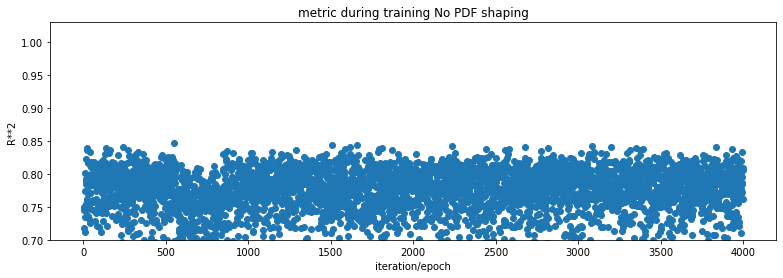

Training loss: tensor(0.1578, grad_fn=<MseLossBackward0>)
Training R**2: 0.8037448677525653
Test loss - scaled: tensor(0.1851, grad_fn=<MseLossBackward0>)
Test loss - descaled: tensor(12341988., grad_fn=<MseLossBackward0>)
Testing R**2 - scaled: 0.7676122976197371
Testing R**2 - descaled: 0.7676123290164217
*****
*****
Testing R**2 - Output: 0 0.23799547584858405
*****
*****
Testing R**2 - Output: 1 0.8351242069777123
*****
*****
Testing R**2 - Output: 2 0.9393828178574886
*****
*****
Testing R**2 - Output: 3 0.8448029500515356
*****
*****
Testing R**2 - Output: 4 0.9807561901278697


In [26]:

model = F1plusF2_SIO(x_means, x_deviations, y_means, y_deviations)
opt = torch.optim.Adam(   model.parameters(), lr=learning_rate   )
loss_fn = F.mse_loss


fit_y_scaled(N_EPOCHS, model, loss_fn, opt)


pred_descaled, pred_scaled = model(X_test_tr)
print('Test loss - scaled:',   loss_fn(     pred_scaled,                   y_test_tr_scaled          ))
print('Test loss - descaled:', loss_fn(     pred_descaled,                 y_test_tr                 ))
print('Testing R**2 - scaled:',   r2_score( pred_scaled.detach().numpy(),    y_test_tr_scaled.numpy()  ))
print('Testing R**2 - descaled:', r2_score( pred_descaled.detach().numpy(),  y_test_tr.numpy()         ))

print_individual_Rsquare(pred_descaled, y_test_tr)


## Use model to predict

In [27]:

list_preds = []
list_reals = []

for i in range(len(X_test_tr)):
    print("**************************************************")
    print("preds, real")
    preds_descaled, preds_scaled = model(X_test_tr[i])
    ## print(  preds_descaled.shape  )
    ## print(  preds_descaled  )
    np_pred = preds_descaled[0].detach().numpy()              ## [0]
    np_real = y_test_tr[i].detach().numpy()
    ## print(np_pred.shape)
    ## print(np_real.shape)

    for j in range(len(np_pred)):
        print((np_pred[j], np_real[j]))
        list_preds.append(np_pred[j])
        list_reals.append(np_real[j])


**************************************************
preds, real
(45.726036, 45.96437)
(44.251896, 44.24789)
(190.55919, 193.231)
(158119.81, 147960.1)
(370.82617, 370.1007)
**************************************************
preds, real
(47.02595, 48.06772)
(44.3907, 45.1243)
(144.22583, 139.7109)
(110084.195, 105652.45)
(462.32758, 474.61246)
**************************************************
preds, real
(47.41637, 46.25642)
(45.762924, 45.27268)
(113.76332, 112.4695)
(143498.47, 150081.8)
(447.15125, 454.43665)
**************************************************
preds, real
(47.291023, 46.6408)
(40.62515, 39.91885)
(191.38876, 187.6606)
(135933.48, 133833.2)
(388.41058, 388.12296)
**************************************************
preds, real
(42.544426, 43.27408)
(42.174202, 42.71181)
(238.72473, 221.0695)
(150548.11, 141740.8)
(366.2221, 369.2152)
**************************************************
preds, real
(47.240166, 48.31514)
(40.431515, 40.89604)
(110.6494, 117.9243)
(137017.55,


## Plotting


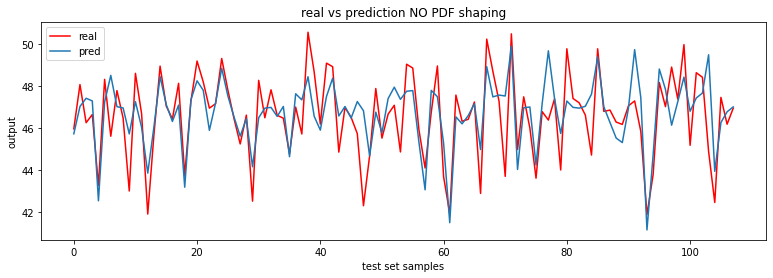

In [28]:

list_preds_y0 = [list_preds[i] for i in range(0, len(list_preds), 5)]
list_reals_y0 = [list_reals[i] for i in range(0, len(list_reals), 5)]


plt.figure(figsize=(13,4))


plt.plot(list_reals_y0, label= 'real', color='r' )
plt.plot(list_preds_y0, label= 'pred')

    
plt.title('real vs prediction NO PDF shaping')
plt.xlabel('test set samples')
plt.ylabel('output')
plt.legend()

plt.savefig('images/Y0ShaftRealToPredictedNoPDFshaping.png', dpi=300)

plt.show()


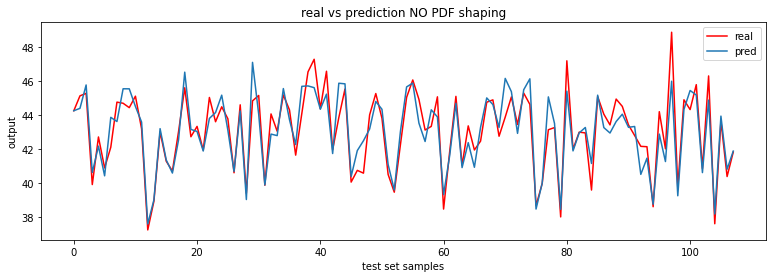

In [29]:

list_preds_y1 = [list_preds[i] for i in range(1, len(list_preds), 5)]
list_reals_y1 = [list_reals[i] for i in range(1, len(list_reals), 5)]


plt.figure(figsize=(13,4))


plt.plot(list_reals_y1, label= 'real', color='r' )
plt.plot(list_preds_y1, label= 'pred')

    
plt.title('real vs prediction NO PDF shaping')
plt.xlabel('test set samples')
plt.ylabel('output')
plt.legend()

plt.savefig('images/Y1ShaftRealToPredictedNoPDFshaping.png', dpi=300)

plt.show()


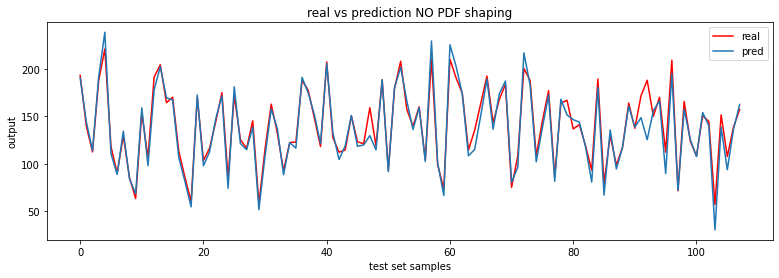

In [30]:

list_preds_y2 = [list_preds[i] for i in range(2, len(list_preds), 5)]
list_reals_y2 = [list_reals[i] for i in range(2, len(list_reals), 5)]


plt.figure(figsize=(13,4))


plt.plot(list_reals_y2, label= 'real', color='r' )
plt.plot(list_preds_y2, label= 'pred')

    
plt.title('real vs prediction NO PDF shaping')
plt.xlabel('test set samples')
plt.ylabel('output')
plt.legend()

plt.savefig('images/Y2ShaftRealToPredictedNoPDFshaping.png', dpi=300)

plt.show()


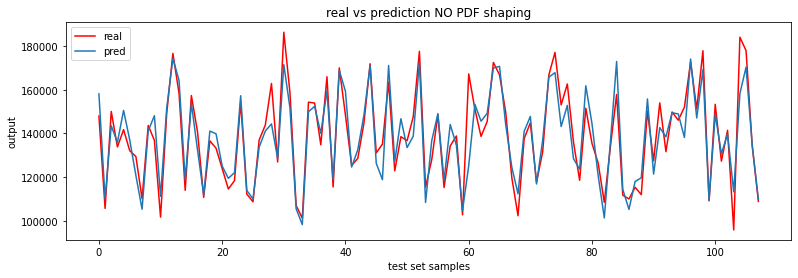

In [31]:

list_preds_y3 = [list_preds[i] for i in range(3, len(list_preds), 5)]
list_reals_y3 = [list_reals[i] for i in range(3, len(list_reals), 5)]


plt.figure(figsize=(13,4))


plt.plot(list_reals_y3, label= 'real', color='r' )
plt.plot(list_preds_y3, label= 'pred')

    
plt.title('real vs prediction NO PDF shaping')
plt.xlabel('test set samples')
plt.ylabel('output')
plt.legend()

plt.savefig('images/Y3ShaftRealToPredictedNoPDFshaping.png', dpi=300)

plt.show()


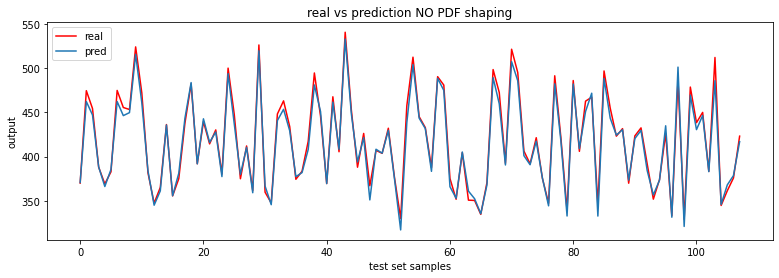

In [32]:

list_preds_y4 = [list_preds[i] for i in range(4, len(list_preds), 5)]
list_reals_y4 = [list_reals[i] for i in range(4, len(list_reals), 5)]


plt.figure(figsize=(13,4))


plt.plot(list_reals_y4, label= 'real', color='r' )
plt.plot(list_preds_y4, label= 'pred')

    
plt.title('real vs prediction NO PDF shaping')
plt.xlabel('test set samples')
plt.ylabel('output')
plt.legend()

plt.savefig('images/Y4ShaftRealToPredictedNoPDFshaping.png', dpi=300)

plt.show()


/Users/user/opt/anaconda3/envs/py38/lib/python3.8/site-packages/seaborn/distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


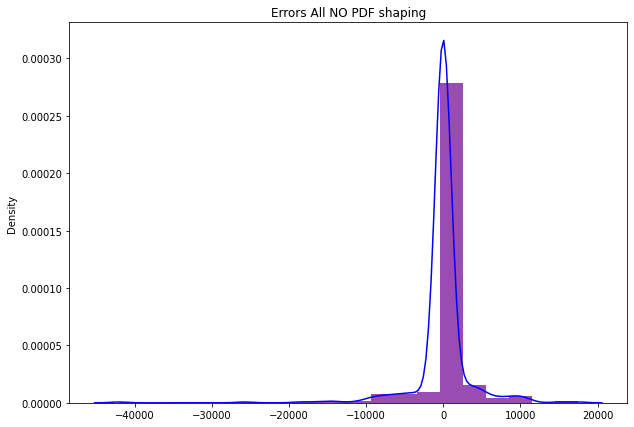

In [33]:

n_bins = 20

y_pred = np.array(list_preds)

y_real = np.array(list_reals)

error = y_pred - y_real


fig, ax = plt.subplots(figsize =(10, 7))

plt.hist(error,     bins=n_bins, density = True, color='r', alpha=0.5)

sns.distplot(error, bins=n_bins, color="blue")

plt.title('Errors All NO PDF shaping')


plt.show()


/Users/user/opt/anaconda3/envs/py38/lib/python3.8/site-packages/seaborn/distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


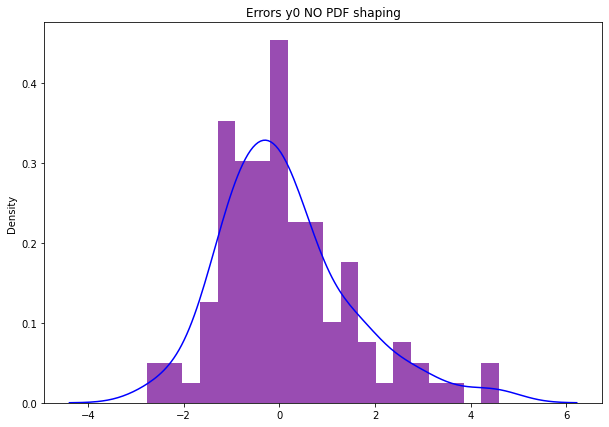

In [34]:

n_bins = 20

y_pred = np.array(list_preds_y0)

y_real = np.array(list_reals_y0)

error = y_pred - y_real


fig, ax = plt.subplots(figsize =(10, 7))

plt.hist(error, bins=n_bins, density = True, color='r', alpha=0.5)

sns.distplot(error, bins=n_bins, color="blue")

plt.title('Errors y0 NO PDF shaping')


plt.show()


/Users/user/opt/anaconda3/envs/py38/lib/python3.8/site-packages/seaborn/distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


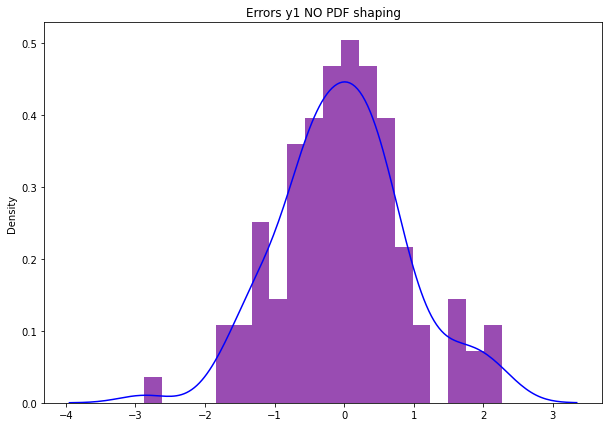

In [35]:

n_bins = 20

y_pred = np.array(list_preds_y1)

y_real = np.array(list_reals_y1)

error = y_pred - y_real


fig, ax = plt.subplots(figsize =(10, 7))

plt.hist(error, bins=n_bins, density = True, color='r', alpha=0.5)

sns.distplot(error, bins=n_bins, color="blue")

plt.title('Errors y1 NO PDF shaping')


plt.show()


/Users/user/opt/anaconda3/envs/py38/lib/python3.8/site-packages/seaborn/distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


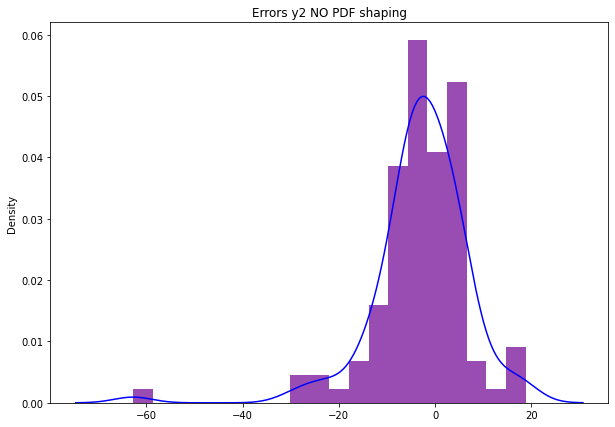

In [36]:


n_bins = 20

y_pred = np.array(list_preds_y2)

y_real = np.array(list_reals_y2)

error = y_pred - y_real


fig, ax = plt.subplots(figsize =(10, 7))

plt.hist(error, bins=n_bins, density = True, color='r', alpha=0.5)

sns.distplot(error, bins=n_bins, color="blue")


plt.title('Errors y2 NO PDF shaping')


plt.show()


/Users/user/opt/anaconda3/envs/py38/lib/python3.8/site-packages/seaborn/distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


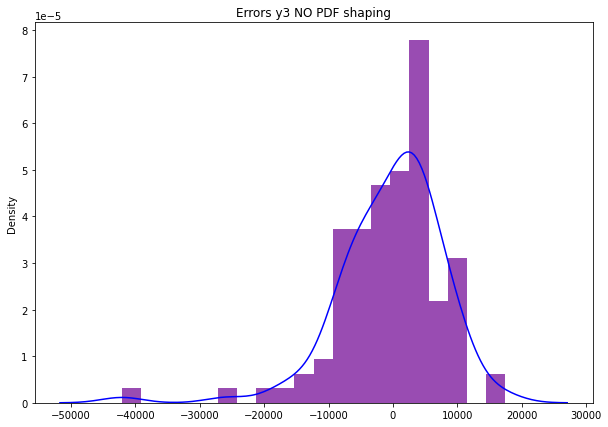

In [37]:

n_bins = 20

y_pred = np.array(list_preds_y3)

y_real = np.array(list_reals_y3)

error = y_pred - y_real


fig, ax = plt.subplots(figsize =(10, 7))

plt.hist(error, bins=n_bins, density = True, color='r', alpha=0.5)

sns.distplot(error, bins=n_bins, color="blue")


plt.title('Errors y3 NO PDF shaping')


plt.show()


/Users/user/opt/anaconda3/envs/py38/lib/python3.8/site-packages/seaborn/distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


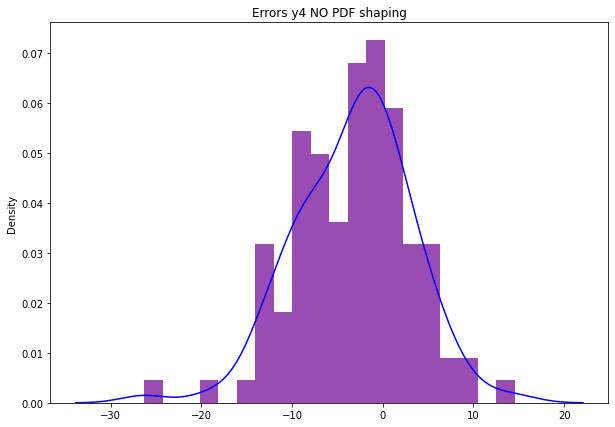

In [38]:

n_bins = 20

y_pred = np.array(list_preds_y4)

y_real = np.array(list_reals_y4)

error = y_pred - y_real


fig, ax = plt.subplots(figsize =(10, 7))

plt.hist(error, bins=n_bins, density = True, color='r', alpha=0.5)

sns.distplot(error, bins=n_bins, color="blue")

plt.title('Errors y4 NO PDF shaping')


plt.show()


## Results for g(x) = F1(x) + F2(x) with PDF shaping

F1 = Linear

F2 = Nonlinear

In [39]:

def print_individual_Rsquare(pred_descaled, y_test_tr):
    vector_pred_descaled = pred_descaled.detach().numpy()
    vector_y_test_tr     = y_test_tr.numpy()

    for i in range(len(output_indeces)):
        ## print(vector_pred_descaled.shape)
        print("*****")
        print("*****")
        print('Testing R**2 - Output: ' + str(i), r2_score( vector_pred_descaled[:, i], vector_y_test_tr[:, i] ) )
        


0  loss=  tensor(0.7777, grad_fn=<MseLossBackward0>)
0  loss=  tensor(0.8838, grad_fn=<MseLossBackward0>)
0  loss=  tensor(0.8622, grad_fn=<MseLossBackward0>)
0  loss=  tensor(0.9308, grad_fn=<MseLossBackward0>)
0  loss=  tensor(0.6216, grad_fn=<MseLossBackward0>)
0  loss=  tensor(0.6245, grad_fn=<MseLossBackward0>)
0  loss=  tensor(0.7320, grad_fn=<MseLossBackward0>)
0  loss=  tensor(0.2918, grad_fn=<MseLossBackward0>)
0  loss=  tensor(0.5577, grad_fn=<MseLossBackward0>)
0  loss=  tensor(0.3885, grad_fn=<MseLossBackward0>)
0  loss=  tensor(0.4513, grad_fn=<MseLossBackward0>)
0  loss=  tensor(0.5333, grad_fn=<MseLossBackward0>)
0  loss=  tensor(0.4261, grad_fn=<MseLossBackward0>)
0  loss=  tensor(0.5589, grad_fn=<MseLossBackward0>)
0  loss=  tensor(0.4428, grad_fn=<MseLossBackward0>)
0  loss=  tensor(0.3478, grad_fn=<MseLossBackward0>)
0  loss=  tensor(0.5610, grad_fn=<MseLossBackward0>)
0  loss=  tensor(0.3909, grad_fn=<MseLossBackward0>)
0  loss=  tensor(0.3746, grad_fn=<MseLossBackw

11  loss=  tensor(0.1652, grad_fn=<MseLossBackward0>)
11  loss=  tensor(0.1370, grad_fn=<MseLossBackward0>)
11  loss=  tensor(0.1780, grad_fn=<MseLossBackward0>)
11  loss=  tensor(0.1029, grad_fn=<MseLossBackward0>)
11  loss=  tensor(0.1314, grad_fn=<MseLossBackward0>)
11  loss=  tensor(0.1539, grad_fn=<MseLossBackward0>)
11  loss=  tensor(0.2198, grad_fn=<MseLossBackward0>)
11  loss=  tensor(0.1805, grad_fn=<MseLossBackward0>)
11  loss=  tensor(0.1403, grad_fn=<MseLossBackward0>)
11  loss=  tensor(0.2670, grad_fn=<MseLossBackward0>)
11  loss=  tensor(0.1955, grad_fn=<MseLossBackward0>)
11  loss=  tensor(0.1612, grad_fn=<MseLossBackward0>)
12  loss=  tensor(0.1081, grad_fn=<MseLossBackward0>)
12  loss=  tensor(0.1323, grad_fn=<MseLossBackward0>)
12  loss=  tensor(0.1695, grad_fn=<MseLossBackward0>)
12  loss=  tensor(0.1713, grad_fn=<MseLossBackward0>)
12  loss=  tensor(0.1664, grad_fn=<MseLossBackward0>)
12  loss=  tensor(0.1612, grad_fn=<MseLossBackward0>)
12  loss=  tensor(0.1666, gr

24  loss=  tensor(0.1540, grad_fn=<MseLossBackward0>)
24  loss=  tensor(0.0818, grad_fn=<MseLossBackward0>)
24  loss=  tensor(0.1926, grad_fn=<MseLossBackward0>)
24  loss=  tensor(0.0933, grad_fn=<MseLossBackward0>)
24  loss=  tensor(0.0779, grad_fn=<MseLossBackward0>)
24  loss=  tensor(0.1552, grad_fn=<MseLossBackward0>)
24  loss=  tensor(0.1263, grad_fn=<MseLossBackward0>)
24  loss=  tensor(0.0894, grad_fn=<MseLossBackward0>)
24  loss=  tensor(0.1563, grad_fn=<MseLossBackward0>)
24  loss=  tensor(0.0976, grad_fn=<MseLossBackward0>)
24  loss=  tensor(0.1893, grad_fn=<MseLossBackward0>)
25  loss=  tensor(0.2020, grad_fn=<MseLossBackward0>)
25  loss=  tensor(0.1623, grad_fn=<MseLossBackward0>)
25  loss=  tensor(0.1821, grad_fn=<MseLossBackward0>)
25  loss=  tensor(0.2055, grad_fn=<MseLossBackward0>)
25  loss=  tensor(0.2276, grad_fn=<MseLossBackward0>)
25  loss=  tensor(0.1162, grad_fn=<MseLossBackward0>)
25  loss=  tensor(0.1947, grad_fn=<MseLossBackward0>)
25  loss=  tensor(0.1888, gr

37  loss=  tensor(0.1389, grad_fn=<MseLossBackward0>)
37  loss=  tensor(0.2546, grad_fn=<MseLossBackward0>)
37  loss=  tensor(0.2079, grad_fn=<MseLossBackward0>)
37  loss=  tensor(0.1152, grad_fn=<MseLossBackward0>)
37  loss=  tensor(0.1430, grad_fn=<MseLossBackward0>)
38  loss=  tensor(0.1987, grad_fn=<MseLossBackward0>)
38  loss=  tensor(0.3563, grad_fn=<MseLossBackward0>)
38  loss=  tensor(0.1295, grad_fn=<MseLossBackward0>)
38  loss=  tensor(0.2553, grad_fn=<MseLossBackward0>)
38  loss=  tensor(0.1629, grad_fn=<MseLossBackward0>)
38  loss=  tensor(0.1988, grad_fn=<MseLossBackward0>)
38  loss=  tensor(0.1189, grad_fn=<MseLossBackward0>)
38  loss=  tensor(0.1397, grad_fn=<MseLossBackward0>)
38  loss=  tensor(0.1066, grad_fn=<MseLossBackward0>)
38  loss=  tensor(0.1407, grad_fn=<MseLossBackward0>)
38  loss=  tensor(0.1146, grad_fn=<MseLossBackward0>)
38  loss=  tensor(0.1166, grad_fn=<MseLossBackward0>)
38  loss=  tensor(0.2823, grad_fn=<MseLossBackward0>)
38  loss=  tensor(0.1307, gr

51  loss=  tensor(0.1121, grad_fn=<MseLossBackward0>)
51  loss=  tensor(0.1886, grad_fn=<MseLossBackward0>)
51  loss=  tensor(0.0941, grad_fn=<MseLossBackward0>)
51  loss=  tensor(0.1521, grad_fn=<MseLossBackward0>)
51  loss=  tensor(0.1753, grad_fn=<MseLossBackward0>)
51  loss=  tensor(0.1977, grad_fn=<MseLossBackward0>)
51  loss=  tensor(0.1410, grad_fn=<MseLossBackward0>)
51  loss=  tensor(0.0808, grad_fn=<MseLossBackward0>)
51  loss=  tensor(0.1457, grad_fn=<MseLossBackward0>)
51  loss=  tensor(0.1302, grad_fn=<MseLossBackward0>)
51  loss=  tensor(0.1728, grad_fn=<MseLossBackward0>)
51  loss=  tensor(0.1831, grad_fn=<MseLossBackward0>)
51  loss=  tensor(0.1275, grad_fn=<MseLossBackward0>)
51  loss=  tensor(0.1138, grad_fn=<MseLossBackward0>)
51  loss=  tensor(0.1752, grad_fn=<MseLossBackward0>)
51  loss=  tensor(0.0897, grad_fn=<MseLossBackward0>)
51  loss=  tensor(0.2025, grad_fn=<MseLossBackward0>)
51  loss=  tensor(0.1773, grad_fn=<MseLossBackward0>)
51  loss=  tensor(0.1748, gr

64  loss=  tensor(0.2582, grad_fn=<MseLossBackward0>)
64  loss=  tensor(0.2187, grad_fn=<MseLossBackward0>)
64  loss=  tensor(0.2777, grad_fn=<MseLossBackward0>)
64  loss=  tensor(0.1742, grad_fn=<MseLossBackward0>)
64  loss=  tensor(0.2469, grad_fn=<MseLossBackward0>)
64  loss=  tensor(0.0986, grad_fn=<MseLossBackward0>)
64  loss=  tensor(0.1641, grad_fn=<MseLossBackward0>)
64  loss=  tensor(0.2407, grad_fn=<MseLossBackward0>)
64  loss=  tensor(0.1237, grad_fn=<MseLossBackward0>)
64  loss=  tensor(0.2716, grad_fn=<MseLossBackward0>)
64  loss=  tensor(0.2237, grad_fn=<MseLossBackward0>)
64  loss=  tensor(0.1135, grad_fn=<MseLossBackward0>)
64  loss=  tensor(0.1957, grad_fn=<MseLossBackward0>)
64  loss=  tensor(0.1261, grad_fn=<MseLossBackward0>)
64  loss=  tensor(0.0986, grad_fn=<MseLossBackward0>)
64  loss=  tensor(0.2301, grad_fn=<MseLossBackward0>)
64  loss=  tensor(0.1283, grad_fn=<MseLossBackward0>)
64  loss=  tensor(0.2089, grad_fn=<MseLossBackward0>)
64  loss=  tensor(0.1808, gr

77  loss=  tensor(0.3401, grad_fn=<MseLossBackward0>)
77  loss=  tensor(0.1604, grad_fn=<MseLossBackward0>)
77  loss=  tensor(0.1579, grad_fn=<MseLossBackward0>)
77  loss=  tensor(0.1799, grad_fn=<MseLossBackward0>)
77  loss=  tensor(0.1713, grad_fn=<MseLossBackward0>)
77  loss=  tensor(0.3096, grad_fn=<MseLossBackward0>)
77  loss=  tensor(0.1639, grad_fn=<MseLossBackward0>)
77  loss=  tensor(0.1607, grad_fn=<MseLossBackward0>)
77  loss=  tensor(0.2187, grad_fn=<MseLossBackward0>)
77  loss=  tensor(0.1934, grad_fn=<MseLossBackward0>)
77  loss=  tensor(0.1518, grad_fn=<MseLossBackward0>)
77  loss=  tensor(0.1772, grad_fn=<MseLossBackward0>)
77  loss=  tensor(0.1351, grad_fn=<MseLossBackward0>)
77  loss=  tensor(0.1891, grad_fn=<MseLossBackward0>)
77  loss=  tensor(0.2376, grad_fn=<MseLossBackward0>)
77  loss=  tensor(0.1049, grad_fn=<MseLossBackward0>)
77  loss=  tensor(0.1517, grad_fn=<MseLossBackward0>)
77  loss=  tensor(0.0630, grad_fn=<MseLossBackward0>)
78  loss=  tensor(0.1633, gr

90  loss=  tensor(0.3043, grad_fn=<MseLossBackward0>)
90  loss=  tensor(0.1164, grad_fn=<MseLossBackward0>)
90  loss=  tensor(0.0702, grad_fn=<MseLossBackward0>)
90  loss=  tensor(0.1407, grad_fn=<MseLossBackward0>)
90  loss=  tensor(0.2393, grad_fn=<MseLossBackward0>)
90  loss=  tensor(0.1326, grad_fn=<MseLossBackward0>)
90  loss=  tensor(0.1551, grad_fn=<MseLossBackward0>)
90  loss=  tensor(0.1842, grad_fn=<MseLossBackward0>)
90  loss=  tensor(0.2960, grad_fn=<MseLossBackward0>)
90  loss=  tensor(0.1353, grad_fn=<MseLossBackward0>)
90  loss=  tensor(0.1557, grad_fn=<MseLossBackward0>)
90  loss=  tensor(0.1596, grad_fn=<MseLossBackward0>)
90  loss=  tensor(0.1057, grad_fn=<MseLossBackward0>)
90  loss=  tensor(0.2277, grad_fn=<MseLossBackward0>)
90  loss=  tensor(0.2106, grad_fn=<MseLossBackward0>)
90  loss=  tensor(0.0700, grad_fn=<MseLossBackward0>)
91  loss=  tensor(0.1258, grad_fn=<MseLossBackward0>)
91  loss=  tensor(0.1466, grad_fn=<MseLossBackward0>)
91  loss=  tensor(0.1147, gr

103  loss=  tensor(0.3658, grad_fn=<MseLossBackward0>)
103  loss=  tensor(0.1969, grad_fn=<MseLossBackward0>)
103  loss=  tensor(0.1166, grad_fn=<MseLossBackward0>)
103  loss=  tensor(0.1165, grad_fn=<MseLossBackward0>)
103  loss=  tensor(0.1487, grad_fn=<MseLossBackward0>)
103  loss=  tensor(0.2186, grad_fn=<MseLossBackward0>)
103  loss=  tensor(0.1411, grad_fn=<MseLossBackward0>)
103  loss=  tensor(0.2055, grad_fn=<MseLossBackward0>)
103  loss=  tensor(0.1321, grad_fn=<MseLossBackward0>)
103  loss=  tensor(0.1050, grad_fn=<MseLossBackward0>)
103  loss=  tensor(0.1364, grad_fn=<MseLossBackward0>)
103  loss=  tensor(0.1907, grad_fn=<MseLossBackward0>)
103  loss=  tensor(0.0686, grad_fn=<MseLossBackward0>)
104  loss=  tensor(0.4298, grad_fn=<MseLossBackward0>)
104  loss=  tensor(0.1362, grad_fn=<MseLossBackward0>)
104  loss=  tensor(0.2178, grad_fn=<MseLossBackward0>)
104  loss=  tensor(0.1407, grad_fn=<MseLossBackward0>)
104  loss=  tensor(0.2050, grad_fn=<MseLossBackward0>)
104  loss=

116  loss=  tensor(0.1114, grad_fn=<MseLossBackward0>)
116  loss=  tensor(0.1655, grad_fn=<MseLossBackward0>)
116  loss=  tensor(0.0774, grad_fn=<MseLossBackward0>)
116  loss=  tensor(0.1644, grad_fn=<MseLossBackward0>)
116  loss=  tensor(0.1190, grad_fn=<MseLossBackward0>)
116  loss=  tensor(0.1371, grad_fn=<MseLossBackward0>)
116  loss=  tensor(0.1542, grad_fn=<MseLossBackward0>)
116  loss=  tensor(0.2591, grad_fn=<MseLossBackward0>)
116  loss=  tensor(0.1741, grad_fn=<MseLossBackward0>)
117  loss=  tensor(0.0866, grad_fn=<MseLossBackward0>)
117  loss=  tensor(0.1405, grad_fn=<MseLossBackward0>)
117  loss=  tensor(0.0920, grad_fn=<MseLossBackward0>)
117  loss=  tensor(0.1163, grad_fn=<MseLossBackward0>)
117  loss=  tensor(0.2557, grad_fn=<MseLossBackward0>)
117  loss=  tensor(0.1472, grad_fn=<MseLossBackward0>)
117  loss=  tensor(0.2421, grad_fn=<MseLossBackward0>)
117  loss=  tensor(0.1354, grad_fn=<MseLossBackward0>)
117  loss=  tensor(0.0901, grad_fn=<MseLossBackward0>)
117  loss=

129  loss=  tensor(0.2482, grad_fn=<MseLossBackward0>)
129  loss=  tensor(0.1355, grad_fn=<MseLossBackward0>)
129  loss=  tensor(0.0971, grad_fn=<MseLossBackward0>)
129  loss=  tensor(0.2300, grad_fn=<MseLossBackward0>)
129  loss=  tensor(0.1793, grad_fn=<MseLossBackward0>)
129  loss=  tensor(0.1937, grad_fn=<MseLossBackward0>)
129  loss=  tensor(0.1103, grad_fn=<MseLossBackward0>)
129  loss=  tensor(0.1659, grad_fn=<MseLossBackward0>)
129  loss=  tensor(0.1550, grad_fn=<MseLossBackward0>)
129  loss=  tensor(0.1887, grad_fn=<MseLossBackward0>)
130  loss=  tensor(0.3720, grad_fn=<MseLossBackward0>)
130  loss=  tensor(0.1502, grad_fn=<MseLossBackward0>)
130  loss=  tensor(0.1313, grad_fn=<MseLossBackward0>)
130  loss=  tensor(0.2039, grad_fn=<MseLossBackward0>)
130  loss=  tensor(0.2480, grad_fn=<MseLossBackward0>)
130  loss=  tensor(0.1370, grad_fn=<MseLossBackward0>)
130  loss=  tensor(0.1372, grad_fn=<MseLossBackward0>)
130  loss=  tensor(0.0757, grad_fn=<MseLossBackward0>)
130  loss=

142  loss=  tensor(0.1468, grad_fn=<MseLossBackward0>)
142  loss=  tensor(0.1035, grad_fn=<MseLossBackward0>)
142  loss=  tensor(0.1757, grad_fn=<MseLossBackward0>)
142  loss=  tensor(0.1445, grad_fn=<MseLossBackward0>)
142  loss=  tensor(0.1345, grad_fn=<MseLossBackward0>)
142  loss=  tensor(0.1697, grad_fn=<MseLossBackward0>)
142  loss=  tensor(0.1654, grad_fn=<MseLossBackward0>)
143  loss=  tensor(0.1941, grad_fn=<MseLossBackward0>)
143  loss=  tensor(0.1438, grad_fn=<MseLossBackward0>)
143  loss=  tensor(0.1446, grad_fn=<MseLossBackward0>)
143  loss=  tensor(0.0661, grad_fn=<MseLossBackward0>)
143  loss=  tensor(0.1952, grad_fn=<MseLossBackward0>)
143  loss=  tensor(0.2012, grad_fn=<MseLossBackward0>)
143  loss=  tensor(0.0896, grad_fn=<MseLossBackward0>)
143  loss=  tensor(0.2649, grad_fn=<MseLossBackward0>)
143  loss=  tensor(0.1672, grad_fn=<MseLossBackward0>)
143  loss=  tensor(0.1563, grad_fn=<MseLossBackward0>)
143  loss=  tensor(0.1220, grad_fn=<MseLossBackward0>)
143  loss=

155  loss=  tensor(0.1625, grad_fn=<MseLossBackward0>)
155  loss=  tensor(0.1411, grad_fn=<MseLossBackward0>)
155  loss=  tensor(0.2050, grad_fn=<MseLossBackward0>)
156  loss=  tensor(0.2388, grad_fn=<MseLossBackward0>)
156  loss=  tensor(0.1418, grad_fn=<MseLossBackward0>)
156  loss=  tensor(0.1789, grad_fn=<MseLossBackward0>)
156  loss=  tensor(0.1082, grad_fn=<MseLossBackward0>)
156  loss=  tensor(0.2260, grad_fn=<MseLossBackward0>)
156  loss=  tensor(0.0950, grad_fn=<MseLossBackward0>)
156  loss=  tensor(0.0856, grad_fn=<MseLossBackward0>)
156  loss=  tensor(0.1574, grad_fn=<MseLossBackward0>)
156  loss=  tensor(0.1966, grad_fn=<MseLossBackward0>)
156  loss=  tensor(0.1237, grad_fn=<MseLossBackward0>)
156  loss=  tensor(0.1690, grad_fn=<MseLossBackward0>)
156  loss=  tensor(0.1376, grad_fn=<MseLossBackward0>)
156  loss=  tensor(0.1671, grad_fn=<MseLossBackward0>)
156  loss=  tensor(0.1335, grad_fn=<MseLossBackward0>)
156  loss=  tensor(0.2300, grad_fn=<MseLossBackward0>)
156  loss=

168  loss=  tensor(0.2093, grad_fn=<MseLossBackward0>)
168  loss=  tensor(0.2112, grad_fn=<MseLossBackward0>)
168  loss=  tensor(0.1868, grad_fn=<MseLossBackward0>)
168  loss=  tensor(0.1437, grad_fn=<MseLossBackward0>)
168  loss=  tensor(0.2323, grad_fn=<MseLossBackward0>)
168  loss=  tensor(0.1091, grad_fn=<MseLossBackward0>)
168  loss=  tensor(0.2612, grad_fn=<MseLossBackward0>)
168  loss=  tensor(0.1861, grad_fn=<MseLossBackward0>)
168  loss=  tensor(0.1244, grad_fn=<MseLossBackward0>)
168  loss=  tensor(0.1755, grad_fn=<MseLossBackward0>)
169  loss=  tensor(0.1605, grad_fn=<MseLossBackward0>)
169  loss=  tensor(0.1980, grad_fn=<MseLossBackward0>)
169  loss=  tensor(0.2491, grad_fn=<MseLossBackward0>)
169  loss=  tensor(0.1662, grad_fn=<MseLossBackward0>)
169  loss=  tensor(0.2283, grad_fn=<MseLossBackward0>)
169  loss=  tensor(0.1305, grad_fn=<MseLossBackward0>)
169  loss=  tensor(0.1112, grad_fn=<MseLossBackward0>)
169  loss=  tensor(0.0999, grad_fn=<MseLossBackward0>)
169  loss=

179  loss=  tensor(0.1365, grad_fn=<MseLossBackward0>)
179  loss=  tensor(0.1606, grad_fn=<MseLossBackward0>)
179  loss=  tensor(0.1405, grad_fn=<MseLossBackward0>)
179  loss=  tensor(0.3905, grad_fn=<MseLossBackward0>)
179  loss=  tensor(0.0952, grad_fn=<MseLossBackward0>)
179  loss=  tensor(0.2152, grad_fn=<MseLossBackward0>)
179  loss=  tensor(0.1550, grad_fn=<MseLossBackward0>)
179  loss=  tensor(0.1110, grad_fn=<MseLossBackward0>)
179  loss=  tensor(0.1319, grad_fn=<MseLossBackward0>)
179  loss=  tensor(0.1428, grad_fn=<MseLossBackward0>)
179  loss=  tensor(0.2882, grad_fn=<MseLossBackward0>)
179  loss=  tensor(0.2967, grad_fn=<MseLossBackward0>)
179  loss=  tensor(0.1711, grad_fn=<MseLossBackward0>)
180  loss=  tensor(0.1169, grad_fn=<MseLossBackward0>)
180  loss=  tensor(0.1078, grad_fn=<MseLossBackward0>)
180  loss=  tensor(0.1748, grad_fn=<MseLossBackward0>)
180  loss=  tensor(0.0977, grad_fn=<MseLossBackward0>)
180  loss=  tensor(0.1876, grad_fn=<MseLossBackward0>)
180  loss=

191  loss=  tensor(0.1304, grad_fn=<MseLossBackward0>)
191  loss=  tensor(0.1836, grad_fn=<MseLossBackward0>)
191  loss=  tensor(0.2202, grad_fn=<MseLossBackward0>)
191  loss=  tensor(0.1841, grad_fn=<MseLossBackward0>)
191  loss=  tensor(0.1406, grad_fn=<MseLossBackward0>)
191  loss=  tensor(0.2347, grad_fn=<MseLossBackward0>)
191  loss=  tensor(0.2170, grad_fn=<MseLossBackward0>)
191  loss=  tensor(0.1412, grad_fn=<MseLossBackward0>)
191  loss=  tensor(0.1410, grad_fn=<MseLossBackward0>)
191  loss=  tensor(0.2054, grad_fn=<MseLossBackward0>)
191  loss=  tensor(0.2766, grad_fn=<MseLossBackward0>)
191  loss=  tensor(0.1024, grad_fn=<MseLossBackward0>)
191  loss=  tensor(0.2485, grad_fn=<MseLossBackward0>)
191  loss=  tensor(0.2649, grad_fn=<MseLossBackward0>)
191  loss=  tensor(0.1422, grad_fn=<MseLossBackward0>)
191  loss=  tensor(0.1953, grad_fn=<MseLossBackward0>)
191  loss=  tensor(0.2698, grad_fn=<MseLossBackward0>)
191  loss=  tensor(0.1395, grad_fn=<MseLossBackward0>)
191  loss=

201  loss=  tensor(0.1819, grad_fn=<MseLossBackward0>)
201  loss=  tensor(0.1364, grad_fn=<MseLossBackward0>)
201  loss=  tensor(0.1362, grad_fn=<MseLossBackward0>)
201  loss=  tensor(0.2023, grad_fn=<MseLossBackward0>)
201  loss=  tensor(0.0965, grad_fn=<MseLossBackward0>)
201  loss=  tensor(0.1326, grad_fn=<MseLossBackward0>)
202  loss=  tensor(0.0787, grad_fn=<MseLossBackward0>)
202  loss=  tensor(0.1687, grad_fn=<MseLossBackward0>)
202  loss=  tensor(0.2276, grad_fn=<MseLossBackward0>)
202  loss=  tensor(0.1422, grad_fn=<MseLossBackward0>)
202  loss=  tensor(0.1616, grad_fn=<MseLossBackward0>)
202  loss=  tensor(0.1360, grad_fn=<MseLossBackward0>)
202  loss=  tensor(0.1313, grad_fn=<MseLossBackward0>)
202  loss=  tensor(0.1845, grad_fn=<MseLossBackward0>)
202  loss=  tensor(0.0578, grad_fn=<MseLossBackward0>)
202  loss=  tensor(0.2731, grad_fn=<MseLossBackward0>)
202  loss=  tensor(0.1142, grad_fn=<MseLossBackward0>)
202  loss=  tensor(0.2174, grad_fn=<MseLossBackward0>)
202  loss=

212  loss=  tensor(0.1282, grad_fn=<MseLossBackward0>)
212  loss=  tensor(0.2206, grad_fn=<MseLossBackward0>)
212  loss=  tensor(0.1935, grad_fn=<MseLossBackward0>)
213  loss=  tensor(0.1036, grad_fn=<MseLossBackward0>)
213  loss=  tensor(0.1058, grad_fn=<MseLossBackward0>)
213  loss=  tensor(0.2968, grad_fn=<MseLossBackward0>)
213  loss=  tensor(0.1342, grad_fn=<MseLossBackward0>)
213  loss=  tensor(0.1867, grad_fn=<MseLossBackward0>)
213  loss=  tensor(0.1429, grad_fn=<MseLossBackward0>)
213  loss=  tensor(0.1685, grad_fn=<MseLossBackward0>)
213  loss=  tensor(0.1495, grad_fn=<MseLossBackward0>)
213  loss=  tensor(0.1534, grad_fn=<MseLossBackward0>)
213  loss=  tensor(0.1635, grad_fn=<MseLossBackward0>)
213  loss=  tensor(0.1396, grad_fn=<MseLossBackward0>)
213  loss=  tensor(0.2426, grad_fn=<MseLossBackward0>)
213  loss=  tensor(0.1447, grad_fn=<MseLossBackward0>)
213  loss=  tensor(0.1995, grad_fn=<MseLossBackward0>)
213  loss=  tensor(0.1001, grad_fn=<MseLossBackward0>)
213  loss=

224  loss=  tensor(0.2061, grad_fn=<MseLossBackward0>)
224  loss=  tensor(0.1757, grad_fn=<MseLossBackward0>)
224  loss=  tensor(0.2721, grad_fn=<MseLossBackward0>)
224  loss=  tensor(0.1972, grad_fn=<MseLossBackward0>)
224  loss=  tensor(0.1164, grad_fn=<MseLossBackward0>)
224  loss=  tensor(0.1287, grad_fn=<MseLossBackward0>)
224  loss=  tensor(0.1169, grad_fn=<MseLossBackward0>)
225  loss=  tensor(0.1883, grad_fn=<MseLossBackward0>)
225  loss=  tensor(0.2248, grad_fn=<MseLossBackward0>)
225  loss=  tensor(0.2596, grad_fn=<MseLossBackward0>)
225  loss=  tensor(0.1158, grad_fn=<MseLossBackward0>)
225  loss=  tensor(0.1057, grad_fn=<MseLossBackward0>)
225  loss=  tensor(0.2681, grad_fn=<MseLossBackward0>)
225  loss=  tensor(0.2710, grad_fn=<MseLossBackward0>)
225  loss=  tensor(0.1216, grad_fn=<MseLossBackward0>)
225  loss=  tensor(0.0850, grad_fn=<MseLossBackward0>)
225  loss=  tensor(0.3036, grad_fn=<MseLossBackward0>)
225  loss=  tensor(0.2788, grad_fn=<MseLossBackward0>)
225  loss=

237  loss=  tensor(0.2451, grad_fn=<MseLossBackward0>)
237  loss=  tensor(0.0934, grad_fn=<MseLossBackward0>)
237  loss=  tensor(0.1194, grad_fn=<MseLossBackward0>)
237  loss=  tensor(0.1560, grad_fn=<MseLossBackward0>)
237  loss=  tensor(0.1099, grad_fn=<MseLossBackward0>)
237  loss=  tensor(0.2112, grad_fn=<MseLossBackward0>)
237  loss=  tensor(0.1885, grad_fn=<MseLossBackward0>)
237  loss=  tensor(0.0834, grad_fn=<MseLossBackward0>)
237  loss=  tensor(0.1383, grad_fn=<MseLossBackward0>)
237  loss=  tensor(0.1344, grad_fn=<MseLossBackward0>)
237  loss=  tensor(0.1294, grad_fn=<MseLossBackward0>)
237  loss=  tensor(0.1994, grad_fn=<MseLossBackward0>)
237  loss=  tensor(0.1861, grad_fn=<MseLossBackward0>)
237  loss=  tensor(0.2601, grad_fn=<MseLossBackward0>)
237  loss=  tensor(0.2834, grad_fn=<MseLossBackward0>)
237  loss=  tensor(0.1589, grad_fn=<MseLossBackward0>)
237  loss=  tensor(0.1262, grad_fn=<MseLossBackward0>)
237  loss=  tensor(0.2235, grad_fn=<MseLossBackward0>)
237  loss=

250  loss=  tensor(0.2241, grad_fn=<MseLossBackward0>)
250  loss=  tensor(0.1187, grad_fn=<MseLossBackward0>)
250  loss=  tensor(0.1504, grad_fn=<MseLossBackward0>)
250  loss=  tensor(0.2984, grad_fn=<MseLossBackward0>)
250  loss=  tensor(0.1240, grad_fn=<MseLossBackward0>)
250  loss=  tensor(0.2224, grad_fn=<MseLossBackward0>)
250  loss=  tensor(0.3740, grad_fn=<MseLossBackward0>)
250  loss=  tensor(0.1717, grad_fn=<MseLossBackward0>)
250  loss=  tensor(0.1614, grad_fn=<MseLossBackward0>)
250  loss=  tensor(0.1536, grad_fn=<MseLossBackward0>)
250  loss=  tensor(0.1962, grad_fn=<MseLossBackward0>)
250  loss=  tensor(0.1096, grad_fn=<MseLossBackward0>)
250  loss=  tensor(0.2237, grad_fn=<MseLossBackward0>)
250  loss=  tensor(0.1145, grad_fn=<MseLossBackward0>)
250  loss=  tensor(0.1826, grad_fn=<MseLossBackward0>)
250  loss=  tensor(0.1316, grad_fn=<MseLossBackward0>)
250  loss=  tensor(0.2654, grad_fn=<MseLossBackward0>)
250  loss=  tensor(0.1013, grad_fn=<MseLossBackward0>)
250  loss=

262  loss=  tensor(0.1911, grad_fn=<MseLossBackward0>)
262  loss=  tensor(0.1638, grad_fn=<MseLossBackward0>)
262  loss=  tensor(0.1284, grad_fn=<MseLossBackward0>)
262  loss=  tensor(0.1672, grad_fn=<MseLossBackward0>)
262  loss=  tensor(0.1023, grad_fn=<MseLossBackward0>)
262  loss=  tensor(0.0816, grad_fn=<MseLossBackward0>)
262  loss=  tensor(0.1325, grad_fn=<MseLossBackward0>)
262  loss=  tensor(0.1403, grad_fn=<MseLossBackward0>)
262  loss=  tensor(0.2066, grad_fn=<MseLossBackward0>)
262  loss=  tensor(0.2098, grad_fn=<MseLossBackward0>)
262  loss=  tensor(0.2156, grad_fn=<MseLossBackward0>)
263  loss=  tensor(0.0701, grad_fn=<MseLossBackward0>)
263  loss=  tensor(0.1815, grad_fn=<MseLossBackward0>)
263  loss=  tensor(0.1703, grad_fn=<MseLossBackward0>)
263  loss=  tensor(0.1394, grad_fn=<MseLossBackward0>)
263  loss=  tensor(0.1685, grad_fn=<MseLossBackward0>)
263  loss=  tensor(0.2352, grad_fn=<MseLossBackward0>)
263  loss=  tensor(0.2468, grad_fn=<MseLossBackward0>)
263  loss=

275  loss=  tensor(0.1633, grad_fn=<MseLossBackward0>)
275  loss=  tensor(0.1112, grad_fn=<MseLossBackward0>)
275  loss=  tensor(0.1568, grad_fn=<MseLossBackward0>)
275  loss=  tensor(0.1694, grad_fn=<MseLossBackward0>)
275  loss=  tensor(0.1523, grad_fn=<MseLossBackward0>)
275  loss=  tensor(0.1402, grad_fn=<MseLossBackward0>)
275  loss=  tensor(0.2336, grad_fn=<MseLossBackward0>)
275  loss=  tensor(0.1519, grad_fn=<MseLossBackward0>)
275  loss=  tensor(0.1852, grad_fn=<MseLossBackward0>)
275  loss=  tensor(0.0864, grad_fn=<MseLossBackward0>)
275  loss=  tensor(0.1183, grad_fn=<MseLossBackward0>)
275  loss=  tensor(0.3264, grad_fn=<MseLossBackward0>)
275  loss=  tensor(0.1625, grad_fn=<MseLossBackward0>)
275  loss=  tensor(0.1449, grad_fn=<MseLossBackward0>)
275  loss=  tensor(0.1646, grad_fn=<MseLossBackward0>)
275  loss=  tensor(0.1769, grad_fn=<MseLossBackward0>)
275  loss=  tensor(0.3933, grad_fn=<MseLossBackward0>)
275  loss=  tensor(0.2154, grad_fn=<MseLossBackward0>)
275  loss=

288  loss=  tensor(0.1471, grad_fn=<MseLossBackward0>)
288  loss=  tensor(0.1523, grad_fn=<MseLossBackward0>)
288  loss=  tensor(0.1209, grad_fn=<MseLossBackward0>)
288  loss=  tensor(0.1184, grad_fn=<MseLossBackward0>)
288  loss=  tensor(0.1709, grad_fn=<MseLossBackward0>)
288  loss=  tensor(0.1146, grad_fn=<MseLossBackward0>)
288  loss=  tensor(0.1418, grad_fn=<MseLossBackward0>)
288  loss=  tensor(0.2118, grad_fn=<MseLossBackward0>)
288  loss=  tensor(0.0781, grad_fn=<MseLossBackward0>)
288  loss=  tensor(0.1933, grad_fn=<MseLossBackward0>)
288  loss=  tensor(0.1958, grad_fn=<MseLossBackward0>)
288  loss=  tensor(0.1138, grad_fn=<MseLossBackward0>)
288  loss=  tensor(0.1362, grad_fn=<MseLossBackward0>)
288  loss=  tensor(0.1932, grad_fn=<MseLossBackward0>)
288  loss=  tensor(0.1215, grad_fn=<MseLossBackward0>)
288  loss=  tensor(0.2058, grad_fn=<MseLossBackward0>)
288  loss=  tensor(0.1666, grad_fn=<MseLossBackward0>)
288  loss=  tensor(0.1619, grad_fn=<MseLossBackward0>)
288  loss=

300  loss=  tensor(0.1873, grad_fn=<MseLossBackward0>)
300  loss=  tensor(0.1640, grad_fn=<MseLossBackward0>)
300  loss=  tensor(0.1337, grad_fn=<MseLossBackward0>)
300  loss=  tensor(0.1374, grad_fn=<MseLossBackward0>)
300  loss=  tensor(0.1192, grad_fn=<MseLossBackward0>)
300  loss=  tensor(0.1363, grad_fn=<MseLossBackward0>)
300  loss=  tensor(0.1488, grad_fn=<MseLossBackward0>)
300  loss=  tensor(0.2070, grad_fn=<MseLossBackward0>)
300  loss=  tensor(0.1060, grad_fn=<MseLossBackward0>)
300  loss=  tensor(0.2545, grad_fn=<MseLossBackward0>)
301  loss=  tensor(0.1625, grad_fn=<MseLossBackward0>)
301  loss=  tensor(0.1749, grad_fn=<MseLossBackward0>)
301  loss=  tensor(0.1523, grad_fn=<MseLossBackward0>)
301  loss=  tensor(0.1431, grad_fn=<MseLossBackward0>)
301  loss=  tensor(0.1513, grad_fn=<MseLossBackward0>)
301  loss=  tensor(0.2036, grad_fn=<MseLossBackward0>)
301  loss=  tensor(0.1023, grad_fn=<MseLossBackward0>)
301  loss=  tensor(0.1188, grad_fn=<MseLossBackward0>)
301  loss=

313  loss=  tensor(0.2237, grad_fn=<MseLossBackward0>)
313  loss=  tensor(0.1722, grad_fn=<MseLossBackward0>)
313  loss=  tensor(0.2357, grad_fn=<MseLossBackward0>)
313  loss=  tensor(0.1457, grad_fn=<MseLossBackward0>)
313  loss=  tensor(0.1028, grad_fn=<MseLossBackward0>)
313  loss=  tensor(0.2226, grad_fn=<MseLossBackward0>)
313  loss=  tensor(0.1639, grad_fn=<MseLossBackward0>)
313  loss=  tensor(0.2040, grad_fn=<MseLossBackward0>)
313  loss=  tensor(0.1245, grad_fn=<MseLossBackward0>)
313  loss=  tensor(0.1085, grad_fn=<MseLossBackward0>)
313  loss=  tensor(0.1568, grad_fn=<MseLossBackward0>)
313  loss=  tensor(0.1963, grad_fn=<MseLossBackward0>)
313  loss=  tensor(0.1843, grad_fn=<MseLossBackward0>)
313  loss=  tensor(0.1946, grad_fn=<MseLossBackward0>)
313  loss=  tensor(0.1460, grad_fn=<MseLossBackward0>)
313  loss=  tensor(0.1165, grad_fn=<MseLossBackward0>)
313  loss=  tensor(0.1420, grad_fn=<MseLossBackward0>)
313  loss=  tensor(0.2405, grad_fn=<MseLossBackward0>)
313  loss=

325  loss=  tensor(0.1004, grad_fn=<MseLossBackward0>)
325  loss=  tensor(0.2276, grad_fn=<MseLossBackward0>)
325  loss=  tensor(0.1138, grad_fn=<MseLossBackward0>)
325  loss=  tensor(0.1712, grad_fn=<MseLossBackward0>)
325  loss=  tensor(0.2583, grad_fn=<MseLossBackward0>)
325  loss=  tensor(0.2415, grad_fn=<MseLossBackward0>)
325  loss=  tensor(0.1712, grad_fn=<MseLossBackward0>)
325  loss=  tensor(0.2617, grad_fn=<MseLossBackward0>)
325  loss=  tensor(0.1716, grad_fn=<MseLossBackward0>)
325  loss=  tensor(0.1728, grad_fn=<MseLossBackward0>)
325  loss=  tensor(0.1056, grad_fn=<MseLossBackward0>)
325  loss=  tensor(0.1144, grad_fn=<MseLossBackward0>)
325  loss=  tensor(0.1341, grad_fn=<MseLossBackward0>)
326  loss=  tensor(0.2778, grad_fn=<MseLossBackward0>)
326  loss=  tensor(0.2202, grad_fn=<MseLossBackward0>)
326  loss=  tensor(0.2383, grad_fn=<MseLossBackward0>)
326  loss=  tensor(0.1063, grad_fn=<MseLossBackward0>)
326  loss=  tensor(0.0973, grad_fn=<MseLossBackward0>)
326  loss=

338  loss=  tensor(0.1674, grad_fn=<MseLossBackward0>)
338  loss=  tensor(0.2307, grad_fn=<MseLossBackward0>)
338  loss=  tensor(0.1180, grad_fn=<MseLossBackward0>)
338  loss=  tensor(0.2284, grad_fn=<MseLossBackward0>)
338  loss=  tensor(0.1196, grad_fn=<MseLossBackward0>)
338  loss=  tensor(0.1687, grad_fn=<MseLossBackward0>)
338  loss=  tensor(0.1545, grad_fn=<MseLossBackward0>)
338  loss=  tensor(0.1463, grad_fn=<MseLossBackward0>)
338  loss=  tensor(0.1553, grad_fn=<MseLossBackward0>)
338  loss=  tensor(0.1102, grad_fn=<MseLossBackward0>)
338  loss=  tensor(0.1500, grad_fn=<MseLossBackward0>)
338  loss=  tensor(0.1723, grad_fn=<MseLossBackward0>)
338  loss=  tensor(0.1620, grad_fn=<MseLossBackward0>)
338  loss=  tensor(0.1196, grad_fn=<MseLossBackward0>)
338  loss=  tensor(0.2175, grad_fn=<MseLossBackward0>)
338  loss=  tensor(0.1591, grad_fn=<MseLossBackward0>)
338  loss=  tensor(0.1371, grad_fn=<MseLossBackward0>)
338  loss=  tensor(0.1680, grad_fn=<MseLossBackward0>)
338  loss=

350  loss=  tensor(0.1279, grad_fn=<MseLossBackward0>)
350  loss=  tensor(0.1098, grad_fn=<MseLossBackward0>)
350  loss=  tensor(0.1510, grad_fn=<MseLossBackward0>)
350  loss=  tensor(0.1443, grad_fn=<MseLossBackward0>)
350  loss=  tensor(0.2369, grad_fn=<MseLossBackward0>)
350  loss=  tensor(0.0646, grad_fn=<MseLossBackward0>)
350  loss=  tensor(0.2024, grad_fn=<MseLossBackward0>)
350  loss=  tensor(0.0821, grad_fn=<MseLossBackward0>)
350  loss=  tensor(0.0802, grad_fn=<MseLossBackward0>)
351  loss=  tensor(0.1517, grad_fn=<MseLossBackward0>)
351  loss=  tensor(0.1615, grad_fn=<MseLossBackward0>)
351  loss=  tensor(0.2643, grad_fn=<MseLossBackward0>)
351  loss=  tensor(0.1940, grad_fn=<MseLossBackward0>)
351  loss=  tensor(0.1213, grad_fn=<MseLossBackward0>)
351  loss=  tensor(0.2118, grad_fn=<MseLossBackward0>)
351  loss=  tensor(0.1779, grad_fn=<MseLossBackward0>)
351  loss=  tensor(0.1158, grad_fn=<MseLossBackward0>)
351  loss=  tensor(0.1234, grad_fn=<MseLossBackward0>)
351  loss=

363  loss=  tensor(0.1257, grad_fn=<MseLossBackward0>)
363  loss=  tensor(0.1052, grad_fn=<MseLossBackward0>)
363  loss=  tensor(0.1155, grad_fn=<MseLossBackward0>)
363  loss=  tensor(0.1656, grad_fn=<MseLossBackward0>)
363  loss=  tensor(0.1480, grad_fn=<MseLossBackward0>)
363  loss=  tensor(0.2552, grad_fn=<MseLossBackward0>)
363  loss=  tensor(0.1554, grad_fn=<MseLossBackward0>)
363  loss=  tensor(0.2172, grad_fn=<MseLossBackward0>)
363  loss=  tensor(0.1318, grad_fn=<MseLossBackward0>)
363  loss=  tensor(0.2122, grad_fn=<MseLossBackward0>)
363  loss=  tensor(0.1796, grad_fn=<MseLossBackward0>)
363  loss=  tensor(0.1105, grad_fn=<MseLossBackward0>)
363  loss=  tensor(0.1970, grad_fn=<MseLossBackward0>)
363  loss=  tensor(0.2068, grad_fn=<MseLossBackward0>)
363  loss=  tensor(0.1355, grad_fn=<MseLossBackward0>)
363  loss=  tensor(0.0982, grad_fn=<MseLossBackward0>)
363  loss=  tensor(0.1333, grad_fn=<MseLossBackward0>)
363  loss=  tensor(0.1801, grad_fn=<MseLossBackward0>)
363  loss=

375  loss=  tensor(0.1256, grad_fn=<MseLossBackward0>)
375  loss=  tensor(0.0948, grad_fn=<MseLossBackward0>)
375  loss=  tensor(0.1908, grad_fn=<MseLossBackward0>)
375  loss=  tensor(0.1715, grad_fn=<MseLossBackward0>)
375  loss=  tensor(0.2493, grad_fn=<MseLossBackward0>)
375  loss=  tensor(0.1775, grad_fn=<MseLossBackward0>)
375  loss=  tensor(0.2434, grad_fn=<MseLossBackward0>)
375  loss=  tensor(0.1205, grad_fn=<MseLossBackward0>)
375  loss=  tensor(0.1560, grad_fn=<MseLossBackward0>)
375  loss=  tensor(0.1502, grad_fn=<MseLossBackward0>)
375  loss=  tensor(0.2022, grad_fn=<MseLossBackward0>)
375  loss=  tensor(0.1424, grad_fn=<MseLossBackward0>)
375  loss=  tensor(0.2045, grad_fn=<MseLossBackward0>)
376  loss=  tensor(0.2169, grad_fn=<MseLossBackward0>)
376  loss=  tensor(0.2049, grad_fn=<MseLossBackward0>)
376  loss=  tensor(0.1513, grad_fn=<MseLossBackward0>)
376  loss=  tensor(0.1229, grad_fn=<MseLossBackward0>)
376  loss=  tensor(0.3064, grad_fn=<MseLossBackward0>)
376  loss=

388  loss=  tensor(0.2711, grad_fn=<MseLossBackward0>)
388  loss=  tensor(0.1050, grad_fn=<MseLossBackward0>)
388  loss=  tensor(0.2712, grad_fn=<MseLossBackward0>)
388  loss=  tensor(0.2772, grad_fn=<MseLossBackward0>)
388  loss=  tensor(0.1718, grad_fn=<MseLossBackward0>)
388  loss=  tensor(0.1422, grad_fn=<MseLossBackward0>)
388  loss=  tensor(0.2309, grad_fn=<MseLossBackward0>)
388  loss=  tensor(0.2963, grad_fn=<MseLossBackward0>)
388  loss=  tensor(0.1118, grad_fn=<MseLossBackward0>)
388  loss=  tensor(0.2038, grad_fn=<MseLossBackward0>)
388  loss=  tensor(0.1503, grad_fn=<MseLossBackward0>)
388  loss=  tensor(0.2213, grad_fn=<MseLossBackward0>)
388  loss=  tensor(0.1504, grad_fn=<MseLossBackward0>)
388  loss=  tensor(0.2175, grad_fn=<MseLossBackward0>)
388  loss=  tensor(0.1258, grad_fn=<MseLossBackward0>)
388  loss=  tensor(0.0935, grad_fn=<MseLossBackward0>)
388  loss=  tensor(0.1944, grad_fn=<MseLossBackward0>)
388  loss=  tensor(0.1701, grad_fn=<MseLossBackward0>)
388  loss=

401  loss=  tensor(0.1686, grad_fn=<MseLossBackward0>)
401  loss=  tensor(0.1931, grad_fn=<MseLossBackward0>)
401  loss=  tensor(0.1190, grad_fn=<MseLossBackward0>)
401  loss=  tensor(0.1104, grad_fn=<MseLossBackward0>)
401  loss=  tensor(0.2091, grad_fn=<MseLossBackward0>)
401  loss=  tensor(0.0986, grad_fn=<MseLossBackward0>)
401  loss=  tensor(0.1273, grad_fn=<MseLossBackward0>)
401  loss=  tensor(0.1611, grad_fn=<MseLossBackward0>)
401  loss=  tensor(0.1372, grad_fn=<MseLossBackward0>)
401  loss=  tensor(0.1045, grad_fn=<MseLossBackward0>)
401  loss=  tensor(0.1654, grad_fn=<MseLossBackward0>)
401  loss=  tensor(0.1296, grad_fn=<MseLossBackward0>)
401  loss=  tensor(0.2286, grad_fn=<MseLossBackward0>)
401  loss=  tensor(0.1114, grad_fn=<MseLossBackward0>)
401  loss=  tensor(0.2323, grad_fn=<MseLossBackward0>)
401  loss=  tensor(0.3030, grad_fn=<MseLossBackward0>)
401  loss=  tensor(0.1530, grad_fn=<MseLossBackward0>)
401  loss=  tensor(0.1631, grad_fn=<MseLossBackward0>)
401  loss=

414  loss=  tensor(0.1477, grad_fn=<MseLossBackward0>)
414  loss=  tensor(0.0967, grad_fn=<MseLossBackward0>)
414  loss=  tensor(0.3602, grad_fn=<MseLossBackward0>)
414  loss=  tensor(0.1133, grad_fn=<MseLossBackward0>)
414  loss=  tensor(0.2305, grad_fn=<MseLossBackward0>)
414  loss=  tensor(0.1887, grad_fn=<MseLossBackward0>)
414  loss=  tensor(0.2960, grad_fn=<MseLossBackward0>)
414  loss=  tensor(0.1129, grad_fn=<MseLossBackward0>)
414  loss=  tensor(0.1795, grad_fn=<MseLossBackward0>)
414  loss=  tensor(0.2850, grad_fn=<MseLossBackward0>)
414  loss=  tensor(0.1759, grad_fn=<MseLossBackward0>)
414  loss=  tensor(0.1610, grad_fn=<MseLossBackward0>)
414  loss=  tensor(0.2407, grad_fn=<MseLossBackward0>)
414  loss=  tensor(0.1430, grad_fn=<MseLossBackward0>)
414  loss=  tensor(0.1900, grad_fn=<MseLossBackward0>)
414  loss=  tensor(0.1845, grad_fn=<MseLossBackward0>)
414  loss=  tensor(0.1223, grad_fn=<MseLossBackward0>)
414  loss=  tensor(0.1134, grad_fn=<MseLossBackward0>)
414  loss=

427  loss=  tensor(0.1300, grad_fn=<MseLossBackward0>)
427  loss=  tensor(0.0966, grad_fn=<MseLossBackward0>)
427  loss=  tensor(0.2322, grad_fn=<MseLossBackward0>)
427  loss=  tensor(0.1379, grad_fn=<MseLossBackward0>)
427  loss=  tensor(0.1828, grad_fn=<MseLossBackward0>)
427  loss=  tensor(0.2168, grad_fn=<MseLossBackward0>)
427  loss=  tensor(0.2881, grad_fn=<MseLossBackward0>)
427  loss=  tensor(0.1283, grad_fn=<MseLossBackward0>)
427  loss=  tensor(0.1821, grad_fn=<MseLossBackward0>)
427  loss=  tensor(0.1913, grad_fn=<MseLossBackward0>)
427  loss=  tensor(0.1482, grad_fn=<MseLossBackward0>)
427  loss=  tensor(0.2208, grad_fn=<MseLossBackward0>)
427  loss=  tensor(0.1600, grad_fn=<MseLossBackward0>)
427  loss=  tensor(0.1669, grad_fn=<MseLossBackward0>)
427  loss=  tensor(0.1698, grad_fn=<MseLossBackward0>)
427  loss=  tensor(0.1846, grad_fn=<MseLossBackward0>)
427  loss=  tensor(0.2726, grad_fn=<MseLossBackward0>)
427  loss=  tensor(0.1131, grad_fn=<MseLossBackward0>)
427  loss=

439  loss=  tensor(0.1636, grad_fn=<MseLossBackward0>)
439  loss=  tensor(0.0839, grad_fn=<MseLossBackward0>)
439  loss=  tensor(0.1552, grad_fn=<MseLossBackward0>)
439  loss=  tensor(0.1090, grad_fn=<MseLossBackward0>)
439  loss=  tensor(0.1064, grad_fn=<MseLossBackward0>)
440  loss=  tensor(0.1431, grad_fn=<MseLossBackward0>)
440  loss=  tensor(0.1726, grad_fn=<MseLossBackward0>)
440  loss=  tensor(0.3242, grad_fn=<MseLossBackward0>)
440  loss=  tensor(0.2027, grad_fn=<MseLossBackward0>)
440  loss=  tensor(0.2595, grad_fn=<MseLossBackward0>)
440  loss=  tensor(0.2079, grad_fn=<MseLossBackward0>)
440  loss=  tensor(0.1741, grad_fn=<MseLossBackward0>)
440  loss=  tensor(0.1259, grad_fn=<MseLossBackward0>)
440  loss=  tensor(0.2325, grad_fn=<MseLossBackward0>)
440  loss=  tensor(0.0922, grad_fn=<MseLossBackward0>)
440  loss=  tensor(0.1390, grad_fn=<MseLossBackward0>)
440  loss=  tensor(0.1365, grad_fn=<MseLossBackward0>)
440  loss=  tensor(0.0820, grad_fn=<MseLossBackward0>)
440  loss=

452  loss=  tensor(0.1713, grad_fn=<MseLossBackward0>)
452  loss=  tensor(0.1420, grad_fn=<MseLossBackward0>)
452  loss=  tensor(0.1360, grad_fn=<MseLossBackward0>)
452  loss=  tensor(0.2061, grad_fn=<MseLossBackward0>)
452  loss=  tensor(0.1406, grad_fn=<MseLossBackward0>)
452  loss=  tensor(0.2414, grad_fn=<MseLossBackward0>)
452  loss=  tensor(0.1629, grad_fn=<MseLossBackward0>)
453  loss=  tensor(0.2636, grad_fn=<MseLossBackward0>)
453  loss=  tensor(0.2264, grad_fn=<MseLossBackward0>)
453  loss=  tensor(0.2104, grad_fn=<MseLossBackward0>)
453  loss=  tensor(0.1588, grad_fn=<MseLossBackward0>)
453  loss=  tensor(0.1088, grad_fn=<MseLossBackward0>)
453  loss=  tensor(0.1512, grad_fn=<MseLossBackward0>)
453  loss=  tensor(0.2030, grad_fn=<MseLossBackward0>)
453  loss=  tensor(0.2016, grad_fn=<MseLossBackward0>)
453  loss=  tensor(0.1785, grad_fn=<MseLossBackward0>)
453  loss=  tensor(0.2581, grad_fn=<MseLossBackward0>)
453  loss=  tensor(0.1940, grad_fn=<MseLossBackward0>)
453  loss=

466  loss=  tensor(0.2513, grad_fn=<MseLossBackward0>)
466  loss=  tensor(0.1416, grad_fn=<MseLossBackward0>)
466  loss=  tensor(0.2195, grad_fn=<MseLossBackward0>)
466  loss=  tensor(0.1950, grad_fn=<MseLossBackward0>)
466  loss=  tensor(0.1264, grad_fn=<MseLossBackward0>)
466  loss=  tensor(0.3087, grad_fn=<MseLossBackward0>)
466  loss=  tensor(0.1136, grad_fn=<MseLossBackward0>)
466  loss=  tensor(0.1044, grad_fn=<MseLossBackward0>)
466  loss=  tensor(0.1026, grad_fn=<MseLossBackward0>)
466  loss=  tensor(0.1883, grad_fn=<MseLossBackward0>)
466  loss=  tensor(0.2680, grad_fn=<MseLossBackward0>)
466  loss=  tensor(0.1266, grad_fn=<MseLossBackward0>)
466  loss=  tensor(0.0855, grad_fn=<MseLossBackward0>)
466  loss=  tensor(0.2685, grad_fn=<MseLossBackward0>)
466  loss=  tensor(0.1388, grad_fn=<MseLossBackward0>)
466  loss=  tensor(0.1656, grad_fn=<MseLossBackward0>)
466  loss=  tensor(0.1449, grad_fn=<MseLossBackward0>)
466  loss=  tensor(0.1146, grad_fn=<MseLossBackward0>)
466  loss=

479  loss=  tensor(0.1380, grad_fn=<MseLossBackward0>)
479  loss=  tensor(0.2306, grad_fn=<MseLossBackward0>)
479  loss=  tensor(0.1998, grad_fn=<MseLossBackward0>)
479  loss=  tensor(0.2066, grad_fn=<MseLossBackward0>)
479  loss=  tensor(0.1412, grad_fn=<MseLossBackward0>)
479  loss=  tensor(0.1718, grad_fn=<MseLossBackward0>)
479  loss=  tensor(0.0685, grad_fn=<MseLossBackward0>)
479  loss=  tensor(0.0916, grad_fn=<MseLossBackward0>)
479  loss=  tensor(0.1901, grad_fn=<MseLossBackward0>)
479  loss=  tensor(0.2922, grad_fn=<MseLossBackward0>)
479  loss=  tensor(0.1815, grad_fn=<MseLossBackward0>)
479  loss=  tensor(0.1745, grad_fn=<MseLossBackward0>)
479  loss=  tensor(0.2281, grad_fn=<MseLossBackward0>)
479  loss=  tensor(0.2701, grad_fn=<MseLossBackward0>)
479  loss=  tensor(0.1378, grad_fn=<MseLossBackward0>)
479  loss=  tensor(0.1722, grad_fn=<MseLossBackward0>)
479  loss=  tensor(0.1717, grad_fn=<MseLossBackward0>)
479  loss=  tensor(0.2052, grad_fn=<MseLossBackward0>)
479  loss=

492  loss=  tensor(0.2043, grad_fn=<MseLossBackward0>)
492  loss=  tensor(0.2120, grad_fn=<MseLossBackward0>)
492  loss=  tensor(0.1984, grad_fn=<MseLossBackward0>)
492  loss=  tensor(0.1206, grad_fn=<MseLossBackward0>)
492  loss=  tensor(0.1725, grad_fn=<MseLossBackward0>)
492  loss=  tensor(0.1230, grad_fn=<MseLossBackward0>)
492  loss=  tensor(0.1643, grad_fn=<MseLossBackward0>)
492  loss=  tensor(0.1059, grad_fn=<MseLossBackward0>)
492  loss=  tensor(0.1765, grad_fn=<MseLossBackward0>)
492  loss=  tensor(0.1927, grad_fn=<MseLossBackward0>)
492  loss=  tensor(0.2536, grad_fn=<MseLossBackward0>)
492  loss=  tensor(0.1588, grad_fn=<MseLossBackward0>)
492  loss=  tensor(0.1626, grad_fn=<MseLossBackward0>)
492  loss=  tensor(0.1275, grad_fn=<MseLossBackward0>)
492  loss=  tensor(0.2727, grad_fn=<MseLossBackward0>)
492  loss=  tensor(0.1073, grad_fn=<MseLossBackward0>)
492  loss=  tensor(0.1488, grad_fn=<MseLossBackward0>)
492  loss=  tensor(0.1733, grad_fn=<MseLossBackward0>)
492  loss=

505  loss=  tensor(0.1668, grad_fn=<MseLossBackward0>)
505  loss=  tensor(0.1971, grad_fn=<MseLossBackward0>)
505  loss=  tensor(0.1207, grad_fn=<MseLossBackward0>)
505  loss=  tensor(0.1977, grad_fn=<MseLossBackward0>)
505  loss=  tensor(0.1385, grad_fn=<MseLossBackward0>)
505  loss=  tensor(0.2228, grad_fn=<MseLossBackward0>)
505  loss=  tensor(0.1035, grad_fn=<MseLossBackward0>)
505  loss=  tensor(0.1630, grad_fn=<MseLossBackward0>)
505  loss=  tensor(0.1167, grad_fn=<MseLossBackward0>)
505  loss=  tensor(0.1636, grad_fn=<MseLossBackward0>)
505  loss=  tensor(0.1322, grad_fn=<MseLossBackward0>)
505  loss=  tensor(0.3047, grad_fn=<MseLossBackward0>)
505  loss=  tensor(0.2040, grad_fn=<MseLossBackward0>)
505  loss=  tensor(0.1313, grad_fn=<MseLossBackward0>)
505  loss=  tensor(0.1765, grad_fn=<MseLossBackward0>)
505  loss=  tensor(0.0958, grad_fn=<MseLossBackward0>)
505  loss=  tensor(0.1464, grad_fn=<MseLossBackward0>)
505  loss=  tensor(0.1874, grad_fn=<MseLossBackward0>)
505  loss=

518  loss=  tensor(0.1400, grad_fn=<MseLossBackward0>)
518  loss=  tensor(0.1684, grad_fn=<MseLossBackward0>)
518  loss=  tensor(0.1493, grad_fn=<MseLossBackward0>)
518  loss=  tensor(0.1308, grad_fn=<MseLossBackward0>)
518  loss=  tensor(0.1429, grad_fn=<MseLossBackward0>)
518  loss=  tensor(0.1248, grad_fn=<MseLossBackward0>)
518  loss=  tensor(0.2133, grad_fn=<MseLossBackward0>)
518  loss=  tensor(0.1292, grad_fn=<MseLossBackward0>)
518  loss=  tensor(0.1793, grad_fn=<MseLossBackward0>)
518  loss=  tensor(0.3524, grad_fn=<MseLossBackward0>)
518  loss=  tensor(0.2004, grad_fn=<MseLossBackward0>)
518  loss=  tensor(0.1499, grad_fn=<MseLossBackward0>)
518  loss=  tensor(0.2280, grad_fn=<MseLossBackward0>)
518  loss=  tensor(0.2006, grad_fn=<MseLossBackward0>)
518  loss=  tensor(0.2335, grad_fn=<MseLossBackward0>)
518  loss=  tensor(0.1831, grad_fn=<MseLossBackward0>)
519  loss=  tensor(0.2020, grad_fn=<MseLossBackward0>)
519  loss=  tensor(0.0783, grad_fn=<MseLossBackward0>)
519  loss=

531  loss=  tensor(0.1157, grad_fn=<MseLossBackward0>)
531  loss=  tensor(0.1113, grad_fn=<MseLossBackward0>)
531  loss=  tensor(0.1011, grad_fn=<MseLossBackward0>)
531  loss=  tensor(0.0625, grad_fn=<MseLossBackward0>)
531  loss=  tensor(0.2179, grad_fn=<MseLossBackward0>)
531  loss=  tensor(0.1830, grad_fn=<MseLossBackward0>)
531  loss=  tensor(0.1954, grad_fn=<MseLossBackward0>)
531  loss=  tensor(0.3721, grad_fn=<MseLossBackward0>)
531  loss=  tensor(0.2254, grad_fn=<MseLossBackward0>)
531  loss=  tensor(0.1574, grad_fn=<MseLossBackward0>)
531  loss=  tensor(0.2368, grad_fn=<MseLossBackward0>)
531  loss=  tensor(0.1370, grad_fn=<MseLossBackward0>)
531  loss=  tensor(0.1921, grad_fn=<MseLossBackward0>)
531  loss=  tensor(0.2782, grad_fn=<MseLossBackward0>)
531  loss=  tensor(0.2018, grad_fn=<MseLossBackward0>)
531  loss=  tensor(0.1756, grad_fn=<MseLossBackward0>)
532  loss=  tensor(0.1114, grad_fn=<MseLossBackward0>)
532  loss=  tensor(0.1716, grad_fn=<MseLossBackward0>)
532  loss=

544  loss=  tensor(0.3277, grad_fn=<MseLossBackward0>)
544  loss=  tensor(0.2266, grad_fn=<MseLossBackward0>)
544  loss=  tensor(0.1511, grad_fn=<MseLossBackward0>)
544  loss=  tensor(0.1896, grad_fn=<MseLossBackward0>)
544  loss=  tensor(0.1057, grad_fn=<MseLossBackward0>)
544  loss=  tensor(0.1425, grad_fn=<MseLossBackward0>)
544  loss=  tensor(0.1361, grad_fn=<MseLossBackward0>)
544  loss=  tensor(0.1378, grad_fn=<MseLossBackward0>)
544  loss=  tensor(0.1162, grad_fn=<MseLossBackward0>)
545  loss=  tensor(0.2387, grad_fn=<MseLossBackward0>)
545  loss=  tensor(0.1404, grad_fn=<MseLossBackward0>)
545  loss=  tensor(0.2363, grad_fn=<MseLossBackward0>)
545  loss=  tensor(0.1611, grad_fn=<MseLossBackward0>)
545  loss=  tensor(0.2461, grad_fn=<MseLossBackward0>)
545  loss=  tensor(0.0769, grad_fn=<MseLossBackward0>)
545  loss=  tensor(0.1129, grad_fn=<MseLossBackward0>)
545  loss=  tensor(0.0904, grad_fn=<MseLossBackward0>)
545  loss=  tensor(0.2357, grad_fn=<MseLossBackward0>)
545  loss=

558  loss=  tensor(0.1449, grad_fn=<MseLossBackward0>)
558  loss=  tensor(0.1886, grad_fn=<MseLossBackward0>)
558  loss=  tensor(0.3259, grad_fn=<MseLossBackward0>)
558  loss=  tensor(0.1079, grad_fn=<MseLossBackward0>)
558  loss=  tensor(0.1289, grad_fn=<MseLossBackward0>)
558  loss=  tensor(0.1682, grad_fn=<MseLossBackward0>)
558  loss=  tensor(0.2747, grad_fn=<MseLossBackward0>)
558  loss=  tensor(0.1531, grad_fn=<MseLossBackward0>)
558  loss=  tensor(0.1167, grad_fn=<MseLossBackward0>)
558  loss=  tensor(0.1626, grad_fn=<MseLossBackward0>)
558  loss=  tensor(0.1768, grad_fn=<MseLossBackward0>)
558  loss=  tensor(0.1782, grad_fn=<MseLossBackward0>)
558  loss=  tensor(0.2772, grad_fn=<MseLossBackward0>)
558  loss=  tensor(0.1599, grad_fn=<MseLossBackward0>)
558  loss=  tensor(0.2182, grad_fn=<MseLossBackward0>)
558  loss=  tensor(0.2596, grad_fn=<MseLossBackward0>)
558  loss=  tensor(0.1100, grad_fn=<MseLossBackward0>)
558  loss=  tensor(0.1515, grad_fn=<MseLossBackward0>)
558  loss=

571  loss=  tensor(0.1249, grad_fn=<MseLossBackward0>)
571  loss=  tensor(0.1036, grad_fn=<MseLossBackward0>)
571  loss=  tensor(0.1638, grad_fn=<MseLossBackward0>)
571  loss=  tensor(0.1281, grad_fn=<MseLossBackward0>)
571  loss=  tensor(0.2039, grad_fn=<MseLossBackward0>)
571  loss=  tensor(0.1197, grad_fn=<MseLossBackward0>)
571  loss=  tensor(0.2474, grad_fn=<MseLossBackward0>)
571  loss=  tensor(0.1107, grad_fn=<MseLossBackward0>)
571  loss=  tensor(0.2269, grad_fn=<MseLossBackward0>)
571  loss=  tensor(0.0956, grad_fn=<MseLossBackward0>)
571  loss=  tensor(0.3493, grad_fn=<MseLossBackward0>)
571  loss=  tensor(0.1476, grad_fn=<MseLossBackward0>)
571  loss=  tensor(0.1649, grad_fn=<MseLossBackward0>)
571  loss=  tensor(0.2270, grad_fn=<MseLossBackward0>)
571  loss=  tensor(0.1781, grad_fn=<MseLossBackward0>)
571  loss=  tensor(0.2078, grad_fn=<MseLossBackward0>)
571  loss=  tensor(0.1302, grad_fn=<MseLossBackward0>)
571  loss=  tensor(0.1164, grad_fn=<MseLossBackward0>)
572  loss=

584  loss=  tensor(0.1952, grad_fn=<MseLossBackward0>)
584  loss=  tensor(0.2787, grad_fn=<MseLossBackward0>)
584  loss=  tensor(0.1982, grad_fn=<MseLossBackward0>)
584  loss=  tensor(0.2754, grad_fn=<MseLossBackward0>)
584  loss=  tensor(0.1345, grad_fn=<MseLossBackward0>)
584  loss=  tensor(0.1689, grad_fn=<MseLossBackward0>)
584  loss=  tensor(0.1824, grad_fn=<MseLossBackward0>)
584  loss=  tensor(0.1363, grad_fn=<MseLossBackward0>)
584  loss=  tensor(0.2866, grad_fn=<MseLossBackward0>)
584  loss=  tensor(0.2268, grad_fn=<MseLossBackward0>)
584  loss=  tensor(0.2128, grad_fn=<MseLossBackward0>)
585  loss=  tensor(0.1360, grad_fn=<MseLossBackward0>)
585  loss=  tensor(0.1840, grad_fn=<MseLossBackward0>)
585  loss=  tensor(0.2245, grad_fn=<MseLossBackward0>)
585  loss=  tensor(0.1584, grad_fn=<MseLossBackward0>)
585  loss=  tensor(0.1198, grad_fn=<MseLossBackward0>)
585  loss=  tensor(0.1076, grad_fn=<MseLossBackward0>)
585  loss=  tensor(0.3192, grad_fn=<MseLossBackward0>)
585  loss=

597  loss=  tensor(0.2612, grad_fn=<MseLossBackward0>)
597  loss=  tensor(0.2390, grad_fn=<MseLossBackward0>)
597  loss=  tensor(0.1567, grad_fn=<MseLossBackward0>)
597  loss=  tensor(0.3733, grad_fn=<MseLossBackward0>)
597  loss=  tensor(0.1263, grad_fn=<MseLossBackward0>)
597  loss=  tensor(0.1984, grad_fn=<MseLossBackward0>)
598  loss=  tensor(0.2897, grad_fn=<MseLossBackward0>)
598  loss=  tensor(0.2232, grad_fn=<MseLossBackward0>)
598  loss=  tensor(0.1630, grad_fn=<MseLossBackward0>)
598  loss=  tensor(0.2078, grad_fn=<MseLossBackward0>)
598  loss=  tensor(0.1721, grad_fn=<MseLossBackward0>)
598  loss=  tensor(0.1457, grad_fn=<MseLossBackward0>)
598  loss=  tensor(0.2459, grad_fn=<MseLossBackward0>)
598  loss=  tensor(0.2446, grad_fn=<MseLossBackward0>)
598  loss=  tensor(0.2643, grad_fn=<MseLossBackward0>)
598  loss=  tensor(0.1094, grad_fn=<MseLossBackward0>)
598  loss=  tensor(0.1204, grad_fn=<MseLossBackward0>)
598  loss=  tensor(0.1853, grad_fn=<MseLossBackward0>)
598  loss=

609  loss=  tensor(0.2137, grad_fn=<MseLossBackward0>)
609  loss=  tensor(0.1810, grad_fn=<MseLossBackward0>)
609  loss=  tensor(0.1646, grad_fn=<MseLossBackward0>)
610  loss=  tensor(0.2520, grad_fn=<MseLossBackward0>)
610  loss=  tensor(0.2380, grad_fn=<MseLossBackward0>)
610  loss=  tensor(0.1808, grad_fn=<MseLossBackward0>)
610  loss=  tensor(0.1105, grad_fn=<MseLossBackward0>)
610  loss=  tensor(0.1145, grad_fn=<MseLossBackward0>)
610  loss=  tensor(0.2017, grad_fn=<MseLossBackward0>)
610  loss=  tensor(0.2032, grad_fn=<MseLossBackward0>)
610  loss=  tensor(0.1834, grad_fn=<MseLossBackward0>)
610  loss=  tensor(0.1370, grad_fn=<MseLossBackward0>)
610  loss=  tensor(0.1072, grad_fn=<MseLossBackward0>)
610  loss=  tensor(0.3050, grad_fn=<MseLossBackward0>)
610  loss=  tensor(0.1799, grad_fn=<MseLossBackward0>)
610  loss=  tensor(0.1529, grad_fn=<MseLossBackward0>)
610  loss=  tensor(0.2690, grad_fn=<MseLossBackward0>)
610  loss=  tensor(0.1411, grad_fn=<MseLossBackward0>)
610  loss=

622  loss=  tensor(0.1960, grad_fn=<MseLossBackward0>)
622  loss=  tensor(0.1483, grad_fn=<MseLossBackward0>)
622  loss=  tensor(0.0906, grad_fn=<MseLossBackward0>)
622  loss=  tensor(0.1635, grad_fn=<MseLossBackward0>)
622  loss=  tensor(0.1474, grad_fn=<MseLossBackward0>)
622  loss=  tensor(0.1857, grad_fn=<MseLossBackward0>)
622  loss=  tensor(0.1824, grad_fn=<MseLossBackward0>)
622  loss=  tensor(0.1823, grad_fn=<MseLossBackward0>)
622  loss=  tensor(0.1564, grad_fn=<MseLossBackward0>)
622  loss=  tensor(0.0812, grad_fn=<MseLossBackward0>)
622  loss=  tensor(0.1212, grad_fn=<MseLossBackward0>)
622  loss=  tensor(0.0874, grad_fn=<MseLossBackward0>)
622  loss=  tensor(0.2024, grad_fn=<MseLossBackward0>)
622  loss=  tensor(0.2379, grad_fn=<MseLossBackward0>)
622  loss=  tensor(0.2678, grad_fn=<MseLossBackward0>)
622  loss=  tensor(0.2975, grad_fn=<MseLossBackward0>)
622  loss=  tensor(0.1898, grad_fn=<MseLossBackward0>)
622  loss=  tensor(0.2423, grad_fn=<MseLossBackward0>)
622  loss=

634  loss=  tensor(0.1364, grad_fn=<MseLossBackward0>)
634  loss=  tensor(0.0770, grad_fn=<MseLossBackward0>)
634  loss=  tensor(0.1071, grad_fn=<MseLossBackward0>)
634  loss=  tensor(0.2731, grad_fn=<MseLossBackward0>)
634  loss=  tensor(0.2520, grad_fn=<MseLossBackward0>)
634  loss=  tensor(0.1583, grad_fn=<MseLossBackward0>)
634  loss=  tensor(0.1120, grad_fn=<MseLossBackward0>)
635  loss=  tensor(0.1961, grad_fn=<MseLossBackward0>)
635  loss=  tensor(0.1182, grad_fn=<MseLossBackward0>)
635  loss=  tensor(0.2127, grad_fn=<MseLossBackward0>)
635  loss=  tensor(0.2303, grad_fn=<MseLossBackward0>)
635  loss=  tensor(0.1673, grad_fn=<MseLossBackward0>)
635  loss=  tensor(0.1315, grad_fn=<MseLossBackward0>)
635  loss=  tensor(0.1246, grad_fn=<MseLossBackward0>)
635  loss=  tensor(0.1545, grad_fn=<MseLossBackward0>)
635  loss=  tensor(0.2734, grad_fn=<MseLossBackward0>)
635  loss=  tensor(0.1467, grad_fn=<MseLossBackward0>)
635  loss=  tensor(0.1480, grad_fn=<MseLossBackward0>)
635  loss=

647  loss=  tensor(0.1683, grad_fn=<MseLossBackward0>)
647  loss=  tensor(0.1355, grad_fn=<MseLossBackward0>)
647  loss=  tensor(0.1852, grad_fn=<MseLossBackward0>)
647  loss=  tensor(0.1693, grad_fn=<MseLossBackward0>)
648  loss=  tensor(0.1855, grad_fn=<MseLossBackward0>)
648  loss=  tensor(0.1000, grad_fn=<MseLossBackward0>)
648  loss=  tensor(0.1868, grad_fn=<MseLossBackward0>)
648  loss=  tensor(0.0465, grad_fn=<MseLossBackward0>)
648  loss=  tensor(0.1918, grad_fn=<MseLossBackward0>)
648  loss=  tensor(0.1267, grad_fn=<MseLossBackward0>)
648  loss=  tensor(0.2503, grad_fn=<MseLossBackward0>)
648  loss=  tensor(0.1572, grad_fn=<MseLossBackward0>)
648  loss=  tensor(0.1207, grad_fn=<MseLossBackward0>)
648  loss=  tensor(0.3949, grad_fn=<MseLossBackward0>)
648  loss=  tensor(0.1448, grad_fn=<MseLossBackward0>)
648  loss=  tensor(0.1293, grad_fn=<MseLossBackward0>)
648  loss=  tensor(0.2590, grad_fn=<MseLossBackward0>)
648  loss=  tensor(0.0510, grad_fn=<MseLossBackward0>)
648  loss=

660  loss=  tensor(0.3645, grad_fn=<MseLossBackward0>)
660  loss=  tensor(0.0823, grad_fn=<MseLossBackward0>)
661  loss=  tensor(0.1643, grad_fn=<MseLossBackward0>)
661  loss=  tensor(0.0709, grad_fn=<MseLossBackward0>)
661  loss=  tensor(0.1538, grad_fn=<MseLossBackward0>)
661  loss=  tensor(0.1796, grad_fn=<MseLossBackward0>)
661  loss=  tensor(0.2014, grad_fn=<MseLossBackward0>)
661  loss=  tensor(0.1674, grad_fn=<MseLossBackward0>)
661  loss=  tensor(0.2107, grad_fn=<MseLossBackward0>)
661  loss=  tensor(0.1701, grad_fn=<MseLossBackward0>)
661  loss=  tensor(0.0852, grad_fn=<MseLossBackward0>)
661  loss=  tensor(0.1712, grad_fn=<MseLossBackward0>)
661  loss=  tensor(0.1613, grad_fn=<MseLossBackward0>)
661  loss=  tensor(0.1400, grad_fn=<MseLossBackward0>)
661  loss=  tensor(0.2478, grad_fn=<MseLossBackward0>)
661  loss=  tensor(0.1531, grad_fn=<MseLossBackward0>)
661  loss=  tensor(0.2776, grad_fn=<MseLossBackward0>)
661  loss=  tensor(0.2030, grad_fn=<MseLossBackward0>)
661  loss=

673  loss=  tensor(0.1563, grad_fn=<MseLossBackward0>)
673  loss=  tensor(0.1751, grad_fn=<MseLossBackward0>)
673  loss=  tensor(0.2138, grad_fn=<MseLossBackward0>)
673  loss=  tensor(0.2797, grad_fn=<MseLossBackward0>)
673  loss=  tensor(0.1610, grad_fn=<MseLossBackward0>)
673  loss=  tensor(0.0983, grad_fn=<MseLossBackward0>)
673  loss=  tensor(0.1398, grad_fn=<MseLossBackward0>)
674  loss=  tensor(0.0913, grad_fn=<MseLossBackward0>)
674  loss=  tensor(0.1320, grad_fn=<MseLossBackward0>)
674  loss=  tensor(0.1849, grad_fn=<MseLossBackward0>)
674  loss=  tensor(0.1631, grad_fn=<MseLossBackward0>)
674  loss=  tensor(0.2340, grad_fn=<MseLossBackward0>)
674  loss=  tensor(0.1017, grad_fn=<MseLossBackward0>)
674  loss=  tensor(0.1814, grad_fn=<MseLossBackward0>)
674  loss=  tensor(0.2155, grad_fn=<MseLossBackward0>)
674  loss=  tensor(0.1059, grad_fn=<MseLossBackward0>)
674  loss=  tensor(0.1732, grad_fn=<MseLossBackward0>)
674  loss=  tensor(0.2207, grad_fn=<MseLossBackward0>)
674  loss=

686  loss=  tensor(0.2766, grad_fn=<MseLossBackward0>)
686  loss=  tensor(0.2486, grad_fn=<MseLossBackward0>)
686  loss=  tensor(0.1674, grad_fn=<MseLossBackward0>)
686  loss=  tensor(0.1658, grad_fn=<MseLossBackward0>)
687  loss=  tensor(0.1780, grad_fn=<MseLossBackward0>)
687  loss=  tensor(0.1512, grad_fn=<MseLossBackward0>)
687  loss=  tensor(0.1452, grad_fn=<MseLossBackward0>)
687  loss=  tensor(0.0605, grad_fn=<MseLossBackward0>)
687  loss=  tensor(0.1640, grad_fn=<MseLossBackward0>)
687  loss=  tensor(0.2403, grad_fn=<MseLossBackward0>)
687  loss=  tensor(0.3286, grad_fn=<MseLossBackward0>)
687  loss=  tensor(0.1116, grad_fn=<MseLossBackward0>)
687  loss=  tensor(0.2393, grad_fn=<MseLossBackward0>)
687  loss=  tensor(0.2240, grad_fn=<MseLossBackward0>)
687  loss=  tensor(0.1521, grad_fn=<MseLossBackward0>)
687  loss=  tensor(0.1758, grad_fn=<MseLossBackward0>)
687  loss=  tensor(0.1904, grad_fn=<MseLossBackward0>)
687  loss=  tensor(0.1865, grad_fn=<MseLossBackward0>)
687  loss=

698  loss=  tensor(0.1662, grad_fn=<MseLossBackward0>)
698  loss=  tensor(0.2301, grad_fn=<MseLossBackward0>)
698  loss=  tensor(0.1738, grad_fn=<MseLossBackward0>)
698  loss=  tensor(0.1145, grad_fn=<MseLossBackward0>)
698  loss=  tensor(0.1285, grad_fn=<MseLossBackward0>)
698  loss=  tensor(0.2619, grad_fn=<MseLossBackward0>)
698  loss=  tensor(0.1799, grad_fn=<MseLossBackward0>)
699  loss=  tensor(0.1837, grad_fn=<MseLossBackward0>)
699  loss=  tensor(0.3071, grad_fn=<MseLossBackward0>)
699  loss=  tensor(0.1730, grad_fn=<MseLossBackward0>)
699  loss=  tensor(0.1221, grad_fn=<MseLossBackward0>)
699  loss=  tensor(0.1610, grad_fn=<MseLossBackward0>)
699  loss=  tensor(0.1185, grad_fn=<MseLossBackward0>)
699  loss=  tensor(0.1377, grad_fn=<MseLossBackward0>)
699  loss=  tensor(0.1224, grad_fn=<MseLossBackward0>)
699  loss=  tensor(0.1761, grad_fn=<MseLossBackward0>)
699  loss=  tensor(0.2887, grad_fn=<MseLossBackward0>)
699  loss=  tensor(0.1832, grad_fn=<MseLossBackward0>)
699  loss=

710  loss=  tensor(0.1761, grad_fn=<MseLossBackward0>)
710  loss=  tensor(0.1308, grad_fn=<MseLossBackward0>)
710  loss=  tensor(0.1410, grad_fn=<MseLossBackward0>)
710  loss=  tensor(0.2610, grad_fn=<MseLossBackward0>)
710  loss=  tensor(0.2102, grad_fn=<MseLossBackward0>)
710  loss=  tensor(0.0939, grad_fn=<MseLossBackward0>)
710  loss=  tensor(0.1210, grad_fn=<MseLossBackward0>)
711  loss=  tensor(0.2247, grad_fn=<MseLossBackward0>)
711  loss=  tensor(0.1338, grad_fn=<MseLossBackward0>)
711  loss=  tensor(0.2494, grad_fn=<MseLossBackward0>)
711  loss=  tensor(0.1999, grad_fn=<MseLossBackward0>)
711  loss=  tensor(0.1928, grad_fn=<MseLossBackward0>)
711  loss=  tensor(0.1425, grad_fn=<MseLossBackward0>)
711  loss=  tensor(0.1028, grad_fn=<MseLossBackward0>)
711  loss=  tensor(0.1681, grad_fn=<MseLossBackward0>)
711  loss=  tensor(0.1219, grad_fn=<MseLossBackward0>)
711  loss=  tensor(0.2041, grad_fn=<MseLossBackward0>)
711  loss=  tensor(0.1571, grad_fn=<MseLossBackward0>)
711  loss=

722  loss=  tensor(0.1299, grad_fn=<MseLossBackward0>)
722  loss=  tensor(0.2402, grad_fn=<MseLossBackward0>)
722  loss=  tensor(0.2397, grad_fn=<MseLossBackward0>)
722  loss=  tensor(0.1288, grad_fn=<MseLossBackward0>)
722  loss=  tensor(0.1079, grad_fn=<MseLossBackward0>)
722  loss=  tensor(0.2207, grad_fn=<MseLossBackward0>)
722  loss=  tensor(0.1553, grad_fn=<MseLossBackward0>)
722  loss=  tensor(0.2316, grad_fn=<MseLossBackward0>)
723  loss=  tensor(0.3166, grad_fn=<MseLossBackward0>)
723  loss=  tensor(0.1736, grad_fn=<MseLossBackward0>)
723  loss=  tensor(0.1490, grad_fn=<MseLossBackward0>)
723  loss=  tensor(0.1374, grad_fn=<MseLossBackward0>)
723  loss=  tensor(0.1539, grad_fn=<MseLossBackward0>)
723  loss=  tensor(0.1588, grad_fn=<MseLossBackward0>)
723  loss=  tensor(0.2623, grad_fn=<MseLossBackward0>)
723  loss=  tensor(0.1486, grad_fn=<MseLossBackward0>)
723  loss=  tensor(0.1580, grad_fn=<MseLossBackward0>)
723  loss=  tensor(0.1328, grad_fn=<MseLossBackward0>)
723  loss=

736  loss=  tensor(0.3325, grad_fn=<MseLossBackward0>)
736  loss=  tensor(0.1168, grad_fn=<MseLossBackward0>)
736  loss=  tensor(0.1907, grad_fn=<MseLossBackward0>)
736  loss=  tensor(0.1643, grad_fn=<MseLossBackward0>)
736  loss=  tensor(0.1210, grad_fn=<MseLossBackward0>)
736  loss=  tensor(0.2009, grad_fn=<MseLossBackward0>)
736  loss=  tensor(0.2117, grad_fn=<MseLossBackward0>)
736  loss=  tensor(0.2116, grad_fn=<MseLossBackward0>)
736  loss=  tensor(0.1683, grad_fn=<MseLossBackward0>)
736  loss=  tensor(0.1647, grad_fn=<MseLossBackward0>)
736  loss=  tensor(0.1290, grad_fn=<MseLossBackward0>)
736  loss=  tensor(0.2128, grad_fn=<MseLossBackward0>)
736  loss=  tensor(0.1694, grad_fn=<MseLossBackward0>)
736  loss=  tensor(0.1423, grad_fn=<MseLossBackward0>)
736  loss=  tensor(0.1714, grad_fn=<MseLossBackward0>)
736  loss=  tensor(0.1017, grad_fn=<MseLossBackward0>)
736  loss=  tensor(0.2668, grad_fn=<MseLossBackward0>)
736  loss=  tensor(0.2284, grad_fn=<MseLossBackward0>)
736  loss=

749  loss=  tensor(0.3105, grad_fn=<MseLossBackward0>)
749  loss=  tensor(0.1160, grad_fn=<MseLossBackward0>)
749  loss=  tensor(0.2187, grad_fn=<MseLossBackward0>)
749  loss=  tensor(0.1300, grad_fn=<MseLossBackward0>)
749  loss=  tensor(0.1212, grad_fn=<MseLossBackward0>)
749  loss=  tensor(0.1444, grad_fn=<MseLossBackward0>)
749  loss=  tensor(0.1568, grad_fn=<MseLossBackward0>)
749  loss=  tensor(0.1689, grad_fn=<MseLossBackward0>)
749  loss=  tensor(0.1471, grad_fn=<MseLossBackward0>)
749  loss=  tensor(0.1748, grad_fn=<MseLossBackward0>)
749  loss=  tensor(0.1880, grad_fn=<MseLossBackward0>)
749  loss=  tensor(0.2042, grad_fn=<MseLossBackward0>)
749  loss=  tensor(0.1978, grad_fn=<MseLossBackward0>)
749  loss=  tensor(0.1075, grad_fn=<MseLossBackward0>)
749  loss=  tensor(0.1588, grad_fn=<MseLossBackward0>)
749  loss=  tensor(0.1950, grad_fn=<MseLossBackward0>)
749  loss=  tensor(0.1970, grad_fn=<MseLossBackward0>)
749  loss=  tensor(0.1178, grad_fn=<MseLossBackward0>)
749  loss=

762  loss=  tensor(0.1277, grad_fn=<MseLossBackward0>)
762  loss=  tensor(0.1279, grad_fn=<MseLossBackward0>)
762  loss=  tensor(0.0991, grad_fn=<MseLossBackward0>)
762  loss=  tensor(0.2016, grad_fn=<MseLossBackward0>)
762  loss=  tensor(0.1498, grad_fn=<MseLossBackward0>)
762  loss=  tensor(0.2814, grad_fn=<MseLossBackward0>)
762  loss=  tensor(0.1754, grad_fn=<MseLossBackward0>)
762  loss=  tensor(0.1457, grad_fn=<MseLossBackward0>)
762  loss=  tensor(0.2580, grad_fn=<MseLossBackward0>)
762  loss=  tensor(0.1893, grad_fn=<MseLossBackward0>)
762  loss=  tensor(0.1610, grad_fn=<MseLossBackward0>)
762  loss=  tensor(0.1838, grad_fn=<MseLossBackward0>)
762  loss=  tensor(0.2583, grad_fn=<MseLossBackward0>)
762  loss=  tensor(0.2323, grad_fn=<MseLossBackward0>)
762  loss=  tensor(0.1176, grad_fn=<MseLossBackward0>)
762  loss=  tensor(0.1828, grad_fn=<MseLossBackward0>)
762  loss=  tensor(0.1302, grad_fn=<MseLossBackward0>)
762  loss=  tensor(0.1837, grad_fn=<MseLossBackward0>)
763  loss=

775  loss=  tensor(0.1383, grad_fn=<MseLossBackward0>)
775  loss=  tensor(0.0803, grad_fn=<MseLossBackward0>)
775  loss=  tensor(0.1301, grad_fn=<MseLossBackward0>)
775  loss=  tensor(0.3150, grad_fn=<MseLossBackward0>)
775  loss=  tensor(0.1488, grad_fn=<MseLossBackward0>)
775  loss=  tensor(0.1876, grad_fn=<MseLossBackward0>)
775  loss=  tensor(0.2209, grad_fn=<MseLossBackward0>)
775  loss=  tensor(0.1865, grad_fn=<MseLossBackward0>)
775  loss=  tensor(0.2637, grad_fn=<MseLossBackward0>)
775  loss=  tensor(0.1357, grad_fn=<MseLossBackward0>)
775  loss=  tensor(0.2898, grad_fn=<MseLossBackward0>)
775  loss=  tensor(0.1336, grad_fn=<MseLossBackward0>)
775  loss=  tensor(0.1509, grad_fn=<MseLossBackward0>)
775  loss=  tensor(0.2103, grad_fn=<MseLossBackward0>)
775  loss=  tensor(0.2176, grad_fn=<MseLossBackward0>)
776  loss=  tensor(0.2610, grad_fn=<MseLossBackward0>)
776  loss=  tensor(0.1164, grad_fn=<MseLossBackward0>)
776  loss=  tensor(0.1030, grad_fn=<MseLossBackward0>)
776  loss=

788  loss=  tensor(0.2071, grad_fn=<MseLossBackward0>)
788  loss=  tensor(0.2926, grad_fn=<MseLossBackward0>)
788  loss=  tensor(0.1983, grad_fn=<MseLossBackward0>)
788  loss=  tensor(0.1533, grad_fn=<MseLossBackward0>)
788  loss=  tensor(0.1889, grad_fn=<MseLossBackward0>)
788  loss=  tensor(0.1394, grad_fn=<MseLossBackward0>)
788  loss=  tensor(0.1707, grad_fn=<MseLossBackward0>)
788  loss=  tensor(0.1528, grad_fn=<MseLossBackward0>)
788  loss=  tensor(0.1666, grad_fn=<MseLossBackward0>)
788  loss=  tensor(0.1578, grad_fn=<MseLossBackward0>)
788  loss=  tensor(0.1664, grad_fn=<MseLossBackward0>)
788  loss=  tensor(0.1871, grad_fn=<MseLossBackward0>)
789  loss=  tensor(0.3067, grad_fn=<MseLossBackward0>)
789  loss=  tensor(0.1786, grad_fn=<MseLossBackward0>)
789  loss=  tensor(0.1646, grad_fn=<MseLossBackward0>)
789  loss=  tensor(0.1003, grad_fn=<MseLossBackward0>)
789  loss=  tensor(0.2041, grad_fn=<MseLossBackward0>)
789  loss=  tensor(0.1951, grad_fn=<MseLossBackward0>)
789  loss=

801  loss=  tensor(0.0866, grad_fn=<MseLossBackward0>)
801  loss=  tensor(0.2845, grad_fn=<MseLossBackward0>)
801  loss=  tensor(0.1531, grad_fn=<MseLossBackward0>)
801  loss=  tensor(0.2807, grad_fn=<MseLossBackward0>)
801  loss=  tensor(0.1966, grad_fn=<MseLossBackward0>)
802  loss=  tensor(0.1458, grad_fn=<MseLossBackward0>)
802  loss=  tensor(0.1170, grad_fn=<MseLossBackward0>)
802  loss=  tensor(0.2465, grad_fn=<MseLossBackward0>)
802  loss=  tensor(0.2194, grad_fn=<MseLossBackward0>)
802  loss=  tensor(0.1925, grad_fn=<MseLossBackward0>)
802  loss=  tensor(0.2131, grad_fn=<MseLossBackward0>)
802  loss=  tensor(0.1831, grad_fn=<MseLossBackward0>)
802  loss=  tensor(0.1351, grad_fn=<MseLossBackward0>)
802  loss=  tensor(0.1419, grad_fn=<MseLossBackward0>)
802  loss=  tensor(0.0828, grad_fn=<MseLossBackward0>)
802  loss=  tensor(0.1844, grad_fn=<MseLossBackward0>)
802  loss=  tensor(0.1526, grad_fn=<MseLossBackward0>)
802  loss=  tensor(0.2402, grad_fn=<MseLossBackward0>)
802  loss=

815  loss=  tensor(0.2660, grad_fn=<MseLossBackward0>)
815  loss=  tensor(0.2323, grad_fn=<MseLossBackward0>)
815  loss=  tensor(0.0849, grad_fn=<MseLossBackward0>)
815  loss=  tensor(0.2648, grad_fn=<MseLossBackward0>)
815  loss=  tensor(0.1330, grad_fn=<MseLossBackward0>)
815  loss=  tensor(0.1559, grad_fn=<MseLossBackward0>)
815  loss=  tensor(0.1850, grad_fn=<MseLossBackward0>)
815  loss=  tensor(0.3170, grad_fn=<MseLossBackward0>)
815  loss=  tensor(0.1726, grad_fn=<MseLossBackward0>)
815  loss=  tensor(0.4751, grad_fn=<MseLossBackward0>)
815  loss=  tensor(0.2244, grad_fn=<MseLossBackward0>)
815  loss=  tensor(0.1812, grad_fn=<MseLossBackward0>)
815  loss=  tensor(0.1869, grad_fn=<MseLossBackward0>)
815  loss=  tensor(0.1565, grad_fn=<MseLossBackward0>)
815  loss=  tensor(0.1783, grad_fn=<MseLossBackward0>)
815  loss=  tensor(0.2194, grad_fn=<MseLossBackward0>)
815  loss=  tensor(0.1272, grad_fn=<MseLossBackward0>)
815  loss=  tensor(0.1947, grad_fn=<MseLossBackward0>)
815  loss=

828  loss=  tensor(0.1671, grad_fn=<MseLossBackward0>)
828  loss=  tensor(0.1711, grad_fn=<MseLossBackward0>)
828  loss=  tensor(0.0966, grad_fn=<MseLossBackward0>)
828  loss=  tensor(0.1227, grad_fn=<MseLossBackward0>)
828  loss=  tensor(0.2267, grad_fn=<MseLossBackward0>)
828  loss=  tensor(0.1495, grad_fn=<MseLossBackward0>)
828  loss=  tensor(0.0919, grad_fn=<MseLossBackward0>)
828  loss=  tensor(0.1463, grad_fn=<MseLossBackward0>)
828  loss=  tensor(0.2995, grad_fn=<MseLossBackward0>)
828  loss=  tensor(0.1528, grad_fn=<MseLossBackward0>)
828  loss=  tensor(0.1611, grad_fn=<MseLossBackward0>)
828  loss=  tensor(0.1143, grad_fn=<MseLossBackward0>)
828  loss=  tensor(0.1031, grad_fn=<MseLossBackward0>)
828  loss=  tensor(0.1648, grad_fn=<MseLossBackward0>)
828  loss=  tensor(0.1726, grad_fn=<MseLossBackward0>)
828  loss=  tensor(0.1962, grad_fn=<MseLossBackward0>)
828  loss=  tensor(0.1973, grad_fn=<MseLossBackward0>)
829  loss=  tensor(0.2174, grad_fn=<MseLossBackward0>)
829  loss=

841  loss=  tensor(0.1846, grad_fn=<MseLossBackward0>)
841  loss=  tensor(0.1534, grad_fn=<MseLossBackward0>)
841  loss=  tensor(0.1833, grad_fn=<MseLossBackward0>)
841  loss=  tensor(0.1113, grad_fn=<MseLossBackward0>)
841  loss=  tensor(0.2069, grad_fn=<MseLossBackward0>)
841  loss=  tensor(0.1669, grad_fn=<MseLossBackward0>)
841  loss=  tensor(0.1527, grad_fn=<MseLossBackward0>)
842  loss=  tensor(0.1745, grad_fn=<MseLossBackward0>)
842  loss=  tensor(0.2426, grad_fn=<MseLossBackward0>)
842  loss=  tensor(0.0773, grad_fn=<MseLossBackward0>)
842  loss=  tensor(0.1791, grad_fn=<MseLossBackward0>)
842  loss=  tensor(0.1489, grad_fn=<MseLossBackward0>)
842  loss=  tensor(0.1080, grad_fn=<MseLossBackward0>)
842  loss=  tensor(0.2204, grad_fn=<MseLossBackward0>)
842  loss=  tensor(0.2189, grad_fn=<MseLossBackward0>)
842  loss=  tensor(0.1194, grad_fn=<MseLossBackward0>)
842  loss=  tensor(0.2172, grad_fn=<MseLossBackward0>)
842  loss=  tensor(0.4041, grad_fn=<MseLossBackward0>)
842  loss=

855  loss=  tensor(0.2715, grad_fn=<MseLossBackward0>)
855  loss=  tensor(0.1344, grad_fn=<MseLossBackward0>)
855  loss=  tensor(0.2562, grad_fn=<MseLossBackward0>)
855  loss=  tensor(0.1515, grad_fn=<MseLossBackward0>)
855  loss=  tensor(0.1903, grad_fn=<MseLossBackward0>)
855  loss=  tensor(0.1239, grad_fn=<MseLossBackward0>)
855  loss=  tensor(0.1272, grad_fn=<MseLossBackward0>)
855  loss=  tensor(0.1011, grad_fn=<MseLossBackward0>)
855  loss=  tensor(0.0944, grad_fn=<MseLossBackward0>)
855  loss=  tensor(0.1794, grad_fn=<MseLossBackward0>)
855  loss=  tensor(0.1447, grad_fn=<MseLossBackward0>)
855  loss=  tensor(0.1385, grad_fn=<MseLossBackward0>)
855  loss=  tensor(0.1947, grad_fn=<MseLossBackward0>)
855  loss=  tensor(0.1450, grad_fn=<MseLossBackward0>)
855  loss=  tensor(0.2510, grad_fn=<MseLossBackward0>)
855  loss=  tensor(0.2134, grad_fn=<MseLossBackward0>)
855  loss=  tensor(0.2539, grad_fn=<MseLossBackward0>)
855  loss=  tensor(0.1270, grad_fn=<MseLossBackward0>)
855  loss=

868  loss=  tensor(0.1394, grad_fn=<MseLossBackward0>)
868  loss=  tensor(0.1587, grad_fn=<MseLossBackward0>)
868  loss=  tensor(0.1081, grad_fn=<MseLossBackward0>)
868  loss=  tensor(0.1851, grad_fn=<MseLossBackward0>)
868  loss=  tensor(0.1305, grad_fn=<MseLossBackward0>)
868  loss=  tensor(0.2480, grad_fn=<MseLossBackward0>)
868  loss=  tensor(0.2099, grad_fn=<MseLossBackward0>)
868  loss=  tensor(0.1073, grad_fn=<MseLossBackward0>)
868  loss=  tensor(0.1615, grad_fn=<MseLossBackward0>)
868  loss=  tensor(0.2330, grad_fn=<MseLossBackward0>)
868  loss=  tensor(0.2689, grad_fn=<MseLossBackward0>)
868  loss=  tensor(0.1494, grad_fn=<MseLossBackward0>)
869  loss=  tensor(0.1879, grad_fn=<MseLossBackward0>)
869  loss=  tensor(0.1998, grad_fn=<MseLossBackward0>)
869  loss=  tensor(0.1567, grad_fn=<MseLossBackward0>)
869  loss=  tensor(0.1547, grad_fn=<MseLossBackward0>)
869  loss=  tensor(0.2554, grad_fn=<MseLossBackward0>)
869  loss=  tensor(0.1556, grad_fn=<MseLossBackward0>)
869  loss=

881  loss=  tensor(0.1871, grad_fn=<MseLossBackward0>)
881  loss=  tensor(0.1303, grad_fn=<MseLossBackward0>)
881  loss=  tensor(0.2391, grad_fn=<MseLossBackward0>)
881  loss=  tensor(0.1384, grad_fn=<MseLossBackward0>)
882  loss=  tensor(0.2323, grad_fn=<MseLossBackward0>)
882  loss=  tensor(0.3642, grad_fn=<MseLossBackward0>)
882  loss=  tensor(0.2112, grad_fn=<MseLossBackward0>)
882  loss=  tensor(0.1955, grad_fn=<MseLossBackward0>)
882  loss=  tensor(0.1156, grad_fn=<MseLossBackward0>)
882  loss=  tensor(0.1718, grad_fn=<MseLossBackward0>)
882  loss=  tensor(0.1945, grad_fn=<MseLossBackward0>)
882  loss=  tensor(0.0903, grad_fn=<MseLossBackward0>)
882  loss=  tensor(0.1675, grad_fn=<MseLossBackward0>)
882  loss=  tensor(0.2658, grad_fn=<MseLossBackward0>)
882  loss=  tensor(0.2313, grad_fn=<MseLossBackward0>)
882  loss=  tensor(0.2128, grad_fn=<MseLossBackward0>)
882  loss=  tensor(0.1721, grad_fn=<MseLossBackward0>)
882  loss=  tensor(0.1021, grad_fn=<MseLossBackward0>)
882  loss=

895  loss=  tensor(0.1615, grad_fn=<MseLossBackward0>)
895  loss=  tensor(0.2218, grad_fn=<MseLossBackward0>)
895  loss=  tensor(0.1974, grad_fn=<MseLossBackward0>)
895  loss=  tensor(0.1949, grad_fn=<MseLossBackward0>)
895  loss=  tensor(0.1512, grad_fn=<MseLossBackward0>)
895  loss=  tensor(0.3646, grad_fn=<MseLossBackward0>)
895  loss=  tensor(0.2435, grad_fn=<MseLossBackward0>)
895  loss=  tensor(0.1402, grad_fn=<MseLossBackward0>)
895  loss=  tensor(0.1804, grad_fn=<MseLossBackward0>)
895  loss=  tensor(0.1486, grad_fn=<MseLossBackward0>)
895  loss=  tensor(0.0749, grad_fn=<MseLossBackward0>)
895  loss=  tensor(0.1805, grad_fn=<MseLossBackward0>)
895  loss=  tensor(0.1170, grad_fn=<MseLossBackward0>)
895  loss=  tensor(0.2119, grad_fn=<MseLossBackward0>)
895  loss=  tensor(0.1833, grad_fn=<MseLossBackward0>)
895  loss=  tensor(0.1525, grad_fn=<MseLossBackward0>)
895  loss=  tensor(0.1624, grad_fn=<MseLossBackward0>)
895  loss=  tensor(0.1400, grad_fn=<MseLossBackward0>)
895  loss=

908  loss=  tensor(0.1556, grad_fn=<MseLossBackward0>)
908  loss=  tensor(0.1345, grad_fn=<MseLossBackward0>)
908  loss=  tensor(0.1593, grad_fn=<MseLossBackward0>)
908  loss=  tensor(0.2080, grad_fn=<MseLossBackward0>)
908  loss=  tensor(0.1069, grad_fn=<MseLossBackward0>)
908  loss=  tensor(0.2017, grad_fn=<MseLossBackward0>)
908  loss=  tensor(0.2573, grad_fn=<MseLossBackward0>)
908  loss=  tensor(0.2033, grad_fn=<MseLossBackward0>)
908  loss=  tensor(0.1687, grad_fn=<MseLossBackward0>)
908  loss=  tensor(0.0911, grad_fn=<MseLossBackward0>)
908  loss=  tensor(0.1461, grad_fn=<MseLossBackward0>)
908  loss=  tensor(0.1515, grad_fn=<MseLossBackward0>)
909  loss=  tensor(0.1891, grad_fn=<MseLossBackward0>)
909  loss=  tensor(0.1187, grad_fn=<MseLossBackward0>)
909  loss=  tensor(0.1730, grad_fn=<MseLossBackward0>)
909  loss=  tensor(0.1619, grad_fn=<MseLossBackward0>)
909  loss=  tensor(0.1537, grad_fn=<MseLossBackward0>)
909  loss=  tensor(0.2331, grad_fn=<MseLossBackward0>)
909  loss=

921  loss=  tensor(0.2776, grad_fn=<MseLossBackward0>)
921  loss=  tensor(0.1189, grad_fn=<MseLossBackward0>)
921  loss=  tensor(0.1986, grad_fn=<MseLossBackward0>)
921  loss=  tensor(0.1269, grad_fn=<MseLossBackward0>)
922  loss=  tensor(0.1445, grad_fn=<MseLossBackward0>)
922  loss=  tensor(0.1964, grad_fn=<MseLossBackward0>)
922  loss=  tensor(0.2366, grad_fn=<MseLossBackward0>)
922  loss=  tensor(0.2390, grad_fn=<MseLossBackward0>)
922  loss=  tensor(0.1741, grad_fn=<MseLossBackward0>)
922  loss=  tensor(0.2005, grad_fn=<MseLossBackward0>)
922  loss=  tensor(0.1260, grad_fn=<MseLossBackward0>)
922  loss=  tensor(0.1396, grad_fn=<MseLossBackward0>)
922  loss=  tensor(0.1607, grad_fn=<MseLossBackward0>)
922  loss=  tensor(0.1193, grad_fn=<MseLossBackward0>)
922  loss=  tensor(0.3326, grad_fn=<MseLossBackward0>)
922  loss=  tensor(0.1465, grad_fn=<MseLossBackward0>)
922  loss=  tensor(0.2678, grad_fn=<MseLossBackward0>)
922  loss=  tensor(0.0982, grad_fn=<MseLossBackward0>)
922  loss=

935  loss=  tensor(0.2462, grad_fn=<MseLossBackward0>)
935  loss=  tensor(0.1005, grad_fn=<MseLossBackward0>)
935  loss=  tensor(0.2624, grad_fn=<MseLossBackward0>)
935  loss=  tensor(0.1689, grad_fn=<MseLossBackward0>)
935  loss=  tensor(0.3091, grad_fn=<MseLossBackward0>)
935  loss=  tensor(0.1789, grad_fn=<MseLossBackward0>)
935  loss=  tensor(0.1415, grad_fn=<MseLossBackward0>)
935  loss=  tensor(0.1397, grad_fn=<MseLossBackward0>)
935  loss=  tensor(0.2946, grad_fn=<MseLossBackward0>)
935  loss=  tensor(0.1141, grad_fn=<MseLossBackward0>)
935  loss=  tensor(0.1810, grad_fn=<MseLossBackward0>)
935  loss=  tensor(0.1900, grad_fn=<MseLossBackward0>)
935  loss=  tensor(0.2181, grad_fn=<MseLossBackward0>)
935  loss=  tensor(0.1425, grad_fn=<MseLossBackward0>)
935  loss=  tensor(0.1940, grad_fn=<MseLossBackward0>)
935  loss=  tensor(0.1265, grad_fn=<MseLossBackward0>)
935  loss=  tensor(0.1446, grad_fn=<MseLossBackward0>)
935  loss=  tensor(0.2810, grad_fn=<MseLossBackward0>)
935  loss=

948  loss=  tensor(0.1974, grad_fn=<MseLossBackward0>)
948  loss=  tensor(0.1679, grad_fn=<MseLossBackward0>)
948  loss=  tensor(0.1491, grad_fn=<MseLossBackward0>)
948  loss=  tensor(0.2304, grad_fn=<MseLossBackward0>)
948  loss=  tensor(0.0995, grad_fn=<MseLossBackward0>)
948  loss=  tensor(0.1582, grad_fn=<MseLossBackward0>)
948  loss=  tensor(0.1179, grad_fn=<MseLossBackward0>)
948  loss=  tensor(0.1686, grad_fn=<MseLossBackward0>)
948  loss=  tensor(0.1667, grad_fn=<MseLossBackward0>)
949  loss=  tensor(0.1446, grad_fn=<MseLossBackward0>)
949  loss=  tensor(0.2136, grad_fn=<MseLossBackward0>)
949  loss=  tensor(0.1929, grad_fn=<MseLossBackward0>)
949  loss=  tensor(0.2207, grad_fn=<MseLossBackward0>)
949  loss=  tensor(0.1303, grad_fn=<MseLossBackward0>)
949  loss=  tensor(0.1582, grad_fn=<MseLossBackward0>)
949  loss=  tensor(0.0981, grad_fn=<MseLossBackward0>)
949  loss=  tensor(0.2369, grad_fn=<MseLossBackward0>)
949  loss=  tensor(0.1458, grad_fn=<MseLossBackward0>)
949  loss=

961  loss=  tensor(0.1740, grad_fn=<MseLossBackward0>)
962  loss=  tensor(0.1642, grad_fn=<MseLossBackward0>)
962  loss=  tensor(0.2274, grad_fn=<MseLossBackward0>)
962  loss=  tensor(0.3536, grad_fn=<MseLossBackward0>)
962  loss=  tensor(0.3369, grad_fn=<MseLossBackward0>)
962  loss=  tensor(0.1500, grad_fn=<MseLossBackward0>)
962  loss=  tensor(0.1585, grad_fn=<MseLossBackward0>)
962  loss=  tensor(0.2932, grad_fn=<MseLossBackward0>)
962  loss=  tensor(0.1153, grad_fn=<MseLossBackward0>)
962  loss=  tensor(0.1230, grad_fn=<MseLossBackward0>)
962  loss=  tensor(0.2336, grad_fn=<MseLossBackward0>)
962  loss=  tensor(0.1136, grad_fn=<MseLossBackward0>)
962  loss=  tensor(0.2176, grad_fn=<MseLossBackward0>)
962  loss=  tensor(0.1252, grad_fn=<MseLossBackward0>)
962  loss=  tensor(0.1282, grad_fn=<MseLossBackward0>)
962  loss=  tensor(0.2115, grad_fn=<MseLossBackward0>)
962  loss=  tensor(0.1718, grad_fn=<MseLossBackward0>)
962  loss=  tensor(0.1461, grad_fn=<MseLossBackward0>)
962  loss=

975  loss=  tensor(0.1528, grad_fn=<MseLossBackward0>)
975  loss=  tensor(0.1202, grad_fn=<MseLossBackward0>)
975  loss=  tensor(0.1973, grad_fn=<MseLossBackward0>)
975  loss=  tensor(0.2761, grad_fn=<MseLossBackward0>)
975  loss=  tensor(0.2404, grad_fn=<MseLossBackward0>)
975  loss=  tensor(0.1571, grad_fn=<MseLossBackward0>)
975  loss=  tensor(0.1787, grad_fn=<MseLossBackward0>)
975  loss=  tensor(0.1849, grad_fn=<MseLossBackward0>)
975  loss=  tensor(0.1276, grad_fn=<MseLossBackward0>)
975  loss=  tensor(0.2695, grad_fn=<MseLossBackward0>)
975  loss=  tensor(0.1244, grad_fn=<MseLossBackward0>)
975  loss=  tensor(0.1770, grad_fn=<MseLossBackward0>)
975  loss=  tensor(0.0968, grad_fn=<MseLossBackward0>)
975  loss=  tensor(0.0988, grad_fn=<MseLossBackward0>)
975  loss=  tensor(0.0907, grad_fn=<MseLossBackward0>)
975  loss=  tensor(0.1865, grad_fn=<MseLossBackward0>)
975  loss=  tensor(0.3570, grad_fn=<MseLossBackward0>)
976  loss=  tensor(0.1391, grad_fn=<MseLossBackward0>)
976  loss=

988  loss=  tensor(0.1560, grad_fn=<MseLossBackward0>)
988  loss=  tensor(0.2396, grad_fn=<MseLossBackward0>)
988  loss=  tensor(0.1790, grad_fn=<MseLossBackward0>)
988  loss=  tensor(0.1452, grad_fn=<MseLossBackward0>)
988  loss=  tensor(0.1654, grad_fn=<MseLossBackward0>)
988  loss=  tensor(0.1453, grad_fn=<MseLossBackward0>)
988  loss=  tensor(0.1680, grad_fn=<MseLossBackward0>)
988  loss=  tensor(0.2079, grad_fn=<MseLossBackward0>)
989  loss=  tensor(0.1010, grad_fn=<MseLossBackward0>)
989  loss=  tensor(0.2216, grad_fn=<MseLossBackward0>)
989  loss=  tensor(0.2580, grad_fn=<MseLossBackward0>)
989  loss=  tensor(0.1874, grad_fn=<MseLossBackward0>)
989  loss=  tensor(0.1426, grad_fn=<MseLossBackward0>)
989  loss=  tensor(0.1775, grad_fn=<MseLossBackward0>)
989  loss=  tensor(0.1552, grad_fn=<MseLossBackward0>)
989  loss=  tensor(0.2023, grad_fn=<MseLossBackward0>)
989  loss=  tensor(0.2294, grad_fn=<MseLossBackward0>)
989  loss=  tensor(0.0888, grad_fn=<MseLossBackward0>)
989  loss=

1002  loss=  tensor(0.1305, grad_fn=<MseLossBackward0>)
1002  loss=  tensor(0.1220, grad_fn=<MseLossBackward0>)
1002  loss=  tensor(0.1145, grad_fn=<MseLossBackward0>)
1002  loss=  tensor(0.1360, grad_fn=<MseLossBackward0>)
1002  loss=  tensor(0.1515, grad_fn=<MseLossBackward0>)
1002  loss=  tensor(0.1382, grad_fn=<MseLossBackward0>)
1002  loss=  tensor(0.1742, grad_fn=<MseLossBackward0>)
1002  loss=  tensor(0.1575, grad_fn=<MseLossBackward0>)
1002  loss=  tensor(0.1325, grad_fn=<MseLossBackward0>)
1002  loss=  tensor(0.2502, grad_fn=<MseLossBackward0>)
1002  loss=  tensor(0.1961, grad_fn=<MseLossBackward0>)
1002  loss=  tensor(0.2404, grad_fn=<MseLossBackward0>)
1002  loss=  tensor(0.2189, grad_fn=<MseLossBackward0>)
1002  loss=  tensor(0.2131, grad_fn=<MseLossBackward0>)
1002  loss=  tensor(0.2451, grad_fn=<MseLossBackward0>)
1002  loss=  tensor(0.1629, grad_fn=<MseLossBackward0>)
1002  loss=  tensor(0.0996, grad_fn=<MseLossBackward0>)
1002  loss=  tensor(0.1878, grad_fn=<MseLossBack

1015  loss=  tensor(0.1227, grad_fn=<MseLossBackward0>)
1015  loss=  tensor(0.1363, grad_fn=<MseLossBackward0>)
1015  loss=  tensor(0.2391, grad_fn=<MseLossBackward0>)
1015  loss=  tensor(0.1871, grad_fn=<MseLossBackward0>)
1015  loss=  tensor(0.1651, grad_fn=<MseLossBackward0>)
1015  loss=  tensor(0.1905, grad_fn=<MseLossBackward0>)
1015  loss=  tensor(0.1800, grad_fn=<MseLossBackward0>)
1015  loss=  tensor(0.1880, grad_fn=<MseLossBackward0>)
1015  loss=  tensor(0.1642, grad_fn=<MseLossBackward0>)
1015  loss=  tensor(0.2475, grad_fn=<MseLossBackward0>)
1015  loss=  tensor(0.1917, grad_fn=<MseLossBackward0>)
1015  loss=  tensor(0.1313, grad_fn=<MseLossBackward0>)
1015  loss=  tensor(0.2572, grad_fn=<MseLossBackward0>)
1015  loss=  tensor(0.1419, grad_fn=<MseLossBackward0>)
1015  loss=  tensor(0.2443, grad_fn=<MseLossBackward0>)
1015  loss=  tensor(0.2513, grad_fn=<MseLossBackward0>)
1015  loss=  tensor(0.1002, grad_fn=<MseLossBackward0>)
1015  loss=  tensor(0.1444, grad_fn=<MseLossBack

1028  loss=  tensor(0.1616, grad_fn=<MseLossBackward0>)
1028  loss=  tensor(0.2037, grad_fn=<MseLossBackward0>)
1028  loss=  tensor(0.2682, grad_fn=<MseLossBackward0>)
1028  loss=  tensor(0.1605, grad_fn=<MseLossBackward0>)
1028  loss=  tensor(0.1633, grad_fn=<MseLossBackward0>)
1028  loss=  tensor(0.2290, grad_fn=<MseLossBackward0>)
1028  loss=  tensor(0.1561, grad_fn=<MseLossBackward0>)
1028  loss=  tensor(0.2025, grad_fn=<MseLossBackward0>)
1028  loss=  tensor(0.1684, grad_fn=<MseLossBackward0>)
1029  loss=  tensor(0.0857, grad_fn=<MseLossBackward0>)
1029  loss=  tensor(0.1396, grad_fn=<MseLossBackward0>)
1029  loss=  tensor(0.2433, grad_fn=<MseLossBackward0>)
1029  loss=  tensor(0.1241, grad_fn=<MseLossBackward0>)
1029  loss=  tensor(0.2242, grad_fn=<MseLossBackward0>)
1029  loss=  tensor(0.1459, grad_fn=<MseLossBackward0>)
1029  loss=  tensor(0.1777, grad_fn=<MseLossBackward0>)
1029  loss=  tensor(0.2641, grad_fn=<MseLossBackward0>)
1029  loss=  tensor(0.1291, grad_fn=<MseLossBack

1042  loss=  tensor(0.1426, grad_fn=<MseLossBackward0>)
1042  loss=  tensor(0.1041, grad_fn=<MseLossBackward0>)
1042  loss=  tensor(0.1875, grad_fn=<MseLossBackward0>)
1042  loss=  tensor(0.1550, grad_fn=<MseLossBackward0>)
1042  loss=  tensor(0.3514, grad_fn=<MseLossBackward0>)
1042  loss=  tensor(0.2385, grad_fn=<MseLossBackward0>)
1042  loss=  tensor(0.2554, grad_fn=<MseLossBackward0>)
1042  loss=  tensor(0.1029, grad_fn=<MseLossBackward0>)
1042  loss=  tensor(0.2882, grad_fn=<MseLossBackward0>)
1042  loss=  tensor(0.2889, grad_fn=<MseLossBackward0>)
1042  loss=  tensor(0.2196, grad_fn=<MseLossBackward0>)
1042  loss=  tensor(0.0923, grad_fn=<MseLossBackward0>)
1042  loss=  tensor(0.1971, grad_fn=<MseLossBackward0>)
1042  loss=  tensor(0.1368, grad_fn=<MseLossBackward0>)
1042  loss=  tensor(0.1734, grad_fn=<MseLossBackward0>)
1042  loss=  tensor(0.2019, grad_fn=<MseLossBackward0>)
1042  loss=  tensor(0.1058, grad_fn=<MseLossBackward0>)
1042  loss=  tensor(0.1516, grad_fn=<MseLossBack

1055  loss=  tensor(0.1085, grad_fn=<MseLossBackward0>)
1055  loss=  tensor(0.1974, grad_fn=<MseLossBackward0>)
1055  loss=  tensor(0.3780, grad_fn=<MseLossBackward0>)
1055  loss=  tensor(0.2122, grad_fn=<MseLossBackward0>)
1055  loss=  tensor(0.1532, grad_fn=<MseLossBackward0>)
1055  loss=  tensor(0.1421, grad_fn=<MseLossBackward0>)
1055  loss=  tensor(0.1362, grad_fn=<MseLossBackward0>)
1055  loss=  tensor(0.1741, grad_fn=<MseLossBackward0>)
1055  loss=  tensor(0.2334, grad_fn=<MseLossBackward0>)
1055  loss=  tensor(0.0950, grad_fn=<MseLossBackward0>)
1055  loss=  tensor(0.1131, grad_fn=<MseLossBackward0>)
1055  loss=  tensor(0.1032, grad_fn=<MseLossBackward0>)
1055  loss=  tensor(0.2069, grad_fn=<MseLossBackward0>)
1055  loss=  tensor(0.2811, grad_fn=<MseLossBackward0>)
1055  loss=  tensor(0.1107, grad_fn=<MseLossBackward0>)
1056  loss=  tensor(0.1289, grad_fn=<MseLossBackward0>)
1056  loss=  tensor(0.2197, grad_fn=<MseLossBackward0>)
1056  loss=  tensor(0.2720, grad_fn=<MseLossBack

1068  loss=  tensor(0.2414, grad_fn=<MseLossBackward0>)
1068  loss=  tensor(0.1793, grad_fn=<MseLossBackward0>)
1068  loss=  tensor(0.1299, grad_fn=<MseLossBackward0>)
1068  loss=  tensor(0.3045, grad_fn=<MseLossBackward0>)
1069  loss=  tensor(0.2184, grad_fn=<MseLossBackward0>)
1069  loss=  tensor(0.1211, grad_fn=<MseLossBackward0>)
1069  loss=  tensor(0.1177, grad_fn=<MseLossBackward0>)
1069  loss=  tensor(0.1074, grad_fn=<MseLossBackward0>)
1069  loss=  tensor(0.2546, grad_fn=<MseLossBackward0>)
1069  loss=  tensor(0.1141, grad_fn=<MseLossBackward0>)
1069  loss=  tensor(0.1485, grad_fn=<MseLossBackward0>)
1069  loss=  tensor(0.1738, grad_fn=<MseLossBackward0>)
1069  loss=  tensor(0.0908, grad_fn=<MseLossBackward0>)
1069  loss=  tensor(0.1564, grad_fn=<MseLossBackward0>)
1069  loss=  tensor(0.1481, grad_fn=<MseLossBackward0>)
1069  loss=  tensor(0.1486, grad_fn=<MseLossBackward0>)
1069  loss=  tensor(0.1851, grad_fn=<MseLossBackward0>)
1069  loss=  tensor(0.1689, grad_fn=<MseLossBack

1082  loss=  tensor(0.1546, grad_fn=<MseLossBackward0>)
1082  loss=  tensor(0.0969, grad_fn=<MseLossBackward0>)
1082  loss=  tensor(0.1436, grad_fn=<MseLossBackward0>)
1082  loss=  tensor(0.0938, grad_fn=<MseLossBackward0>)
1082  loss=  tensor(0.2241, grad_fn=<MseLossBackward0>)
1082  loss=  tensor(0.1958, grad_fn=<MseLossBackward0>)
1082  loss=  tensor(0.1279, grad_fn=<MseLossBackward0>)
1082  loss=  tensor(0.1575, grad_fn=<MseLossBackward0>)
1082  loss=  tensor(0.2095, grad_fn=<MseLossBackward0>)
1082  loss=  tensor(0.1189, grad_fn=<MseLossBackward0>)
1082  loss=  tensor(0.1512, grad_fn=<MseLossBackward0>)
1082  loss=  tensor(0.2271, grad_fn=<MseLossBackward0>)
1082  loss=  tensor(0.2969, grad_fn=<MseLossBackward0>)
1082  loss=  tensor(0.1984, grad_fn=<MseLossBackward0>)
1082  loss=  tensor(0.1315, grad_fn=<MseLossBackward0>)
1082  loss=  tensor(0.0904, grad_fn=<MseLossBackward0>)
1082  loss=  tensor(0.1516, grad_fn=<MseLossBackward0>)
1082  loss=  tensor(0.2174, grad_fn=<MseLossBack

1095  loss=  tensor(0.1247, grad_fn=<MseLossBackward0>)
1095  loss=  tensor(0.2312, grad_fn=<MseLossBackward0>)
1095  loss=  tensor(0.1817, grad_fn=<MseLossBackward0>)
1095  loss=  tensor(0.2136, grad_fn=<MseLossBackward0>)
1095  loss=  tensor(0.1545, grad_fn=<MseLossBackward0>)
1095  loss=  tensor(0.0951, grad_fn=<MseLossBackward0>)
1095  loss=  tensor(0.2566, grad_fn=<MseLossBackward0>)
1095  loss=  tensor(0.1184, grad_fn=<MseLossBackward0>)
1095  loss=  tensor(0.2987, grad_fn=<MseLossBackward0>)
1095  loss=  tensor(0.2364, grad_fn=<MseLossBackward0>)
1095  loss=  tensor(0.1543, grad_fn=<MseLossBackward0>)
1095  loss=  tensor(0.1704, grad_fn=<MseLossBackward0>)
1095  loss=  tensor(0.1528, grad_fn=<MseLossBackward0>)
1095  loss=  tensor(0.1142, grad_fn=<MseLossBackward0>)
1095  loss=  tensor(0.1617, grad_fn=<MseLossBackward0>)
1096  loss=  tensor(0.1385, grad_fn=<MseLossBackward0>)
1096  loss=  tensor(0.1381, grad_fn=<MseLossBackward0>)
1096  loss=  tensor(0.2079, grad_fn=<MseLossBack

1108  loss=  tensor(0.2082, grad_fn=<MseLossBackward0>)
1108  loss=  tensor(0.1492, grad_fn=<MseLossBackward0>)
1108  loss=  tensor(0.1873, grad_fn=<MseLossBackward0>)
1108  loss=  tensor(0.1624, grad_fn=<MseLossBackward0>)
1109  loss=  tensor(0.1742, grad_fn=<MseLossBackward0>)
1109  loss=  tensor(0.1578, grad_fn=<MseLossBackward0>)
1109  loss=  tensor(0.3149, grad_fn=<MseLossBackward0>)
1109  loss=  tensor(0.1643, grad_fn=<MseLossBackward0>)
1109  loss=  tensor(0.3081, grad_fn=<MseLossBackward0>)
1109  loss=  tensor(0.2654, grad_fn=<MseLossBackward0>)
1109  loss=  tensor(0.2408, grad_fn=<MseLossBackward0>)
1109  loss=  tensor(0.1464, grad_fn=<MseLossBackward0>)
1109  loss=  tensor(0.1428, grad_fn=<MseLossBackward0>)
1109  loss=  tensor(0.3621, grad_fn=<MseLossBackward0>)
1109  loss=  tensor(0.2120, grad_fn=<MseLossBackward0>)
1109  loss=  tensor(0.2203, grad_fn=<MseLossBackward0>)
1109  loss=  tensor(0.2283, grad_fn=<MseLossBackward0>)
1109  loss=  tensor(0.1352, grad_fn=<MseLossBack

1122  loss=  tensor(0.2604, grad_fn=<MseLossBackward0>)
1122  loss=  tensor(0.1344, grad_fn=<MseLossBackward0>)
1122  loss=  tensor(0.2138, grad_fn=<MseLossBackward0>)
1122  loss=  tensor(0.1744, grad_fn=<MseLossBackward0>)
1122  loss=  tensor(0.2497, grad_fn=<MseLossBackward0>)
1122  loss=  tensor(0.1070, grad_fn=<MseLossBackward0>)
1122  loss=  tensor(0.3132, grad_fn=<MseLossBackward0>)
1122  loss=  tensor(0.1244, grad_fn=<MseLossBackward0>)
1122  loss=  tensor(0.2818, grad_fn=<MseLossBackward0>)
1122  loss=  tensor(0.2245, grad_fn=<MseLossBackward0>)
1122  loss=  tensor(0.1498, grad_fn=<MseLossBackward0>)
1122  loss=  tensor(0.1624, grad_fn=<MseLossBackward0>)
1122  loss=  tensor(0.1414, grad_fn=<MseLossBackward0>)
1122  loss=  tensor(0.1140, grad_fn=<MseLossBackward0>)
1122  loss=  tensor(0.1751, grad_fn=<MseLossBackward0>)
1122  loss=  tensor(0.1136, grad_fn=<MseLossBackward0>)
1122  loss=  tensor(0.1576, grad_fn=<MseLossBackward0>)
1122  loss=  tensor(0.1339, grad_fn=<MseLossBack

1135  loss=  tensor(0.1284, grad_fn=<MseLossBackward0>)
1135  loss=  tensor(0.2588, grad_fn=<MseLossBackward0>)
1135  loss=  tensor(0.1604, grad_fn=<MseLossBackward0>)
1135  loss=  tensor(0.2072, grad_fn=<MseLossBackward0>)
1135  loss=  tensor(0.1357, grad_fn=<MseLossBackward0>)
1135  loss=  tensor(0.3063, grad_fn=<MseLossBackward0>)
1135  loss=  tensor(0.1051, grad_fn=<MseLossBackward0>)
1135  loss=  tensor(0.1740, grad_fn=<MseLossBackward0>)
1135  loss=  tensor(0.1794, grad_fn=<MseLossBackward0>)
1135  loss=  tensor(0.1242, grad_fn=<MseLossBackward0>)
1135  loss=  tensor(0.1307, grad_fn=<MseLossBackward0>)
1135  loss=  tensor(0.1589, grad_fn=<MseLossBackward0>)
1135  loss=  tensor(0.2029, grad_fn=<MseLossBackward0>)
1135  loss=  tensor(0.1600, grad_fn=<MseLossBackward0>)
1136  loss=  tensor(0.1158, grad_fn=<MseLossBackward0>)
1136  loss=  tensor(0.1041, grad_fn=<MseLossBackward0>)
1136  loss=  tensor(0.1712, grad_fn=<MseLossBackward0>)
1136  loss=  tensor(0.1210, grad_fn=<MseLossBack

1148  loss=  tensor(0.1326, grad_fn=<MseLossBackward0>)
1148  loss=  tensor(0.0877, grad_fn=<MseLossBackward0>)
1148  loss=  tensor(0.2991, grad_fn=<MseLossBackward0>)
1149  loss=  tensor(0.2153, grad_fn=<MseLossBackward0>)
1149  loss=  tensor(0.2251, grad_fn=<MseLossBackward0>)
1149  loss=  tensor(0.1583, grad_fn=<MseLossBackward0>)
1149  loss=  tensor(0.1091, grad_fn=<MseLossBackward0>)
1149  loss=  tensor(0.1896, grad_fn=<MseLossBackward0>)
1149  loss=  tensor(0.1146, grad_fn=<MseLossBackward0>)
1149  loss=  tensor(0.1715, grad_fn=<MseLossBackward0>)
1149  loss=  tensor(0.1105, grad_fn=<MseLossBackward0>)
1149  loss=  tensor(0.1570, grad_fn=<MseLossBackward0>)
1149  loss=  tensor(0.1001, grad_fn=<MseLossBackward0>)
1149  loss=  tensor(0.1297, grad_fn=<MseLossBackward0>)
1149  loss=  tensor(0.1435, grad_fn=<MseLossBackward0>)
1149  loss=  tensor(0.1192, grad_fn=<MseLossBackward0>)
1149  loss=  tensor(0.1088, grad_fn=<MseLossBackward0>)
1149  loss=  tensor(0.2705, grad_fn=<MseLossBack

1162  loss=  tensor(0.2187, grad_fn=<MseLossBackward0>)
1162  loss=  tensor(0.1197, grad_fn=<MseLossBackward0>)
1162  loss=  tensor(0.1281, grad_fn=<MseLossBackward0>)
1162  loss=  tensor(0.1069, grad_fn=<MseLossBackward0>)
1162  loss=  tensor(0.1465, grad_fn=<MseLossBackward0>)
1162  loss=  tensor(0.2153, grad_fn=<MseLossBackward0>)
1162  loss=  tensor(0.2749, grad_fn=<MseLossBackward0>)
1162  loss=  tensor(0.1570, grad_fn=<MseLossBackward0>)
1162  loss=  tensor(0.1092, grad_fn=<MseLossBackward0>)
1162  loss=  tensor(0.2464, grad_fn=<MseLossBackward0>)
1162  loss=  tensor(0.2158, grad_fn=<MseLossBackward0>)
1162  loss=  tensor(0.2039, grad_fn=<MseLossBackward0>)
1162  loss=  tensor(0.1399, grad_fn=<MseLossBackward0>)
1162  loss=  tensor(0.1129, grad_fn=<MseLossBackward0>)
1162  loss=  tensor(0.2804, grad_fn=<MseLossBackward0>)
1162  loss=  tensor(0.1783, grad_fn=<MseLossBackward0>)
1162  loss=  tensor(0.1747, grad_fn=<MseLossBackward0>)
1162  loss=  tensor(0.0823, grad_fn=<MseLossBack

1175  loss=  tensor(0.1737, grad_fn=<MseLossBackward0>)
1175  loss=  tensor(0.1237, grad_fn=<MseLossBackward0>)
1175  loss=  tensor(0.1991, grad_fn=<MseLossBackward0>)
1175  loss=  tensor(0.1018, grad_fn=<MseLossBackward0>)
1175  loss=  tensor(0.1613, grad_fn=<MseLossBackward0>)
1175  loss=  tensor(0.1922, grad_fn=<MseLossBackward0>)
1175  loss=  tensor(0.1018, grad_fn=<MseLossBackward0>)
1175  loss=  tensor(0.2261, grad_fn=<MseLossBackward0>)
1175  loss=  tensor(0.0894, grad_fn=<MseLossBackward0>)
1175  loss=  tensor(0.1808, grad_fn=<MseLossBackward0>)
1175  loss=  tensor(0.2027, grad_fn=<MseLossBackward0>)
1175  loss=  tensor(0.2714, grad_fn=<MseLossBackward0>)
1175  loss=  tensor(0.1036, grad_fn=<MseLossBackward0>)
1176  loss=  tensor(0.1728, grad_fn=<MseLossBackward0>)
1176  loss=  tensor(0.1684, grad_fn=<MseLossBackward0>)
1176  loss=  tensor(0.0941, grad_fn=<MseLossBackward0>)
1176  loss=  tensor(0.1238, grad_fn=<MseLossBackward0>)
1176  loss=  tensor(0.1112, grad_fn=<MseLossBack

1188  loss=  tensor(0.2086, grad_fn=<MseLossBackward0>)
1189  loss=  tensor(0.2067, grad_fn=<MseLossBackward0>)
1189  loss=  tensor(0.1139, grad_fn=<MseLossBackward0>)
1189  loss=  tensor(0.0889, grad_fn=<MseLossBackward0>)
1189  loss=  tensor(0.1111, grad_fn=<MseLossBackward0>)
1189  loss=  tensor(0.1624, grad_fn=<MseLossBackward0>)
1189  loss=  tensor(0.0999, grad_fn=<MseLossBackward0>)
1189  loss=  tensor(0.2746, grad_fn=<MseLossBackward0>)
1189  loss=  tensor(0.3060, grad_fn=<MseLossBackward0>)
1189  loss=  tensor(0.1211, grad_fn=<MseLossBackward0>)
1189  loss=  tensor(0.1011, grad_fn=<MseLossBackward0>)
1189  loss=  tensor(0.2678, grad_fn=<MseLossBackward0>)
1189  loss=  tensor(0.1297, grad_fn=<MseLossBackward0>)
1189  loss=  tensor(0.1498, grad_fn=<MseLossBackward0>)
1189  loss=  tensor(0.2099, grad_fn=<MseLossBackward0>)
1189  loss=  tensor(0.2873, grad_fn=<MseLossBackward0>)
1189  loss=  tensor(0.1524, grad_fn=<MseLossBackward0>)
1189  loss=  tensor(0.2279, grad_fn=<MseLossBack

1202  loss=  tensor(0.1410, grad_fn=<MseLossBackward0>)
1202  loss=  tensor(0.2096, grad_fn=<MseLossBackward0>)
1202  loss=  tensor(0.1537, grad_fn=<MseLossBackward0>)
1202  loss=  tensor(0.1365, grad_fn=<MseLossBackward0>)
1202  loss=  tensor(0.1302, grad_fn=<MseLossBackward0>)
1202  loss=  tensor(0.1800, grad_fn=<MseLossBackward0>)
1202  loss=  tensor(0.1554, grad_fn=<MseLossBackward0>)
1202  loss=  tensor(0.1534, grad_fn=<MseLossBackward0>)
1202  loss=  tensor(0.1896, grad_fn=<MseLossBackward0>)
1202  loss=  tensor(0.1836, grad_fn=<MseLossBackward0>)
1202  loss=  tensor(0.0684, grad_fn=<MseLossBackward0>)
1202  loss=  tensor(0.1482, grad_fn=<MseLossBackward0>)
1202  loss=  tensor(0.1899, grad_fn=<MseLossBackward0>)
1202  loss=  tensor(0.1499, grad_fn=<MseLossBackward0>)
1202  loss=  tensor(0.2136, grad_fn=<MseLossBackward0>)
1202  loss=  tensor(0.1290, grad_fn=<MseLossBackward0>)
1202  loss=  tensor(0.0929, grad_fn=<MseLossBackward0>)
1202  loss=  tensor(0.2464, grad_fn=<MseLossBack

1215  loss=  tensor(0.1352, grad_fn=<MseLossBackward0>)
1215  loss=  tensor(0.1262, grad_fn=<MseLossBackward0>)
1215  loss=  tensor(0.1320, grad_fn=<MseLossBackward0>)
1215  loss=  tensor(0.3598, grad_fn=<MseLossBackward0>)
1215  loss=  tensor(0.2403, grad_fn=<MseLossBackward0>)
1215  loss=  tensor(0.1077, grad_fn=<MseLossBackward0>)
1215  loss=  tensor(0.1881, grad_fn=<MseLossBackward0>)
1215  loss=  tensor(0.1484, grad_fn=<MseLossBackward0>)
1215  loss=  tensor(0.2140, grad_fn=<MseLossBackward0>)
1215  loss=  tensor(0.2072, grad_fn=<MseLossBackward0>)
1215  loss=  tensor(0.1908, grad_fn=<MseLossBackward0>)
1215  loss=  tensor(0.2983, grad_fn=<MseLossBackward0>)
1215  loss=  tensor(0.1755, grad_fn=<MseLossBackward0>)
1216  loss=  tensor(0.1452, grad_fn=<MseLossBackward0>)
1216  loss=  tensor(0.1033, grad_fn=<MseLossBackward0>)
1216  loss=  tensor(0.1423, grad_fn=<MseLossBackward0>)
1216  loss=  tensor(0.2124, grad_fn=<MseLossBackward0>)
1216  loss=  tensor(0.3158, grad_fn=<MseLossBack

1227  loss=  tensor(0.1753, grad_fn=<MseLossBackward0>)
1227  loss=  tensor(0.1976, grad_fn=<MseLossBackward0>)
1227  loss=  tensor(0.2016, grad_fn=<MseLossBackward0>)
1227  loss=  tensor(0.2241, grad_fn=<MseLossBackward0>)
1227  loss=  tensor(0.2195, grad_fn=<MseLossBackward0>)
1227  loss=  tensor(0.1904, grad_fn=<MseLossBackward0>)
1227  loss=  tensor(0.1459, grad_fn=<MseLossBackward0>)
1227  loss=  tensor(0.1471, grad_fn=<MseLossBackward0>)
1227  loss=  tensor(0.1268, grad_fn=<MseLossBackward0>)
1227  loss=  tensor(0.2231, grad_fn=<MseLossBackward0>)
1227  loss=  tensor(0.1359, grad_fn=<MseLossBackward0>)
1227  loss=  tensor(0.2060, grad_fn=<MseLossBackward0>)
1227  loss=  tensor(0.1454, grad_fn=<MseLossBackward0>)
1227  loss=  tensor(0.1012, grad_fn=<MseLossBackward0>)
1227  loss=  tensor(0.1606, grad_fn=<MseLossBackward0>)
1227  loss=  tensor(0.1467, grad_fn=<MseLossBackward0>)
1227  loss=  tensor(0.1294, grad_fn=<MseLossBackward0>)
1227  loss=  tensor(0.1958, grad_fn=<MseLossBack

1239  loss=  tensor(0.1301, grad_fn=<MseLossBackward0>)
1239  loss=  tensor(0.1817, grad_fn=<MseLossBackward0>)
1239  loss=  tensor(0.1224, grad_fn=<MseLossBackward0>)
1239  loss=  tensor(0.1486, grad_fn=<MseLossBackward0>)
1239  loss=  tensor(0.1649, grad_fn=<MseLossBackward0>)
1240  loss=  tensor(0.1294, grad_fn=<MseLossBackward0>)
1240  loss=  tensor(0.1898, grad_fn=<MseLossBackward0>)
1240  loss=  tensor(0.1404, grad_fn=<MseLossBackward0>)
1240  loss=  tensor(0.1951, grad_fn=<MseLossBackward0>)
1240  loss=  tensor(0.1284, grad_fn=<MseLossBackward0>)
1240  loss=  tensor(0.1890, grad_fn=<MseLossBackward0>)
1240  loss=  tensor(0.1484, grad_fn=<MseLossBackward0>)
1240  loss=  tensor(0.1604, grad_fn=<MseLossBackward0>)
1240  loss=  tensor(0.1368, grad_fn=<MseLossBackward0>)
1240  loss=  tensor(0.2188, grad_fn=<MseLossBackward0>)
1240  loss=  tensor(0.1871, grad_fn=<MseLossBackward0>)
1240  loss=  tensor(0.1079, grad_fn=<MseLossBackward0>)
1240  loss=  tensor(0.3792, grad_fn=<MseLossBack

1253  loss=  tensor(0.1246, grad_fn=<MseLossBackward0>)
1253  loss=  tensor(0.1029, grad_fn=<MseLossBackward0>)
1253  loss=  tensor(0.1614, grad_fn=<MseLossBackward0>)
1253  loss=  tensor(0.1435, grad_fn=<MseLossBackward0>)
1253  loss=  tensor(0.1005, grad_fn=<MseLossBackward0>)
1253  loss=  tensor(0.1135, grad_fn=<MseLossBackward0>)
1253  loss=  tensor(0.1415, grad_fn=<MseLossBackward0>)
1253  loss=  tensor(0.1260, grad_fn=<MseLossBackward0>)
1253  loss=  tensor(0.1687, grad_fn=<MseLossBackward0>)
1253  loss=  tensor(0.1694, grad_fn=<MseLossBackward0>)
1253  loss=  tensor(0.2954, grad_fn=<MseLossBackward0>)
1253  loss=  tensor(0.1190, grad_fn=<MseLossBackward0>)
1253  loss=  tensor(0.1533, grad_fn=<MseLossBackward0>)
1253  loss=  tensor(0.1032, grad_fn=<MseLossBackward0>)
1253  loss=  tensor(0.1684, grad_fn=<MseLossBackward0>)
1253  loss=  tensor(0.0850, grad_fn=<MseLossBackward0>)
1253  loss=  tensor(0.3595, grad_fn=<MseLossBackward0>)
1253  loss=  tensor(0.1594, grad_fn=<MseLossBack

1266  loss=  tensor(0.2037, grad_fn=<MseLossBackward0>)
1266  loss=  tensor(0.1314, grad_fn=<MseLossBackward0>)
1266  loss=  tensor(0.0997, grad_fn=<MseLossBackward0>)
1266  loss=  tensor(0.2214, grad_fn=<MseLossBackward0>)
1266  loss=  tensor(0.1251, grad_fn=<MseLossBackward0>)
1266  loss=  tensor(0.1474, grad_fn=<MseLossBackward0>)
1266  loss=  tensor(0.1245, grad_fn=<MseLossBackward0>)
1266  loss=  tensor(0.1335, grad_fn=<MseLossBackward0>)
1266  loss=  tensor(0.1712, grad_fn=<MseLossBackward0>)
1266  loss=  tensor(0.1105, grad_fn=<MseLossBackward0>)
1266  loss=  tensor(0.1597, grad_fn=<MseLossBackward0>)
1266  loss=  tensor(0.3171, grad_fn=<MseLossBackward0>)
1266  loss=  tensor(0.1669, grad_fn=<MseLossBackward0>)
1266  loss=  tensor(0.1630, grad_fn=<MseLossBackward0>)
1266  loss=  tensor(0.1339, grad_fn=<MseLossBackward0>)
1266  loss=  tensor(0.1300, grad_fn=<MseLossBackward0>)
1266  loss=  tensor(0.1925, grad_fn=<MseLossBackward0>)
1266  loss=  tensor(0.1830, grad_fn=<MseLossBack

1278  loss=  tensor(0.1155, grad_fn=<MseLossBackward0>)
1278  loss=  tensor(0.1145, grad_fn=<MseLossBackward0>)
1278  loss=  tensor(0.1875, grad_fn=<MseLossBackward0>)
1278  loss=  tensor(0.0923, grad_fn=<MseLossBackward0>)
1278  loss=  tensor(0.1170, grad_fn=<MseLossBackward0>)
1278  loss=  tensor(0.1236, grad_fn=<MseLossBackward0>)
1278  loss=  tensor(0.3266, grad_fn=<MseLossBackward0>)
1279  loss=  tensor(0.3256, grad_fn=<MseLossBackward0>)
1279  loss=  tensor(0.1937, grad_fn=<MseLossBackward0>)
1279  loss=  tensor(0.2933, grad_fn=<MseLossBackward0>)
1279  loss=  tensor(0.1711, grad_fn=<MseLossBackward0>)
1279  loss=  tensor(0.1528, grad_fn=<MseLossBackward0>)
1279  loss=  tensor(0.1529, grad_fn=<MseLossBackward0>)
1279  loss=  tensor(0.1812, grad_fn=<MseLossBackward0>)
1279  loss=  tensor(0.2253, grad_fn=<MseLossBackward0>)
1279  loss=  tensor(0.2139, grad_fn=<MseLossBackward0>)
1279  loss=  tensor(0.2618, grad_fn=<MseLossBackward0>)
1279  loss=  tensor(0.2939, grad_fn=<MseLossBack

1291  loss=  tensor(0.2511, grad_fn=<MseLossBackward0>)
1291  loss=  tensor(0.1147, grad_fn=<MseLossBackward0>)
1291  loss=  tensor(0.0832, grad_fn=<MseLossBackward0>)
1291  loss=  tensor(0.0706, grad_fn=<MseLossBackward0>)
1291  loss=  tensor(0.0932, grad_fn=<MseLossBackward0>)
1291  loss=  tensor(0.1834, grad_fn=<MseLossBackward0>)
1291  loss=  tensor(0.2118, grad_fn=<MseLossBackward0>)
1291  loss=  tensor(0.1247, grad_fn=<MseLossBackward0>)
1291  loss=  tensor(0.2273, grad_fn=<MseLossBackward0>)
1291  loss=  tensor(0.2159, grad_fn=<MseLossBackward0>)
1291  loss=  tensor(0.2216, grad_fn=<MseLossBackward0>)
1291  loss=  tensor(0.1416, grad_fn=<MseLossBackward0>)
1291  loss=  tensor(0.1563, grad_fn=<MseLossBackward0>)
1291  loss=  tensor(0.4394, grad_fn=<MseLossBackward0>)
1291  loss=  tensor(0.1671, grad_fn=<MseLossBackward0>)
1291  loss=  tensor(0.2597, grad_fn=<MseLossBackward0>)
1291  loss=  tensor(0.2661, grad_fn=<MseLossBackward0>)
1291  loss=  tensor(0.1417, grad_fn=<MseLossBack

1303  loss=  tensor(0.2771, grad_fn=<MseLossBackward0>)
1303  loss=  tensor(0.2891, grad_fn=<MseLossBackward0>)
1303  loss=  tensor(0.2121, grad_fn=<MseLossBackward0>)
1303  loss=  tensor(0.1236, grad_fn=<MseLossBackward0>)
1303  loss=  tensor(0.1777, grad_fn=<MseLossBackward0>)
1303  loss=  tensor(0.1688, grad_fn=<MseLossBackward0>)
1303  loss=  tensor(0.2003, grad_fn=<MseLossBackward0>)
1303  loss=  tensor(0.1250, grad_fn=<MseLossBackward0>)
1303  loss=  tensor(0.2065, grad_fn=<MseLossBackward0>)
1303  loss=  tensor(0.2248, grad_fn=<MseLossBackward0>)
1304  loss=  tensor(0.2051, grad_fn=<MseLossBackward0>)
1304  loss=  tensor(0.1533, grad_fn=<MseLossBackward0>)
1304  loss=  tensor(0.2243, grad_fn=<MseLossBackward0>)
1304  loss=  tensor(0.3538, grad_fn=<MseLossBackward0>)
1304  loss=  tensor(0.2110, grad_fn=<MseLossBackward0>)
1304  loss=  tensor(0.3679, grad_fn=<MseLossBackward0>)
1304  loss=  tensor(0.1398, grad_fn=<MseLossBackward0>)
1304  loss=  tensor(0.1849, grad_fn=<MseLossBack

1316  loss=  tensor(0.2748, grad_fn=<MseLossBackward0>)
1316  loss=  tensor(0.1750, grad_fn=<MseLossBackward0>)
1316  loss=  tensor(0.3181, grad_fn=<MseLossBackward0>)
1316  loss=  tensor(0.1287, grad_fn=<MseLossBackward0>)
1316  loss=  tensor(0.2474, grad_fn=<MseLossBackward0>)
1316  loss=  tensor(0.1324, grad_fn=<MseLossBackward0>)
1316  loss=  tensor(0.1454, grad_fn=<MseLossBackward0>)
1316  loss=  tensor(0.1928, grad_fn=<MseLossBackward0>)
1316  loss=  tensor(0.1731, grad_fn=<MseLossBackward0>)
1316  loss=  tensor(0.1811, grad_fn=<MseLossBackward0>)
1316  loss=  tensor(0.1747, grad_fn=<MseLossBackward0>)
1316  loss=  tensor(0.2553, grad_fn=<MseLossBackward0>)
1316  loss=  tensor(0.1775, grad_fn=<MseLossBackward0>)
1316  loss=  tensor(0.1054, grad_fn=<MseLossBackward0>)
1316  loss=  tensor(0.1313, grad_fn=<MseLossBackward0>)
1316  loss=  tensor(0.2770, grad_fn=<MseLossBackward0>)
1316  loss=  tensor(0.1863, grad_fn=<MseLossBackward0>)
1316  loss=  tensor(0.1318, grad_fn=<MseLossBack

1328  loss=  tensor(0.0943, grad_fn=<MseLossBackward0>)
1328  loss=  tensor(0.2460, grad_fn=<MseLossBackward0>)
1328  loss=  tensor(0.3419, grad_fn=<MseLossBackward0>)
1328  loss=  tensor(0.1492, grad_fn=<MseLossBackward0>)
1328  loss=  tensor(0.2469, grad_fn=<MseLossBackward0>)
1328  loss=  tensor(0.2051, grad_fn=<MseLossBackward0>)
1328  loss=  tensor(0.1179, grad_fn=<MseLossBackward0>)
1329  loss=  tensor(0.1406, grad_fn=<MseLossBackward0>)
1329  loss=  tensor(0.3093, grad_fn=<MseLossBackward0>)
1329  loss=  tensor(0.1363, grad_fn=<MseLossBackward0>)
1329  loss=  tensor(0.1568, grad_fn=<MseLossBackward0>)
1329  loss=  tensor(0.2144, grad_fn=<MseLossBackward0>)
1329  loss=  tensor(0.2646, grad_fn=<MseLossBackward0>)
1329  loss=  tensor(0.1721, grad_fn=<MseLossBackward0>)
1329  loss=  tensor(0.2050, grad_fn=<MseLossBackward0>)
1329  loss=  tensor(0.2370, grad_fn=<MseLossBackward0>)
1329  loss=  tensor(0.2267, grad_fn=<MseLossBackward0>)
1329  loss=  tensor(0.1623, grad_fn=<MseLossBack

1341  loss=  tensor(0.2223, grad_fn=<MseLossBackward0>)
1341  loss=  tensor(0.1791, grad_fn=<MseLossBackward0>)
1341  loss=  tensor(0.1337, grad_fn=<MseLossBackward0>)
1341  loss=  tensor(0.2850, grad_fn=<MseLossBackward0>)
1341  loss=  tensor(0.0928, grad_fn=<MseLossBackward0>)
1341  loss=  tensor(0.2138, grad_fn=<MseLossBackward0>)
1341  loss=  tensor(0.1613, grad_fn=<MseLossBackward0>)
1341  loss=  tensor(0.2261, grad_fn=<MseLossBackward0>)
1341  loss=  tensor(0.1621, grad_fn=<MseLossBackward0>)
1341  loss=  tensor(0.1284, grad_fn=<MseLossBackward0>)
1341  loss=  tensor(0.1716, grad_fn=<MseLossBackward0>)
1341  loss=  tensor(0.1829, grad_fn=<MseLossBackward0>)
1341  loss=  tensor(0.1623, grad_fn=<MseLossBackward0>)
1341  loss=  tensor(0.2659, grad_fn=<MseLossBackward0>)
1341  loss=  tensor(0.1921, grad_fn=<MseLossBackward0>)
1341  loss=  tensor(0.2346, grad_fn=<MseLossBackward0>)
1341  loss=  tensor(0.1234, grad_fn=<MseLossBackward0>)
1341  loss=  tensor(0.1482, grad_fn=<MseLossBack

1354  loss=  tensor(0.0872, grad_fn=<MseLossBackward0>)
1354  loss=  tensor(0.2237, grad_fn=<MseLossBackward0>)
1354  loss=  tensor(0.2193, grad_fn=<MseLossBackward0>)
1354  loss=  tensor(0.1306, grad_fn=<MseLossBackward0>)
1354  loss=  tensor(0.2139, grad_fn=<MseLossBackward0>)
1354  loss=  tensor(0.2128, grad_fn=<MseLossBackward0>)
1354  loss=  tensor(0.0852, grad_fn=<MseLossBackward0>)
1354  loss=  tensor(0.2506, grad_fn=<MseLossBackward0>)
1354  loss=  tensor(0.1245, grad_fn=<MseLossBackward0>)
1354  loss=  tensor(0.1154, grad_fn=<MseLossBackward0>)
1354  loss=  tensor(0.1797, grad_fn=<MseLossBackward0>)
1354  loss=  tensor(0.2454, grad_fn=<MseLossBackward0>)
1354  loss=  tensor(0.2723, grad_fn=<MseLossBackward0>)
1354  loss=  tensor(0.0901, grad_fn=<MseLossBackward0>)
1354  loss=  tensor(0.2174, grad_fn=<MseLossBackward0>)
1354  loss=  tensor(0.1322, grad_fn=<MseLossBackward0>)
1354  loss=  tensor(0.1103, grad_fn=<MseLossBackward0>)
1354  loss=  tensor(0.1378, grad_fn=<MseLossBack

1367  loss=  tensor(0.2609, grad_fn=<MseLossBackward0>)
1367  loss=  tensor(0.0933, grad_fn=<MseLossBackward0>)
1367  loss=  tensor(0.1841, grad_fn=<MseLossBackward0>)
1367  loss=  tensor(0.1078, grad_fn=<MseLossBackward0>)
1367  loss=  tensor(0.1378, grad_fn=<MseLossBackward0>)
1367  loss=  tensor(0.2201, grad_fn=<MseLossBackward0>)
1367  loss=  tensor(0.1640, grad_fn=<MseLossBackward0>)
1367  loss=  tensor(0.0905, grad_fn=<MseLossBackward0>)
1367  loss=  tensor(0.1251, grad_fn=<MseLossBackward0>)
1367  loss=  tensor(0.1984, grad_fn=<MseLossBackward0>)
1367  loss=  tensor(0.1788, grad_fn=<MseLossBackward0>)
1367  loss=  tensor(0.1121, grad_fn=<MseLossBackward0>)
1368  loss=  tensor(0.2133, grad_fn=<MseLossBackward0>)
1368  loss=  tensor(0.2611, grad_fn=<MseLossBackward0>)
1368  loss=  tensor(0.1477, grad_fn=<MseLossBackward0>)
1368  loss=  tensor(0.2187, grad_fn=<MseLossBackward0>)
1368  loss=  tensor(0.1094, grad_fn=<MseLossBackward0>)
1368  loss=  tensor(0.1349, grad_fn=<MseLossBack

1380  loss=  tensor(0.0949, grad_fn=<MseLossBackward0>)
1380  loss=  tensor(0.1601, grad_fn=<MseLossBackward0>)
1380  loss=  tensor(0.1815, grad_fn=<MseLossBackward0>)
1380  loss=  tensor(0.2015, grad_fn=<MseLossBackward0>)
1380  loss=  tensor(0.1435, grad_fn=<MseLossBackward0>)
1380  loss=  tensor(0.1662, grad_fn=<MseLossBackward0>)
1380  loss=  tensor(0.2177, grad_fn=<MseLossBackward0>)
1381  loss=  tensor(0.1725, grad_fn=<MseLossBackward0>)
1381  loss=  tensor(0.2050, grad_fn=<MseLossBackward0>)
1381  loss=  tensor(0.1497, grad_fn=<MseLossBackward0>)
1381  loss=  tensor(0.1637, grad_fn=<MseLossBackward0>)
1381  loss=  tensor(0.1989, grad_fn=<MseLossBackward0>)
1381  loss=  tensor(0.2340, grad_fn=<MseLossBackward0>)
1381  loss=  tensor(0.1154, grad_fn=<MseLossBackward0>)
1381  loss=  tensor(0.1536, grad_fn=<MseLossBackward0>)
1381  loss=  tensor(0.2497, grad_fn=<MseLossBackward0>)
1381  loss=  tensor(0.2029, grad_fn=<MseLossBackward0>)
1381  loss=  tensor(0.1413, grad_fn=<MseLossBack

1393  loss=  tensor(0.2188, grad_fn=<MseLossBackward0>)
1393  loss=  tensor(0.1612, grad_fn=<MseLossBackward0>)
1393  loss=  tensor(0.1721, grad_fn=<MseLossBackward0>)
1393  loss=  tensor(0.1857, grad_fn=<MseLossBackward0>)
1393  loss=  tensor(0.0742, grad_fn=<MseLossBackward0>)
1393  loss=  tensor(0.1162, grad_fn=<MseLossBackward0>)
1393  loss=  tensor(0.1422, grad_fn=<MseLossBackward0>)
1393  loss=  tensor(0.1235, grad_fn=<MseLossBackward0>)
1393  loss=  tensor(0.1939, grad_fn=<MseLossBackward0>)
1393  loss=  tensor(0.1213, grad_fn=<MseLossBackward0>)
1393  loss=  tensor(0.1357, grad_fn=<MseLossBackward0>)
1393  loss=  tensor(0.2145, grad_fn=<MseLossBackward0>)
1393  loss=  tensor(0.1559, grad_fn=<MseLossBackward0>)
1393  loss=  tensor(0.2158, grad_fn=<MseLossBackward0>)
1393  loss=  tensor(0.3665, grad_fn=<MseLossBackward0>)
1393  loss=  tensor(0.2120, grad_fn=<MseLossBackward0>)
1393  loss=  tensor(0.1500, grad_fn=<MseLossBackward0>)
1393  loss=  tensor(0.0834, grad_fn=<MseLossBack

1405  loss=  tensor(0.1218, grad_fn=<MseLossBackward0>)
1405  loss=  tensor(0.0948, grad_fn=<MseLossBackward0>)
1405  loss=  tensor(0.2307, grad_fn=<MseLossBackward0>)
1405  loss=  tensor(0.1142, grad_fn=<MseLossBackward0>)
1405  loss=  tensor(0.1167, grad_fn=<MseLossBackward0>)
1405  loss=  tensor(0.1679, grad_fn=<MseLossBackward0>)
1405  loss=  tensor(0.1868, grad_fn=<MseLossBackward0>)
1405  loss=  tensor(0.1309, grad_fn=<MseLossBackward0>)
1405  loss=  tensor(0.3289, grad_fn=<MseLossBackward0>)
1405  loss=  tensor(0.0817, grad_fn=<MseLossBackward0>)
1405  loss=  tensor(0.2551, grad_fn=<MseLossBackward0>)
1405  loss=  tensor(0.1855, grad_fn=<MseLossBackward0>)
1406  loss=  tensor(0.1075, grad_fn=<MseLossBackward0>)
1406  loss=  tensor(0.1250, grad_fn=<MseLossBackward0>)
1406  loss=  tensor(0.2112, grad_fn=<MseLossBackward0>)
1406  loss=  tensor(0.2130, grad_fn=<MseLossBackward0>)
1406  loss=  tensor(0.1488, grad_fn=<MseLossBackward0>)
1406  loss=  tensor(0.1777, grad_fn=<MseLossBack

1418  loss=  tensor(0.0973, grad_fn=<MseLossBackward0>)
1418  loss=  tensor(0.2758, grad_fn=<MseLossBackward0>)
1418  loss=  tensor(0.2108, grad_fn=<MseLossBackward0>)
1418  loss=  tensor(0.1586, grad_fn=<MseLossBackward0>)
1418  loss=  tensor(0.0705, grad_fn=<MseLossBackward0>)
1418  loss=  tensor(0.1962, grad_fn=<MseLossBackward0>)
1418  loss=  tensor(0.1510, grad_fn=<MseLossBackward0>)
1418  loss=  tensor(0.1413, grad_fn=<MseLossBackward0>)
1418  loss=  tensor(0.1105, grad_fn=<MseLossBackward0>)
1418  loss=  tensor(0.3265, grad_fn=<MseLossBackward0>)
1418  loss=  tensor(0.1521, grad_fn=<MseLossBackward0>)
1418  loss=  tensor(0.1587, grad_fn=<MseLossBackward0>)
1418  loss=  tensor(0.1540, grad_fn=<MseLossBackward0>)
1418  loss=  tensor(0.1491, grad_fn=<MseLossBackward0>)
1418  loss=  tensor(0.0851, grad_fn=<MseLossBackward0>)
1418  loss=  tensor(0.2389, grad_fn=<MseLossBackward0>)
1418  loss=  tensor(0.0864, grad_fn=<MseLossBackward0>)
1418  loss=  tensor(0.1776, grad_fn=<MseLossBack

1430  loss=  tensor(0.1371, grad_fn=<MseLossBackward0>)
1430  loss=  tensor(0.1997, grad_fn=<MseLossBackward0>)
1430  loss=  tensor(0.2329, grad_fn=<MseLossBackward0>)
1430  loss=  tensor(0.1791, grad_fn=<MseLossBackward0>)
1430  loss=  tensor(0.0947, grad_fn=<MseLossBackward0>)
1430  loss=  tensor(0.2116, grad_fn=<MseLossBackward0>)
1431  loss=  tensor(0.1142, grad_fn=<MseLossBackward0>)
1431  loss=  tensor(0.2065, grad_fn=<MseLossBackward0>)
1431  loss=  tensor(0.1163, grad_fn=<MseLossBackward0>)
1431  loss=  tensor(0.1809, grad_fn=<MseLossBackward0>)
1431  loss=  tensor(0.1839, grad_fn=<MseLossBackward0>)
1431  loss=  tensor(0.2457, grad_fn=<MseLossBackward0>)
1431  loss=  tensor(0.1564, grad_fn=<MseLossBackward0>)
1431  loss=  tensor(0.1921, grad_fn=<MseLossBackward0>)
1431  loss=  tensor(0.2173, grad_fn=<MseLossBackward0>)
1431  loss=  tensor(0.2218, grad_fn=<MseLossBackward0>)
1431  loss=  tensor(0.2497, grad_fn=<MseLossBackward0>)
1431  loss=  tensor(0.2021, grad_fn=<MseLossBack

1444  loss=  tensor(0.2208, grad_fn=<MseLossBackward0>)
1444  loss=  tensor(0.1152, grad_fn=<MseLossBackward0>)
1444  loss=  tensor(0.1742, grad_fn=<MseLossBackward0>)
1444  loss=  tensor(0.2351, grad_fn=<MseLossBackward0>)
1444  loss=  tensor(0.0879, grad_fn=<MseLossBackward0>)
1444  loss=  tensor(0.1894, grad_fn=<MseLossBackward0>)
1444  loss=  tensor(0.1996, grad_fn=<MseLossBackward0>)
1444  loss=  tensor(0.1492, grad_fn=<MseLossBackward0>)
1444  loss=  tensor(0.1407, grad_fn=<MseLossBackward0>)
1444  loss=  tensor(0.1459, grad_fn=<MseLossBackward0>)
1444  loss=  tensor(0.1838, grad_fn=<MseLossBackward0>)
1444  loss=  tensor(0.1333, grad_fn=<MseLossBackward0>)
1444  loss=  tensor(0.1406, grad_fn=<MseLossBackward0>)
1444  loss=  tensor(0.1834, grad_fn=<MseLossBackward0>)
1444  loss=  tensor(0.1627, grad_fn=<MseLossBackward0>)
1444  loss=  tensor(0.1528, grad_fn=<MseLossBackward0>)
1444  loss=  tensor(0.2300, grad_fn=<MseLossBackward0>)
1444  loss=  tensor(0.2448, grad_fn=<MseLossBack

1457  loss=  tensor(0.2631, grad_fn=<MseLossBackward0>)
1457  loss=  tensor(0.1581, grad_fn=<MseLossBackward0>)
1457  loss=  tensor(0.1413, grad_fn=<MseLossBackward0>)
1457  loss=  tensor(0.1544, grad_fn=<MseLossBackward0>)
1457  loss=  tensor(0.2487, grad_fn=<MseLossBackward0>)
1457  loss=  tensor(0.3217, grad_fn=<MseLossBackward0>)
1457  loss=  tensor(0.0930, grad_fn=<MseLossBackward0>)
1457  loss=  tensor(0.1942, grad_fn=<MseLossBackward0>)
1457  loss=  tensor(0.1375, grad_fn=<MseLossBackward0>)
1457  loss=  tensor(0.1982, grad_fn=<MseLossBackward0>)
1457  loss=  tensor(0.1220, grad_fn=<MseLossBackward0>)
1457  loss=  tensor(0.3210, grad_fn=<MseLossBackward0>)
1457  loss=  tensor(0.1694, grad_fn=<MseLossBackward0>)
1457  loss=  tensor(0.1868, grad_fn=<MseLossBackward0>)
1457  loss=  tensor(0.2048, grad_fn=<MseLossBackward0>)
1457  loss=  tensor(0.1556, grad_fn=<MseLossBackward0>)
1457  loss=  tensor(0.1299, grad_fn=<MseLossBackward0>)
1457  loss=  tensor(0.2336, grad_fn=<MseLossBack

1470  loss=  tensor(0.1237, grad_fn=<MseLossBackward0>)
1470  loss=  tensor(0.1926, grad_fn=<MseLossBackward0>)
1470  loss=  tensor(0.1214, grad_fn=<MseLossBackward0>)
1470  loss=  tensor(0.1026, grad_fn=<MseLossBackward0>)
1470  loss=  tensor(0.1102, grad_fn=<MseLossBackward0>)
1470  loss=  tensor(0.1534, grad_fn=<MseLossBackward0>)
1470  loss=  tensor(0.1784, grad_fn=<MseLossBackward0>)
1470  loss=  tensor(0.2385, grad_fn=<MseLossBackward0>)
1470  loss=  tensor(0.1200, grad_fn=<MseLossBackward0>)
1470  loss=  tensor(0.1812, grad_fn=<MseLossBackward0>)
1470  loss=  tensor(0.1149, grad_fn=<MseLossBackward0>)
1470  loss=  tensor(0.1147, grad_fn=<MseLossBackward0>)
1470  loss=  tensor(0.3297, grad_fn=<MseLossBackward0>)
1470  loss=  tensor(0.2374, grad_fn=<MseLossBackward0>)
1470  loss=  tensor(0.0500, grad_fn=<MseLossBackward0>)
1470  loss=  tensor(0.1249, grad_fn=<MseLossBackward0>)
1470  loss=  tensor(0.1958, grad_fn=<MseLossBackward0>)
1470  loss=  tensor(0.0852, grad_fn=<MseLossBack

1483  loss=  tensor(0.2074, grad_fn=<MseLossBackward0>)
1483  loss=  tensor(0.1294, grad_fn=<MseLossBackward0>)
1483  loss=  tensor(0.1748, grad_fn=<MseLossBackward0>)
1483  loss=  tensor(0.1395, grad_fn=<MseLossBackward0>)
1483  loss=  tensor(0.1914, grad_fn=<MseLossBackward0>)
1483  loss=  tensor(0.1045, grad_fn=<MseLossBackward0>)
1483  loss=  tensor(0.2077, grad_fn=<MseLossBackward0>)
1483  loss=  tensor(0.1571, grad_fn=<MseLossBackward0>)
1483  loss=  tensor(0.1790, grad_fn=<MseLossBackward0>)
1483  loss=  tensor(0.1024, grad_fn=<MseLossBackward0>)
1483  loss=  tensor(0.1425, grad_fn=<MseLossBackward0>)
1483  loss=  tensor(0.2143, grad_fn=<MseLossBackward0>)
1483  loss=  tensor(0.1332, grad_fn=<MseLossBackward0>)
1483  loss=  tensor(0.1383, grad_fn=<MseLossBackward0>)
1483  loss=  tensor(0.1479, grad_fn=<MseLossBackward0>)
1483  loss=  tensor(0.1405, grad_fn=<MseLossBackward0>)
1483  loss=  tensor(0.0908, grad_fn=<MseLossBackward0>)
1483  loss=  tensor(0.1284, grad_fn=<MseLossBack

1496  loss=  tensor(0.1611, grad_fn=<MseLossBackward0>)
1496  loss=  tensor(0.0975, grad_fn=<MseLossBackward0>)
1496  loss=  tensor(0.2821, grad_fn=<MseLossBackward0>)
1496  loss=  tensor(0.1577, grad_fn=<MseLossBackward0>)
1496  loss=  tensor(0.1349, grad_fn=<MseLossBackward0>)
1496  loss=  tensor(0.0882, grad_fn=<MseLossBackward0>)
1496  loss=  tensor(0.0760, grad_fn=<MseLossBackward0>)
1496  loss=  tensor(0.2963, grad_fn=<MseLossBackward0>)
1496  loss=  tensor(0.1725, grad_fn=<MseLossBackward0>)
1496  loss=  tensor(0.1107, grad_fn=<MseLossBackward0>)
1496  loss=  tensor(0.1915, grad_fn=<MseLossBackward0>)
1496  loss=  tensor(0.1722, grad_fn=<MseLossBackward0>)
1496  loss=  tensor(0.2301, grad_fn=<MseLossBackward0>)
1496  loss=  tensor(0.1439, grad_fn=<MseLossBackward0>)
1496  loss=  tensor(0.2738, grad_fn=<MseLossBackward0>)
1496  loss=  tensor(0.1624, grad_fn=<MseLossBackward0>)
1496  loss=  tensor(0.1896, grad_fn=<MseLossBackward0>)
1496  loss=  tensor(0.1637, grad_fn=<MseLossBack

1508  loss=  tensor(0.1351, grad_fn=<MseLossBackward0>)
1508  loss=  tensor(0.1698, grad_fn=<MseLossBackward0>)
1508  loss=  tensor(0.1571, grad_fn=<MseLossBackward0>)
1508  loss=  tensor(0.1980, grad_fn=<MseLossBackward0>)
1508  loss=  tensor(0.2202, grad_fn=<MseLossBackward0>)
1508  loss=  tensor(0.2062, grad_fn=<MseLossBackward0>)
1508  loss=  tensor(0.1574, grad_fn=<MseLossBackward0>)
1509  loss=  tensor(0.2003, grad_fn=<MseLossBackward0>)
1509  loss=  tensor(0.1436, grad_fn=<MseLossBackward0>)
1509  loss=  tensor(0.1839, grad_fn=<MseLossBackward0>)
1509  loss=  tensor(0.3093, grad_fn=<MseLossBackward0>)
1509  loss=  tensor(0.1064, grad_fn=<MseLossBackward0>)
1509  loss=  tensor(0.1398, grad_fn=<MseLossBackward0>)
1509  loss=  tensor(0.2559, grad_fn=<MseLossBackward0>)
1509  loss=  tensor(0.2853, grad_fn=<MseLossBackward0>)
1509  loss=  tensor(0.1487, grad_fn=<MseLossBackward0>)
1509  loss=  tensor(0.1317, grad_fn=<MseLossBackward0>)
1509  loss=  tensor(0.1519, grad_fn=<MseLossBack

1521  loss=  tensor(0.1363, grad_fn=<MseLossBackward0>)
1521  loss=  tensor(0.3738, grad_fn=<MseLossBackward0>)
1521  loss=  tensor(0.1691, grad_fn=<MseLossBackward0>)
1521  loss=  tensor(0.3262, grad_fn=<MseLossBackward0>)
1521  loss=  tensor(0.1505, grad_fn=<MseLossBackward0>)
1521  loss=  tensor(0.1841, grad_fn=<MseLossBackward0>)
1521  loss=  tensor(0.1794, grad_fn=<MseLossBackward0>)
1521  loss=  tensor(0.2162, grad_fn=<MseLossBackward0>)
1521  loss=  tensor(0.2343, grad_fn=<MseLossBackward0>)
1521  loss=  tensor(0.1442, grad_fn=<MseLossBackward0>)
1521  loss=  tensor(0.1233, grad_fn=<MseLossBackward0>)
1521  loss=  tensor(0.2388, grad_fn=<MseLossBackward0>)
1521  loss=  tensor(0.2520, grad_fn=<MseLossBackward0>)
1521  loss=  tensor(0.1099, grad_fn=<MseLossBackward0>)
1521  loss=  tensor(0.0926, grad_fn=<MseLossBackward0>)
1521  loss=  tensor(0.1191, grad_fn=<MseLossBackward0>)
1521  loss=  tensor(0.1948, grad_fn=<MseLossBackward0>)
1522  loss=  tensor(0.1080, grad_fn=<MseLossBack

1534  loss=  tensor(0.1978, grad_fn=<MseLossBackward0>)
1534  loss=  tensor(0.2471, grad_fn=<MseLossBackward0>)
1534  loss=  tensor(0.1691, grad_fn=<MseLossBackward0>)
1534  loss=  tensor(0.1815, grad_fn=<MseLossBackward0>)
1534  loss=  tensor(0.1566, grad_fn=<MseLossBackward0>)
1534  loss=  tensor(0.2267, grad_fn=<MseLossBackward0>)
1534  loss=  tensor(0.1927, grad_fn=<MseLossBackward0>)
1534  loss=  tensor(0.2468, grad_fn=<MseLossBackward0>)
1534  loss=  tensor(0.1366, grad_fn=<MseLossBackward0>)
1534  loss=  tensor(0.1109, grad_fn=<MseLossBackward0>)
1534  loss=  tensor(0.0912, grad_fn=<MseLossBackward0>)
1534  loss=  tensor(0.1725, grad_fn=<MseLossBackward0>)
1534  loss=  tensor(0.2266, grad_fn=<MseLossBackward0>)
1534  loss=  tensor(0.1553, grad_fn=<MseLossBackward0>)
1534  loss=  tensor(0.2326, grad_fn=<MseLossBackward0>)
1534  loss=  tensor(0.2018, grad_fn=<MseLossBackward0>)
1534  loss=  tensor(0.1706, grad_fn=<MseLossBackward0>)
1534  loss=  tensor(0.1310, grad_fn=<MseLossBack

1547  loss=  tensor(0.1164, grad_fn=<MseLossBackward0>)
1547  loss=  tensor(0.2258, grad_fn=<MseLossBackward0>)
1547  loss=  tensor(0.1388, grad_fn=<MseLossBackward0>)
1547  loss=  tensor(0.2142, grad_fn=<MseLossBackward0>)
1547  loss=  tensor(0.2459, grad_fn=<MseLossBackward0>)
1547  loss=  tensor(0.2902, grad_fn=<MseLossBackward0>)
1547  loss=  tensor(0.2035, grad_fn=<MseLossBackward0>)
1547  loss=  tensor(0.2064, grad_fn=<MseLossBackward0>)
1547  loss=  tensor(0.1531, grad_fn=<MseLossBackward0>)
1547  loss=  tensor(0.1607, grad_fn=<MseLossBackward0>)
1547  loss=  tensor(0.1140, grad_fn=<MseLossBackward0>)
1547  loss=  tensor(0.2341, grad_fn=<MseLossBackward0>)
1547  loss=  tensor(0.1294, grad_fn=<MseLossBackward0>)
1547  loss=  tensor(0.1883, grad_fn=<MseLossBackward0>)
1547  loss=  tensor(0.2020, grad_fn=<MseLossBackward0>)
1548  loss=  tensor(0.1978, grad_fn=<MseLossBackward0>)
1548  loss=  tensor(0.1634, grad_fn=<MseLossBackward0>)
1548  loss=  tensor(0.1347, grad_fn=<MseLossBack

1559  loss=  tensor(0.3176, grad_fn=<MseLossBackward0>)
1559  loss=  tensor(0.1486, grad_fn=<MseLossBackward0>)
1560  loss=  tensor(0.1302, grad_fn=<MseLossBackward0>)
1560  loss=  tensor(0.1506, grad_fn=<MseLossBackward0>)
1560  loss=  tensor(0.1604, grad_fn=<MseLossBackward0>)
1560  loss=  tensor(0.1455, grad_fn=<MseLossBackward0>)
1560  loss=  tensor(0.1603, grad_fn=<MseLossBackward0>)
1560  loss=  tensor(0.1671, grad_fn=<MseLossBackward0>)
1560  loss=  tensor(0.1148, grad_fn=<MseLossBackward0>)
1560  loss=  tensor(0.1758, grad_fn=<MseLossBackward0>)
1560  loss=  tensor(0.1761, grad_fn=<MseLossBackward0>)
1560  loss=  tensor(0.1471, grad_fn=<MseLossBackward0>)
1560  loss=  tensor(0.1470, grad_fn=<MseLossBackward0>)
1560  loss=  tensor(0.2088, grad_fn=<MseLossBackward0>)
1560  loss=  tensor(0.2031, grad_fn=<MseLossBackward0>)
1560  loss=  tensor(0.1410, grad_fn=<MseLossBackward0>)
1560  loss=  tensor(0.1226, grad_fn=<MseLossBackward0>)
1560  loss=  tensor(0.2820, grad_fn=<MseLossBack

1571  loss=  tensor(0.2630, grad_fn=<MseLossBackward0>)
1571  loss=  tensor(0.0975, grad_fn=<MseLossBackward0>)
1571  loss=  tensor(0.1623, grad_fn=<MseLossBackward0>)
1571  loss=  tensor(0.2544, grad_fn=<MseLossBackward0>)
1571  loss=  tensor(0.1488, grad_fn=<MseLossBackward0>)
1571  loss=  tensor(0.0959, grad_fn=<MseLossBackward0>)
1571  loss=  tensor(0.1469, grad_fn=<MseLossBackward0>)
1572  loss=  tensor(0.2150, grad_fn=<MseLossBackward0>)
1572  loss=  tensor(0.1291, grad_fn=<MseLossBackward0>)
1572  loss=  tensor(0.2334, grad_fn=<MseLossBackward0>)
1572  loss=  tensor(0.1389, grad_fn=<MseLossBackward0>)
1572  loss=  tensor(0.1454, grad_fn=<MseLossBackward0>)
1572  loss=  tensor(0.1539, grad_fn=<MseLossBackward0>)
1572  loss=  tensor(0.1338, grad_fn=<MseLossBackward0>)
1572  loss=  tensor(0.1129, grad_fn=<MseLossBackward0>)
1572  loss=  tensor(0.1404, grad_fn=<MseLossBackward0>)
1572  loss=  tensor(0.0906, grad_fn=<MseLossBackward0>)
1572  loss=  tensor(0.1108, grad_fn=<MseLossBack

1584  loss=  tensor(0.2472, grad_fn=<MseLossBackward0>)
1584  loss=  tensor(0.1434, grad_fn=<MseLossBackward0>)
1584  loss=  tensor(0.1589, grad_fn=<MseLossBackward0>)
1584  loss=  tensor(0.1337, grad_fn=<MseLossBackward0>)
1584  loss=  tensor(0.2322, grad_fn=<MseLossBackward0>)
1584  loss=  tensor(0.1417, grad_fn=<MseLossBackward0>)
1584  loss=  tensor(0.3618, grad_fn=<MseLossBackward0>)
1584  loss=  tensor(0.1553, grad_fn=<MseLossBackward0>)
1584  loss=  tensor(0.2264, grad_fn=<MseLossBackward0>)
1584  loss=  tensor(0.1377, grad_fn=<MseLossBackward0>)
1584  loss=  tensor(0.1386, grad_fn=<MseLossBackward0>)
1584  loss=  tensor(0.1545, grad_fn=<MseLossBackward0>)
1584  loss=  tensor(0.1456, grad_fn=<MseLossBackward0>)
1585  loss=  tensor(0.1435, grad_fn=<MseLossBackward0>)
1585  loss=  tensor(0.0973, grad_fn=<MseLossBackward0>)
1585  loss=  tensor(0.2073, grad_fn=<MseLossBackward0>)
1585  loss=  tensor(0.2063, grad_fn=<MseLossBackward0>)
1585  loss=  tensor(0.2544, grad_fn=<MseLossBack

1596  loss=  tensor(0.1974, grad_fn=<MseLossBackward0>)
1596  loss=  tensor(0.1401, grad_fn=<MseLossBackward0>)
1596  loss=  tensor(0.1495, grad_fn=<MseLossBackward0>)
1596  loss=  tensor(0.1171, grad_fn=<MseLossBackward0>)
1596  loss=  tensor(0.1380, grad_fn=<MseLossBackward0>)
1596  loss=  tensor(0.2674, grad_fn=<MseLossBackward0>)
1596  loss=  tensor(0.2469, grad_fn=<MseLossBackward0>)
1596  loss=  tensor(0.1007, grad_fn=<MseLossBackward0>)
1596  loss=  tensor(0.2595, grad_fn=<MseLossBackward0>)
1596  loss=  tensor(0.1216, grad_fn=<MseLossBackward0>)
1596  loss=  tensor(0.1193, grad_fn=<MseLossBackward0>)
1596  loss=  tensor(0.3386, grad_fn=<MseLossBackward0>)
1596  loss=  tensor(0.1872, grad_fn=<MseLossBackward0>)
1596  loss=  tensor(0.2113, grad_fn=<MseLossBackward0>)
1597  loss=  tensor(0.3158, grad_fn=<MseLossBackward0>)
1597  loss=  tensor(0.1678, grad_fn=<MseLossBackward0>)
1597  loss=  tensor(0.2122, grad_fn=<MseLossBackward0>)
1597  loss=  tensor(0.1433, grad_fn=<MseLossBack

1602  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1602  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1602  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1602  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1602  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1602  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1602  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1602  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1602  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1602  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1602  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1602  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1602  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1602  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1602  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1602  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1603  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1603  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1603  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1603  loss= 

1608  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1608  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1608  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1608  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1608  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1608  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1608  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1608  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1608  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1609  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1609  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1609  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1609  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1609  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1609  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1609  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1609  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1609  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1609  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1609  loss= 

1614  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1614  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1614  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1614  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1614  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1614  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1614  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1614  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1614  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1614  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1614  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1614  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1614  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1615  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1615  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1615  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1615  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1615  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1615  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1615  loss= 

1621  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1621  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1621  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1621  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1621  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1621  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1621  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1621  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1621  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1621  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1621  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1621  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1621  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1621  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1621  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1621  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
1622  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1622  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1622  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1622  loss= 

1628  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1628  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1628  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1628  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1628  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1628  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1628  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1628  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1628  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
1628  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1628  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1628  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1628  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1628  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1628  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1628  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1628  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1628  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1628  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1628  loss= 

1634  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1634  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1634  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
1635  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
1635  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1635  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1635  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1635  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1635  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1635  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1635  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1635  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1635  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1635  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1635  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1635  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1635  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1635  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1635  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1635  loss= 

1640  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1640  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1640  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1640  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1640  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1640  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1640  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1641  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1641  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1641  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1641  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1641  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1641  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
1641  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1641  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1641  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1641  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1641  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1641  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1641  loss= 

1646  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1647  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1647  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1647  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1647  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1647  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
1647  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1647  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
1647  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1647  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1647  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1647  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1647  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1647  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1647  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1647  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1647  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1647  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1647  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1647  loss= 

1653  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1653  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
1653  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1653  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1654  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1654  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1654  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1654  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
1654  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1654  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1654  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1654  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
1654  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1654  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1654  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1654  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1654  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1654  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1654  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1654  loss= 

1660  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1660  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1660  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1660  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
1661  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1661  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1661  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1661  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1661  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1661  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1661  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1661  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
1661  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1661  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1661  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1661  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1661  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1661  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1661  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1661  loss= 

1667  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1667  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1667  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
1667  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1667  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
1668  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1668  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
1668  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1668  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
1668  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1668  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1668  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1668  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1668  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1668  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1668  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1668  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1668  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1668  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1668  loss= 

1674  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1674  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1674  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1674  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1674  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1674  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1674  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1674  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1674  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
1675  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1675  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1675  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1675  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1675  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1675  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1675  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1675  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1675  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1675  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1675  loss= 

1681  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1681  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1681  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1681  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1681  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1681  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1681  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1682  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1682  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1682  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1682  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1682  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1682  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1682  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1682  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1682  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1682  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1682  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1682  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1682  loss= 

1689  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1689  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1689  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1689  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1689  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1689  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1689  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1689  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1689  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1689  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1689  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1689  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1689  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1689  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1689  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1689  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1689  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1689  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1689  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1689  loss= 

1694  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1694  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1694  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1695  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1695  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1695  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1695  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1695  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
1695  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1695  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1695  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1695  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
1695  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1695  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1695  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1695  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1695  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1695  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1695  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1695  loss= 

1701  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1701  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1701  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1701  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1701  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1701  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1701  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1701  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1701  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
1701  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1701  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1701  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1701  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
1701  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1701  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1701  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1701  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1701  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1701  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1701  loss= 

1707  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1707  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1707  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1707  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1707  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
1707  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1707  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1707  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1707  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1707  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1707  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1707  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1707  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1707  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1707  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1707  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1707  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1707  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1707  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
1707  loss= 

1713  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1713  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1713  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1713  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1713  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
1713  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1713  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1713  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1713  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1713  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
1713  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1713  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1713  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1713  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1713  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1713  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1713  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1713  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1714  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1714  loss= 

1719  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1719  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1719  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1719  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
1719  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1719  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1719  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1719  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1719  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1720  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1720  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1720  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1720  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1720  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1720  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1720  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1720  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
1720  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1720  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1720  loss= 

1726  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1726  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1726  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
1726  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1726  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1726  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
1726  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1726  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1726  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
1726  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1726  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1726  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1726  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1726  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1726  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1726  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1726  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1726  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1726  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1726  loss= 

1732  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1732  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1732  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1732  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1732  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1732  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1732  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1732  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1732  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1732  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
1732  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1732  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1732  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1732  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1732  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1732  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1733  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1733  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1733  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1733  loss= 

1739  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1739  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1739  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1739  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1739  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1739  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
1739  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1739  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1739  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1739  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1739  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1739  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1739  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1739  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1739  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1739  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1739  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1740  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1740  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1740  loss= 

1746  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
1746  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1746  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1746  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
1746  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1746  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1746  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1746  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1746  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1746  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1746  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1746  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1746  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1746  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1746  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1746  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1746  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
1746  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1747  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1747  loss= 

1753  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1753  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1753  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
1753  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1753  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1753  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1753  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1753  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1753  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1753  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1753  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1753  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1753  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1753  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1753  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1754  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1754  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1754  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
1754  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1754  loss= 

1760  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1760  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1760  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1760  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1760  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1760  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1760  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
1760  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1760  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1760  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1760  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1760  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1760  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1760  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1760  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1760  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
1760  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
1760  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1760  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1760  loss= 

1766  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1766  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1766  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1766  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1766  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1766  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1766  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1766  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1766  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1766  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1766  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1766  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1766  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1766  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1766  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1766  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1766  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
1766  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1766  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1766  loss= 

1772  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1772  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1772  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1772  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1772  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1772  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1773  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1773  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1773  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1773  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1773  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
1773  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
1773  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1773  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1773  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1773  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1773  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1773  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1773  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1773  loss= 

1779  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1779  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1779  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1779  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1779  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1779  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1779  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1779  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1779  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
1780  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1780  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1780  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1780  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1780  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1780  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1780  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1780  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1780  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1780  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1780  loss= 

1786  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1786  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1786  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1786  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1786  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1786  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1786  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1786  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
1786  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1786  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
1787  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1787  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1787  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1787  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1787  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1787  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1787  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1787  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1787  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1787  loss= 

1793  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1794  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1794  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
1794  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1794  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1794  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1794  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1794  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
1794  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1794  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1794  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
1794  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
1794  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1794  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1794  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1794  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1794  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1794  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1794  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1794  loss= 

1800  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1800  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1800  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
1800  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1800  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1800  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1800  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1800  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1800  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1800  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1800  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1800  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1800  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
1801  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1801  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1801  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
1801  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1801  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1801  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1801  loss= 

1807  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1807  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1807  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1807  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1807  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1807  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1807  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1807  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1807  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1807  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1807  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1807  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1807  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1807  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1807  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1807  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1807  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1807  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1807  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1807  loss= 

1813  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1813  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1813  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1813  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1813  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1813  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1813  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1814  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1814  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1814  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1814  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1814  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1814  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1814  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1814  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1814  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1814  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1814  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1814  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1814  loss= 

1820  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1820  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
1820  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1820  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1820  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1820  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1820  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1820  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1820  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1820  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1820  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1820  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1820  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
1820  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1820  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1820  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1820  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1820  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1821  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
1821  loss= 

1826  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1826  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1827  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1827  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
1827  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1827  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1827  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1827  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1827  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1827  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1827  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
1827  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1827  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
1827  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1827  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1827  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1827  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1827  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1827  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1827  loss= 

1833  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
1833  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
1833  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1833  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1833  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1833  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1833  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1833  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1833  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1833  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1833  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1833  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1833  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
1833  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1833  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1833  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1833  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1833  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1833  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1833  loss= 

1839  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1839  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1839  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1839  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1839  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1839  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1839  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1839  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1839  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1839  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1839  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1839  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1839  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
1839  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1839  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1839  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1839  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1839  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1839  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1839  loss= 

1845  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1845  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
1845  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1845  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1845  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1845  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1845  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1845  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
1845  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1845  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1845  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1845  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1845  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1845  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1845  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1845  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1846  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1846  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1846  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1846  loss= 

1851  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1851  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1851  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1851  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1851  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1851  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
1851  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1851  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1851  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
1851  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
1851  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1851  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1851  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1851  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1851  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1851  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1851  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1851  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1851  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1851  loss= 

1857  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1857  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1857  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
1857  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1857  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
1857  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1857  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1857  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1857  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
1857  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1857  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1857  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1857  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1857  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1857  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1857  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1857  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1857  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1858  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1858  loss= 

1863  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
1863  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1863  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1863  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
1863  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1863  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1863  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1863  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1863  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1863  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1863  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1863  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
1864  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1864  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1864  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1864  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1864  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1864  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1864  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1864  loss= 

1870  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1870  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
1870  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1870  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1870  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1870  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
1870  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1870  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1870  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1870  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1870  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1870  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1870  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1870  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
1870  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1870  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1870  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1870  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1871  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1871  loss= 

1877  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1877  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1877  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1877  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1877  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1877  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1877  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
1877  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1877  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1877  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
1877  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1877  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
1877  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1877  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1877  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1877  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1877  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1877  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1877  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1877  loss= 

1884  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
1884  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1884  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1884  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1884  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1884  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1884  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1884  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1884  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1884  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1884  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1884  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1884  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1884  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1884  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1884  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1884  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1884  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1884  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1884  loss= 

1891  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1891  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1891  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1891  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
1891  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1891  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1891  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1891  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1891  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1891  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1891  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
1891  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1891  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1891  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1891  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
1891  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1891  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
1891  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1891  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1891  loss= 

1898  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1898  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1898  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1898  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1898  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1898  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1898  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1898  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1898  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1898  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1898  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1898  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
1898  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1898  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1898  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1898  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1898  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1898  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1898  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1898  loss= 

1904  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1904  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1904  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1904  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1905  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1905  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1905  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1905  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1905  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1905  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1905  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1905  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1905  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1905  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1905  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1905  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1905  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1905  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1905  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1905  loss= 

1911  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1911  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1911  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1911  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1911  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1911  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1911  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1911  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1912  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1912  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1912  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1912  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1912  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1912  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1912  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1912  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1912  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1912  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1912  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1912  loss= 

1918  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1918  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1918  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1918  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
1918  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1918  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1918  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1918  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1918  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1918  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1918  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1919  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1919  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
1919  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
1919  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1919  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1919  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1919  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1919  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1919  loss= 

1924  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1924  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1924  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1924  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1924  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1924  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1924  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1924  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1925  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
1925  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1925  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1925  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1925  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1925  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1925  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1925  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1925  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1925  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1925  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1925  loss= 

1930  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1931  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1931  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
1931  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1931  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1931  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1931  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1931  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1931  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
1931  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1931  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1931  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1931  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1931  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1931  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1931  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1931  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1931  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1931  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1931  loss= 

1937  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1937  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
1937  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1937  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1937  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1937  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
1937  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1937  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1937  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1937  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
1937  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1937  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1937  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
1937  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1937  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1937  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1937  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1937  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1937  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1937  loss= 

1944  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1944  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1944  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1944  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1944  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
1944  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1944  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1944  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
1944  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1944  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1944  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1944  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1944  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1944  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1944  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1944  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1944  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1944  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1944  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1944  loss= 

1950  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1951  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1951  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1951  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1951  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1951  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
1951  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1951  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
1951  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
1951  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1951  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1951  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1951  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1951  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1951  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1951  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1951  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1951  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1951  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1951  loss= 

1957  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1957  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1957  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1957  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1957  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1957  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1958  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1958  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1958  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
1958  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1958  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1958  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1958  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1958  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1958  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
1958  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1958  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1958  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1958  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1958  loss= 

1964  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1964  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1964  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1964  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
1964  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1964  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1964  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1964  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
1964  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1965  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1965  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
1965  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1965  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1965  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1965  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1965  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1965  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1965  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
1965  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
1965  loss= 

1971  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1971  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1971  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1971  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1971  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1971  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1971  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1971  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1971  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
1971  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1972  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1972  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1972  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1972  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1972  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1972  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1972  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1972  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1972  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1972  loss= 

1978  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1978  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1978  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1978  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1978  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1978  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1978  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1978  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1978  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1978  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1978  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1978  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1978  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
1978  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1978  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1978  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1978  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1978  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1978  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1978  loss= 

1984  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1984  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1984  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1984  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1984  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1984  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1984  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1985  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1985  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1985  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
1985  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1985  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1985  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1985  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1985  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
1985  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1985  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
1985  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1985  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1985  loss= 

1991  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1991  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1991  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1991  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1991  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1991  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
1991  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1991  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1991  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1991  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1991  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1991  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1991  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
1991  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1991  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1991  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1991  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1991  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1991  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1991  loss= 

1997  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1997  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
1997  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
1997  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1997  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1997  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1997  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1997  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1997  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1997  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1997  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1997  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1997  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
1997  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1997  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1997  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1997  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1997  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
1998  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
1998  loss= 

2003  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2003  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2003  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2003  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2003  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2003  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2003  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2003  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2003  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2003  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2003  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2003  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2003  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2003  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2003  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2003  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2003  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2003  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2004  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2004  loss= 

2010  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2010  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2010  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2010  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2010  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2010  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2010  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2010  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2010  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2010  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2010  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2010  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2010  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2010  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2010  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2010  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2010  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2010  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2010  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2011  loss= 

2017  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2017  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2017  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2017  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2017  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2017  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2017  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2017  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2017  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2017  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2017  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2017  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2017  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2017  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2017  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2017  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2017  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2017  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2017  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2017  loss= 

2024  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2024  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2024  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2024  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2024  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2024  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2024  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2024  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2024  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2024  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2024  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2024  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2024  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2024  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2024  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2024  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2024  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2024  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2024  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2024  loss= 

2030  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2030  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2030  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2030  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2030  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2030  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2030  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2030  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2030  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2030  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2030  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2030  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2030  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2030  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2030  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2030  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2030  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2030  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2030  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2030  loss= 

2037  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2037  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2037  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2037  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2037  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2037  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2037  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2037  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2037  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2037  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2037  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2037  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2037  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2037  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2037  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2037  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2037  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2037  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2038  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2038  loss= 

2044  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2044  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2044  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2044  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2044  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2044  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2044  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2044  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2044  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2044  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2044  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2044  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2044  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2044  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2044  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2044  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2045  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2045  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2045  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2045  loss= 

2051  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2051  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2051  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2051  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2051  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2051  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2051  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2051  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2051  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2051  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2051  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2051  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2051  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2051  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2051  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2051  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2051  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2051  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2051  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2051  loss= 

2057  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2058  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2058  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2058  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2058  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2058  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2058  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2058  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2058  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2058  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2058  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2058  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2058  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2058  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2058  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2058  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2058  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2058  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2058  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2058  loss= 

2064  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2064  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2064  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2064  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2064  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2064  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2064  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2064  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2064  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2064  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2065  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2065  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2065  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2065  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2065  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2065  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2065  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2065  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2065  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2065  loss= 

2071  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2071  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2071  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2071  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2071  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2071  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2071  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2071  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2071  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2071  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2071  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2071  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2071  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2071  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2071  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2072  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2072  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2072  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2072  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2072  loss= 

2078  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2078  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2078  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2078  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2078  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2078  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2078  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2078  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2078  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2078  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2078  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2078  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2078  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2078  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2078  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2078  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2078  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2079  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2079  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2079  loss= 

2085  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2085  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2085  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2085  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2085  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2085  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2085  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2085  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2085  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2085  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2085  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2085  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2085  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2085  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2085  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2085  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2085  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2085  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2085  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2085  loss= 

2091  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2091  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2091  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2091  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2091  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2091  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2091  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2092  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2092  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2092  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2092  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2092  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2092  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2092  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2092  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2092  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2092  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2092  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2092  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2092  loss= 

2098  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2098  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2098  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2098  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2098  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2098  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2098  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2098  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2098  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2098  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2098  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2098  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2098  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2098  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2098  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2099  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2099  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2099  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2099  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2099  loss= 

2105  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2105  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2105  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2105  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2105  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2105  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2105  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2105  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2105  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2105  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2105  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2105  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2105  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2105  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2105  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2105  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2105  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2105  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2105  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2105  loss= 

2111  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2111  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2111  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2111  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2111  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2111  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2111  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2111  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2111  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2111  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2111  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2111  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2111  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2111  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2111  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2111  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2111  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2111  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2111  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2111  loss= 

2117  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2117  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2117  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2117  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2117  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2117  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2117  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2117  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2117  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2117  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2117  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2117  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2117  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2118  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2118  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2118  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2118  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2118  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2118  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2118  loss= 

2123  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2123  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2123  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2123  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2123  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2123  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2124  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2124  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2124  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2124  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2124  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2124  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2124  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2124  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2124  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2124  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2124  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2124  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2124  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2124  loss= 

2130  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2130  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2130  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2130  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2130  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2130  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2130  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2130  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2130  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2130  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2130  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2130  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2131  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2131  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2131  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2131  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2131  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2131  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2131  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2131  loss= 

2137  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2137  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2137  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2137  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2137  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2137  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2137  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2137  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2137  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2137  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2137  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2137  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2137  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2137  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2137  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2138  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2138  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2138  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2138  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2138  loss= 

2144  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2144  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2144  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2144  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2144  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2144  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2144  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2144  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2144  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2144  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2144  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2144  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2144  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2144  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2144  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2144  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2144  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2144  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2144  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2145  loss= 

2151  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2151  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2151  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2151  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2151  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2151  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2151  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2151  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2151  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2151  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2151  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2151  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2151  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2151  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2151  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2151  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2151  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2152  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2152  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2152  loss= 

2158  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2158  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2158  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2158  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2158  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2158  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2158  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2158  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2158  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2158  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2158  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2158  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2158  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2158  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2158  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2158  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2158  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2158  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2158  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2158  loss= 

2164  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2164  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2165  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2165  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2165  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2165  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2165  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2165  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2165  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2165  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2165  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2165  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2165  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2165  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2165  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2165  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2165  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2165  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2165  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2165  loss= 

2171  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2171  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2171  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2171  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2171  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2171  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2171  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2171  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2171  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2172  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2172  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2172  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2172  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2172  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2172  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2172  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2172  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2172  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2172  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2172  loss= 

2178  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2178  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2178  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2178  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2178  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2178  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2178  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2178  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2178  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2178  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2178  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2178  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2178  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2178  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2178  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2178  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2179  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2179  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2179  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2179  loss= 

2185  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2185  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2185  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2185  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2185  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2185  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2185  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2185  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2185  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2185  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2185  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2185  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2185  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2185  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2185  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2185  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2185  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2186  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2186  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2186  loss= 

2192  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2192  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2192  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2192  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2192  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2192  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2192  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2192  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2192  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2192  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2192  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2192  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2192  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2192  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2192  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2192  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2192  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2192  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2193  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2193  loss= 

2198  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2198  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2198  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2198  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2198  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2198  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2198  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2198  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2198  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2198  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2198  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2198  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2198  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2199  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2199  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2199  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2199  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2199  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2199  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2199  loss= 

2205  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2205  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2205  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2205  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2205  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2205  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2205  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2205  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2205  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2205  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2205  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2205  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2205  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2205  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2205  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2205  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2205  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2205  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2206  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2206  loss= 

2212  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2212  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2212  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2212  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2212  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2212  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2212  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2212  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2212  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2212  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2212  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2212  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2212  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2212  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2212  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2212  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2212  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2212  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2212  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2212  loss= 

2218  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2218  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2218  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2218  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2218  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2218  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2219  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2219  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2219  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2219  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2219  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2219  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2219  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2219  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2219  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2219  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2219  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2219  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2219  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2219  loss= 

2225  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2225  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2225  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2225  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2225  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2225  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2225  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2225  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2225  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2225  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2225  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2225  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2225  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2225  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2226  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2226  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2226  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2226  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2226  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2226  loss= 

2232  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2232  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2232  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2232  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2232  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2232  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2232  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2232  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2232  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2232  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2233  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2233  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2233  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2233  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2233  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2233  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2233  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2233  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2233  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2233  loss= 

2239  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2239  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2239  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2239  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2239  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2239  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2239  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2239  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2239  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2239  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2240  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2240  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2240  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2240  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2240  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2240  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2240  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2240  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2240  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2240  loss= 

2246  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2246  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2246  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2246  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2246  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2246  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2247  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2247  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2247  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2247  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2247  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2247  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2247  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2247  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2247  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2247  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2247  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2247  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2247  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2247  loss= 

2253  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2253  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2253  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2253  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2253  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2253  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2253  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2253  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2253  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2253  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2254  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2254  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2254  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2254  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2254  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2254  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2254  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2254  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2254  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2254  loss= 

2260  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2260  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2260  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2260  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2260  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2260  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2260  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2260  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2260  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2260  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2260  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2260  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2260  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2260  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2260  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2260  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2260  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2260  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2260  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2260  loss= 

2267  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2267  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2267  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2267  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2267  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2267  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2267  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2267  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2267  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2267  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2267  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2267  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2267  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2267  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2267  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2267  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2267  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2267  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2267  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2267  loss= 

2273  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2273  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2273  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2273  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2273  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2273  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2273  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2273  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2274  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2274  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2274  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2274  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2274  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2274  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2274  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2274  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2274  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2274  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2274  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2274  loss= 

2279  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2279  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2279  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2279  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2279  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2280  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2280  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2280  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2280  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2280  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2280  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2280  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2280  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2280  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2280  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2280  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2280  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2280  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2280  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2280  loss= 

2286  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2286  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2286  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2286  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2286  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2286  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2286  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2286  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2286  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2286  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2286  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2286  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2287  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2287  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2287  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2287  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2287  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2287  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2287  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2287  loss= 

2293  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2293  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2293  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2293  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2293  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2293  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2293  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2293  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2293  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2293  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2293  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2293  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2293  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2293  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2293  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2293  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2293  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2293  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2293  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2294  loss= 

2300  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2300  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2300  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2300  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2300  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2300  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2300  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2300  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2300  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2300  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2300  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2300  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2300  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2300  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2300  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2300  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2300  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2300  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2300  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2300  loss= 

2307  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2307  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2307  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2307  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2307  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2307  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2307  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2307  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2307  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2307  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2307  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2307  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2307  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2307  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2307  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2307  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2307  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2307  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2307  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2307  loss= 

2313  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2313  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2313  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2313  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2313  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2313  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2313  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2313  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2313  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2313  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2314  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2314  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2314  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2314  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2314  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2314  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2314  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2314  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2314  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2314  loss= 

2319  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2319  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2319  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2319  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2319  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2320  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2320  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2320  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2320  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2320  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2320  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2320  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2320  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2320  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2320  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2320  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2320  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2320  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2320  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2320  loss= 

2326  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2326  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2326  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2326  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2326  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2326  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2326  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2326  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2326  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2326  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2326  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2326  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2326  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2326  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2326  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2326  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2326  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2326  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2326  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2326  loss= 

2331  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2331  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2331  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2332  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2332  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2332  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2332  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2332  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2332  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2332  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2332  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2332  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2332  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2332  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2332  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2332  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2332  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2332  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2332  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2332  loss= 

2338  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2338  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2338  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2338  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2338  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2338  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2338  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2338  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2338  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2338  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2338  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2338  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2338  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2338  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2338  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2338  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2338  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2338  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2338  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2338  loss= 

2344  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2344  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2344  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2344  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2344  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2344  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2344  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2344  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2344  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2344  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2344  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2344  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2344  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2344  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2344  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2344  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2344  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2344  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2344  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2344  loss= 

2350  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2350  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2350  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2350  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2350  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2350  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2350  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2350  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2350  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2350  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2350  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2350  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2350  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2350  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2350  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2350  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2351  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2351  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2351  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2351  loss= 

2357  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2357  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2357  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2357  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2357  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2357  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2357  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2357  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2357  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2357  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2357  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2357  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2357  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2357  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2357  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2357  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2357  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2357  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2357  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2357  loss= 

2363  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2363  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2363  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2363  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2363  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2363  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2363  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2363  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2363  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2363  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2363  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2363  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2364  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2364  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2364  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2364  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2364  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2364  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2364  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2364  loss= 

2370  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2370  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2370  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2370  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2370  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2370  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2370  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2370  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2370  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2370  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2370  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2370  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2370  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2370  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2370  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2370  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2370  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2370  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2370  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2370  loss= 

2376  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2376  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2376  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2376  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2376  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2376  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2376  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2376  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2376  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2377  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2377  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2377  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2377  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2377  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2377  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2377  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2377  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2377  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2377  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2377  loss= 

2383  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2383  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2383  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2383  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2383  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2383  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2383  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2383  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2383  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2383  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2383  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2383  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2383  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2383  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2383  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2383  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2383  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2383  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2383  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2383  loss= 

2389  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2389  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2389  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2389  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2389  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2389  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2389  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2390  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2390  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2390  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2390  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2390  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2390  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2390  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2390  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2390  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2390  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2390  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2390  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2390  loss= 

2396  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2396  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2396  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2396  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2396  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2396  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2396  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2396  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2396  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2396  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2396  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2396  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2396  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2396  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2396  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2396  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2396  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2396  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2396  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2397  loss= 

2402  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2402  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2402  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2403  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2403  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2403  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2403  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2403  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2403  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2403  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2403  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2403  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2403  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2403  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2403  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2403  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2403  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2403  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2403  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2403  loss= 

2409  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2409  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2409  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2409  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2409  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2409  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2409  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2409  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2409  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2409  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2409  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2409  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2409  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2409  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2410  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2410  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2410  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2410  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2410  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2410  loss= 

2416  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2416  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2416  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2416  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2416  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2416  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2416  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2416  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2416  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2416  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2416  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2416  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2416  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2416  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2416  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2416  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2416  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2416  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2416  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2416  loss= 

2422  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2422  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2422  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2422  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2422  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2422  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2422  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2422  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2422  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2422  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2422  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2422  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2423  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2423  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2423  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2423  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2423  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2423  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2423  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2423  loss= 

2429  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2429  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2429  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2429  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2429  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2429  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2429  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2429  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2429  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2429  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2429  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2429  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2429  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2429  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2429  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2429  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2429  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2429  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2429  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2429  loss= 

2435  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2435  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2435  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2435  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2435  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2435  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2436  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2436  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2436  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2436  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2436  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2436  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2436  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2436  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2436  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2436  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2436  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2436  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2436  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2436  loss= 

2442  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2442  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2442  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2442  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2442  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2442  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2442  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2442  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2442  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2442  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2442  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2442  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2442  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2442  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2442  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2442  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2442  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2442  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2443  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2443  loss= 

2448  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2448  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2448  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2448  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2449  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2449  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2449  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2449  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2449  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2449  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2449  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2449  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2449  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2449  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2449  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2449  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2449  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2449  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2449  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2449  loss= 

2455  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2455  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2455  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2455  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2455  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2455  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2455  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2455  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2455  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2455  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2455  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2455  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2455  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2455  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2455  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2455  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2455  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2455  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2455  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2455  loss= 

2461  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2461  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2461  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2461  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2461  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2461  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2462  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2462  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2462  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2462  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2462  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2462  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2462  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2462  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2462  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2462  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2462  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2462  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2462  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2462  loss= 

2468  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2468  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2468  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2468  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2468  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2468  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2468  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2468  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2468  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2468  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2468  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2468  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2468  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2468  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2468  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2468  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2468  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2468  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2468  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2469  loss= 

2474  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2474  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2474  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2474  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2474  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2475  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2475  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2475  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2475  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2475  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2475  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2475  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2475  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2475  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2475  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2475  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2475  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2475  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2475  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2475  loss= 

2481  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2481  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2481  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2481  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2481  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2481  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2481  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2481  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2481  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2481  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2481  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2481  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2481  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2481  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2481  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2481  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2481  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2481  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2482  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2482  loss= 

2487  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2487  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2487  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2488  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2488  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2488  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2488  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2488  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2488  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2488  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2488  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2488  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2488  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2488  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2488  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2488  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2488  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2488  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2488  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2488  loss= 

2494  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2494  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2494  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2494  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2494  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2494  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2494  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2494  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2494  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2494  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2494  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2494  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2494  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2494  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2494  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2494  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2495  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2495  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2495  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2495  loss= 

2500  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2500  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2501  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2501  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2501  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2501  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2501  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2501  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2501  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2501  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2501  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2501  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2501  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2501  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2501  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2501  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2501  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2501  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2501  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2501  loss= 

2507  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2507  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2507  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2507  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2507  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2507  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2507  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2507  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2507  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2507  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2507  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2507  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2507  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2507  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2507  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2508  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2508  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2508  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2508  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2508  loss= 

2513  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2513  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2513  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2513  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2513  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2513  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2513  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2513  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2513  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2513  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2513  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2513  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2513  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2513  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2513  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2513  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2513  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2513  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2513  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2514  loss= 

2520  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2520  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2520  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2520  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2520  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2520  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2520  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2520  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2520  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2520  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2520  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2520  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2520  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2520  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2520  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2521  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2521  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2521  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2521  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2521  loss= 

2526  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2526  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2526  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2526  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2526  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2526  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2526  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2526  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2526  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2526  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2527  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2527  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2527  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2527  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2527  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2527  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2527  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2527  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2527  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2527  loss= 

2532  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2532  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2532  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2532  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2532  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2532  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2532  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2532  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2533  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2533  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2533  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2533  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2533  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2533  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2533  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2533  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2533  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2533  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2533  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2533  loss= 

2538  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2538  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2538  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2538  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2538  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2538  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2538  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2538  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2538  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2538  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2538  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2539  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2539  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2539  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2539  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2539  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2539  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2539  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2539  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2539  loss= 

2545  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2545  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2545  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2545  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2545  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2545  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2545  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2545  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2545  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2545  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2545  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2545  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2545  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2545  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2546  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2546  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2546  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2546  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2546  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2546  loss= 

2552  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2552  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2552  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2552  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2552  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2552  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2552  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2552  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2552  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2552  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2552  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2552  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2552  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2552  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2552  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2552  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2552  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2552  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2552  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2552  loss= 

2558  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2558  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2558  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2558  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2558  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2558  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2558  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2559  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2559  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2559  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2559  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2559  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2559  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2559  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2559  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2559  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2559  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2559  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2559  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2559  loss= 

2565  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2565  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2565  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2565  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2565  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2565  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2565  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2565  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2566  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2566  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2566  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2566  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2566  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2566  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2566  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2566  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2566  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2566  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2566  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2566  loss= 

2571  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2571  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2571  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2572  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2572  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2572  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2572  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2572  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2572  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2572  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2572  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2572  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2572  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2572  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2572  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2572  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2572  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2572  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2572  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2572  loss= 

2579  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2579  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2579  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2579  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2579  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2579  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2579  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2579  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2579  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2579  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2579  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2579  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2579  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2579  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2579  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2579  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2579  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2579  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2579  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2579  loss= 

2586  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2586  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2586  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2586  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2586  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2586  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2586  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2586  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2586  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2586  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2586  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2586  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2586  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2586  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2586  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2586  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2586  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2586  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2586  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2586  loss= 

2592  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2592  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2592  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2593  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2593  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2593  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2593  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2593  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2593  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2593  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2593  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2593  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2593  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2593  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2593  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2593  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2593  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2593  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2593  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2593  loss= 

2599  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2599  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2599  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2599  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2599  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2599  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2599  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2599  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2599  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2600  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2600  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2600  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2600  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2600  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2600  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2600  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2600  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2600  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2600  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2600  loss= 

2606  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2606  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2606  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2606  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2606  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2606  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2606  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2606  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2606  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2606  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2606  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2606  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2606  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2607  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2607  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2607  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2607  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2607  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2607  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2607  loss= 

2613  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2613  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2613  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2613  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2613  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2613  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2613  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2613  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2613  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2613  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2613  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2613  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2613  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2613  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2614  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2614  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2614  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2614  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2614  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2614  loss= 

2620  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2620  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2620  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2620  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2620  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2620  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2620  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2620  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2620  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2620  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2620  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2620  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2620  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2620  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2620  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2620  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2620  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2621  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2621  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2621  loss= 

2626  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2626  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2626  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2626  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2626  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2626  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2626  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2626  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2626  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2626  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2626  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2627  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2627  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2627  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2627  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2627  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2627  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2627  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2627  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2627  loss= 

2632  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2632  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2632  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2632  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2632  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2632  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2633  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2633  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2633  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2633  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2633  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2633  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2633  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2633  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2633  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2633  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2633  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2633  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2633  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2633  loss= 

2639  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2639  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2639  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2639  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2639  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2639  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2639  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2639  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2639  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2639  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2639  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2639  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2639  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2640  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2640  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2640  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2640  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2640  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2640  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2640  loss= 

2646  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2646  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2646  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2646  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2646  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2646  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2646  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2646  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2646  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2646  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2646  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2646  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2646  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2646  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2646  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2646  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2646  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2646  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2647  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2647  loss= 

2652  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2652  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2652  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2653  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2653  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2653  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2653  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2653  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2653  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2653  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2653  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2653  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2653  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2653  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2653  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2653  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2653  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2653  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2653  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2653  loss= 

2658  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2658  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2658  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2658  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2659  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2659  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2659  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2659  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2659  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2659  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2659  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2659  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2659  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2659  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2659  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2659  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2659  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2659  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2659  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2659  loss= 

2665  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2665  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2665  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2665  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2665  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2665  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2665  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2665  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2666  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2666  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2666  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2666  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2666  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2666  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2666  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2666  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2666  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2666  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2666  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2666  loss= 

2672  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2672  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2672  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2672  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2672  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2672  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2672  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2672  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2672  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2673  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2673  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2673  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2673  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2673  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2673  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2673  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2673  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2673  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2673  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2673  loss= 

2679  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2679  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2679  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2679  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2679  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2679  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2679  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2679  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2679  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2679  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2679  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2679  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2679  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2679  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2679  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2679  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2679  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2679  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2679  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2679  loss= 

2685  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2685  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2685  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2685  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2685  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2685  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2685  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2685  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2685  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2685  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2685  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2685  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2685  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2685  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2685  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2685  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2685  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2686  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2686  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2686  loss= 

2691  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2691  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2691  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2691  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2691  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2691  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2691  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2691  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2691  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2691  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2692  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2692  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2692  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2692  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2692  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2692  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2692  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2692  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2692  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2692  loss= 

2698  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2698  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2698  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2698  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2698  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2698  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2698  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2698  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2698  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2698  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2698  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2698  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2698  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2698  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2698  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2698  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2698  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2698  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2698  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2698  loss= 

2704  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2704  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2704  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2704  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2704  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2704  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2704  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2704  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2704  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2704  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2705  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2705  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2705  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2705  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2705  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2705  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2705  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2705  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2705  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2705  loss= 

2711  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2711  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2711  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2711  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2711  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2711  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2711  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2711  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2711  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2711  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2711  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2711  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2711  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2711  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2711  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2711  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2711  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2711  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2711  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2711  loss= 

2717  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2717  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2717  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2717  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2717  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2717  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2717  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2717  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2718  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2718  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2718  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2718  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2718  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2718  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2718  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2718  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2718  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2718  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2718  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2718  loss= 

2724  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2724  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2724  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2724  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2724  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2724  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2724  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2724  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2724  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2724  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2724  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2724  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2724  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2724  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2724  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2724  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2724  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2724  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2724  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2724  loss= 

2730  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2730  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2730  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2730  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2730  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2730  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2731  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2731  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2731  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2731  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2731  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2731  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2731  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2731  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2731  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2731  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2731  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2731  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2731  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2731  loss= 

2737  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2737  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2737  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2737  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2737  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2737  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2737  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2737  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2737  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2737  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2737  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2737  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2737  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2737  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2737  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2737  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2737  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2737  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2737  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2738  loss= 

2743  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2743  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2743  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2743  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2743  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2744  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2744  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2744  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2744  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2744  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2744  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2744  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2744  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2744  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2744  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2744  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2744  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2744  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2744  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2744  loss= 

2750  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2750  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2750  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2750  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2750  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2750  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2750  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2750  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2750  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2750  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2750  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2750  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2750  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2750  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2750  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2750  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2750  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2751  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2751  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2751  loss= 

2756  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2756  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2757  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2757  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2757  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2757  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2757  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2757  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2757  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2757  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2757  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2757  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2757  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2757  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2757  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2757  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2757  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2757  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2757  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2757  loss= 

2763  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2763  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2763  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2763  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2763  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2763  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2763  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2763  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2763  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2763  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2763  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2763  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2763  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2763  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2764  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2764  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2764  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2764  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2764  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2764  loss= 

2770  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2770  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2770  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2770  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2770  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2770  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2770  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2770  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2770  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2770  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2770  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2770  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2770  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2770  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2770  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2770  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2770  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2770  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2770  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2770  loss= 

2776  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2776  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2776  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2776  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2776  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2776  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2776  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2776  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2776  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2776  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2776  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2776  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2776  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2777  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2777  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2777  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2777  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2777  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2777  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2777  loss= 

2783  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2783  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2783  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2783  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2783  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2783  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2783  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2783  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2783  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2783  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2783  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2783  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2783  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2783  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2783  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2783  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2783  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2783  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2783  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2783  loss= 

2789  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2789  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2789  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2789  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2789  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2789  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2789  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2789  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2790  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2790  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2790  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2790  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2790  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2790  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2790  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2790  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2790  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2790  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2790  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2790  loss= 

2796  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2796  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2796  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2796  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2796  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2796  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2796  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2796  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2796  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2796  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2796  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2796  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2796  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2796  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2796  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2796  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2796  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2796  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2797  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2797  loss= 

2803  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2803  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2803  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2803  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2803  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2803  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2803  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2803  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2803  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2803  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2803  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2803  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2803  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2803  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2803  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2803  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2803  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2803  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2803  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2803  loss= 

2809  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2809  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2809  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2809  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2809  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2809  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2809  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2809  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2809  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2809  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2809  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2809  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2810  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2810  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2810  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2810  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2810  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2810  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2810  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2810  loss= 

2816  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2816  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2816  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2816  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2816  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2816  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2816  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2816  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2816  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2816  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2816  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2816  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2816  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2816  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2816  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2816  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2816  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2816  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2816  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2816  loss= 

2822  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2822  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2822  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2822  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2822  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2822  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2822  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2822  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2822  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2822  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2823  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2823  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2823  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2823  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2823  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2823  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2823  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2823  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2823  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2823  loss= 

2829  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2829  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2829  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2829  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2829  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2829  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2829  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2829  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2829  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2829  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2829  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2829  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2829  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2829  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2829  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2829  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2829  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2829  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2829  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2829  loss= 

2835  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2835  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2835  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2835  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2835  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2835  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2835  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2835  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2835  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2836  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2836  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2836  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2836  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2836  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2836  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2836  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2836  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2836  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2836  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2836  loss= 

2842  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2842  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2842  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2842  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2842  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2842  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2842  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2842  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2842  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2842  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2842  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2842  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2842  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2842  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2842  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2842  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2842  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2842  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2842  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2842  loss= 

2848  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2848  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2848  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2848  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2848  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2848  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2848  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2848  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2849  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2849  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2849  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2849  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2849  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2849  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2849  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2849  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2849  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2849  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2849  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2849  loss= 

2855  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2855  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2855  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2855  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2855  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2855  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2855  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2855  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2855  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2855  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2855  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2855  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2855  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2855  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2855  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2855  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2855  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2855  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2855  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2855  loss= 

2861  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2861  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2861  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2861  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2861  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2861  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2861  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2862  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2862  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2862  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2862  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2862  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2862  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2862  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2862  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2862  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2862  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2862  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2862  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2862  loss= 

2868  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2868  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2868  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2868  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2868  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2868  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2868  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2868  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2868  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2868  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2868  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2868  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2868  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2868  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2868  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2868  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2868  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2868  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2868  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2869  loss= 

2874  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2874  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2874  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2874  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2875  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2875  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2875  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2875  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2875  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2875  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2875  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2875  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2875  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2875  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2875  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2875  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2875  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2875  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2875  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2875  loss= 

2881  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2881  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2881  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2881  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2881  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2881  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2881  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2881  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2881  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2881  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2881  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2881  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2881  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2881  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2881  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2881  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2882  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2882  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2882  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2882  loss= 

2887  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2888  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2888  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2888  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2888  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2888  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2888  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2888  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2888  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2888  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2888  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2888  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2888  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2888  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2888  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2888  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2888  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2888  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2888  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2888  loss= 

2894  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2894  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2894  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2894  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2894  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2894  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2894  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2894  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2894  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2894  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2894  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2894  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2894  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2895  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2895  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2895  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2895  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2895  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2895  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2895  loss= 

2901  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2901  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2901  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2901  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2901  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2901  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2901  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2901  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2901  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2901  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2901  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2901  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2901  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2901  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2901  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2901  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2901  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2901  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2901  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2901  loss= 

2907  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2907  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2907  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2907  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2907  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2907  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2907  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2907  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2907  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2907  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2907  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2907  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2908  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2908  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2908  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2908  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2908  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2908  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2908  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2908  loss= 

2913  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2913  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2913  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2913  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2913  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2913  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2913  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2913  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2913  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2913  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2913  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2913  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2913  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2913  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2913  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2914  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2914  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2914  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2914  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2914  loss= 

2919  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2919  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2919  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2919  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2919  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2920  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2920  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2920  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2920  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2920  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2920  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2920  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2920  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2920  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2920  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2920  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2920  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2920  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2920  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2920  loss= 

2927  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2927  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2927  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2927  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2927  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2927  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2927  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2927  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2927  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2927  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2927  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2927  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2927  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2927  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2927  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2927  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2927  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2927  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2927  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2927  loss= 

2933  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2933  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2934  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2934  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2934  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2934  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2934  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2934  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2934  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2934  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2934  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2934  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2934  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2934  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2934  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2934  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2934  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2934  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2934  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2934  loss= 

2940  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2940  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2940  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2940  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2940  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2940  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2940  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2940  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2940  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2940  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2940  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2940  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2940  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2941  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2941  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2941  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2941  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2941  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2941  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2941  loss= 

2947  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2947  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2947  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2947  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2947  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2947  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2947  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2947  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2947  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2947  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2947  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2947  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2947  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2947  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2947  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2947  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2947  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2947  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2947  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2947  loss= 

2953  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2953  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2954  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2954  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2954  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2954  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2954  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2954  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2954  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2954  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2954  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2954  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2954  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2954  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2954  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2954  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2954  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2954  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2954  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2954  loss= 

2960  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2960  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2960  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2960  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2960  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2960  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2960  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2960  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2960  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2960  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2960  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2960  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2960  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2960  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2961  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2961  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2961  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2961  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2961  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2961  loss= 

2967  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2967  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2967  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2967  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2967  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2967  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2967  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2967  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2967  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2967  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2967  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2967  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2967  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2968  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2968  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2968  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2968  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2968  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2968  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2968  loss= 

2974  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2974  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2974  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2974  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2974  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2974  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2974  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2974  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2974  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2974  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2974  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2974  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2974  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2974  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2974  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2974  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2974  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2974  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2974  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2974  loss= 

2980  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2980  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2980  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2980  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2980  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2980  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2980  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2980  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2980  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2980  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2980  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2980  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2980  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2980  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2980  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2980  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2980  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2980  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2980  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2980  loss= 

2986  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2986  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2986  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2986  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2986  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2986  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2986  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2986  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2986  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2986  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2987  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2987  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2987  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2987  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2987  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2987  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2987  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2987  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2987  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2987  loss= 

2992  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2992  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2992  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2992  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2992  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2992  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2992  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2992  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2992  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2992  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2992  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2992  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2992  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2993  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2993  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2993  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2993  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2993  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2993  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2993  loss= 

2998  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2998  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2998  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2998  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2998  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2998  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2998  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2998  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2999  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2999  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2999  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2999  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2999  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2999  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2999  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2999  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2999  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2999  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2999  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2999  loss= 

3004  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3004  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3004  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3004  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3005  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3005  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3005  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3005  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3005  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3005  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3005  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3005  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3005  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3005  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3005  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3005  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3005  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3005  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3005  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3005  loss= 

3010  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3010  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3010  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3010  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3011  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3011  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3011  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3011  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3011  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3011  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3011  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3011  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3011  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3011  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3011  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3011  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3011  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3011  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3011  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3011  loss= 

3017  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3017  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3017  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3017  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3017  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3017  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3017  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3017  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3017  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3018  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3018  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3018  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3018  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3018  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3018  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3018  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3018  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3018  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3018  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3018  loss= 

3024  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3024  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3024  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3024  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3024  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3024  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3024  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3024  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3024  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3024  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3024  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3025  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3025  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3025  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3025  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3025  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3025  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3025  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3025  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3025  loss= 

3031  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3031  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3031  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3031  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3031  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3031  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3031  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3031  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3031  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3031  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3031  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3031  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3031  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3031  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3031  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3031  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3031  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3031  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3031  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3031  loss= 

3037  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3037  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3037  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3037  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3037  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3037  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3037  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3037  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3037  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3037  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3037  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3038  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3038  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3038  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3038  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3038  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3038  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3038  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3038  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3038  loss= 

3044  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3044  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3044  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3044  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3044  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3044  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3044  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3044  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3044  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3044  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3044  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3044  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3044  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3044  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3044  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3044  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3044  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3044  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3044  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3044  loss= 

3050  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3050  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3050  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3050  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3050  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3050  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3050  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3050  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3050  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3051  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3051  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3051  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3051  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3051  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3051  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3051  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3051  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3051  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3051  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3051  loss= 

3057  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3057  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3057  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3057  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3057  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3057  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3057  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3057  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3057  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3057  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3057  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3057  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3057  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3057  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3057  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3057  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3057  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3057  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3057  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3057  loss= 

3063  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3063  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3063  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3063  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3063  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3063  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3063  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3063  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3064  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3064  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3064  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3064  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3064  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3064  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3064  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3064  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3064  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3064  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3064  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3064  loss= 

3070  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3070  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3070  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3070  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3070  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3070  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3070  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3070  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3070  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3070  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3070  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3070  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3070  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3070  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3070  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3070  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3070  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3070  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3070  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3070  loss= 

3076  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3076  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3076  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3076  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3076  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3076  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3076  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3077  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3077  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3077  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3077  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3077  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3077  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3077  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3077  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3077  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3077  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3077  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3077  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3077  loss= 

3083  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3083  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3083  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3083  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3083  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3083  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3083  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3083  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3083  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3083  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3083  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3083  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3083  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3083  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3083  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3083  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3083  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3083  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3083  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3083  loss= 

3089  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3089  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3089  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3089  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3089  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3089  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3090  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3090  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3090  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3090  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3090  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3090  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3090  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3090  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3090  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3090  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3090  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3090  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3090  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3090  loss= 

3096  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3096  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3096  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3096  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3096  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3096  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3096  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3096  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3096  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3096  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3096  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3096  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3096  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3096  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3096  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3096  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3096  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3096  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3096  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3097  loss= 

3102  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3102  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3102  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3102  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3102  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3103  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3103  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3103  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3103  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3103  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3103  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3103  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3103  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3103  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3103  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3103  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3103  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3103  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3103  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3103  loss= 

3109  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3109  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3109  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3109  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3109  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3109  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3109  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3109  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3109  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3109  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3109  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3109  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3109  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3109  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3109  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3109  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3109  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3109  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3110  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3110  loss= 

3115  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3115  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3115  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3115  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3116  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3116  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3116  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3116  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3116  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3116  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3116  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3116  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3116  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3116  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3116  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3116  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3116  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3116  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3116  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3116  loss= 

3122  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3122  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3122  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3122  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3122  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3122  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3122  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3122  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3122  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3122  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3122  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3122  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3122  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3122  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3122  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3122  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3122  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3123  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3123  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3123  loss= 

3128  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3128  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3128  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3128  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3128  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3128  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3128  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3128  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3128  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3128  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3128  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3128  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3128  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3128  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3128  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3128  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3128  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3128  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3129  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3129  loss= 

3134  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3134  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3134  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3134  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3134  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3134  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3134  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3134  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3134  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3135  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3135  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3135  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3135  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3135  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3135  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3135  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3135  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3135  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3135  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3135  loss= 

3140  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3140  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3140  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3140  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3140  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3140  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3140  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3140  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3140  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3140  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3141  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3141  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3141  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3141  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3141  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3141  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3141  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3141  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3141  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3141  loss= 

3146  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3146  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3146  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3146  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3146  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3146  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3146  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3146  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3146  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3146  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3146  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3147  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3147  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3147  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3147  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3147  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3147  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3147  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3147  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3147  loss= 

3153  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3153  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3153  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3153  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3153  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3153  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3153  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3153  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3153  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3153  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3153  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3153  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3153  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3153  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3153  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3153  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3154  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3154  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3154  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3154  loss= 

3160  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3160  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3160  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3160  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3160  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3160  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3160  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3160  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3160  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3160  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3160  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3160  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3160  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3160  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3160  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3160  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3160  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3160  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3160  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3160  loss= 

3167  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3167  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3167  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3167  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3167  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3167  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3167  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3167  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3167  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3167  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3167  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3167  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3167  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3167  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3167  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3167  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3167  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3167  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3167  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3167  loss= 

3173  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3173  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3173  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3174  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3174  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3174  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3174  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3174  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3174  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3174  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3174  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3174  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3174  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3174  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3174  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3174  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3174  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3174  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3174  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3174  loss= 

3180  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3180  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3180  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3180  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3180  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3180  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3180  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3180  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3181  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3181  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3181  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3181  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3181  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3181  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3181  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3181  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3181  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3181  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3181  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3181  loss= 

3187  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3187  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3187  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3187  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3187  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3187  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3187  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3187  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3187  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3187  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3187  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3187  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3187  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3187  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3187  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3187  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3188  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3188  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3188  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3188  loss= 

3194  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3194  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3194  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3194  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3194  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3194  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3194  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3194  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3194  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3194  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3194  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3194  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3194  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3194  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3194  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3194  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3194  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3194  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3194  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3194  loss= 

3200  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3200  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3200  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3200  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3200  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3200  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3201  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3201  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3201  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3201  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3201  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3201  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3201  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3201  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3201  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3201  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3201  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3201  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3201  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3201  loss= 

3207  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3207  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3207  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3208  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3208  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3208  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3208  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3208  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3208  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3208  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3208  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3208  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3208  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3208  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3208  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3208  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3208  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3208  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3208  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3208  loss= 

3213  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3213  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3213  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3214  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3214  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3214  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3214  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3214  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3214  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3214  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3214  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3214  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3214  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3214  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3214  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3214  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3214  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3214  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3214  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3214  loss= 

3220  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3220  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3220  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3220  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3220  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3220  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3220  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3220  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3220  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3220  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3220  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3220  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3220  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3220  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3220  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3220  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3220  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3220  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3220  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3220  loss= 

3226  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3226  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3226  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3227  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3227  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3227  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3227  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3227  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3227  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3227  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3227  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3227  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3227  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3227  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3227  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3227  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3227  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3227  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3227  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3227  loss= 

3233  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3233  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3233  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3233  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3233  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3233  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3234  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3234  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3234  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3234  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3234  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3234  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3234  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3234  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3234  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3234  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3234  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3234  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3234  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3234  loss= 

3240  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3240  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3240  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3240  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3240  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3240  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3240  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3240  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3240  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3240  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3240  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3240  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3240  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3240  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3240  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3241  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3241  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3241  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3241  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3241  loss= 

3247  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3247  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3247  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3247  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3247  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3247  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3247  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3247  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3247  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3247  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3247  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3247  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3247  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3247  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3247  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3247  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3247  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3247  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3247  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3247  loss= 

3253  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3253  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3253  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3253  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3253  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3253  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3253  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3253  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3253  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3253  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3253  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3253  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3253  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3253  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3253  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3253  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3253  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3253  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3253  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3253  loss= 

3259  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3259  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3259  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3259  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3259  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3259  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3259  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3259  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3259  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3259  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3259  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3259  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3259  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3259  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3259  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3259  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3259  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3259  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3259  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3259  loss= 

3265  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3265  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3265  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3265  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3265  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3265  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3265  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3265  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3266  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3266  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3266  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3266  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3266  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3266  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3266  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3266  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3266  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3266  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3266  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3266  loss= 

3272  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3272  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3272  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3272  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3272  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3272  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3272  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3272  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3272  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3272  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3272  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3272  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3272  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3272  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3272  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3272  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3272  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3272  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3272  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3272  loss= 

3278  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3278  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3278  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3278  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3278  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3278  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3278  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3278  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3278  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3279  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3279  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3279  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3279  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3279  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3279  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3279  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3279  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3279  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3279  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3279  loss= 

3285  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3285  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3285  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3285  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3285  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3285  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3285  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3285  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3285  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3285  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3285  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3285  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3285  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3285  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3285  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3285  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3285  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3285  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3285  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3285  loss= 

3291  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3291  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3291  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3291  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3291  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3291  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3291  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3291  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3292  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3292  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3292  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3292  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3292  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3292  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3292  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3292  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3292  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3292  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3292  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3292  loss= 

3298  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3298  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3298  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3298  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3298  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3298  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3298  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3298  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3298  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3298  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3298  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3298  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3298  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3298  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3298  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3298  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3298  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3298  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3298  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3298  loss= 

3304  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3304  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3304  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3304  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3304  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3304  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3304  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3305  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3305  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3305  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3305  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3305  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3305  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3305  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3305  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3305  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3305  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3305  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3305  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3305  loss= 

3311  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3311  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3311  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3311  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3311  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3311  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3311  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3311  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3311  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3311  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3311  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3311  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3311  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3311  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3311  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3311  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3311  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3311  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3311  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3311  loss= 

3317  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3317  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3317  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3317  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3317  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3318  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3318  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3318  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3318  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3318  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3318  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3318  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3318  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3318  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3318  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3318  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3318  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3318  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3318  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3318  loss= 

3324  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3324  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3324  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3324  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3324  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3324  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3324  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3324  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3324  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3324  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3324  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3324  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3324  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3324  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3324  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3324  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3324  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3324  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3325  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3325  loss= 

3330  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3330  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3330  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3330  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3330  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3331  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3331  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3331  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3331  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3331  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3331  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3331  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3331  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3331  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3331  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3331  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3331  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3331  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3331  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3331  loss= 

3337  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3337  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3337  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3337  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3337  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3337  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3337  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3337  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3337  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3337  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3337  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3337  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3337  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3337  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3337  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3337  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3337  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3338  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3338  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3338  loss= 

3343  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3343  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3343  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3343  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3343  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3344  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3344  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3344  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3344  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3344  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3344  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3344  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3344  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3344  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3344  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3344  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3344  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3344  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3344  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3344  loss= 

3350  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3350  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3351  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3351  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3351  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3351  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3351  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3351  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3351  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3351  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3351  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3351  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3351  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3351  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3351  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3351  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3351  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3351  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3351  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3351  loss= 

3357  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3357  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3357  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3357  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3357  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3357  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3357  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3357  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3357  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3357  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3357  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3357  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3357  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3357  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3357  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3357  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3357  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3357  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3357  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3357  loss= 

3364  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3364  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3364  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3364  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3364  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3364  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3364  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3364  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3364  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3364  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3364  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3364  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3364  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3364  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3364  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3364  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3364  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3364  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3364  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3364  loss= 

3370  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3370  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3370  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3370  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3370  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3370  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3370  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3370  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3370  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3370  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3370  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3370  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3370  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3370  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3370  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3370  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3370  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3370  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3370  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3370  loss= 

3376  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3376  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3376  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3376  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3376  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3376  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3376  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3377  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3377  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3377  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3377  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3377  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3377  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3377  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3377  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3377  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3377  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3377  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3377  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3377  loss= 

3383  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3383  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3383  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3383  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3383  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3383  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3383  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3383  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3383  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3383  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3383  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3383  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3383  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3383  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3383  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3383  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3383  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3383  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3383  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3383  loss= 

3389  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3389  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3389  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3389  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3389  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3389  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3390  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3390  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3390  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3390  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3390  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3390  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3390  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3390  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3390  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3390  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3390  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3390  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3390  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3390  loss= 

3396  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3396  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3396  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3396  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3396  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3396  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3396  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3396  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3396  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3396  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3396  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3396  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3396  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3396  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3396  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3396  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3396  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3396  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3396  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3397  loss= 

3402  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3402  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3402  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3402  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3402  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3403  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3403  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3403  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3403  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3403  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3403  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3403  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3403  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3403  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3403  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3403  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3403  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3403  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3403  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3403  loss= 

3409  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3409  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3409  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3409  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3409  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3409  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3409  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3409  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3409  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3409  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3409  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3409  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3409  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3409  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3409  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3409  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3409  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3409  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3410  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3410  loss= 

3415  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3415  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3415  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3415  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3416  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3416  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3416  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3416  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3416  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3416  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3416  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3416  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3416  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3416  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3416  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3416  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3416  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3416  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3416  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3416  loss= 

3422  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3422  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3422  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3422  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3422  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3422  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3422  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3422  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3422  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3422  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3422  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3422  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3422  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3422  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3422  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3422  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3422  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3423  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3423  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3423  loss= 

3428  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3428  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3428  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3429  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3429  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3429  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3429  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3429  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3429  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3429  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3429  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3429  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3429  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3429  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3429  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3429  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3429  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3429  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3429  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3429  loss= 

3435  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3435  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3435  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3435  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3435  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3435  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3435  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3435  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3435  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3435  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3435  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3435  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3435  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3435  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3435  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3435  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3436  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3436  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3436  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3436  loss= 

3441  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3441  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3442  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3442  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3442  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3442  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3442  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3442  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3442  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3442  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3442  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3442  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3442  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3442  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3442  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3442  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3442  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3442  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3442  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3442  loss= 

3448  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3448  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3448  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3448  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3448  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3448  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3448  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3448  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3448  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3448  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3448  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3448  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3448  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3448  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3448  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3449  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3449  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3449  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3449  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3449  loss= 

3454  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3455  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3455  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3455  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3455  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3455  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3455  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3455  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3455  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3455  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3455  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3455  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3455  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3455  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3455  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3455  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3455  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3455  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3455  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3455  loss= 

3461  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3461  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3461  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3461  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3461  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3461  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3461  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3461  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3461  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3461  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3461  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3461  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3461  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3461  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3462  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3462  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3462  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3462  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3462  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3462  loss= 

3468  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3468  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3468  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3468  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3468  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3468  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3468  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3468  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3468  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3468  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3468  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3468  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3468  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3468  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3468  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3468  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3468  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3468  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3468  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3468  loss= 

3474  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3474  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3474  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3474  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3474  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3474  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3474  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3474  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3474  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3474  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3474  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3474  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3474  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3475  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3475  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3475  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3475  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3475  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3475  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3475  loss= 

3481  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3481  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3481  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3481  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3481  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3481  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3481  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3481  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3481  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3481  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3481  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3481  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3481  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3481  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3481  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3481  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3481  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3481  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3481  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3481  loss= 

3487  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3487  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3487  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3487  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3487  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3487  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3487  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3487  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3487  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3487  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3487  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3487  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3488  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3488  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3488  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3488  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3488  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3488  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3488  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3488  loss= 

3494  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3494  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3494  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3494  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3494  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3494  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3494  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3494  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3494  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3494  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3494  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3494  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3494  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3494  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3494  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3494  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3494  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3494  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3494  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3494  loss= 

3500  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3500  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3500  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3500  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3500  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3500  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3500  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3500  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3500  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3500  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3500  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3501  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3501  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3501  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3501  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3501  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3501  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3501  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3501  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3501  loss= 

3507  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3507  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3507  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3507  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3507  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3507  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3507  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3507  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3507  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3507  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3507  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3507  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3507  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3507  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3507  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3507  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3507  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3507  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3507  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3507  loss= 

3513  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3513  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3513  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3513  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3513  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3513  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3513  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3513  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3513  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3513  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3514  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3514  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3514  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3514  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3514  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3514  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3514  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3514  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3514  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3514  loss= 

3520  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3520  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3520  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3520  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3520  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3520  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3520  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3520  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3520  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3520  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3520  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3520  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3520  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3520  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3520  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3520  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3520  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3520  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3520  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3520  loss= 

3526  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3526  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3526  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3526  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3526  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3526  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3526  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3526  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3526  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3526  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3527  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3527  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3527  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3527  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3527  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3527  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3527  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3527  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3527  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3527  loss= 

3533  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3533  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3533  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3533  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3533  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3533  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3533  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3533  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3533  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3533  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3533  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3533  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3533  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3533  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3533  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3533  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3533  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3533  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3533  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3533  loss= 

3539  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3539  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3539  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3539  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3539  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3539  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3539  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3539  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3539  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3540  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3540  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3540  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3540  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3540  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3540  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3540  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3540  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3540  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3540  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3540  loss= 

3546  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3546  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3546  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3546  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3546  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3546  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3546  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3546  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3546  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3546  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3546  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3546  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3546  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3546  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3546  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3546  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3546  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3546  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3546  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3546  loss= 

3552  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3552  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3552  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3552  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3552  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3552  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3552  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3552  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3553  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3553  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3553  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3553  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3553  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3553  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3553  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3553  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3553  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3553  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3553  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3553  loss= 

3559  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3559  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3559  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3559  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3559  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3559  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3559  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3559  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3559  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3559  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3559  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3559  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3559  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3559  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3559  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3559  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3559  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3559  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3559  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3559  loss= 

3565  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3565  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3565  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3565  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3565  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3565  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3565  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3566  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3566  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3566  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3566  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3566  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3566  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3566  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3566  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3566  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3566  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3566  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3566  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3566  loss= 

3572  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3572  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3572  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3572  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3572  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3572  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3572  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3572  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3572  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3572  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3572  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3572  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3572  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3572  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3572  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3572  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3572  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3572  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3572  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3572  loss= 

3578  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3578  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3578  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3578  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3578  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3578  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3578  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3578  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3578  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3578  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3579  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3579  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3579  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3579  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3579  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3579  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3579  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3579  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3579  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3579  loss= 

3584  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3584  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3584  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3584  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3584  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3584  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3584  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3584  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3584  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3584  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3584  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3584  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3584  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3584  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3585  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3585  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3585  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3585  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3585  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3585  loss= 

3590  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3590  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3590  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3590  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3590  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3590  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3590  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3590  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3591  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3591  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3591  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3591  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3591  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3591  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3591  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3591  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3591  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3591  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3591  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3591  loss= 

3596  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3597  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3597  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3597  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3597  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3597  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3597  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3597  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3597  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3597  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3597  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3597  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3597  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3597  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3597  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3597  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3597  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3597  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3597  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3597  loss= 

3602  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3602  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3602  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3602  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3603  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3603  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3603  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3603  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3603  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3603  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3603  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3603  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3603  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3603  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3603  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3603  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3603  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3603  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3603  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3603  loss= 

3610  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3610  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3610  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3610  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3610  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3610  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3610  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3610  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3610  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3610  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3610  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3610  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3610  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3610  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3610  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3610  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3610  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3610  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3610  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3610  loss= 

3616  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3616  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3616  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3616  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3616  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3616  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3616  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3616  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3616  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3616  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3616  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3617  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3617  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3617  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3617  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3617  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3617  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3617  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3617  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3617  loss= 

3623  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3623  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3623  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3623  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3623  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3623  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3623  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3623  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3623  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3623  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3623  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3623  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3624  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3624  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3624  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3624  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3624  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3624  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3624  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3624  loss= 

3629  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3629  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3629  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3629  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3629  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3629  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3629  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3629  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3629  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3629  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3629  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3629  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3629  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3629  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3630  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3630  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3630  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3630  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3630  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3630  loss= 

3636  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3636  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3636  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3636  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3636  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3636  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3636  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3636  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3636  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3636  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3636  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3636  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3636  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3636  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3636  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3636  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3636  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3636  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3636  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3636  loss= 

3642  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3643  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3643  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3643  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3643  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3643  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3643  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3643  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3643  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3643  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3643  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3643  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3643  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3643  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3643  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3643  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3643  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3643  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3643  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3643  loss= 

3649  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3649  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3650  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3650  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3650  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3650  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3650  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3650  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3650  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3650  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3650  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3650  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3650  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3650  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3650  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3650  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3650  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3650  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3650  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3650  loss= 

3656  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3656  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3656  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3656  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3656  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3656  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3656  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3656  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3657  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3657  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3657  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3657  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3657  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3657  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3657  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3657  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3657  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3657  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3657  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3657  loss= 

3663  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3663  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3663  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3663  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3663  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3663  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3663  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3663  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3663  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3663  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3663  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3663  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3663  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3663  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3663  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3664  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3664  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3664  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3664  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3664  loss= 

3670  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3670  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3670  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3670  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3670  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3670  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3670  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3670  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3670  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3670  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3670  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3670  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3670  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3670  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3670  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3670  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3670  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3670  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3670  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3670  loss= 

3676  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3677  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3677  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3677  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3677  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3677  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3677  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3677  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3677  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3677  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3677  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3677  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3677  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3677  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3677  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3677  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3677  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3677  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3677  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3677  loss= 

3683  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3683  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3683  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3683  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3683  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3683  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3684  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3684  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3684  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3684  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3684  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3684  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3684  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3684  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3684  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3684  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3684  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3684  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3684  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3684  loss= 

3690  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3690  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3690  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3690  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3690  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3690  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3690  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3690  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3690  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3690  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3690  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3690  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3690  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3690  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3690  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3690  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3690  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3691  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3691  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3691  loss= 

3697  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3697  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3697  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3697  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3697  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3697  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3697  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3697  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3697  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3697  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3697  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3697  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3697  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3697  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3697  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3697  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3697  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3697  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3697  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3697  loss= 

3703  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3703  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3703  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3703  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3703  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3704  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3704  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3704  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3704  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3704  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3704  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3704  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3704  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3704  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3704  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3704  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3704  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3704  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3704  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3704  loss= 

3710  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3710  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3710  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3710  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3710  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3710  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3710  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3710  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3710  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3710  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3710  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3710  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3711  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3711  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3711  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3711  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3711  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3711  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3711  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3711  loss= 

3717  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3717  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3717  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3717  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3717  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3717  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3717  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3717  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3717  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3717  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3717  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3717  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3717  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3717  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3717  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3717  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3717  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3717  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3717  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3717  loss= 

3724  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3724  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3724  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3724  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3724  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3724  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3724  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3724  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3724  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3724  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3724  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3724  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3724  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3724  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3725  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3725  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3725  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3725  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3725  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3725  loss= 

3730  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3730  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3730  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3730  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3730  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3730  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3731  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3731  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3731  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3731  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3731  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3731  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3731  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3731  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3731  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3731  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3731  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3731  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3731  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3731  loss= 

3736  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3736  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3736  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3736  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3736  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3736  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3736  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3736  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3737  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3737  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3737  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3737  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3737  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3737  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3737  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3737  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3737  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3737  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3737  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3737  loss= 

3743  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3743  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3743  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3743  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3743  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3743  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3743  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3743  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3743  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3743  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3743  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3743  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3743  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3743  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3744  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3744  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3744  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3744  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3744  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3744  loss= 

3750  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3750  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3750  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3750  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3750  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3750  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3750  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3750  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3750  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3750  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3750  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3750  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3750  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3750  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3750  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3750  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3750  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3750  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3750  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3750  loss= 

3756  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3756  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3756  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3756  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3756  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3756  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3756  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3756  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3756  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3756  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3756  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3756  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3756  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3756  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3756  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3756  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3757  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3757  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3757  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3757  loss= 

3762  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3762  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3762  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3762  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3762  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3763  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3763  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3763  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3763  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3763  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3763  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3763  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3763  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3763  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3763  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3763  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3763  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3763  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3763  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3763  loss= 

3769  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3769  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3769  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3769  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3769  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3769  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3769  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3769  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3769  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3769  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3769  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3769  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3769  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3769  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3769  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3769  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3769  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3769  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3770  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3770  loss= 

3775  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3775  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3775  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3775  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3776  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3776  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3776  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3776  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3776  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3776  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3776  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3776  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3776  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3776  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3776  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3776  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3776  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3776  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3776  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3776  loss= 

3782  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3782  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3782  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3782  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3782  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3782  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3782  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3782  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3782  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3782  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3782  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3782  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3782  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3782  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3782  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3782  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3782  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3783  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3783  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3783  loss= 

3788  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3788  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3788  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3789  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3789  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3789  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3789  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3789  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3789  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3789  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3789  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3789  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3789  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3789  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3789  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3789  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3789  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3789  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3789  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3789  loss= 

3795  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3795  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3795  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3795  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3795  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3795  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3795  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3795  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3795  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3795  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3795  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3795  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3795  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3795  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3795  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3795  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3796  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3796  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3796  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3796  loss= 

3801  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3801  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3802  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3802  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3802  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3802  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3802  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3802  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3802  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3802  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3802  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3802  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3802  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3802  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3802  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3802  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3802  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3802  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3802  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3802  loss= 

3808  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3808  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3808  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3808  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3808  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3808  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3808  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3808  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3808  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3808  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3808  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3808  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3808  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3808  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3808  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3809  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3809  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3809  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3809  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3809  loss= 

3814  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3815  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3815  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3815  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3815  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3815  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3815  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3815  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3815  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3815  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3815  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3815  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3815  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3815  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3815  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3815  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3815  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3815  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3815  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3815  loss= 

3821  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3821  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3821  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3821  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3821  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3821  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3821  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3821  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3821  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3821  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3821  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3821  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3821  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3821  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3822  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3822  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3822  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3822  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3822  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3822  loss= 

3828  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3828  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3828  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3828  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3828  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3828  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3828  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3828  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3828  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3828  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3828  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3828  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3828  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3828  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3828  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3828  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3828  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3828  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3828  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3828  loss= 

3834  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3834  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3834  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3834  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3834  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3834  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3834  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3834  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3834  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3834  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3834  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3834  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3834  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3835  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3835  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3835  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3835  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3835  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3835  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3835  loss= 

3841  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3841  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3841  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3841  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3841  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3841  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3841  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3841  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3841  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3841  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3841  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3841  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3841  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3841  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3841  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3841  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3841  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3841  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3841  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3841  loss= 

3847  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3847  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3847  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3847  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3847  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3847  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3847  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3847  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3847  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3847  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3847  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3847  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3848  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3848  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3848  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3848  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3848  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3848  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3848  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3848  loss= 

3854  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3854  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3854  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3854  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3854  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3854  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3854  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3854  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3854  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3854  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3854  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3854  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3854  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3854  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3854  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3854  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3854  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3854  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3854  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3854  loss= 

3860  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3861  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3861  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3861  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3861  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3861  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3861  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3861  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3861  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3861  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3861  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3861  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3861  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3861  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3861  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3861  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3861  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3861  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3861  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3861  loss= 

3868  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3868  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3868  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3868  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3868  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3868  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3868  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3868  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3868  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3868  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3868  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3868  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3868  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3868  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3868  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3868  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3868  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3868  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3868  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3868  loss= 

3874  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3874  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3874  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3874  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3874  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3874  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3874  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3874  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3874  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3874  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3874  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3874  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3874  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3874  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3874  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3874  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3874  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3875  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3875  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3875  loss= 

3880  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3880  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3880  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3880  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3880  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3880  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3880  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3880  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3880  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3880  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3880  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3880  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3880  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3880  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3880  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3881  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3881  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3881  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3881  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3881  loss= 

3887  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3887  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3887  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3887  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3887  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3887  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3887  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3887  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3887  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3887  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3887  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3887  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3887  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3887  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3887  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3887  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3887  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3887  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3887  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3887  loss= 

3893  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3893  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3893  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3893  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3893  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3894  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3894  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3894  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3894  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3894  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3894  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3894  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3894  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3894  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3894  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3894  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3894  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3894  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3894  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3894  loss= 

3900  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3900  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3900  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3900  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3900  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3900  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3900  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3900  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3900  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3901  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3901  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3901  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3901  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3901  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3901  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3901  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3901  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3901  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3901  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3901  loss= 

3906  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3906  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3906  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3906  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3906  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3906  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3906  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3906  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3907  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3907  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3907  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3907  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3907  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3907  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3907  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3907  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3907  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3907  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3907  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3907  loss= 

3913  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3913  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3913  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3913  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3913  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3913  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3913  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3913  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3913  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3913  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3913  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3913  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3913  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3913  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3913  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3913  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3914  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3914  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3914  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3914  loss= 

3920  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3920  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3920  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3920  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3920  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3920  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3920  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3920  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3920  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3920  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3920  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3920  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3920  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3920  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3920  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3920  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3920  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3920  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3920  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3920  loss= 

3927  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3927  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3927  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3927  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3927  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3927  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3927  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3927  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3927  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3927  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3927  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3927  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3927  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3927  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3927  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3927  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3927  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3927  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3927  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3927  loss= 

3933  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3933  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3933  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3933  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3933  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3934  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3934  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3934  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3934  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3934  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3934  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3934  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3934  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3934  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3934  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3934  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3934  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3934  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3934  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3934  loss= 

3939  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3939  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3939  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3940  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3940  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3940  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3940  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3940  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3940  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3940  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3940  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3940  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3940  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3940  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3940  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3940  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3940  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3940  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3940  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3940  loss= 

3946  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3946  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3946  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3946  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3946  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3946  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3946  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3946  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3946  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3946  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3946  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3946  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3947  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3947  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3947  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3947  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3947  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3947  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3947  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3947  loss= 

3953  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3953  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3953  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3953  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3953  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3953  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3953  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3953  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3953  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3953  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3953  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3953  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3953  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3953  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3953  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3953  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3953  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3953  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3953  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3953  loss= 

3960  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3960  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3960  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3960  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3960  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3960  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3960  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3960  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3960  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3960  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3960  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3960  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3960  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3960  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3960  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3961  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3961  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3961  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3961  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3961  loss= 

3967  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3967  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3967  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3967  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3967  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3967  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3967  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3967  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3967  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3967  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3967  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3967  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3967  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3967  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3967  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3967  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3967  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3967  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3967  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3967  loss= 

3974  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3974  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3974  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3974  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3974  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3974  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3974  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3974  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3974  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3974  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3974  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3974  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3974  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3974  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3974  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3974  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3974  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3974  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3974  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3974  loss= 

3981  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3981  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3981  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3981  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3981  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3981  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3981  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3981  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3981  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3981  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3981  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3981  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3981  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3981  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3981  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3981  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3981  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3981  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3981  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3981  loss= 

3987  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3987  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3987  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3987  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3987  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3987  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3987  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3988  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3988  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3988  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3988  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3988  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3988  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3988  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3988  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3988  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3988  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3988  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3988  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3988  loss= 

3994  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3994  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3994  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3994  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3994  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3994  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3994  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3994  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3994  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3994  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3994  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3994  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3994  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3994  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3995  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3995  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3995  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3995  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3995  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3995  loss= 

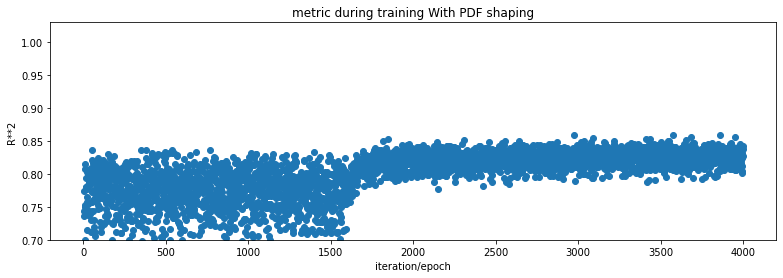

Training loss: tensor(0.1556, grad_fn=<MseLossBackward0>)
Training R**2: 0.8145543880315153
Test loss - scaled: tensor(0.1833, grad_fn=<MseLossBackward0>)
Test loss - descaled: tensor(13229835., grad_fn=<MseLossBackward0>)
Testing R**2 - scaled: 0.8342403916197279
Testing R**2 - descaled: 0.8342404089740617
*****
*****
Testing R**2 - Output: 0 0.5090960146664605
*****
*****
Testing R**2 - Output: 1 0.8489893873744455
*****
*****
Testing R**2 - Output: 2 0.9666919371214007
*****
*****
Testing R**2 - Output: 3 0.8580174211383171
*****
*****
Testing R**2 - Output: 4 0.9884072847431707


In [40]:

model = F1plusF2_SIO(x_means, x_deviations, y_means, y_deviations)
opt = torch.optim.Adam(   model.parameters(), lr=learning_rate   )
loss_fn     = F.mse_loss
loss_fn_PDF = my_loss

fit_y_scaled_PDF(N_EPOCHS, model, loss_fn, loss_fn_PDF, opt)

pred_descaled, pred_scaled = model(X_test_tr)
print('Test loss - scaled:',   loss_fn(     pred_scaled,                   y_test_tr_scaled          ))
print('Test loss - descaled:', loss_fn(     pred_descaled,                 y_test_tr                 ))
print('Testing R**2 - scaled:',   r2_score( pred_scaled.detach().numpy(),    y_test_tr_scaled.numpy()  ))
print('Testing R**2 - descaled:', r2_score( pred_descaled.detach().numpy(),  y_test_tr.numpy()         ))


print_individual_Rsquare(pred_descaled, y_test_tr)



## Use model to predict


In [41]:

list_preds = []
list_reals = []

for i in range(len(X_test_tr)):
    print("**************************************************")
    print("preds, real")
    preds_descaled, preds_scaled = model(X_test_tr[i])
    ## print(  preds_descaled.shape  )
    ## print(  preds_descaled  )
    np_pred = preds_descaled[0].detach().numpy()              ## [0]
    np_real = y_test_tr[i].detach().numpy()
    ## print(np_pred.shape)
    ## print(np_real.shape)

    for j in range(len(np_pred)):
        print((np_pred[j], np_real[j]))
        list_preds.append(np_pred[j])
        list_reals.append(np_real[j])
        


**************************************************
preds, real
(45.631496, 45.96437)
(44.01138, 44.24789)
(186.31529, 193.231)
(159614.75, 147960.1)
(373.58722, 370.1007)
**************************************************
preds, real
(47.651283, 48.06772)
(44.80208, 45.1243)
(138.27417, 139.7109)
(110047.38, 105652.45)
(470.9347, 474.61246)
**************************************************
preds, real
(47.966217, 46.25642)
(45.787132, 45.27268)
(117.557846, 112.4695)
(146110.9, 150081.8)
(451.14374, 454.43665)
**************************************************
preds, real
(47.294575, 46.6408)
(40.74192, 39.91885)
(191.2939, 187.6606)
(133369.23, 133833.2)
(390.77493, 388.12296)
**************************************************
preds, real
(42.1672, 43.27408)
(42.24381, 42.71181)
(227.7001, 221.0695)
(146197.11, 141740.8)
(367.2064, 369.2152)
**************************************************
preds, real
(47.485775, 48.31514)
(40.670277, 40.89604)
(120.32083, 117.9243)
(137942.34, 132


## Plotting


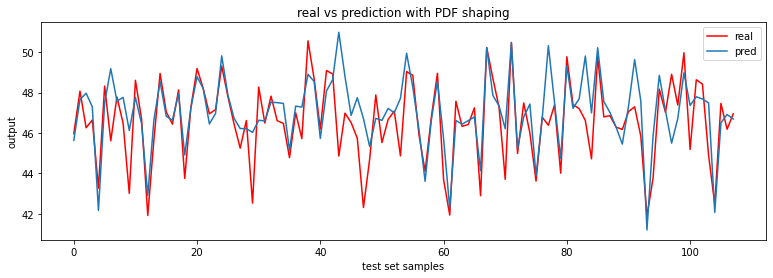

In [42]:

list_preds_y0 = [list_preds[i] for i in range(0, len(list_preds), 5)]
list_reals_y0 = [list_reals[i] for i in range(0, len(list_reals), 5)]


plt.figure(figsize=(13,4))

plt.plot(list_reals_y0, label= 'real', color='r' )
plt.plot(list_preds_y0, label= 'pred')

    
plt.title('real vs prediction with PDF shaping')
plt.xlabel('test set samples')
plt.ylabel('output')
plt.legend()

plt.savefig('images/Y0ShaftRealToPredictedWithPDFshaping.png', dpi=300)


plt.show()


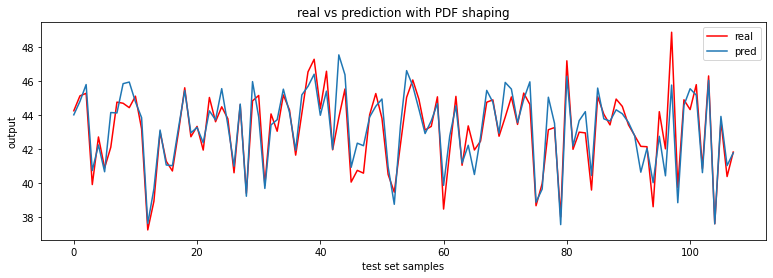

In [43]:

list_preds_y1 = [list_preds[i] for i in range(1, len(list_preds), 5)]
list_reals_y1 = [list_reals[i] for i in range(1, len(list_reals), 5)]


plt.figure(figsize=(13,4))

plt.plot(list_reals_y1, label= 'real', color='r' )
plt.plot(list_preds_y1, label= 'pred')

    
plt.title('real vs prediction with PDF shaping')
plt.xlabel('test set samples')
plt.ylabel('output')
plt.legend()

plt.savefig('images/Y1ShaftRealToPredictedWithPDFshaping.png', dpi=300)


plt.show()


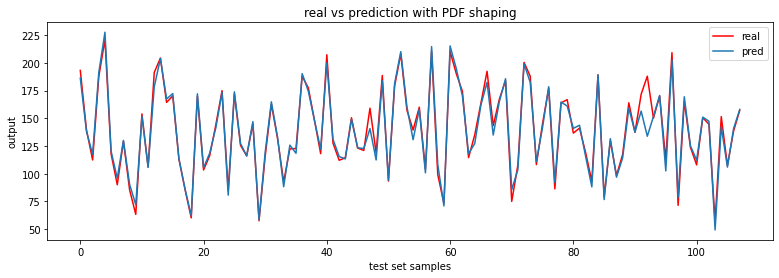

In [44]:

list_preds_y2 = [list_preds[i] for i in range(2, len(list_preds), 5)]
list_reals_y2 = [list_reals[i] for i in range(2, len(list_reals), 5)]


plt.figure(figsize=(13,4))

plt.plot(list_reals_y2, label= 'real', color='r' )
plt.plot(list_preds_y2, label= 'pred')

    
plt.title('real vs prediction with PDF shaping')
plt.xlabel('test set samples')
plt.ylabel('output')
plt.legend()

plt.savefig('images/Y2ShaftRealToPredictedWithPDFshaping.png', dpi=300)


plt.show()


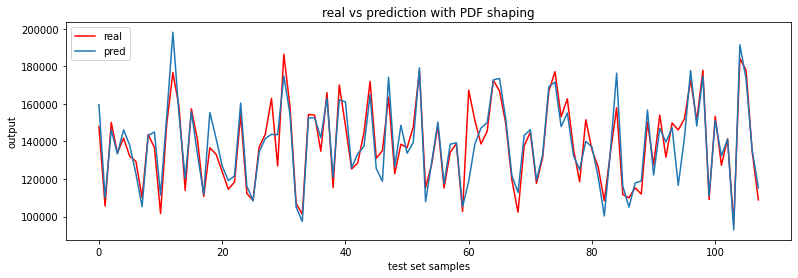

In [45]:

list_preds_y3 = [list_preds[i] for i in range(3, len(list_preds), 5)]
list_reals_y3 = [list_reals[i] for i in range(3, len(list_reals), 5)]


plt.figure(figsize=(13,4))

plt.plot(list_reals_y3, label= 'real', color='r' )
plt.plot(list_preds_y3, label= 'pred')

    
plt.title('real vs prediction with PDF shaping')
plt.xlabel('test set samples')
plt.ylabel('output')
plt.legend()

plt.savefig('images/Y3ShaftRealToPredictedWithPDFshaping.png', dpi=300)


plt.show()


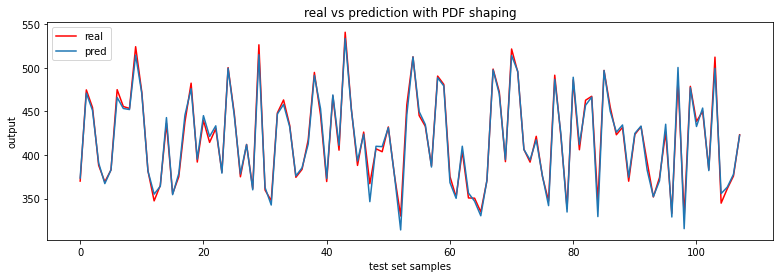

In [46]:

list_preds_y4 = [list_preds[i] for i in range(4, len(list_preds), 5)]
list_reals_y4 = [list_reals[i] for i in range(4, len(list_reals), 5)]


plt.figure(figsize=(13,4))

plt.plot(list_reals_y4, label= 'real', color='r' )
plt.plot(list_preds_y4, label= 'pred')

    
plt.title('real vs prediction with PDF shaping')
plt.xlabel('test set samples')
plt.ylabel('output')
plt.legend()

plt.savefig('images/Y4ShaftRealToPredictedWithPDFshaping.png', dpi=300)


plt.show()


/Users/user/opt/anaconda3/envs/py38/lib/python3.8/site-packages/seaborn/distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


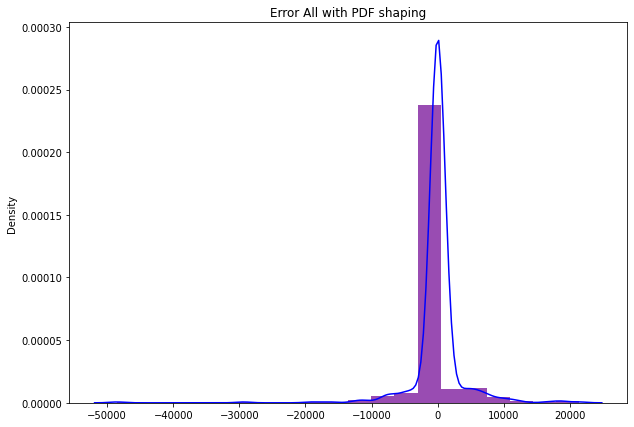

In [47]:

n_bins = 20

y_pred = np.array(list_preds)

y_real = np.array(list_reals)

error = y_pred - y_real


fig, ax = plt.subplots(figsize =(10, 7))

plt.hist(error, bins=n_bins, density = True, color='r', alpha=0.5)

sns.distplot(error, bins=n_bins, color="blue")

plt.title("Error All with PDF shaping")

plt.show()


/Users/user/opt/anaconda3/envs/py38/lib/python3.8/site-packages/seaborn/distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


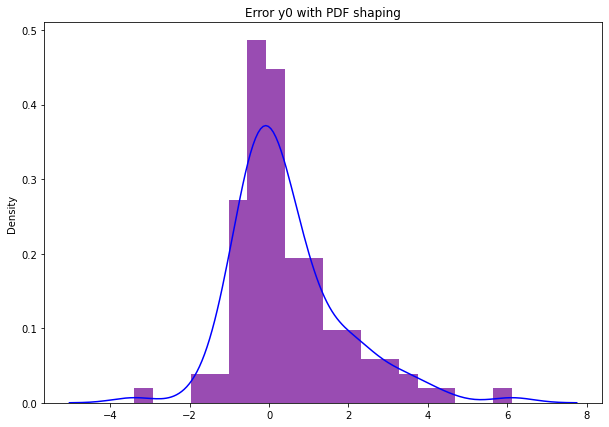

In [48]:
n_bins = 20

y_pred = np.array(list_preds_y0)

y_real = np.array(list_reals_y0)

error = y_pred - y_real


fig, ax = plt.subplots(figsize =(10, 7))

plt.hist(error, bins=n_bins, density = True, color='r', alpha=0.5)

sns.distplot(error, bins=n_bins, color="blue")

plt.title("Error y0 with PDF shaping")

plt.show()

/Users/user/opt/anaconda3/envs/py38/lib/python3.8/site-packages/seaborn/distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


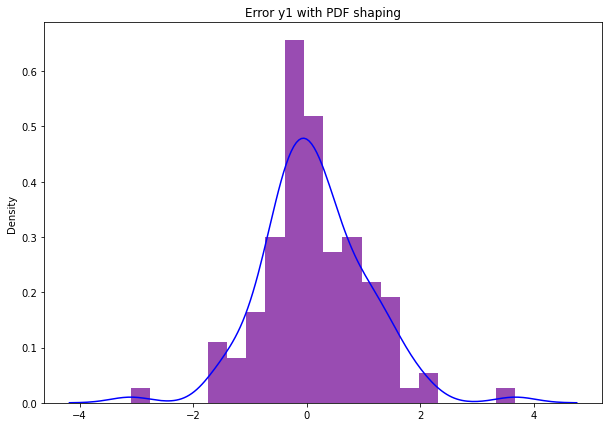

In [49]:
n_bins = 20

y_pred = np.array(list_preds_y1)

y_real = np.array(list_reals_y1)

error = y_pred - y_real


fig, ax = plt.subplots(figsize =(10, 7))

plt.hist(error, bins=n_bins, density = True, color='r', alpha=0.5)

sns.distplot(error, bins=n_bins, color="blue")

plt.title("Error y1 with PDF shaping")

plt.show()

/Users/user/opt/anaconda3/envs/py38/lib/python3.8/site-packages/seaborn/distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


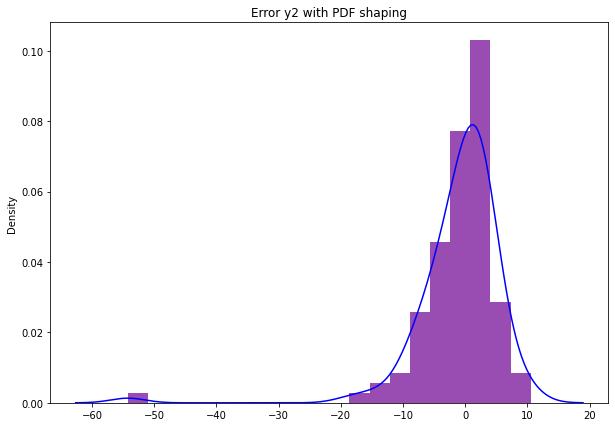

In [50]:

n_bins = 20

y_pred = np.array(list_preds_y2)

y_real = np.array(list_reals_y2)

error = y_pred - y_real


fig, ax = plt.subplots(figsize =(10, 7))

plt.hist(error, bins=n_bins, density = True, color='r', alpha=0.5)

sns.distplot(error, bins=n_bins, color="blue")

plt.title("Error y2 with PDF shaping")

plt.show()


/Users/user/opt/anaconda3/envs/py38/lib/python3.8/site-packages/seaborn/distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


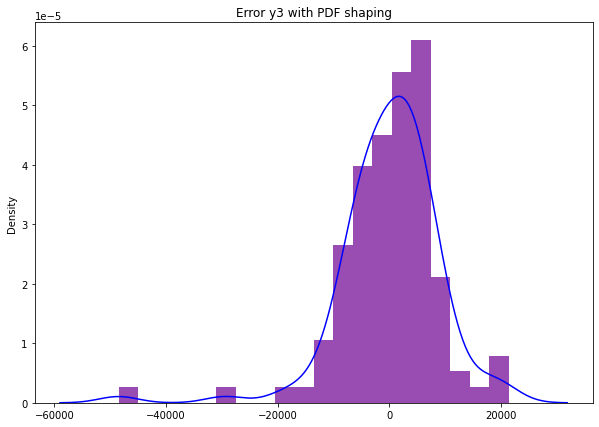

In [51]:

n_bins = 20

y_pred = np.array(list_preds_y3)

y_real = np.array(list_reals_y3)

error = y_pred - y_real


fig, ax = plt.subplots(figsize =(10, 7))

plt.hist(    error, bins=n_bins, density = True, color='r', alpha=0.5)

sns.distplot(error, bins=n_bins, color="blue")

plt.title("Error y3 with PDF shaping")

plt.show()


/Users/user/opt/anaconda3/envs/py38/lib/python3.8/site-packages/seaborn/distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


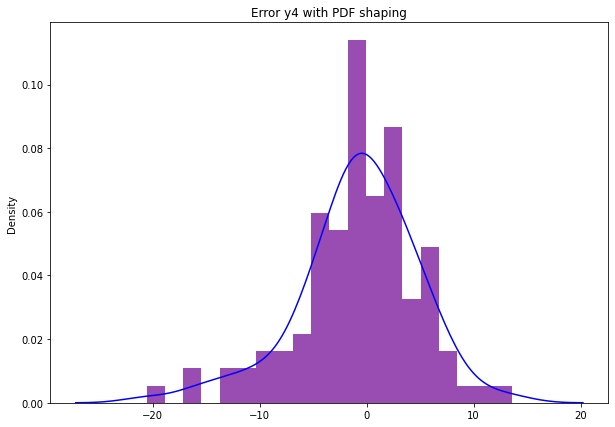

In [52]:
n_bins = 20

y_pred = np.array(list_preds_y4)

y_real = np.array(list_reals_y4)

error = y_pred - y_real


fig, ax = plt.subplots(figsize =(10, 7))

plt.hist(error, bins=n_bins, density = True, color='r', alpha=0.5)

sns.distplot(error, bins=n_bins, color="blue")

plt.title("Error y4 with PDF shaping")

plt.show()

## Use regularization

In [53]:
use_regularization = 1.0

In [54]:
def print_individual_Rsquare(pred_descaled, y_test_tr):
    vector_pred_descaled = pred_descaled.detach().numpy()
    vector_y_test_tr     = y_test_tr.numpy()

    for i in range(len(output_indeces)):
        ## print(vector_pred_descaled.shape)
        print("*****")
        print("*****")
        print('Testing R**2 - Output: ' + str(i), r2_score( vector_pred_descaled[:, i], vector_y_test_tr[:, i] ) )
        



0  loss=  tensor(1.0712, grad_fn=<MseLossBackward0>)
0  loss=  tensor(0.7214, grad_fn=<MseLossBackward0>)
0  loss=  tensor(0.7077, grad_fn=<MseLossBackward0>)
0  loss=  tensor(0.6871, grad_fn=<MseLossBackward0>)
0  loss=  tensor(0.7833, grad_fn=<MseLossBackward0>)
0  loss=  tensor(0.4123, grad_fn=<MseLossBackward0>)
0  loss=  tensor(0.4155, grad_fn=<MseLossBackward0>)
0  loss=  tensor(0.4059, grad_fn=<MseLossBackward0>)
0  loss=  tensor(0.8840, grad_fn=<MseLossBackward0>)
0  loss=  tensor(0.4278, grad_fn=<MseLossBackward0>)
0  loss=  tensor(0.3125, grad_fn=<MseLossBackward0>)
0  loss=  tensor(0.5036, grad_fn=<MseLossBackward0>)
0  loss=  tensor(0.3105, grad_fn=<MseLossBackward0>)
0  loss=  tensor(0.4353, grad_fn=<MseLossBackward0>)
0  loss=  tensor(0.2461, grad_fn=<MseLossBackward0>)
0  loss=  tensor(0.2718, grad_fn=<MseLossBackward0>)
0  loss=  tensor(0.2280, grad_fn=<MseLossBackward0>)
0  loss=  tensor(0.2333, grad_fn=<MseLossBackward0>)
0  loss=  tensor(0.3883, grad_fn=<MseLossBackw

11  loss=  tensor(0.1974, grad_fn=<MseLossBackward0>)
11  loss=  tensor(0.2161, grad_fn=<MseLossBackward0>)
11  loss=  tensor(0.1834, grad_fn=<MseLossBackward0>)
11  loss=  tensor(0.1114, grad_fn=<MseLossBackward0>)
11  loss=  tensor(0.2389, grad_fn=<MseLossBackward0>)
11  loss=  tensor(0.2195, grad_fn=<MseLossBackward0>)
11  loss=  tensor(0.0990, grad_fn=<MseLossBackward0>)
11  loss=  tensor(0.4075, grad_fn=<MseLossBackward0>)
11  loss=  tensor(0.1181, grad_fn=<MseLossBackward0>)
11  loss=  tensor(0.3141, grad_fn=<MseLossBackward0>)
11  loss=  tensor(0.1394, grad_fn=<MseLossBackward0>)
12  loss=  tensor(0.1919, grad_fn=<MseLossBackward0>)
12  loss=  tensor(0.2032, grad_fn=<MseLossBackward0>)
12  loss=  tensor(0.1778, grad_fn=<MseLossBackward0>)
12  loss=  tensor(0.1146, grad_fn=<MseLossBackward0>)
12  loss=  tensor(0.1596, grad_fn=<MseLossBackward0>)
12  loss=  tensor(0.2702, grad_fn=<MseLossBackward0>)
12  loss=  tensor(0.2053, grad_fn=<MseLossBackward0>)
12  loss=  tensor(0.1305, gr

24  loss=  tensor(0.1044, grad_fn=<MseLossBackward0>)
24  loss=  tensor(0.1820, grad_fn=<MseLossBackward0>)
24  loss=  tensor(0.1080, grad_fn=<MseLossBackward0>)
24  loss=  tensor(0.1853, grad_fn=<MseLossBackward0>)
24  loss=  tensor(0.1200, grad_fn=<MseLossBackward0>)
24  loss=  tensor(0.1830, grad_fn=<MseLossBackward0>)
24  loss=  tensor(0.0998, grad_fn=<MseLossBackward0>)
24  loss=  tensor(0.2013, grad_fn=<MseLossBackward0>)
24  loss=  tensor(0.1558, grad_fn=<MseLossBackward0>)
24  loss=  tensor(0.1022, grad_fn=<MseLossBackward0>)
24  loss=  tensor(0.0991, grad_fn=<MseLossBackward0>)
24  loss=  tensor(0.1157, grad_fn=<MseLossBackward0>)
24  loss=  tensor(0.2095, grad_fn=<MseLossBackward0>)
24  loss=  tensor(0.2353, grad_fn=<MseLossBackward0>)
24  loss=  tensor(0.1589, grad_fn=<MseLossBackward0>)
24  loss=  tensor(0.1648, grad_fn=<MseLossBackward0>)
24  loss=  tensor(0.1653, grad_fn=<MseLossBackward0>)
24  loss=  tensor(0.1227, grad_fn=<MseLossBackward0>)
24  loss=  tensor(0.1621, gr

36  loss=  tensor(0.1760, grad_fn=<MseLossBackward0>)
36  loss=  tensor(0.1034, grad_fn=<MseLossBackward0>)
36  loss=  tensor(0.2372, grad_fn=<MseLossBackward0>)
36  loss=  tensor(0.1047, grad_fn=<MseLossBackward0>)
36  loss=  tensor(0.1478, grad_fn=<MseLossBackward0>)
36  loss=  tensor(0.2493, grad_fn=<MseLossBackward0>)
36  loss=  tensor(0.3605, grad_fn=<MseLossBackward0>)
37  loss=  tensor(0.2148, grad_fn=<MseLossBackward0>)
37  loss=  tensor(0.1540, grad_fn=<MseLossBackward0>)
37  loss=  tensor(0.1183, grad_fn=<MseLossBackward0>)
37  loss=  tensor(0.2128, grad_fn=<MseLossBackward0>)
37  loss=  tensor(0.1858, grad_fn=<MseLossBackward0>)
37  loss=  tensor(0.1253, grad_fn=<MseLossBackward0>)
37  loss=  tensor(0.1396, grad_fn=<MseLossBackward0>)
37  loss=  tensor(0.1445, grad_fn=<MseLossBackward0>)
37  loss=  tensor(0.1969, grad_fn=<MseLossBackward0>)
37  loss=  tensor(0.1071, grad_fn=<MseLossBackward0>)
37  loss=  tensor(0.1508, grad_fn=<MseLossBackward0>)
37  loss=  tensor(0.2485, gr

49  loss=  tensor(0.1923, grad_fn=<MseLossBackward0>)
49  loss=  tensor(0.0871, grad_fn=<MseLossBackward0>)
49  loss=  tensor(0.2044, grad_fn=<MseLossBackward0>)
49  loss=  tensor(0.1263, grad_fn=<MseLossBackward0>)
49  loss=  tensor(0.1464, grad_fn=<MseLossBackward0>)
49  loss=  tensor(0.1941, grad_fn=<MseLossBackward0>)
49  loss=  tensor(0.1347, grad_fn=<MseLossBackward0>)
49  loss=  tensor(0.1064, grad_fn=<MseLossBackward0>)
49  loss=  tensor(0.2159, grad_fn=<MseLossBackward0>)
49  loss=  tensor(0.2657, grad_fn=<MseLossBackward0>)
49  loss=  tensor(0.1791, grad_fn=<MseLossBackward0>)
49  loss=  tensor(0.2009, grad_fn=<MseLossBackward0>)
49  loss=  tensor(0.1504, grad_fn=<MseLossBackward0>)
49  loss=  tensor(0.1875, grad_fn=<MseLossBackward0>)
49  loss=  tensor(0.2483, grad_fn=<MseLossBackward0>)
49  loss=  tensor(0.2395, grad_fn=<MseLossBackward0>)
50  loss=  tensor(0.2539, grad_fn=<MseLossBackward0>)
50  loss=  tensor(0.0947, grad_fn=<MseLossBackward0>)
50  loss=  tensor(0.1138, gr

62  loss=  tensor(0.1869, grad_fn=<MseLossBackward0>)
62  loss=  tensor(0.1773, grad_fn=<MseLossBackward0>)
62  loss=  tensor(0.1564, grad_fn=<MseLossBackward0>)
62  loss=  tensor(0.1740, grad_fn=<MseLossBackward0>)
62  loss=  tensor(0.2137, grad_fn=<MseLossBackward0>)
62  loss=  tensor(0.1627, grad_fn=<MseLossBackward0>)
62  loss=  tensor(0.3316, grad_fn=<MseLossBackward0>)
62  loss=  tensor(0.1886, grad_fn=<MseLossBackward0>)
63  loss=  tensor(0.1739, grad_fn=<MseLossBackward0>)
63  loss=  tensor(0.2226, grad_fn=<MseLossBackward0>)
63  loss=  tensor(0.1489, grad_fn=<MseLossBackward0>)
63  loss=  tensor(0.1481, grad_fn=<MseLossBackward0>)
63  loss=  tensor(0.1287, grad_fn=<MseLossBackward0>)
63  loss=  tensor(0.2235, grad_fn=<MseLossBackward0>)
63  loss=  tensor(0.1548, grad_fn=<MseLossBackward0>)
63  loss=  tensor(0.2186, grad_fn=<MseLossBackward0>)
63  loss=  tensor(0.1820, grad_fn=<MseLossBackward0>)
63  loss=  tensor(0.1367, grad_fn=<MseLossBackward0>)
63  loss=  tensor(0.1364, gr

75  loss=  tensor(0.2959, grad_fn=<MseLossBackward0>)
75  loss=  tensor(0.2025, grad_fn=<MseLossBackward0>)
75  loss=  tensor(0.1467, grad_fn=<MseLossBackward0>)
75  loss=  tensor(0.2298, grad_fn=<MseLossBackward0>)
75  loss=  tensor(0.2236, grad_fn=<MseLossBackward0>)
75  loss=  tensor(0.0591, grad_fn=<MseLossBackward0>)
75  loss=  tensor(0.1332, grad_fn=<MseLossBackward0>)
76  loss=  tensor(0.0962, grad_fn=<MseLossBackward0>)
76  loss=  tensor(0.1106, grad_fn=<MseLossBackward0>)
76  loss=  tensor(0.1424, grad_fn=<MseLossBackward0>)
76  loss=  tensor(0.1390, grad_fn=<MseLossBackward0>)
76  loss=  tensor(0.2645, grad_fn=<MseLossBackward0>)
76  loss=  tensor(0.2012, grad_fn=<MseLossBackward0>)
76  loss=  tensor(0.1377, grad_fn=<MseLossBackward0>)
76  loss=  tensor(0.1413, grad_fn=<MseLossBackward0>)
76  loss=  tensor(0.1643, grad_fn=<MseLossBackward0>)
76  loss=  tensor(0.1015, grad_fn=<MseLossBackward0>)
76  loss=  tensor(0.1276, grad_fn=<MseLossBackward0>)
76  loss=  tensor(0.0952, gr

88  loss=  tensor(0.1120, grad_fn=<MseLossBackward0>)
88  loss=  tensor(0.3267, grad_fn=<MseLossBackward0>)
88  loss=  tensor(0.1418, grad_fn=<MseLossBackward0>)
88  loss=  tensor(0.2377, grad_fn=<MseLossBackward0>)
88  loss=  tensor(0.1850, grad_fn=<MseLossBackward0>)
88  loss=  tensor(0.1696, grad_fn=<MseLossBackward0>)
88  loss=  tensor(0.0839, grad_fn=<MseLossBackward0>)
88  loss=  tensor(0.2871, grad_fn=<MseLossBackward0>)
89  loss=  tensor(0.1692, grad_fn=<MseLossBackward0>)
89  loss=  tensor(0.1202, grad_fn=<MseLossBackward0>)
89  loss=  tensor(0.2378, grad_fn=<MseLossBackward0>)
89  loss=  tensor(0.4267, grad_fn=<MseLossBackward0>)
89  loss=  tensor(0.1385, grad_fn=<MseLossBackward0>)
89  loss=  tensor(0.2096, grad_fn=<MseLossBackward0>)
89  loss=  tensor(0.1907, grad_fn=<MseLossBackward0>)
89  loss=  tensor(0.1605, grad_fn=<MseLossBackward0>)
89  loss=  tensor(0.2492, grad_fn=<MseLossBackward0>)
89  loss=  tensor(0.2368, grad_fn=<MseLossBackward0>)
89  loss=  tensor(0.1419, gr

102  loss=  tensor(0.1100, grad_fn=<MseLossBackward0>)
102  loss=  tensor(0.1412, grad_fn=<MseLossBackward0>)
102  loss=  tensor(0.1069, grad_fn=<MseLossBackward0>)
102  loss=  tensor(0.1634, grad_fn=<MseLossBackward0>)
102  loss=  tensor(0.2169, grad_fn=<MseLossBackward0>)
102  loss=  tensor(0.1433, grad_fn=<MseLossBackward0>)
102  loss=  tensor(0.0721, grad_fn=<MseLossBackward0>)
102  loss=  tensor(0.1626, grad_fn=<MseLossBackward0>)
102  loss=  tensor(0.1960, grad_fn=<MseLossBackward0>)
102  loss=  tensor(0.1046, grad_fn=<MseLossBackward0>)
102  loss=  tensor(0.2064, grad_fn=<MseLossBackward0>)
102  loss=  tensor(0.2383, grad_fn=<MseLossBackward0>)
102  loss=  tensor(0.1314, grad_fn=<MseLossBackward0>)
102  loss=  tensor(0.0704, grad_fn=<MseLossBackward0>)
102  loss=  tensor(0.2034, grad_fn=<MseLossBackward0>)
102  loss=  tensor(0.1858, grad_fn=<MseLossBackward0>)
102  loss=  tensor(0.1390, grad_fn=<MseLossBackward0>)
102  loss=  tensor(0.1598, grad_fn=<MseLossBackward0>)
102  loss=

115  loss=  tensor(0.2936, grad_fn=<MseLossBackward0>)
115  loss=  tensor(0.1328, grad_fn=<MseLossBackward0>)
115  loss=  tensor(0.1536, grad_fn=<MseLossBackward0>)
115  loss=  tensor(0.1150, grad_fn=<MseLossBackward0>)
115  loss=  tensor(0.1579, grad_fn=<MseLossBackward0>)
115  loss=  tensor(0.1657, grad_fn=<MseLossBackward0>)
115  loss=  tensor(0.1034, grad_fn=<MseLossBackward0>)
115  loss=  tensor(0.0960, grad_fn=<MseLossBackward0>)
115  loss=  tensor(0.1994, grad_fn=<MseLossBackward0>)
115  loss=  tensor(0.2063, grad_fn=<MseLossBackward0>)
115  loss=  tensor(0.1307, grad_fn=<MseLossBackward0>)
115  loss=  tensor(0.2097, grad_fn=<MseLossBackward0>)
115  loss=  tensor(0.1322, grad_fn=<MseLossBackward0>)
115  loss=  tensor(0.2592, grad_fn=<MseLossBackward0>)
115  loss=  tensor(0.1592, grad_fn=<MseLossBackward0>)
115  loss=  tensor(0.2780, grad_fn=<MseLossBackward0>)
115  loss=  tensor(0.1461, grad_fn=<MseLossBackward0>)
115  loss=  tensor(0.2882, grad_fn=<MseLossBackward0>)
115  loss=

127  loss=  tensor(0.3087, grad_fn=<MseLossBackward0>)
127  loss=  tensor(0.2339, grad_fn=<MseLossBackward0>)
127  loss=  tensor(0.1284, grad_fn=<MseLossBackward0>)
127  loss=  tensor(0.1004, grad_fn=<MseLossBackward0>)
127  loss=  tensor(0.2493, grad_fn=<MseLossBackward0>)
127  loss=  tensor(0.1550, grad_fn=<MseLossBackward0>)
127  loss=  tensor(0.2091, grad_fn=<MseLossBackward0>)
127  loss=  tensor(0.1625, grad_fn=<MseLossBackward0>)
128  loss=  tensor(0.2067, grad_fn=<MseLossBackward0>)
128  loss=  tensor(0.0960, grad_fn=<MseLossBackward0>)
128  loss=  tensor(0.1386, grad_fn=<MseLossBackward0>)
128  loss=  tensor(0.0951, grad_fn=<MseLossBackward0>)
128  loss=  tensor(0.1503, grad_fn=<MseLossBackward0>)
128  loss=  tensor(0.1627, grad_fn=<MseLossBackward0>)
128  loss=  tensor(0.1679, grad_fn=<MseLossBackward0>)
128  loss=  tensor(0.1903, grad_fn=<MseLossBackward0>)
128  loss=  tensor(0.0946, grad_fn=<MseLossBackward0>)
128  loss=  tensor(0.2117, grad_fn=<MseLossBackward0>)
128  loss=

138  loss=  tensor(0.2623, grad_fn=<MseLossBackward0>)
138  loss=  tensor(0.2089, grad_fn=<MseLossBackward0>)
138  loss=  tensor(0.1387, grad_fn=<MseLossBackward0>)
138  loss=  tensor(0.1344, grad_fn=<MseLossBackward0>)
138  loss=  tensor(0.0880, grad_fn=<MseLossBackward0>)
138  loss=  tensor(0.1297, grad_fn=<MseLossBackward0>)
138  loss=  tensor(0.1238, grad_fn=<MseLossBackward0>)
138  loss=  tensor(0.2102, grad_fn=<MseLossBackward0>)
138  loss=  tensor(0.2323, grad_fn=<MseLossBackward0>)
138  loss=  tensor(0.1187, grad_fn=<MseLossBackward0>)
138  loss=  tensor(0.1822, grad_fn=<MseLossBackward0>)
138  loss=  tensor(0.1446, grad_fn=<MseLossBackward0>)
138  loss=  tensor(0.1957, grad_fn=<MseLossBackward0>)
138  loss=  tensor(0.1374, grad_fn=<MseLossBackward0>)
138  loss=  tensor(0.1769, grad_fn=<MseLossBackward0>)
138  loss=  tensor(0.1195, grad_fn=<MseLossBackward0>)
138  loss=  tensor(0.1164, grad_fn=<MseLossBackward0>)
138  loss=  tensor(0.1684, grad_fn=<MseLossBackward0>)
138  loss=

149  loss=  tensor(0.1229, grad_fn=<MseLossBackward0>)
149  loss=  tensor(0.2095, grad_fn=<MseLossBackward0>)
149  loss=  tensor(0.1626, grad_fn=<MseLossBackward0>)
149  loss=  tensor(0.2805, grad_fn=<MseLossBackward0>)
149  loss=  tensor(0.2150, grad_fn=<MseLossBackward0>)
149  loss=  tensor(0.2050, grad_fn=<MseLossBackward0>)
149  loss=  tensor(0.1149, grad_fn=<MseLossBackward0>)
149  loss=  tensor(0.1000, grad_fn=<MseLossBackward0>)
149  loss=  tensor(0.2110, grad_fn=<MseLossBackward0>)
149  loss=  tensor(0.1910, grad_fn=<MseLossBackward0>)
149  loss=  tensor(0.2168, grad_fn=<MseLossBackward0>)
149  loss=  tensor(0.1678, grad_fn=<MseLossBackward0>)
149  loss=  tensor(0.2461, grad_fn=<MseLossBackward0>)
149  loss=  tensor(0.1455, grad_fn=<MseLossBackward0>)
149  loss=  tensor(0.1250, grad_fn=<MseLossBackward0>)
150  loss=  tensor(0.1702, grad_fn=<MseLossBackward0>)
150  loss=  tensor(0.1458, grad_fn=<MseLossBackward0>)
150  loss=  tensor(0.1087, grad_fn=<MseLossBackward0>)
150  loss=

161  loss=  tensor(0.2535, grad_fn=<MseLossBackward0>)
161  loss=  tensor(0.1005, grad_fn=<MseLossBackward0>)
161  loss=  tensor(0.1479, grad_fn=<MseLossBackward0>)
161  loss=  tensor(0.2260, grad_fn=<MseLossBackward0>)
161  loss=  tensor(0.1435, grad_fn=<MseLossBackward0>)
162  loss=  tensor(0.1640, grad_fn=<MseLossBackward0>)
162  loss=  tensor(0.1961, grad_fn=<MseLossBackward0>)
162  loss=  tensor(0.1548, grad_fn=<MseLossBackward0>)
162  loss=  tensor(0.2077, grad_fn=<MseLossBackward0>)
162  loss=  tensor(0.3477, grad_fn=<MseLossBackward0>)
162  loss=  tensor(0.1713, grad_fn=<MseLossBackward0>)
162  loss=  tensor(0.1496, grad_fn=<MseLossBackward0>)
162  loss=  tensor(0.1256, grad_fn=<MseLossBackward0>)
162  loss=  tensor(0.0962, grad_fn=<MseLossBackward0>)
162  loss=  tensor(0.1364, grad_fn=<MseLossBackward0>)
162  loss=  tensor(0.1662, grad_fn=<MseLossBackward0>)
162  loss=  tensor(0.0640, grad_fn=<MseLossBackward0>)
162  loss=  tensor(0.1648, grad_fn=<MseLossBackward0>)
162  loss=

174  loss=  tensor(0.3017, grad_fn=<MseLossBackward0>)
174  loss=  tensor(0.2018, grad_fn=<MseLossBackward0>)
174  loss=  tensor(0.1389, grad_fn=<MseLossBackward0>)
174  loss=  tensor(0.1301, grad_fn=<MseLossBackward0>)
174  loss=  tensor(0.2139, grad_fn=<MseLossBackward0>)
174  loss=  tensor(0.1188, grad_fn=<MseLossBackward0>)
174  loss=  tensor(0.2586, grad_fn=<MseLossBackward0>)
174  loss=  tensor(0.0817, grad_fn=<MseLossBackward0>)
174  loss=  tensor(0.1284, grad_fn=<MseLossBackward0>)
174  loss=  tensor(0.1952, grad_fn=<MseLossBackward0>)
174  loss=  tensor(0.1030, grad_fn=<MseLossBackward0>)
174  loss=  tensor(0.2600, grad_fn=<MseLossBackward0>)
174  loss=  tensor(0.1170, grad_fn=<MseLossBackward0>)
174  loss=  tensor(0.2455, grad_fn=<MseLossBackward0>)
174  loss=  tensor(0.1479, grad_fn=<MseLossBackward0>)
175  loss=  tensor(0.1044, grad_fn=<MseLossBackward0>)
175  loss=  tensor(0.1274, grad_fn=<MseLossBackward0>)
175  loss=  tensor(0.1354, grad_fn=<MseLossBackward0>)
175  loss=

187  loss=  tensor(0.1160, grad_fn=<MseLossBackward0>)
187  loss=  tensor(0.1554, grad_fn=<MseLossBackward0>)
187  loss=  tensor(0.1465, grad_fn=<MseLossBackward0>)
187  loss=  tensor(0.1330, grad_fn=<MseLossBackward0>)
187  loss=  tensor(0.1328, grad_fn=<MseLossBackward0>)
187  loss=  tensor(0.1416, grad_fn=<MseLossBackward0>)
187  loss=  tensor(0.2039, grad_fn=<MseLossBackward0>)
187  loss=  tensor(0.2466, grad_fn=<MseLossBackward0>)
187  loss=  tensor(0.1519, grad_fn=<MseLossBackward0>)
187  loss=  tensor(0.1860, grad_fn=<MseLossBackward0>)
187  loss=  tensor(0.2037, grad_fn=<MseLossBackward0>)
187  loss=  tensor(0.2836, grad_fn=<MseLossBackward0>)
187  loss=  tensor(0.1867, grad_fn=<MseLossBackward0>)
188  loss=  tensor(0.1157, grad_fn=<MseLossBackward0>)
188  loss=  tensor(0.1386, grad_fn=<MseLossBackward0>)
188  loss=  tensor(0.2374, grad_fn=<MseLossBackward0>)
188  loss=  tensor(0.1659, grad_fn=<MseLossBackward0>)
188  loss=  tensor(0.1678, grad_fn=<MseLossBackward0>)
188  loss=

199  loss=  tensor(0.1746, grad_fn=<MseLossBackward0>)
199  loss=  tensor(0.1403, grad_fn=<MseLossBackward0>)
199  loss=  tensor(0.1245, grad_fn=<MseLossBackward0>)
199  loss=  tensor(0.1548, grad_fn=<MseLossBackward0>)
199  loss=  tensor(0.1612, grad_fn=<MseLossBackward0>)
199  loss=  tensor(0.1043, grad_fn=<MseLossBackward0>)
199  loss=  tensor(0.1375, grad_fn=<MseLossBackward0>)
199  loss=  tensor(0.2001, grad_fn=<MseLossBackward0>)
199  loss=  tensor(0.0985, grad_fn=<MseLossBackward0>)
199  loss=  tensor(0.1426, grad_fn=<MseLossBackward0>)
199  loss=  tensor(0.2861, grad_fn=<MseLossBackward0>)
199  loss=  tensor(0.1732, grad_fn=<MseLossBackward0>)
199  loss=  tensor(0.1520, grad_fn=<MseLossBackward0>)
199  loss=  tensor(0.2626, grad_fn=<MseLossBackward0>)
199  loss=  tensor(0.1124, grad_fn=<MseLossBackward0>)
199  loss=  tensor(0.2231, grad_fn=<MseLossBackward0>)
199  loss=  tensor(0.1660, grad_fn=<MseLossBackward0>)
199  loss=  tensor(0.1722, grad_fn=<MseLossBackward0>)
199  loss=

209  loss=  tensor(0.0776, grad_fn=<MseLossBackward0>)
209  loss=  tensor(0.1531, grad_fn=<MseLossBackward0>)
209  loss=  tensor(0.1897, grad_fn=<MseLossBackward0>)
210  loss=  tensor(0.1654, grad_fn=<MseLossBackward0>)
210  loss=  tensor(0.1185, grad_fn=<MseLossBackward0>)
210  loss=  tensor(0.1808, grad_fn=<MseLossBackward0>)
210  loss=  tensor(0.2505, grad_fn=<MseLossBackward0>)
210  loss=  tensor(0.1583, grad_fn=<MseLossBackward0>)
210  loss=  tensor(0.1889, grad_fn=<MseLossBackward0>)
210  loss=  tensor(0.1830, grad_fn=<MseLossBackward0>)
210  loss=  tensor(0.1660, grad_fn=<MseLossBackward0>)
210  loss=  tensor(0.1104, grad_fn=<MseLossBackward0>)
210  loss=  tensor(0.1889, grad_fn=<MseLossBackward0>)
210  loss=  tensor(0.1636, grad_fn=<MseLossBackward0>)
210  loss=  tensor(0.1776, grad_fn=<MseLossBackward0>)
210  loss=  tensor(0.2171, grad_fn=<MseLossBackward0>)
210  loss=  tensor(0.1885, grad_fn=<MseLossBackward0>)
210  loss=  tensor(0.2726, grad_fn=<MseLossBackward0>)
210  loss=

221  loss=  tensor(0.1889, grad_fn=<MseLossBackward0>)
221  loss=  tensor(0.1069, grad_fn=<MseLossBackward0>)
221  loss=  tensor(0.2421, grad_fn=<MseLossBackward0>)
221  loss=  tensor(0.1585, grad_fn=<MseLossBackward0>)
221  loss=  tensor(0.1461, grad_fn=<MseLossBackward0>)
221  loss=  tensor(0.1016, grad_fn=<MseLossBackward0>)
221  loss=  tensor(0.1312, grad_fn=<MseLossBackward0>)
221  loss=  tensor(0.2210, grad_fn=<MseLossBackward0>)
221  loss=  tensor(0.2146, grad_fn=<MseLossBackward0>)
221  loss=  tensor(0.1462, grad_fn=<MseLossBackward0>)
221  loss=  tensor(0.2752, grad_fn=<MseLossBackward0>)
221  loss=  tensor(0.1124, grad_fn=<MseLossBackward0>)
221  loss=  tensor(0.1135, grad_fn=<MseLossBackward0>)
221  loss=  tensor(0.1739, grad_fn=<MseLossBackward0>)
221  loss=  tensor(0.2040, grad_fn=<MseLossBackward0>)
221  loss=  tensor(0.1552, grad_fn=<MseLossBackward0>)
221  loss=  tensor(0.1662, grad_fn=<MseLossBackward0>)
221  loss=  tensor(0.1674, grad_fn=<MseLossBackward0>)
221  loss=

233  loss=  tensor(0.1139, grad_fn=<MseLossBackward0>)
233  loss=  tensor(0.1270, grad_fn=<MseLossBackward0>)
233  loss=  tensor(0.1965, grad_fn=<MseLossBackward0>)
233  loss=  tensor(0.1101, grad_fn=<MseLossBackward0>)
233  loss=  tensor(0.1127, grad_fn=<MseLossBackward0>)
233  loss=  tensor(0.1218, grad_fn=<MseLossBackward0>)
233  loss=  tensor(0.3069, grad_fn=<MseLossBackward0>)
233  loss=  tensor(0.1523, grad_fn=<MseLossBackward0>)
233  loss=  tensor(0.1186, grad_fn=<MseLossBackward0>)
234  loss=  tensor(0.1265, grad_fn=<MseLossBackward0>)
234  loss=  tensor(0.2126, grad_fn=<MseLossBackward0>)
234  loss=  tensor(0.0804, grad_fn=<MseLossBackward0>)
234  loss=  tensor(0.1629, grad_fn=<MseLossBackward0>)
234  loss=  tensor(0.1345, grad_fn=<MseLossBackward0>)
234  loss=  tensor(0.2852, grad_fn=<MseLossBackward0>)
234  loss=  tensor(0.1264, grad_fn=<MseLossBackward0>)
234  loss=  tensor(0.1197, grad_fn=<MseLossBackward0>)
234  loss=  tensor(0.2511, grad_fn=<MseLossBackward0>)
234  loss=

246  loss=  tensor(0.2142, grad_fn=<MseLossBackward0>)
246  loss=  tensor(0.1381, grad_fn=<MseLossBackward0>)
246  loss=  tensor(0.1978, grad_fn=<MseLossBackward0>)
247  loss=  tensor(0.1269, grad_fn=<MseLossBackward0>)
247  loss=  tensor(0.1556, grad_fn=<MseLossBackward0>)
247  loss=  tensor(0.1530, grad_fn=<MseLossBackward0>)
247  loss=  tensor(0.1507, grad_fn=<MseLossBackward0>)
247  loss=  tensor(0.0999, grad_fn=<MseLossBackward0>)
247  loss=  tensor(0.3363, grad_fn=<MseLossBackward0>)
247  loss=  tensor(0.1698, grad_fn=<MseLossBackward0>)
247  loss=  tensor(0.2058, grad_fn=<MseLossBackward0>)
247  loss=  tensor(0.1870, grad_fn=<MseLossBackward0>)
247  loss=  tensor(0.2884, grad_fn=<MseLossBackward0>)
247  loss=  tensor(0.2438, grad_fn=<MseLossBackward0>)
247  loss=  tensor(0.1420, grad_fn=<MseLossBackward0>)
247  loss=  tensor(0.2068, grad_fn=<MseLossBackward0>)
247  loss=  tensor(0.1538, grad_fn=<MseLossBackward0>)
247  loss=  tensor(0.1667, grad_fn=<MseLossBackward0>)
247  loss=

259  loss=  tensor(0.1613, grad_fn=<MseLossBackward0>)
259  loss=  tensor(0.1430, grad_fn=<MseLossBackward0>)
259  loss=  tensor(0.2131, grad_fn=<MseLossBackward0>)
259  loss=  tensor(0.2098, grad_fn=<MseLossBackward0>)
259  loss=  tensor(0.1615, grad_fn=<MseLossBackward0>)
260  loss=  tensor(0.0941, grad_fn=<MseLossBackward0>)
260  loss=  tensor(0.0462, grad_fn=<MseLossBackward0>)
260  loss=  tensor(0.1880, grad_fn=<MseLossBackward0>)
260  loss=  tensor(0.0946, grad_fn=<MseLossBackward0>)
260  loss=  tensor(0.2406, grad_fn=<MseLossBackward0>)
260  loss=  tensor(0.1366, grad_fn=<MseLossBackward0>)
260  loss=  tensor(0.2408, grad_fn=<MseLossBackward0>)
260  loss=  tensor(0.3449, grad_fn=<MseLossBackward0>)
260  loss=  tensor(0.1818, grad_fn=<MseLossBackward0>)
260  loss=  tensor(0.2733, grad_fn=<MseLossBackward0>)
260  loss=  tensor(0.1288, grad_fn=<MseLossBackward0>)
260  loss=  tensor(0.2565, grad_fn=<MseLossBackward0>)
260  loss=  tensor(0.1145, grad_fn=<MseLossBackward0>)
260  loss=

272  loss=  tensor(0.2001, grad_fn=<MseLossBackward0>)
272  loss=  tensor(0.1712, grad_fn=<MseLossBackward0>)
272  loss=  tensor(0.1964, grad_fn=<MseLossBackward0>)
272  loss=  tensor(0.0894, grad_fn=<MseLossBackward0>)
272  loss=  tensor(0.1663, grad_fn=<MseLossBackward0>)
272  loss=  tensor(0.0897, grad_fn=<MseLossBackward0>)
272  loss=  tensor(0.1498, grad_fn=<MseLossBackward0>)
272  loss=  tensor(0.1885, grad_fn=<MseLossBackward0>)
272  loss=  tensor(0.1138, grad_fn=<MseLossBackward0>)
272  loss=  tensor(0.0651, grad_fn=<MseLossBackward0>)
272  loss=  tensor(0.3186, grad_fn=<MseLossBackward0>)
272  loss=  tensor(0.2861, grad_fn=<MseLossBackward0>)
272  loss=  tensor(0.1931, grad_fn=<MseLossBackward0>)
272  loss=  tensor(0.2045, grad_fn=<MseLossBackward0>)
272  loss=  tensor(0.1146, grad_fn=<MseLossBackward0>)
273  loss=  tensor(0.0990, grad_fn=<MseLossBackward0>)
273  loss=  tensor(0.0964, grad_fn=<MseLossBackward0>)
273  loss=  tensor(0.1486, grad_fn=<MseLossBackward0>)
273  loss=

283  loss=  tensor(0.1733, grad_fn=<MseLossBackward0>)
283  loss=  tensor(0.2482, grad_fn=<MseLossBackward0>)
283  loss=  tensor(0.2048, grad_fn=<MseLossBackward0>)
283  loss=  tensor(0.1976, grad_fn=<MseLossBackward0>)
283  loss=  tensor(0.1076, grad_fn=<MseLossBackward0>)
283  loss=  tensor(0.2748, grad_fn=<MseLossBackward0>)
283  loss=  tensor(0.3133, grad_fn=<MseLossBackward0>)
283  loss=  tensor(0.1367, grad_fn=<MseLossBackward0>)
283  loss=  tensor(0.1946, grad_fn=<MseLossBackward0>)
283  loss=  tensor(0.0846, grad_fn=<MseLossBackward0>)
283  loss=  tensor(0.2006, grad_fn=<MseLossBackward0>)
283  loss=  tensor(0.1369, grad_fn=<MseLossBackward0>)
283  loss=  tensor(0.2705, grad_fn=<MseLossBackward0>)
283  loss=  tensor(0.0785, grad_fn=<MseLossBackward0>)
284  loss=  tensor(0.0596, grad_fn=<MseLossBackward0>)
284  loss=  tensor(0.1076, grad_fn=<MseLossBackward0>)
284  loss=  tensor(0.2153, grad_fn=<MseLossBackward0>)
284  loss=  tensor(0.1497, grad_fn=<MseLossBackward0>)
284  loss=

294  loss=  tensor(0.1815, grad_fn=<MseLossBackward0>)
294  loss=  tensor(0.1154, grad_fn=<MseLossBackward0>)
294  loss=  tensor(0.1604, grad_fn=<MseLossBackward0>)
294  loss=  tensor(0.2116, grad_fn=<MseLossBackward0>)
294  loss=  tensor(0.2695, grad_fn=<MseLossBackward0>)
294  loss=  tensor(0.1088, grad_fn=<MseLossBackward0>)
294  loss=  tensor(0.1406, grad_fn=<MseLossBackward0>)
294  loss=  tensor(0.1707, grad_fn=<MseLossBackward0>)
294  loss=  tensor(0.2207, grad_fn=<MseLossBackward0>)
294  loss=  tensor(0.1088, grad_fn=<MseLossBackward0>)
294  loss=  tensor(0.2246, grad_fn=<MseLossBackward0>)
294  loss=  tensor(0.2611, grad_fn=<MseLossBackward0>)
294  loss=  tensor(0.1654, grad_fn=<MseLossBackward0>)
294  loss=  tensor(0.1386, grad_fn=<MseLossBackward0>)
294  loss=  tensor(0.1933, grad_fn=<MseLossBackward0>)
294  loss=  tensor(0.1598, grad_fn=<MseLossBackward0>)
294  loss=  tensor(0.3051, grad_fn=<MseLossBackward0>)
294  loss=  tensor(0.1811, grad_fn=<MseLossBackward0>)
294  loss=

306  loss=  tensor(0.1897, grad_fn=<MseLossBackward0>)
306  loss=  tensor(0.1145, grad_fn=<MseLossBackward0>)
306  loss=  tensor(0.1255, grad_fn=<MseLossBackward0>)
306  loss=  tensor(0.0874, grad_fn=<MseLossBackward0>)
306  loss=  tensor(0.1690, grad_fn=<MseLossBackward0>)
306  loss=  tensor(0.1642, grad_fn=<MseLossBackward0>)
306  loss=  tensor(0.1698, grad_fn=<MseLossBackward0>)
306  loss=  tensor(0.1997, grad_fn=<MseLossBackward0>)
306  loss=  tensor(0.2476, grad_fn=<MseLossBackward0>)
306  loss=  tensor(0.3446, grad_fn=<MseLossBackward0>)
306  loss=  tensor(0.0887, grad_fn=<MseLossBackward0>)
306  loss=  tensor(0.0854, grad_fn=<MseLossBackward0>)
306  loss=  tensor(0.2094, grad_fn=<MseLossBackward0>)
306  loss=  tensor(0.2007, grad_fn=<MseLossBackward0>)
306  loss=  tensor(0.1282, grad_fn=<MseLossBackward0>)
306  loss=  tensor(0.5036, grad_fn=<MseLossBackward0>)
306  loss=  tensor(0.1956, grad_fn=<MseLossBackward0>)
306  loss=  tensor(0.2878, grad_fn=<MseLossBackward0>)
306  loss=

318  loss=  tensor(0.1864, grad_fn=<MseLossBackward0>)
318  loss=  tensor(0.1469, grad_fn=<MseLossBackward0>)
318  loss=  tensor(0.1286, grad_fn=<MseLossBackward0>)
318  loss=  tensor(0.0640, grad_fn=<MseLossBackward0>)
318  loss=  tensor(0.1338, grad_fn=<MseLossBackward0>)
318  loss=  tensor(0.1812, grad_fn=<MseLossBackward0>)
318  loss=  tensor(0.2395, grad_fn=<MseLossBackward0>)
318  loss=  tensor(0.1187, grad_fn=<MseLossBackward0>)
318  loss=  tensor(0.1515, grad_fn=<MseLossBackward0>)
318  loss=  tensor(0.3004, grad_fn=<MseLossBackward0>)
318  loss=  tensor(0.3246, grad_fn=<MseLossBackward0>)
319  loss=  tensor(0.1476, grad_fn=<MseLossBackward0>)
319  loss=  tensor(0.1427, grad_fn=<MseLossBackward0>)
319  loss=  tensor(0.1063, grad_fn=<MseLossBackward0>)
319  loss=  tensor(0.1466, grad_fn=<MseLossBackward0>)
319  loss=  tensor(0.0934, grad_fn=<MseLossBackward0>)
319  loss=  tensor(0.2771, grad_fn=<MseLossBackward0>)
319  loss=  tensor(0.1050, grad_fn=<MseLossBackward0>)
319  loss=

331  loss=  tensor(0.3069, grad_fn=<MseLossBackward0>)
331  loss=  tensor(0.1669, grad_fn=<MseLossBackward0>)
331  loss=  tensor(0.1094, grad_fn=<MseLossBackward0>)
331  loss=  tensor(0.2658, grad_fn=<MseLossBackward0>)
331  loss=  tensor(0.2913, grad_fn=<MseLossBackward0>)
331  loss=  tensor(0.0782, grad_fn=<MseLossBackward0>)
331  loss=  tensor(0.1681, grad_fn=<MseLossBackward0>)
331  loss=  tensor(0.1064, grad_fn=<MseLossBackward0>)
332  loss=  tensor(0.1816, grad_fn=<MseLossBackward0>)
332  loss=  tensor(0.1692, grad_fn=<MseLossBackward0>)
332  loss=  tensor(0.1781, grad_fn=<MseLossBackward0>)
332  loss=  tensor(0.1938, grad_fn=<MseLossBackward0>)
332  loss=  tensor(0.2948, grad_fn=<MseLossBackward0>)
332  loss=  tensor(0.1803, grad_fn=<MseLossBackward0>)
332  loss=  tensor(0.1676, grad_fn=<MseLossBackward0>)
332  loss=  tensor(0.2457, grad_fn=<MseLossBackward0>)
332  loss=  tensor(0.2136, grad_fn=<MseLossBackward0>)
332  loss=  tensor(0.2408, grad_fn=<MseLossBackward0>)
332  loss=

344  loss=  tensor(0.1169, grad_fn=<MseLossBackward0>)
344  loss=  tensor(0.0856, grad_fn=<MseLossBackward0>)
344  loss=  tensor(0.2029, grad_fn=<MseLossBackward0>)
344  loss=  tensor(0.1358, grad_fn=<MseLossBackward0>)
344  loss=  tensor(0.2635, grad_fn=<MseLossBackward0>)
344  loss=  tensor(0.1374, grad_fn=<MseLossBackward0>)
344  loss=  tensor(0.1195, grad_fn=<MseLossBackward0>)
344  loss=  tensor(0.1738, grad_fn=<MseLossBackward0>)
344  loss=  tensor(0.1856, grad_fn=<MseLossBackward0>)
344  loss=  tensor(0.1573, grad_fn=<MseLossBackward0>)
344  loss=  tensor(0.1771, grad_fn=<MseLossBackward0>)
344  loss=  tensor(0.0776, grad_fn=<MseLossBackward0>)
344  loss=  tensor(0.1469, grad_fn=<MseLossBackward0>)
344  loss=  tensor(0.0840, grad_fn=<MseLossBackward0>)
344  loss=  tensor(0.1926, grad_fn=<MseLossBackward0>)
344  loss=  tensor(0.1818, grad_fn=<MseLossBackward0>)
345  loss=  tensor(0.1671, grad_fn=<MseLossBackward0>)
345  loss=  tensor(0.2212, grad_fn=<MseLossBackward0>)
345  loss=

357  loss=  tensor(0.1354, grad_fn=<MseLossBackward0>)
357  loss=  tensor(0.2554, grad_fn=<MseLossBackward0>)
357  loss=  tensor(0.1628, grad_fn=<MseLossBackward0>)
357  loss=  tensor(0.2539, grad_fn=<MseLossBackward0>)
357  loss=  tensor(0.1480, grad_fn=<MseLossBackward0>)
357  loss=  tensor(0.1020, grad_fn=<MseLossBackward0>)
357  loss=  tensor(0.1267, grad_fn=<MseLossBackward0>)
357  loss=  tensor(0.1041, grad_fn=<MseLossBackward0>)
357  loss=  tensor(0.1384, grad_fn=<MseLossBackward0>)
357  loss=  tensor(0.1448, grad_fn=<MseLossBackward0>)
358  loss=  tensor(0.2061, grad_fn=<MseLossBackward0>)
358  loss=  tensor(0.1126, grad_fn=<MseLossBackward0>)
358  loss=  tensor(0.1452, grad_fn=<MseLossBackward0>)
358  loss=  tensor(0.2062, grad_fn=<MseLossBackward0>)
358  loss=  tensor(0.2255, grad_fn=<MseLossBackward0>)
358  loss=  tensor(0.2019, grad_fn=<MseLossBackward0>)
358  loss=  tensor(0.1362, grad_fn=<MseLossBackward0>)
358  loss=  tensor(0.1304, grad_fn=<MseLossBackward0>)
358  loss=

369  loss=  tensor(0.2549, grad_fn=<MseLossBackward0>)
369  loss=  tensor(0.2615, grad_fn=<MseLossBackward0>)
369  loss=  tensor(0.1806, grad_fn=<MseLossBackward0>)
369  loss=  tensor(0.1136, grad_fn=<MseLossBackward0>)
369  loss=  tensor(0.1984, grad_fn=<MseLossBackward0>)
369  loss=  tensor(0.2456, grad_fn=<MseLossBackward0>)
369  loss=  tensor(0.1752, grad_fn=<MseLossBackward0>)
369  loss=  tensor(0.1123, grad_fn=<MseLossBackward0>)
369  loss=  tensor(0.1443, grad_fn=<MseLossBackward0>)
369  loss=  tensor(0.2152, grad_fn=<MseLossBackward0>)
369  loss=  tensor(0.1115, grad_fn=<MseLossBackward0>)
369  loss=  tensor(0.3086, grad_fn=<MseLossBackward0>)
369  loss=  tensor(0.1219, grad_fn=<MseLossBackward0>)
369  loss=  tensor(0.1408, grad_fn=<MseLossBackward0>)
370  loss=  tensor(0.1328, grad_fn=<MseLossBackward0>)
370  loss=  tensor(0.0740, grad_fn=<MseLossBackward0>)
370  loss=  tensor(0.2293, grad_fn=<MseLossBackward0>)
370  loss=  tensor(0.1231, grad_fn=<MseLossBackward0>)
370  loss=

381  loss=  tensor(0.1297, grad_fn=<MseLossBackward0>)
381  loss=  tensor(0.2401, grad_fn=<MseLossBackward0>)
381  loss=  tensor(0.1038, grad_fn=<MseLossBackward0>)
381  loss=  tensor(0.1295, grad_fn=<MseLossBackward0>)
381  loss=  tensor(0.1298, grad_fn=<MseLossBackward0>)
382  loss=  tensor(0.1525, grad_fn=<MseLossBackward0>)
382  loss=  tensor(0.1856, grad_fn=<MseLossBackward0>)
382  loss=  tensor(0.2161, grad_fn=<MseLossBackward0>)
382  loss=  tensor(0.1965, grad_fn=<MseLossBackward0>)
382  loss=  tensor(0.1873, grad_fn=<MseLossBackward0>)
382  loss=  tensor(0.1851, grad_fn=<MseLossBackward0>)
382  loss=  tensor(0.1089, grad_fn=<MseLossBackward0>)
382  loss=  tensor(0.1372, grad_fn=<MseLossBackward0>)
382  loss=  tensor(0.1091, grad_fn=<MseLossBackward0>)
382  loss=  tensor(0.2073, grad_fn=<MseLossBackward0>)
382  loss=  tensor(0.0792, grad_fn=<MseLossBackward0>)
382  loss=  tensor(0.2276, grad_fn=<MseLossBackward0>)
382  loss=  tensor(0.2365, grad_fn=<MseLossBackward0>)
382  loss=

394  loss=  tensor(0.1736, grad_fn=<MseLossBackward0>)
395  loss=  tensor(0.1239, grad_fn=<MseLossBackward0>)
395  loss=  tensor(0.1027, grad_fn=<MseLossBackward0>)
395  loss=  tensor(0.1329, grad_fn=<MseLossBackward0>)
395  loss=  tensor(0.2732, grad_fn=<MseLossBackward0>)
395  loss=  tensor(0.1044, grad_fn=<MseLossBackward0>)
395  loss=  tensor(0.1364, grad_fn=<MseLossBackward0>)
395  loss=  tensor(0.1850, grad_fn=<MseLossBackward0>)
395  loss=  tensor(0.1186, grad_fn=<MseLossBackward0>)
395  loss=  tensor(0.1221, grad_fn=<MseLossBackward0>)
395  loss=  tensor(0.3621, grad_fn=<MseLossBackward0>)
395  loss=  tensor(0.1733, grad_fn=<MseLossBackward0>)
395  loss=  tensor(0.1771, grad_fn=<MseLossBackward0>)
395  loss=  tensor(0.0934, grad_fn=<MseLossBackward0>)
395  loss=  tensor(0.2693, grad_fn=<MseLossBackward0>)
395  loss=  tensor(0.1548, grad_fn=<MseLossBackward0>)
395  loss=  tensor(0.2531, grad_fn=<MseLossBackward0>)
395  loss=  tensor(0.2525, grad_fn=<MseLossBackward0>)
395  loss=

408  loss=  tensor(0.2526, grad_fn=<MseLossBackward0>)
408  loss=  tensor(0.2663, grad_fn=<MseLossBackward0>)
408  loss=  tensor(0.1839, grad_fn=<MseLossBackward0>)
408  loss=  tensor(0.1721, grad_fn=<MseLossBackward0>)
408  loss=  tensor(0.1337, grad_fn=<MseLossBackward0>)
408  loss=  tensor(0.2212, grad_fn=<MseLossBackward0>)
408  loss=  tensor(0.1414, grad_fn=<MseLossBackward0>)
408  loss=  tensor(0.1583, grad_fn=<MseLossBackward0>)
408  loss=  tensor(0.0830, grad_fn=<MseLossBackward0>)
408  loss=  tensor(0.2169, grad_fn=<MseLossBackward0>)
408  loss=  tensor(0.1713, grad_fn=<MseLossBackward0>)
408  loss=  tensor(0.1645, grad_fn=<MseLossBackward0>)
408  loss=  tensor(0.1213, grad_fn=<MseLossBackward0>)
408  loss=  tensor(0.1219, grad_fn=<MseLossBackward0>)
408  loss=  tensor(0.2313, grad_fn=<MseLossBackward0>)
408  loss=  tensor(0.1167, grad_fn=<MseLossBackward0>)
408  loss=  tensor(0.2297, grad_fn=<MseLossBackward0>)
408  loss=  tensor(0.1113, grad_fn=<MseLossBackward0>)
408  loss=

421  loss=  tensor(0.0986, grad_fn=<MseLossBackward0>)
421  loss=  tensor(0.2578, grad_fn=<MseLossBackward0>)
421  loss=  tensor(0.0842, grad_fn=<MseLossBackward0>)
421  loss=  tensor(0.1770, grad_fn=<MseLossBackward0>)
421  loss=  tensor(0.3160, grad_fn=<MseLossBackward0>)
421  loss=  tensor(0.1745, grad_fn=<MseLossBackward0>)
421  loss=  tensor(0.1111, grad_fn=<MseLossBackward0>)
421  loss=  tensor(0.1593, grad_fn=<MseLossBackward0>)
421  loss=  tensor(0.1662, grad_fn=<MseLossBackward0>)
421  loss=  tensor(0.1123, grad_fn=<MseLossBackward0>)
421  loss=  tensor(0.2232, grad_fn=<MseLossBackward0>)
421  loss=  tensor(0.2228, grad_fn=<MseLossBackward0>)
421  loss=  tensor(0.1054, grad_fn=<MseLossBackward0>)
421  loss=  tensor(0.2286, grad_fn=<MseLossBackward0>)
421  loss=  tensor(0.1921, grad_fn=<MseLossBackward0>)
421  loss=  tensor(0.1526, grad_fn=<MseLossBackward0>)
421  loss=  tensor(0.1619, grad_fn=<MseLossBackward0>)
421  loss=  tensor(0.3569, grad_fn=<MseLossBackward0>)
421  loss=

434  loss=  tensor(0.1319, grad_fn=<MseLossBackward0>)
434  loss=  tensor(0.1082, grad_fn=<MseLossBackward0>)
434  loss=  tensor(0.1492, grad_fn=<MseLossBackward0>)
434  loss=  tensor(0.0953, grad_fn=<MseLossBackward0>)
434  loss=  tensor(0.3212, grad_fn=<MseLossBackward0>)
434  loss=  tensor(0.1213, grad_fn=<MseLossBackward0>)
434  loss=  tensor(0.1012, grad_fn=<MseLossBackward0>)
434  loss=  tensor(0.2619, grad_fn=<MseLossBackward0>)
434  loss=  tensor(0.1963, grad_fn=<MseLossBackward0>)
434  loss=  tensor(0.2309, grad_fn=<MseLossBackward0>)
434  loss=  tensor(0.3973, grad_fn=<MseLossBackward0>)
435  loss=  tensor(0.0944, grad_fn=<MseLossBackward0>)
435  loss=  tensor(0.2324, grad_fn=<MseLossBackward0>)
435  loss=  tensor(0.1662, grad_fn=<MseLossBackward0>)
435  loss=  tensor(0.2167, grad_fn=<MseLossBackward0>)
435  loss=  tensor(0.2413, grad_fn=<MseLossBackward0>)
435  loss=  tensor(0.1893, grad_fn=<MseLossBackward0>)
435  loss=  tensor(0.2390, grad_fn=<MseLossBackward0>)
435  loss=

447  loss=  tensor(0.2290, grad_fn=<MseLossBackward0>)
447  loss=  tensor(0.1376, grad_fn=<MseLossBackward0>)
447  loss=  tensor(0.2257, grad_fn=<MseLossBackward0>)
447  loss=  tensor(0.1535, grad_fn=<MseLossBackward0>)
448  loss=  tensor(0.1248, grad_fn=<MseLossBackward0>)
448  loss=  tensor(0.1497, grad_fn=<MseLossBackward0>)
448  loss=  tensor(0.1112, grad_fn=<MseLossBackward0>)
448  loss=  tensor(0.1298, grad_fn=<MseLossBackward0>)
448  loss=  tensor(0.1378, grad_fn=<MseLossBackward0>)
448  loss=  tensor(0.1419, grad_fn=<MseLossBackward0>)
448  loss=  tensor(0.1352, grad_fn=<MseLossBackward0>)
448  loss=  tensor(0.1321, grad_fn=<MseLossBackward0>)
448  loss=  tensor(0.2120, grad_fn=<MseLossBackward0>)
448  loss=  tensor(0.0978, grad_fn=<MseLossBackward0>)
448  loss=  tensor(0.1029, grad_fn=<MseLossBackward0>)
448  loss=  tensor(0.1077, grad_fn=<MseLossBackward0>)
448  loss=  tensor(0.0935, grad_fn=<MseLossBackward0>)
448  loss=  tensor(0.1734, grad_fn=<MseLossBackward0>)
448  loss=

461  loss=  tensor(0.1858, grad_fn=<MseLossBackward0>)
461  loss=  tensor(0.2020, grad_fn=<MseLossBackward0>)
461  loss=  tensor(0.1987, grad_fn=<MseLossBackward0>)
461  loss=  tensor(0.1855, grad_fn=<MseLossBackward0>)
461  loss=  tensor(0.1212, grad_fn=<MseLossBackward0>)
461  loss=  tensor(0.1724, grad_fn=<MseLossBackward0>)
461  loss=  tensor(0.1073, grad_fn=<MseLossBackward0>)
461  loss=  tensor(0.1721, grad_fn=<MseLossBackward0>)
461  loss=  tensor(0.2123, grad_fn=<MseLossBackward0>)
461  loss=  tensor(0.1638, grad_fn=<MseLossBackward0>)
461  loss=  tensor(0.1230, grad_fn=<MseLossBackward0>)
461  loss=  tensor(0.1373, grad_fn=<MseLossBackward0>)
461  loss=  tensor(0.1497, grad_fn=<MseLossBackward0>)
461  loss=  tensor(0.2045, grad_fn=<MseLossBackward0>)
461  loss=  tensor(0.2446, grad_fn=<MseLossBackward0>)
461  loss=  tensor(0.3199, grad_fn=<MseLossBackward0>)
461  loss=  tensor(0.1080, grad_fn=<MseLossBackward0>)
461  loss=  tensor(0.1164, grad_fn=<MseLossBackward0>)
461  loss=

474  loss=  tensor(0.1496, grad_fn=<MseLossBackward0>)
474  loss=  tensor(0.1430, grad_fn=<MseLossBackward0>)
474  loss=  tensor(0.1677, grad_fn=<MseLossBackward0>)
474  loss=  tensor(0.1476, grad_fn=<MseLossBackward0>)
474  loss=  tensor(0.4124, grad_fn=<MseLossBackward0>)
474  loss=  tensor(0.0730, grad_fn=<MseLossBackward0>)
474  loss=  tensor(0.1368, grad_fn=<MseLossBackward0>)
474  loss=  tensor(0.1021, grad_fn=<MseLossBackward0>)
474  loss=  tensor(0.1571, grad_fn=<MseLossBackward0>)
474  loss=  tensor(0.2776, grad_fn=<MseLossBackward0>)
474  loss=  tensor(0.1983, grad_fn=<MseLossBackward0>)
474  loss=  tensor(0.1841, grad_fn=<MseLossBackward0>)
474  loss=  tensor(0.2919, grad_fn=<MseLossBackward0>)
474  loss=  tensor(0.2187, grad_fn=<MseLossBackward0>)
474  loss=  tensor(0.1712, grad_fn=<MseLossBackward0>)
474  loss=  tensor(0.2268, grad_fn=<MseLossBackward0>)
474  loss=  tensor(0.2114, grad_fn=<MseLossBackward0>)
474  loss=  tensor(0.1576, grad_fn=<MseLossBackward0>)
474  loss=

487  loss=  tensor(0.1402, grad_fn=<MseLossBackward0>)
487  loss=  tensor(0.1965, grad_fn=<MseLossBackward0>)
487  loss=  tensor(0.1262, grad_fn=<MseLossBackward0>)
487  loss=  tensor(0.2498, grad_fn=<MseLossBackward0>)
487  loss=  tensor(0.2598, grad_fn=<MseLossBackward0>)
487  loss=  tensor(0.1229, grad_fn=<MseLossBackward0>)
487  loss=  tensor(0.2745, grad_fn=<MseLossBackward0>)
487  loss=  tensor(0.1707, grad_fn=<MseLossBackward0>)
487  loss=  tensor(0.1953, grad_fn=<MseLossBackward0>)
487  loss=  tensor(0.2697, grad_fn=<MseLossBackward0>)
487  loss=  tensor(0.2605, grad_fn=<MseLossBackward0>)
487  loss=  tensor(0.2561, grad_fn=<MseLossBackward0>)
487  loss=  tensor(0.2328, grad_fn=<MseLossBackward0>)
487  loss=  tensor(0.2388, grad_fn=<MseLossBackward0>)
488  loss=  tensor(0.2020, grad_fn=<MseLossBackward0>)
488  loss=  tensor(0.1916, grad_fn=<MseLossBackward0>)
488  loss=  tensor(0.0947, grad_fn=<MseLossBackward0>)
488  loss=  tensor(0.1561, grad_fn=<MseLossBackward0>)
488  loss=

500  loss=  tensor(0.1150, grad_fn=<MseLossBackward0>)
500  loss=  tensor(0.2685, grad_fn=<MseLossBackward0>)
500  loss=  tensor(0.1364, grad_fn=<MseLossBackward0>)
500  loss=  tensor(0.2401, grad_fn=<MseLossBackward0>)
500  loss=  tensor(0.0685, grad_fn=<MseLossBackward0>)
500  loss=  tensor(0.2476, grad_fn=<MseLossBackward0>)
500  loss=  tensor(0.2093, grad_fn=<MseLossBackward0>)
500  loss=  tensor(0.2544, grad_fn=<MseLossBackward0>)
500  loss=  tensor(0.2055, grad_fn=<MseLossBackward0>)
500  loss=  tensor(0.1533, grad_fn=<MseLossBackward0>)
500  loss=  tensor(0.1791, grad_fn=<MseLossBackward0>)
500  loss=  tensor(0.1114, grad_fn=<MseLossBackward0>)
500  loss=  tensor(0.2811, grad_fn=<MseLossBackward0>)
501  loss=  tensor(0.1247, grad_fn=<MseLossBackward0>)
501  loss=  tensor(0.2198, grad_fn=<MseLossBackward0>)
501  loss=  tensor(0.2298, grad_fn=<MseLossBackward0>)
501  loss=  tensor(0.1554, grad_fn=<MseLossBackward0>)
501  loss=  tensor(0.2159, grad_fn=<MseLossBackward0>)
501  loss=

513  loss=  tensor(0.1306, grad_fn=<MseLossBackward0>)
513  loss=  tensor(0.2488, grad_fn=<MseLossBackward0>)
513  loss=  tensor(0.1248, grad_fn=<MseLossBackward0>)
513  loss=  tensor(0.1563, grad_fn=<MseLossBackward0>)
513  loss=  tensor(0.1498, grad_fn=<MseLossBackward0>)
513  loss=  tensor(0.1877, grad_fn=<MseLossBackward0>)
514  loss=  tensor(0.1923, grad_fn=<MseLossBackward0>)
514  loss=  tensor(0.1475, grad_fn=<MseLossBackward0>)
514  loss=  tensor(0.1818, grad_fn=<MseLossBackward0>)
514  loss=  tensor(0.1589, grad_fn=<MseLossBackward0>)
514  loss=  tensor(0.3021, grad_fn=<MseLossBackward0>)
514  loss=  tensor(0.2437, grad_fn=<MseLossBackward0>)
514  loss=  tensor(0.1864, grad_fn=<MseLossBackward0>)
514  loss=  tensor(0.1272, grad_fn=<MseLossBackward0>)
514  loss=  tensor(0.1445, grad_fn=<MseLossBackward0>)
514  loss=  tensor(0.1612, grad_fn=<MseLossBackward0>)
514  loss=  tensor(0.1160, grad_fn=<MseLossBackward0>)
514  loss=  tensor(0.0956, grad_fn=<MseLossBackward0>)
514  loss=

527  loss=  tensor(0.1455, grad_fn=<MseLossBackward0>)
527  loss=  tensor(0.0899, grad_fn=<MseLossBackward0>)
527  loss=  tensor(0.2322, grad_fn=<MseLossBackward0>)
527  loss=  tensor(0.1197, grad_fn=<MseLossBackward0>)
527  loss=  tensor(0.1656, grad_fn=<MseLossBackward0>)
527  loss=  tensor(0.1630, grad_fn=<MseLossBackward0>)
527  loss=  tensor(0.2875, grad_fn=<MseLossBackward0>)
527  loss=  tensor(0.1325, grad_fn=<MseLossBackward0>)
527  loss=  tensor(0.1583, grad_fn=<MseLossBackward0>)
527  loss=  tensor(0.1308, grad_fn=<MseLossBackward0>)
527  loss=  tensor(0.1650, grad_fn=<MseLossBackward0>)
527  loss=  tensor(0.1555, grad_fn=<MseLossBackward0>)
527  loss=  tensor(0.0988, grad_fn=<MseLossBackward0>)
527  loss=  tensor(0.3341, grad_fn=<MseLossBackward0>)
527  loss=  tensor(0.1610, grad_fn=<MseLossBackward0>)
527  loss=  tensor(0.1107, grad_fn=<MseLossBackward0>)
527  loss=  tensor(0.0999, grad_fn=<MseLossBackward0>)
527  loss=  tensor(0.1807, grad_fn=<MseLossBackward0>)
527  loss=

540  loss=  tensor(0.1660, grad_fn=<MseLossBackward0>)
540  loss=  tensor(0.1723, grad_fn=<MseLossBackward0>)
540  loss=  tensor(0.2673, grad_fn=<MseLossBackward0>)
540  loss=  tensor(0.2129, grad_fn=<MseLossBackward0>)
540  loss=  tensor(0.0845, grad_fn=<MseLossBackward0>)
540  loss=  tensor(0.3251, grad_fn=<MseLossBackward0>)
540  loss=  tensor(0.1394, grad_fn=<MseLossBackward0>)
540  loss=  tensor(0.1959, grad_fn=<MseLossBackward0>)
540  loss=  tensor(0.1050, grad_fn=<MseLossBackward0>)
540  loss=  tensor(0.2191, grad_fn=<MseLossBackward0>)
540  loss=  tensor(0.1145, grad_fn=<MseLossBackward0>)
540  loss=  tensor(0.1554, grad_fn=<MseLossBackward0>)
540  loss=  tensor(0.1705, grad_fn=<MseLossBackward0>)
540  loss=  tensor(0.1270, grad_fn=<MseLossBackward0>)
541  loss=  tensor(0.2769, grad_fn=<MseLossBackward0>)
541  loss=  tensor(0.2843, grad_fn=<MseLossBackward0>)
541  loss=  tensor(0.0772, grad_fn=<MseLossBackward0>)
541  loss=  tensor(0.0952, grad_fn=<MseLossBackward0>)
541  loss=

553  loss=  tensor(0.2049, grad_fn=<MseLossBackward0>)
553  loss=  tensor(0.1831, grad_fn=<MseLossBackward0>)
553  loss=  tensor(0.1765, grad_fn=<MseLossBackward0>)
553  loss=  tensor(0.1366, grad_fn=<MseLossBackward0>)
553  loss=  tensor(0.1353, grad_fn=<MseLossBackward0>)
553  loss=  tensor(0.1529, grad_fn=<MseLossBackward0>)
554  loss=  tensor(0.2259, grad_fn=<MseLossBackward0>)
554  loss=  tensor(0.1551, grad_fn=<MseLossBackward0>)
554  loss=  tensor(0.2486, grad_fn=<MseLossBackward0>)
554  loss=  tensor(0.1137, grad_fn=<MseLossBackward0>)
554  loss=  tensor(0.0559, grad_fn=<MseLossBackward0>)
554  loss=  tensor(0.1332, grad_fn=<MseLossBackward0>)
554  loss=  tensor(0.1168, grad_fn=<MseLossBackward0>)
554  loss=  tensor(0.3456, grad_fn=<MseLossBackward0>)
554  loss=  tensor(0.1021, grad_fn=<MseLossBackward0>)
554  loss=  tensor(0.1514, grad_fn=<MseLossBackward0>)
554  loss=  tensor(0.1961, grad_fn=<MseLossBackward0>)
554  loss=  tensor(0.1761, grad_fn=<MseLossBackward0>)
554  loss=

566  loss=  tensor(0.1314, grad_fn=<MseLossBackward0>)
566  loss=  tensor(0.1902, grad_fn=<MseLossBackward0>)
566  loss=  tensor(0.1406, grad_fn=<MseLossBackward0>)
566  loss=  tensor(0.1566, grad_fn=<MseLossBackward0>)
566  loss=  tensor(0.1454, grad_fn=<MseLossBackward0>)
566  loss=  tensor(0.2958, grad_fn=<MseLossBackward0>)
567  loss=  tensor(0.1689, grad_fn=<MseLossBackward0>)
567  loss=  tensor(0.1171, grad_fn=<MseLossBackward0>)
567  loss=  tensor(0.2112, grad_fn=<MseLossBackward0>)
567  loss=  tensor(0.1348, grad_fn=<MseLossBackward0>)
567  loss=  tensor(0.1051, grad_fn=<MseLossBackward0>)
567  loss=  tensor(0.1294, grad_fn=<MseLossBackward0>)
567  loss=  tensor(0.1108, grad_fn=<MseLossBackward0>)
567  loss=  tensor(0.0962, grad_fn=<MseLossBackward0>)
567  loss=  tensor(0.2036, grad_fn=<MseLossBackward0>)
567  loss=  tensor(0.1918, grad_fn=<MseLossBackward0>)
567  loss=  tensor(0.1376, grad_fn=<MseLossBackward0>)
567  loss=  tensor(0.1655, grad_fn=<MseLossBackward0>)
567  loss=

579  loss=  tensor(0.1847, grad_fn=<MseLossBackward0>)
580  loss=  tensor(0.1751, grad_fn=<MseLossBackward0>)
580  loss=  tensor(0.1222, grad_fn=<MseLossBackward0>)
580  loss=  tensor(0.1272, grad_fn=<MseLossBackward0>)
580  loss=  tensor(0.1197, grad_fn=<MseLossBackward0>)
580  loss=  tensor(0.1292, grad_fn=<MseLossBackward0>)
580  loss=  tensor(0.1879, grad_fn=<MseLossBackward0>)
580  loss=  tensor(0.1215, grad_fn=<MseLossBackward0>)
580  loss=  tensor(0.1429, grad_fn=<MseLossBackward0>)
580  loss=  tensor(0.1535, grad_fn=<MseLossBackward0>)
580  loss=  tensor(0.2189, grad_fn=<MseLossBackward0>)
580  loss=  tensor(0.1639, grad_fn=<MseLossBackward0>)
580  loss=  tensor(0.1817, grad_fn=<MseLossBackward0>)
580  loss=  tensor(0.1574, grad_fn=<MseLossBackward0>)
580  loss=  tensor(0.1196, grad_fn=<MseLossBackward0>)
580  loss=  tensor(0.1700, grad_fn=<MseLossBackward0>)
580  loss=  tensor(0.0983, grad_fn=<MseLossBackward0>)
580  loss=  tensor(0.2041, grad_fn=<MseLossBackward0>)
580  loss=

593  loss=  tensor(0.0996, grad_fn=<MseLossBackward0>)
593  loss=  tensor(0.1439, grad_fn=<MseLossBackward0>)
593  loss=  tensor(0.1457, grad_fn=<MseLossBackward0>)
593  loss=  tensor(0.1810, grad_fn=<MseLossBackward0>)
593  loss=  tensor(0.1752, grad_fn=<MseLossBackward0>)
593  loss=  tensor(0.1165, grad_fn=<MseLossBackward0>)
593  loss=  tensor(0.1763, grad_fn=<MseLossBackward0>)
593  loss=  tensor(0.1033, grad_fn=<MseLossBackward0>)
593  loss=  tensor(0.0993, grad_fn=<MseLossBackward0>)
593  loss=  tensor(0.2211, grad_fn=<MseLossBackward0>)
593  loss=  tensor(0.1645, grad_fn=<MseLossBackward0>)
593  loss=  tensor(0.1267, grad_fn=<MseLossBackward0>)
593  loss=  tensor(0.2008, grad_fn=<MseLossBackward0>)
593  loss=  tensor(0.3680, grad_fn=<MseLossBackward0>)
593  loss=  tensor(0.1402, grad_fn=<MseLossBackward0>)
593  loss=  tensor(0.1256, grad_fn=<MseLossBackward0>)
593  loss=  tensor(0.1528, grad_fn=<MseLossBackward0>)
593  loss=  tensor(0.1592, grad_fn=<MseLossBackward0>)
593  loss=

606  loss=  tensor(0.1349, grad_fn=<MseLossBackward0>)
606  loss=  tensor(0.3337, grad_fn=<MseLossBackward0>)
606  loss=  tensor(0.1091, grad_fn=<MseLossBackward0>)
606  loss=  tensor(0.1699, grad_fn=<MseLossBackward0>)
606  loss=  tensor(0.1259, grad_fn=<MseLossBackward0>)
606  loss=  tensor(0.2161, grad_fn=<MseLossBackward0>)
606  loss=  tensor(0.1610, grad_fn=<MseLossBackward0>)
606  loss=  tensor(0.1539, grad_fn=<MseLossBackward0>)
606  loss=  tensor(0.1917, grad_fn=<MseLossBackward0>)
606  loss=  tensor(0.1598, grad_fn=<MseLossBackward0>)
606  loss=  tensor(0.1718, grad_fn=<MseLossBackward0>)
606  loss=  tensor(0.1807, grad_fn=<MseLossBackward0>)
606  loss=  tensor(0.1261, grad_fn=<MseLossBackward0>)
606  loss=  tensor(0.1040, grad_fn=<MseLossBackward0>)
606  loss=  tensor(0.1477, grad_fn=<MseLossBackward0>)
606  loss=  tensor(0.1448, grad_fn=<MseLossBackward0>)
606  loss=  tensor(0.1720, grad_fn=<MseLossBackward0>)
606  loss=  tensor(0.1532, grad_fn=<MseLossBackward0>)
607  loss=

619  loss=  tensor(0.1897, grad_fn=<MseLossBackward0>)
619  loss=  tensor(0.1450, grad_fn=<MseLossBackward0>)
619  loss=  tensor(0.2810, grad_fn=<MseLossBackward0>)
619  loss=  tensor(0.2084, grad_fn=<MseLossBackward0>)
619  loss=  tensor(0.0647, grad_fn=<MseLossBackward0>)
619  loss=  tensor(0.2426, grad_fn=<MseLossBackward0>)
619  loss=  tensor(0.2530, grad_fn=<MseLossBackward0>)
619  loss=  tensor(0.2105, grad_fn=<MseLossBackward0>)
619  loss=  tensor(0.1842, grad_fn=<MseLossBackward0>)
619  loss=  tensor(0.1112, grad_fn=<MseLossBackward0>)
619  loss=  tensor(0.2006, grad_fn=<MseLossBackward0>)
620  loss=  tensor(0.1530, grad_fn=<MseLossBackward0>)
620  loss=  tensor(0.1339, grad_fn=<MseLossBackward0>)
620  loss=  tensor(0.1671, grad_fn=<MseLossBackward0>)
620  loss=  tensor(0.0817, grad_fn=<MseLossBackward0>)
620  loss=  tensor(0.2303, grad_fn=<MseLossBackward0>)
620  loss=  tensor(0.1439, grad_fn=<MseLossBackward0>)
620  loss=  tensor(0.2927, grad_fn=<MseLossBackward0>)
620  loss=

632  loss=  tensor(0.1468, grad_fn=<MseLossBackward0>)
632  loss=  tensor(0.1661, grad_fn=<MseLossBackward0>)
633  loss=  tensor(0.2532, grad_fn=<MseLossBackward0>)
633  loss=  tensor(0.2247, grad_fn=<MseLossBackward0>)
633  loss=  tensor(0.1286, grad_fn=<MseLossBackward0>)
633  loss=  tensor(0.1514, grad_fn=<MseLossBackward0>)
633  loss=  tensor(0.1269, grad_fn=<MseLossBackward0>)
633  loss=  tensor(0.0833, grad_fn=<MseLossBackward0>)
633  loss=  tensor(0.0881, grad_fn=<MseLossBackward0>)
633  loss=  tensor(0.1782, grad_fn=<MseLossBackward0>)
633  loss=  tensor(0.1149, grad_fn=<MseLossBackward0>)
633  loss=  tensor(0.1548, grad_fn=<MseLossBackward0>)
633  loss=  tensor(0.2901, grad_fn=<MseLossBackward0>)
633  loss=  tensor(0.4268, grad_fn=<MseLossBackward0>)
633  loss=  tensor(0.1677, grad_fn=<MseLossBackward0>)
633  loss=  tensor(0.1424, grad_fn=<MseLossBackward0>)
633  loss=  tensor(0.1168, grad_fn=<MseLossBackward0>)
633  loss=  tensor(0.2013, grad_fn=<MseLossBackward0>)
633  loss=

646  loss=  tensor(0.2072, grad_fn=<MseLossBackward0>)
646  loss=  tensor(0.2092, grad_fn=<MseLossBackward0>)
646  loss=  tensor(0.1316, grad_fn=<MseLossBackward0>)
646  loss=  tensor(0.2093, grad_fn=<MseLossBackward0>)
646  loss=  tensor(0.1178, grad_fn=<MseLossBackward0>)
646  loss=  tensor(0.1284, grad_fn=<MseLossBackward0>)
646  loss=  tensor(0.1423, grad_fn=<MseLossBackward0>)
646  loss=  tensor(0.1322, grad_fn=<MseLossBackward0>)
646  loss=  tensor(0.3798, grad_fn=<MseLossBackward0>)
646  loss=  tensor(0.1437, grad_fn=<MseLossBackward0>)
646  loss=  tensor(0.1549, grad_fn=<MseLossBackward0>)
646  loss=  tensor(0.3534, grad_fn=<MseLossBackward0>)
646  loss=  tensor(0.1751, grad_fn=<MseLossBackward0>)
646  loss=  tensor(0.1302, grad_fn=<MseLossBackward0>)
646  loss=  tensor(0.1518, grad_fn=<MseLossBackward0>)
646  loss=  tensor(0.1493, grad_fn=<MseLossBackward0>)
646  loss=  tensor(0.1661, grad_fn=<MseLossBackward0>)
646  loss=  tensor(0.1253, grad_fn=<MseLossBackward0>)
646  loss=

659  loss=  tensor(0.1641, grad_fn=<MseLossBackward0>)
659  loss=  tensor(0.1590, grad_fn=<MseLossBackward0>)
659  loss=  tensor(0.2715, grad_fn=<MseLossBackward0>)
659  loss=  tensor(0.2294, grad_fn=<MseLossBackward0>)
659  loss=  tensor(0.3258, grad_fn=<MseLossBackward0>)
659  loss=  tensor(0.2258, grad_fn=<MseLossBackward0>)
659  loss=  tensor(0.2143, grad_fn=<MseLossBackward0>)
659  loss=  tensor(0.1702, grad_fn=<MseLossBackward0>)
659  loss=  tensor(0.2973, grad_fn=<MseLossBackward0>)
659  loss=  tensor(0.1807, grad_fn=<MseLossBackward0>)
659  loss=  tensor(0.1050, grad_fn=<MseLossBackward0>)
659  loss=  tensor(0.2447, grad_fn=<MseLossBackward0>)
660  loss=  tensor(0.2398, grad_fn=<MseLossBackward0>)
660  loss=  tensor(0.2439, grad_fn=<MseLossBackward0>)
660  loss=  tensor(0.1749, grad_fn=<MseLossBackward0>)
660  loss=  tensor(0.1354, grad_fn=<MseLossBackward0>)
660  loss=  tensor(0.1750, grad_fn=<MseLossBackward0>)
660  loss=  tensor(0.1795, grad_fn=<MseLossBackward0>)
660  loss=

672  loss=  tensor(0.1711, grad_fn=<MseLossBackward0>)
673  loss=  tensor(0.1693, grad_fn=<MseLossBackward0>)
673  loss=  tensor(0.1422, grad_fn=<MseLossBackward0>)
673  loss=  tensor(0.0967, grad_fn=<MseLossBackward0>)
673  loss=  tensor(0.1272, grad_fn=<MseLossBackward0>)
673  loss=  tensor(0.2101, grad_fn=<MseLossBackward0>)
673  loss=  tensor(0.1627, grad_fn=<MseLossBackward0>)
673  loss=  tensor(0.1626, grad_fn=<MseLossBackward0>)
673  loss=  tensor(0.2113, grad_fn=<MseLossBackward0>)
673  loss=  tensor(0.1796, grad_fn=<MseLossBackward0>)
673  loss=  tensor(0.1860, grad_fn=<MseLossBackward0>)
673  loss=  tensor(0.3042, grad_fn=<MseLossBackward0>)
673  loss=  tensor(0.2741, grad_fn=<MseLossBackward0>)
673  loss=  tensor(0.2000, grad_fn=<MseLossBackward0>)
673  loss=  tensor(0.1068, grad_fn=<MseLossBackward0>)
673  loss=  tensor(0.1770, grad_fn=<MseLossBackward0>)
673  loss=  tensor(0.1133, grad_fn=<MseLossBackward0>)
673  loss=  tensor(0.1005, grad_fn=<MseLossBackward0>)
673  loss=

686  loss=  tensor(0.2411, grad_fn=<MseLossBackward0>)
686  loss=  tensor(0.1586, grad_fn=<MseLossBackward0>)
686  loss=  tensor(0.1524, grad_fn=<MseLossBackward0>)
686  loss=  tensor(0.2097, grad_fn=<MseLossBackward0>)
686  loss=  tensor(0.1513, grad_fn=<MseLossBackward0>)
686  loss=  tensor(0.1928, grad_fn=<MseLossBackward0>)
686  loss=  tensor(0.1521, grad_fn=<MseLossBackward0>)
686  loss=  tensor(0.1688, grad_fn=<MseLossBackward0>)
686  loss=  tensor(0.1240, grad_fn=<MseLossBackward0>)
686  loss=  tensor(0.1806, grad_fn=<MseLossBackward0>)
686  loss=  tensor(0.1726, grad_fn=<MseLossBackward0>)
686  loss=  tensor(0.1615, grad_fn=<MseLossBackward0>)
686  loss=  tensor(0.1640, grad_fn=<MseLossBackward0>)
686  loss=  tensor(0.2881, grad_fn=<MseLossBackward0>)
686  loss=  tensor(0.2033, grad_fn=<MseLossBackward0>)
686  loss=  tensor(0.1721, grad_fn=<MseLossBackward0>)
686  loss=  tensor(0.2167, grad_fn=<MseLossBackward0>)
686  loss=  tensor(0.0966, grad_fn=<MseLossBackward0>)
686  loss=

699  loss=  tensor(0.2265, grad_fn=<MseLossBackward0>)
699  loss=  tensor(0.2882, grad_fn=<MseLossBackward0>)
699  loss=  tensor(0.2419, grad_fn=<MseLossBackward0>)
699  loss=  tensor(0.2102, grad_fn=<MseLossBackward0>)
699  loss=  tensor(0.1295, grad_fn=<MseLossBackward0>)
699  loss=  tensor(0.2055, grad_fn=<MseLossBackward0>)
699  loss=  tensor(0.1993, grad_fn=<MseLossBackward0>)
699  loss=  tensor(0.1386, grad_fn=<MseLossBackward0>)
699  loss=  tensor(0.2649, grad_fn=<MseLossBackward0>)
699  loss=  tensor(0.2061, grad_fn=<MseLossBackward0>)
699  loss=  tensor(0.1591, grad_fn=<MseLossBackward0>)
699  loss=  tensor(0.1340, grad_fn=<MseLossBackward0>)
699  loss=  tensor(0.1832, grad_fn=<MseLossBackward0>)
699  loss=  tensor(0.1620, grad_fn=<MseLossBackward0>)
699  loss=  tensor(0.1489, grad_fn=<MseLossBackward0>)
699  loss=  tensor(0.1626, grad_fn=<MseLossBackward0>)
699  loss=  tensor(0.1165, grad_fn=<MseLossBackward0>)
699  loss=  tensor(0.1077, grad_fn=<MseLossBackward0>)
699  loss=

712  loss=  tensor(0.1645, grad_fn=<MseLossBackward0>)
712  loss=  tensor(0.1332, grad_fn=<MseLossBackward0>)
712  loss=  tensor(0.1084, grad_fn=<MseLossBackward0>)
712  loss=  tensor(0.2014, grad_fn=<MseLossBackward0>)
712  loss=  tensor(0.1306, grad_fn=<MseLossBackward0>)
712  loss=  tensor(0.1563, grad_fn=<MseLossBackward0>)
712  loss=  tensor(0.1874, grad_fn=<MseLossBackward0>)
712  loss=  tensor(0.1468, grad_fn=<MseLossBackward0>)
712  loss=  tensor(0.1017, grad_fn=<MseLossBackward0>)
712  loss=  tensor(0.1134, grad_fn=<MseLossBackward0>)
712  loss=  tensor(0.1781, grad_fn=<MseLossBackward0>)
712  loss=  tensor(0.0975, grad_fn=<MseLossBackward0>)
712  loss=  tensor(0.1961, grad_fn=<MseLossBackward0>)
712  loss=  tensor(0.0526, grad_fn=<MseLossBackward0>)
712  loss=  tensor(0.1423, grad_fn=<MseLossBackward0>)
712  loss=  tensor(0.0596, grad_fn=<MseLossBackward0>)
712  loss=  tensor(0.0875, grad_fn=<MseLossBackward0>)
712  loss=  tensor(0.1557, grad_fn=<MseLossBackward0>)
712  loss=

725  loss=  tensor(0.1771, grad_fn=<MseLossBackward0>)
725  loss=  tensor(0.1804, grad_fn=<MseLossBackward0>)
725  loss=  tensor(0.1881, grad_fn=<MseLossBackward0>)
725  loss=  tensor(0.1779, grad_fn=<MseLossBackward0>)
725  loss=  tensor(0.1404, grad_fn=<MseLossBackward0>)
725  loss=  tensor(0.2173, grad_fn=<MseLossBackward0>)
725  loss=  tensor(0.1604, grad_fn=<MseLossBackward0>)
725  loss=  tensor(0.1616, grad_fn=<MseLossBackward0>)
725  loss=  tensor(0.1234, grad_fn=<MseLossBackward0>)
725  loss=  tensor(0.1480, grad_fn=<MseLossBackward0>)
725  loss=  tensor(0.2347, grad_fn=<MseLossBackward0>)
725  loss=  tensor(0.1106, grad_fn=<MseLossBackward0>)
725  loss=  tensor(0.1741, grad_fn=<MseLossBackward0>)
725  loss=  tensor(0.1946, grad_fn=<MseLossBackward0>)
725  loss=  tensor(0.1799, grad_fn=<MseLossBackward0>)
725  loss=  tensor(0.2510, grad_fn=<MseLossBackward0>)
725  loss=  tensor(0.2236, grad_fn=<MseLossBackward0>)
725  loss=  tensor(0.2386, grad_fn=<MseLossBackward0>)
725  loss=

737  loss=  tensor(0.1177, grad_fn=<MseLossBackward0>)
738  loss=  tensor(0.1999, grad_fn=<MseLossBackward0>)
738  loss=  tensor(0.3058, grad_fn=<MseLossBackward0>)
738  loss=  tensor(0.0566, grad_fn=<MseLossBackward0>)
738  loss=  tensor(0.2420, grad_fn=<MseLossBackward0>)
738  loss=  tensor(0.0716, grad_fn=<MseLossBackward0>)
738  loss=  tensor(0.0956, grad_fn=<MseLossBackward0>)
738  loss=  tensor(0.2429, grad_fn=<MseLossBackward0>)
738  loss=  tensor(0.1019, grad_fn=<MseLossBackward0>)
738  loss=  tensor(0.1364, grad_fn=<MseLossBackward0>)
738  loss=  tensor(0.1481, grad_fn=<MseLossBackward0>)
738  loss=  tensor(0.1699, grad_fn=<MseLossBackward0>)
738  loss=  tensor(0.1520, grad_fn=<MseLossBackward0>)
738  loss=  tensor(0.1408, grad_fn=<MseLossBackward0>)
738  loss=  tensor(0.1805, grad_fn=<MseLossBackward0>)
738  loss=  tensor(0.1866, grad_fn=<MseLossBackward0>)
738  loss=  tensor(0.2499, grad_fn=<MseLossBackward0>)
738  loss=  tensor(0.1854, grad_fn=<MseLossBackward0>)
738  loss=

751  loss=  tensor(0.2070, grad_fn=<MseLossBackward0>)
751  loss=  tensor(0.1484, grad_fn=<MseLossBackward0>)
751  loss=  tensor(0.1727, grad_fn=<MseLossBackward0>)
751  loss=  tensor(0.1740, grad_fn=<MseLossBackward0>)
751  loss=  tensor(0.0852, grad_fn=<MseLossBackward0>)
751  loss=  tensor(0.1781, grad_fn=<MseLossBackward0>)
751  loss=  tensor(0.1800, grad_fn=<MseLossBackward0>)
751  loss=  tensor(0.2209, grad_fn=<MseLossBackward0>)
751  loss=  tensor(0.1579, grad_fn=<MseLossBackward0>)
751  loss=  tensor(0.1034, grad_fn=<MseLossBackward0>)
751  loss=  tensor(0.2516, grad_fn=<MseLossBackward0>)
751  loss=  tensor(0.1249, grad_fn=<MseLossBackward0>)
751  loss=  tensor(0.1446, grad_fn=<MseLossBackward0>)
751  loss=  tensor(0.2481, grad_fn=<MseLossBackward0>)
751  loss=  tensor(0.0954, grad_fn=<MseLossBackward0>)
751  loss=  tensor(0.2084, grad_fn=<MseLossBackward0>)
751  loss=  tensor(0.1830, grad_fn=<MseLossBackward0>)
751  loss=  tensor(0.1501, grad_fn=<MseLossBackward0>)
751  loss=

764  loss=  tensor(0.1133, grad_fn=<MseLossBackward0>)
764  loss=  tensor(0.1591, grad_fn=<MseLossBackward0>)
764  loss=  tensor(0.1798, grad_fn=<MseLossBackward0>)
764  loss=  tensor(0.1109, grad_fn=<MseLossBackward0>)
764  loss=  tensor(0.0797, grad_fn=<MseLossBackward0>)
764  loss=  tensor(0.1776, grad_fn=<MseLossBackward0>)
764  loss=  tensor(0.3498, grad_fn=<MseLossBackward0>)
764  loss=  tensor(0.1036, grad_fn=<MseLossBackward0>)
764  loss=  tensor(0.2739, grad_fn=<MseLossBackward0>)
764  loss=  tensor(0.1595, grad_fn=<MseLossBackward0>)
764  loss=  tensor(0.1163, grad_fn=<MseLossBackward0>)
764  loss=  tensor(0.2689, grad_fn=<MseLossBackward0>)
764  loss=  tensor(0.0860, grad_fn=<MseLossBackward0>)
764  loss=  tensor(0.1152, grad_fn=<MseLossBackward0>)
764  loss=  tensor(0.1212, grad_fn=<MseLossBackward0>)
764  loss=  tensor(0.2736, grad_fn=<MseLossBackward0>)
764  loss=  tensor(0.1309, grad_fn=<MseLossBackward0>)
764  loss=  tensor(0.2370, grad_fn=<MseLossBackward0>)
764  loss=

777  loss=  tensor(0.1732, grad_fn=<MseLossBackward0>)
777  loss=  tensor(0.1129, grad_fn=<MseLossBackward0>)
777  loss=  tensor(0.1744, grad_fn=<MseLossBackward0>)
777  loss=  tensor(0.1134, grad_fn=<MseLossBackward0>)
777  loss=  tensor(0.1789, grad_fn=<MseLossBackward0>)
777  loss=  tensor(0.1389, grad_fn=<MseLossBackward0>)
777  loss=  tensor(0.1843, grad_fn=<MseLossBackward0>)
777  loss=  tensor(0.1823, grad_fn=<MseLossBackward0>)
777  loss=  tensor(0.1371, grad_fn=<MseLossBackward0>)
777  loss=  tensor(0.0912, grad_fn=<MseLossBackward0>)
777  loss=  tensor(0.1537, grad_fn=<MseLossBackward0>)
777  loss=  tensor(0.1673, grad_fn=<MseLossBackward0>)
777  loss=  tensor(0.2372, grad_fn=<MseLossBackward0>)
777  loss=  tensor(0.1157, grad_fn=<MseLossBackward0>)
777  loss=  tensor(0.1422, grad_fn=<MseLossBackward0>)
777  loss=  tensor(0.1956, grad_fn=<MseLossBackward0>)
777  loss=  tensor(0.2114, grad_fn=<MseLossBackward0>)
777  loss=  tensor(0.1138, grad_fn=<MseLossBackward0>)
777  loss=

790  loss=  tensor(0.1800, grad_fn=<MseLossBackward0>)
790  loss=  tensor(0.2064, grad_fn=<MseLossBackward0>)
790  loss=  tensor(0.1943, grad_fn=<MseLossBackward0>)
790  loss=  tensor(0.1254, grad_fn=<MseLossBackward0>)
790  loss=  tensor(0.1578, grad_fn=<MseLossBackward0>)
790  loss=  tensor(0.1140, grad_fn=<MseLossBackward0>)
790  loss=  tensor(0.3279, grad_fn=<MseLossBackward0>)
790  loss=  tensor(0.1551, grad_fn=<MseLossBackward0>)
790  loss=  tensor(0.1302, grad_fn=<MseLossBackward0>)
790  loss=  tensor(0.1450, grad_fn=<MseLossBackward0>)
790  loss=  tensor(0.2076, grad_fn=<MseLossBackward0>)
790  loss=  tensor(0.1192, grad_fn=<MseLossBackward0>)
790  loss=  tensor(0.1687, grad_fn=<MseLossBackward0>)
790  loss=  tensor(0.2172, grad_fn=<MseLossBackward0>)
790  loss=  tensor(0.1783, grad_fn=<MseLossBackward0>)
790  loss=  tensor(0.1253, grad_fn=<MseLossBackward0>)
790  loss=  tensor(0.1250, grad_fn=<MseLossBackward0>)
790  loss=  tensor(0.2692, grad_fn=<MseLossBackward0>)
790  loss=

803  loss=  tensor(0.1581, grad_fn=<MseLossBackward0>)
803  loss=  tensor(0.2432, grad_fn=<MseLossBackward0>)
803  loss=  tensor(0.1673, grad_fn=<MseLossBackward0>)
803  loss=  tensor(0.1654, grad_fn=<MseLossBackward0>)
803  loss=  tensor(0.1661, grad_fn=<MseLossBackward0>)
803  loss=  tensor(0.1018, grad_fn=<MseLossBackward0>)
803  loss=  tensor(0.1398, grad_fn=<MseLossBackward0>)
803  loss=  tensor(0.0867, grad_fn=<MseLossBackward0>)
803  loss=  tensor(0.3991, grad_fn=<MseLossBackward0>)
803  loss=  tensor(0.0999, grad_fn=<MseLossBackward0>)
803  loss=  tensor(0.2016, grad_fn=<MseLossBackward0>)
803  loss=  tensor(0.2173, grad_fn=<MseLossBackward0>)
803  loss=  tensor(0.2019, grad_fn=<MseLossBackward0>)
803  loss=  tensor(0.1080, grad_fn=<MseLossBackward0>)
803  loss=  tensor(0.1441, grad_fn=<MseLossBackward0>)
803  loss=  tensor(0.3185, grad_fn=<MseLossBackward0>)
803  loss=  tensor(0.1527, grad_fn=<MseLossBackward0>)
803  loss=  tensor(0.1986, grad_fn=<MseLossBackward0>)
803  loss=

816  loss=  tensor(0.2002, grad_fn=<MseLossBackward0>)
816  loss=  tensor(0.1241, grad_fn=<MseLossBackward0>)
816  loss=  tensor(0.1397, grad_fn=<MseLossBackward0>)
816  loss=  tensor(0.2365, grad_fn=<MseLossBackward0>)
816  loss=  tensor(0.1508, grad_fn=<MseLossBackward0>)
816  loss=  tensor(0.2822, grad_fn=<MseLossBackward0>)
816  loss=  tensor(0.1455, grad_fn=<MseLossBackward0>)
816  loss=  tensor(0.1228, grad_fn=<MseLossBackward0>)
816  loss=  tensor(0.2395, grad_fn=<MseLossBackward0>)
816  loss=  tensor(0.1471, grad_fn=<MseLossBackward0>)
816  loss=  tensor(0.2419, grad_fn=<MseLossBackward0>)
816  loss=  tensor(0.3199, grad_fn=<MseLossBackward0>)
816  loss=  tensor(0.2125, grad_fn=<MseLossBackward0>)
816  loss=  tensor(0.2636, grad_fn=<MseLossBackward0>)
816  loss=  tensor(0.1087, grad_fn=<MseLossBackward0>)
816  loss=  tensor(0.1277, grad_fn=<MseLossBackward0>)
816  loss=  tensor(0.1386, grad_fn=<MseLossBackward0>)
816  loss=  tensor(0.1713, grad_fn=<MseLossBackward0>)
816  loss=

829  loss=  tensor(0.2530, grad_fn=<MseLossBackward0>)
829  loss=  tensor(0.2861, grad_fn=<MseLossBackward0>)
829  loss=  tensor(0.1081, grad_fn=<MseLossBackward0>)
829  loss=  tensor(0.2213, grad_fn=<MseLossBackward0>)
829  loss=  tensor(0.1307, grad_fn=<MseLossBackward0>)
829  loss=  tensor(0.1003, grad_fn=<MseLossBackward0>)
829  loss=  tensor(0.1340, grad_fn=<MseLossBackward0>)
829  loss=  tensor(0.1597, grad_fn=<MseLossBackward0>)
829  loss=  tensor(0.2691, grad_fn=<MseLossBackward0>)
829  loss=  tensor(0.1466, grad_fn=<MseLossBackward0>)
829  loss=  tensor(0.2402, grad_fn=<MseLossBackward0>)
829  loss=  tensor(0.0936, grad_fn=<MseLossBackward0>)
829  loss=  tensor(0.1834, grad_fn=<MseLossBackward0>)
829  loss=  tensor(0.1517, grad_fn=<MseLossBackward0>)
829  loss=  tensor(0.3016, grad_fn=<MseLossBackward0>)
830  loss=  tensor(0.1164, grad_fn=<MseLossBackward0>)
830  loss=  tensor(0.2447, grad_fn=<MseLossBackward0>)
830  loss=  tensor(0.1214, grad_fn=<MseLossBackward0>)
830  loss=

842  loss=  tensor(0.1704, grad_fn=<MseLossBackward0>)
842  loss=  tensor(0.1155, grad_fn=<MseLossBackward0>)
842  loss=  tensor(0.2357, grad_fn=<MseLossBackward0>)
842  loss=  tensor(0.1790, grad_fn=<MseLossBackward0>)
842  loss=  tensor(0.0966, grad_fn=<MseLossBackward0>)
842  loss=  tensor(0.1269, grad_fn=<MseLossBackward0>)
842  loss=  tensor(0.2115, grad_fn=<MseLossBackward0>)
842  loss=  tensor(0.1548, grad_fn=<MseLossBackward0>)
842  loss=  tensor(0.1515, grad_fn=<MseLossBackward0>)
842  loss=  tensor(0.1384, grad_fn=<MseLossBackward0>)
842  loss=  tensor(0.2594, grad_fn=<MseLossBackward0>)
842  loss=  tensor(0.2297, grad_fn=<MseLossBackward0>)
842  loss=  tensor(0.0673, grad_fn=<MseLossBackward0>)
842  loss=  tensor(0.1255, grad_fn=<MseLossBackward0>)
842  loss=  tensor(0.1193, grad_fn=<MseLossBackward0>)
842  loss=  tensor(0.2184, grad_fn=<MseLossBackward0>)
842  loss=  tensor(0.1743, grad_fn=<MseLossBackward0>)
842  loss=  tensor(0.2504, grad_fn=<MseLossBackward0>)
842  loss=

854  loss=  tensor(0.1052, grad_fn=<MseLossBackward0>)
854  loss=  tensor(0.1208, grad_fn=<MseLossBackward0>)
854  loss=  tensor(0.0949, grad_fn=<MseLossBackward0>)
854  loss=  tensor(0.1491, grad_fn=<MseLossBackward0>)
854  loss=  tensor(0.0842, grad_fn=<MseLossBackward0>)
854  loss=  tensor(0.0997, grad_fn=<MseLossBackward0>)
854  loss=  tensor(0.1854, grad_fn=<MseLossBackward0>)
854  loss=  tensor(0.2077, grad_fn=<MseLossBackward0>)
854  loss=  tensor(0.2427, grad_fn=<MseLossBackward0>)
854  loss=  tensor(0.1930, grad_fn=<MseLossBackward0>)
854  loss=  tensor(0.1624, grad_fn=<MseLossBackward0>)
854  loss=  tensor(0.2556, grad_fn=<MseLossBackward0>)
854  loss=  tensor(0.2024, grad_fn=<MseLossBackward0>)
854  loss=  tensor(0.2600, grad_fn=<MseLossBackward0>)
854  loss=  tensor(0.0908, grad_fn=<MseLossBackward0>)
854  loss=  tensor(0.2183, grad_fn=<MseLossBackward0>)
854  loss=  tensor(0.1525, grad_fn=<MseLossBackward0>)
854  loss=  tensor(0.2186, grad_fn=<MseLossBackward0>)
854  loss=

866  loss=  tensor(0.0945, grad_fn=<MseLossBackward0>)
866  loss=  tensor(0.1332, grad_fn=<MseLossBackward0>)
866  loss=  tensor(0.1659, grad_fn=<MseLossBackward0>)
866  loss=  tensor(0.1308, grad_fn=<MseLossBackward0>)
866  loss=  tensor(0.1280, grad_fn=<MseLossBackward0>)
866  loss=  tensor(0.1095, grad_fn=<MseLossBackward0>)
866  loss=  tensor(0.1953, grad_fn=<MseLossBackward0>)
866  loss=  tensor(0.1750, grad_fn=<MseLossBackward0>)
866  loss=  tensor(0.1033, grad_fn=<MseLossBackward0>)
867  loss=  tensor(0.1447, grad_fn=<MseLossBackward0>)
867  loss=  tensor(0.1220, grad_fn=<MseLossBackward0>)
867  loss=  tensor(0.1459, grad_fn=<MseLossBackward0>)
867  loss=  tensor(0.1612, grad_fn=<MseLossBackward0>)
867  loss=  tensor(0.1600, grad_fn=<MseLossBackward0>)
867  loss=  tensor(0.1657, grad_fn=<MseLossBackward0>)
867  loss=  tensor(0.2778, grad_fn=<MseLossBackward0>)
867  loss=  tensor(0.1293, grad_fn=<MseLossBackward0>)
867  loss=  tensor(0.1234, grad_fn=<MseLossBackward0>)
867  loss=

879  loss=  tensor(0.2226, grad_fn=<MseLossBackward0>)
879  loss=  tensor(0.2197, grad_fn=<MseLossBackward0>)
879  loss=  tensor(0.1415, grad_fn=<MseLossBackward0>)
879  loss=  tensor(0.1121, grad_fn=<MseLossBackward0>)
879  loss=  tensor(0.2220, grad_fn=<MseLossBackward0>)
879  loss=  tensor(0.1727, grad_fn=<MseLossBackward0>)
879  loss=  tensor(0.1395, grad_fn=<MseLossBackward0>)
879  loss=  tensor(0.2018, grad_fn=<MseLossBackward0>)
879  loss=  tensor(0.2436, grad_fn=<MseLossBackward0>)
880  loss=  tensor(0.2238, grad_fn=<MseLossBackward0>)
880  loss=  tensor(0.0706, grad_fn=<MseLossBackward0>)
880  loss=  tensor(0.1993, grad_fn=<MseLossBackward0>)
880  loss=  tensor(0.1810, grad_fn=<MseLossBackward0>)
880  loss=  tensor(0.1513, grad_fn=<MseLossBackward0>)
880  loss=  tensor(0.1133, grad_fn=<MseLossBackward0>)
880  loss=  tensor(0.2935, grad_fn=<MseLossBackward0>)
880  loss=  tensor(0.2109, grad_fn=<MseLossBackward0>)
880  loss=  tensor(0.2129, grad_fn=<MseLossBackward0>)
880  loss=

892  loss=  tensor(0.1084, grad_fn=<MseLossBackward0>)
892  loss=  tensor(0.1518, grad_fn=<MseLossBackward0>)
892  loss=  tensor(0.1291, grad_fn=<MseLossBackward0>)
892  loss=  tensor(0.1939, grad_fn=<MseLossBackward0>)
892  loss=  tensor(0.2200, grad_fn=<MseLossBackward0>)
892  loss=  tensor(0.2541, grad_fn=<MseLossBackward0>)
892  loss=  tensor(0.1672, grad_fn=<MseLossBackward0>)
892  loss=  tensor(0.2184, grad_fn=<MseLossBackward0>)
892  loss=  tensor(0.1579, grad_fn=<MseLossBackward0>)
892  loss=  tensor(0.2209, grad_fn=<MseLossBackward0>)
892  loss=  tensor(0.1181, grad_fn=<MseLossBackward0>)
892  loss=  tensor(0.0804, grad_fn=<MseLossBackward0>)
892  loss=  tensor(0.1635, grad_fn=<MseLossBackward0>)
892  loss=  tensor(0.1459, grad_fn=<MseLossBackward0>)
892  loss=  tensor(0.2458, grad_fn=<MseLossBackward0>)
893  loss=  tensor(0.1874, grad_fn=<MseLossBackward0>)
893  loss=  tensor(0.1267, grad_fn=<MseLossBackward0>)
893  loss=  tensor(0.2736, grad_fn=<MseLossBackward0>)
893  loss=

904  loss=  tensor(0.0752, grad_fn=<MseLossBackward0>)
905  loss=  tensor(0.2998, grad_fn=<MseLossBackward0>)
905  loss=  tensor(0.1289, grad_fn=<MseLossBackward0>)
905  loss=  tensor(0.2276, grad_fn=<MseLossBackward0>)
905  loss=  tensor(0.1687, grad_fn=<MseLossBackward0>)
905  loss=  tensor(0.1886, grad_fn=<MseLossBackward0>)
905  loss=  tensor(0.2488, grad_fn=<MseLossBackward0>)
905  loss=  tensor(0.1562, grad_fn=<MseLossBackward0>)
905  loss=  tensor(0.1985, grad_fn=<MseLossBackward0>)
905  loss=  tensor(0.3109, grad_fn=<MseLossBackward0>)
905  loss=  tensor(0.1242, grad_fn=<MseLossBackward0>)
905  loss=  tensor(0.1578, grad_fn=<MseLossBackward0>)
905  loss=  tensor(0.1271, grad_fn=<MseLossBackward0>)
905  loss=  tensor(0.1951, grad_fn=<MseLossBackward0>)
905  loss=  tensor(0.1482, grad_fn=<MseLossBackward0>)
905  loss=  tensor(0.1442, grad_fn=<MseLossBackward0>)
905  loss=  tensor(0.1762, grad_fn=<MseLossBackward0>)
905  loss=  tensor(0.1570, grad_fn=<MseLossBackward0>)
905  loss=

917  loss=  tensor(0.1266, grad_fn=<MseLossBackward0>)
918  loss=  tensor(0.1793, grad_fn=<MseLossBackward0>)
918  loss=  tensor(0.2006, grad_fn=<MseLossBackward0>)
918  loss=  tensor(0.2563, grad_fn=<MseLossBackward0>)
918  loss=  tensor(0.1777, grad_fn=<MseLossBackward0>)
918  loss=  tensor(0.2083, grad_fn=<MseLossBackward0>)
918  loss=  tensor(0.1165, grad_fn=<MseLossBackward0>)
918  loss=  tensor(0.1270, grad_fn=<MseLossBackward0>)
918  loss=  tensor(0.1762, grad_fn=<MseLossBackward0>)
918  loss=  tensor(0.2916, grad_fn=<MseLossBackward0>)
918  loss=  tensor(0.1374, grad_fn=<MseLossBackward0>)
918  loss=  tensor(0.1688, grad_fn=<MseLossBackward0>)
918  loss=  tensor(0.1462, grad_fn=<MseLossBackward0>)
918  loss=  tensor(0.1697, grad_fn=<MseLossBackward0>)
918  loss=  tensor(0.1024, grad_fn=<MseLossBackward0>)
918  loss=  tensor(0.2030, grad_fn=<MseLossBackward0>)
918  loss=  tensor(0.1399, grad_fn=<MseLossBackward0>)
918  loss=  tensor(0.2046, grad_fn=<MseLossBackward0>)
918  loss=

931  loss=  tensor(0.3327, grad_fn=<MseLossBackward0>)
931  loss=  tensor(0.1287, grad_fn=<MseLossBackward0>)
931  loss=  tensor(0.1457, grad_fn=<MseLossBackward0>)
931  loss=  tensor(0.2283, grad_fn=<MseLossBackward0>)
931  loss=  tensor(0.1268, grad_fn=<MseLossBackward0>)
931  loss=  tensor(0.1806, grad_fn=<MseLossBackward0>)
931  loss=  tensor(0.1199, grad_fn=<MseLossBackward0>)
931  loss=  tensor(0.2529, grad_fn=<MseLossBackward0>)
931  loss=  tensor(0.1711, grad_fn=<MseLossBackward0>)
931  loss=  tensor(0.1402, grad_fn=<MseLossBackward0>)
931  loss=  tensor(0.1398, grad_fn=<MseLossBackward0>)
931  loss=  tensor(0.1698, grad_fn=<MseLossBackward0>)
931  loss=  tensor(0.1473, grad_fn=<MseLossBackward0>)
931  loss=  tensor(0.2385, grad_fn=<MseLossBackward0>)
931  loss=  tensor(0.0937, grad_fn=<MseLossBackward0>)
931  loss=  tensor(0.2450, grad_fn=<MseLossBackward0>)
931  loss=  tensor(0.1674, grad_fn=<MseLossBackward0>)
931  loss=  tensor(0.2028, grad_fn=<MseLossBackward0>)
931  loss=

944  loss=  tensor(0.0891, grad_fn=<MseLossBackward0>)
944  loss=  tensor(0.1627, grad_fn=<MseLossBackward0>)
944  loss=  tensor(0.2718, grad_fn=<MseLossBackward0>)
944  loss=  tensor(0.1179, grad_fn=<MseLossBackward0>)
944  loss=  tensor(0.2736, grad_fn=<MseLossBackward0>)
944  loss=  tensor(0.0944, grad_fn=<MseLossBackward0>)
944  loss=  tensor(0.1642, grad_fn=<MseLossBackward0>)
944  loss=  tensor(0.1899, grad_fn=<MseLossBackward0>)
944  loss=  tensor(0.1341, grad_fn=<MseLossBackward0>)
944  loss=  tensor(0.1034, grad_fn=<MseLossBackward0>)
944  loss=  tensor(0.3280, grad_fn=<MseLossBackward0>)
944  loss=  tensor(0.1918, grad_fn=<MseLossBackward0>)
944  loss=  tensor(0.1199, grad_fn=<MseLossBackward0>)
944  loss=  tensor(0.1329, grad_fn=<MseLossBackward0>)
944  loss=  tensor(0.1918, grad_fn=<MseLossBackward0>)
944  loss=  tensor(0.2428, grad_fn=<MseLossBackward0>)
944  loss=  tensor(0.1678, grad_fn=<MseLossBackward0>)
944  loss=  tensor(0.1360, grad_fn=<MseLossBackward0>)
944  loss=

956  loss=  tensor(0.1450, grad_fn=<MseLossBackward0>)
956  loss=  tensor(0.1510, grad_fn=<MseLossBackward0>)
956  loss=  tensor(0.1812, grad_fn=<MseLossBackward0>)
956  loss=  tensor(0.2013, grad_fn=<MseLossBackward0>)
956  loss=  tensor(0.1297, grad_fn=<MseLossBackward0>)
956  loss=  tensor(0.1219, grad_fn=<MseLossBackward0>)
956  loss=  tensor(0.1654, grad_fn=<MseLossBackward0>)
956  loss=  tensor(0.1942, grad_fn=<MseLossBackward0>)
956  loss=  tensor(0.1653, grad_fn=<MseLossBackward0>)
956  loss=  tensor(0.2154, grad_fn=<MseLossBackward0>)
956  loss=  tensor(0.2088, grad_fn=<MseLossBackward0>)
956  loss=  tensor(0.1387, grad_fn=<MseLossBackward0>)
956  loss=  tensor(0.1452, grad_fn=<MseLossBackward0>)
957  loss=  tensor(0.1573, grad_fn=<MseLossBackward0>)
957  loss=  tensor(0.1185, grad_fn=<MseLossBackward0>)
957  loss=  tensor(0.2059, grad_fn=<MseLossBackward0>)
957  loss=  tensor(0.1321, grad_fn=<MseLossBackward0>)
957  loss=  tensor(0.1973, grad_fn=<MseLossBackward0>)
957  loss=

968  loss=  tensor(0.2573, grad_fn=<MseLossBackward0>)
968  loss=  tensor(0.1105, grad_fn=<MseLossBackward0>)
968  loss=  tensor(0.1634, grad_fn=<MseLossBackward0>)
968  loss=  tensor(0.1804, grad_fn=<MseLossBackward0>)
968  loss=  tensor(0.2058, grad_fn=<MseLossBackward0>)
968  loss=  tensor(0.2405, grad_fn=<MseLossBackward0>)
968  loss=  tensor(0.1530, grad_fn=<MseLossBackward0>)
968  loss=  tensor(0.1400, grad_fn=<MseLossBackward0>)
968  loss=  tensor(0.1121, grad_fn=<MseLossBackward0>)
968  loss=  tensor(0.0563, grad_fn=<MseLossBackward0>)
968  loss=  tensor(0.2358, grad_fn=<MseLossBackward0>)
968  loss=  tensor(0.1354, grad_fn=<MseLossBackward0>)
969  loss=  tensor(0.1982, grad_fn=<MseLossBackward0>)
969  loss=  tensor(0.1178, grad_fn=<MseLossBackward0>)
969  loss=  tensor(0.1778, grad_fn=<MseLossBackward0>)
969  loss=  tensor(0.2025, grad_fn=<MseLossBackward0>)
969  loss=  tensor(0.1868, grad_fn=<MseLossBackward0>)
969  loss=  tensor(0.1284, grad_fn=<MseLossBackward0>)
969  loss=

981  loss=  tensor(0.1466, grad_fn=<MseLossBackward0>)
981  loss=  tensor(0.2417, grad_fn=<MseLossBackward0>)
981  loss=  tensor(0.1072, grad_fn=<MseLossBackward0>)
981  loss=  tensor(0.1456, grad_fn=<MseLossBackward0>)
981  loss=  tensor(0.2297, grad_fn=<MseLossBackward0>)
981  loss=  tensor(0.1717, grad_fn=<MseLossBackward0>)
981  loss=  tensor(0.1309, grad_fn=<MseLossBackward0>)
981  loss=  tensor(0.1317, grad_fn=<MseLossBackward0>)
981  loss=  tensor(0.1442, grad_fn=<MseLossBackward0>)
981  loss=  tensor(0.2579, grad_fn=<MseLossBackward0>)
981  loss=  tensor(0.1117, grad_fn=<MseLossBackward0>)
981  loss=  tensor(0.1796, grad_fn=<MseLossBackward0>)
981  loss=  tensor(0.1073, grad_fn=<MseLossBackward0>)
981  loss=  tensor(0.2513, grad_fn=<MseLossBackward0>)
981  loss=  tensor(0.1040, grad_fn=<MseLossBackward0>)
981  loss=  tensor(0.1227, grad_fn=<MseLossBackward0>)
981  loss=  tensor(0.1839, grad_fn=<MseLossBackward0>)
981  loss=  tensor(0.1964, grad_fn=<MseLossBackward0>)
981  loss=

993  loss=  tensor(0.1446, grad_fn=<MseLossBackward0>)
993  loss=  tensor(0.1259, grad_fn=<MseLossBackward0>)
993  loss=  tensor(0.1933, grad_fn=<MseLossBackward0>)
993  loss=  tensor(0.0699, grad_fn=<MseLossBackward0>)
993  loss=  tensor(0.2276, grad_fn=<MseLossBackward0>)
993  loss=  tensor(0.1929, grad_fn=<MseLossBackward0>)
993  loss=  tensor(0.2129, grad_fn=<MseLossBackward0>)
993  loss=  tensor(0.0935, grad_fn=<MseLossBackward0>)
993  loss=  tensor(0.1501, grad_fn=<MseLossBackward0>)
993  loss=  tensor(0.2360, grad_fn=<MseLossBackward0>)
993  loss=  tensor(0.1978, grad_fn=<MseLossBackward0>)
993  loss=  tensor(0.2058, grad_fn=<MseLossBackward0>)
993  loss=  tensor(0.2200, grad_fn=<MseLossBackward0>)
993  loss=  tensor(0.2009, grad_fn=<MseLossBackward0>)
993  loss=  tensor(0.2078, grad_fn=<MseLossBackward0>)
993  loss=  tensor(0.1789, grad_fn=<MseLossBackward0>)
993  loss=  tensor(0.1375, grad_fn=<MseLossBackward0>)
993  loss=  tensor(0.1530, grad_fn=<MseLossBackward0>)
993  loss=

1005  loss=  tensor(0.1431, grad_fn=<MseLossBackward0>)
1005  loss=  tensor(0.1067, grad_fn=<MseLossBackward0>)
1005  loss=  tensor(0.0951, grad_fn=<MseLossBackward0>)
1006  loss=  tensor(0.2279, grad_fn=<MseLossBackward0>)
1006  loss=  tensor(0.1998, grad_fn=<MseLossBackward0>)
1006  loss=  tensor(0.1948, grad_fn=<MseLossBackward0>)
1006  loss=  tensor(0.2289, grad_fn=<MseLossBackward0>)
1006  loss=  tensor(0.1275, grad_fn=<MseLossBackward0>)
1006  loss=  tensor(0.1924, grad_fn=<MseLossBackward0>)
1006  loss=  tensor(0.1234, grad_fn=<MseLossBackward0>)
1006  loss=  tensor(0.0827, grad_fn=<MseLossBackward0>)
1006  loss=  tensor(0.1338, grad_fn=<MseLossBackward0>)
1006  loss=  tensor(0.1754, grad_fn=<MseLossBackward0>)
1006  loss=  tensor(0.1718, grad_fn=<MseLossBackward0>)
1006  loss=  tensor(0.1649, grad_fn=<MseLossBackward0>)
1006  loss=  tensor(0.1244, grad_fn=<MseLossBackward0>)
1006  loss=  tensor(0.1436, grad_fn=<MseLossBackward0>)
1006  loss=  tensor(0.0990, grad_fn=<MseLossBack

1018  loss=  tensor(0.2655, grad_fn=<MseLossBackward0>)
1018  loss=  tensor(0.2648, grad_fn=<MseLossBackward0>)
1018  loss=  tensor(0.1471, grad_fn=<MseLossBackward0>)
1018  loss=  tensor(0.2016, grad_fn=<MseLossBackward0>)
1018  loss=  tensor(0.1713, grad_fn=<MseLossBackward0>)
1018  loss=  tensor(0.1849, grad_fn=<MseLossBackward0>)
1018  loss=  tensor(0.2009, grad_fn=<MseLossBackward0>)
1018  loss=  tensor(0.2722, grad_fn=<MseLossBackward0>)
1018  loss=  tensor(0.2829, grad_fn=<MseLossBackward0>)
1018  loss=  tensor(0.1559, grad_fn=<MseLossBackward0>)
1018  loss=  tensor(0.1675, grad_fn=<MseLossBackward0>)
1018  loss=  tensor(0.1627, grad_fn=<MseLossBackward0>)
1018  loss=  tensor(0.1536, grad_fn=<MseLossBackward0>)
1018  loss=  tensor(0.1977, grad_fn=<MseLossBackward0>)
1018  loss=  tensor(0.1068, grad_fn=<MseLossBackward0>)
1019  loss=  tensor(0.2734, grad_fn=<MseLossBackward0>)
1019  loss=  tensor(0.1309, grad_fn=<MseLossBackward0>)
1019  loss=  tensor(0.2611, grad_fn=<MseLossBack

1030  loss=  tensor(0.1431, grad_fn=<MseLossBackward0>)
1030  loss=  tensor(0.0802, grad_fn=<MseLossBackward0>)
1031  loss=  tensor(0.1413, grad_fn=<MseLossBackward0>)
1031  loss=  tensor(0.2145, grad_fn=<MseLossBackward0>)
1031  loss=  tensor(0.1816, grad_fn=<MseLossBackward0>)
1031  loss=  tensor(0.2012, grad_fn=<MseLossBackward0>)
1031  loss=  tensor(0.1345, grad_fn=<MseLossBackward0>)
1031  loss=  tensor(0.1411, grad_fn=<MseLossBackward0>)
1031  loss=  tensor(0.1502, grad_fn=<MseLossBackward0>)
1031  loss=  tensor(0.0936, grad_fn=<MseLossBackward0>)
1031  loss=  tensor(0.1004, grad_fn=<MseLossBackward0>)
1031  loss=  tensor(0.2371, grad_fn=<MseLossBackward0>)
1031  loss=  tensor(0.1067, grad_fn=<MseLossBackward0>)
1031  loss=  tensor(0.0862, grad_fn=<MseLossBackward0>)
1031  loss=  tensor(0.0930, grad_fn=<MseLossBackward0>)
1031  loss=  tensor(0.2309, grad_fn=<MseLossBackward0>)
1031  loss=  tensor(0.2437, grad_fn=<MseLossBackward0>)
1031  loss=  tensor(0.1154, grad_fn=<MseLossBack

1043  loss=  tensor(0.1089, grad_fn=<MseLossBackward0>)
1043  loss=  tensor(0.1618, grad_fn=<MseLossBackward0>)
1043  loss=  tensor(0.1615, grad_fn=<MseLossBackward0>)
1043  loss=  tensor(0.2802, grad_fn=<MseLossBackward0>)
1043  loss=  tensor(0.1549, grad_fn=<MseLossBackward0>)
1043  loss=  tensor(0.1107, grad_fn=<MseLossBackward0>)
1043  loss=  tensor(0.1211, grad_fn=<MseLossBackward0>)
1043  loss=  tensor(0.2479, grad_fn=<MseLossBackward0>)
1043  loss=  tensor(0.1828, grad_fn=<MseLossBackward0>)
1043  loss=  tensor(0.2266, grad_fn=<MseLossBackward0>)
1043  loss=  tensor(0.1310, grad_fn=<MseLossBackward0>)
1043  loss=  tensor(0.2220, grad_fn=<MseLossBackward0>)
1043  loss=  tensor(0.1097, grad_fn=<MseLossBackward0>)
1043  loss=  tensor(0.2947, grad_fn=<MseLossBackward0>)
1043  loss=  tensor(0.2005, grad_fn=<MseLossBackward0>)
1043  loss=  tensor(0.2421, grad_fn=<MseLossBackward0>)
1043  loss=  tensor(0.1732, grad_fn=<MseLossBackward0>)
1043  loss=  tensor(0.0745, grad_fn=<MseLossBack

1055  loss=  tensor(0.0995, grad_fn=<MseLossBackward0>)
1055  loss=  tensor(0.1727, grad_fn=<MseLossBackward0>)
1055  loss=  tensor(0.1017, grad_fn=<MseLossBackward0>)
1055  loss=  tensor(0.2733, grad_fn=<MseLossBackward0>)
1055  loss=  tensor(0.0994, grad_fn=<MseLossBackward0>)
1055  loss=  tensor(0.1561, grad_fn=<MseLossBackward0>)
1055  loss=  tensor(0.1846, grad_fn=<MseLossBackward0>)
1055  loss=  tensor(0.1429, grad_fn=<MseLossBackward0>)
1055  loss=  tensor(0.1149, grad_fn=<MseLossBackward0>)
1055  loss=  tensor(0.1388, grad_fn=<MseLossBackward0>)
1055  loss=  tensor(0.1772, grad_fn=<MseLossBackward0>)
1055  loss=  tensor(0.2732, grad_fn=<MseLossBackward0>)
1055  loss=  tensor(0.1617, grad_fn=<MseLossBackward0>)
1055  loss=  tensor(0.1674, grad_fn=<MseLossBackward0>)
1055  loss=  tensor(0.1760, grad_fn=<MseLossBackward0>)
1055  loss=  tensor(0.2576, grad_fn=<MseLossBackward0>)
1055  loss=  tensor(0.3485, grad_fn=<MseLossBackward0>)
1055  loss=  tensor(0.2232, grad_fn=<MseLossBack

1067  loss=  tensor(0.2104, grad_fn=<MseLossBackward0>)
1067  loss=  tensor(0.0741, grad_fn=<MseLossBackward0>)
1067  loss=  tensor(0.1232, grad_fn=<MseLossBackward0>)
1067  loss=  tensor(0.1105, grad_fn=<MseLossBackward0>)
1067  loss=  tensor(0.2729, grad_fn=<MseLossBackward0>)
1067  loss=  tensor(0.2377, grad_fn=<MseLossBackward0>)
1067  loss=  tensor(0.2414, grad_fn=<MseLossBackward0>)
1067  loss=  tensor(0.1929, grad_fn=<MseLossBackward0>)
1067  loss=  tensor(0.1014, grad_fn=<MseLossBackward0>)
1067  loss=  tensor(0.1697, grad_fn=<MseLossBackward0>)
1067  loss=  tensor(0.1084, grad_fn=<MseLossBackward0>)
1067  loss=  tensor(0.2093, grad_fn=<MseLossBackward0>)
1067  loss=  tensor(0.1633, grad_fn=<MseLossBackward0>)
1067  loss=  tensor(0.1824, grad_fn=<MseLossBackward0>)
1067  loss=  tensor(0.1331, grad_fn=<MseLossBackward0>)
1067  loss=  tensor(0.2829, grad_fn=<MseLossBackward0>)
1067  loss=  tensor(0.1178, grad_fn=<MseLossBackward0>)
1067  loss=  tensor(0.1452, grad_fn=<MseLossBack

1079  loss=  tensor(0.2355, grad_fn=<MseLossBackward0>)
1079  loss=  tensor(0.1707, grad_fn=<MseLossBackward0>)
1079  loss=  tensor(0.2235, grad_fn=<MseLossBackward0>)
1079  loss=  tensor(0.2560, grad_fn=<MseLossBackward0>)
1079  loss=  tensor(0.1834, grad_fn=<MseLossBackward0>)
1079  loss=  tensor(0.1581, grad_fn=<MseLossBackward0>)
1079  loss=  tensor(0.1580, grad_fn=<MseLossBackward0>)
1079  loss=  tensor(0.1490, grad_fn=<MseLossBackward0>)
1079  loss=  tensor(0.1028, grad_fn=<MseLossBackward0>)
1079  loss=  tensor(0.1155, grad_fn=<MseLossBackward0>)
1079  loss=  tensor(0.0994, grad_fn=<MseLossBackward0>)
1079  loss=  tensor(0.2090, grad_fn=<MseLossBackward0>)
1079  loss=  tensor(0.2803, grad_fn=<MseLossBackward0>)
1079  loss=  tensor(0.2546, grad_fn=<MseLossBackward0>)
1079  loss=  tensor(0.2967, grad_fn=<MseLossBackward0>)
1079  loss=  tensor(0.1985, grad_fn=<MseLossBackward0>)
1079  loss=  tensor(0.1876, grad_fn=<MseLossBackward0>)
1080  loss=  tensor(0.1263, grad_fn=<MseLossBack

1092  loss=  tensor(0.0845, grad_fn=<MseLossBackward0>)
1092  loss=  tensor(0.1325, grad_fn=<MseLossBackward0>)
1092  loss=  tensor(0.2044, grad_fn=<MseLossBackward0>)
1092  loss=  tensor(0.1159, grad_fn=<MseLossBackward0>)
1092  loss=  tensor(0.2240, grad_fn=<MseLossBackward0>)
1092  loss=  tensor(0.1266, grad_fn=<MseLossBackward0>)
1092  loss=  tensor(0.0913, grad_fn=<MseLossBackward0>)
1092  loss=  tensor(0.1496, grad_fn=<MseLossBackward0>)
1092  loss=  tensor(0.1679, grad_fn=<MseLossBackward0>)
1092  loss=  tensor(0.0891, grad_fn=<MseLossBackward0>)
1092  loss=  tensor(0.1551, grad_fn=<MseLossBackward0>)
1092  loss=  tensor(0.1803, grad_fn=<MseLossBackward0>)
1092  loss=  tensor(0.1237, grad_fn=<MseLossBackward0>)
1092  loss=  tensor(0.1594, grad_fn=<MseLossBackward0>)
1092  loss=  tensor(0.1641, grad_fn=<MseLossBackward0>)
1092  loss=  tensor(0.1844, grad_fn=<MseLossBackward0>)
1092  loss=  tensor(0.2360, grad_fn=<MseLossBackward0>)
1092  loss=  tensor(0.2128, grad_fn=<MseLossBack

1105  loss=  tensor(0.2564, grad_fn=<MseLossBackward0>)
1105  loss=  tensor(0.2072, grad_fn=<MseLossBackward0>)
1105  loss=  tensor(0.1233, grad_fn=<MseLossBackward0>)
1105  loss=  tensor(0.2790, grad_fn=<MseLossBackward0>)
1105  loss=  tensor(0.2060, grad_fn=<MseLossBackward0>)
1105  loss=  tensor(0.0854, grad_fn=<MseLossBackward0>)
1105  loss=  tensor(0.1296, grad_fn=<MseLossBackward0>)
1105  loss=  tensor(0.1496, grad_fn=<MseLossBackward0>)
1105  loss=  tensor(0.1631, grad_fn=<MseLossBackward0>)
1105  loss=  tensor(0.2317, grad_fn=<MseLossBackward0>)
1105  loss=  tensor(0.2009, grad_fn=<MseLossBackward0>)
1105  loss=  tensor(0.0800, grad_fn=<MseLossBackward0>)
1105  loss=  tensor(0.1655, grad_fn=<MseLossBackward0>)
1105  loss=  tensor(0.2925, grad_fn=<MseLossBackward0>)
1105  loss=  tensor(0.1170, grad_fn=<MseLossBackward0>)
1105  loss=  tensor(0.0981, grad_fn=<MseLossBackward0>)
1105  loss=  tensor(0.2642, grad_fn=<MseLossBackward0>)
1106  loss=  tensor(0.2355, grad_fn=<MseLossBack

1118  loss=  tensor(0.1411, grad_fn=<MseLossBackward0>)
1118  loss=  tensor(0.2285, grad_fn=<MseLossBackward0>)
1118  loss=  tensor(0.1392, grad_fn=<MseLossBackward0>)
1118  loss=  tensor(0.2781, grad_fn=<MseLossBackward0>)
1118  loss=  tensor(0.1469, grad_fn=<MseLossBackward0>)
1118  loss=  tensor(0.1501, grad_fn=<MseLossBackward0>)
1118  loss=  tensor(0.1359, grad_fn=<MseLossBackward0>)
1118  loss=  tensor(0.1915, grad_fn=<MseLossBackward0>)
1118  loss=  tensor(0.1786, grad_fn=<MseLossBackward0>)
1118  loss=  tensor(0.1967, grad_fn=<MseLossBackward0>)
1119  loss=  tensor(0.1184, grad_fn=<MseLossBackward0>)
1119  loss=  tensor(0.1574, grad_fn=<MseLossBackward0>)
1119  loss=  tensor(0.2278, grad_fn=<MseLossBackward0>)
1119  loss=  tensor(0.2301, grad_fn=<MseLossBackward0>)
1119  loss=  tensor(0.1494, grad_fn=<MseLossBackward0>)
1119  loss=  tensor(0.0887, grad_fn=<MseLossBackward0>)
1119  loss=  tensor(0.1891, grad_fn=<MseLossBackward0>)
1119  loss=  tensor(0.1082, grad_fn=<MseLossBack

1131  loss=  tensor(0.2363, grad_fn=<MseLossBackward0>)
1131  loss=  tensor(0.2755, grad_fn=<MseLossBackward0>)
1131  loss=  tensor(0.1963, grad_fn=<MseLossBackward0>)
1131  loss=  tensor(0.2471, grad_fn=<MseLossBackward0>)
1131  loss=  tensor(0.1402, grad_fn=<MseLossBackward0>)
1131  loss=  tensor(0.1788, grad_fn=<MseLossBackward0>)
1131  loss=  tensor(0.1613, grad_fn=<MseLossBackward0>)
1131  loss=  tensor(0.2096, grad_fn=<MseLossBackward0>)
1131  loss=  tensor(0.2123, grad_fn=<MseLossBackward0>)
1131  loss=  tensor(0.0903, grad_fn=<MseLossBackward0>)
1131  loss=  tensor(0.1543, grad_fn=<MseLossBackward0>)
1131  loss=  tensor(0.1252, grad_fn=<MseLossBackward0>)
1131  loss=  tensor(0.0700, grad_fn=<MseLossBackward0>)
1131  loss=  tensor(0.0756, grad_fn=<MseLossBackward0>)
1132  loss=  tensor(0.1775, grad_fn=<MseLossBackward0>)
1132  loss=  tensor(0.1576, grad_fn=<MseLossBackward0>)
1132  loss=  tensor(0.1288, grad_fn=<MseLossBackward0>)
1132  loss=  tensor(0.1614, grad_fn=<MseLossBack

1144  loss=  tensor(0.1390, grad_fn=<MseLossBackward0>)
1144  loss=  tensor(0.1223, grad_fn=<MseLossBackward0>)
1144  loss=  tensor(0.0635, grad_fn=<MseLossBackward0>)
1144  loss=  tensor(0.2353, grad_fn=<MseLossBackward0>)
1144  loss=  tensor(0.0798, grad_fn=<MseLossBackward0>)
1144  loss=  tensor(0.1989, grad_fn=<MseLossBackward0>)
1144  loss=  tensor(0.1853, grad_fn=<MseLossBackward0>)
1145  loss=  tensor(0.0914, grad_fn=<MseLossBackward0>)
1145  loss=  tensor(0.0753, grad_fn=<MseLossBackward0>)
1145  loss=  tensor(0.1270, grad_fn=<MseLossBackward0>)
1145  loss=  tensor(0.2114, grad_fn=<MseLossBackward0>)
1145  loss=  tensor(0.1959, grad_fn=<MseLossBackward0>)
1145  loss=  tensor(0.1800, grad_fn=<MseLossBackward0>)
1145  loss=  tensor(0.1634, grad_fn=<MseLossBackward0>)
1145  loss=  tensor(0.1343, grad_fn=<MseLossBackward0>)
1145  loss=  tensor(0.1615, grad_fn=<MseLossBackward0>)
1145  loss=  tensor(0.1764, grad_fn=<MseLossBackward0>)
1145  loss=  tensor(0.1636, grad_fn=<MseLossBack

1157  loss=  tensor(0.1085, grad_fn=<MseLossBackward0>)
1157  loss=  tensor(0.0953, grad_fn=<MseLossBackward0>)
1157  loss=  tensor(0.1992, grad_fn=<MseLossBackward0>)
1157  loss=  tensor(0.1214, grad_fn=<MseLossBackward0>)
1157  loss=  tensor(0.2065, grad_fn=<MseLossBackward0>)
1157  loss=  tensor(0.0773, grad_fn=<MseLossBackward0>)
1157  loss=  tensor(0.1652, grad_fn=<MseLossBackward0>)
1157  loss=  tensor(0.1457, grad_fn=<MseLossBackward0>)
1157  loss=  tensor(0.1574, grad_fn=<MseLossBackward0>)
1157  loss=  tensor(0.2977, grad_fn=<MseLossBackward0>)
1157  loss=  tensor(0.1462, grad_fn=<MseLossBackward0>)
1157  loss=  tensor(0.1538, grad_fn=<MseLossBackward0>)
1157  loss=  tensor(0.2740, grad_fn=<MseLossBackward0>)
1157  loss=  tensor(0.2336, grad_fn=<MseLossBackward0>)
1157  loss=  tensor(0.1853, grad_fn=<MseLossBackward0>)
1157  loss=  tensor(0.1665, grad_fn=<MseLossBackward0>)
1157  loss=  tensor(0.1507, grad_fn=<MseLossBackward0>)
1157  loss=  tensor(0.0935, grad_fn=<MseLossBack

1169  loss=  tensor(0.2553, grad_fn=<MseLossBackward0>)
1169  loss=  tensor(0.1788, grad_fn=<MseLossBackward0>)
1169  loss=  tensor(0.1615, grad_fn=<MseLossBackward0>)
1169  loss=  tensor(0.1665, grad_fn=<MseLossBackward0>)
1169  loss=  tensor(0.1797, grad_fn=<MseLossBackward0>)
1169  loss=  tensor(0.1590, grad_fn=<MseLossBackward0>)
1169  loss=  tensor(0.1163, grad_fn=<MseLossBackward0>)
1169  loss=  tensor(0.1575, grad_fn=<MseLossBackward0>)
1169  loss=  tensor(0.1602, grad_fn=<MseLossBackward0>)
1169  loss=  tensor(0.0913, grad_fn=<MseLossBackward0>)
1170  loss=  tensor(0.1958, grad_fn=<MseLossBackward0>)
1170  loss=  tensor(0.1476, grad_fn=<MseLossBackward0>)
1170  loss=  tensor(0.1607, grad_fn=<MseLossBackward0>)
1170  loss=  tensor(0.1152, grad_fn=<MseLossBackward0>)
1170  loss=  tensor(0.1560, grad_fn=<MseLossBackward0>)
1170  loss=  tensor(0.2144, grad_fn=<MseLossBackward0>)
1170  loss=  tensor(0.1309, grad_fn=<MseLossBackward0>)
1170  loss=  tensor(0.2086, grad_fn=<MseLossBack

1181  loss=  tensor(0.0857, grad_fn=<MseLossBackward0>)
1182  loss=  tensor(0.1584, grad_fn=<MseLossBackward0>)
1182  loss=  tensor(0.0928, grad_fn=<MseLossBackward0>)
1182  loss=  tensor(0.2545, grad_fn=<MseLossBackward0>)
1182  loss=  tensor(0.1719, grad_fn=<MseLossBackward0>)
1182  loss=  tensor(0.1844, grad_fn=<MseLossBackward0>)
1182  loss=  tensor(0.1387, grad_fn=<MseLossBackward0>)
1182  loss=  tensor(0.1127, grad_fn=<MseLossBackward0>)
1182  loss=  tensor(0.2602, grad_fn=<MseLossBackward0>)
1182  loss=  tensor(0.1714, grad_fn=<MseLossBackward0>)
1182  loss=  tensor(0.1422, grad_fn=<MseLossBackward0>)
1182  loss=  tensor(0.1516, grad_fn=<MseLossBackward0>)
1182  loss=  tensor(0.1891, grad_fn=<MseLossBackward0>)
1182  loss=  tensor(0.1952, grad_fn=<MseLossBackward0>)
1182  loss=  tensor(0.1330, grad_fn=<MseLossBackward0>)
1182  loss=  tensor(0.1063, grad_fn=<MseLossBackward0>)
1182  loss=  tensor(0.1758, grad_fn=<MseLossBackward0>)
1182  loss=  tensor(0.1341, grad_fn=<MseLossBack

1194  loss=  tensor(0.2316, grad_fn=<MseLossBackward0>)
1194  loss=  tensor(0.1470, grad_fn=<MseLossBackward0>)
1194  loss=  tensor(0.1689, grad_fn=<MseLossBackward0>)
1194  loss=  tensor(0.2508, grad_fn=<MseLossBackward0>)
1194  loss=  tensor(0.1893, grad_fn=<MseLossBackward0>)
1194  loss=  tensor(0.1670, grad_fn=<MseLossBackward0>)
1194  loss=  tensor(0.3047, grad_fn=<MseLossBackward0>)
1194  loss=  tensor(0.1788, grad_fn=<MseLossBackward0>)
1194  loss=  tensor(0.2540, grad_fn=<MseLossBackward0>)
1194  loss=  tensor(0.1341, grad_fn=<MseLossBackward0>)
1194  loss=  tensor(0.1868, grad_fn=<MseLossBackward0>)
1194  loss=  tensor(0.1710, grad_fn=<MseLossBackward0>)
1194  loss=  tensor(0.1708, grad_fn=<MseLossBackward0>)
1194  loss=  tensor(0.1335, grad_fn=<MseLossBackward0>)
1194  loss=  tensor(0.1930, grad_fn=<MseLossBackward0>)
1194  loss=  tensor(0.1134, grad_fn=<MseLossBackward0>)
1194  loss=  tensor(0.1520, grad_fn=<MseLossBackward0>)
1194  loss=  tensor(0.1066, grad_fn=<MseLossBack

1206  loss=  tensor(0.1473, grad_fn=<MseLossBackward0>)
1206  loss=  tensor(0.1703, grad_fn=<MseLossBackward0>)
1206  loss=  tensor(0.1478, grad_fn=<MseLossBackward0>)
1206  loss=  tensor(0.1601, grad_fn=<MseLossBackward0>)
1206  loss=  tensor(0.0945, grad_fn=<MseLossBackward0>)
1206  loss=  tensor(0.1069, grad_fn=<MseLossBackward0>)
1206  loss=  tensor(0.0684, grad_fn=<MseLossBackward0>)
1206  loss=  tensor(0.2001, grad_fn=<MseLossBackward0>)
1206  loss=  tensor(0.1598, grad_fn=<MseLossBackward0>)
1206  loss=  tensor(0.1822, grad_fn=<MseLossBackward0>)
1206  loss=  tensor(0.2013, grad_fn=<MseLossBackward0>)
1206  loss=  tensor(0.1803, grad_fn=<MseLossBackward0>)
1206  loss=  tensor(0.1900, grad_fn=<MseLossBackward0>)
1206  loss=  tensor(0.1640, grad_fn=<MseLossBackward0>)
1207  loss=  tensor(0.1821, grad_fn=<MseLossBackward0>)
1207  loss=  tensor(0.1502, grad_fn=<MseLossBackward0>)
1207  loss=  tensor(0.1754, grad_fn=<MseLossBackward0>)
1207  loss=  tensor(0.1868, grad_fn=<MseLossBack

1218  loss=  tensor(0.1325, grad_fn=<MseLossBackward0>)
1218  loss=  tensor(0.1418, grad_fn=<MseLossBackward0>)
1218  loss=  tensor(0.1938, grad_fn=<MseLossBackward0>)
1218  loss=  tensor(0.2508, grad_fn=<MseLossBackward0>)
1218  loss=  tensor(0.2850, grad_fn=<MseLossBackward0>)
1219  loss=  tensor(0.1067, grad_fn=<MseLossBackward0>)
1219  loss=  tensor(0.0922, grad_fn=<MseLossBackward0>)
1219  loss=  tensor(0.2716, grad_fn=<MseLossBackward0>)
1219  loss=  tensor(0.1096, grad_fn=<MseLossBackward0>)
1219  loss=  tensor(0.2237, grad_fn=<MseLossBackward0>)
1219  loss=  tensor(0.1157, grad_fn=<MseLossBackward0>)
1219  loss=  tensor(0.1197, grad_fn=<MseLossBackward0>)
1219  loss=  tensor(0.2835, grad_fn=<MseLossBackward0>)
1219  loss=  tensor(0.2346, grad_fn=<MseLossBackward0>)
1219  loss=  tensor(0.1918, grad_fn=<MseLossBackward0>)
1219  loss=  tensor(0.1890, grad_fn=<MseLossBackward0>)
1219  loss=  tensor(0.2647, grad_fn=<MseLossBackward0>)
1219  loss=  tensor(0.1666, grad_fn=<MseLossBack

1231  loss=  tensor(0.1048, grad_fn=<MseLossBackward0>)
1231  loss=  tensor(0.0910, grad_fn=<MseLossBackward0>)
1231  loss=  tensor(0.2246, grad_fn=<MseLossBackward0>)
1231  loss=  tensor(0.1667, grad_fn=<MseLossBackward0>)
1231  loss=  tensor(0.1333, grad_fn=<MseLossBackward0>)
1231  loss=  tensor(0.0647, grad_fn=<MseLossBackward0>)
1231  loss=  tensor(0.1946, grad_fn=<MseLossBackward0>)
1231  loss=  tensor(0.1428, grad_fn=<MseLossBackward0>)
1231  loss=  tensor(0.2730, grad_fn=<MseLossBackward0>)
1231  loss=  tensor(0.1089, grad_fn=<MseLossBackward0>)
1231  loss=  tensor(0.2538, grad_fn=<MseLossBackward0>)
1231  loss=  tensor(0.1090, grad_fn=<MseLossBackward0>)
1231  loss=  tensor(0.1393, grad_fn=<MseLossBackward0>)
1231  loss=  tensor(0.2321, grad_fn=<MseLossBackward0>)
1231  loss=  tensor(0.1333, grad_fn=<MseLossBackward0>)
1231  loss=  tensor(0.1641, grad_fn=<MseLossBackward0>)
1231  loss=  tensor(0.2164, grad_fn=<MseLossBackward0>)
1231  loss=  tensor(0.1274, grad_fn=<MseLossBack

1243  loss=  tensor(0.3023, grad_fn=<MseLossBackward0>)
1243  loss=  tensor(0.1215, grad_fn=<MseLossBackward0>)
1243  loss=  tensor(0.1644, grad_fn=<MseLossBackward0>)
1243  loss=  tensor(0.1950, grad_fn=<MseLossBackward0>)
1243  loss=  tensor(0.1523, grad_fn=<MseLossBackward0>)
1243  loss=  tensor(0.2042, grad_fn=<MseLossBackward0>)
1243  loss=  tensor(0.1220, grad_fn=<MseLossBackward0>)
1243  loss=  tensor(0.1739, grad_fn=<MseLossBackward0>)
1243  loss=  tensor(0.1259, grad_fn=<MseLossBackward0>)
1243  loss=  tensor(0.1155, grad_fn=<MseLossBackward0>)
1243  loss=  tensor(0.1726, grad_fn=<MseLossBackward0>)
1243  loss=  tensor(0.1742, grad_fn=<MseLossBackward0>)
1243  loss=  tensor(0.2561, grad_fn=<MseLossBackward0>)
1244  loss=  tensor(0.1163, grad_fn=<MseLossBackward0>)
1244  loss=  tensor(0.1911, grad_fn=<MseLossBackward0>)
1244  loss=  tensor(0.2351, grad_fn=<MseLossBackward0>)
1244  loss=  tensor(0.1693, grad_fn=<MseLossBackward0>)
1244  loss=  tensor(0.1391, grad_fn=<MseLossBack

1255  loss=  tensor(0.1502, grad_fn=<MseLossBackward0>)
1255  loss=  tensor(0.2198, grad_fn=<MseLossBackward0>)
1255  loss=  tensor(0.1729, grad_fn=<MseLossBackward0>)
1256  loss=  tensor(0.1236, grad_fn=<MseLossBackward0>)
1256  loss=  tensor(0.1494, grad_fn=<MseLossBackward0>)
1256  loss=  tensor(0.1076, grad_fn=<MseLossBackward0>)
1256  loss=  tensor(0.1910, grad_fn=<MseLossBackward0>)
1256  loss=  tensor(0.2058, grad_fn=<MseLossBackward0>)
1256  loss=  tensor(0.1699, grad_fn=<MseLossBackward0>)
1256  loss=  tensor(0.1891, grad_fn=<MseLossBackward0>)
1256  loss=  tensor(0.1395, grad_fn=<MseLossBackward0>)
1256  loss=  tensor(0.1311, grad_fn=<MseLossBackward0>)
1256  loss=  tensor(0.1730, grad_fn=<MseLossBackward0>)
1256  loss=  tensor(0.1830, grad_fn=<MseLossBackward0>)
1256  loss=  tensor(0.1798, grad_fn=<MseLossBackward0>)
1256  loss=  tensor(0.1632, grad_fn=<MseLossBackward0>)
1256  loss=  tensor(0.1619, grad_fn=<MseLossBackward0>)
1256  loss=  tensor(0.2398, grad_fn=<MseLossBack

1268  loss=  tensor(0.1970, grad_fn=<MseLossBackward0>)
1268  loss=  tensor(0.2054, grad_fn=<MseLossBackward0>)
1268  loss=  tensor(0.1837, grad_fn=<MseLossBackward0>)
1268  loss=  tensor(0.1943, grad_fn=<MseLossBackward0>)
1268  loss=  tensor(0.0761, grad_fn=<MseLossBackward0>)
1268  loss=  tensor(0.1265, grad_fn=<MseLossBackward0>)
1268  loss=  tensor(0.1282, grad_fn=<MseLossBackward0>)
1268  loss=  tensor(0.1212, grad_fn=<MseLossBackward0>)
1268  loss=  tensor(0.2296, grad_fn=<MseLossBackward0>)
1268  loss=  tensor(0.1074, grad_fn=<MseLossBackward0>)
1268  loss=  tensor(0.2187, grad_fn=<MseLossBackward0>)
1268  loss=  tensor(0.1352, grad_fn=<MseLossBackward0>)
1268  loss=  tensor(0.2016, grad_fn=<MseLossBackward0>)
1268  loss=  tensor(0.2134, grad_fn=<MseLossBackward0>)
1268  loss=  tensor(0.1161, grad_fn=<MseLossBackward0>)
1268  loss=  tensor(0.0816, grad_fn=<MseLossBackward0>)
1269  loss=  tensor(0.0676, grad_fn=<MseLossBackward0>)
1269  loss=  tensor(0.2624, grad_fn=<MseLossBack

1281  loss=  tensor(0.1724, grad_fn=<MseLossBackward0>)
1281  loss=  tensor(0.1456, grad_fn=<MseLossBackward0>)
1281  loss=  tensor(0.1079, grad_fn=<MseLossBackward0>)
1281  loss=  tensor(0.1205, grad_fn=<MseLossBackward0>)
1281  loss=  tensor(0.2594, grad_fn=<MseLossBackward0>)
1281  loss=  tensor(0.1523, grad_fn=<MseLossBackward0>)
1281  loss=  tensor(0.0878, grad_fn=<MseLossBackward0>)
1281  loss=  tensor(0.1231, grad_fn=<MseLossBackward0>)
1281  loss=  tensor(0.2399, grad_fn=<MseLossBackward0>)
1281  loss=  tensor(0.0813, grad_fn=<MseLossBackward0>)
1282  loss=  tensor(0.1960, grad_fn=<MseLossBackward0>)
1282  loss=  tensor(0.1632, grad_fn=<MseLossBackward0>)
1282  loss=  tensor(0.1907, grad_fn=<MseLossBackward0>)
1282  loss=  tensor(0.1976, grad_fn=<MseLossBackward0>)
1282  loss=  tensor(0.1156, grad_fn=<MseLossBackward0>)
1282  loss=  tensor(0.1815, grad_fn=<MseLossBackward0>)
1282  loss=  tensor(0.1877, grad_fn=<MseLossBackward0>)
1282  loss=  tensor(0.1768, grad_fn=<MseLossBack

1294  loss=  tensor(0.2981, grad_fn=<MseLossBackward0>)
1294  loss=  tensor(0.1519, grad_fn=<MseLossBackward0>)
1294  loss=  tensor(0.2468, grad_fn=<MseLossBackward0>)
1294  loss=  tensor(0.2104, grad_fn=<MseLossBackward0>)
1294  loss=  tensor(0.1769, grad_fn=<MseLossBackward0>)
1294  loss=  tensor(0.2323, grad_fn=<MseLossBackward0>)
1294  loss=  tensor(0.1041, grad_fn=<MseLossBackward0>)
1295  loss=  tensor(0.1540, grad_fn=<MseLossBackward0>)
1295  loss=  tensor(0.1394, grad_fn=<MseLossBackward0>)
1295  loss=  tensor(0.1426, grad_fn=<MseLossBackward0>)
1295  loss=  tensor(0.2318, grad_fn=<MseLossBackward0>)
1295  loss=  tensor(0.0818, grad_fn=<MseLossBackward0>)
1295  loss=  tensor(0.1011, grad_fn=<MseLossBackward0>)
1295  loss=  tensor(0.1201, grad_fn=<MseLossBackward0>)
1295  loss=  tensor(0.1368, grad_fn=<MseLossBackward0>)
1295  loss=  tensor(0.1241, grad_fn=<MseLossBackward0>)
1295  loss=  tensor(0.1520, grad_fn=<MseLossBackward0>)
1295  loss=  tensor(0.2854, grad_fn=<MseLossBack

1307  loss=  tensor(0.2001, grad_fn=<MseLossBackward0>)
1307  loss=  tensor(0.1291, grad_fn=<MseLossBackward0>)
1307  loss=  tensor(0.1065, grad_fn=<MseLossBackward0>)
1308  loss=  tensor(0.2299, grad_fn=<MseLossBackward0>)
1308  loss=  tensor(0.0728, grad_fn=<MseLossBackward0>)
1308  loss=  tensor(0.2540, grad_fn=<MseLossBackward0>)
1308  loss=  tensor(0.1123, grad_fn=<MseLossBackward0>)
1308  loss=  tensor(0.1072, grad_fn=<MseLossBackward0>)
1308  loss=  tensor(0.2300, grad_fn=<MseLossBackward0>)
1308  loss=  tensor(0.2084, grad_fn=<MseLossBackward0>)
1308  loss=  tensor(0.1454, grad_fn=<MseLossBackward0>)
1308  loss=  tensor(0.1674, grad_fn=<MseLossBackward0>)
1308  loss=  tensor(0.2138, grad_fn=<MseLossBackward0>)
1308  loss=  tensor(0.1938, grad_fn=<MseLossBackward0>)
1308  loss=  tensor(0.1922, grad_fn=<MseLossBackward0>)
1308  loss=  tensor(0.1470, grad_fn=<MseLossBackward0>)
1308  loss=  tensor(0.3373, grad_fn=<MseLossBackward0>)
1308  loss=  tensor(0.1103, grad_fn=<MseLossBack

1321  loss=  tensor(0.2864, grad_fn=<MseLossBackward0>)
1321  loss=  tensor(0.1079, grad_fn=<MseLossBackward0>)
1321  loss=  tensor(0.1888, grad_fn=<MseLossBackward0>)
1321  loss=  tensor(0.1208, grad_fn=<MseLossBackward0>)
1321  loss=  tensor(0.0941, grad_fn=<MseLossBackward0>)
1321  loss=  tensor(0.1080, grad_fn=<MseLossBackward0>)
1321  loss=  tensor(0.2332, grad_fn=<MseLossBackward0>)
1321  loss=  tensor(0.1608, grad_fn=<MseLossBackward0>)
1321  loss=  tensor(0.3075, grad_fn=<MseLossBackward0>)
1321  loss=  tensor(0.2152, grad_fn=<MseLossBackward0>)
1321  loss=  tensor(0.1327, grad_fn=<MseLossBackward0>)
1321  loss=  tensor(0.1689, grad_fn=<MseLossBackward0>)
1321  loss=  tensor(0.1104, grad_fn=<MseLossBackward0>)
1321  loss=  tensor(0.2168, grad_fn=<MseLossBackward0>)
1321  loss=  tensor(0.1379, grad_fn=<MseLossBackward0>)
1321  loss=  tensor(0.2059, grad_fn=<MseLossBackward0>)
1321  loss=  tensor(0.1705, grad_fn=<MseLossBackward0>)
1321  loss=  tensor(0.1682, grad_fn=<MseLossBack

1334  loss=  tensor(0.1624, grad_fn=<MseLossBackward0>)
1334  loss=  tensor(0.2508, grad_fn=<MseLossBackward0>)
1334  loss=  tensor(0.2564, grad_fn=<MseLossBackward0>)
1334  loss=  tensor(0.1467, grad_fn=<MseLossBackward0>)
1334  loss=  tensor(0.1166, grad_fn=<MseLossBackward0>)
1334  loss=  tensor(0.0894, grad_fn=<MseLossBackward0>)
1334  loss=  tensor(0.1442, grad_fn=<MseLossBackward0>)
1334  loss=  tensor(0.1219, grad_fn=<MseLossBackward0>)
1334  loss=  tensor(0.1563, grad_fn=<MseLossBackward0>)
1334  loss=  tensor(0.1339, grad_fn=<MseLossBackward0>)
1334  loss=  tensor(0.2406, grad_fn=<MseLossBackward0>)
1334  loss=  tensor(0.0918, grad_fn=<MseLossBackward0>)
1334  loss=  tensor(0.1269, grad_fn=<MseLossBackward0>)
1334  loss=  tensor(0.0892, grad_fn=<MseLossBackward0>)
1334  loss=  tensor(0.0802, grad_fn=<MseLossBackward0>)
1334  loss=  tensor(0.3373, grad_fn=<MseLossBackward0>)
1334  loss=  tensor(0.1573, grad_fn=<MseLossBackward0>)
1334  loss=  tensor(0.2496, grad_fn=<MseLossBack

1347  loss=  tensor(0.1748, grad_fn=<MseLossBackward0>)
1347  loss=  tensor(0.1469, grad_fn=<MseLossBackward0>)
1347  loss=  tensor(0.2180, grad_fn=<MseLossBackward0>)
1347  loss=  tensor(0.1251, grad_fn=<MseLossBackward0>)
1347  loss=  tensor(0.2454, grad_fn=<MseLossBackward0>)
1347  loss=  tensor(0.1959, grad_fn=<MseLossBackward0>)
1347  loss=  tensor(0.1438, grad_fn=<MseLossBackward0>)
1347  loss=  tensor(0.1943, grad_fn=<MseLossBackward0>)
1347  loss=  tensor(0.2300, grad_fn=<MseLossBackward0>)
1347  loss=  tensor(0.1745, grad_fn=<MseLossBackward0>)
1347  loss=  tensor(0.0676, grad_fn=<MseLossBackward0>)
1347  loss=  tensor(0.2644, grad_fn=<MseLossBackward0>)
1347  loss=  tensor(0.0949, grad_fn=<MseLossBackward0>)
1347  loss=  tensor(0.1836, grad_fn=<MseLossBackward0>)
1347  loss=  tensor(0.1927, grad_fn=<MseLossBackward0>)
1347  loss=  tensor(0.0718, grad_fn=<MseLossBackward0>)
1347  loss=  tensor(0.2182, grad_fn=<MseLossBackward0>)
1347  loss=  tensor(0.1635, grad_fn=<MseLossBack

1359  loss=  tensor(0.2013, grad_fn=<MseLossBackward0>)
1359  loss=  tensor(0.0732, grad_fn=<MseLossBackward0>)
1359  loss=  tensor(0.1480, grad_fn=<MseLossBackward0>)
1359  loss=  tensor(0.1816, grad_fn=<MseLossBackward0>)
1359  loss=  tensor(0.2029, grad_fn=<MseLossBackward0>)
1359  loss=  tensor(0.2119, grad_fn=<MseLossBackward0>)
1359  loss=  tensor(0.1128, grad_fn=<MseLossBackward0>)
1359  loss=  tensor(0.2335, grad_fn=<MseLossBackward0>)
1359  loss=  tensor(0.1435, grad_fn=<MseLossBackward0>)
1359  loss=  tensor(0.1494, grad_fn=<MseLossBackward0>)
1359  loss=  tensor(0.1678, grad_fn=<MseLossBackward0>)
1359  loss=  tensor(0.5803, grad_fn=<MseLossBackward0>)
1360  loss=  tensor(0.2152, grad_fn=<MseLossBackward0>)
1360  loss=  tensor(0.2070, grad_fn=<MseLossBackward0>)
1360  loss=  tensor(0.1678, grad_fn=<MseLossBackward0>)
1360  loss=  tensor(0.1225, grad_fn=<MseLossBackward0>)
1360  loss=  tensor(0.2550, grad_fn=<MseLossBackward0>)
1360  loss=  tensor(0.2693, grad_fn=<MseLossBack

1371  loss=  tensor(0.1628, grad_fn=<MseLossBackward0>)
1371  loss=  tensor(0.1689, grad_fn=<MseLossBackward0>)
1371  loss=  tensor(0.1960, grad_fn=<MseLossBackward0>)
1371  loss=  tensor(0.2744, grad_fn=<MseLossBackward0>)
1371  loss=  tensor(0.1643, grad_fn=<MseLossBackward0>)
1371  loss=  tensor(0.1753, grad_fn=<MseLossBackward0>)
1371  loss=  tensor(0.3088, grad_fn=<MseLossBackward0>)
1372  loss=  tensor(0.1257, grad_fn=<MseLossBackward0>)
1372  loss=  tensor(0.0980, grad_fn=<MseLossBackward0>)
1372  loss=  tensor(0.1745, grad_fn=<MseLossBackward0>)
1372  loss=  tensor(0.1962, grad_fn=<MseLossBackward0>)
1372  loss=  tensor(0.1592, grad_fn=<MseLossBackward0>)
1372  loss=  tensor(0.1329, grad_fn=<MseLossBackward0>)
1372  loss=  tensor(0.1092, grad_fn=<MseLossBackward0>)
1372  loss=  tensor(0.1793, grad_fn=<MseLossBackward0>)
1372  loss=  tensor(0.1713, grad_fn=<MseLossBackward0>)
1372  loss=  tensor(0.1076, grad_fn=<MseLossBackward0>)
1372  loss=  tensor(0.3094, grad_fn=<MseLossBack

1384  loss=  tensor(0.2785, grad_fn=<MseLossBackward0>)
1384  loss=  tensor(0.1885, grad_fn=<MseLossBackward0>)
1384  loss=  tensor(0.0948, grad_fn=<MseLossBackward0>)
1384  loss=  tensor(0.1459, grad_fn=<MseLossBackward0>)
1384  loss=  tensor(0.1237, grad_fn=<MseLossBackward0>)
1384  loss=  tensor(0.1599, grad_fn=<MseLossBackward0>)
1384  loss=  tensor(0.1082, grad_fn=<MseLossBackward0>)
1384  loss=  tensor(0.1753, grad_fn=<MseLossBackward0>)
1384  loss=  tensor(0.1859, grad_fn=<MseLossBackward0>)
1384  loss=  tensor(0.2009, grad_fn=<MseLossBackward0>)
1384  loss=  tensor(0.1352, grad_fn=<MseLossBackward0>)
1384  loss=  tensor(0.1143, grad_fn=<MseLossBackward0>)
1384  loss=  tensor(0.1587, grad_fn=<MseLossBackward0>)
1384  loss=  tensor(0.1717, grad_fn=<MseLossBackward0>)
1384  loss=  tensor(0.2669, grad_fn=<MseLossBackward0>)
1384  loss=  tensor(0.1651, grad_fn=<MseLossBackward0>)
1384  loss=  tensor(0.2249, grad_fn=<MseLossBackward0>)
1384  loss=  tensor(0.1392, grad_fn=<MseLossBack

1396  loss=  tensor(0.1238, grad_fn=<MseLossBackward0>)
1396  loss=  tensor(0.2105, grad_fn=<MseLossBackward0>)
1396  loss=  tensor(0.1447, grad_fn=<MseLossBackward0>)
1396  loss=  tensor(0.2488, grad_fn=<MseLossBackward0>)
1396  loss=  tensor(0.1576, grad_fn=<MseLossBackward0>)
1396  loss=  tensor(0.1270, grad_fn=<MseLossBackward0>)
1396  loss=  tensor(0.1461, grad_fn=<MseLossBackward0>)
1396  loss=  tensor(0.2150, grad_fn=<MseLossBackward0>)
1396  loss=  tensor(0.0848, grad_fn=<MseLossBackward0>)
1396  loss=  tensor(0.1842, grad_fn=<MseLossBackward0>)
1396  loss=  tensor(0.1466, grad_fn=<MseLossBackward0>)
1396  loss=  tensor(0.1729, grad_fn=<MseLossBackward0>)
1396  loss=  tensor(0.1406, grad_fn=<MseLossBackward0>)
1396  loss=  tensor(0.1500, grad_fn=<MseLossBackward0>)
1396  loss=  tensor(0.1203, grad_fn=<MseLossBackward0>)
1396  loss=  tensor(0.2222, grad_fn=<MseLossBackward0>)
1396  loss=  tensor(0.1943, grad_fn=<MseLossBackward0>)
1396  loss=  tensor(0.3200, grad_fn=<MseLossBack

1408  loss=  tensor(0.1936, grad_fn=<MseLossBackward0>)
1408  loss=  tensor(0.2281, grad_fn=<MseLossBackward0>)
1408  loss=  tensor(0.4465, grad_fn=<MseLossBackward0>)
1409  loss=  tensor(0.1550, grad_fn=<MseLossBackward0>)
1409  loss=  tensor(0.2023, grad_fn=<MseLossBackward0>)
1409  loss=  tensor(0.1857, grad_fn=<MseLossBackward0>)
1409  loss=  tensor(0.1405, grad_fn=<MseLossBackward0>)
1409  loss=  tensor(0.1433, grad_fn=<MseLossBackward0>)
1409  loss=  tensor(0.2364, grad_fn=<MseLossBackward0>)
1409  loss=  tensor(0.2217, grad_fn=<MseLossBackward0>)
1409  loss=  tensor(0.1440, grad_fn=<MseLossBackward0>)
1409  loss=  tensor(0.2179, grad_fn=<MseLossBackward0>)
1409  loss=  tensor(0.1141, grad_fn=<MseLossBackward0>)
1409  loss=  tensor(0.1413, grad_fn=<MseLossBackward0>)
1409  loss=  tensor(0.1506, grad_fn=<MseLossBackward0>)
1409  loss=  tensor(0.1826, grad_fn=<MseLossBackward0>)
1409  loss=  tensor(0.1584, grad_fn=<MseLossBackward0>)
1409  loss=  tensor(0.2097, grad_fn=<MseLossBack

1421  loss=  tensor(0.1117, grad_fn=<MseLossBackward0>)
1421  loss=  tensor(0.2732, grad_fn=<MseLossBackward0>)
1421  loss=  tensor(0.1252, grad_fn=<MseLossBackward0>)
1421  loss=  tensor(0.1326, grad_fn=<MseLossBackward0>)
1421  loss=  tensor(0.1187, grad_fn=<MseLossBackward0>)
1421  loss=  tensor(0.1331, grad_fn=<MseLossBackward0>)
1421  loss=  tensor(0.2472, grad_fn=<MseLossBackward0>)
1421  loss=  tensor(0.0909, grad_fn=<MseLossBackward0>)
1421  loss=  tensor(0.1880, grad_fn=<MseLossBackward0>)
1421  loss=  tensor(0.2014, grad_fn=<MseLossBackward0>)
1421  loss=  tensor(0.1603, grad_fn=<MseLossBackward0>)
1421  loss=  tensor(0.1546, grad_fn=<MseLossBackward0>)
1421  loss=  tensor(0.1594, grad_fn=<MseLossBackward0>)
1421  loss=  tensor(0.1121, grad_fn=<MseLossBackward0>)
1421  loss=  tensor(0.3998, grad_fn=<MseLossBackward0>)
1421  loss=  tensor(0.3136, grad_fn=<MseLossBackward0>)
1421  loss=  tensor(0.2121, grad_fn=<MseLossBackward0>)
1421  loss=  tensor(0.1796, grad_fn=<MseLossBack

1433  loss=  tensor(0.2113, grad_fn=<MseLossBackward0>)
1433  loss=  tensor(0.1384, grad_fn=<MseLossBackward0>)
1433  loss=  tensor(0.1818, grad_fn=<MseLossBackward0>)
1433  loss=  tensor(0.1759, grad_fn=<MseLossBackward0>)
1433  loss=  tensor(0.2531, grad_fn=<MseLossBackward0>)
1433  loss=  tensor(0.0760, grad_fn=<MseLossBackward0>)
1433  loss=  tensor(0.2272, grad_fn=<MseLossBackward0>)
1433  loss=  tensor(0.1173, grad_fn=<MseLossBackward0>)
1433  loss=  tensor(0.0798, grad_fn=<MseLossBackward0>)
1433  loss=  tensor(0.1059, grad_fn=<MseLossBackward0>)
1433  loss=  tensor(0.1814, grad_fn=<MseLossBackward0>)
1433  loss=  tensor(0.1313, grad_fn=<MseLossBackward0>)
1433  loss=  tensor(0.1446, grad_fn=<MseLossBackward0>)
1433  loss=  tensor(0.1291, grad_fn=<MseLossBackward0>)
1433  loss=  tensor(0.2637, grad_fn=<MseLossBackward0>)
1433  loss=  tensor(0.1254, grad_fn=<MseLossBackward0>)
1433  loss=  tensor(0.2327, grad_fn=<MseLossBackward0>)
1433  loss=  tensor(0.1469, grad_fn=<MseLossBack

1445  loss=  tensor(0.2100, grad_fn=<MseLossBackward0>)
1445  loss=  tensor(0.2157, grad_fn=<MseLossBackward0>)
1445  loss=  tensor(0.2483, grad_fn=<MseLossBackward0>)
1445  loss=  tensor(0.1992, grad_fn=<MseLossBackward0>)
1445  loss=  tensor(0.1568, grad_fn=<MseLossBackward0>)
1445  loss=  tensor(0.1625, grad_fn=<MseLossBackward0>)
1445  loss=  tensor(0.2013, grad_fn=<MseLossBackward0>)
1445  loss=  tensor(0.2046, grad_fn=<MseLossBackward0>)
1446  loss=  tensor(0.2137, grad_fn=<MseLossBackward0>)
1446  loss=  tensor(0.1171, grad_fn=<MseLossBackward0>)
1446  loss=  tensor(0.1004, grad_fn=<MseLossBackward0>)
1446  loss=  tensor(0.2483, grad_fn=<MseLossBackward0>)
1446  loss=  tensor(0.0681, grad_fn=<MseLossBackward0>)
1446  loss=  tensor(0.1001, grad_fn=<MseLossBackward0>)
1446  loss=  tensor(0.0480, grad_fn=<MseLossBackward0>)
1446  loss=  tensor(0.0968, grad_fn=<MseLossBackward0>)
1446  loss=  tensor(0.1957, grad_fn=<MseLossBackward0>)
1446  loss=  tensor(0.2015, grad_fn=<MseLossBack

1458  loss=  tensor(0.1426, grad_fn=<MseLossBackward0>)
1458  loss=  tensor(0.1249, grad_fn=<MseLossBackward0>)
1458  loss=  tensor(0.1144, grad_fn=<MseLossBackward0>)
1458  loss=  tensor(0.1854, grad_fn=<MseLossBackward0>)
1458  loss=  tensor(0.1287, grad_fn=<MseLossBackward0>)
1458  loss=  tensor(0.2068, grad_fn=<MseLossBackward0>)
1458  loss=  tensor(0.3683, grad_fn=<MseLossBackward0>)
1458  loss=  tensor(0.1548, grad_fn=<MseLossBackward0>)
1458  loss=  tensor(0.2204, grad_fn=<MseLossBackward0>)
1458  loss=  tensor(0.0795, grad_fn=<MseLossBackward0>)
1458  loss=  tensor(0.3018, grad_fn=<MseLossBackward0>)
1458  loss=  tensor(0.1182, grad_fn=<MseLossBackward0>)
1458  loss=  tensor(0.1342, grad_fn=<MseLossBackward0>)
1458  loss=  tensor(0.2170, grad_fn=<MseLossBackward0>)
1458  loss=  tensor(0.1160, grad_fn=<MseLossBackward0>)
1458  loss=  tensor(0.1729, grad_fn=<MseLossBackward0>)
1458  loss=  tensor(0.1146, grad_fn=<MseLossBackward0>)
1458  loss=  tensor(0.2320, grad_fn=<MseLossBack

1470  loss=  tensor(0.2697, grad_fn=<MseLossBackward0>)
1470  loss=  tensor(0.1709, grad_fn=<MseLossBackward0>)
1470  loss=  tensor(0.1642, grad_fn=<MseLossBackward0>)
1470  loss=  tensor(0.1897, grad_fn=<MseLossBackward0>)
1470  loss=  tensor(0.1498, grad_fn=<MseLossBackward0>)
1470  loss=  tensor(0.3502, grad_fn=<MseLossBackward0>)
1470  loss=  tensor(0.1422, grad_fn=<MseLossBackward0>)
1470  loss=  tensor(0.1604, grad_fn=<MseLossBackward0>)
1470  loss=  tensor(0.1821, grad_fn=<MseLossBackward0>)
1470  loss=  tensor(0.2557, grad_fn=<MseLossBackward0>)
1470  loss=  tensor(0.1024, grad_fn=<MseLossBackward0>)
1470  loss=  tensor(0.1493, grad_fn=<MseLossBackward0>)
1470  loss=  tensor(0.1610, grad_fn=<MseLossBackward0>)
1470  loss=  tensor(0.1426, grad_fn=<MseLossBackward0>)
1471  loss=  tensor(0.1800, grad_fn=<MseLossBackward0>)
1471  loss=  tensor(0.2627, grad_fn=<MseLossBackward0>)
1471  loss=  tensor(0.1950, grad_fn=<MseLossBackward0>)
1471  loss=  tensor(0.1263, grad_fn=<MseLossBack

1482  loss=  tensor(0.1197, grad_fn=<MseLossBackward0>)
1482  loss=  tensor(0.1796, grad_fn=<MseLossBackward0>)
1482  loss=  tensor(0.1611, grad_fn=<MseLossBackward0>)
1482  loss=  tensor(0.0960, grad_fn=<MseLossBackward0>)
1482  loss=  tensor(0.1469, grad_fn=<MseLossBackward0>)
1482  loss=  tensor(0.1876, grad_fn=<MseLossBackward0>)
1482  loss=  tensor(0.2529, grad_fn=<MseLossBackward0>)
1482  loss=  tensor(0.1634, grad_fn=<MseLossBackward0>)
1483  loss=  tensor(0.1176, grad_fn=<MseLossBackward0>)
1483  loss=  tensor(0.1233, grad_fn=<MseLossBackward0>)
1483  loss=  tensor(0.1056, grad_fn=<MseLossBackward0>)
1483  loss=  tensor(0.1354, grad_fn=<MseLossBackward0>)
1483  loss=  tensor(0.1461, grad_fn=<MseLossBackward0>)
1483  loss=  tensor(0.1155, grad_fn=<MseLossBackward0>)
1483  loss=  tensor(0.1254, grad_fn=<MseLossBackward0>)
1483  loss=  tensor(0.1890, grad_fn=<MseLossBackward0>)
1483  loss=  tensor(0.1712, grad_fn=<MseLossBackward0>)
1483  loss=  tensor(0.1293, grad_fn=<MseLossBack

1495  loss=  tensor(0.1763, grad_fn=<MseLossBackward0>)
1495  loss=  tensor(0.2687, grad_fn=<MseLossBackward0>)
1495  loss=  tensor(0.1799, grad_fn=<MseLossBackward0>)
1495  loss=  tensor(0.2485, grad_fn=<MseLossBackward0>)
1495  loss=  tensor(0.4236, grad_fn=<MseLossBackward0>)
1495  loss=  tensor(0.2130, grad_fn=<MseLossBackward0>)
1495  loss=  tensor(0.2935, grad_fn=<MseLossBackward0>)
1495  loss=  tensor(0.1944, grad_fn=<MseLossBackward0>)
1495  loss=  tensor(0.1420, grad_fn=<MseLossBackward0>)
1495  loss=  tensor(0.1181, grad_fn=<MseLossBackward0>)
1495  loss=  tensor(0.3653, grad_fn=<MseLossBackward0>)
1495  loss=  tensor(0.1969, grad_fn=<MseLossBackward0>)
1495  loss=  tensor(0.2204, grad_fn=<MseLossBackward0>)
1495  loss=  tensor(0.2209, grad_fn=<MseLossBackward0>)
1495  loss=  tensor(0.1381, grad_fn=<MseLossBackward0>)
1495  loss=  tensor(0.1054, grad_fn=<MseLossBackward0>)
1495  loss=  tensor(0.1905, grad_fn=<MseLossBackward0>)
1495  loss=  tensor(0.1264, grad_fn=<MseLossBack

1507  loss=  tensor(0.2229, grad_fn=<MseLossBackward0>)
1507  loss=  tensor(0.1561, grad_fn=<MseLossBackward0>)
1507  loss=  tensor(0.1622, grad_fn=<MseLossBackward0>)
1507  loss=  tensor(0.1856, grad_fn=<MseLossBackward0>)
1507  loss=  tensor(0.1061, grad_fn=<MseLossBackward0>)
1507  loss=  tensor(0.2144, grad_fn=<MseLossBackward0>)
1507  loss=  tensor(0.1616, grad_fn=<MseLossBackward0>)
1507  loss=  tensor(0.1855, grad_fn=<MseLossBackward0>)
1507  loss=  tensor(0.2417, grad_fn=<MseLossBackward0>)
1507  loss=  tensor(0.1380, grad_fn=<MseLossBackward0>)
1507  loss=  tensor(0.1080, grad_fn=<MseLossBackward0>)
1507  loss=  tensor(0.0883, grad_fn=<MseLossBackward0>)
1507  loss=  tensor(0.1347, grad_fn=<MseLossBackward0>)
1507  loss=  tensor(0.1299, grad_fn=<MseLossBackward0>)
1507  loss=  tensor(0.1200, grad_fn=<MseLossBackward0>)
1507  loss=  tensor(0.1736, grad_fn=<MseLossBackward0>)
1507  loss=  tensor(0.0815, grad_fn=<MseLossBackward0>)
1507  loss=  tensor(0.2760, grad_fn=<MseLossBack

1519  loss=  tensor(0.0826, grad_fn=<MseLossBackward0>)
1519  loss=  tensor(0.1342, grad_fn=<MseLossBackward0>)
1519  loss=  tensor(0.1388, grad_fn=<MseLossBackward0>)
1519  loss=  tensor(0.1749, grad_fn=<MseLossBackward0>)
1519  loss=  tensor(0.1653, grad_fn=<MseLossBackward0>)
1520  loss=  tensor(0.1791, grad_fn=<MseLossBackward0>)
1520  loss=  tensor(0.1349, grad_fn=<MseLossBackward0>)
1520  loss=  tensor(0.0924, grad_fn=<MseLossBackward0>)
1520  loss=  tensor(0.1819, grad_fn=<MseLossBackward0>)
1520  loss=  tensor(0.1298, grad_fn=<MseLossBackward0>)
1520  loss=  tensor(0.3106, grad_fn=<MseLossBackward0>)
1520  loss=  tensor(0.0930, grad_fn=<MseLossBackward0>)
1520  loss=  tensor(0.1674, grad_fn=<MseLossBackward0>)
1520  loss=  tensor(0.0938, grad_fn=<MseLossBackward0>)
1520  loss=  tensor(0.3135, grad_fn=<MseLossBackward0>)
1520  loss=  tensor(0.2272, grad_fn=<MseLossBackward0>)
1520  loss=  tensor(0.2188, grad_fn=<MseLossBackward0>)
1520  loss=  tensor(0.1310, grad_fn=<MseLossBack

1532  loss=  tensor(0.1011, grad_fn=<MseLossBackward0>)
1532  loss=  tensor(0.1581, grad_fn=<MseLossBackward0>)
1532  loss=  tensor(0.1246, grad_fn=<MseLossBackward0>)
1532  loss=  tensor(0.2066, grad_fn=<MseLossBackward0>)
1532  loss=  tensor(0.1619, grad_fn=<MseLossBackward0>)
1532  loss=  tensor(0.2295, grad_fn=<MseLossBackward0>)
1532  loss=  tensor(0.2169, grad_fn=<MseLossBackward0>)
1532  loss=  tensor(0.1999, grad_fn=<MseLossBackward0>)
1532  loss=  tensor(0.3288, grad_fn=<MseLossBackward0>)
1532  loss=  tensor(0.2063, grad_fn=<MseLossBackward0>)
1532  loss=  tensor(0.3423, grad_fn=<MseLossBackward0>)
1532  loss=  tensor(0.1382, grad_fn=<MseLossBackward0>)
1532  loss=  tensor(0.3380, grad_fn=<MseLossBackward0>)
1532  loss=  tensor(0.1209, grad_fn=<MseLossBackward0>)
1532  loss=  tensor(0.1598, grad_fn=<MseLossBackward0>)
1532  loss=  tensor(0.1680, grad_fn=<MseLossBackward0>)
1532  loss=  tensor(0.1269, grad_fn=<MseLossBackward0>)
1532  loss=  tensor(0.2717, grad_fn=<MseLossBack

1544  loss=  tensor(0.1377, grad_fn=<MseLossBackward0>)
1544  loss=  tensor(0.2143, grad_fn=<MseLossBackward0>)
1544  loss=  tensor(0.0822, grad_fn=<MseLossBackward0>)
1544  loss=  tensor(0.3168, grad_fn=<MseLossBackward0>)
1544  loss=  tensor(0.1953, grad_fn=<MseLossBackward0>)
1544  loss=  tensor(0.1937, grad_fn=<MseLossBackward0>)
1544  loss=  tensor(0.2202, grad_fn=<MseLossBackward0>)
1544  loss=  tensor(0.0922, grad_fn=<MseLossBackward0>)
1544  loss=  tensor(0.1893, grad_fn=<MseLossBackward0>)
1544  loss=  tensor(0.1725, grad_fn=<MseLossBackward0>)
1544  loss=  tensor(0.2497, grad_fn=<MseLossBackward0>)
1544  loss=  tensor(0.1340, grad_fn=<MseLossBackward0>)
1544  loss=  tensor(0.1158, grad_fn=<MseLossBackward0>)
1544  loss=  tensor(0.1595, grad_fn=<MseLossBackward0>)
1544  loss=  tensor(0.2061, grad_fn=<MseLossBackward0>)
1544  loss=  tensor(0.1069, grad_fn=<MseLossBackward0>)
1544  loss=  tensor(0.1833, grad_fn=<MseLossBackward0>)
1544  loss=  tensor(0.3387, grad_fn=<MseLossBack

1556  loss=  tensor(0.1491, grad_fn=<MseLossBackward0>)
1556  loss=  tensor(0.0832, grad_fn=<MseLossBackward0>)
1556  loss=  tensor(0.2026, grad_fn=<MseLossBackward0>)
1556  loss=  tensor(0.1061, grad_fn=<MseLossBackward0>)
1556  loss=  tensor(0.1301, grad_fn=<MseLossBackward0>)
1556  loss=  tensor(0.2918, grad_fn=<MseLossBackward0>)
1556  loss=  tensor(0.1735, grad_fn=<MseLossBackward0>)
1556  loss=  tensor(0.2636, grad_fn=<MseLossBackward0>)
1556  loss=  tensor(0.2297, grad_fn=<MseLossBackward0>)
1556  loss=  tensor(0.2518, grad_fn=<MseLossBackward0>)
1556  loss=  tensor(0.1792, grad_fn=<MseLossBackward0>)
1556  loss=  tensor(0.1936, grad_fn=<MseLossBackward0>)
1556  loss=  tensor(0.1446, grad_fn=<MseLossBackward0>)
1556  loss=  tensor(0.1389, grad_fn=<MseLossBackward0>)
1556  loss=  tensor(0.1316, grad_fn=<MseLossBackward0>)
1557  loss=  tensor(0.2420, grad_fn=<MseLossBackward0>)
1557  loss=  tensor(0.1470, grad_fn=<MseLossBackward0>)
1557  loss=  tensor(0.2210, grad_fn=<MseLossBack

1568  loss=  tensor(0.1451, grad_fn=<MseLossBackward0>)
1568  loss=  tensor(0.1503, grad_fn=<MseLossBackward0>)
1568  loss=  tensor(0.1074, grad_fn=<MseLossBackward0>)
1568  loss=  tensor(0.1477, grad_fn=<MseLossBackward0>)
1568  loss=  tensor(0.1827, grad_fn=<MseLossBackward0>)
1568  loss=  tensor(0.2095, grad_fn=<MseLossBackward0>)
1568  loss=  tensor(0.1838, grad_fn=<MseLossBackward0>)
1568  loss=  tensor(0.2151, grad_fn=<MseLossBackward0>)
1568  loss=  tensor(0.1250, grad_fn=<MseLossBackward0>)
1568  loss=  tensor(0.2993, grad_fn=<MseLossBackward0>)
1569  loss=  tensor(0.1488, grad_fn=<MseLossBackward0>)
1569  loss=  tensor(0.1601, grad_fn=<MseLossBackward0>)
1569  loss=  tensor(0.2048, grad_fn=<MseLossBackward0>)
1569  loss=  tensor(0.2520, grad_fn=<MseLossBackward0>)
1569  loss=  tensor(0.2086, grad_fn=<MseLossBackward0>)
1569  loss=  tensor(0.1847, grad_fn=<MseLossBackward0>)
1569  loss=  tensor(0.1526, grad_fn=<MseLossBackward0>)
1569  loss=  tensor(0.1371, grad_fn=<MseLossBack

1581  loss=  tensor(0.1028, grad_fn=<MseLossBackward0>)
1581  loss=  tensor(0.0926, grad_fn=<MseLossBackward0>)
1581  loss=  tensor(0.2666, grad_fn=<MseLossBackward0>)
1581  loss=  tensor(0.2576, grad_fn=<MseLossBackward0>)
1581  loss=  tensor(0.2380, grad_fn=<MseLossBackward0>)
1581  loss=  tensor(0.2511, grad_fn=<MseLossBackward0>)
1581  loss=  tensor(0.2352, grad_fn=<MseLossBackward0>)
1581  loss=  tensor(0.1853, grad_fn=<MseLossBackward0>)
1581  loss=  tensor(0.2039, grad_fn=<MseLossBackward0>)
1581  loss=  tensor(0.2077, grad_fn=<MseLossBackward0>)
1581  loss=  tensor(0.1978, grad_fn=<MseLossBackward0>)
1581  loss=  tensor(0.1830, grad_fn=<MseLossBackward0>)
1581  loss=  tensor(0.2403, grad_fn=<MseLossBackward0>)
1581  loss=  tensor(0.1421, grad_fn=<MseLossBackward0>)
1581  loss=  tensor(0.1593, grad_fn=<MseLossBackward0>)
1581  loss=  tensor(0.2173, grad_fn=<MseLossBackward0>)
1581  loss=  tensor(0.1681, grad_fn=<MseLossBackward0>)
1581  loss=  tensor(0.1853, grad_fn=<MseLossBack

1593  loss=  tensor(0.1110, grad_fn=<MseLossBackward0>)
1593  loss=  tensor(0.1379, grad_fn=<MseLossBackward0>)
1593  loss=  tensor(0.2256, grad_fn=<MseLossBackward0>)
1593  loss=  tensor(0.1167, grad_fn=<MseLossBackward0>)
1593  loss=  tensor(0.1393, grad_fn=<MseLossBackward0>)
1593  loss=  tensor(0.1797, grad_fn=<MseLossBackward0>)
1593  loss=  tensor(0.1745, grad_fn=<MseLossBackward0>)
1593  loss=  tensor(0.1415, grad_fn=<MseLossBackward0>)
1593  loss=  tensor(0.2436, grad_fn=<MseLossBackward0>)
1593  loss=  tensor(0.2386, grad_fn=<MseLossBackward0>)
1593  loss=  tensor(0.1619, grad_fn=<MseLossBackward0>)
1593  loss=  tensor(0.1659, grad_fn=<MseLossBackward0>)
1593  loss=  tensor(0.1664, grad_fn=<MseLossBackward0>)
1593  loss=  tensor(0.1204, grad_fn=<MseLossBackward0>)
1593  loss=  tensor(0.1197, grad_fn=<MseLossBackward0>)
1593  loss=  tensor(0.1600, grad_fn=<MseLossBackward0>)
1593  loss=  tensor(0.0930, grad_fn=<MseLossBackward0>)
1594  loss=  tensor(0.1615, grad_fn=<MseLossBack

1600  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1600  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1600  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1600  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1600  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1600  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1600  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1600  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1600  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1600  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1601  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1601  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1601  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1601  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1601  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1601  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1601  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1601  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1601  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1601  loss= 

1607  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1607  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1607  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1607  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1607  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1607  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1607  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1607  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1607  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1607  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1608  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1608  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1608  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1608  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1608  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1608  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1608  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1608  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1608  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1608  loss= 

1614  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1614  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1614  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1614  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1614  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
1615  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1615  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1615  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1615  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1615  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1615  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1615  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1615  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1615  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1615  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1615  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1615  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1615  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1615  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1615  loss= 

1621  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1621  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1621  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1621  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1621  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1621  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1621  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1621  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1621  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1621  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1621  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1621  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1621  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1621  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1621  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1621  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1621  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1621  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1621  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1621  loss= 

1627  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1627  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1627  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1627  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1627  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1627  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1627  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
1627  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1627  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1627  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1628  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1628  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1628  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1628  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1628  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1628  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1628  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1628  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1628  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1628  loss= 

1634  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1634  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1634  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1635  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1635  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1635  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1635  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1635  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1635  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
1635  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1635  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1635  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1635  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1635  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1635  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1635  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1635  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1635  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1635  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1635  loss= 

1640  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1640  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1640  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1640  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1641  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1641  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1641  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
1641  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1641  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1641  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1641  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1641  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1641  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1641  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1641  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1641  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1641  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1641  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1641  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1641  loss= 

1647  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1647  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
1647  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1647  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1647  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1647  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1647  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1647  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1647  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1647  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1647  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1647  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1647  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1647  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1647  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1647  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1647  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1647  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1647  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1647  loss= 

1654  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1654  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1654  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1654  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1654  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1654  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1654  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1654  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1654  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1654  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
1654  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1654  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
1654  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1654  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1654  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1654  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1654  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1654  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1654  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1654  loss= 

1660  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1660  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1661  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1661  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1661  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1661  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1661  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
1661  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1661  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1661  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1661  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1661  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1661  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1661  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1661  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1661  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1661  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1661  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1661  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1661  loss= 

1667  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1667  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1667  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
1667  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1667  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1668  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1668  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1668  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1668  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1668  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1668  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1668  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1668  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1668  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1668  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1668  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1668  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1668  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1668  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1668  loss= 

1675  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1675  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1675  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1675  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1675  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1675  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1675  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1675  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1675  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1675  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
1675  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1675  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1675  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1675  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1675  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1675  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1675  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1675  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1675  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1675  loss= 

1681  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1681  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
1681  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1681  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1681  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1682  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1682  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
1682  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1682  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1682  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1682  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1682  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1682  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1682  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1682  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1682  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1682  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
1682  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1682  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1682  loss= 

1688  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1688  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1688  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1688  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1688  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1688  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1689  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1689  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1689  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1689  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
1689  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1689  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1689  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1689  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1689  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
1689  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
1689  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1689  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1689  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1689  loss= 

1695  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1695  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
1695  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1695  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1695  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1695  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1695  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1695  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1695  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1695  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1695  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1695  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1696  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1696  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1696  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1696  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1696  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1696  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1696  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1696  loss= 

1702  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1702  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1702  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1702  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1702  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1702  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1702  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1702  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1702  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1702  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1702  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1702  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1702  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1702  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1702  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1703  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1703  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1703  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1703  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
1703  loss= 

1709  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1709  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1709  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1709  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1709  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1709  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1709  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
1709  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1709  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1709  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1709  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1709  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
1709  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1709  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1709  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1709  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1710  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1710  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1710  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1710  loss= 

1716  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1716  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1716  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1716  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1716  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1716  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
1716  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1716  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
1716  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1716  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1716  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1716  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1716  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1716  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1716  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1716  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1716  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1716  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
1716  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1716  loss= 

1723  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1723  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1723  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1723  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1723  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1723  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1723  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
1723  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1723  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1723  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
1723  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1723  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1723  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1723  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1723  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1723  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1723  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1723  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1723  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
1724  loss= 

1730  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1730  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1730  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
1730  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
1730  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1730  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1730  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1730  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1730  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1730  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1730  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1730  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1730  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1730  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1730  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
1730  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1730  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1731  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1731  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1731  loss= 

1737  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1737  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1737  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1737  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1737  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1737  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1737  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1737  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
1737  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1737  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1737  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1737  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1737  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1737  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1737  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
1737  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1737  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1737  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
1737  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1737  loss= 

1744  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1744  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1744  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1744  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1744  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1744  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
1744  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1744  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1744  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1744  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1744  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1744  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1744  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1744  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1744  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1744  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1744  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
1744  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1744  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1745  loss= 

1751  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1751  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1751  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1751  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1751  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
1751  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1751  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1751  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1751  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1751  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1751  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1751  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
1751  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1751  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1751  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1751  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1751  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1751  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1752  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1752  loss= 

1757  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1757  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1757  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1757  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1757  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1757  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1757  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1757  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
1758  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1758  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1758  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1758  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
1758  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1758  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
1758  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1758  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1758  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1758  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1758  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1758  loss= 

1763  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1763  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1763  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1763  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1763  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1763  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1763  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1763  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1763  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1764  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
1764  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1764  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1764  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1764  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1764  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
1764  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1764  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1764  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
1764  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1764  loss= 

1771  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
1771  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1771  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1771  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1771  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1771  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1771  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1771  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1771  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
1771  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1771  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1771  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1771  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1771  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1771  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1771  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1771  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1771  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1771  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1771  loss= 

1777  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1777  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1777  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1777  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1777  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1777  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1777  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1777  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1777  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1777  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1777  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
1777  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1777  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1777  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1778  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1778  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1778  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
1778  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1778  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1778  loss= 

1783  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1783  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1783  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1783  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1783  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1783  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1783  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1783  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1783  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1783  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1783  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1784  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1784  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1784  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1784  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1784  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1784  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1784  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
1784  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1784  loss= 

1790  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
1790  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1790  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
1790  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1790  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1790  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1790  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1790  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1790  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
1790  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1790  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1790  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1790  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1790  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1790  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1790  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1790  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1790  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
1791  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1791  loss= 

1797  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1797  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1797  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1797  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1797  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1797  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1797  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1797  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1797  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
1797  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1797  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1797  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1797  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1797  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1797  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1797  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
1797  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1797  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1797  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1797  loss= 

1803  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1803  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1804  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1804  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1804  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1804  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
1804  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1804  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1804  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1804  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1804  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1804  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1804  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1804  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1804  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1804  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1804  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1804  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1804  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1804  loss= 

1809  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
1809  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1809  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1810  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1810  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1810  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
1810  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1810  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1810  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
1810  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1810  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1810  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1810  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1810  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1810  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1810  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1810  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1810  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1810  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1810  loss= 

1817  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1817  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1817  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1817  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1817  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
1817  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1817  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1817  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1817  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1817  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1817  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1817  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
1817  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1817  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1817  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1817  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1817  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1817  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1817  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1817  loss= 

1823  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1823  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1823  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
1823  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1823  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1823  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
1823  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1824  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1824  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1824  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1824  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1824  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1824  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1824  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1824  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1824  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1824  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1824  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1824  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1824  loss= 

1830  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1830  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1830  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1831  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1831  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
1831  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1831  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1831  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1831  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1831  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1831  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1831  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1831  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1831  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1831  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1831  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1831  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1831  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1831  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1831  loss= 

1837  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1837  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1837  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1837  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1837  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1837  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1837  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1837  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1837  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1838  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1838  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1838  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1838  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
1838  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1838  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1838  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1838  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1838  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1838  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1838  loss= 

1844  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1844  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1844  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1844  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1845  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1845  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1845  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1845  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1845  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1845  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1845  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
1845  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1845  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1845  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1845  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1845  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1845  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1845  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1845  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1845  loss= 

1851  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1851  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
1851  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1851  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1851  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1851  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1851  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1851  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1851  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1851  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1851  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1851  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1851  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1851  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1851  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1852  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1852  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1852  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1852  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1852  loss= 

1858  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1858  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1858  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1858  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1858  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1858  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1858  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1858  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1858  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1858  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1858  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1858  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1858  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1858  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1858  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1858  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1858  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1858  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1858  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1858  loss= 

1864  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1864  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
1864  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1864  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1864  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
1864  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1864  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1864  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1864  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1864  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
1864  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
1864  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1864  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1864  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1864  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1864  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1864  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1864  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1864  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1864  loss= 

1870  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1870  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1870  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1870  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1870  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1870  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1870  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1870  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1870  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1870  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1870  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1870  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1870  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1870  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1870  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1870  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1870  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1870  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1870  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1870  loss= 

1877  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1877  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1877  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1877  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
1877  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1877  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1877  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1877  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1877  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1877  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1877  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1877  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1877  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1877  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1877  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1877  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
1877  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1877  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1877  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1877  loss= 

1884  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
1884  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1884  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1884  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1884  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1884  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1884  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1884  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
1884  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1884  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1884  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1884  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1884  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1884  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1884  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1884  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1884  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1884  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1884  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1884  loss= 

1890  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
1890  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
1891  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1891  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1891  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
1891  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1891  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1891  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1891  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1891  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1891  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1891  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1891  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1891  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1891  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1891  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1891  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1891  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1891  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
1891  loss= 

1896  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
1896  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1896  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
1896  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1897  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1897  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1897  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1897  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1897  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1897  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1897  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1897  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1897  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1897  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1897  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1897  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
1897  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1897  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1897  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1897  loss= 

1903  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1903  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1903  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
1903  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1903  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
1904  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
1904  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1904  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1904  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1904  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1904  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
1904  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1904  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1904  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1904  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1904  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
1904  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1904  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1904  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1904  loss= 

1910  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1910  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1910  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1910  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
1910  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1910  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1910  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
1911  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1911  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1911  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1911  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1911  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1911  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1911  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1911  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1911  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1911  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1911  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1911  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1911  loss= 

1916  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1916  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1916  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1916  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1916  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1916  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1916  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
1916  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1916  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1917  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1917  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1917  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1917  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
1917  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1917  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1917  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1917  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1917  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1917  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1917  loss= 

1923  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1923  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1923  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
1923  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1923  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1923  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1923  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1923  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1923  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1923  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1923  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1924  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1924  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1924  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1924  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1924  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1924  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1924  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
1924  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1924  loss= 

1930  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1930  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
1930  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1930  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1930  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1930  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1930  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1930  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1930  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1930  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1931  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1931  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1931  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1931  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1931  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1931  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1931  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1931  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1931  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1931  loss= 

1937  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1937  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1937  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1937  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1937  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
1937  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1937  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1938  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1938  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1938  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1938  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1938  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1938  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1938  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
1938  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1938  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1938  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1938  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1938  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1938  loss= 

1943  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1943  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1943  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1943  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1944  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1944  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1944  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1944  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1944  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1944  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1944  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1944  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
1944  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
1944  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1944  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1944  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1944  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1944  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1944  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1944  loss= 

1949  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1949  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1949  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1949  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1949  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
1949  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1949  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1949  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1950  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1950  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1950  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
1950  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1950  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1950  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1950  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1950  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1950  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1950  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1950  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1950  loss= 

1956  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1956  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
1956  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1956  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1956  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1956  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1956  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1956  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
1957  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1957  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1957  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1957  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1957  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1957  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1957  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1957  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1957  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
1957  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1957  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1957  loss= 

1963  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
1963  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1963  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1963  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1964  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
1964  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1964  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
1964  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1964  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1964  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1964  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1964  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1964  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1964  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1964  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1964  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1964  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1964  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1964  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1964  loss= 

1970  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1970  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1970  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1970  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1970  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1970  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1970  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1970  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1970  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1970  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1970  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1970  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1970  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1970  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1970  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1970  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1970  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1970  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1970  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1970  loss= 

1976  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1976  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1976  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1976  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1976  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1976  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1976  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1976  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1976  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1976  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1976  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1976  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1976  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
1976  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1976  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1976  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1976  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
1976  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1976  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1977  loss= 

1982  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1982  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1982  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1982  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1982  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
1982  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1982  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1982  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1982  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1982  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1982  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1982  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1982  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1982  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1982  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1982  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1982  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1982  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1982  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1982  loss= 

1988  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1988  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1988  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
1988  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1988  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1988  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1988  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1988  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1988  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
1988  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1988  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1988  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1988  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
1988  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1989  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1989  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1989  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
1989  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1989  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1989  loss= 

1995  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1995  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1995  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1995  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1995  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1995  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1995  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1995  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1995  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1995  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
1995  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1995  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1995  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
1995  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1995  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1995  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1995  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1995  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
1995  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
1995  loss= 

2001  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2001  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2001  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2001  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2001  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2001  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2001  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2001  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2001  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2001  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2001  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2001  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2002  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2002  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2002  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2002  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2002  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2002  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2002  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2002  loss= 

2008  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2008  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2008  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2008  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2008  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2008  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2008  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2008  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2008  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2008  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2008  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2008  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2008  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2008  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2008  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2008  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2008  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2008  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2008  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2008  loss= 

2014  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2014  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2014  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2014  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2014  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2014  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2014  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2014  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2014  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2014  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2014  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2015  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2015  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2015  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2015  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2015  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2015  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2015  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2015  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2015  loss= 

2021  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2021  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2021  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2021  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2021  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2021  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2021  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2021  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2021  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2021  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2021  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2021  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2021  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2021  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2021  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2021  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2021  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2021  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2021  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2021  loss= 

2027  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2027  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2027  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2027  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2027  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2027  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2027  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2027  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2027  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2027  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2028  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2028  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2028  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2028  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2028  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2028  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2028  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2028  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2028  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2028  loss= 

2034  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2034  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2034  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2034  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2034  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2034  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2034  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2034  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2034  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2034  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2034  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2034  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2034  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2034  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2034  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2034  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2034  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2034  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2034  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2034  loss= 

2040  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2040  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2040  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2040  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2040  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2040  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2040  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2040  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2041  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2041  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2041  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2041  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2041  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2041  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2041  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2041  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2041  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2041  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2041  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2041  loss= 

2047  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2047  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2047  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2047  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2047  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2047  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2047  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2047  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2047  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2047  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2047  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2047  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2047  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2047  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2047  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2047  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2047  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2047  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2047  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2047  loss= 

2053  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2053  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2053  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2053  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2053  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2054  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2054  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2054  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2054  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2054  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2054  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2054  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2054  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2054  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2054  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2054  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2054  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2054  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2054  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2054  loss= 

2060  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2060  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2060  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2060  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2060  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2060  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2060  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2060  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2060  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2060  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2060  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2060  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2060  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2060  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2060  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2060  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2060  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2060  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2061  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2061  loss= 

2066  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2066  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2066  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2066  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2067  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2067  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2067  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2067  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2067  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2067  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2067  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2067  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2067  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2067  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2067  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2067  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2067  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2067  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2067  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2067  loss= 

2073  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2073  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2073  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2073  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2073  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2073  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2073  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2073  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2073  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2073  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2073  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2073  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2073  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2073  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2073  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2073  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2073  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2073  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2073  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2073  loss= 

2080  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2080  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2080  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2080  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2080  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2080  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2080  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2080  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2080  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2080  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2080  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2080  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2080  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2080  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2080  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2080  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2080  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2080  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2080  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2080  loss= 

2086  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2086  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2086  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2086  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2086  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2086  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2086  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2086  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2086  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2086  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2086  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2086  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2086  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2086  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2086  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2086  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2086  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2086  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2086  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2086  loss= 

2092  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2092  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2092  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2092  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2092  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2092  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2092  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2092  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2092  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2092  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2092  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2092  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2092  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2092  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2092  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2092  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2092  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2093  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2093  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2093  loss= 

2099  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2099  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2099  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2099  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2099  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2099  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2099  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2099  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2099  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2099  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2099  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2099  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2099  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2099  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2099  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2099  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2099  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2099  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2099  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2099  loss= 

2105  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2105  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2105  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2105  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2105  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2105  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2105  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2105  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2105  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2105  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2105  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2105  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2105  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2105  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2105  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2105  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2105  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2105  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2106  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2106  loss= 

2111  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2111  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2111  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2111  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2111  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2111  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2112  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2112  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2112  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2112  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2112  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2112  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2112  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2112  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2112  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2112  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2112  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2112  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2112  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2112  loss= 

2117  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2117  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2117  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2117  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2117  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2117  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2118  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2118  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2118  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2118  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2118  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2118  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2118  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2118  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2118  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2118  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2118  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2118  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2118  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2118  loss= 

2124  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2124  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2124  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2124  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2124  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2124  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2124  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2124  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2124  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2124  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2124  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2124  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2124  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2125  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2125  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2125  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2125  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2125  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2125  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2125  loss= 

2130  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2130  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2130  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2130  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2130  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2130  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2130  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2130  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2130  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2130  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2130  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2130  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2130  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2131  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2131  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2131  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2131  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2131  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2131  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2131  loss= 

2136  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2136  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2136  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2136  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2136  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2136  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2136  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2136  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2136  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2136  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2136  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2137  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2137  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2137  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2137  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2137  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2137  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2137  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2137  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2137  loss= 

2143  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2143  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2143  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2143  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2143  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2143  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2143  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2143  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2143  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2143  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2143  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2143  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2143  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2143  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2143  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2144  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2144  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2144  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2144  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2144  loss= 

2150  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2150  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2150  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2150  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2150  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2150  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2150  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2150  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2150  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2150  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2150  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2150  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2150  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2150  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2150  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2150  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2150  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2150  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2150  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2150  loss= 

2157  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2157  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2157  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2157  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2157  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2157  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2157  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2157  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2157  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2158  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2158  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2158  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2158  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2158  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2158  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2158  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2158  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2158  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2158  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2158  loss= 

2163  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2163  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2163  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2163  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2163  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2163  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2163  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2164  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2164  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2164  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2164  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2164  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2164  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2164  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2164  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2164  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2164  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2164  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2164  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2164  loss= 

2170  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2170  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2170  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2170  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2170  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2170  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2170  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2170  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2170  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2170  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2170  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2170  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2170  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2170  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2170  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2170  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2170  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2170  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2170  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2170  loss= 

2176  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2176  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2176  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2176  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2176  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2176  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2176  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2176  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2176  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2176  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2176  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2176  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2176  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2177  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2177  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2177  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2177  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2177  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2177  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2177  loss= 

2183  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2183  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2183  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2183  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2183  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2183  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2183  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2183  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2183  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2183  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2183  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2183  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2183  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2183  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2183  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2183  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2183  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2183  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2183  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2183  loss= 

2190  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2190  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2190  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2190  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2190  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2190  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2190  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2190  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2190  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2190  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2190  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2190  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2190  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2190  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2190  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2190  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2190  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2190  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2190  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2190  loss= 

2197  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2197  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2197  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2197  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2197  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2197  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2197  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2197  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2197  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2197  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2197  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2197  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2197  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2197  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2197  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2197  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2197  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2197  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2197  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2197  loss= 

2204  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2204  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2204  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2204  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2204  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2204  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2204  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2204  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2204  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2204  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2204  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2204  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2204  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2204  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2204  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2204  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2204  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2204  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2204  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2204  loss= 

2211  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2211  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2211  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2211  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2211  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2211  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2211  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2211  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2211  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2211  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2211  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2211  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2211  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2211  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2211  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2211  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2211  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2211  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2211  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2211  loss= 

2218  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2218  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2218  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2218  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2218  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2218  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2218  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2218  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2218  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2218  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2218  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2218  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2218  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2218  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2218  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2218  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2218  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2218  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2218  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2218  loss= 

2225  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2225  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2225  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2225  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2225  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2225  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2225  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2225  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2225  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2225  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2225  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2225  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2225  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2225  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2225  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2225  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2225  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2225  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2225  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2225  loss= 

2232  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2232  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2232  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2232  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2232  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2232  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2232  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2232  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2232  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2232  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2232  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2232  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2232  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2232  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2232  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2232  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2232  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2232  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2232  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2232  loss= 

2239  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2239  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2239  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2239  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2239  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2239  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2239  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2239  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2239  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2239  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2239  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2239  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2239  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2239  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2239  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2239  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2239  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2239  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2239  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2240  loss= 

2246  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2246  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2246  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2246  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2246  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2246  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2246  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2246  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2246  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2246  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2246  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2246  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2246  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2246  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2246  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2246  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2246  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2246  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2246  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2247  loss= 

2252  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2252  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2252  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2252  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2252  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2252  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2252  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2253  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2253  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2253  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2253  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2253  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2253  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2253  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2253  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2253  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2253  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2253  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2253  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2253  loss= 

2259  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2259  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2259  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2259  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2259  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2259  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2259  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2259  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2259  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2259  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2259  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2259  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2259  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2259  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2259  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2259  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2259  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2259  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2259  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2259  loss= 

2265  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2265  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2265  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2265  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2265  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2265  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2266  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2266  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2266  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2266  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2266  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2266  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2266  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2266  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2266  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2266  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2266  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2266  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2266  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2266  loss= 

2272  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2272  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2272  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2272  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2272  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2272  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2272  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2272  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2272  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2272  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2272  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2272  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2272  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2272  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2272  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2272  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2272  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2272  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2272  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2272  loss= 

2278  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2278  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2278  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2278  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2278  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2278  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2279  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2279  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2279  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2279  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2279  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2279  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2279  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2279  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2279  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2279  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2279  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2279  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2279  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2279  loss= 

2285  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2285  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2285  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2285  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2285  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2285  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2285  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2285  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2285  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2285  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2285  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2285  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2285  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2285  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2285  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2285  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2285  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2285  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2285  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2286  loss= 

2291  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2291  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2291  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2291  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2291  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2292  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2292  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2292  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2292  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2292  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2292  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2292  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2292  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2292  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2292  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2292  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2292  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2292  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2292  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2292  loss= 

2298  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2298  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2298  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2298  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2298  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2298  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2298  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2298  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2298  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2298  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2298  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2298  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2298  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2298  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2298  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2298  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2298  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2298  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2299  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2299  loss= 

2304  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2304  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2304  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2304  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2305  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2305  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2305  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2305  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2305  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2305  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2305  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2305  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2305  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2305  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2305  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2305  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2305  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2305  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2305  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2305  loss= 

2311  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2311  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2311  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2311  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2311  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2311  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2311  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2311  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2311  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2311  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2311  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2311  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2311  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2311  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2311  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2311  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2311  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2312  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2312  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2312  loss= 

2317  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2317  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2317  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2318  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2318  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2318  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2318  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2318  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2318  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2318  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2318  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2318  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2318  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2318  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2318  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2318  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2318  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2318  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2318  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2318  loss= 

2324  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2324  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2324  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2324  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2324  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2324  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2324  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2324  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2324  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2324  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2324  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2324  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2324  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2324  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2324  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2324  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2325  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2325  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2325  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2325  loss= 

2330  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2330  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2331  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2331  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2331  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2331  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2331  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2331  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2331  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2331  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2331  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2331  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2331  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2331  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2331  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2331  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2331  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2331  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2331  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2331  loss= 

2337  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2337  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2337  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2337  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2337  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2337  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2337  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2337  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2337  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2337  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2337  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2337  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2337  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2337  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2337  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2338  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2338  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2338  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2338  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2338  loss= 

2343  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2344  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2344  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2344  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2344  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2344  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2344  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2344  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2344  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2344  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2344  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2344  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2344  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2344  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2344  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2344  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2344  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2344  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2344  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2344  loss= 

2350  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2350  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2350  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2350  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2350  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2350  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2350  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2350  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2350  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2350  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2350  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2350  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2350  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2350  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2351  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2351  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2351  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2351  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2351  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2351  loss= 

2357  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2357  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2357  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2357  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2357  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2357  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2357  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2357  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2357  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2357  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2357  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2357  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2357  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2357  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2357  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2357  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2357  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2357  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2357  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2357  loss= 

2363  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2363  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2363  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2363  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2363  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2363  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2363  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2363  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2363  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2363  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2363  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2363  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2363  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2364  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2364  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2364  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2364  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2364  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2364  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2364  loss= 

2370  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2370  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2370  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2370  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2370  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2370  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2370  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2370  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2370  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2370  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2370  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2370  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2370  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2370  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2370  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2370  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2370  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2370  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2370  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2370  loss= 

2376  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2376  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2376  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2376  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2376  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2376  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2376  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2376  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2376  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2376  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2376  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2376  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2377  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2377  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2377  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2377  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2377  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2377  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2377  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2377  loss= 

2383  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2383  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2383  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2383  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2383  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2383  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2383  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2383  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2383  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2383  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2383  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2383  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2383  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2383  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2383  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2383  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2383  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2383  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2383  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2383  loss= 

2389  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2389  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2389  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2389  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2389  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2389  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2389  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2389  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2389  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2390  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2390  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2390  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2390  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2390  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2390  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2390  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2390  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2390  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2390  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2390  loss= 

2396  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2396  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2396  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2396  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2396  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2396  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2396  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2396  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2396  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2396  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2396  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2396  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2396  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2396  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2396  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2396  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2396  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2396  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2396  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2396  loss= 

2402  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2402  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2402  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2402  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2402  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2402  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2402  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2402  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2403  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2403  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2403  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2403  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2403  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2403  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2403  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2403  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2403  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2403  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2403  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2403  loss= 

2409  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2409  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2409  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2409  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2409  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2409  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2409  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2409  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2409  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2409  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2409  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2409  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2409  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2409  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2409  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2409  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2409  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2409  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2409  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2409  loss= 

2415  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2415  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2415  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2415  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2415  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2416  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2416  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2416  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2416  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2416  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2416  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2416  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2416  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2416  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2416  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2416  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2416  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2416  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2416  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2416  loss= 

2422  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2422  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2422  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2422  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2422  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2422  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2422  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2422  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2422  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2422  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2422  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2422  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2422  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2422  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2422  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2422  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2422  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2423  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2423  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2423  loss= 

2428  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2428  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2428  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2429  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2429  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2429  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2429  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2429  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2429  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2429  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2429  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2429  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2429  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2429  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2429  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2429  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2429  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2429  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2429  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2429  loss= 

2435  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2435  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2435  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2435  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2435  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2435  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2435  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2435  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2435  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2435  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2435  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2435  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2435  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2435  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2435  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2435  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2436  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2436  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2436  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2436  loss= 

2441  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2441  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2442  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2442  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2442  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2442  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2442  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2442  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2442  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2442  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2442  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2442  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2442  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2442  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2442  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2442  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2442  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2442  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2442  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2442  loss= 

2448  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2448  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2448  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2448  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2448  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2448  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2448  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2448  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2448  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2448  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2448  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2448  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2448  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2448  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2449  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2449  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2449  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2449  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2449  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2449  loss= 

2455  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2455  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2455  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2455  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2455  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2455  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2455  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2455  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2455  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2455  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2455  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2455  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2455  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2455  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2455  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2455  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2455  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2455  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2455  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2455  loss= 

2461  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2461  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2461  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2461  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2461  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2461  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2461  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2461  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2461  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2461  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2461  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2461  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2461  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2462  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2462  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2462  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2462  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2462  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2462  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2462  loss= 

2468  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2468  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2468  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2468  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2468  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2468  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2468  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2468  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2468  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2468  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2468  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2468  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2468  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2468  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2468  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2468  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2468  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2468  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2468  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2468  loss= 

2474  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2474  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2474  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2474  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2474  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2474  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2474  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2474  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2474  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2474  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2475  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2475  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2475  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2475  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2475  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2475  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2475  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2475  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2475  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2475  loss= 

2481  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2481  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2481  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2481  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2481  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2481  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2481  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2481  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2481  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2481  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2481  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2481  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2481  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2481  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2481  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2481  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2481  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2481  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2481  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2481  loss= 

2487  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2487  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2487  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2487  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2487  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2487  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2487  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2487  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2487  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2488  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2488  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2488  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2488  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2488  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2488  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2488  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2488  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2488  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2488  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2488  loss= 

2494  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2494  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2494  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2494  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2494  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2494  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2494  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2494  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2494  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2494  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2494  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2494  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2494  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2494  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2494  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2494  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2494  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2494  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2494  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2494  loss= 

2500  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2500  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2500  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2500  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2500  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2500  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2500  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2500  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2501  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2501  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2501  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2501  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2501  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2501  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2501  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2501  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2501  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2501  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2501  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2501  loss= 

2507  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2507  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2507  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2507  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2507  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2507  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2507  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2507  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2507  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2507  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2507  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2507  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2507  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2507  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2507  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2507  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2507  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2507  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2507  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2507  loss= 

2513  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2513  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2513  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2513  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2513  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2513  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2513  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2514  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2514  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2514  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2514  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2514  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2514  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2514  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2514  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2514  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2514  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2514  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2514  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2514  loss= 

2520  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2520  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2520  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2520  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2520  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2520  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2520  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2520  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2520  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2520  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2520  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2520  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2520  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2520  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2520  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2520  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2520  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2520  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2520  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2520  loss= 

2526  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2526  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2526  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2526  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2526  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2527  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2527  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2527  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2527  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2527  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2527  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2527  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2527  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2527  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2527  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2527  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2527  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2527  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2527  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2527  loss= 

2533  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2533  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2533  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2533  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2533  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2533  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2533  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2533  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2533  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2533  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2533  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2533  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2533  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2533  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2533  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2533  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2533  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2533  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2534  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2534  loss= 

2539  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2539  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2539  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2539  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2540  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2540  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2540  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2540  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2540  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2540  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2540  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2540  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2540  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2540  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2540  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2540  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2540  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2540  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2540  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2540  loss= 

2546  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2546  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2546  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2546  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2546  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2546  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2546  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2546  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2546  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2546  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2546  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2546  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2546  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2546  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2546  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2546  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2546  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2547  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2547  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2547  loss= 

2552  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2552  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2552  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2553  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2553  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2553  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2553  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2553  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2553  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2553  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2553  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2553  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2553  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2553  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2553  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2553  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2553  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2553  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2553  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2553  loss= 

2559  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2559  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2559  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2559  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2559  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2559  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2559  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2559  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2559  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2559  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2559  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2559  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2559  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2559  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2559  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2560  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2560  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2560  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2560  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2560  loss= 

2565  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2566  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2566  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2566  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2566  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2566  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2566  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2566  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2566  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2566  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2566  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2566  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2566  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2566  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2566  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2566  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2566  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2566  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2566  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2566  loss= 

2572  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2572  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2572  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2572  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2572  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2572  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2572  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2572  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2572  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2572  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2572  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2572  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2572  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2572  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2573  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2573  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2573  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2573  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2573  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2573  loss= 

2579  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2579  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2579  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2579  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2579  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2579  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2579  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2579  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2579  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2579  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2579  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2579  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2579  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2579  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2579  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2579  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2579  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2579  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2579  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2579  loss= 

2585  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2585  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2585  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2585  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2585  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2585  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2585  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2585  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2585  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2585  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2585  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2585  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2585  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2586  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2586  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2586  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2586  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2586  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2586  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2586  loss= 

2592  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2592  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2592  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2592  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2592  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2592  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2592  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2592  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2592  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2592  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2592  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2592  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2592  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2592  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2592  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2592  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2592  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2592  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2592  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2592  loss= 

2598  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2598  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2598  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2598  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2598  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2598  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2598  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2598  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2598  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2598  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2598  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2599  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2599  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2599  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2599  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2599  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2599  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2599  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2599  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2599  loss= 

2605  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2605  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2605  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2605  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2605  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2605  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2605  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2605  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2605  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2605  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2605  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2605  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2605  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2605  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2605  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2605  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2605  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2605  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2605  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2605  loss= 

2611  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2611  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2611  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2611  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2611  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2611  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2611  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2611  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2611  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2611  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2612  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2612  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2612  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2612  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2612  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2612  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2612  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2612  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2612  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2612  loss= 

2618  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2618  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2618  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2618  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2618  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2618  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2618  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2618  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2618  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2618  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2618  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2618  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2618  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2618  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2618  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2618  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2618  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2618  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2618  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2618  loss= 

2624  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2624  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2624  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2624  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2624  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2624  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2624  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2624  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2624  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2625  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2625  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2625  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2625  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2625  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2625  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2625  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2625  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2625  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2625  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2625  loss= 

2631  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2631  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2631  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2631  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2631  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2631  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2631  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2631  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2631  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2631  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2631  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2631  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2631  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2631  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2631  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2631  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2631  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2631  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2631  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2631  loss= 

2637  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2637  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2637  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2637  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2637  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2637  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2637  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2638  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2638  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2638  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2638  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2638  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2638  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2638  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2638  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2638  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2638  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2638  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2638  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2638  loss= 

2644  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2644  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2644  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2644  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2644  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2644  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2644  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2644  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2644  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2644  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2644  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2644  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2644  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2644  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2644  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2644  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2644  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2644  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2644  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2644  loss= 

2650  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2650  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2650  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2650  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2650  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2651  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2651  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2651  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2651  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2651  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2651  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2651  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2651  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2651  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2651  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2651  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2651  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2651  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2651  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2651  loss= 

2657  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2657  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2657  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2657  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2657  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2657  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2657  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2657  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2657  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2657  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2657  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2657  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2657  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2657  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2657  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2657  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2657  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2658  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2658  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2658  loss= 

2663  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2663  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2663  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2664  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2664  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2664  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2664  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2664  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2664  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2664  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2664  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2664  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2664  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2664  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2664  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2664  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2664  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2664  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2664  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2664  loss= 

2670  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2670  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2670  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2670  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2670  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2670  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2670  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2670  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2670  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2670  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2670  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2670  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2670  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2670  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2670  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2670  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2671  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2671  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2671  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2671  loss= 

2676  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2676  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2677  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2677  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2677  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2677  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2677  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2677  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2677  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2677  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2677  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2677  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2677  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2677  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2677  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2677  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2677  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2677  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2677  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2677  loss= 

2683  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2683  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2683  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2683  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2683  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2683  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2683  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2683  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2683  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2683  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2683  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2683  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2683  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2683  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2683  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2684  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2684  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2684  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2684  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2684  loss= 

2689  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2690  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2690  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2690  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2690  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2690  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2690  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2690  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2690  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2690  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2690  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2690  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2690  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2690  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2690  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2690  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2690  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2690  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2690  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2690  loss= 

2696  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2696  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2696  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2696  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2696  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2696  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2696  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2696  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2696  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2696  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2696  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2696  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2696  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2696  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2697  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2697  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2697  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2697  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2697  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2697  loss= 

2703  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2703  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2703  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2703  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2703  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2703  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2703  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2703  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2703  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2703  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2703  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2703  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2703  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2703  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2703  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2703  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2703  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2703  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2703  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2703  loss= 

2709  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2709  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2709  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2709  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2709  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2709  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2709  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2709  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2709  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2709  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2709  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2709  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2709  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2710  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2710  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2710  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2710  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2710  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2710  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2710  loss= 

2716  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2716  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2716  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2716  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2716  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2716  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2716  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2716  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2716  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2716  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2716  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2716  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2716  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2716  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2716  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2716  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2716  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2716  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2716  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2716  loss= 

2722  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2722  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2722  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2722  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2722  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2722  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2722  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2722  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2722  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2722  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2722  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2722  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2723  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2723  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2723  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2723  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2723  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2723  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2723  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2723  loss= 

2729  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2729  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2729  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2729  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2729  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2729  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2729  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2729  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2729  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2729  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2729  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2729  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2729  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2729  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2729  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2729  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2729  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2729  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2729  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2729  loss= 

2735  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2735  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2735  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2735  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2735  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2735  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2735  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2735  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2735  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2735  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2735  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2736  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2736  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2736  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2736  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2736  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2736  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2736  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2736  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2736  loss= 

2742  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2742  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2742  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2742  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2742  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2742  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2742  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2742  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2742  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2742  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2742  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2742  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2742  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2742  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2742  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2742  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2742  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2742  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2742  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2742  loss= 

2748  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2748  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2748  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2748  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2748  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2748  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2748  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2748  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2748  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2748  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2748  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2748  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2749  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2749  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2749  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2749  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2749  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2749  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2749  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2749  loss= 

2755  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2755  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2755  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2755  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2755  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2755  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2755  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2755  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2755  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2755  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2755  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2755  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2755  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2755  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2755  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2755  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2755  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2755  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2755  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2755  loss= 

2761  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2761  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2761  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2761  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2761  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2761  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2761  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2761  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2761  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2762  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2762  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2762  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2762  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2762  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2762  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2762  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2762  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2762  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2762  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2762  loss= 

2768  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2768  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2768  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2768  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2768  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2768  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2768  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2768  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2768  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2768  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2768  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2768  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2768  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2768  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2768  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2768  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2768  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2768  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2768  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2768  loss= 

2774  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2774  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2774  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2774  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2774  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2774  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2774  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2774  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2775  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2775  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2775  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2775  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2775  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2775  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2775  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2775  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2775  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2775  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2775  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2775  loss= 

2781  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2781  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2781  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2781  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2781  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2781  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2781  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2781  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2781  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2781  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2781  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2781  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2781  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2781  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2781  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2781  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2781  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2781  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2781  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2781  loss= 

2787  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2787  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2787  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2787  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2787  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2787  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2787  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2788  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2788  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2788  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2788  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2788  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2788  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2788  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2788  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2788  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2788  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2788  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2788  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2788  loss= 

2794  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2794  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2794  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2794  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2794  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2794  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2794  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2794  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2794  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2794  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2794  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2794  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2794  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2794  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2794  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2794  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2794  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2794  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2794  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2794  loss= 

2800  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2800  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2800  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2800  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2800  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2800  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2801  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2801  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2801  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2801  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2801  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2801  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2801  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2801  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2801  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2801  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2801  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2801  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2801  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2801  loss= 

2807  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2807  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2807  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2807  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2807  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2807  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2807  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2807  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2807  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2807  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2807  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2807  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2807  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2807  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2807  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2807  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2807  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2807  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2807  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2808  loss= 

2813  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2813  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2813  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2813  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2813  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2814  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2814  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2814  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2814  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2814  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2814  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2814  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2814  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2814  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2814  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2814  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2814  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2814  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2814  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2814  loss= 

2820  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2820  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2820  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2820  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2820  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2820  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2820  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2820  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2820  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2820  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2820  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2820  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2820  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2820  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2820  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2820  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2820  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2820  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2821  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2821  loss= 

2826  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2826  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2826  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2826  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2827  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2827  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2827  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2827  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2827  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2827  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2827  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2827  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2827  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2827  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2827  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2827  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2827  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2827  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2827  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2827  loss= 

2833  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2833  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2833  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2833  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2833  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2833  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2833  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2833  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2833  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2833  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2833  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2833  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2833  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2833  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2833  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2833  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2833  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2834  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2834  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2834  loss= 

2839  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2839  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2839  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2840  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2840  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2840  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2840  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2840  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2840  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2840  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2840  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2840  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2840  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2840  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2840  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2840  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2840  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2840  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2840  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2840  loss= 

2846  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2846  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2846  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2846  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2846  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2846  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2846  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2846  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2846  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2846  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2846  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2846  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2846  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2846  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2846  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2847  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2847  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2847  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2847  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2847  loss= 

2852  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2853  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2853  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2853  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2853  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2853  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2853  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2853  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2853  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2853  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2853  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2853  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2853  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2853  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2853  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2853  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2853  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2853  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2853  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2853  loss= 

2859  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2859  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2859  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2859  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2859  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2859  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2859  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2859  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2859  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2859  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2859  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2859  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2859  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2859  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2860  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2860  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2860  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2860  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2860  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2860  loss= 

2865  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2866  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2866  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2866  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2866  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2866  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2866  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2866  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2866  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2866  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2866  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2866  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2866  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2866  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2866  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2866  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2866  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2866  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2866  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2866  loss= 

2871  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2871  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2871  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2871  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2871  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2872  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2872  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2872  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2872  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2872  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2872  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2872  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2872  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2872  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2872  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2872  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2872  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2872  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2872  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2872  loss= 

2879  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2879  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2879  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2879  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2879  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2879  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2879  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2879  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2879  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2879  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2879  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2879  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2879  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2879  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2879  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2879  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2879  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2879  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2879  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2879  loss= 

2885  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2885  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2885  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2885  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2885  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2885  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2885  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2885  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2885  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2885  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2885  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2885  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2885  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2885  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2885  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2885  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2885  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2885  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2885  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2886  loss= 

2891  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2891  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2891  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2891  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2891  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2891  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2891  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2891  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2891  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2891  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2891  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2891  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2891  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2891  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2891  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2891  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2891  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2891  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2891  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2891  loss= 

2897  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2897  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2897  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2897  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2897  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2897  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2897  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2897  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2897  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2897  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2897  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2897  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2897  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2897  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2897  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2897  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2897  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2897  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2897  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2897  loss= 

2903  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2903  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2903  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2903  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2903  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2903  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2903  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2903  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2903  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2903  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2903  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2903  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2903  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2903  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2903  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2903  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2903  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2903  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2903  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2903  loss= 

2910  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2910  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2910  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2910  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2910  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2910  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2910  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2910  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2910  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2910  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2910  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2910  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2910  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2910  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2910  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2910  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2910  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2910  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2910  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2910  loss= 

2917  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2917  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2917  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2917  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2917  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2917  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2917  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2917  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2917  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2917  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2917  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2917  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2917  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2917  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2917  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2917  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2918  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2918  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2918  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2918  loss= 

2924  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2924  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2924  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2924  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2924  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2924  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2924  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2924  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2924  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2924  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2924  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2924  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2924  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2924  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2924  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2924  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2924  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2925  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2925  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2925  loss= 

2931  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2931  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2931  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2931  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2931  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2931  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2931  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2931  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2931  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2931  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2931  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2931  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2931  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2931  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2931  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2931  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2931  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2931  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2931  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2932  loss= 

2937  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2938  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2938  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2938  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2938  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2938  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2938  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2938  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2938  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2938  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2938  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2938  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2938  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2938  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2938  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2938  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2938  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2938  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2938  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2938  loss= 

2944  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2944  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2944  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2944  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2944  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2944  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2944  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2944  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2944  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2944  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2944  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2944  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2944  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2944  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2945  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2945  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2945  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2945  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2945  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2945  loss= 

2951  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2951  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2951  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2951  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2951  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2951  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2951  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2951  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2951  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2951  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2951  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2951  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2951  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2951  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2951  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2951  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2951  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2952  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2952  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2952  loss= 

2958  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2958  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2958  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2958  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2958  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2958  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2958  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2958  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2958  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2958  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2958  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2958  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2958  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2958  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2958  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2958  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2958  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2958  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2959  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2959  loss= 

2964  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2964  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2964  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2964  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2964  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2964  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2964  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2964  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2964  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2964  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2964  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2964  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2964  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2964  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2964  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2964  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2964  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2964  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2964  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2965  loss= 

2971  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2971  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2971  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2971  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2971  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2971  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2971  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2971  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2971  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2971  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2971  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2971  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2971  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2971  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2971  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2971  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2971  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2971  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2971  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2971  loss= 

2977  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2977  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2977  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2977  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2977  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2978  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2978  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2978  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2978  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2978  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2978  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2978  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2978  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2978  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2978  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2978  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2978  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2978  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2978  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2978  loss= 

2984  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2984  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2984  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2984  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2984  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2984  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2984  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2984  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2984  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2984  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2984  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2984  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2984  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2984  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2984  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2984  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2984  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2984  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2984  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2985  loss= 

2990  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2990  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2990  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2990  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2990  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2990  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2991  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2991  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2991  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2991  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2991  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2991  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2991  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2991  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2991  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2991  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2991  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2991  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2991  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2991  loss= 

2997  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2997  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2997  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2997  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2997  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2997  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2997  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2997  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2997  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2997  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2997  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2997  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2997  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2997  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2997  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
2997  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2997  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2997  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2997  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
2998  loss= 

3003  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3003  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3003  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3003  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3003  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3004  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3004  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3004  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3004  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3004  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3004  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3004  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3004  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3004  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3004  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3004  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3004  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3004  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3004  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3004  loss= 

3010  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3010  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3010  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3010  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3010  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3010  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3010  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3010  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3010  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3010  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3010  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3010  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3010  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3010  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3010  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3010  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3010  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3010  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3011  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3011  loss= 

3016  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3016  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3016  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3016  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3017  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3017  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3017  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3017  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3017  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3017  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3017  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3017  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3017  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3017  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3017  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3017  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3017  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3017  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3017  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3017  loss= 

3023  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3023  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3023  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3023  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3023  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3023  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3023  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3023  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3023  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3023  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3023  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3023  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3023  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3023  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3023  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3023  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3023  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3024  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3024  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3024  loss= 

3029  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3029  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3029  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3030  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3030  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3030  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3030  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3030  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3030  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3030  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3030  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3030  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3030  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3030  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3030  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3030  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3030  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3030  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3030  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3030  loss= 

3036  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3036  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3036  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3036  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3036  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3036  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3036  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3036  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3036  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3036  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3036  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3036  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3036  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3036  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3036  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3036  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3037  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3037  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3037  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3037  loss= 

3042  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3042  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3043  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3043  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3043  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3043  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3043  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3043  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3043  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3043  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3043  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3043  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3043  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3043  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3043  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3043  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3043  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3043  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3043  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3043  loss= 

3049  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3049  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3049  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3049  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3049  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3049  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3049  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3049  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3049  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3049  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3049  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3049  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3049  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3049  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3049  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3050  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3050  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3050  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3050  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3050  loss= 

3055  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3056  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3056  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3056  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3056  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3056  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3056  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3056  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3056  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3056  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3056  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3056  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3056  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3056  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3056  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3056  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3056  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3056  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3056  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3056  loss= 

3062  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3062  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3062  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3062  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3062  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3062  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3062  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3062  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3062  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3062  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3062  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3062  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3062  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3062  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3063  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3063  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3063  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3063  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3063  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3063  loss= 

3069  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3069  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3069  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3069  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3069  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3069  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3069  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3069  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3069  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3069  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3069  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3069  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3069  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3069  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3069  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3069  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3069  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3069  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3069  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3069  loss= 

3075  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3075  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3075  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3075  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3075  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3075  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3075  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3075  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3075  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3075  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3075  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3075  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3075  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3076  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3076  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3076  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3076  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3076  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3076  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3076  loss= 

3082  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3082  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3082  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3082  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3082  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3082  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3082  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3082  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3082  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3082  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3082  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3082  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3082  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3082  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3082  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3082  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3082  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3082  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3082  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3082  loss= 

3088  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3088  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3088  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3088  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3088  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3088  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3088  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3088  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3088  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3088  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3088  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3088  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3089  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3089  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3089  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3089  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3089  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3089  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3089  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3089  loss= 

3095  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3095  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3095  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3095  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3095  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3095  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3095  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3095  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3095  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3095  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3095  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3095  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3095  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3095  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3095  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3095  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3095  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3095  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3095  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3095  loss= 

3101  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3101  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3101  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3101  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3101  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3101  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3101  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3101  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3101  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3101  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3102  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3102  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3102  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3102  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3102  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3102  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3102  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3102  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3102  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3102  loss= 

3108  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3108  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3108  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3108  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3108  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3108  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3108  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3108  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3108  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3108  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3108  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3108  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3108  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3108  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3108  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3108  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3108  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3108  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3108  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3108  loss= 

3114  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3114  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3114  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3114  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3114  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3114  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3114  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3114  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3114  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3115  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3115  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3115  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3115  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3115  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3115  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3115  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3115  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3115  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3115  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3115  loss= 

3121  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3121  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3121  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3121  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3121  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3121  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3121  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3121  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3121  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3121  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3121  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3121  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3121  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3121  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3121  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3121  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3121  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3121  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3121  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3121  loss= 

3127  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3127  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3127  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3127  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3127  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3127  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3127  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3128  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3128  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3128  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3128  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3128  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3128  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3128  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3128  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3128  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3128  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3128  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3128  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3128  loss= 

3134  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3134  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3134  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3134  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3134  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3134  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3134  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3134  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3134  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3134  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3134  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3134  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3134  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3134  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3134  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3134  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3134  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3134  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3134  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3134  loss= 

3140  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3140  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3140  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3140  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3140  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3140  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3141  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3141  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3141  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3141  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3141  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3141  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3141  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3141  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3141  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3141  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3141  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3141  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3141  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3141  loss= 

3147  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3147  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3147  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3147  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3147  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3147  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3147  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3147  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3147  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3147  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3147  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3147  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3147  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3147  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3147  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3147  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3147  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3147  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3148  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3148  loss= 

3153  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3153  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3153  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3153  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3154  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3154  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3154  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3154  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3154  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3154  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3154  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3154  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3154  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3154  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3154  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3154  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3154  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3154  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3154  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3154  loss= 

3160  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3160  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3160  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3160  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3160  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3160  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3160  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3160  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3160  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3160  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3160  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3160  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3160  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3160  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3160  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3160  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3160  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3161  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3161  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3161  loss= 

3166  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3166  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3166  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3167  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3167  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3167  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3167  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3167  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3167  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3167  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3167  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3167  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3167  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3167  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3167  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3167  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3167  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3167  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3167  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3167  loss= 

3173  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3173  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3173  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3173  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3173  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3173  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3173  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3173  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3173  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3173  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3173  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3173  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3173  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3173  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3173  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3173  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3174  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3174  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3174  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3174  loss= 

3179  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3179  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3180  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3180  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3180  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3180  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3180  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3180  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3180  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3180  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3180  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3180  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3180  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3180  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3180  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3180  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3180  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3180  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3180  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3180  loss= 

3186  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3186  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3186  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3186  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3186  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3186  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3186  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3186  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3186  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3186  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3186  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3186  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3186  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3186  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3186  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3187  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3187  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3187  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3187  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3187  loss= 

3192  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3193  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3193  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3193  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3193  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3193  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3193  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3193  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3193  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3193  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3193  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3193  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3193  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3193  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3193  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3193  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3193  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3193  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3193  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3193  loss= 

3199  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3199  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3199  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3199  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3199  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3199  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3199  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3199  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3199  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3199  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3199  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3199  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3199  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3199  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3200  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3200  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3200  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3200  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3200  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3200  loss= 

3206  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3206  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3206  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3206  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3206  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3206  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3206  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3206  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3206  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3206  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3206  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3206  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3206  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3206  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3206  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3206  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3206  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3206  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3206  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3206  loss= 

3212  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3212  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3212  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3212  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3212  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3212  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3212  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3212  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3212  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3212  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3212  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3212  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3212  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3213  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3213  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3213  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3213  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3213  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3213  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3213  loss= 

3219  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3219  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3219  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3219  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3219  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3219  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3219  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3219  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3219  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3219  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3219  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3219  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3219  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3219  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3219  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3219  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3219  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3219  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3219  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3219  loss= 

3225  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3225  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3225  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3225  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3225  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3225  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3225  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3225  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3225  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3225  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3225  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3225  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3226  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3226  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3226  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3226  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3226  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3226  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3226  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3226  loss= 

3232  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3232  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3232  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3232  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3232  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3232  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3232  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3232  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3232  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3232  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3232  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3232  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3232  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3232  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3232  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3232  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3232  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3232  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3232  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3232  loss= 

3238  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3238  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3238  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3238  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3238  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3238  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3238  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3238  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3238  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3238  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3238  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3239  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3239  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3239  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3239  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3239  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3239  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3239  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3239  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3239  loss= 

3245  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3245  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3245  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3245  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3245  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3245  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3245  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3245  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3245  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3245  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3245  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3245  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3245  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3245  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3245  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3245  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3245  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3245  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3245  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3245  loss= 

3251  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3251  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3251  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3251  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3251  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3251  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3251  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3251  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3251  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3251  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3252  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3252  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3252  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3252  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3252  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3252  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3252  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3252  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3252  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3252  loss= 

3258  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3258  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3258  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3258  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3258  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3258  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3258  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3258  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3258  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3258  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3258  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3258  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3258  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3258  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3258  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3258  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3258  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3258  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3258  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3258  loss= 

3264  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3264  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3264  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3264  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3264  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3264  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3264  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3264  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3264  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3265  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3265  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3265  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3265  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3265  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3265  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3265  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3265  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3265  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3265  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3265  loss= 

3271  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3271  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3271  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3271  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3271  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3271  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3271  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3271  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3271  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3271  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3271  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3271  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3271  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3271  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3271  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3271  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3271  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3271  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3271  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3271  loss= 

3277  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3277  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3277  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3277  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3277  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3277  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3277  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3277  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3278  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3278  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3278  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3278  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3278  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3278  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3278  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3278  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3278  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3278  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3278  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3278  loss= 

3284  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3284  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3284  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3284  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3284  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3284  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3284  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3284  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3284  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3284  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3284  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3284  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3284  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3284  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3284  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3284  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3284  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3284  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3284  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3284  loss= 

3290  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3290  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3290  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3290  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3290  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3290  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3291  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3291  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3291  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3291  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3291  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3291  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3291  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3291  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3291  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3291  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3291  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3291  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3291  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3291  loss= 

3297  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3297  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3297  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3297  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3297  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3297  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3297  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3297  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3297  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3297  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3297  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3297  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3297  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3297  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3297  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3297  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3297  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3297  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3297  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3298  loss= 

3303  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3303  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3303  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3303  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3303  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3304  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3304  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3304  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3304  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3304  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3304  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3304  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3304  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3304  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3304  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3304  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3304  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3304  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3304  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3304  loss= 

3310  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3310  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3310  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3310  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3310  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3310  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3310  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3310  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3310  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3310  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3310  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3310  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3310  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3310  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3310  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3310  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3310  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3310  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3311  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3311  loss= 

3316  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3316  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3316  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3316  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3317  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3317  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3317  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3317  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3317  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3317  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3317  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3317  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3317  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3317  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3317  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3317  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3317  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3317  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3317  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3317  loss= 

3323  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3323  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3323  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3323  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3323  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3323  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3323  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3323  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3323  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3323  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3323  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3323  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3323  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3323  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3323  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3323  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3323  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3324  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3324  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3324  loss= 

3329  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3329  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3329  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3330  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3330  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3330  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3330  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3330  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3330  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3330  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3330  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3330  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3330  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3330  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3330  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3330  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3330  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3330  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3330  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3330  loss= 

3336  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3336  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3336  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3336  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3336  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3336  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3336  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3336  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3336  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3336  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3336  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3336  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3336  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3336  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3336  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3336  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3337  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3337  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3337  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3337  loss= 

3342  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3342  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3343  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3343  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3343  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3343  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3343  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3343  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3343  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3343  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3343  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3343  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3343  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3343  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3343  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3343  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3343  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3343  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3343  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3343  loss= 

3349  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3349  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3349  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3349  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3349  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3349  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3349  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3349  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3349  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3349  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3349  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3349  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3349  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3349  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3349  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3350  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3350  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3350  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3350  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3350  loss= 

3355  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3356  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3356  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3356  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3356  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3356  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3356  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3356  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3356  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3356  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3356  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3356  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3356  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3356  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3356  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3356  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3356  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3356  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3356  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3356  loss= 

3362  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3362  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3362  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3362  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3362  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3362  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3362  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3362  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3362  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3362  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3362  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3362  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3362  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3362  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3363  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3363  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3363  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3363  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3363  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3363  loss= 

3369  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3369  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3369  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3369  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3369  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3369  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3369  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3369  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3369  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3369  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3369  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3369  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3369  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3369  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3369  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3369  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3369  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3369  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3369  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3369  loss= 

3375  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3375  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3375  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3375  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3375  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3375  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3375  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3375  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3375  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3375  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3375  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3375  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3375  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3376  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3376  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3376  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3376  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3376  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3376  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3376  loss= 

3382  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3382  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3382  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3382  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3382  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3382  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3382  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3382  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3382  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3382  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3382  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3382  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3382  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3382  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3382  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3382  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3382  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3382  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3382  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3382  loss= 

3388  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3388  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3388  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3388  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3388  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3388  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3388  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3388  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3388  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3388  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3388  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3388  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3389  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3389  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3389  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3389  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3389  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3389  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3389  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3389  loss= 

3395  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3395  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3395  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3395  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3395  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3395  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3395  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3395  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3395  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3395  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3395  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3395  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3395  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3395  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3395  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3395  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3395  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3395  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3395  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3395  loss= 

3401  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3401  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3401  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3401  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3401  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3401  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3401  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3401  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3401  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3401  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3401  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3402  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3402  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3402  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3402  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3402  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3402  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3402  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3402  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3402  loss= 

3408  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3408  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3408  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3408  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3408  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3408  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3408  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3408  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3408  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3408  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3408  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3408  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3408  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3408  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3408  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3408  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3408  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3408  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3408  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3408  loss= 

3414  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3414  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3414  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3414  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3414  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3414  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3414  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3414  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3414  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3414  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3415  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3415  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3415  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3415  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3415  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3415  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3415  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3415  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3415  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3415  loss= 

3421  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3421  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3421  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3421  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3421  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3421  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3421  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3421  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3421  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3421  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3421  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3421  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3421  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3421  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3421  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3421  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3421  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3421  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3421  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3421  loss= 

3427  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3427  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3427  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3427  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3427  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3427  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3427  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3427  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3427  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3428  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3428  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3428  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3428  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3428  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3428  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3428  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3428  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3428  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3428  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3428  loss= 

3434  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3434  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3434  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3434  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3434  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3434  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3434  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3434  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3434  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3434  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3434  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3434  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3434  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3434  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3434  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3434  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3434  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3434  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3434  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3434  loss= 

3440  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3440  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3440  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3440  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3440  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3440  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3440  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3440  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3441  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3441  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3441  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3441  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3441  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3441  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3441  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3441  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3441  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3441  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3441  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3441  loss= 

3447  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3447  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3447  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3447  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3447  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3447  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3447  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3447  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3447  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3447  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3447  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3447  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3447  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3447  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3447  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3447  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3447  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3447  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3447  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3447  loss= 

3453  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3453  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3453  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3453  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3453  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3453  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3453  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3454  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3454  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3454  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3454  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3454  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3454  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3454  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3454  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3454  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3454  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3454  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3454  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3454  loss= 

3460  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3460  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3460  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3460  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3460  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3460  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3460  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3460  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3460  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3460  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3460  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3460  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3460  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3460  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3460  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3460  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3460  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3460  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3460  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3461  loss= 

3466  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3466  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3466  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3466  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3466  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3467  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3467  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3467  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3467  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3467  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3467  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3467  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3467  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3467  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3467  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3467  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3467  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3467  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3467  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3467  loss= 

3473  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3473  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3473  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3473  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3473  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3473  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3473  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3473  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3473  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3473  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3473  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3473  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3473  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3473  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3473  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3473  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3473  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3473  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3474  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3474  loss= 

3479  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3479  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3479  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3479  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3480  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3480  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3480  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3480  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3480  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3480  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3480  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3480  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3480  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3480  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3480  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3480  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3480  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3480  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3480  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3480  loss= 

3486  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3486  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3486  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3486  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3486  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3486  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3486  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3486  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3486  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3486  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3486  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3486  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3486  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3486  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3486  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3486  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3486  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3487  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3487  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3487  loss= 

3492  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3492  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3492  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3493  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3493  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3493  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3493  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3493  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3493  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3493  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3493  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3493  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3493  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3493  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3493  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3493  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3493  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3493  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3493  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3493  loss= 

3499  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3499  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3499  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3499  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3499  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3499  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3499  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3499  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3499  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3499  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3499  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3499  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3499  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3499  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3499  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3499  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3500  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3500  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3500  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3500  loss= 

3505  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3505  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3506  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3506  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3506  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3506  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3506  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3506  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3506  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3506  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3506  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3506  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3506  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3506  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3506  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3506  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3506  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3506  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3506  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3506  loss= 

3512  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3512  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3512  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3512  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3512  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3512  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3512  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3512  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3512  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3512  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3512  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3512  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3512  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3512  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3512  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3513  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3513  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3513  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3513  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3513  loss= 

3518  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3519  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3519  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3519  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3519  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3519  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3519  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3519  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3519  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3519  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3519  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3519  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3519  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3519  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3519  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3519  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3519  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3519  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3519  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3519  loss= 

3525  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3525  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3525  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3525  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3525  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3525  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3525  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3525  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3525  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3525  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3525  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3525  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3525  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3525  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3526  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3526  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3526  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3526  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3526  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3526  loss= 

3532  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3532  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3532  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3532  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3532  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3532  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3532  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3532  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3532  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3532  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3532  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3532  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3532  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3532  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3532  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3532  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3532  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3532  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3532  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3532  loss= 

3538  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3538  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3538  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3538  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3538  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3538  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3538  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3538  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3538  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3538  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3538  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3538  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3539  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3539  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3539  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3539  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3539  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3539  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3539  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3539  loss= 

3545  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3545  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3545  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3545  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3545  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3545  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3545  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3545  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3545  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3545  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3545  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3545  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3545  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3545  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3545  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3545  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3545  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3545  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3545  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3545  loss= 

3551  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3551  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3551  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3551  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3551  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3551  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3551  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3551  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3551  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3551  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3551  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3552  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3552  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3552  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3552  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3552  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3552  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3552  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3552  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3552  loss= 

3558  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3558  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3558  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3558  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3558  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3558  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3558  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3558  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3558  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3558  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3558  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3558  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3558  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3558  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3558  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3558  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3558  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3558  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3558  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3558  loss= 

3564  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3564  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3564  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3564  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3564  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3564  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3564  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3564  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3564  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3564  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3565  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3565  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3565  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3565  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3565  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3565  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3565  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3565  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3565  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3565  loss= 

3571  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3571  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3571  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3571  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3571  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3571  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3571  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3571  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3571  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3571  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3571  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3571  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3571  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3571  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3571  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3571  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3571  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3571  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3571  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3571  loss= 

3577  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3577  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3577  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3577  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3577  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3577  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3577  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3577  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3577  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3578  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3578  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3578  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3578  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3578  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3578  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3578  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3578  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3578  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3578  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3578  loss= 

3584  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3584  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3584  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3584  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3584  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3584  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3584  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3584  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3584  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3584  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3584  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3584  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3584  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3584  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3584  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3584  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3584  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3584  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3584  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3584  loss= 

3590  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3590  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3590  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3590  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3590  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3590  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3590  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3590  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3590  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3590  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3591  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3591  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3591  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3591  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3591  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3591  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3591  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3591  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3591  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3591  loss= 

3597  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3597  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3597  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3597  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3597  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3597  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3597  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3597  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3597  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3597  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3597  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3597  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3597  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3597  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3597  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3597  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3597  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3597  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3597  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3597  loss= 

3603  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3603  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3603  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3603  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3603  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3603  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3603  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3603  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3603  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3604  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3604  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3604  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3604  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3604  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3604  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3604  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3604  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3604  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3604  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3604  loss= 

3610  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3610  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3610  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3610  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3610  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3610  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3610  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3610  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3610  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3610  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3610  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3610  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3610  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3610  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3610  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3610  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3610  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3610  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3610  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3610  loss= 

3616  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3616  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3616  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3616  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3616  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3616  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3616  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3616  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3617  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3617  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3617  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3617  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3617  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3617  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3617  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3617  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3617  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3617  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3617  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3617  loss= 

3623  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3623  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3623  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3623  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3623  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3623  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3623  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3623  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3623  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3623  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3623  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3623  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3623  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3623  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3623  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3623  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3623  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3623  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3623  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3623  loss= 

3629  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3629  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3629  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3629  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3629  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3629  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3629  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3630  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3630  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3630  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3630  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3630  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3630  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3630  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3630  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3630  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3630  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3630  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3630  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3630  loss= 

3636  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3636  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3636  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3636  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3636  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3636  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3636  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3636  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3636  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3636  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3636  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3636  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3636  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3636  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3636  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3636  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3636  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3636  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3636  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3636  loss= 

3642  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3642  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3642  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3642  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3642  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3642  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3643  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3643  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3643  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3643  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3643  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3643  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3643  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3643  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3643  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3643  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3643  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3643  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3643  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3643  loss= 

3649  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3649  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3649  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3649  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3649  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3649  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3649  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3649  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3649  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3649  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3649  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3649  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3649  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3649  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3649  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3649  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3649  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3649  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3649  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3650  loss= 

3655  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3655  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3655  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3655  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3655  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3656  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3656  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3656  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3656  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3656  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3656  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3656  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3656  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3656  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3656  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3656  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3656  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3656  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3656  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3656  loss= 

3662  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3662  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3662  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3662  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3662  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3662  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3662  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3662  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3662  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3662  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3662  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3662  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3662  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3662  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3662  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3662  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3662  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3662  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3663  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3663  loss= 

3668  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3668  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3668  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3668  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3669  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3669  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3669  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3669  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3669  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3669  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3669  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3669  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3669  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3669  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3669  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3669  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3669  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3669  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3669  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3669  loss= 

3675  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3675  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3675  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3675  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3675  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3675  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3675  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3675  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3675  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3675  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3675  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3675  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3675  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3675  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3675  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3675  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3675  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3675  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3676  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3676  loss= 

3681  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3681  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3681  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3681  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3682  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3682  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3682  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3682  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3682  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3682  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3682  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3682  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3682  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3682  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3682  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3682  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3682  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3682  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3682  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3682  loss= 

3688  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3688  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3688  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3688  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3688  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3688  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3688  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3688  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3688  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3688  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3688  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3688  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3688  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3688  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3688  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3688  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3688  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3689  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3689  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3689  loss= 

3694  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3694  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3694  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3695  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3695  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3695  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3695  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3695  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3695  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3695  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3695  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3695  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3695  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3695  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3695  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3695  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3695  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3695  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3695  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3695  loss= 

3701  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3701  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3701  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3701  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3701  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3701  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3701  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3701  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3701  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3701  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3701  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3701  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3701  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3701  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3701  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3701  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3702  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3702  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3702  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3702  loss= 

3707  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3707  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3708  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3708  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3708  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3708  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3708  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3708  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3708  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3708  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3708  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3708  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3708  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3708  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3708  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3708  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3708  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3708  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3708  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3708  loss= 

3714  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3714  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3714  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3714  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3714  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3714  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3714  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3714  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3714  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3714  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3714  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3714  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3714  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3714  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3714  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3714  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3714  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3715  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3715  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3715  loss= 

3720  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3720  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3720  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3721  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3721  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3721  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3721  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3721  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3721  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3721  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3721  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3721  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3721  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3721  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3721  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3721  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3721  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3721  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3721  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3721  loss= 

3728  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3728  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3728  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3728  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3728  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3728  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3728  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3728  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3728  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3728  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3728  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3728  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3728  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3728  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3728  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3728  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3728  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3728  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3728  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3728  loss= 

3734  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3734  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3734  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3734  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3734  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3734  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3734  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3734  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3734  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3734  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3734  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3734  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3734  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3735  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3735  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3735  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3735  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3735  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3735  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3735  loss= 

3741  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3741  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3741  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3741  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3741  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3741  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3741  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3741  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3741  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3741  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3741  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3741  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3742  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3742  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3742  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3742  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3742  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3742  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3742  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3742  loss= 

3747  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3747  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3747  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3747  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3747  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3747  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3747  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3748  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3748  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3748  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3748  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3748  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3748  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3748  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3748  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3748  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3748  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3748  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3748  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3748  loss= 

3754  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3754  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3754  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3754  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3754  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3754  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3754  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3754  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3754  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3755  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3755  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3755  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3755  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3755  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3755  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3755  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3755  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3755  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3755  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3755  loss= 

3761  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3761  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3761  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3761  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3761  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3761  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3761  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3761  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3761  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3761  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3761  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3761  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3761  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3761  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3761  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3761  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3761  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3761  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3761  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3761  loss= 

3767  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3767  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3767  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3767  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3767  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3767  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3767  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3767  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3767  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3768  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3768  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3768  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3768  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3768  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3768  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3768  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3768  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3768  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3768  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3768  loss= 

3774  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3774  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3774  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3774  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3774  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3774  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3774  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3774  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3774  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3774  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3774  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3774  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3774  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3774  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3774  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3774  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3774  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3774  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3774  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3774  loss= 

3780  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3780  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3780  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3780  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3780  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3780  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3780  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3780  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3780  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3781  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3781  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3781  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3781  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3781  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3781  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3781  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3781  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3781  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3781  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3781  loss= 

3787  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3787  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3787  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3787  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3787  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3787  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3787  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3787  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3787  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3787  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3787  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3787  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3787  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3787  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3787  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3787  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3787  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3787  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3787  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3787  loss= 

3793  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3793  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3793  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3793  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3793  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3793  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3793  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3793  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3794  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3794  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3794  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3794  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3794  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3794  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3794  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3794  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3794  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3794  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3794  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3794  loss= 

3800  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3800  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3800  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3800  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3800  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3800  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3800  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3800  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3800  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3800  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3800  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3800  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3800  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3800  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3800  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3800  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3800  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3800  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3800  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3800  loss= 

3806  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3806  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3806  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3806  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3806  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3806  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3806  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3806  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3807  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3807  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3807  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3807  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3807  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3807  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3807  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3807  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3807  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3807  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3807  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3807  loss= 

3813  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3813  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3813  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3813  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3813  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3813  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3813  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3813  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3813  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3813  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3813  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3813  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3813  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3813  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3813  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3813  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3813  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3813  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3813  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3813  loss= 

3819  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3819  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3819  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3819  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3819  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3819  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3819  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3819  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3819  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3819  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3820  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3820  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3820  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3820  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3820  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3820  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3820  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3820  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3820  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3820  loss= 

3826  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3826  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3826  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3826  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3826  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3826  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3826  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3826  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3826  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3826  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3826  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3826  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3826  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3826  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3826  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3826  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3826  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3826  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3826  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3826  loss= 

3832  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3832  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3832  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3832  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3832  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3832  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3832  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3832  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3832  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3832  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3832  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3833  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3833  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3833  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3833  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3833  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3833  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3833  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3833  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3833  loss= 

3839  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3839  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3839  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3839  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3839  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3839  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3839  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3839  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3839  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3839  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3839  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3839  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3839  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3839  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3839  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3839  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3839  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3839  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3839  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3839  loss= 

3845  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3845  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3845  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3845  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3845  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3845  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3845  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3845  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3845  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3845  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3845  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3845  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3846  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3846  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3846  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3846  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3846  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3846  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3846  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3846  loss= 

3852  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3852  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3852  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3852  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3852  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3852  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3852  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3852  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3852  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3852  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3852  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3852  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3852  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3852  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3852  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3852  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3852  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3852  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3852  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3852  loss= 

3858  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3858  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3858  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3858  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3858  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3858  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3858  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3858  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3858  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3858  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3858  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3859  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3859  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3859  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3859  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3859  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3859  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3859  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3859  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3859  loss= 

3865  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3865  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3865  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3865  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3865  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3865  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3865  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3865  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3865  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3865  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3865  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3865  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3865  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3865  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3865  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3865  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3865  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3865  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3865  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3866  loss= 

3871  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3872  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3872  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3872  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3872  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3872  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3872  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3872  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3872  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3872  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3872  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3872  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3872  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3872  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3872  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3872  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3872  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3872  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3872  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3872  loss= 

3878  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3878  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3878  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3878  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3878  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3878  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3879  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3879  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3879  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3879  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3879  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3879  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3879  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3879  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3879  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3879  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3879  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3879  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3879  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3879  loss= 

3885  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3885  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3885  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3885  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3885  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3885  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3885  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3885  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3885  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3885  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3885  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3885  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3885  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3885  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3885  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3885  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3885  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3886  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3886  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3886  loss= 

3891  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3891  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3891  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3891  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3891  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3891  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3892  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3892  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3892  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3892  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3892  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3892  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3892  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3892  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3892  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3892  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3892  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3892  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3892  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3892  loss= 

3898  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3898  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3898  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3898  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3898  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3898  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3898  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3898  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3898  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3899  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3899  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3899  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3899  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3899  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3899  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3899  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3899  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3899  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3899  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3899  loss= 

3905  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3905  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3905  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3905  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3905  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3905  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3905  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3905  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3905  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3905  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3905  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3905  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3905  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3905  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3905  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3905  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3905  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3905  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3905  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3905  loss= 

3911  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3911  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3911  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3911  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3911  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3911  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3911  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3911  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3912  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3912  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3912  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3912  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3912  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3912  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3912  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3912  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3912  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3912  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3912  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3912  loss= 

3918  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3918  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3918  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3919  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3919  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3919  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3919  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3919  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3919  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3919  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3919  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3919  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3919  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3919  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3919  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3919  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3919  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3919  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3919  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3919  loss= 

3924  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3925  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3925  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3925  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3925  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3925  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3925  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3925  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3925  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3925  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3925  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3925  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3925  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3925  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3925  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3925  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3925  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3925  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3925  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3925  loss= 

3931  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3931  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3931  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3931  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3931  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3931  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3931  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3931  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3931  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3931  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3931  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3931  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3931  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3931  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3931  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3931  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3931  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3931  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3931  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3931  loss= 

3937  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3937  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3937  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3937  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3937  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3937  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3937  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3937  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3937  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3937  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3937  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3937  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3937  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3937  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3937  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3937  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3937  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3937  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3937  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3937  loss= 

3944  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3944  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3944  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3944  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3944  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3944  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3944  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3944  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3944  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3944  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3944  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3944  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3944  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3944  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3944  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3944  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3944  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3944  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3944  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3944  loss= 

3950  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3950  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3950  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3950  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3950  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3950  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3950  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3950  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3950  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3950  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3950  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3950  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3951  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3951  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3951  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3951  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3951  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3951  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3951  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3951  loss= 

3957  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3957  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3957  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3957  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3957  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3957  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3957  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3957  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3957  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3957  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3957  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3957  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3957  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3957  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3957  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3957  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3957  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3957  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3957  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3957  loss= 

3963  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3963  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3963  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3963  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3963  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3963  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3963  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3963  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3963  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3963  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3963  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3964  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3964  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3964  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3964  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3964  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3964  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3964  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3964  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3964  loss= 

3970  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3970  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3970  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3970  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3970  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3970  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3970  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3970  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3970  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3970  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3970  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3970  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3970  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3970  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3970  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3970  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3970  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3970  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3970  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3970  loss= 

3976  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3976  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3976  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3976  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3976  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3976  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3976  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3976  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3976  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3976  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3977  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3977  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3977  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3977  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3977  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3977  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3977  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3977  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3977  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3977  loss= 

3983  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3983  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3983  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3983  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3983  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3983  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3983  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3983  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3983  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3983  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3983  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3983  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3983  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3983  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3983  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3983  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3983  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3983  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3983  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3983  loss= 

3989  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3989  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3989  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3989  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3989  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3989  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3989  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3989  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3990  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3990  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3990  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3990  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3990  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3990  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3990  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3990  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3990  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3990  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3990  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3990  loss= 

3996  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3996  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3996  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3996  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3996  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3996  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3996  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3996  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3996  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3996  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3996  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3996  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3996  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3996  loss=  tensor(0.0094, grad_fn=<MulBackward0>)
3996  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3996  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3996  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3996  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3996  loss=  tensor(0.0095, grad_fn=<MulBackward0>)
3996  loss= 

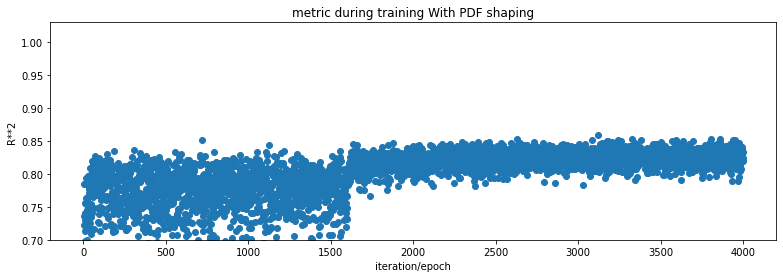

Training loss: tensor(0.1419, grad_fn=<MseLossBackward0>)
Training R**2: 0.8267008211259984
Test loss - scaled: tensor(0.1589, grad_fn=<MseLossBackward0>)
Test loss - descaled: tensor(8967835., grad_fn=<MseLossBackward0>)
Testing R**2 - scaled: 0.7859007616806757
Testing R**2 - descaled: 0.7859007567861868
*****
*****
Testing R**2 - Output: 0 0.2241441622947542
*****
*****
Testing R**2 - Output: 1 0.8544910056099606
*****
*****
Testing R**2 - Output: 2 0.9613964876265327
*****
*****
Testing R**2 - Output: 3 0.8996932943792733
*****
*****
Testing R**2 - Output: 4 0.9897788314335126


In [55]:

model = F1plusF2_SIO(x_means, x_deviations, y_means, y_deviations)
opt = torch.optim.Adam(   model.parameters(), lr=learning_rate   )
loss_fn     = F.mse_loss
loss_fn_PDF = my_loss

fit_y_scaled_PDF(N_EPOCHS, model, loss_fn, loss_fn_PDF, opt)

pred_descaled, pred_scaled = model(X_test_tr)
print('Test loss - scaled:',   loss_fn(     pred_scaled,                   y_test_tr_scaled          ))
print('Test loss - descaled:', loss_fn(     pred_descaled,                 y_test_tr                 ))
print('Testing R**2 - scaled:',   r2_score( pred_scaled.detach().numpy(),    y_test_tr_scaled.numpy()  ))
print('Testing R**2 - descaled:', r2_score( pred_descaled.detach().numpy(),  y_test_tr.numpy()         ))


print_individual_Rsquare(pred_descaled, y_test_tr)


## Export model to ONNX

In [ ]:
'''

model.eval()

dummy_input = torch.randn(1, 6)


input_names = ["input1"]
output_names = ["output1", "output2"]

torch.onnx.export(
  model, 
  dummy_input, 
  "ONNXmodels/s536ShaftPDFshapingRC.onnx", 
  verbose=False, 
  input_names  = input_names,
  output_names = output_names
)

'''